In [12]:
import os
import sys
import numpy as np
import matplotlib.pyplot as plt

# Add the directory where dynamics.py and utils.py are located to sys.path
module_path = os.path.abspath(os.path.join('../src'))
if module_path not in sys.path:
    sys.path.append(module_path)

from tqdm import tqdm

from scipy.optimize import fsolve
from scipy.stats import vonmises_fisher
from scipy.optimize import approx_fprime
from scipy.linalg import block_diag, solve

from dynamics import SatelliteDynamics
from utils import get_form_initial_conditions

In [13]:
# Simulation parameters
dt = 60.0  # Time step [s]
T = 395  # Duration [min]
T_RMSE = 300  # Index from which the RMSE is calculated
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6  # Number of states
n_p = 3  
n_y_1 = 3  # Number of measurements
n_y_2 = 2 + 2 * 3
n_y_3 = 2 + 2 * 3
n_y_4 = 2 + 2 * 3
K = T
W = 20 # Window size [min]

In [14]:
# Initial state vector and get the true state vectors (propagation) F
X_initial = get_form_initial_conditions(formation)
X_true = np.zeros((24, 1, T))
X_true[:, :, 0] = X_initial
for t in range(T - 1):
    X_true[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_true[:, :, t])

# Observation noise
sigma_abs = 1e-1  # [m]
R_abs = np.diag(np.concatenate([sigma_abs * np.ones(3)])) ** 2
sigma_rel = 1e0  # [m]
R_rel = np.diag(np.concatenate([sigma_rel * np.ones(3)])) ** 2
sigma_ang = np.deg2rad(0.5)
def equation(k_ang, sigma_ang):
    # return 1 - 1 / (2 * k_ang) - 1 / (8 * k_ang ** 2) - 1 / (8 * k_ang ** 3) - np.exp(-sigma_ang ** 2 / 2)
    def stable_coth(x):
        if x > 700:  # Prevent overflow
            return 1 + 2 / (np.exp(2 * x) - 1)
        else:
            return np.cosh(x) / np.sinh(x)
    return stable_coth(k_ang) - 1 / k_ang - np.exp(-sigma_ang ** 2 / 2)
k_ang = fsolve(equation, x0=1.0, args=(sigma_ang))[0]

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P = np.array([[1, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0]])

/tmp/ipykernel_18602/4007323918.py:18: RuntimeWarning: overflow encountered in exp
  return 1 + 2 / (np.exp(2 * x) - 1)


In [15]:
def h(x_vec):
    x_1_k = x_vec[:n_x]
    x_2_k = x_vec[n_x:2*n_x]
    x_3_k = x_vec[2*n_x:3*n_x]
    x_4_k = x_vec[3*n_x:]
    
    # Self measurements
    y_1_k = P @ x_1_k 
    
    # Relative range and bearing measurements
    d_21_k_vec = P @ x_2_k - P @ x_1_k
    d_24_k_vec = P @ x_2_k - P @ x_4_k
    d_31_k_vec = P @ x_3_k - P @ x_1_k
    d_34_k_vec = P @ x_3_k - P @ x_4_k
    d_42_k_vec = P @ x_4_k - P @ x_2_k
    d_43_k_vec = P @ x_4_k - P @ x_3_k
    
    d_21_k = np.linalg.norm(d_21_k_vec)
    d_24_k = np.linalg.norm(d_24_k_vec)
    d_31_k = np.linalg.norm(d_31_k_vec)
    d_34_k = np.linalg.norm(d_34_k_vec)
    d_42_k = np.linalg.norm(d_42_k_vec)
    d_43_k = np.linalg.norm(d_43_k_vec)
    
    y_2_k = np.vstack([d_21_k, d_24_k, d_21_k_vec / d_21_k, d_24_k_vec / d_24_k])
    y_3_k = np.vstack([d_31_k, d_34_k, d_31_k_vec / d_31_k, d_34_k_vec / d_34_k])
    y_4_k = np.vstack([d_42_k, d_43_k, d_42_k_vec / d_42_k, d_43_k_vec / d_43_k])
    
    return y_1_k.reshape(-1), y_2_k.reshape(-1), y_3_k.reshape(-1), y_4_k.reshape(-1)

def h_with_noise(x_vec):
    y_1_k, y_2_k, y_3_k, y_4_k = h(x_vec)
    abs_noise = np.random.multivariate_normal(np.zeros(3), R_abs)
    y_1_k = y_1_k + abs_noise
    y_2_k_rel = y_2_k[:2]
    y_2_k_ang = y_2_k[2:]
    y_2_k = np.concatenate((
        y_2_k_rel + np.random.multivariate_normal(np.zeros(2), np.diag(np.concatenate([sigma_rel * np.ones(2)])) ** 2), 
        vonmises_fisher.rvs(y_2_k_ang[:3], k_ang).reshape(-1),
        vonmises_fisher.rvs(y_2_k_ang[3:], k_ang).reshape(-1),
    ))
    y_3_k_rel = y_3_k[:2]
    y_3_k_ang = y_3_k[2:]
    y_3_k = np.concatenate((    
        y_3_k_rel + np.random.multivariate_normal(np.zeros(2), np.diag(np.concatenate([sigma_rel * np.ones(2)])) ** 2), 
        vonmises_fisher.rvs(y_3_k_ang[:3], k_ang).reshape(-1),
        vonmises_fisher.rvs(y_3_k_ang[3:], k_ang).reshape(-1),
    ))
    y_4_k_rel = y_4_k[:2]
    y_4_k_ang = y_4_k[2:]
    y_4_k = np.concatenate((
        y_4_k_rel + np.random.multivariate_normal(np.zeros(2), np.diag(np.concatenate([sigma_rel * np.ones(2)])) ** 2), 
        vonmises_fisher.rvs(y_4_k_ang[:3], k_ang).reshape(-1),
        vonmises_fisher.rvs(y_4_k_ang[3:], k_ang).reshape(-1),
    ))
    return np.vstack([y_1_k.reshape(-1, 1), y_2_k.reshape(-1, 1), y_3_k.reshape(-1, 1), y_4_k.reshape(-1, 1)])

In [16]:
# Simulation setup
np.random.seed(42)
X_est = np.zeros_like(X_true)
initial_dev = np.concatenate(
    (
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
    )
)
X_est[:, :, 0] = X_initial + initial_dev
for t in range(T - 1):
    X_est[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_est[:, :, t])

# Observations
Y = np.zeros((n_y_1 + n_y_2 + n_y_3 + n_y_4, 1, T))
for t in range(T):
    Y[:, :, t] = h_with_noise(X_true[:, :, t])
    
dev_chief_initial = np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).reshape(-1, 1)
dev_deputy1_initial = np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).reshape(-1, 1)
dev_deputy2_initial = np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).reshape(-1, 1)
dev_deputy3_initial = np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).reshape(-1, 1)

In [17]:
def f(x_0, y):
    f_x_0 = 0

    # Extract x_1(0), x_2(0), x_3(0), x_4(0) from flattened state vector x_0
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    # Iterate over all sliding window time steps
    for k in range(W):    
        # Get the observed data for each agent
        y_1_k = y[:n_y_1, :, k]
        y_2_k = y[n_y_1:n_y_1 + n_y_2, :, k]
        y_3_k = y[n_y_1 + n_y_2:n_y_1 + n_y_2 + n_y_3, :, k]
        y_4_k = y[n_y_1 + n_y_2 + n_y_3:, :, k]

        # Update the cost function with the residuals for self-measurements
        residual = y_1_k - P @ x_1_k
        f_x_0 += 1 / 2 * residual.T @ np.linalg.inv(R_abs) @ residual
        
        # Pairwise relative measurements and bearings in y_2_k, y_3_k, and y_4_k
        # y_2_k contains y_21, y_23, y_24 and u_21, u_23, u_24
        y_21_k = y_2_k[0]
        y_24_k = y_2_k[1]
        u_21_k = y_2_k[2:5]
        u_24_k = y_2_k[5:]

        # y_3_k contains y_31, y_32, y_34 and u_31, u_32, u_34
        y_31_k = y_3_k[0]
        y_34_k = y_3_k[1]
        u_31_k = y_3_k[2:5]
        u_34_k = y_3_k[5:]

        # y_4_k contains y_41, y_42, y_43 and u_41, u_42, u_43
        y_42_k = y_4_k[0]
        y_43_k = y_4_k[1]
        u_42_k = y_4_k[2:5]
        u_43_k = y_4_k[5:]

        # Process each pairwise measurement
        pairs = [
            (x_2_k, x_1_k, y_21_k, u_21_k),  # (2, 1)
            (x_2_k, x_4_k, y_24_k, u_24_k),  # (2, 4)
            (x_3_k, x_1_k, y_31_k, u_31_k),  # (3, 1)
            (x_3_k, x_4_k, y_34_k, u_34_k),  # (3, 4)
            (x_4_k, x_2_k, y_42_k, u_42_k),  # (4, 2)
            (x_4_k, x_3_k, y_43_k, u_43_k),  # (4, 3)
        ]

        # Iterate over each pair and update the cost function with the residuals for pairwise measurements
        for x_i_k, x_j_k, y_ij_k, u_ij_k in pairs:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)
            
            f_x_0 += (y_ij_k - d_ij_k) ** 2 / (2 * sigma_rel**2) # Range
            
            f_x_0 -= k_ang * u_ij_k.T @ d_ij_k_vec / d_ij_k # Bearing
        
        if k < W - 1:
            # Get x_1(k), x_2(k), x_3(k), x_4(k) from the state vector x_0
            x_1_k = SatelliteDynamics().x_new(dt, x_1_k)
            x_2_k = SatelliteDynamics().x_new(dt, x_2_k)
            x_3_k = SatelliteDynamics().x_new(dt, x_3_k)
            x_4_k = SatelliteDynamics().x_new(dt, x_4_k)

    return f_x_0

def grad_f(x_0, y):
    grad_f_x_0 = np.zeros_like(x_0)

    # Extract x_1(0), x_2(0), x_3(0), x_4(0) from flattened state vector x_0
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    STM_t0_1 = np.eye(n_x)
    STM_t0_2 = np.eye(n_x)
    STM_t0_3 = np.eye(n_x)
    STM_t0_4 = np.eye(n_x)
    
    # Iterate over all sliding window time steps
    for k in range(W):
        # Get the observed data for each agent
        y_1_k = y[:n_y_1, :, k]
        y_2_k = y[n_y_1:n_y_1 + n_y_2, :, k]
        y_3_k = y[n_y_1 + n_y_2:n_y_1 + n_y_2 + n_y_3, :, k]
        y_4_k = y[n_y_1 + n_y_2 + n_y_3:, :, k]

        # Compute gradients for the absolute residual terms
        grad_f_x_0[:n_x, :] -= STM_t0_1.T @ P.T @ np.linalg.inv(R_abs) @ (y_1_k - P @ x_1_k)

        # Pairwise relative measurements and bearings in y_2_k, y_3_k, and y_4_k
        # y_2_k contains y_21, y_23, y_24 and u_21, u_23, u_24
        y_21_k = y_2_k[0]
        y_24_k = y_2_k[1]
        u_21_k = y_2_k[2:5]
        u_24_k = y_2_k[5:]

        # y_3_k contains y_31, y_32, y_34 and u_31, u_32, u_34
        y_31_k = y_3_k[0]
        y_34_k = y_3_k[1]
        u_31_k = y_3_k[2:5]
        u_34_k = y_3_k[5:]

        # y_4_k contains y_41, y_42, y_43 and u_41, u_42, u_43
        y_42_k = y_4_k[0]
        y_43_k = y_4_k[1]
        u_42_k = y_4_k[2:5]
        u_43_k = y_4_k[5:]

        # Process each pairwise measurement
        pairs = [
            (2, 1, x_2_k, x_1_k, y_21_k, u_21_k, STM_t0_2, STM_t0_1),  # (2, 1)
            (2, 4, x_2_k, x_4_k, y_24_k, u_24_k, STM_t0_2, STM_t0_4),  # (2, 4)
            (3, 1, x_3_k, x_1_k, y_31_k, u_31_k, STM_t0_3, STM_t0_1),  # (3, 1)
            (3, 4, x_3_k, x_4_k, y_34_k, u_34_k, STM_t0_3, STM_t0_4),  # (3, 4)
            (4, 2, x_4_k, x_2_k, y_42_k, u_42_k, STM_t0_4, STM_t0_2),  # (4, 2)
            (4, 3, x_4_k, x_3_k, y_43_k, u_43_k, STM_t0_4, STM_t0_3),  # (4, 3)
        ]
        
        # Iterate over each pair and compute gradients
        for i, j, x_i_k, x_j_k, y_ij_k, u_ij_k, STM_t0_i, STM_t0_j in pairs:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)

            # Range
            grad_f_x_0[(i - 1) * n_x:i * n_x, :] -= (y_ij_k - d_ij_k) / sigma_rel**2 * (STM_t0_i.T @ P.T @ d_ij_k_vec) / d_ij_k
            grad_f_x_0[(j - 1) * n_x:j * n_x, :] += (y_ij_k - d_ij_k) / sigma_rel**2 * (STM_t0_j.T @ P.T @ d_ij_k_vec) / d_ij_k
            
            # Bearing
            grad_f_x_0[(i - 1) * n_x:i * n_x, :] -= k_ang * STM_t0_i.T @ (P.T / d_ij_k - P.T @ d_ij_k_vec @ d_ij_k_vec.T / d_ij_k**3) @ u_ij_k
            grad_f_x_0[(j - 1) * n_x:j * n_x, :] += k_ang * STM_t0_j.T @ (P.T / d_ij_k - P.T @ d_ij_k_vec @ d_ij_k_vec.T / d_ij_k**3) @ u_ij_k
        
        if k < W - 1:
            # Get x_1(k), x_2(k), x_3(k), x_4(k) from the state vector x_0
            STM_t0_1_old = STM_t0_1
            STM_t0_2_old = STM_t0_2
            STM_t0_3_old = STM_t0_3
            STM_t0_4_old = STM_t0_4
            x_1_k, STM_t0_1 = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, STM_t0_2 = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, STM_t0_3 = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, STM_t0_4 = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            STM_t0_1 = STM_t0_1 @ STM_t0_1_old
            STM_t0_2 = STM_t0_2 @ STM_t0_2_old
            STM_t0_3 = STM_t0_3 @ STM_t0_3_old
            STM_t0_4 = STM_t0_4 @ STM_t0_4_old

    return grad_f_x_0

def hessian_f(x_0, y):
    hessian_f_x_0 = np.zeros((x_0.shape[0], x_0.shape[0]))  # Initialize Hessian matrix
    
    # Extract x_1(0), x_2(0), x_3(0), x_4(0) from flattened state vector x_0
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    STM_t0_1 = np.eye(n_x)
    STM_t0_2 = np.eye(n_x)
    STM_t0_3 = np.eye(n_x)
    STM_t0_4 = np.eye(n_x)

    # Iterate over all sliding window time steps
    for k in range(W):
        # Get the observed data for each agent
        y_1_k = y[:n_y_1, :, k]
        y_2_k = y[n_y_1:n_y_1 + n_y_2, :, k]
        y_3_k = y[n_y_1 + n_y_2:n_y_1 + n_y_2 + n_y_3, :, k]
        y_4_k = y[n_y_1 + n_y_2 + n_y_3:, :, k]

        # Absolute measurement residuals' Hessian
        hessian_f_x_0[:n_x, :n_x] += STM_t0_1.T @ P.T @ np.linalg.inv(R_abs) @ P @ STM_t0_1 

        # Pairwise relative measurements and bearings in y_2_k, y_3_k, and y_4_k
        # y_2_k contains y_21, y_23, y_24 and u_21, u_23, u_24
        y_21_k = y_2_k[0]
        y_24_k = y_2_k[1]
        u_21_k = y_2_k[2:5]
        u_24_k = y_2_k[5:]

        # y_3_k contains y_31, y_32, y_34 and u_31, u_32, u_34
        y_31_k = y_3_k[0]
        y_34_k = y_3_k[1]
        u_31_k = y_3_k[2:5]
        u_34_k = y_3_k[5:]

        # y_4_k contains y_41, y_42, y_43 and u_41, u_42, u_43
        y_42_k = y_4_k[0]
        y_43_k = y_4_k[1]
        u_42_k = y_4_k[2:5]
        u_43_k = y_4_k[5:]

        # Process each pairwise measurement
        pairs = [
            (2, 1, x_2_k, x_1_k, y_21_k, u_21_k, STM_t0_2, STM_t0_1),  # (2, 1)
            (2, 4, x_2_k, x_4_k, y_24_k, u_24_k, STM_t0_2, STM_t0_4),  # (2, 4)
            (3, 1, x_3_k, x_1_k, y_31_k, u_31_k, STM_t0_3, STM_t0_1),  # (3, 1)
            (3, 4, x_3_k, x_4_k, y_34_k, u_34_k, STM_t0_3, STM_t0_4),  # (3, 4)
            (4, 2, x_4_k, x_2_k, y_42_k, u_42_k, STM_t0_4, STM_t0_2),  # (4, 2)
            (4, 3, x_4_k, x_3_k, y_43_k, u_43_k, STM_t0_4, STM_t0_3),  # (4, 3)
        ]

        # Iterate over each pair and compute gradients
        for i, j, x_i_k, x_j_k, y_ij_k, u_ij_k, STM_t0_i, STM_t0_j in pairs:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)

            # Update the Hessian for x_i(k) and x_j(k)
            idx_i = n_x * (i - 1)
            idx_j = n_x * (j - 1)
            
            # Range
            hessian_range_common = (y_ij_k - d_ij_k) / d_ij_k * P.T @ P - y_ij_k / d_ij_k**3 * P.T @ d_ij_k_vec @ d_ij_k_vec.T @ P
            hessian_f_x_0[idx_i:idx_i + n_x, idx_i:idx_i + n_x] -= 1 / (sigma_rel ** 2) * (STM_t0_i.T @ hessian_range_common @ STM_t0_i)
            hessian_f_x_0[idx_i:idx_i + n_x, idx_j:idx_j + n_x] += 1 / (sigma_rel ** 2) * (STM_t0_i.T @ hessian_range_common @ STM_t0_j)
            hessian_f_x_0[idx_j:idx_j + n_x, idx_i:idx_i + n_x] += 1 / (sigma_rel ** 2) * (STM_t0_j.T @ hessian_range_common @ STM_t0_i)
            hessian_f_x_0[idx_j:idx_j + n_x, idx_j:idx_j + n_x] -= 1 / (sigma_rel ** 2) * (STM_t0_j.T @ hessian_range_common @ STM_t0_j)
            
            # Bearing
            hessian_ang_common = 3 * P.T @ d_ij_k_vec @ d_ij_k_vec.T @ u_ij_k @ d_ij_k_vec.T @ P / d_ij_k**5 - P.T @ (u_ij_k @ d_ij_k_vec.T + d_ij_k_vec.T @ u_ij_k * np.eye(3) + d_ij_k_vec @ u_ij_k.T) @ P / d_ij_k**3
            hessian_f_x_0[idx_i:idx_i + n_x, idx_i:idx_i + n_x] -= k_ang * (STM_t0_i.T @ hessian_ang_common @ STM_t0_i)
            hessian_f_x_0[idx_i:idx_i + n_x, idx_j:idx_j + n_x] += k_ang * (STM_t0_i.T @ hessian_ang_common @ STM_t0_j)
            hessian_f_x_0[idx_j:idx_j + n_x, idx_i:idx_i + n_x] += k_ang * (STM_t0_j.T @ hessian_ang_common @ STM_t0_i)
            hessian_f_x_0[idx_j:idx_j + n_x, idx_j:idx_j + n_x] -= k_ang * (STM_t0_j.T @ hessian_ang_common @ STM_t0_j)

        if k < W - 1:
            # Get x_1(k), x_2(k), x_3(k), x_4(k) from the state vector x_0
            STM_t0_1_old = STM_t0_1
            STM_t0_2_old = STM_t0_2
            STM_t0_3_old = STM_t0_3
            STM_t0_4_old = STM_t0_4
            x_1_k, STM_t0_1 = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, STM_t0_2 = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, STM_t0_3 = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, STM_t0_4 = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            STM_t0_1 = STM_t0_1 @ STM_t0_1_old
            STM_t0_2 = STM_t0_2 @ STM_t0_2_old
            STM_t0_3 = STM_t0_3 @ STM_t0_3_old
            STM_t0_4 = STM_t0_4 @ STM_t0_4_old

    return hessian_f_x_0

In [18]:
def L(x_0, y):
    return f(x_0, y)
    
def grad_L(x_0, y):
    return grad_f(x_0, y)

def hessian_L(x_0, y):
    return hessian_f(x_0, y)

In [19]:
class approxH_Newton:
    def __init__(self, grad_tol=1e-6, max_iter=20):
        self.grad_tol = grad_tol
        self.max_iter = max_iter
        
        # Storage for results
        self.cost_function_values = []
        self.grad_norm_values = []

    def solve(self, x_init, Y, X_true):
        x = x_init
            
        prev_cost_function_value = None
        prev_grad_norm_value = None
        prev_global_error = None
        
        for iteration in range(self.max_iter):
            # Compute the cost function, gradient and approximated Hessian
            L_x = L(x, Y)
            grad_L_x = grad_L(x, Y)
            hessian_L_x = hessian_L(x, Y)

            # Convergence tracking
            cost_function_value = L_x[0][0]
            grad_norm_value = np.linalg.norm(grad_L_x)

            # Store the norms
            self.cost_function_values.append(cost_function_value)
            self.grad_norm_values.append(grad_norm_value)
            
            if prev_cost_function_value is not None:
                cost_function_change = (cost_function_value - prev_cost_function_value) / abs(prev_cost_function_value) * 100
                grad_norm_change = (grad_norm_value - prev_grad_norm_value) / abs(prev_grad_norm_value) * 100
                global_error_change = (np.linalg.norm(x - X_true) - prev_global_error) / abs(prev_global_error) * 100
            prev_cost_function_value = cost_function_value
            prev_grad_norm_value = grad_norm_value
            prev_global_error = np.linalg.norm(x - X_true)

            # Check convergence and print metrics
            if grad_norm_value < self.grad_tol or iteration + 1 == self.max_iter:
                print(f"STOP on Iteration {iteration}\nCost function = {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm = {grad_norm_value} ({grad_norm_change:.2f}%)\nGlobal relative error = {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                print(f"Final position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
                break
            else:
                if iteration == 0:
                    print(f"Before applying the algorithm\nCost function: {cost_function_value}\nGradient norm: {grad_norm_value}\nGlobal relative error: {np.linalg.norm(x - X_true)}")
                else:
                    print(f"Iteration {iteration}\nCost function: {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm: {grad_norm_value} ({grad_norm_change:.2f}%)\nGlobal relative error: {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                    
            # Print relative errors 
            print(f"Position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
            
            # Solve for the Newton step
            delta_x = solve(hessian_L_x, -grad_L_x)
            x += delta_x

        return x

In [20]:
def give_me_the_plots(cost_function_values, grad_norm_values):
    iterations = np.arange(0, len(cost_function_values))

    # Plot 1
    plt.semilogy(iterations, cost_function_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$L(x^{(m)})$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()
    
    # Plot 2
    plt.semilogy(iterations, grad_norm_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$||\nabla L(x^{(m)})||_2$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()

Windows:   0%|          | 0/376 [00:00<?, ?it/s]

Before applying the algorithm
Cost function: 14847193.962995058
Gradient norm: 217264919.77813673
Global relative error: 395.60563949432424
Position relative errors: 82.78540989608044 m, 181.7491507333766 m, 258.73787052498585 m, 222.8729633755392 m

Iteration 1
Cost function: -3012925.4312765896 (-120.29%)
Gradient norm: 1274928.5813699604 (-99.41%)
Global relative error: 230.09318109260514 (-41.84%)
Position relative errors: 0.04716448011042959 m, 152.82894823122726 m, 110.66424405322917 m, 131.67680228200857 m

Iteration 2
Cost function: -3135603.611788808 (-4.07%)
Gradient norm: 267125.89999679715 (-79.05%)
Global relative error: 102.26932826966953 (-55.55%)
Position relative errors: 0.04740479401331578 m, 53.12411609556025 m, 40.00244940286667 m, 77.69395019069404 m

Iteration 3
Cost function: -3149496.5903975717 (-0.44%)
Gradient norm: 224991.4732817399 (-15.77%)
Global relative error: 40.436296992299845 (-60.46%)
Position relative errors: 0.047401664773083 m, 22.93609895796271 m

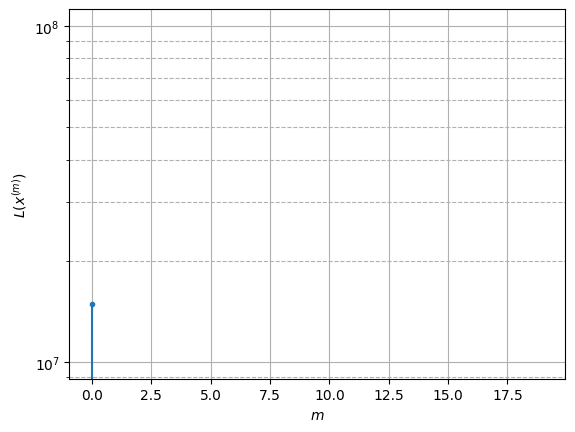

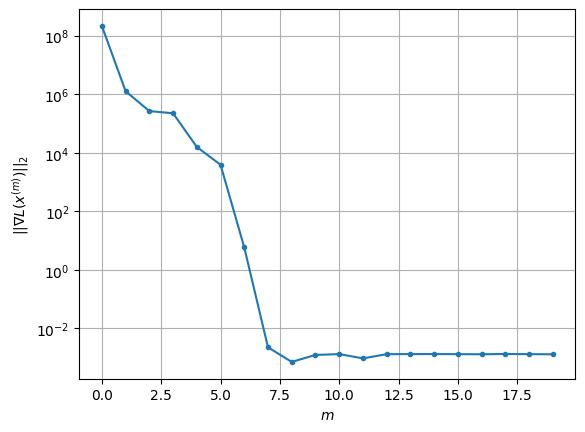

Windows:   0%|          | 1/376 [00:06<43:17,  6.93s/it]

Before applying the algorithm
Cost function: -3151362.764039717
Gradient norm: 11388.416992377533
Global relative error: 3.975866493533066
Position relative errors: 0.043888186811002386 m, 2.0120165504949923 m, 2.601337300456151 m, 2.2338774418317513 m

Iteration 1
Cost function: -3151363.6176672936 (-0.00%)
Gradient norm: 2.977596417570973 (-99.97%)
Global relative error: 3.0942222088217237 (-22.17%)
Position relative errors: 0.04102692731669926 m, 1.0147991190388759 m, 2.292911965365185 m, 1.812477758438782 m

Iteration 2
Cost function: -3151363.6176695335 (-0.00%)
Gradient norm: 0.0015079700903858125 (-99.95%)
Global relative error: 3.0909449370277464 (-0.11%)
Position relative errors: 0.041026927433472 m, 1.0126609020739228 m, 2.291476143822664 m, 1.8098957616653661 m

Iteration 3
Cost function: -3151363.617669516 (0.00%)
Gradient norm: 0.00032356302348754206 (-78.54%)
Global relative error: 3.090944902538946 (-0.00%)
Position relative errors: 0.041026927484357684 m, 1.012660881255

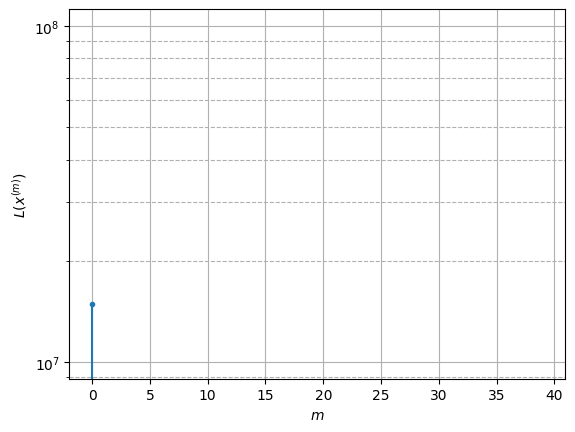

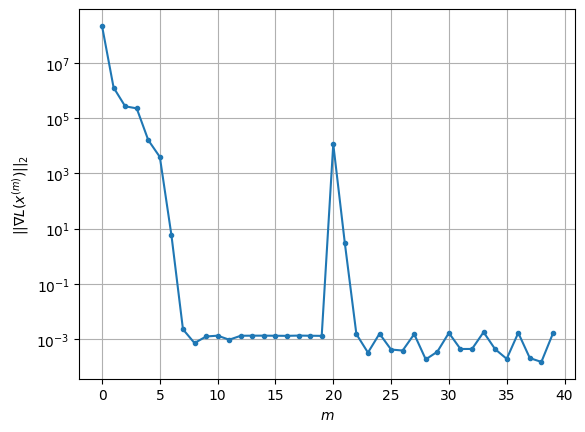

Windows:   1%|          | 2/376 [00:14<43:47,  7.03s/it]

Before applying the algorithm
Cost function: -3151361.316038637
Gradient norm: 26099.28898696316
Global relative error: 3.4723337096130003
Position relative errors: 0.037562412205279484 m, 0.9809063529989089 m, 2.447204548255252 m, 2.259318093994035 m

Iteration 1
Cost function: -3151364.9046951416 (-0.00%)
Gradient norm: 12.413173834105455 (-99.95%)
Global relative error: 5.227268027802812 (50.54%)
Position relative errors: 0.05015976709916998 m, 1.1619777202515005 m, 2.5526252829443843 m, 4.410842528345071 m

Iteration 2
Cost function: -3151364.9048652397 (-0.00%)
Gradient norm: 0.0015257020790918165 (-99.99%)
Global relative error: 5.249029120024418 (0.42%)
Position relative errors: 0.050159767492425185 m, 1.1682732510923992 m, 2.5610597344242905 m, 4.430091044827997 m

Iteration 3
Cost function: -3151364.9048652356 (0.00%)
Gradient norm: 0.00011710533287669509 (-92.32%)
Global relative error: 5.2490317167880205 (0.00%)
Position relative errors: 0.05015976745427385 m, 1.168273848332

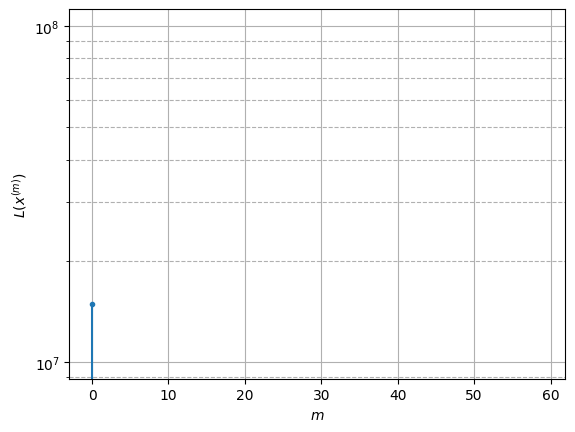

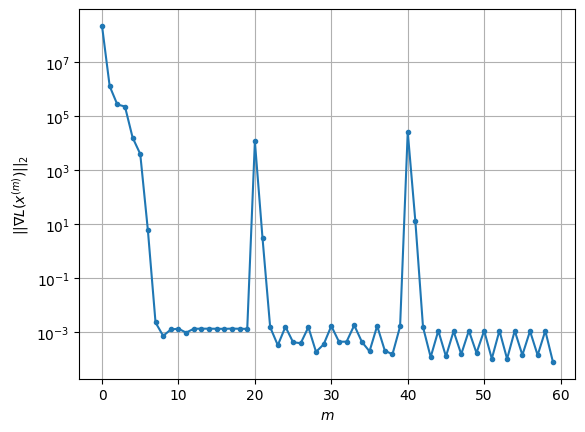

Windows:   1%|          | 3/376 [00:21<44:11,  7.11s/it]

Before applying the algorithm
Cost function: -3151359.7819033386
Gradient norm: 25170.601337842167
Global relative error: 5.484730625463589
Position relative errors: 0.04544581037277705 m, 0.9457247086703725 m, 2.604789656134079 m, 4.732936882914011 m

Iteration 1
Cost function: -3151363.368557149 (-0.00%)
Gradient norm: 33.601977993980434 (-99.87%)
Global relative error: 5.784820732928245 (5.47%)
Position relative errors: 0.04141735749968046 m, 2.715190933001325 m, 2.8825141849399487 m, 4.216764661985249 m

Iteration 2
Cost function: -3151363.368641881 (-0.00%)
Gradient norm: 0.0029497066784736413 (-99.99%)
Global relative error: 5.7828427959273725 (-0.03%)
Position relative errors: 0.04141735775255611 m, 2.7056408414355646 m, 2.893403260986167 m, 4.2127305673544635 m

Iteration 3
Cost function: -3151363.3686418585 (0.00%)
Gradient norm: 0.0012159992798792855 (-58.78%)
Global relative error: 5.782843066901917 (0.00%)
Position relative errors: 0.041417357462932264 m, 2.7056406837279483

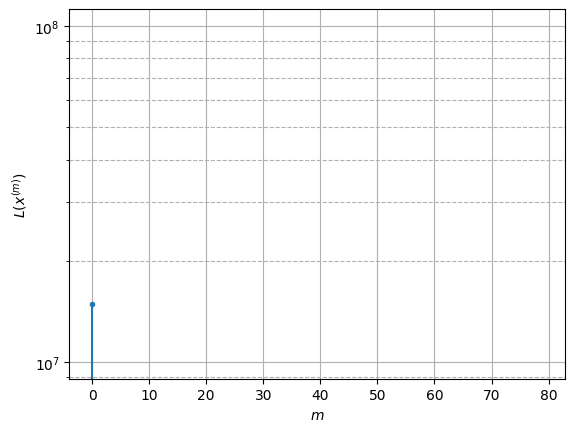

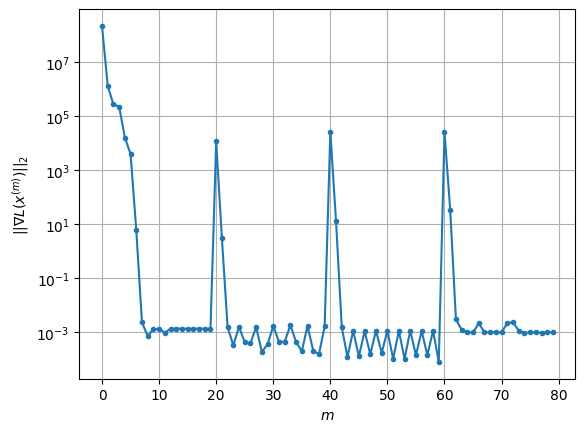

Windows:   1%|          | 4/376 [00:28<43:56,  7.09s/it]

Before applying the algorithm
Cost function: -3151363.3171425196
Gradient norm: 21681.7299278571
Global relative error: 5.9236271641998055
Position relative errors: 0.03916538039808408 m, 2.359709063879558 m, 2.9657625029152452 m, 4.552326836801173 m

Iteration 1
Cost function: -3151365.848961861 (-0.00%)
Gradient norm: 74.03973719123262 (-99.66%)
Global relative error: 7.514862558542776 (26.86%)
Position relative errors: 0.04932070114280148 m, 2.675133607106606 m, 3.6487767789072127 m, 6.000015948529407 m

Iteration 2
Cost function: -3151365.849131139 (-0.00%)
Gradient norm: 0.003456285687713188 (-100.00%)
Global relative error: 7.54713099009847 (0.43%)
Position relative errors: 0.04932070187502426 m, 2.677916044698029 m, 3.6794724845010305 m, 6.020496066744776 m

Iteration 3
Cost function: -3151365.849131178 (-0.00%)
Gradient norm: 0.0009667390303402744 (-72.03%)
Global relative error: 7.547136513523369 (0.00%)
Position relative errors: 0.04932070179240386 m, 2.6779162349587873 m, 3.

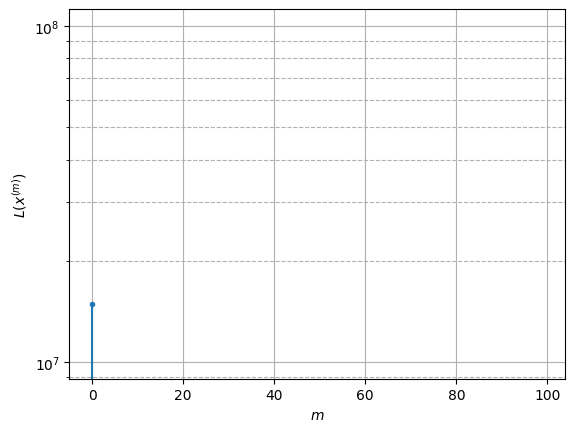

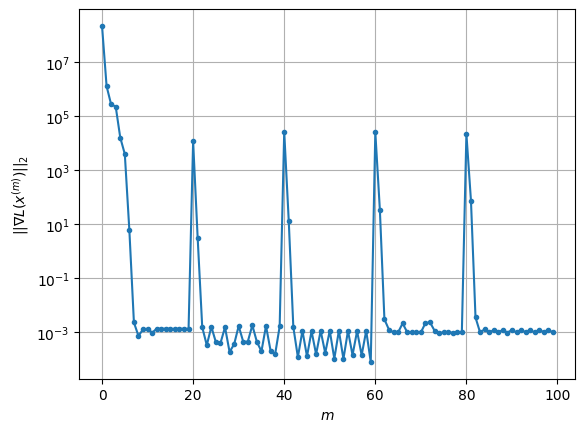

Windows:   1%|▏         | 5/376 [00:35<44:10,  7.14s/it]

Before applying the algorithm
Cost function: -3151361.0182826393
Gradient norm: 13467.234774138746
Global relative error: 7.253778642470718
Position relative errors: 0.04596700069345871 m, 2.3180396118319 m, 3.1824474841535753 m, 6.092067243117502 m

Iteration 1
Cost function: -3151364.825100968 (-0.00%)
Gradient norm: 71.5895288734615 (-99.47%)
Global relative error: 4.862101246632612 (-32.97%)
Position relative errors: 0.06225835606929404 m, 1.5569814159508093 m, 1.873175424499977 m, 4.207396154761054 m

Iteration 2
Cost function: -3151364.825563064 (-0.00%)
Gradient norm: 0.03292101993294815 (-99.95%)
Global relative error: 4.835201313794575 (-0.55%)
Position relative errors: 0.06225835677318263 m, 1.5616592125916706 m, 1.8129024470354311 m, 4.20106230094122 m

Iteration 3
Cost function: -3151364.8255630094 (0.00%)
Gradient norm: 0.0049511300455674255 (-84.96%)
Global relative error: 4.835188291932898 (-0.00%)
Position relative errors: 0.06225835700781216 m, 1.5616603511919869 m, 1.

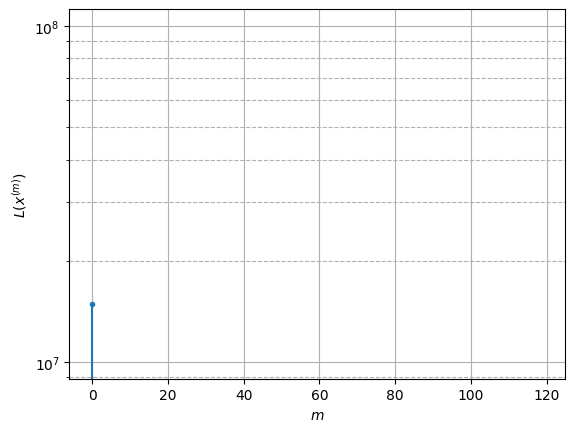

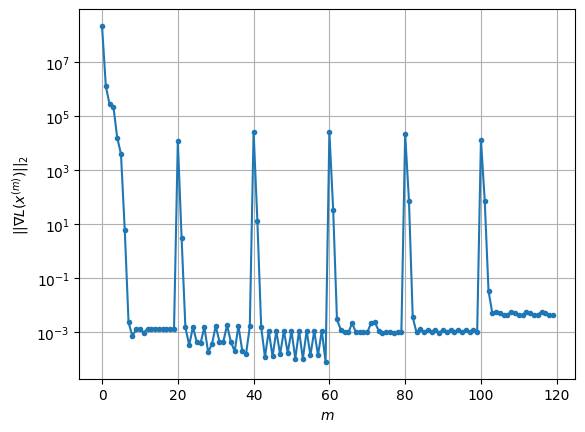

Windows:   2%|▏         | 6/376 [00:42<44:18,  7.19s/it]

Before applying the algorithm
Cost function: -3151359.73595285
Gradient norm: 27723.852003081778
Global relative error: 4.439158298115067
Position relative errors: 0.057778437303896875 m, 1.2806144843151022 m, 0.6010563829762846 m, 4.207204477457347 m

Iteration 1
Cost function: -3151363.613849683 (-0.00%)
Gradient norm: 109.73320136545362 (-99.60%)
Global relative error: 8.238629400068763 (85.59%)
Position relative errors: 0.03869586561219271 m, 1.3376976319178784 m, 3.3148534310823283 m, 7.422639730205371 m

Iteration 2
Cost function: -3151363.6142777987 (-0.00%)
Gradient norm: 0.018166281786242185 (-99.98%)
Global relative error: 8.323916129259525 (1.04%)
Position relative errors: 0.03869586754692936 m, 1.3316043693148696 m, 3.380259132165371 m, 7.489093263035472 m

Iteration 3
Cost function: -3151363.6142777875 (0.00%)
Gradient norm: 0.0023271999629857058 (-87.19%)
Global relative error: 8.323933828010187 (0.00%)
Position relative errors: 0.038695867838650214 m, 1.3316042559682386 

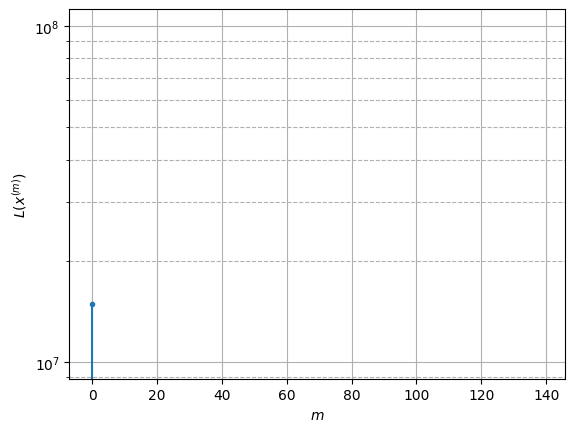

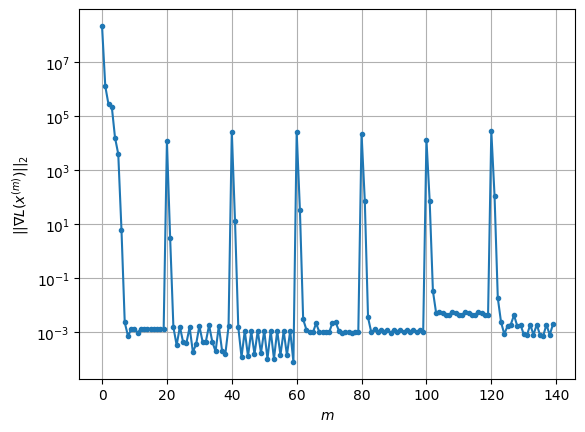

Windows:   2%|▏         | 7/376 [00:50<44:17,  7.20s/it]

Before applying the algorithm
Cost function: -3151354.9995312076
Gradient norm: 7805.792781104728
Global relative error: 8.72247592127995
Position relative errors: 0.03486783497496294 m, 1.0508343196000982 m, 3.9460267430312337 m, 7.707448210430506 m

Iteration 1
Cost function: -3151357.082804326 (-0.00%)
Gradient norm: 53.34806828677191 (-99.32%)
Global relative error: 10.983776212557382 (25.92%)
Position relative errors: 0.029348382496831103 m, 1.0824745267245144 m, 2.0778607421106243 m, 10.730901737365729 m

Iteration 2
Cost function: -3151357.0832212674 (-0.00%)
Gradient norm: 0.011549298257031937 (-99.98%)
Global relative error: 10.999335950961528 (0.14%)
Position relative errors: 0.029348381863609267 m, 1.0760913878903378 m, 2.122497852870936 m, 10.738741995588517 m

Iteration 3
Cost function: -3151357.083221301 (-0.00%)
Gradient norm: 0.002762338130380712 (-76.08%)
Global relative error: 10.999345323654996 (0.00%)
Position relative errors: 0.02934838165394998 m, 1.07609157140387

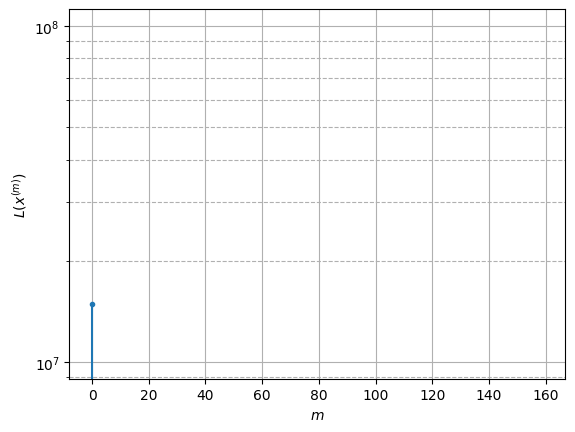

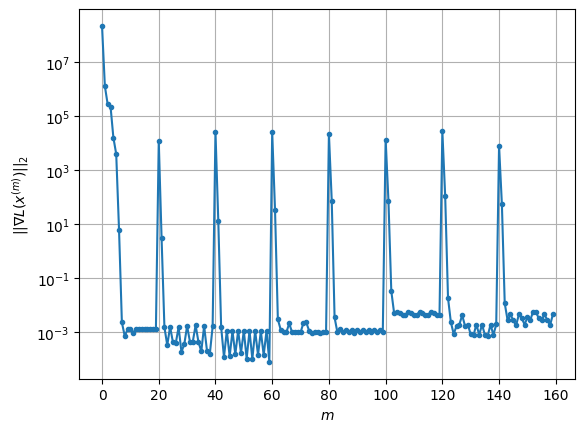

Windows:   2%|▏         | 8/376 [00:57<44:30,  7.26s/it]

Before applying the algorithm
Cost function: -3151354.404746928
Gradient norm: 33407.05686415777
Global relative error: 10.037736303600612
Position relative errors: 0.025099747177151067 m, 0.796179085589754 m, 1.0633447405497725 m, 9.949369271539386 m

Iteration 1
Cost function: -3151358.9030589857 (-0.00%)
Gradient norm: 27.449810805823535 (-99.92%)
Global relative error: 9.147581335444778 (-8.87%)
Position relative errors: 0.08611051785484654 m, 1.4058218183204743 m, 1.7857266894038875 m, 8.860299556963657 m

Iteration 2
Cost function: -3151358.9031052315 (-0.00%)
Gradient norm: 0.0025501667384005113 (-99.99%)
Global relative error: 9.134446336488338 (-0.14%)
Position relative errors: 0.08611051941489335 m, 1.404235109032107 m, 1.7983347797479394 m, 8.844435986565285 m

Iteration 3
Cost function: -3151358.9031052613 (-0.00%)
Gradient norm: 0.003894109611429167 (52.70%)
Global relative error: 9.134445630290505 (-0.00%)
Position relative errors: 0.08611051898298583 m, 1.404234994385951

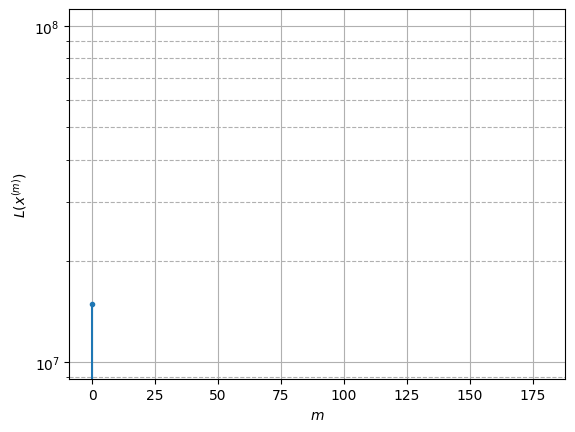

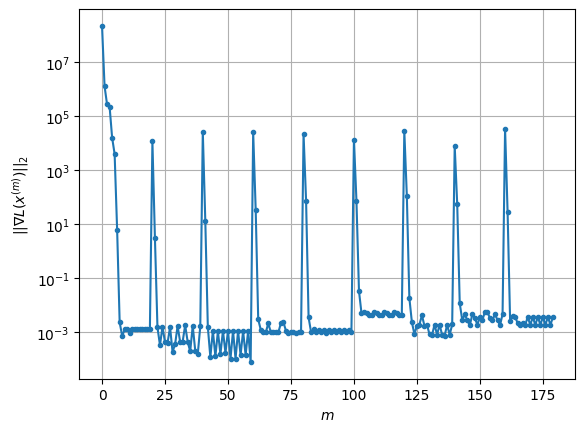

Windows:   2%|▏         | 9/376 [01:04<43:53,  7.18s/it]

Before applying the algorithm
Cost function: -3151364.4236768447
Gradient norm: 17836.438044559134
Global relative error: 9.195447905597819
Position relative errors: 0.07810859830667251 m, 1.1132497576144393 m, 2.7184037869972855 m, 8.713229940276696 m

Iteration 1
Cost function: -3151368.129708631 (-0.00%)
Gradient norm: 42.19003685802795 (-99.76%)
Global relative error: 8.013976165908792 (-12.85%)
Position relative errors: 0.09966068861392406 m, 2.517337814756059 m, 3.6828537239513572 m, 6.656769673213184 m

Iteration 2
Cost function: -3151368.130145374 (-0.00%)
Gradient norm: 0.013606853231255473 (-99.97%)
Global relative error: 7.986843995881997 (-0.34%)
Position relative errors: 0.0996606883767434 m, 2.5005472111947413 m, 3.741912625594585 m, 6.597287520047331 m

Iteration 3
Cost function: -3151368.130145378 (-0.00%)
Gradient norm: 0.002086218733062599 (-84.67%)
Global relative error: 7.98684259126162 (-0.00%)
Position relative errors: 0.09966068803706882 m, 2.500545884192568 m, 3

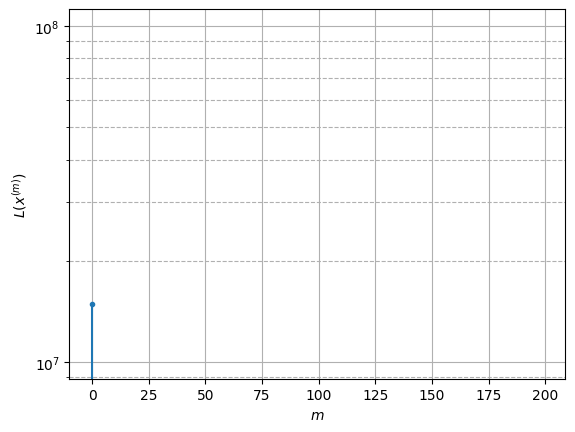

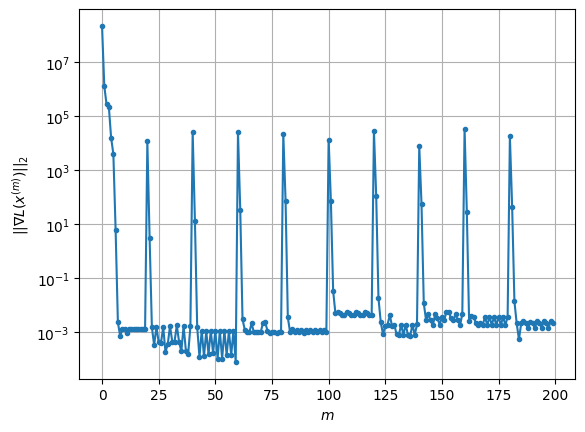

Windows:   3%|▎         | 10/376 [01:11<43:46,  7.18s/it]

Before applying the algorithm
Cost function: -3151368.329180471
Gradient norm: 30923.148383418647
Global relative error: 8.184979571060712
Position relative errors: 0.08960207112793196 m, 2.037960429967269 m, 4.152172475161742 m, 6.752123429606917 m

Iteration 1
Cost function: -3151371.1141260355 (-0.00%)
Gradient norm: 9.737227952595452 (-99.97%)
Global relative error: 7.531249646037025 (-7.99%)
Position relative errors: 0.0729312584963832 m, 2.5824972145972644 m, 3.4304640678598006 m, 6.1867548858787575 m

Iteration 2
Cost function: -3151371.1141727474 (-0.00%)
Gradient norm: 0.007383059157535884 (-99.92%)
Global relative error: 7.5116831900552645 (-0.26%)
Position relative errors: 0.07293125928286925 m, 2.5901895719739874 m, 3.417113588672605 m, 6.167109342553976 m

Iteration 3
Cost function: -3151371.114172745 (0.00%)
Gradient norm: 0.0003282649566815558 (-95.55%)
Global relative error: 7.511681213002146 (-0.00%)
Position relative errors: 0.07293125929446438 m, 2.5901898695505086 m

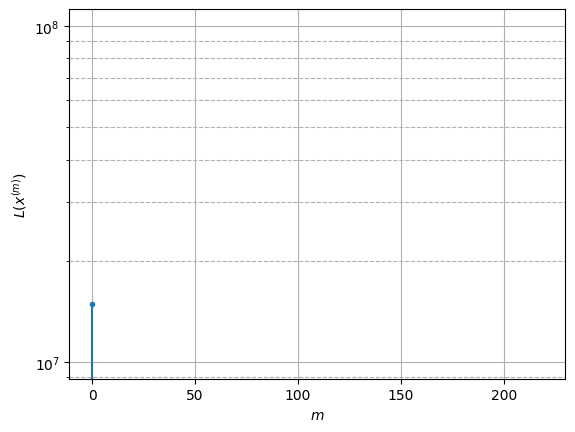

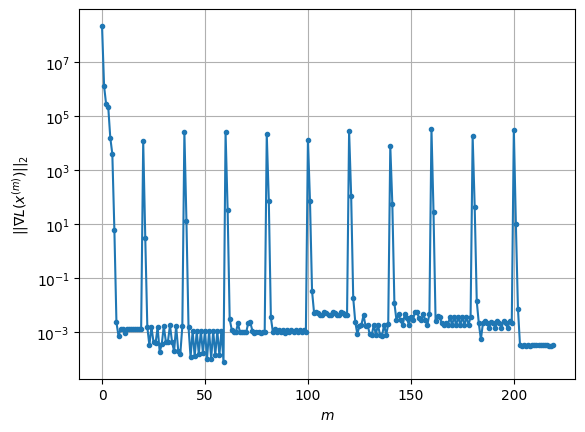

Windows:   3%|▎         | 11/376 [01:18<43:05,  7.08s/it]

Before applying the algorithm
Cost function: -3151358.530064568
Gradient norm: 41566.70497653346
Global relative error: 7.7853762677567975
Position relative errors: 0.06626762319589424 m, 1.9170023295688694 m, 3.8907751450544596 m, 6.4647974579800245 m

Iteration 1
Cost function: -3151360.9003461264 (-0.00%)
Gradient norm: 21.88820256996964 (-99.95%)
Global relative error: 9.63459065479994 (23.75%)
Position relative errors: 0.06985354126150843 m, 1.8365599591782262 m, 4.641174690922532 m, 8.240527983915785 m

Iteration 2
Cost function: -3151360.900433307 (-0.00%)
Gradient norm: 0.011173587332818518 (-99.95%)
Global relative error: 9.67613330148527 (0.43%)
Position relative errors: 0.06985354265780086 m, 1.8348342108679325 m, 4.683476785791052 m, 8.265616291375924 m

Iteration 3
Cost function: -3151360.900433295 (0.00%)
Gradient norm: 0.00318565261850781 (-71.49%)
Global relative error: 9.676135635706327 (0.00%)
Position relative errors: 0.0698535421662651 m, 1.8348345384387676 m, 4.683

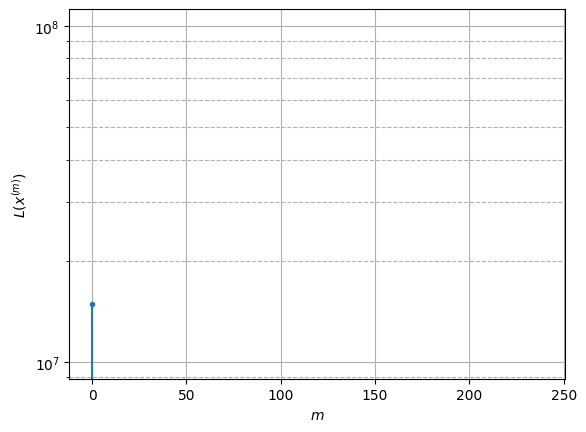

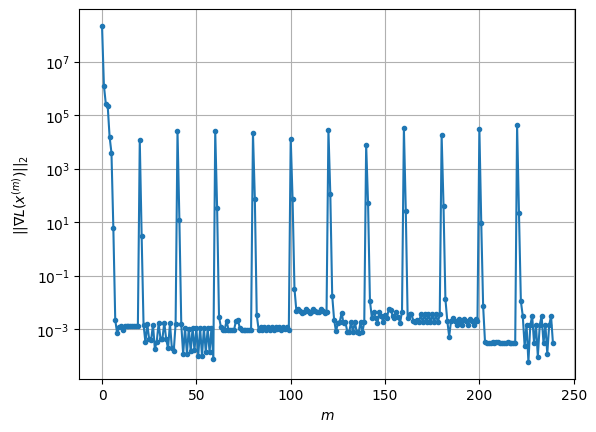

Windows:   3%|▎         | 12/376 [01:25<43:00,  7.09s/it]

Before applying the algorithm
Cost function: -3151359.3561671562
Gradient norm: 19467.320466883953
Global relative error: 10.264345440443357
Position relative errors: 0.0630982205436257 m, 1.1251990466709645 m, 5.461743058355797 m, 8.61715913885221 m

Iteration 1
Cost function: -3151360.606018365 (-0.00%)
Gradient norm: 17.99051437862151 (-99.91%)
Global relative error: 14.1937752253621 (38.28%)
Position relative errors: 0.06689312419004362 m, 1.3492126936040083 m, 9.077516059758844 m, 10.827569631253567 m

Iteration 2
Cost function: -3151360.6063023726 (-0.00%)
Gradient norm: 0.00919271876513303 (-99.95%)
Global relative error: 14.309195973268565 (0.81%)
Position relative errors: 0.06689312306836166 m, 1.3444127815921163 m, 9.216537782156252 m, 10.862584549399962 m

Iteration 3
Cost function: -3151360.606302373 (-0.00%)
Gradient norm: 0.0008810281652879185 (-90.42%)
Global relative error: 14.309259257826355 (0.00%)
Position relative errors: 0.06689312303268155 m, 1.3444118971423995 m,

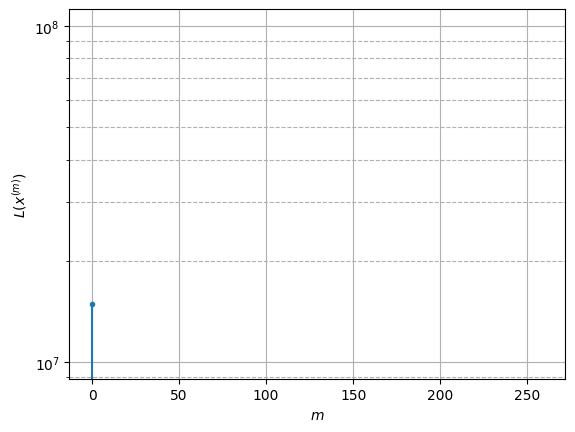

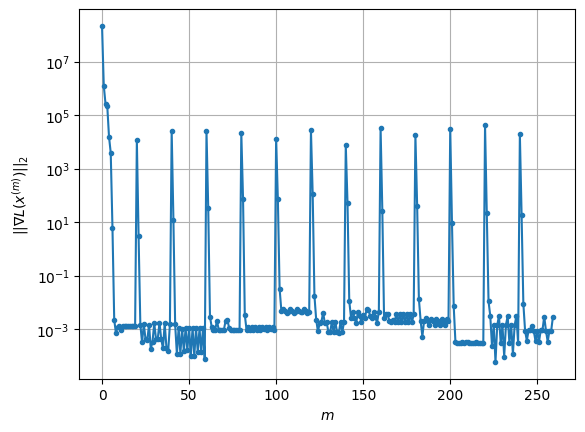

Windows:   3%|▎         | 13/376 [01:32<43:25,  7.18s/it]

Before applying the algorithm
Cost function: -3151360.895600456
Gradient norm: 24842.91572321399
Global relative error: 14.081098845013898
Position relative errors: 0.06154070085402127 m, 0.736758325421918 m, 8.937748203861608 m, 10.855717428106738 m

Iteration 1
Cost function: -3151365.697282177 (-0.00%)
Gradient norm: 73.67886824953926 (-99.70%)
Global relative error: 30.017560189092094 (113.18%)
Position relative errors: 0.0717600604526241 m, 3.145746347725477 m, 21.29538412393412 m, 20.920259771546927 m

Iteration 2
Cost function: -3151365.6988527784 (-0.00%)
Gradient norm: 0.042664936094162685 (-99.94%)
Global relative error: 29.610735802832767 (-1.36%)
Position relative errors: 0.07176005956893718 m, 3.1170158518226305 m, 21.044146379690396 m, 20.596511973432907 m

Iteration 3
Cost function: -3151365.69885276 (0.00%)
Gradient norm: 0.0036672486821063338 (-91.40%)
Global relative error: 29.60991634519366 (-0.00%)
Position relative errors: 0.07176005956893718 m, 3.117004544422593 m

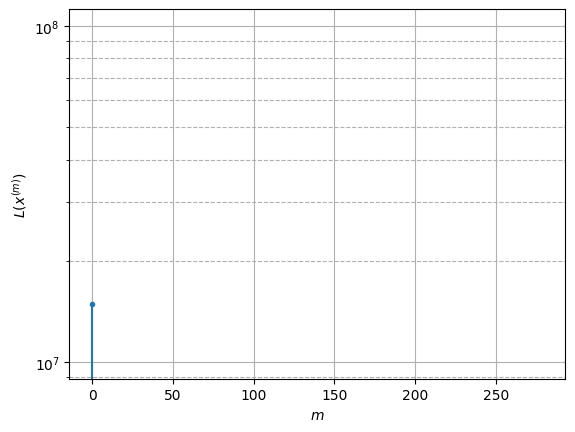

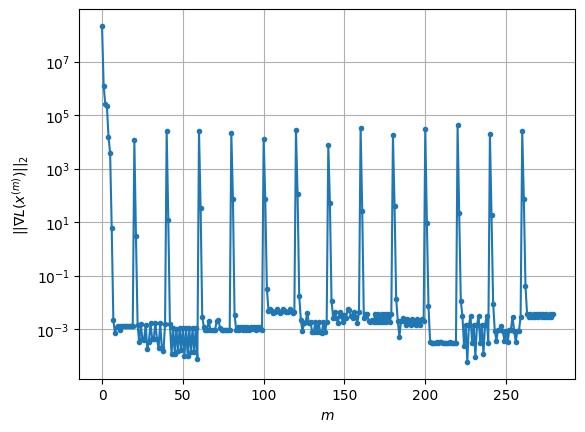

Windows:   4%|▎         | 14/376 [01:40<43:45,  7.25s/it]

Before applying the algorithm
Cost function: -3151360.942922157
Gradient norm: 13161.553269446726
Global relative error: 28.11255646700612
Position relative errors: 0.06635562002341736 m, 2.78924167411928 m, 19.695146903087785 m, 19.865313300611255 m

Iteration 1
Cost function: -3151363.3016348323 (-0.00%)
Gradient norm: 30.577647288507013 (-99.77%)
Global relative error: 30.59056169312937 (8.81%)
Position relative errors: 0.07161511193692446 m, 3.3854862373661323 m, 17.969033399015828 m, 24.5239994836162 m

Iteration 2
Cost function: -3151363.302018158 (-0.00%)
Gradient norm: 0.04384685820927797 (-99.86%)
Global relative error: 30.81024398360798 (0.72%)
Position relative errors: 0.0716151128459137 m, 3.3844302549691023 m, 18.095271772794547 m, 24.705659532811964 m

Iteration 3
Cost function: -3151363.30201816 (-0.00%)
Gradient norm: 0.0003786060913930285 (-99.14%)
Global relative error: 30.810346303021323 (0.00%)
Position relative errors: 0.07161511259918969 m, 3.3844294759584823 m, 1

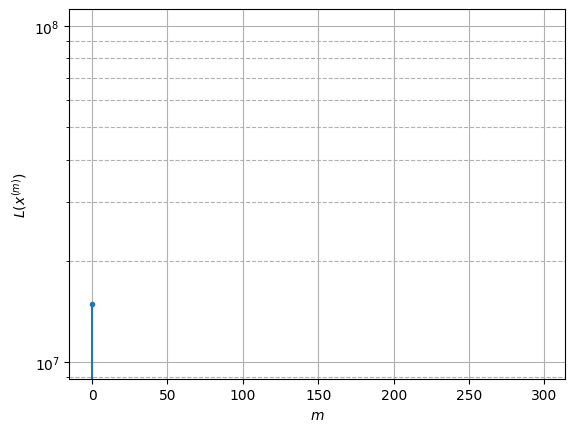

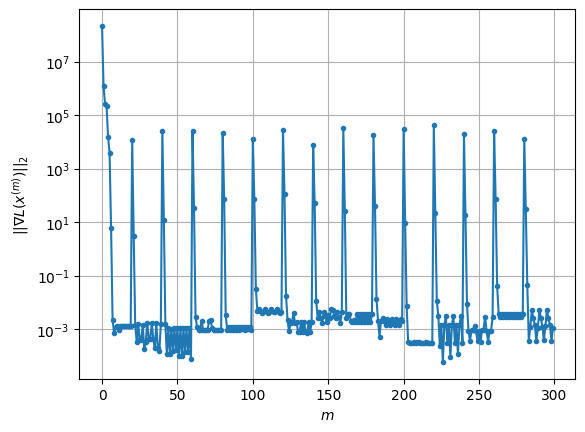

Windows:   4%|▍         | 15/376 [01:47<44:03,  7.32s/it]

Before applying the algorithm
Cost function: -3151355.397345864
Gradient norm: 31280.455949251154
Global relative error: 28.950773214940114
Position relative errors: 0.0649425228578543 m, 3.0619698881558506 m, 16.91754288471875 m, 23.292944574164157 m

Iteration 1
Cost function: -3151364.267790152 (-0.00%)
Gradient norm: 201.4252075856366 (-99.36%)
Global relative error: 37.82194319618024 (30.64%)
Position relative errors: 0.07284334270653417 m, 5.597393784201489 m, 22.03780726132388 m, 30.224093641523503 m

Iteration 2
Cost function: -3151364.269813845 (-0.00%)
Gradient norm: 0.19460517382008902 (-99.90%)
Global relative error: 37.61425095464424 (-0.55%)
Position relative errors: 0.07284333577252733 m, 5.605510330800654 m, 21.951126211601295 m, 30.02582993558574 m

Iteration 3
Cost function: -3151364.26981383 (0.00%)
Gradient norm: 0.0006144216473891325 (-99.68%)
Global relative error: 37.61385931583985 (-0.00%)
Position relative errors: 0.07284333599582997 m, 5.6055165327778465 m, 21

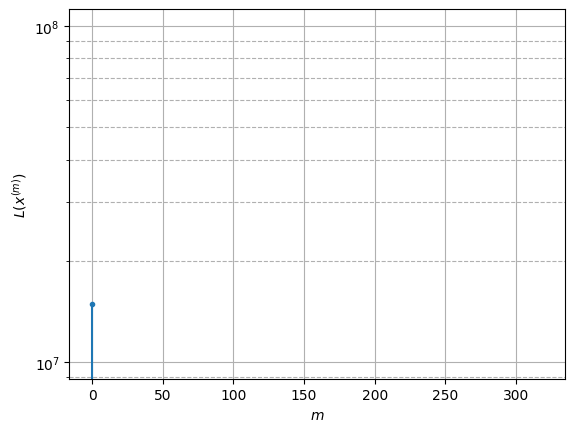

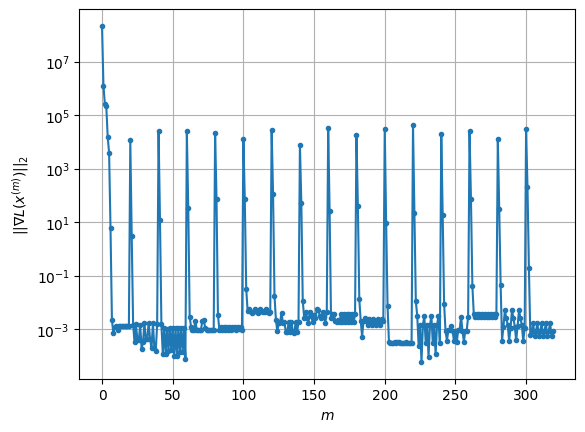

Windows:   4%|▍         | 16/376 [01:55<43:58,  7.33s/it]

Before applying the algorithm
Cost function: -3151362.907083967
Gradient norm: 23250.638533145484
Global relative error: 35.65009650169063
Position relative errors: 0.06615403513985041 m, 5.45798566687773 m, 20.661058433523873 m, 28.535135772558334 m

Iteration 1
Cost function: -3151366.0028737998 (-0.00%)
Gradient norm: 33.0590359135771 (-99.86%)
Global relative error: 34.05327540425866 (-4.48%)
Position relative errors: 0.06165512141477722 m, 7.5433925246668405 m, 17.629434155666853 m, 28.141070603346307 m

Iteration 2
Cost function: -3151366.002992168 (-0.00%)
Gradient norm: 0.0075951259209282715 (-99.98%)
Global relative error: 34.06196566190595 (0.03%)
Position relative errors: 0.06165512141477722 m, 7.536519993196008 m, 17.67669997812665 m, 28.123774022670922 m

Iteration 3
Cost function: -3151366.002992192 (-0.00%)
Gradient norm: 0.00626980588297234 (-17.45%)
Global relative error: 34.061967191418255 (0.00%)
Position relative errors: 0.061655121130984494 m, 7.536518901850608 m, 

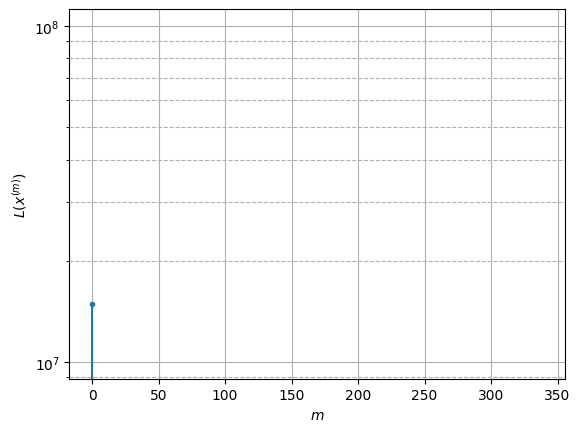

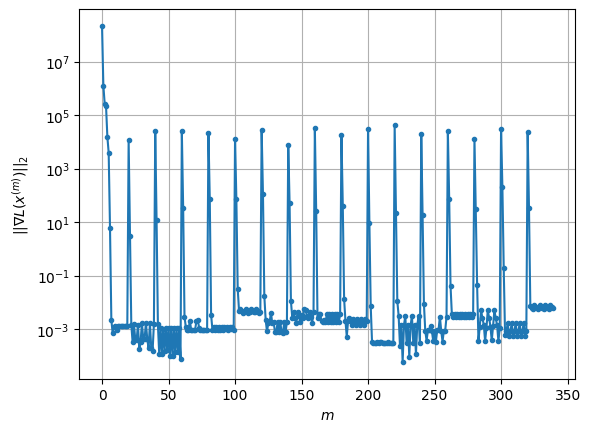

Windows:   5%|▍         | 17/376 [02:02<43:42,  7.31s/it]

Before applying the algorithm
Cost function: -3151352.321441871
Gradient norm: 20079.624979925145
Global relative error: 32.4725081667819
Position relative errors: 0.05733295930743595 m, 7.318267667705812 m, 16.83579813921318 m, 26.785396472412977 m

Iteration 1
Cost function: -3151356.6033310145 (-0.00%)
Gradient norm: 79.42481035740404 (-99.60%)
Global relative error: 36.70149003846055 (13.02%)
Position relative errors: 0.051785844541367664 m, 9.36541501825321 m, 21.600295638937663 m, 28.15513379642802 m

Iteration 2
Cost function: -3151356.603992308 (-0.00%)
Gradient norm: 0.0045372732340394194 (-99.99%)
Global relative error: 36.701578357878795 (0.00%)
Position relative errors: 0.051785844600147894 m, 9.334436587572084 m, 21.622795154248312 m, 28.148265020884 m

Iteration 3
Cost function: -3151356.6039923276 (-0.00%)
Gradient norm: 0.00259351911771423 (-42.84%)
Global relative error: 36.701577304851554 (-0.00%)
Position relative errors: 0.05178584422789685 m, 9.334434240533536 m, 2

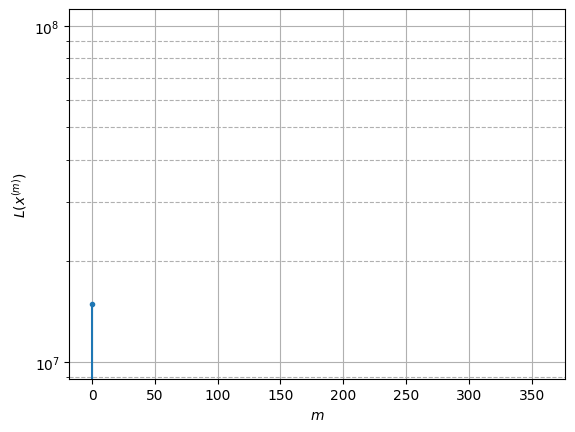

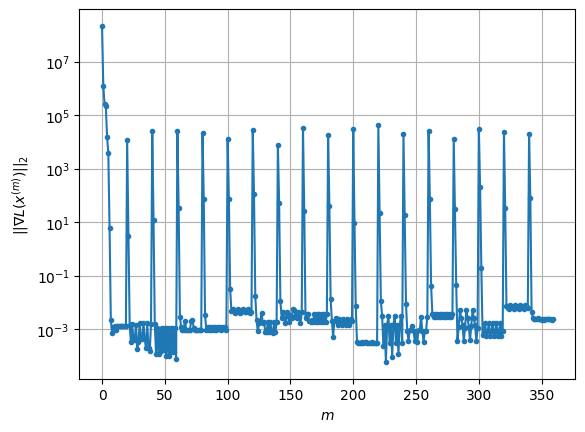

Windows:   5%|▍         | 18/376 [02:09<43:08,  7.23s/it]

Before applying the algorithm
Cost function: -3151359.790190029
Gradient norm: 23398.10587341585
Global relative error: 36.18269457411162
Position relative errors: 0.04886262344439688 m, 8.83094662076203 m, 21.33860391527749 m, 27.85430258897128 m

Iteration 1
Cost function: -3151363.564011638 (-0.00%)
Gradient norm: 102.72668049551314 (-99.56%)
Global relative error: 40.796420466331135 (12.75%)
Position relative errors: 0.019849263340500883 m, 6.12517797911188 m, 25.618899315174826 m, 31.152853300591794 m

Iteration 2
Cost function: -3151363.564546214 (-0.00%)
Gradient norm: 0.013707799504325598 (-99.99%)
Global relative error: 40.81673897790164 (0.05%)
Position relative errors: 0.019849263934840006 m, 6.103223504586026 m, 25.65271606869045 m, 31.155949294429515 m

Iteration 3
Cost function: -3151363.5645462177 (-0.00%)
Gradient norm: 0.0012794168382581287 (-90.67%)
Global relative error: 40.816716220939846 (-0.00%)
Position relative errors: 0.019849263983417523 m, 6.103215887792328 m

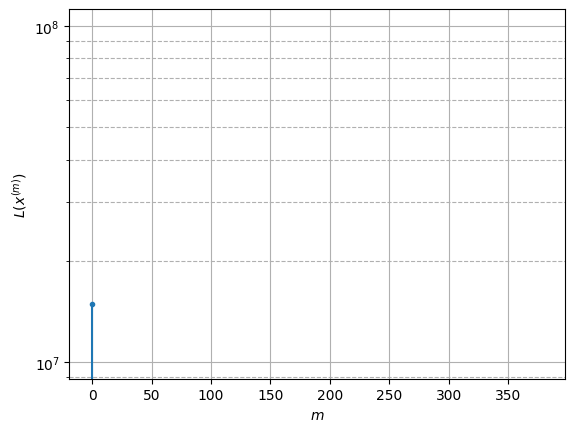

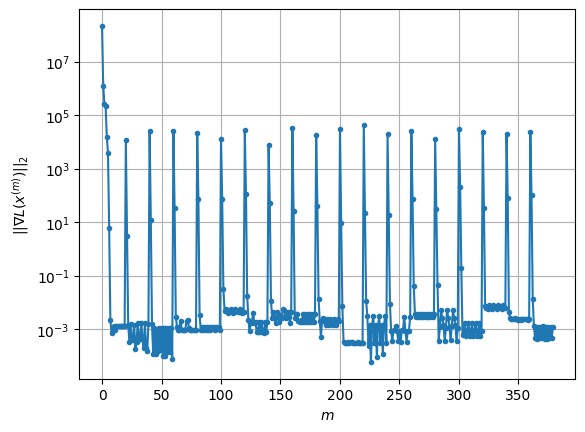

Windows:   5%|▌         | 19/376 [02:16<42:57,  7.22s/it]

Before applying the algorithm
Cost function: -3151364.543287245
Gradient norm: 9214.359616440674
Global relative error: 41.00721725664466
Position relative errors: 0.017545273727894856 m, 5.949842237459406 m, 25.640058968380142 m, 31.444826239603643 m

Iteration 1
Cost function: -3151365.654796573 (-0.00%)
Gradient norm: 51.969848118564784 (-99.44%)
Global relative error: 40.664364509095634 (-0.84%)
Position relative errors: 0.027505749909940112 m, 3.3262475816036097 m, 26.524004781094053 m, 30.643149411939874 m

Iteration 2
Cost function: -3151365.6550789704 (-0.00%)
Gradient norm: 0.0033475345022623807 (-99.99%)
Global relative error: 40.63677025602341 (-0.07%)
Position relative errors: 0.027505748361936016 m, 3.348281017851561 m, 26.500380130173493 m, 30.624578047855486 m

Iteration 3
Cost function: -3151365.6550789797 (-0.00%)
Gradient norm: 0.0014002279947707811 (-58.17%)
Global relative error: 40.63676508796056 (-0.00%)
Position relative errors: 0.027505748814325676 m, 3.34828305

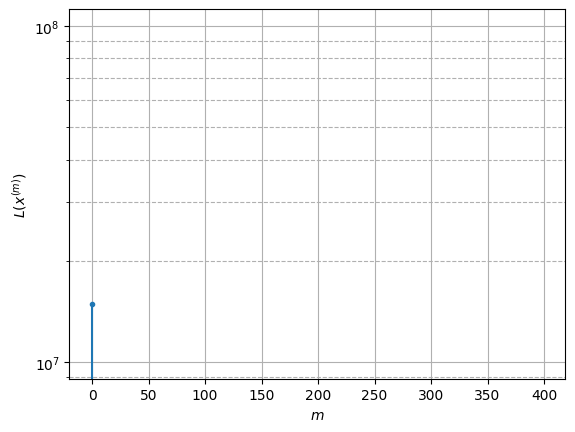

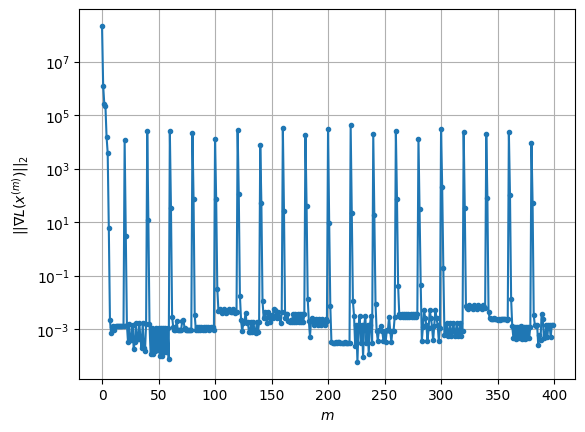

Windows:   5%|▌         | 20/376 [02:24<43:09,  7.27s/it]

Before applying the algorithm
Cost function: -3151361.3903340125
Gradient norm: 15369.363924587213
Global relative error: 41.56796358631198
Position relative errors: 0.023773143773888283 m, 3.4939166618950073 m, 26.985570520858055 m, 31.423975489940336 m

Iteration 1
Cost function: -3151363.2342712753 (-0.00%)
Gradient norm: 76.27895874991043 (-99.50%)
Global relative error: 45.711419737566274 (9.97%)
Position relative errors: 0.033226926887403536 m, 7.125079977968861 m, 29.52168805371517 m, 34.164828481577345 m

Iteration 2
Cost function: -3151363.234569526 (-0.00%)
Gradient norm: 0.013821951002071089 (-99.98%)
Global relative error: 45.71963046368926 (0.02%)
Position relative errors: 0.03322693197906132 m, 7.111874639370224 m, 29.53144325828728 m, 34.17013538586725 m

Iteration 3
Cost function: -3151363.2345695198 (0.00%)
Gradient norm: 0.0004932471397028356 (-96.43%)
Global relative error: 45.71959704156525 (-0.00%)
Position relative errors: 0.033226932260175514 m, 7.111872244313969

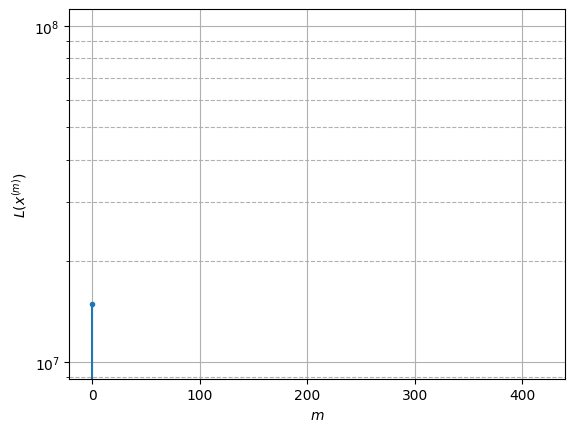

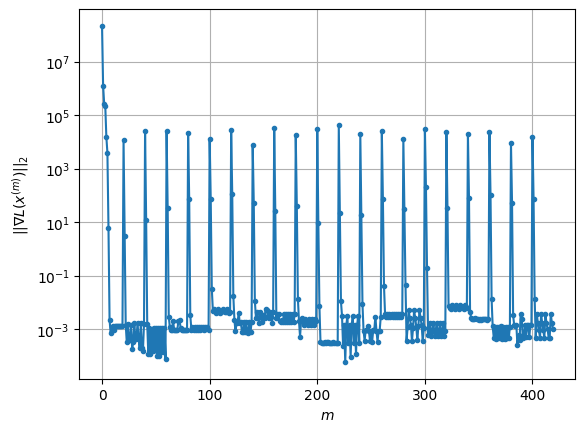

Windows:   6%|▌         | 21/376 [02:31<43:11,  7.30s/it]

Before applying the algorithm
Cost function: -3151355.080103926
Gradient norm: 10972.220229459923
Global relative error: 45.681275884417865
Position relative errors: 0.029251833766787628 m, 6.933074284252437 m, 29.503499288677013 m, 34.17972719745759 m

Iteration 1
Cost function: -3151358.0713522416 (-0.00%)
Gradient norm: 80.0385010632851 (-99.27%)
Global relative error: 35.08172840100407 (-23.20%)
Position relative errors: 0.03901460916962884 m, 9.875874403012856 m, 21.86862731737428 m, 25.592085277366152 m

Iteration 2
Cost function: -3151358.071901812 (-0.00%)
Gradient norm: 0.040434839362900946 (-99.95%)
Global relative error: 35.113713195904744 (0.09%)
Position relative errors: 0.03901461834975527 m, 9.869516424434389 m, 21.876033849255414 m, 25.63204212952415 m

Iteration 3
Cost function: -3151358.0719018136 (-0.00%)
Gradient norm: 0.0008637086891418663 (-97.86%)
Global relative error: 35.113692305169444 (-0.00%)
Position relative errors: 0.03901461826442077 m, 9.86951062782829 

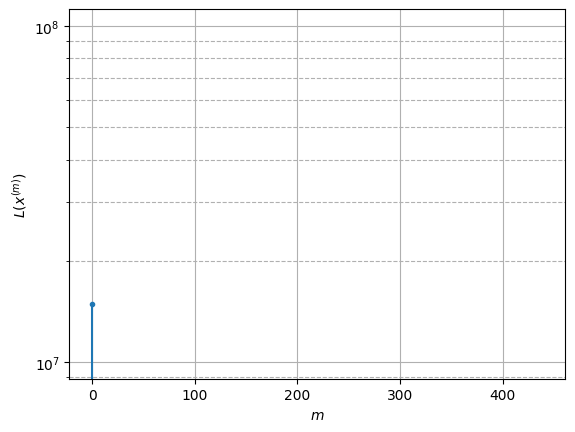

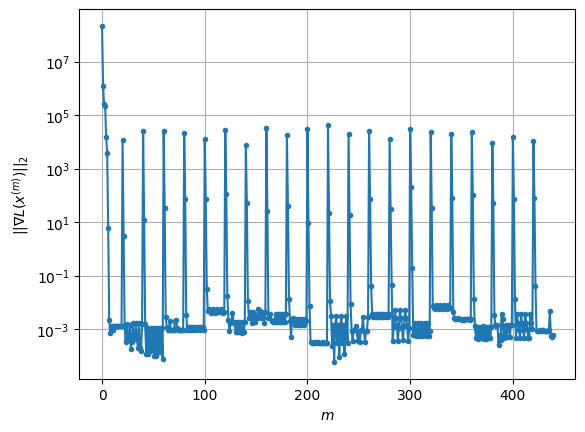

Windows:   6%|▌         | 22/376 [02:38<42:56,  7.28s/it]

Before applying the algorithm
Cost function: -3151352.6224834444
Gradient norm: 15351.44059156927
Global relative error: 36.10586984724673
Position relative errors: 0.03514398998598466 m, 9.258217431263127 m, 22.679604909639714 m, 26.524558302984467 m

Iteration 1
Cost function: -3151355.774839109 (-0.00%)
Gradient norm: 23.533546508964875 (-99.85%)
Global relative error: 33.40888655450548 (-7.47%)
Position relative errors: 0.06741689696367752 m, 7.406243716368393 m, 21.833394353942683 m, 24.178464411647433 m

Iteration 2
Cost function: -3151355.7749407506 (-0.00%)
Gradient norm: 0.00355756983737615 (-99.98%)
Global relative error: 33.325985696535994 (-0.25%)
Position relative errors: 0.06741689447852349 m, 7.3827285750929965 m, 21.767128538125064 m, 24.13095020501833 m

Iteration 3
Cost function: -3151355.7749407436 (0.00%)
Gradient norm: 0.002269489967415952 (-36.21%)
Global relative error: 33.32596939291313 (-0.00%)
Position relative errors: 0.06741689499630359 m, 7.3827239739451045

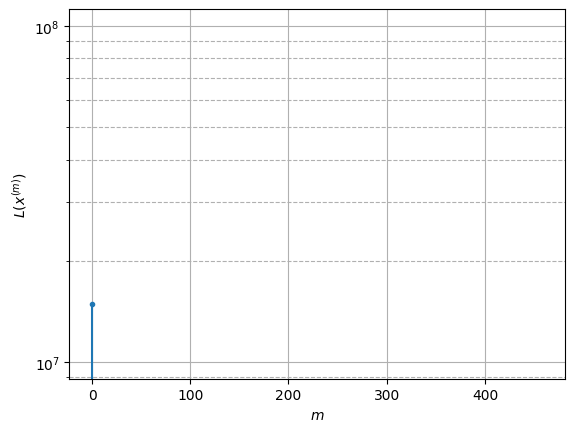

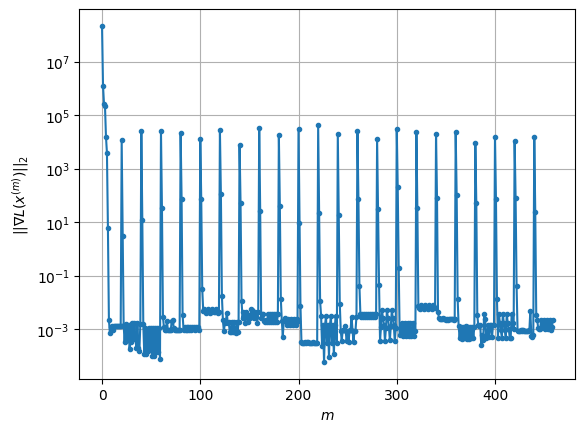

Windows:   6%|▌         | 23/376 [02:45<42:51,  7.28s/it]

Before applying the algorithm
Cost function: -3151349.3024742557
Gradient norm: 25079.220776296625
Global relative error: 33.81698145592395
Position relative errors: 0.06019662198189853 m, 7.099861629210923 m, 22.06026346137169 m, 24.627628943032683 m

Iteration 1
Cost function: -3151353.3115748796 (-0.00%)
Gradient norm: 61.0989423398097 (-99.76%)
Global relative error: 26.765010283481494 (-20.85%)
Position relative errors: 0.04941788448554575 m, 7.036696273201187 m, 16.197566633075716 m, 20.11183924122964 m

Iteration 2
Cost function: -3151353.312110049 (-0.00%)
Gradient norm: 0.01697434287531123 (-99.97%)
Global relative error: 26.736677484842986 (-0.11%)
Position relative errors: 0.049417887270781224 m, 7.050935610051318 m, 16.168497305515956 m, 20.092547955500873 m

Iteration 3
Cost function: -3151353.312110068 (-0.00%)
Gradient norm: 0.0005084086228995166 (-97.00%)
Global relative error: 26.73663603903427 (-0.00%)
Position relative errors: 0.04941788708727561 m, 7.050936412085458

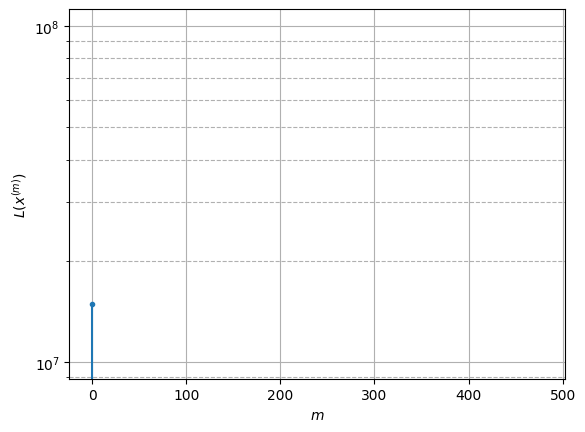

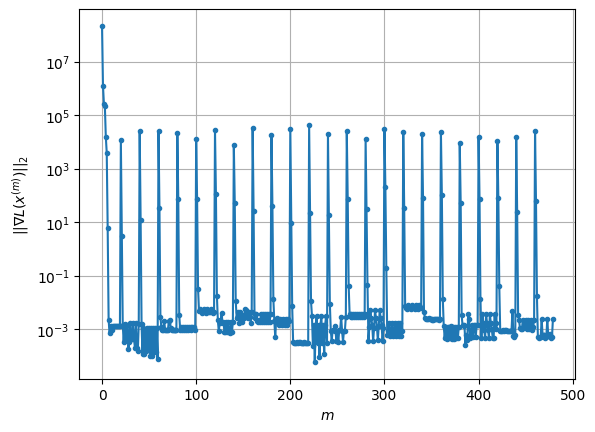

Windows:   6%|▋         | 24/376 [02:53<42:51,  7.31s/it]

Before applying the algorithm
Cost function: -3151346.294732267
Gradient norm: 22065.819088004137
Global relative error: 28.183531861522535
Position relative errors: 0.043552952143558775 m, 6.589539006189119 m, 17.13822414077265 m, 21.381485551629936 m

Iteration 1
Cost function: -3151350.223885854 (-0.00%)
Gradient norm: 10.182143273673383 (-99.95%)
Global relative error: 27.23308635443824 (-3.37%)
Position relative errors: 0.04732611525633958 m, 7.385393853367662 m, 16.686414885777513 m, 20.2152716259987 m

Iteration 2
Cost function: -3151350.22396843 (-0.00%)
Gradient norm: 0.003676846094330975 (-99.96%)
Global relative error: 27.249591011977287 (0.06%)
Position relative errors: 0.04732611594802799 m, 7.384844420627089 m, 16.70599346166709 m, 20.22154209360895 m

Iteration 3
Cost function: -3151350.223968441 (-0.00%)
Gradient norm: 0.005191774701439975 (41.20%)
Global relative error: 27.24959284403858 (0.00%)
Position relative errors: 0.04732611614140919 m, 7.384844554474948 m, 16.7

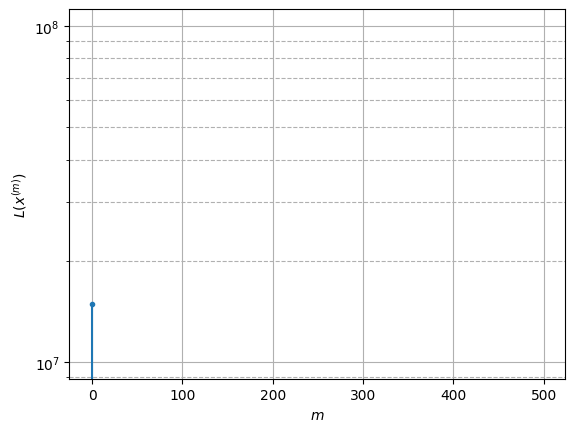

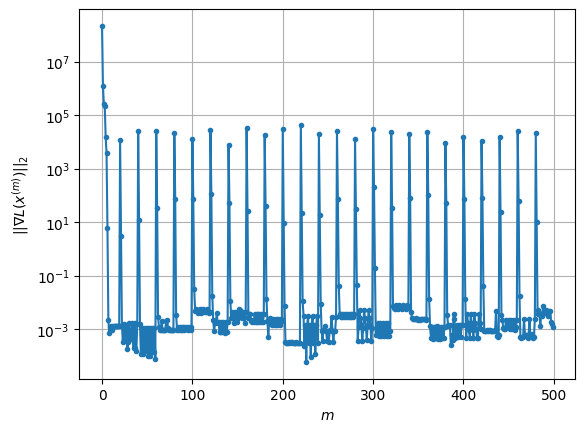

Windows:   7%|▋         | 25/376 [03:00<42:46,  7.31s/it]

Before applying the algorithm
Cost function: -3151350.7998591475
Gradient norm: 13847.87956835749
Global relative error: 28.41248102043222
Position relative errors: 0.04172032494394877 m, 6.72356689300774 m, 17.443138449033697 m, 21.396190197074944 m

Iteration 1
Cost function: -3151353.130951014 (-0.00%)
Gradient norm: 143.4822204090844 (-98.96%)
Global relative error: 20.69376704260251 (-27.17%)
Position relative errors: 0.053249100116319885 m, 8.382266141858636 m, 10.702998121194842 m, 15.60156835973779 m

Iteration 2
Cost function: -3151353.1317115966 (-0.00%)
Gradient norm: 0.035942029944407754 (-99.97%)
Global relative error: 20.62539707144456 (-0.33%)
Position relative errors: 0.053249099237090584 m, 8.36647932882628 m, 10.58587971847925 m, 15.599411482537148 m

Iteration 3
Cost function: -3151353.131711601 (-0.00%)
Gradient norm: 0.0016098630562385123 (-95.52%)
Global relative error: 20.625379963810243 (-0.00%)
Position relative errors: 0.05324909913860134 m, 8.366477033097372 

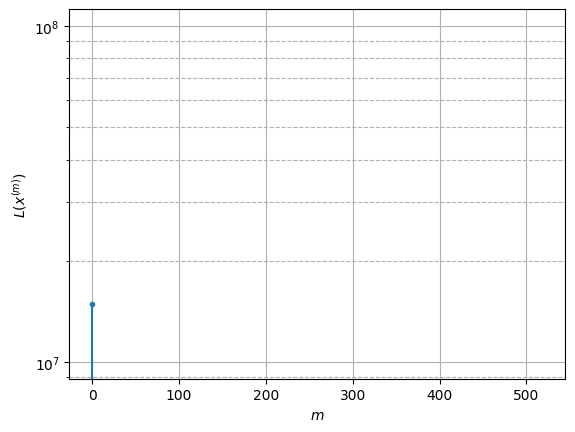

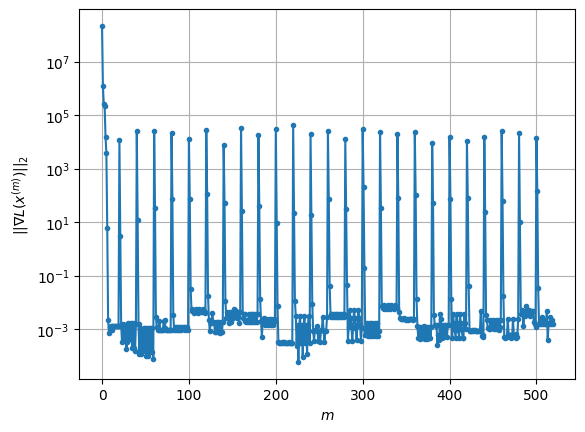

Windows:   7%|▋         | 26/376 [03:07<42:31,  7.29s/it]

Before applying the algorithm
Cost function: -3151353.436802289
Gradient norm: 21886.90379837374
Global relative error: 23.006855897482268
Position relative errors: 0.046866575938904295 m, 7.558664590506472 m, 12.43890575240079 m, 17.817123607089442 m

Iteration 1
Cost function: -3151356.533702792 (-0.00%)
Gradient norm: 88.63910398673097 (-99.60%)
Global relative error: 41.5417606289171 (80.56%)
Position relative errors: 0.058029445540087994 m, 6.821251966720834 m, 27.830929482085356 m, 30.076921079643984 m

Iteration 2
Cost function: -3151356.5349621354 (-0.00%)
Gradient norm: 0.024034894769176415 (-99.97%)
Global relative error: 41.87636484835315 (0.81%)
Position relative errors: 0.05802944508897295 m, 6.792181249185785 m, 28.09847142937065 m, 30.297945494315083 m

Iteration 3
Cost function: -3151356.534962106 (0.00%)
Gradient norm: 0.004375838200606211 (-81.79%)
Global relative error: 41.87689341384523 (0.00%)
Position relative errors: 0.05802944573163239 m, 6.792191088881053 m, 28

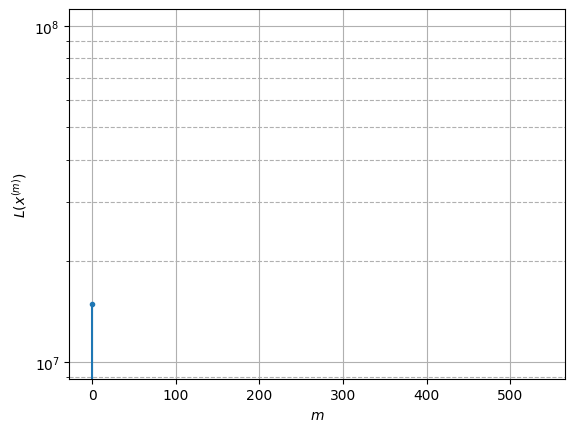

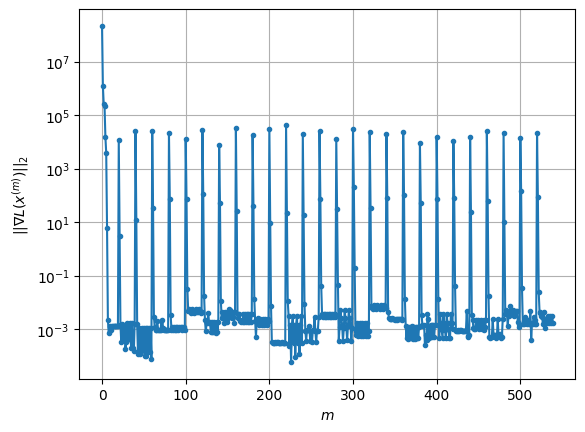

Windows:   7%|▋         | 27/376 [03:15<42:35,  7.32s/it]

Before applying the algorithm
Cost function: -3151352.4349676045
Gradient norm: 33539.53405724012
Global relative error: 43.18301394094999
Position relative errors: 0.05193924929213653 m, 6.099011916081927 m, 28.226740671804983 m, 32.10639028327088 m

Iteration 1
Cost function: -3151355.045066007 (-0.00%)
Gradient norm: 136.3889958310775 (-99.59%)
Global relative error: 33.042446808257665 (-23.48%)
Position relative errors: 0.044916178696960955 m, 6.479682243306013 m, 21.030844776406028 m, 24.647865087986297 m

Iteration 2
Cost function: -3151355.045528192 (-0.00%)
Gradient norm: 0.03436087530917923 (-99.97%)
Global relative error: 33.01585586912115 (-0.08%)
Position relative errors: 0.044916177481787285 m, 6.49480083511516 m, 21.003594780842278 m, 24.631483986798802 m

Iteration 3
Cost function: -3151355.045528192 (0.00%)
Gradient norm: 0.001110812920621376 (-96.77%)
Global relative error: 33.01568865614415 (-0.00%)
Position relative errors: 0.0449161768694673 m, 6.494799750757435 m, 

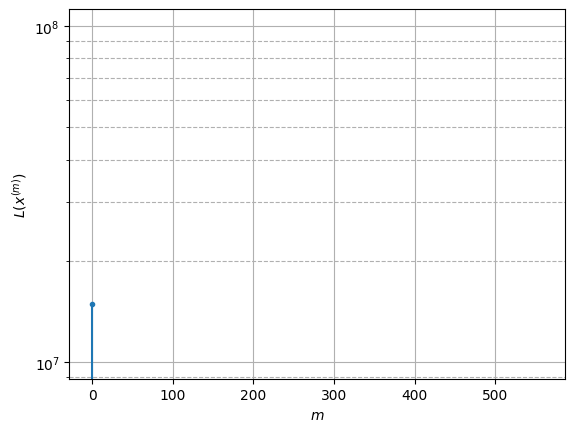

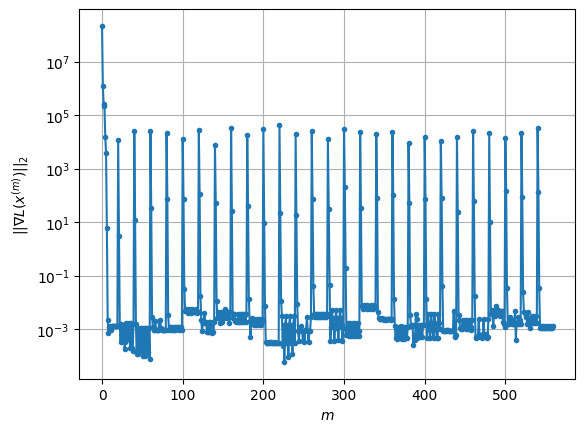

Windows:   7%|▋         | 28/376 [03:22<42:42,  7.36s/it]

Before applying the algorithm
Cost function: -3151357.753705604
Gradient norm: 16890.043500804728
Global relative error: 33.96113358575523
Position relative errors: 0.040159239685085495 m, 5.750196733479381 m, 21.304074567199393 m, 25.815257113181712 m

Iteration 1
Cost function: -3151360.5882905805 (-0.00%)
Gradient norm: 107.17916353170425 (-99.37%)
Global relative error: 22.881503820626016 (-32.62%)
Position relative errors: 0.012440282383188003 m, 10.771665095587359 m, 10.983667756641214 m, 16.937892149622378 m

Iteration 2
Cost function: -3151360.5890417737 (-0.00%)
Gradient norm: 0.024585910093899006 (-99.98%)
Global relative error: 23.01581253723768 (0.59%)
Position relative errors: 0.01244029422800387 m, 10.717093848937331 m, 11.194584449091266 m, 17.016213331959857 m

Iteration 3
Cost function: -3151360.5890418105 (-0.00%)
Gradient norm: 0.0012418780549970166 (-94.95%)
Global relative error: 23.016021749433673 (0.00%)
Position relative errors: 0.01244029416247952 m, 10.7170828

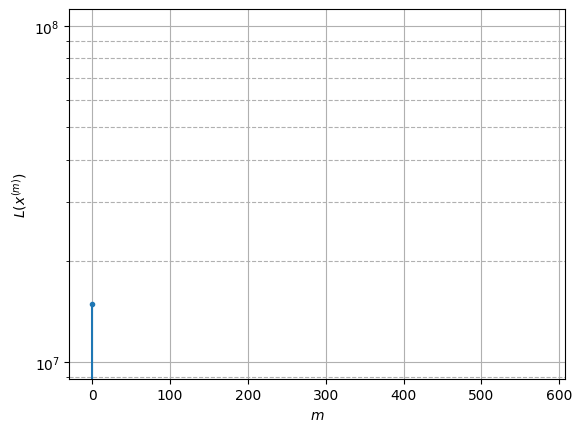

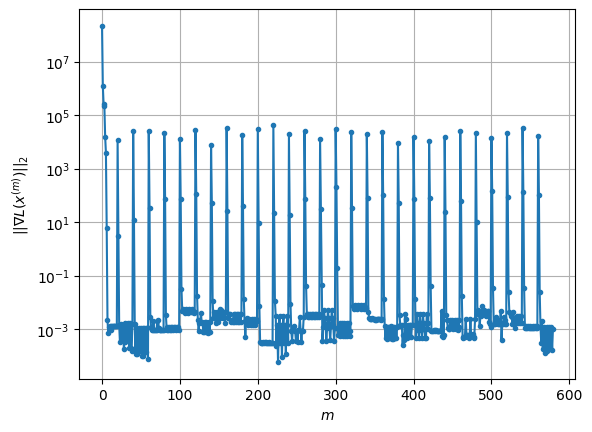

Windows:   8%|▊         | 29/376 [03:30<42:48,  7.40s/it]

Before applying the algorithm
Cost function: -3151357.6860584114
Gradient norm: 22155.720317080646
Global relative error: 23.230105278077612
Position relative errors: 0.011834722677554603 m, 9.534411258652948 m, 11.62176067331873 m, 17.710625776754647 m

Iteration 1
Cost function: -3151361.806552444 (-0.00%)
Gradient norm: 88.30859914631077 (-99.60%)
Global relative error: 33.20439069169587 (42.94%)
Position relative errors: 0.05048311003567304 m, 6.904756251326974 m, 15.488986696922089 m, 28.547208151238262 m

Iteration 2
Cost function: -3151361.8071415387 (-0.00%)
Gradient norm: 0.03591724932314571 (-99.96%)
Global relative error: 33.10644567982329 (-0.29%)
Position relative errors: 0.05048311799383935 m, 6.863963416163819 m, 15.452674067536872 m, 28.462844845833118 m

Iteration 3
Cost function: -3151361.8071415443 (-0.00%)
Gradient norm: 0.0012880063762189201 (-96.41%)
Global relative error: 33.10628957849953 (-0.00%)
Position relative errors: 0.05048311767943023 m, 6.86395611115626

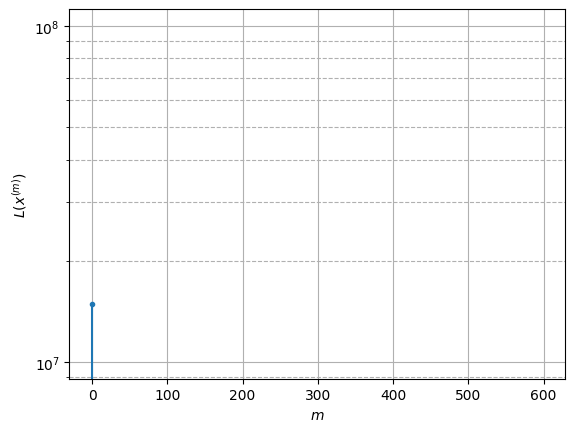

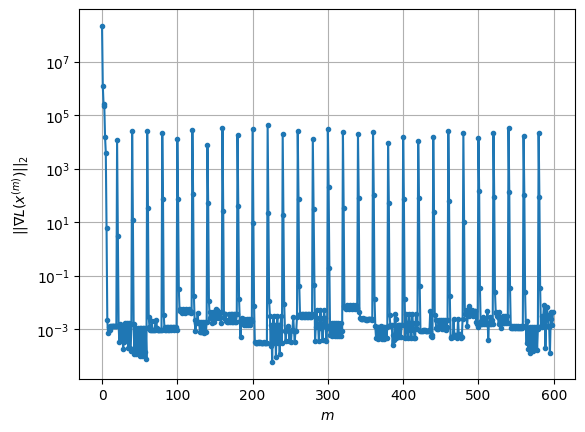

Windows:   8%|▊         | 30/376 [03:37<42:27,  7.36s/it]

Before applying the algorithm
Cost function: -3151351.875532722
Gradient norm: 22817.087399827986
Global relative error: 31.91774468643765
Position relative errors: 0.04619332853026273 m, 5.828948950000889 m, 15.389299599314613 m, 27.348341462996146 m

Iteration 1
Cost function: -3151353.5119099207 (-0.00%)
Gradient norm: 24.172301572663688 (-99.89%)
Global relative error: 26.159823278514338 (-18.04%)
Position relative errors: 0.07138227286413533 m, 5.162590262198928 m, 12.68709650746941 m, 22.287120594238978 m

Iteration 2
Cost function: -3151353.511943384 (-0.00%)
Gradient norm: 0.004126571285603155 (-99.98%)
Global relative error: 26.117292400802658 (-0.16%)
Position relative errors: 0.07138227328508108 m, 5.1624354626966005 m, 12.654158638706566 m, 22.255979866363276 m

Iteration 3
Cost function: -3151353.5119433934 (-0.00%)
Gradient norm: 0.0006879793285003008 (-83.33%)
Global relative error: 26.117273919182704 (-0.00%)
Position relative errors: 0.07138227363255141 m, 5.1624351286

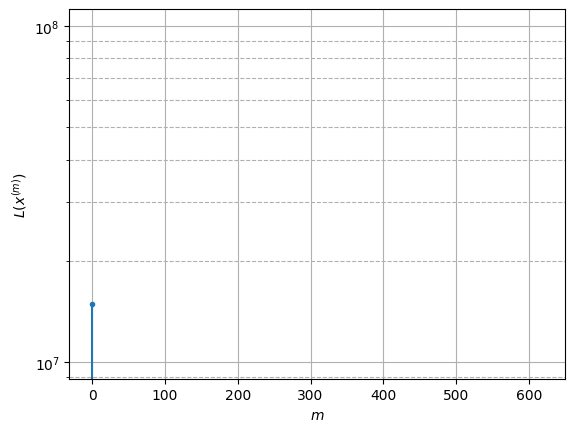

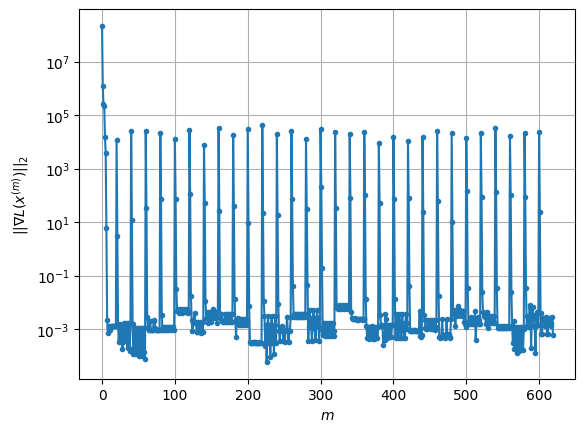

Windows:   8%|▊         | 31/376 [03:44<42:03,  7.31s/it]

Before applying the algorithm
Cost function: -3151354.4003830375
Gradient norm: 12784.350802388004
Global relative error: 25.77467068353957
Position relative errors: 0.06441087527059874 m, 4.224273881042833 m, 12.929287163645899 m, 21.893329486972686 m

Iteration 1
Cost function: -3151359.116055039 (-0.00%)
Gradient norm: 114.77922528369754 (-99.10%)
Global relative error: 49.323665323629825 (91.36%)
Position relative errors: 0.04144785445944706 m, 2.4893524799397375 m, 30.515273010989084 m, 38.6709325457254 m

Iteration 2
Cost function: -3151359.1172037455 (-0.00%)
Gradient norm: 0.059600873263380996 (-99.95%)
Global relative error: 48.710206847204915 (-1.24%)
Position relative errors: 0.04144786319385564 m, 2.4800712974847525 m, 30.040218800025873 m, 38.26375055670704 m

Iteration 3
Cost function: -3151359.1172037493 (-0.00%)
Gradient norm: 0.003279566066125894 (-94.50%)
Global relative error: 48.709372390829735 (-0.00%)
Position relative errors: 0.04144786364423012 m, 2.480070208282

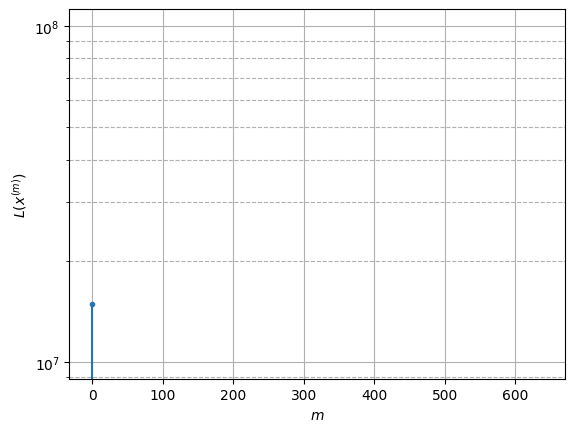

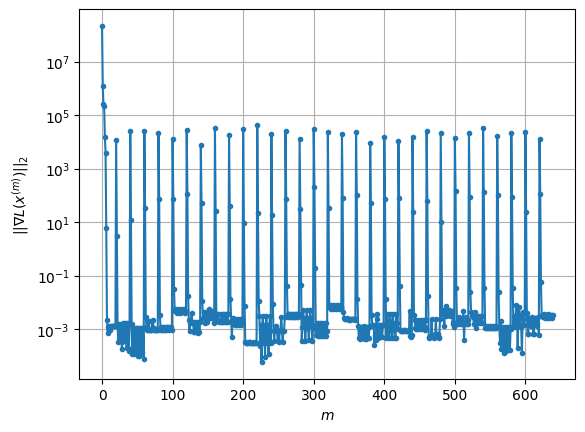

Windows:   9%|▊         | 32/376 [03:51<41:23,  7.22s/it]

Before applying the algorithm
Cost function: -3151357.632749877
Gradient norm: 12591.658638838971
Global relative error: 46.2971017939584
Position relative errors: 0.04056993937772914 m, 2.138949819753133 m, 28.67681809300818 m, 36.28336740354462 m

Iteration 1
Cost function: -3151361.1523902337 (-0.00%)
Gradient norm: 93.42812684717674 (-99.26%)
Global relative error: 41.005016659080056 (-11.43%)
Position relative errors: 0.041018332545893425 m, 3.187134679850068 m, 26.66452484646892 m, 30.98796398539852 m

Iteration 2
Cost function: -3151361.15294643 (-0.00%)
Gradient norm: 0.07633927826639171 (-99.92%)
Global relative error: 41.07291284746655 (0.17%)
Position relative errors: 0.04101831989322208 m, 3.2088548226540703 m, 26.726800475148217 m, 31.021972438865983 m

Iteration 3
Cost function: -3151361.1529464205 (0.00%)
Gradient norm: 0.0032207055245448697 (-95.78%)
Global relative error: 41.0727674133614 (-0.00%)
Position relative errors: 0.04101831947061602 m, 3.208863487525808 m, 26

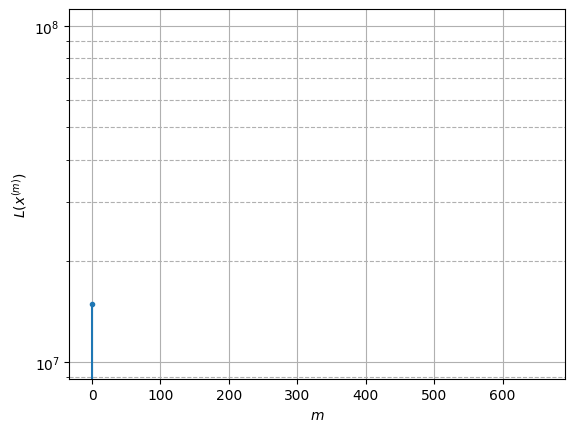

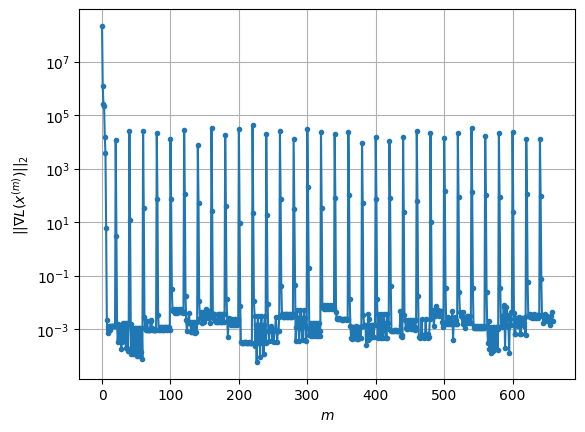

Windows:   9%|▉         | 33/376 [03:59<41:30,  7.26s/it]

Before applying the algorithm
Cost function: -3151351.3443624666
Gradient norm: 38929.13337746962
Global relative error: 40.000537728380735
Position relative errors: 0.0386522618160411 m, 2.4192428348252726 m, 26.136731927189388 m, 30.18375471779023 m

Iteration 1
Cost function: -3151355.2019232865 (-0.00%)
Gradient norm: 100.96388308670647 (-99.74%)
Global relative error: 28.476227450931866 (-28.81%)
Position relative errors: 0.07193209971469647 m, 4.337588001182239 m, 17.195425567931967 m, 22.279867196282314 m

Iteration 2
Cost function: -3151355.202512254 (-0.00%)
Gradient norm: 0.03828281493237609 (-99.96%)
Global relative error: 28.397904933724163 (-0.28%)
Position relative errors: 0.07193209950068624 m, 4.322962590754914 m, 17.12071257652774 m, 22.240244896451447 m

Iteration 3
Cost function: -3151355.2025122615 (-0.00%)
Gradient norm: 0.0006922268380733717 (-98.19%)
Global relative error: 28.397981247245298 (0.00%)
Position relative errors: 0.07193210014812175 m, 4.3229421994101

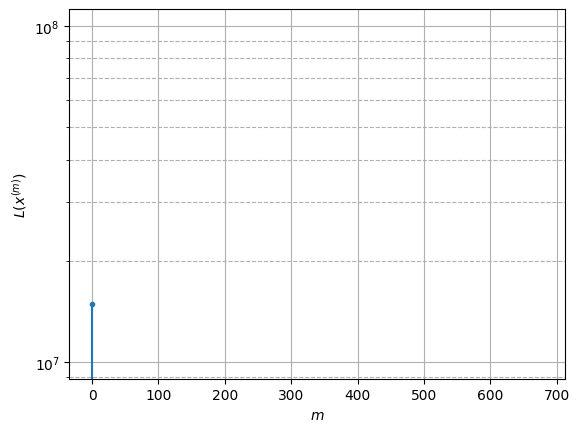

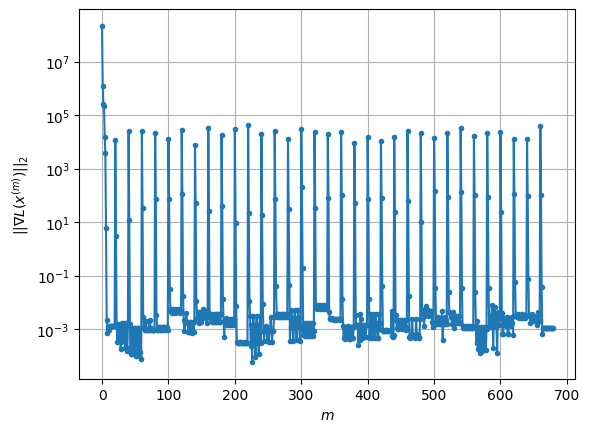

Windows:   9%|▉         | 34/376 [04:06<41:16,  7.24s/it]

Before applying the algorithm
Cost function: -3151354.1101339627
Gradient norm: 15083.067261724256
Global relative error: 27.368171038912443
Position relative errors: 0.06477281241394131 m, 3.7793042758234683 m, 16.62115419889254 m, 21.411821849408465 m

Iteration 1
Cost function: -3151358.666887801 (-0.00%)
Gradient norm: 79.94489693929276 (-99.47%)
Global relative error: 18.088934020633094 (-33.91%)
Position relative errors: 0.1035936258283377 m, 7.320198363840481 m, 9.833242670681459 m, 13.301130588067297 m

Iteration 2
Cost function: -3151358.6682607434 (-0.00%)
Gradient norm: 0.03428495961578388 (-99.96%)
Global relative error: 18.20671439496654 (0.65%)
Position relative errors: 0.10359362435318772 m, 7.387202475883578 m, 9.956968564557094 m, 13.332703101229937 m

Iteration 3
Cost function: -3151358.6682607424 (0.00%)
Gradient norm: 0.0024996243317231656 (-92.71%)
Global relative error: 18.206931513998885 (0.00%)
Position relative errors: 0.10359362430318943 m, 7.3872426237528135 

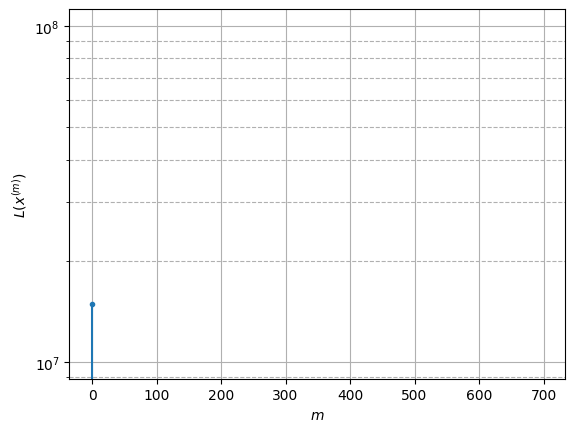

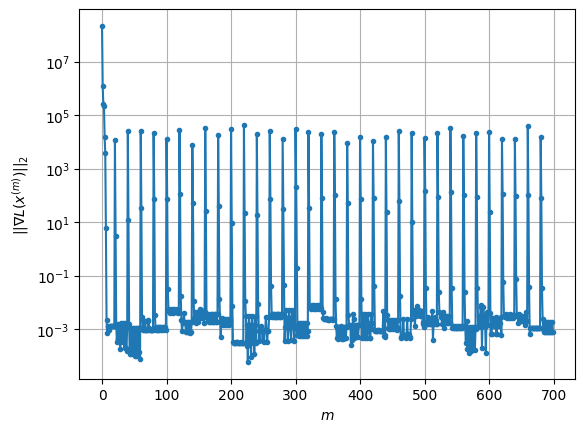

Windows:   9%|▉         | 35/376 [04:13<41:40,  7.33s/it]

Before applying the algorithm
Cost function: -3151353.978034208
Gradient norm: 12202.587596200085
Global relative error: 16.804457416925143
Position relative errors: 0.09196134845397738 m, 6.83145204865145 m, 9.218850176053598 m, 12.277001075675809 m

Iteration 1
Cost function: -3151359.643524889 (-0.00%)
Gradient norm: 254.47967864233564 (-97.91%)
Global relative error: 30.91920207937084 (83.99%)
Position relative errors: 0.10063050001272995 m, 8.021779898705896 m, 20.24028452235061 m, 21.953716912030984 m

Iteration 2
Cost function: -3151359.646191046 (-0.00%)
Gradient norm: 0.2778649898384046 (-99.89%)
Global relative error: 30.784150420975703 (-0.44%)
Position relative errors: 0.10063049739079234 m, 8.05496603821364 m, 20.078777613361282 m, 21.900021281732624 m

Iteration 3
Cost function: -3151359.6461910508 (-0.00%)
Gradient norm: 0.002014341328362772 (-99.28%)
Global relative error: 30.784366815475657 (0.00%)
Position relative errors: 0.10063049724050904 m, 8.054905506673418 m, 2

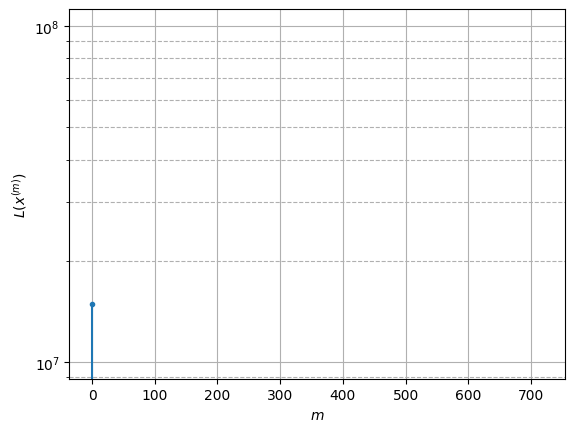

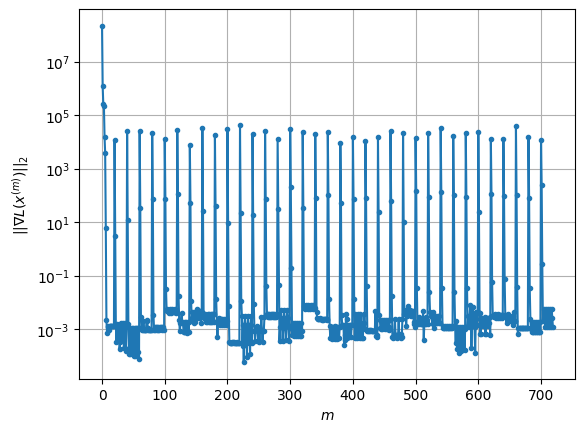

Windows:  10%|▉         | 36/376 [04:21<41:40,  7.35s/it]

Before applying the algorithm
Cost function: -3151352.9544040137
Gradient norm: 26580.434205471818
Global relative error: 27.52548500835832
Position relative errors: 0.09015731083304189 m, 7.692126181078531 m, 18.06080764053532 m, 19.29454256512891 m

Iteration 1
Cost function: -3151358.114276085 (-0.00%)
Gradient norm: 131.00133149460834 (-99.51%)
Global relative error: 14.766744494408641 (-46.35%)
Position relative errors: 0.0767311593867759 m, 8.008566650504209 m, 8.575946699696441 m, 8.964690188668612 m

Iteration 2
Cost function: -3151358.1161102685 (-0.00%)
Gradient norm: 0.4422668009768159 (-99.66%)
Global relative error: 14.640825290692465 (-0.85%)
Position relative errors: 0.0767311395650885 m, 8.045694121178293 m, 8.520402163809415 m, 8.77588549909315 m

Iteration 3
Cost function: -3151358.1161102783 (-0.00%)
Gradient norm: 0.0007465231174288472 (-99.83%)
Global relative error: 14.640452347808674 (-0.00%)
Position relative errors: 0.07673113956854577 m, 8.045746765144761 m, 8

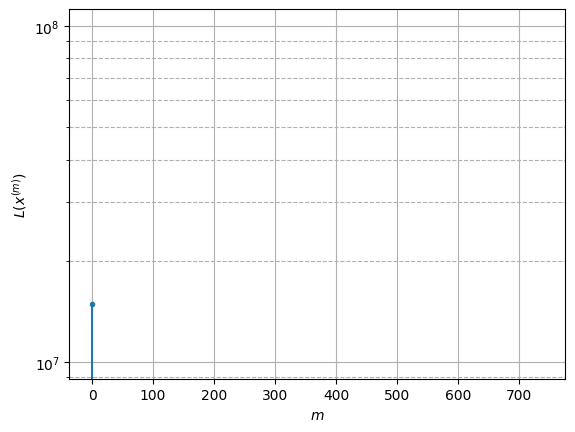

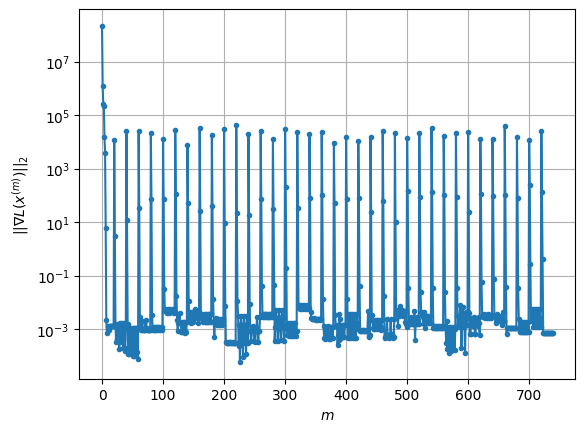

Windows:  10%|▉         | 37/376 [04:28<41:42,  7.38s/it]

Before applying the algorithm
Cost function: -3151360.5433171587
Gradient norm: 16564.55081897866
Global relative error: 12.944698606302447
Position relative errors: 0.06804604983031716 m, 7.689204594231599 m, 7.282577998152918 m, 7.443084595882775 m

Iteration 1
Cost function: -3151364.9990654965 (-0.00%)
Gradient norm: 26.46519312412779 (-99.84%)
Global relative error: 9.254782435428144 (-28.51%)
Position relative errors: 0.08908474566994845 m, 6.5492101456734995 m, 5.548651812924782 m, 3.458666854045375 m

Iteration 2
Cost function: -3151364.999217488 (-0.00%)
Gradient norm: 0.018308322452651023 (-99.93%)
Global relative error: 9.394020911512735 (1.50%)
Position relative errors: 0.08908474317770436 m, 6.571186640353287 m, 5.666587163106163 m, 3.5983288874840067 m

Iteration 3
Cost function: -3151364.9992174753 (0.00%)
Gradient norm: 0.0019696079723350076 (-89.24%)
Global relative error: 9.39402965480576 (0.00%)
Position relative errors: 0.08908474407465344 m, 6.571189601200484 m, 5.

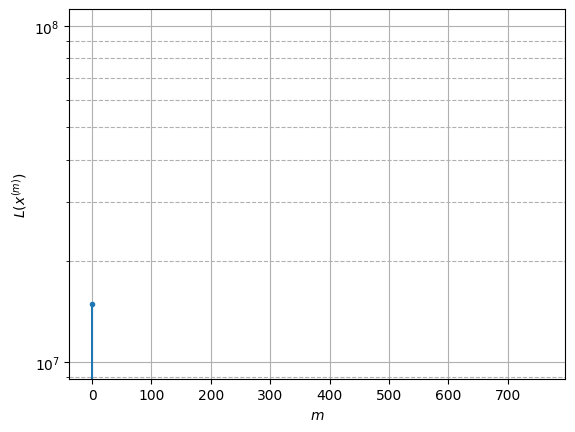

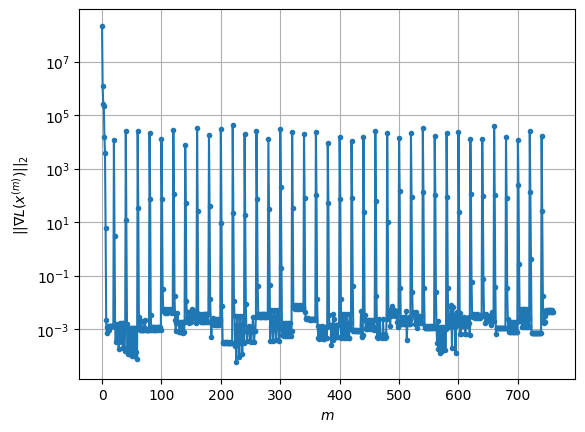

Windows:  10%|█         | 38/376 [04:35<41:05,  7.29s/it]

Before applying the algorithm
Cost function: -3151358.673994124
Gradient norm: 24496.8029630708
Global relative error: 8.088782068185372
Position relative errors: 0.0797723853907326 m, 6.150816328266388 m, 4.640660223814076 m, 2.460234672503239 m

Iteration 1
Cost function: -3151360.3697938933 (-0.00%)
Gradient norm: 13.283026534409903 (-99.95%)
Global relative error: 10.486461844674487 (29.64%)
Position relative errors: 0.055404492175385706 m, 8.012271673499662 m, 4.943001955953133 m, 4.618682504665667 m

Iteration 2
Cost function: -3151360.369830745 (-0.00%)
Gradient norm: 0.0011095207518614205 (-99.99%)
Global relative error: 10.481595097114619 (-0.05%)
Position relative errors: 0.055404490642728184 m, 7.998696047214369 m, 4.957969346111553 m, 4.61512139637584 m

Iteration 3
Cost function: -3151360.3698307537 (-0.00%)
Gradient norm: 0.001804626370589029 (62.65%)
Global relative error: 10.481593902643253 (-0.00%)
Position relative errors: 0.055404490642728184 m, 7.99869501146793 m, 4

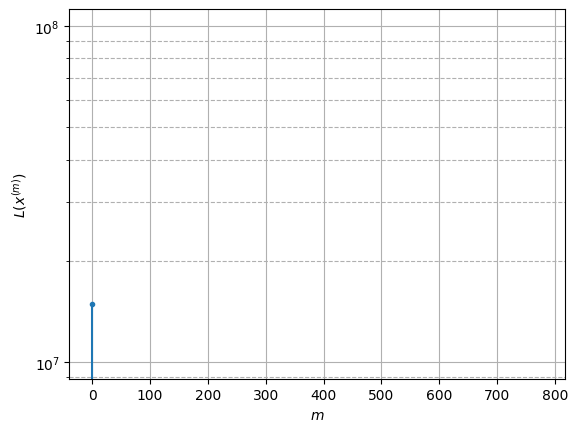

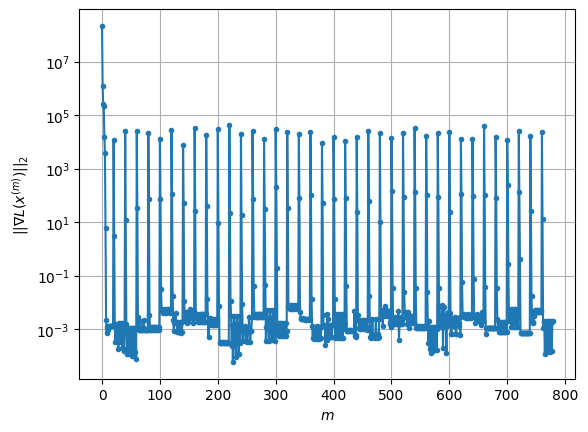

Windows:  10%|█         | 39/376 [04:42<40:49,  7.27s/it]

Before applying the algorithm
Cost function: -3151358.6787133263
Gradient norm: 10086.160295358559
Global relative error: 10.801873217258878
Position relative errors: 0.04920658479887605 m, 7.689024847664976 m, 4.900496741137056 m, 5.791484636256417 m

Iteration 1
Cost function: -3151360.096309726 (-0.00%)
Gradient norm: 141.20560249431534 (-98.60%)
Global relative error: 11.279714329794496 (4.42%)
Position relative errors: 0.05724736794618731 m, 9.6390403836889 m, 3.0812531757146564 m, 4.98231138582106 m

Iteration 2
Cost function: -3151360.0967710223 (-0.00%)
Gradient norm: 0.01437896475110752 (-99.99%)
Global relative error: 11.260258029954452 (-0.17%)
Position relative errors: 0.05724736854772466 m, 9.613516124975456 m, 3.082579805018338 m, 4.986793881260272 m

Iteration 3
Cost function: -3151360.096771018 (0.00%)
Gradient norm: 0.003711099815132576 (-74.19%)
Global relative error: 11.260191475688547 (-0.00%)
Position relative errors: 0.057247367739235534 m, 9.613511963352893 m, 3.

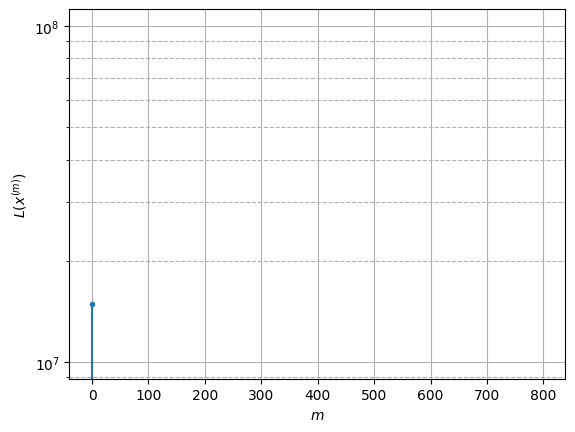

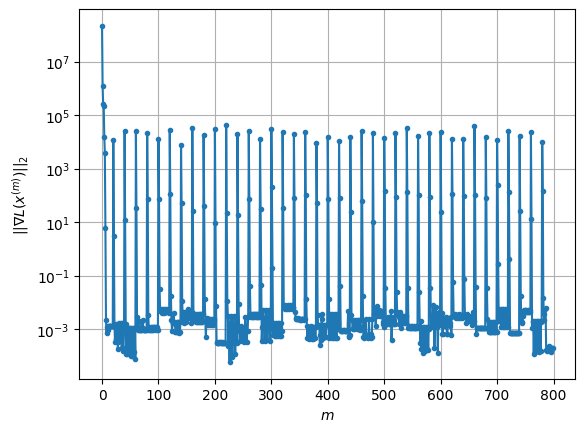

Windows:  11%|█         | 40/376 [04:50<40:22,  7.21s/it]

Before applying the algorithm
Cost function: -3151356.0527064065
Gradient norm: 41895.802889334635
Global relative error: 11.084597010394221
Position relative errors: 0.050951450932003345 m, 9.429786372430371 m, 3.0164775851243895 m, 4.984541493712539 m

Iteration 1
Cost function: -3151357.978346063 (-0.00%)
Gradient norm: 40.607815098668986 (-99.90%)
Global relative error: 13.29805663265944 (19.97%)
Position relative errors: 0.050858910576453545 m, 9.43318627499325 m, 5.723390125418908 m, 7.422491663282261 m

Iteration 2
Cost function: -3151357.9785399525 (-0.00%)
Gradient norm: 0.01976303955705017 (-99.95%)
Global relative error: 13.097422768199781 (-1.51%)
Position relative errors: 0.05085891530993064 m, 9.443042873061227 m, 5.5482366135644 m, 7.182323239055573 m

Iteration 3
Cost function: -3151357.978539964 (-0.00%)
Gradient norm: 0.0010226530031867203 (-94.83%)
Global relative error: 13.097298390350781 (-0.00%)
Position relative errors: 0.05085891431986866 m, 9.443045768845586 m,

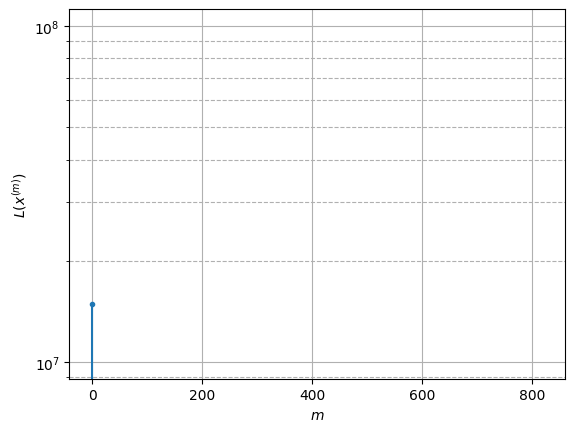

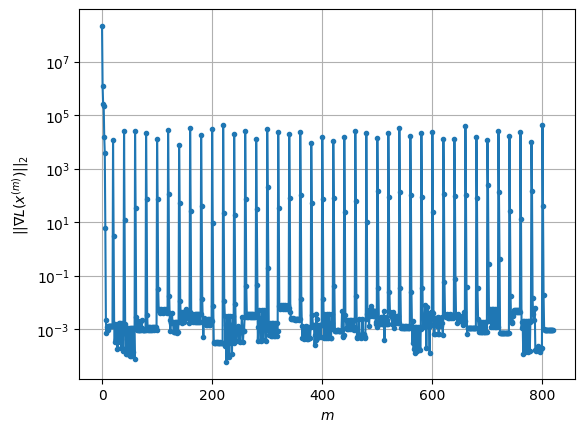

Windows:  11%|█         | 41/376 [04:57<39:57,  7.16s/it]

Before applying the algorithm
Cost function: -3151355.057630313
Gradient norm: 15531.543333589852
Global relative error: 12.591153576786498
Position relative errors: 0.047864011776152786 m, 9.314034178299881 m, 5.2537072962876925 m, 6.646957516241313 m

Iteration 1
Cost function: -3151359.2534364597 (-0.00%)
Gradient norm: 76.95341682437605 (-99.50%)
Global relative error: 8.565256350212385 (-31.97%)
Position relative errors: 0.04808131579411208 m, 7.054220230579375 m, 3.148700618592261 m, 3.699310722233467 m

Iteration 2
Cost function: -3151359.253857168 (-0.00%)
Gradient norm: 0.045994025153071924 (-99.94%)
Global relative error: 8.556383547235516 (-0.10%)
Position relative errors: 0.048081305463340815 m, 7.073318213008567 m, 3.1484175097046925 m, 3.642108506410546 m

Iteration 3
Cost function: -3151359.2538571917 (-0.00%)
Gradient norm: 0.000871153921656418 (-98.11%)
Global relative error: 8.556357804181925 (-0.00%)
Position relative errors: 0.04808130586214006 m, 7.073319642626187 

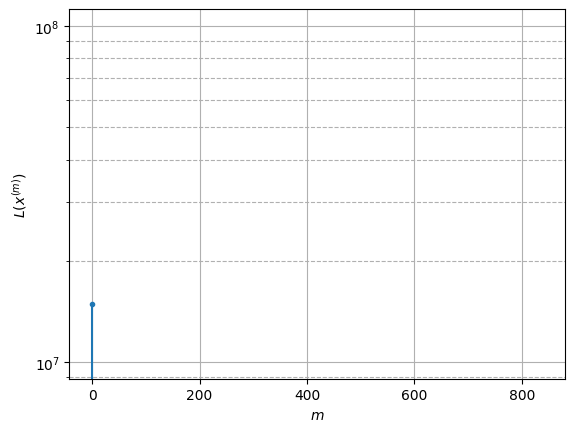

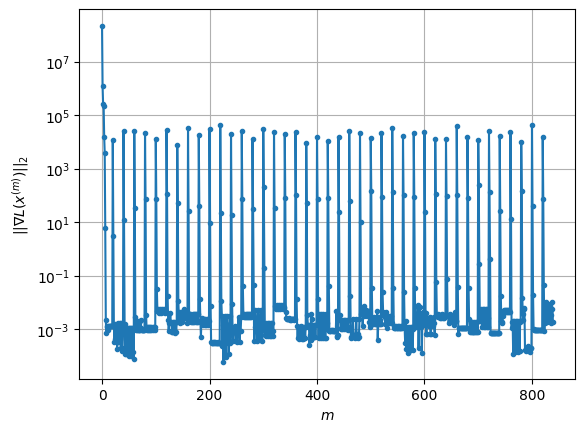

Windows:  11%|█         | 42/376 [05:04<39:47,  7.15s/it]

Before applying the algorithm
Cost function: -3151364.3037857995
Gradient norm: 34733.65930660098
Global relative error: 8.42144555379723
Position relative errors: 0.046406270649734765 m, 7.074547606158327 m, 2.9270755017981918 m, 3.507352997462697 m

Iteration 1
Cost function: -3151370.123881457 (-0.00%)
Gradient norm: 125.87241235451718 (-99.64%)
Global relative error: 19.245150655103604 (128.53%)
Position relative errors: 0.04722783495795493 m, 11.442939012479293 m, 10.470767347290677 m, 11.392759131314577 m

Iteration 2
Cost function: -3151370.1251367973 (-0.00%)
Gradient norm: 0.14599291683969748 (-99.88%)
Global relative error: 19.49257739653608 (1.29%)
Position relative errors: 0.04722783286793519 m, 11.412586267504341 m, 10.771981807130956 m, 11.561781249168789 m

Iteration 3
Cost function: -3151370.1251367964 (0.00%)
Gradient norm: 0.0002283096785168077 (-99.84%)
Global relative error: 19.492663232842922 (0.00%)
Position relative errors: 0.04722783330223999 m, 11.4125797314978

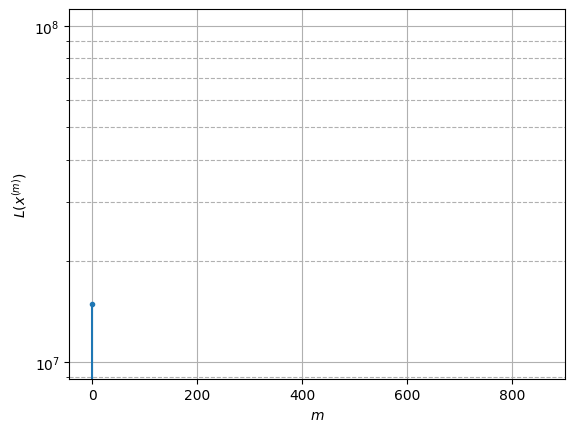

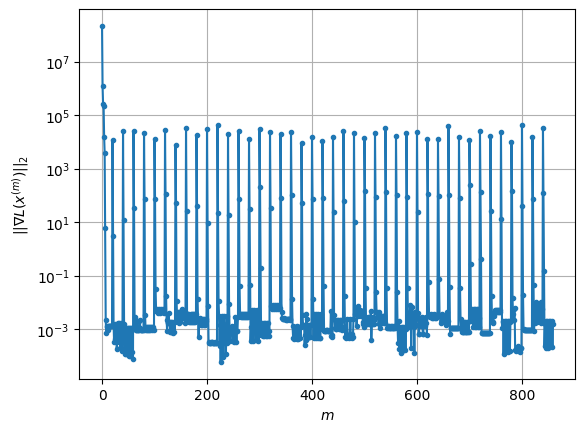

Windows:  11%|█▏        | 43/376 [05:11<39:06,  7.05s/it]

Before applying the algorithm
Cost function: -3151370.622717701
Gradient norm: 12141.713283747276
Global relative error: 18.027226910415788
Position relative errors: 0.04586881714752615 m, 11.072619929613737 m, 9.514552804750217 m, 10.575838452544765 m

Iteration 1
Cost function: -3151373.7875491995 (-0.00%)
Gradient norm: 151.93959876643154 (-98.75%)
Global relative error: 20.236778117195307 (12.26%)
Position relative errors: 0.07730881887464099 m, 12.493479013759002 m, 7.151696814467363 m, 14.222744536705799 m

Iteration 2
Cost function: -3151373.7886015875 (-0.00%)
Gradient norm: 0.10308095708396733 (-99.93%)
Global relative error: 20.34257548439328 (0.52%)
Position relative errors: 0.07730881959237765 m, 12.469010289410045 m, 7.212125565459468 m, 14.363929958346258 m

Iteration 3
Cost function: -3151373.788601593 (-0.00%)
Gradient norm: 0.0002669740913148107 (-99.74%)
Global relative error: 20.342827983837147 (0.00%)
Position relative errors: 0.07730881977945511 m, 12.4689834830243

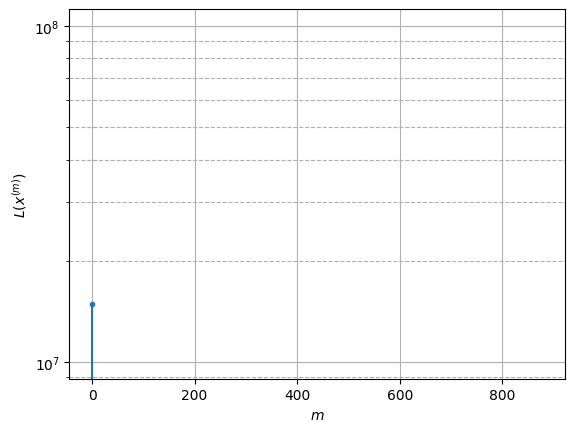

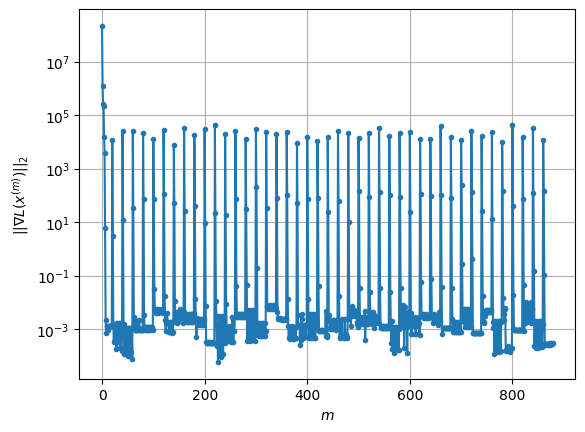

Windows:  12%|█▏        | 44/376 [05:17<38:36,  6.98s/it]

Before applying the algorithm
Cost function: -3151370.56625647
Gradient norm: 12718.346984458622
Global relative error: 18.841816660382914
Position relative errors: 0.07254669567868167 m, 11.882783642456213 m, 7.23254426064948 m, 12.708170090582199 m

Iteration 1
Cost function: -3151373.472846068 (-0.00%)
Gradient norm: 69.90946205436461 (-99.45%)
Global relative error: 26.717609741874607 (41.80%)
Position relative errors: 0.05381368978094801 m, 11.213351108576664 m, 11.31937500834833 m, 21.4466528923228 m

Iteration 2
Cost function: -3151373.4730925565 (-0.00%)
Gradient norm: 0.022862583031016587 (-99.97%)
Global relative error: 26.617749831279905 (-0.37%)
Position relative errors: 0.05381368993468495 m, 11.177228586536948 m, 11.256324129398589 m, 21.37440278302262 m

Iteration 3
Cost function: -3151373.4730925946 (-0.00%)
Gradient norm: 0.003646841007519332 (-84.05%)
Global relative error: 26.61775386996425 (0.00%)
Position relative errors: 0.05381369010505724 m, 11.177216635005017 m

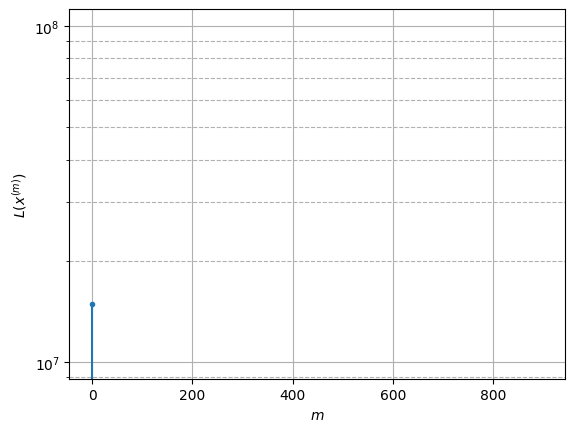

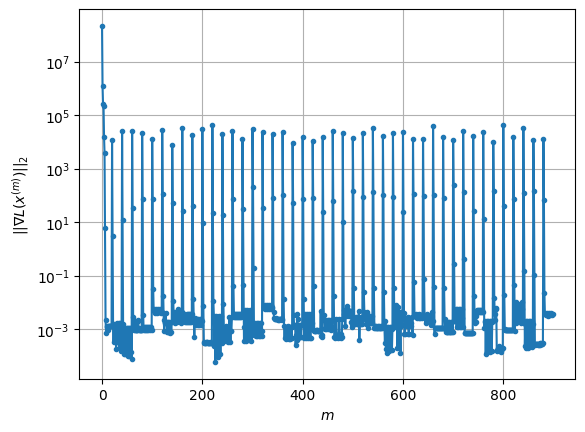

Windows:  12%|█▏        | 45/376 [05:24<38:31,  6.98s/it]

Before applying the algorithm
Cost function: -3151375.119257467
Gradient norm: 13972.771791637853
Global relative error: 24.74207219326345
Position relative errors: 0.050972373668592294 m, 10.627091967159622 m, 11.0601099917293 m, 19.414044013168308 m

Iteration 1
Cost function: -3151376.6825863146 (-0.00%)
Gradient norm: 37.47681893388575 (-99.73%)
Global relative error: 23.251062338324726 (-6.03%)
Position relative errors: 0.060356427402117475 m, 10.93391836174396 m, 9.104820088389678 m, 18.389101253711154 m

Iteration 2
Cost function: -3151376.6826354307 (-0.00%)
Gradient norm: 0.007999962201277204 (-99.98%)
Global relative error: 23.261799930906655 (0.05%)
Position relative errors: 0.06035642778462296 m, 10.952938508548764 m, 9.11897940966095 m, 18.38434515597782 m

Iteration 3
Cost function: -3151376.6826354526 (-0.00%)
Gradient norm: 0.0016976726980219286 (-78.78%)
Global relative error: 23.261790751122174 (-0.00%)
Position relative errors: 0.060356427588985365 m, 10.952940405992

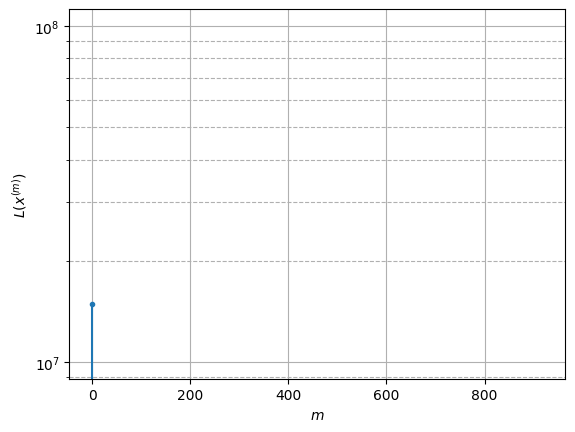

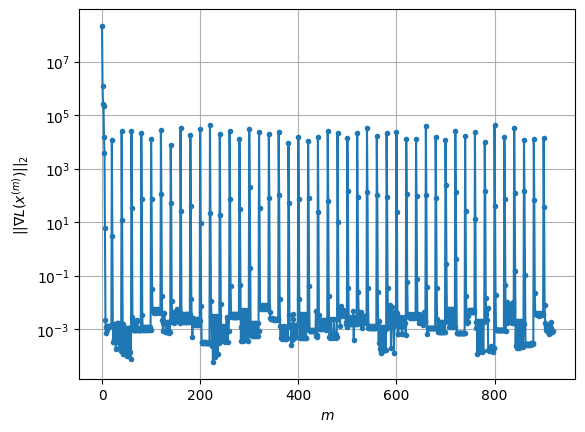

Windows:  12%|█▏        | 46/376 [05:31<38:33,  7.01s/it]

Before applying the algorithm
Cost function: -3151371.1720401696
Gradient norm: 10587.613673206779
Global relative error: 21.70780995250486
Position relative errors: 0.05727162147721427 m, 10.36100979216152 m, 8.970053968545667 m, 16.834858520041944 m

Iteration 1
Cost function: -3151373.726062222 (-0.00%)
Gradient norm: 129.31858870183945 (-98.78%)
Global relative error: 38.22253759971789 (76.08%)
Position relative errors: 0.06317681566077862 m, 13.509197600639958 m, 22.00057037207471 m, 28.185673446223458 m

Iteration 2
Cost function: -3151373.727145224 (-0.00%)
Gradient norm: 0.18196612279164381 (-99.86%)
Global relative error: 38.14958344274664 (-0.19%)
Position relative errors: 0.06317681831541454 m, 13.438607382936588 m, 21.92924755605793 m, 28.176160930777247 m

Iteration 3
Cost function: -3151373.7271452183 (0.00%)
Gradient norm: 0.0012473087823511285 (-99.31%)
Global relative error: 38.14965434239569 (0.00%)
Position relative errors: 0.06317681759675689 m, 13.438543845949392 m

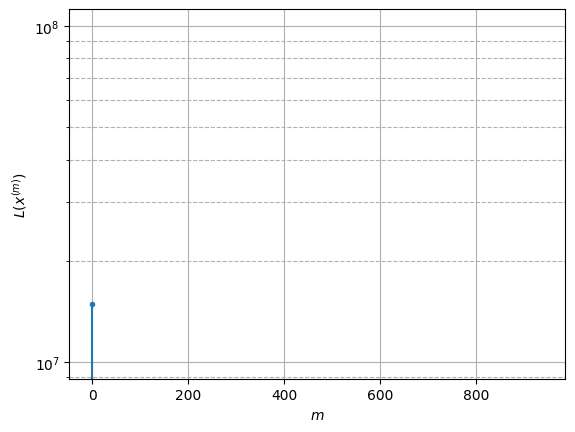

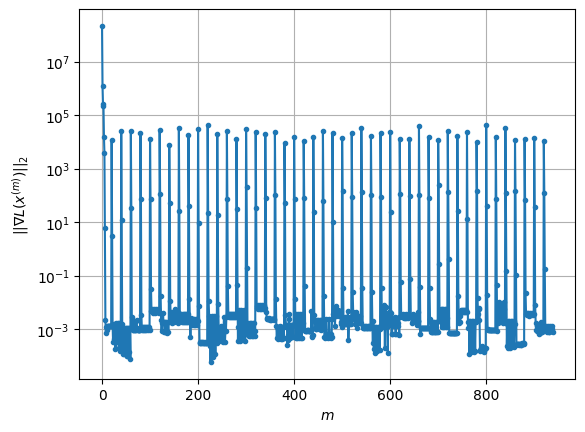

Windows:  12%|█▎        | 47/376 [05:38<38:23,  7.00s/it]

Before applying the algorithm
Cost function: -3151374.481607411
Gradient norm: 13521.311885804733
Global relative error: 35.22988093977011
Position relative errors: 0.06037833177124388 m, 12.634701647955028 m, 20.710600068922737 m, 25.54551740399851 m

Iteration 1
Cost function: -3151377.935439511 (-0.00%)
Gradient norm: 178.90712451851812 (-98.68%)
Global relative error: 26.919919515824674 (-23.59%)
Position relative errors: 0.08302660733113627 m, 12.341283287733752 m, 10.548928346775492 m, 21.47292438651308 m

Iteration 2
Cost function: -3151377.936952139 (-0.00%)
Gradient norm: 0.21959420741528274 (-99.88%)
Global relative error: 26.82019431254702 (-0.37%)
Position relative errors: 0.08302661040963495 m, 12.306379721072206 m, 10.467406022273318 m, 21.407962945019875 m

Iteration 3
Cost function: -3151377.936952132 (0.00%)
Gradient norm: 0.0021483245615862186 (-99.02%)
Global relative error: 26.820327034412237 (0.00%)
Position relative errors: 0.08302661040060752 m, 12.30629785051198

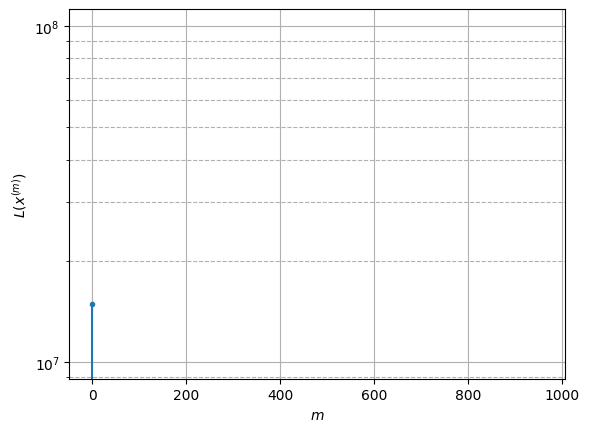

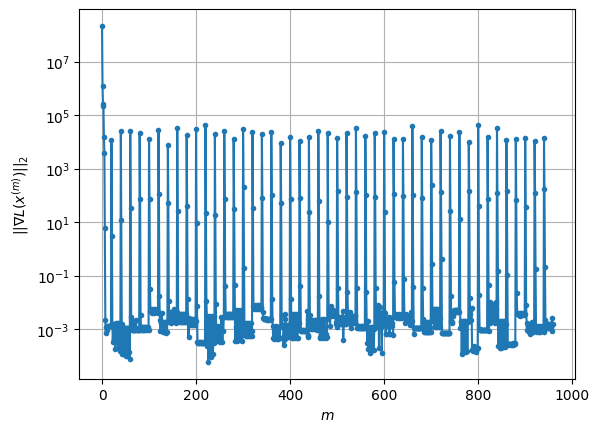

Windows:  13%|█▎        | 48/376 [05:45<38:21,  7.02s/it]

Before applying the algorithm
Cost function: -3151367.2256569536
Gradient norm: 37611.72845558099
Global relative error: 24.82237473649163
Position relative errors: 0.07496514469883134 m, 11.509361463731382 m, 10.173101219109727 m, 19.498354344157562 m

Iteration 1
Cost function: -3151369.357866635 (-0.00%)
Gradient norm: 38.921394173916674 (-99.90%)
Global relative error: 13.27426107950227 (-46.52%)
Position relative errors: 0.06641266374926433 m, 9.54539574672295 m, 3.613721136214057 m, 8.486881907144106 m

Iteration 2
Cost function: -3151369.3582201996 (-0.00%)
Gradient norm: 0.015792042927163158 (-99.96%)
Global relative error: 13.18666814200799 (-0.66%)
Position relative errors: 0.06641266721864027 m, 9.53297796734247 m, 3.564219691319386 m, 8.384605388138521 m

Iteration 3
Cost function: -3151369.3582202266 (-0.00%)
Gradient norm: 0.0004492172510284378 (-97.16%)
Global relative error: 13.186619511392625 (-0.00%)
Position relative errors: 0.0664126675546573 m, 9.532969681248966 m,

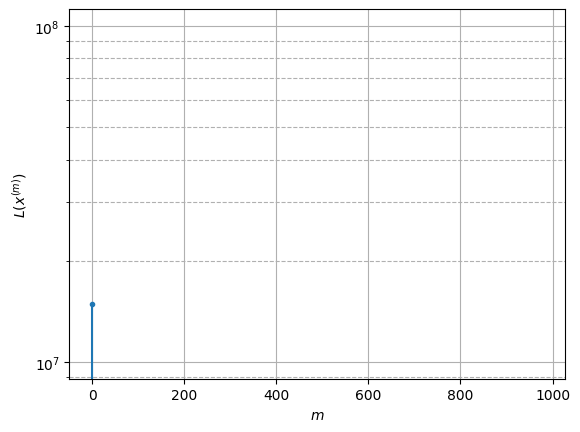

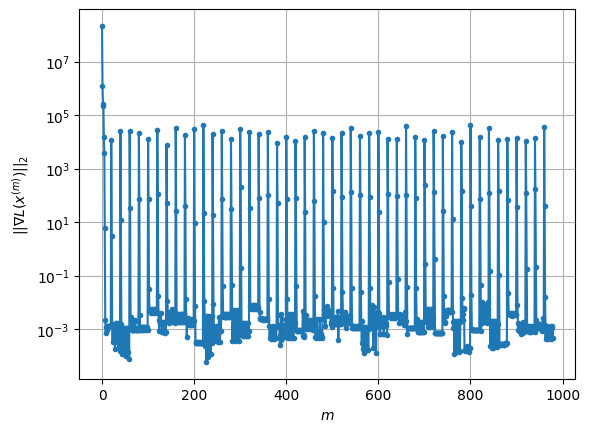

Windows:  13%|█▎        | 49/376 [05:53<38:27,  7.06s/it]

Before applying the algorithm
Cost function: -3151361.557900048
Gradient norm: 24176.88072560184
Global relative error: 12.299994198993272
Position relative errors: 0.062205267621404416 m, 8.875497606634108 m, 3.178111702785148 m, 7.900018599919598 m

Iteration 1
Cost function: -3151363.4320317977 (-0.00%)
Gradient norm: 12.525709471073815 (-99.95%)
Global relative error: 13.964961366584365 (13.54%)
Position relative errors: 0.04766438420454212 m, 8.276448532210205 m, 3.5951604925140717 m, 10.657962170662413 m

Iteration 2
Cost function: -3151363.432114544 (-0.00%)
Gradient norm: 0.02070825229457063 (-99.83%)
Global relative error: 13.946683492280636 (-0.13%)
Position relative errors: 0.04766438571144438 m, 8.261072756097679 m, 3.553113703142134 m, 10.660058369832573 m

Iteration 3
Cost function: -3151363.432114525 (0.00%)
Gradient norm: 0.0026416579684787464 (-87.24%)
Global relative error: 13.946683279038254 (-0.00%)
Position relative errors: 0.04766438622568874 m, 8.261071698436249 

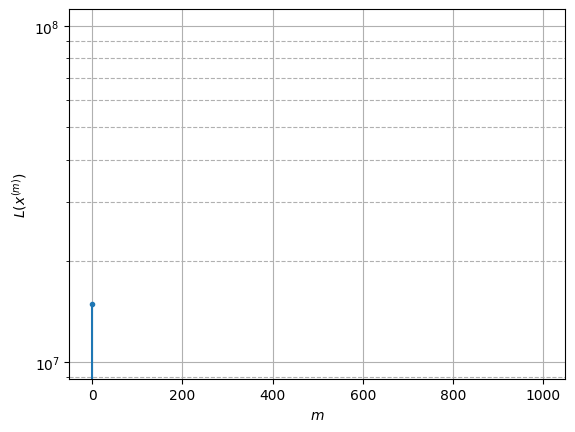

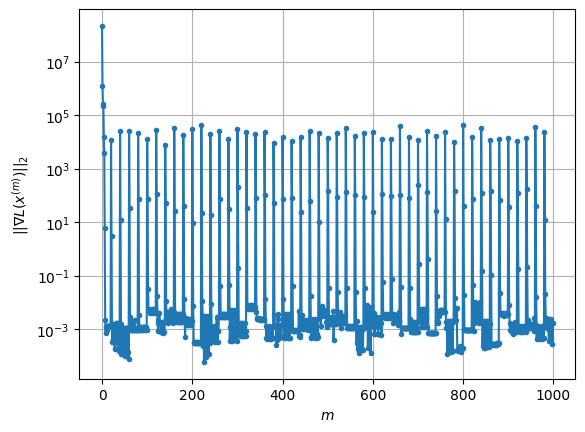

Windows:  13%|█▎        | 50/376 [05:59<38:02,  7.00s/it]

Before applying the algorithm
Cost function: -3151358.5587524
Gradient norm: 22522.369448703812
Global relative error: 12.85858204188967
Position relative errors: 0.04774686397997131 m, 7.699302630039473 m, 3.4449723946340054 m, 9.705300439521045 m

Iteration 1
Cost function: -3151363.0704964977 (-0.00%)
Gradient norm: 145.5126891261774 (-99.35%)
Global relative error: 11.771434713052214 (-8.45%)
Position relative errors: 0.037555161101624455 m, 6.950008234773555 m, 5.002952564999305 m, 8.076617597499478 m

Iteration 2
Cost function: -3151363.0717854756 (-0.00%)
Gradient norm: 0.2308562201372561 (-99.84%)
Global relative error: 11.747204598044647 (-0.21%)
Position relative errors: 0.03755516284552038 m, 6.934871889904455 m, 5.055934823194395 m, 8.021169299111524 m

Iteration 3
Cost function: -3151363.0717854747 (0.00%)
Gradient norm: 0.002233548620941651 (-99.03%)
Global relative error: 11.747269713128242 (0.00%)
Position relative errors: 0.03755516282975199 m, 6.9348468881487655 m, 5.

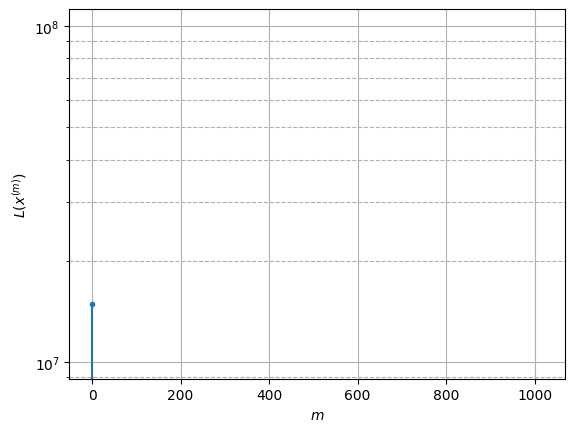

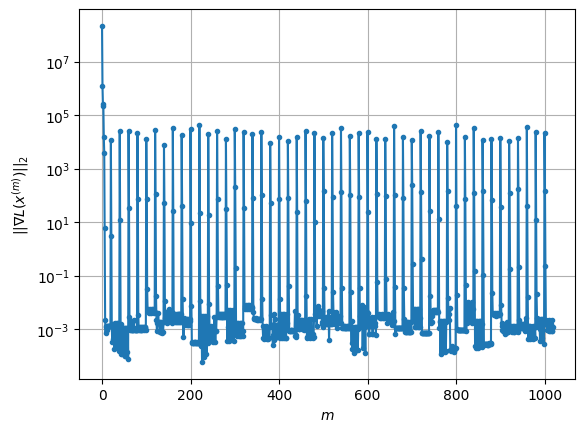

Windows:  14%|█▎        | 51/376 [06:06<37:59,  7.01s/it]

Before applying the algorithm
Cost function: -3151357.6347215823
Gradient norm: 29346.09879594896
Global relative error: 9.863777850500588
Position relative errors: 0.03802486509584824 m, 6.3579679650532865 m, 4.298132419050091 m, 6.196258379426407 m

Iteration 1
Cost function: -3151362.2996170726 (-0.00%)
Gradient norm: 35.715931386689775 (-99.88%)
Global relative error: 10.6283705485927 (7.75%)
Position relative errors: 0.05628630880855434 m, 7.375012323294798 m, 6.180224001337776 m, 4.513544491316868 m

Iteration 2
Cost function: -3151362.300083297 (-0.00%)
Gradient norm: 0.18385836688341958 (-99.49%)
Global relative error: 10.718663176926889 (0.85%)
Position relative errors: 0.05628630748028335 m, 7.396307578166918 m, 6.250104451910207 m, 4.595250080176663 m

Iteration 3
Cost function: -3151362.300083309 (-0.00%)
Gradient norm: 0.0035730201486799565 (-98.06%)
Global relative error: 10.71868442672627 (0.00%)
Position relative errors: 0.056286307288407375 m, 7.396311711772089 m, 6.25

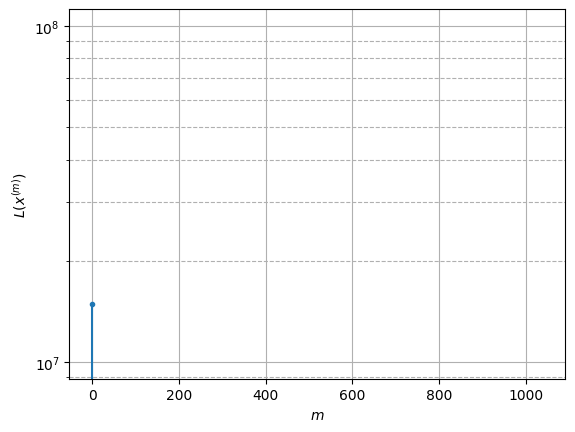

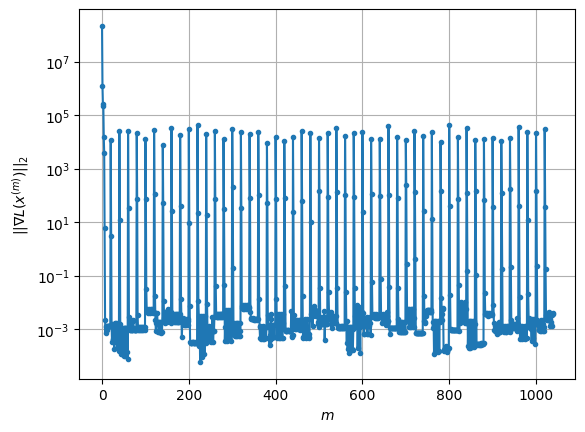

Windows:  14%|█▍        | 52/376 [06:13<37:50,  7.01s/it]

Before applying the algorithm
Cost function: -3151349.4661755897
Gradient norm: 19541.559195745795
Global relative error: 9.499518376595447
Position relative errors: 0.055639713013000816 m, 6.7043803987252835 m, 5.688161940482039 m, 3.5962170779966165 m

Iteration 1
Cost function: -3151351.302774196 (-0.00%)
Gradient norm: 119.596954659967 (-99.39%)
Global relative error: 12.786246715016665 (34.60%)
Position relative errors: 0.05952522678532745 m, 6.457395197873119 m, 6.367754963561796 m, 9.013188409122282 m

Iteration 2
Cost function: -3151351.303081076 (-0.00%)
Gradient norm: 0.00546058156339298 (-100.00%)
Global relative error: 12.792630989884897 (0.05%)
Position relative errors: 0.05952522718740136 m, 6.467795492310084 m, 6.3846222079305415 m, 9.002851858213168 m

Iteration 3
Cost function: -3151351.3030810524 (0.00%)
Gradient norm: 0.0009174216337920433 (-83.20%)
Global relative error: 12.792628866817074 (-0.00%)
Position relative errors: 0.05952522728557303 m, 6.467799097330218 m

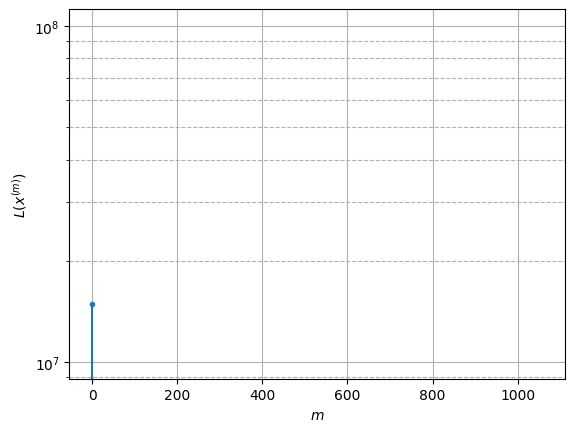

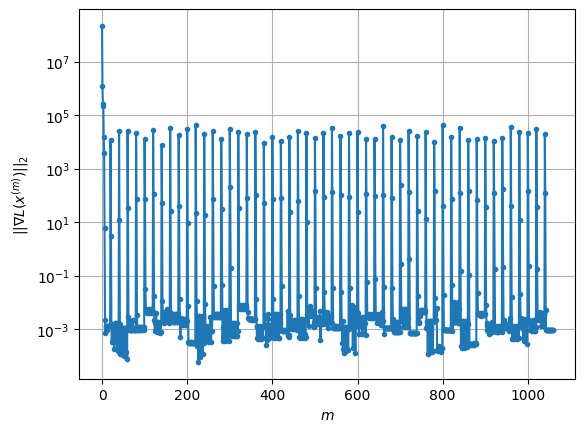

Windows:  14%|█▍        | 53/376 [06:21<37:53,  7.04s/it]

Before applying the algorithm
Cost function: -3151352.9474295606
Gradient norm: 37661.83065589381
Global relative error: 12.772327723987841
Position relative errors: 0.0590571972085399 m, 5.820153177518365 m, 6.092117814925692 m, 9.59896184031478 m

Iteration 1
Cost function: -3151355.238401725 (-0.00%)
Gradient norm: 77.66934109456092 (-99.79%)
Global relative error: 21.150365343525664 (65.60%)
Position relative errors: 0.051322617034437246 m, 6.33943290520324 m, 6.721235763314995 m, 19.0255431623503 m

Iteration 2
Cost function: -3151355.2388500604 (-0.00%)
Gradient norm: 0.0969735436410597 (-99.88%)
Global relative error: 21.105767430757876 (-0.21%)
Position relative errors: 0.051322616910148604 m, 6.34941341125881 m, 6.736585906711069 m, 18.967169888412126 m

Iteration 3
Cost function: -3151355.238850052 (0.00%)
Gradient norm: 0.0053989540185823675 (-94.43%)
Global relative error: 21.105772661639673 (0.00%)
Position relative errors: 0.051322616942894014 m, 6.349414049952762 m, 6.73

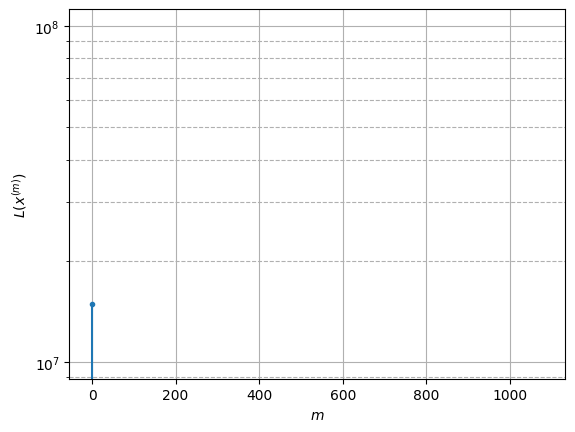

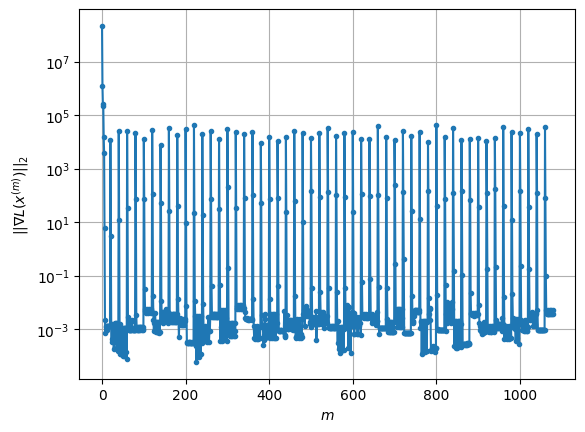

Windows:  14%|█▍        | 54/376 [06:27<37:22,  6.96s/it]

Before applying the algorithm
Cost function: -3151351.0840138784
Gradient norm: 24464.9396587504
Global relative error: 20.660515819125706
Position relative errors: 0.0498888702364983 m, 5.811821032964855 m, 6.383576135084777 m, 18.77036274903259 m

Iteration 1
Cost function: -3151355.4612749815 (-0.00%)
Gradient norm: 180.10095336512288 (-99.26%)
Global relative error: 16.087115724013582 (-22.14%)
Position relative errors: 0.08206411174686273 m, 4.635269701531385 m, 7.5512341564628755 m, 13.426888869423356 m

Iteration 2
Cost function: -3151355.4649346597 (-0.00%)
Gradient norm: 0.3914655133847513 (-99.78%)
Global relative error: 15.668497959416305 (-2.60%)
Position relative errors: 0.08206411100857279 m, 4.705956104039361 m, 7.303069155436476 m, 13.038937429315618 m

Iteration 3
Cost function: -3151355.464934725 (-0.00%)
Gradient norm: 0.004997631292315473 (-98.72%)
Global relative error: 15.667864947256842 (-0.00%)
Position relative errors: 0.08206411175170998 m, 4.706047621186982 m

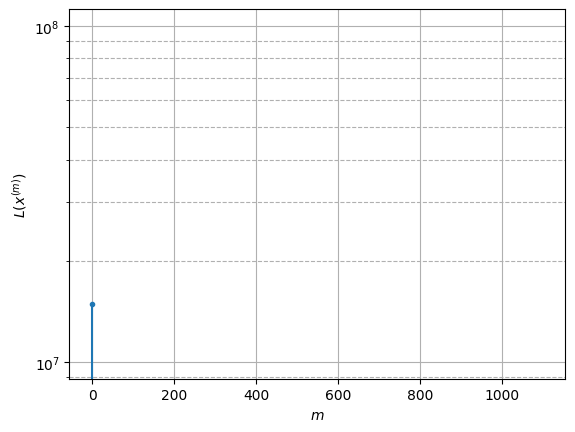

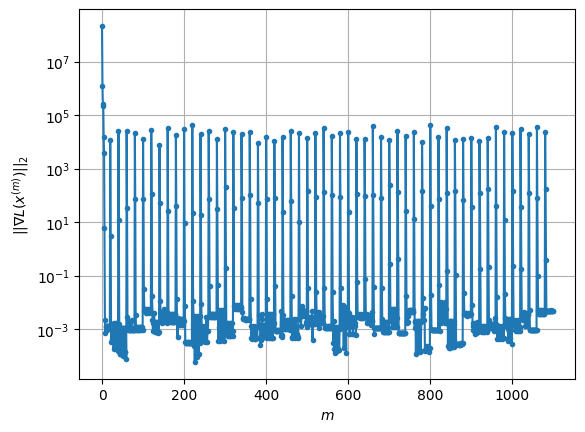

Windows:  15%|█▍        | 55/376 [06:34<37:04,  6.93s/it]

Before applying the algorithm
Cost function: -3151343.3899905747
Gradient norm: 45440.16194378068
Global relative error: 15.83186150327236
Position relative errors: 0.07530398488020623 m, 4.304826302033586 m, 7.3215225031777065 m, 13.360599632447034 m

Iteration 1
Cost function: -3151349.734012686 (-0.00%)
Gradient norm: 155.37255871023103 (-99.66%)
Global relative error: 35.756552374543915 (125.85%)
Position relative errors: 0.08931821182299665 m, 6.192249753061772 m, 9.586398299196498 m, 33.886271954859524 m

Iteration 2
Cost function: -3151349.7372547197 (-0.00%)
Gradient norm: 0.4082163757344153 (-99.74%)
Global relative error: 35.10776850376144 (-1.81%)
Position relative errors: 0.0893182149546806 m, 6.121038958624907 m, 9.548099637550566 m, 33.22519393125771 m

Iteration 3
Cost function: -3151349.7372547598 (-0.00%)
Gradient norm: 0.0014552276571923979 (-99.64%)
Global relative error: 35.105555083186516 (-0.01%)
Position relative errors: 0.08931821471344499 m, 6.120990864393267 m

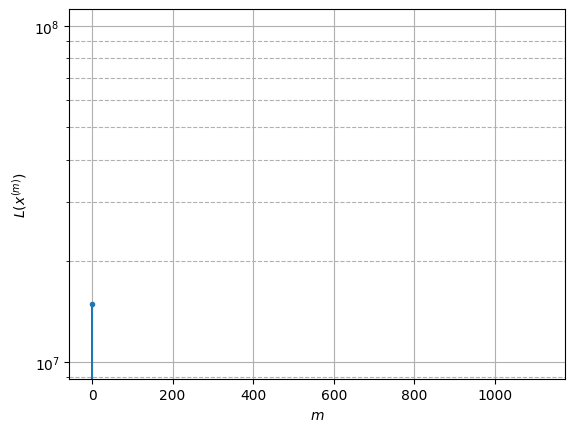

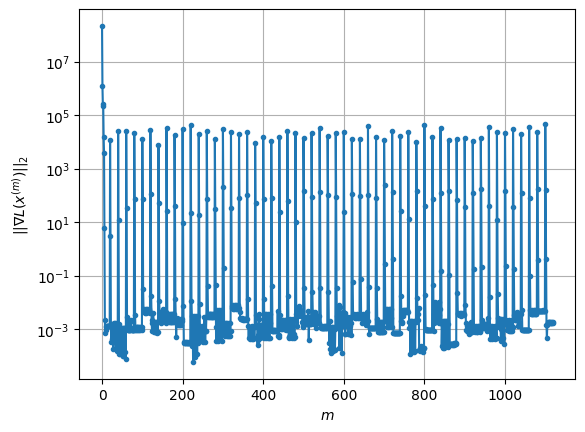

Windows:  15%|█▍        | 56/376 [06:41<37:04,  6.95s/it]

Before applying the algorithm
Cost function: -3151338.017240126
Gradient norm: 19402.078012050428
Global relative error: 34.10236774253244
Position relative errors: 0.0829495238649234 m, 5.326732045720645 m, 10.010014664390376 m, 32.16192553778834 m

Iteration 1
Cost function: -3151342.386873471 (-0.00%)
Gradient norm: 105.33637213721006 (-99.46%)
Global relative error: 39.966519703615766 (17.20%)
Position relative errors: 0.10674782989714286 m, 2.5053463543770653 m, 11.664264204945795 m, 38.14418608954349 m

Iteration 2
Cost function: -3151342.387518821 (-0.00%)
Gradient norm: 0.03868225110920991 (-99.96%)
Global relative error: 40.34305464889118 (0.94%)
Position relative errors: 0.10674782871023905 m, 2.4839134358444133 m, 11.777048898875865 m, 38.50560203084571 m

Iteration 3
Cost function: -3151342.3875188353 (-0.00%)
Gradient norm: 0.004559197403115911 (-88.21%)
Global relative error: 40.34332859222015 (0.00%)
Position relative errors: 0.10674782836463563 m, 2.483910497984472 m, 1

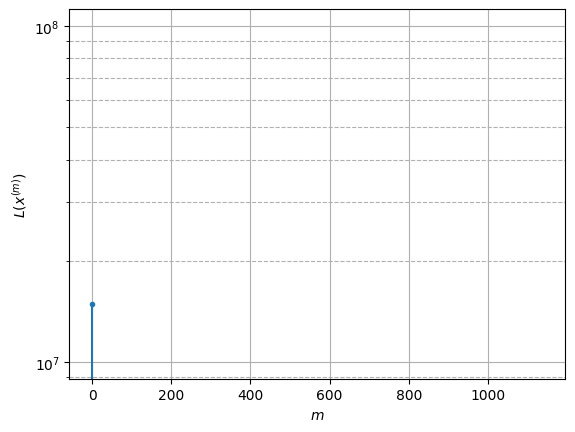

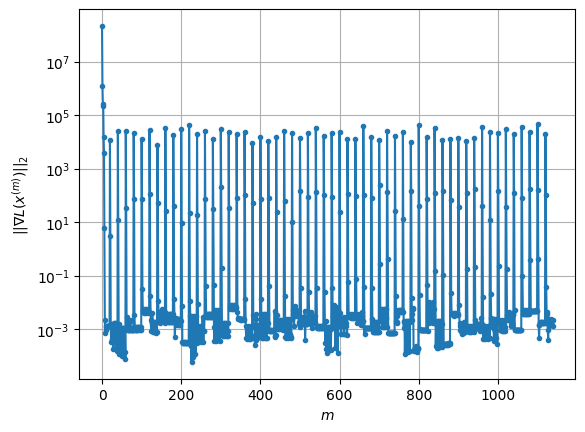

Windows:  15%|█▌        | 57/376 [06:50<40:05,  7.54s/it]

Before applying the algorithm
Cost function: -3151332.391056377
Gradient norm: 28603.666775995127
Global relative error: 39.02177785537441
Position relative errors: 0.09881875811283594 m, 2.1716989838041774 m, 11.738041153824282 m, 37.150919350757455 m

Iteration 1
Cost function: -3151337.979437577 (-0.00%)
Gradient norm: 193.02515711831268 (-99.33%)
Global relative error: 41.67509235822018 (6.80%)
Position relative errors: 0.09461112946074443 m, 3.3223805190059346 m, 13.476248850678598 m, 39.29575629914873 m

Iteration 2
Cost function: -3151337.9824149497 (-0.00%)
Gradient norm: 0.9147075609119276 (-99.53%)
Global relative error: 42.09523678203793 (1.01%)
Position relative errors: 0.09461113036952004 m, 3.39762890205155 m, 13.446773354612084 m, 39.74468433086557 m

Iteration 3
Cost function: -3151337.982415009 (-0.00%)
Gradient norm: 0.0002891234149331689 (-99.97%)
Global relative error: 42.095452007529076 (0.00%)
Position relative errors: 0.09461113027837074 m, 3.397683426230022 m, 1

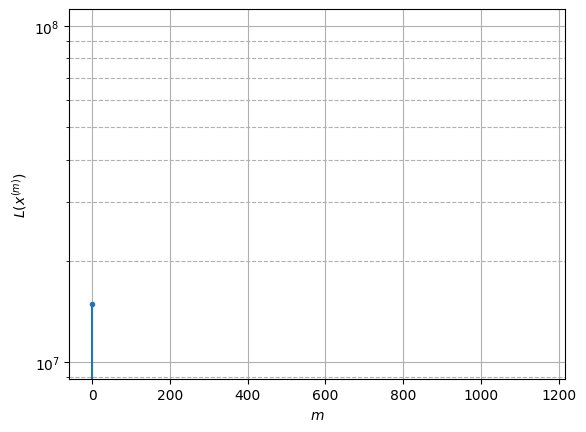

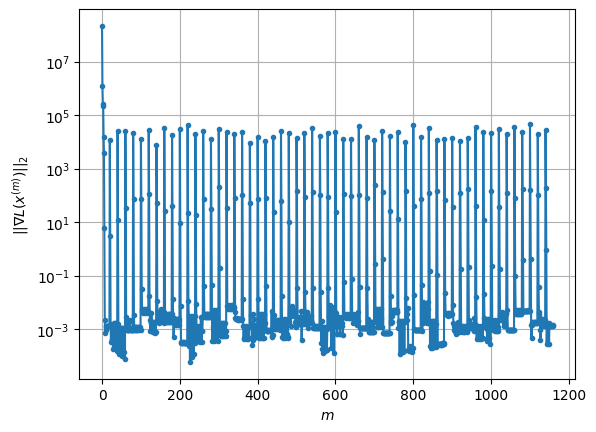

Windows:  15%|█▌        | 58/376 [06:57<39:06,  7.38s/it]

Before applying the algorithm
Cost function: -3151333.3846748583
Gradient norm: 13756.102428689032
Global relative error: 40.81519773100017
Position relative errors: 0.08845599663763842 m, 2.9465289538259163 m, 13.029712466881831 m, 38.5670391740583 m

Iteration 1
Cost function: -3151335.1697438015 (-0.00%)
Gradient norm: 14.814402957145646 (-99.89%)
Global relative error: 39.0001760746901 (-4.45%)
Position relative errors: 0.07724116609407178 m, 2.1009133951089725 m, 14.358893102857232 m, 36.199659919633866 m

Iteration 2
Cost function: -3151335.1697887015 (-0.00%)
Gradient norm: 0.013109185630492397 (-99.91%)
Global relative error: 39.03876510950259 (0.10%)
Position relative errors: 0.07724116565815636 m, 2.1051592582851546 m, 14.343648232386839 m, 36.24702092554441 m

Iteration 3
Cost function: -3151335.169788701 (0.00%)
Gradient norm: 0.0009965447468296448 (-92.40%)
Global relative error: 39.03876832147507 (0.00%)
Position relative errors: 0.07724116575664262 m, 2.1051596022798815 

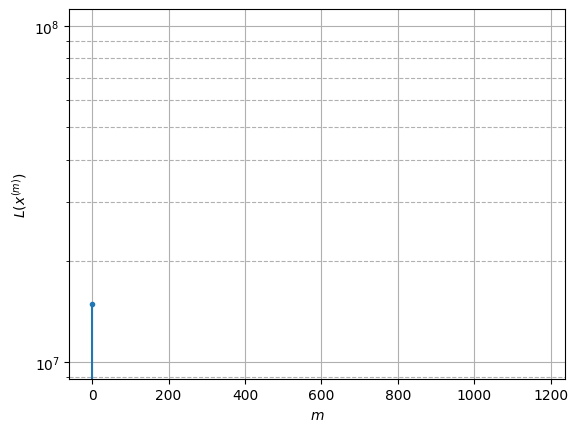

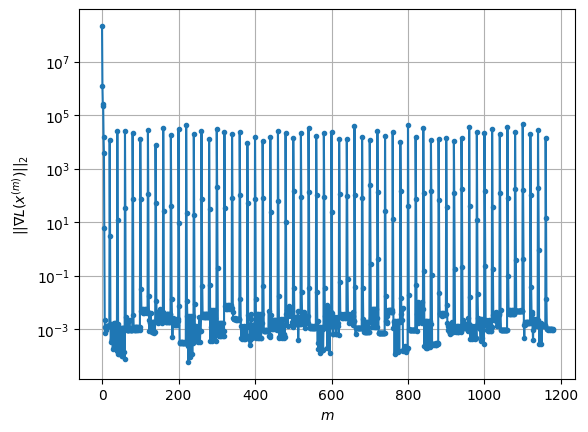

Windows:  16%|█▌        | 59/376 [07:04<38:25,  7.27s/it]

Before applying the algorithm
Cost function: -3151335.6624021325
Gradient norm: 21979.068248914216
Global relative error: 37.41604260144696
Position relative errors: 0.07096659314782097 m, 1.865107704311701 m, 13.692483679073682 m, 34.77055635942849 m

Iteration 1
Cost function: -3151337.286243542 (-0.00%)
Gradient norm: 38.164018914789246 (-99.83%)
Global relative error: 29.326952882161848 (-21.62%)
Position relative errors: 0.06701655878515353 m, 3.9373800642575594 m, 13.34406628281292 m, 25.81662214103806 m

Iteration 2
Cost function: -3151337.2864076295 (-0.00%)
Gradient norm: 0.029009304662791294 (-99.92%)
Global relative error: 29.457539209024738 (0.45%)
Position relative errors: 0.06701655900851282 m, 3.9151260676387643 m, 13.344345410797084 m, 25.96809040498933 m

Iteration 3
Cost function: -3151337.286407626 (0.00%)
Gradient norm: 0.0028226843474107436 (-90.27%)
Global relative error: 29.45761031237073 (0.00%)
Position relative errors: 0.06701655896732578 m, 3.915120956349496 

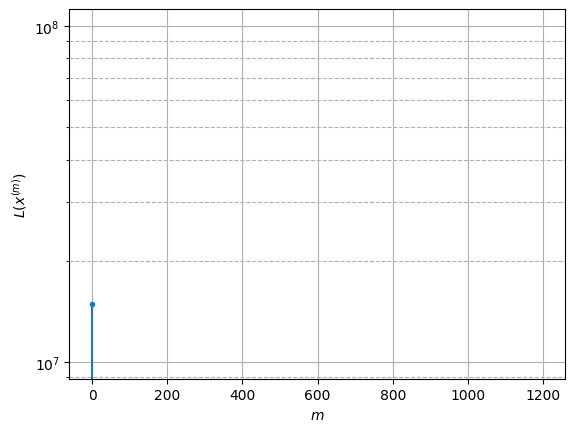

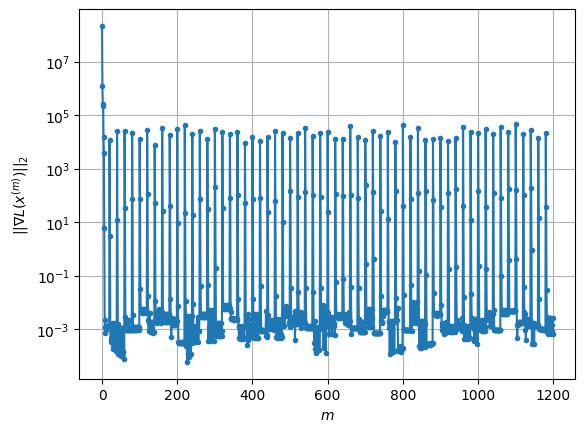

Windows:  16%|█▌        | 60/376 [07:11<38:05,  7.23s/it]

Before applying the algorithm
Cost function: -3151332.0279569146
Gradient norm: 24230.69258635136
Global relative error: 27.99280334618997
Position relative errors: 0.06127223811021326 m, 3.681412457420539 m, 12.429312358837908 m, 24.810319556839023 m

Iteration 1
Cost function: -3151336.3517127126 (-0.00%)
Gradient norm: 138.2759938740117 (-99.43%)
Global relative error: 13.209282608818565 (-52.81%)
Position relative errors: 0.04996996921735921 m, 5.1336632692321125 m, 11.607232707180255 m, 3.660585493428049 m

Iteration 2
Cost function: -3151336.357174284 (-0.00%)
Gradient norm: 0.49720255881316494 (-99.64%)
Global relative error: 13.374083891845906 (1.25%)
Position relative errors: 0.04996997298274109 m, 5.083597778705529 m, 11.80619180178878 m, 3.6924359487885954 m

Iteration 3
Cost function: -3151336.357174375 (-0.00%)
Gradient norm: 0.0011997696212234768 (-99.76%)
Global relative error: 13.375181935204655 (0.01%)
Position relative errors: 0.04996997346258543 m, 5.083376994264139 

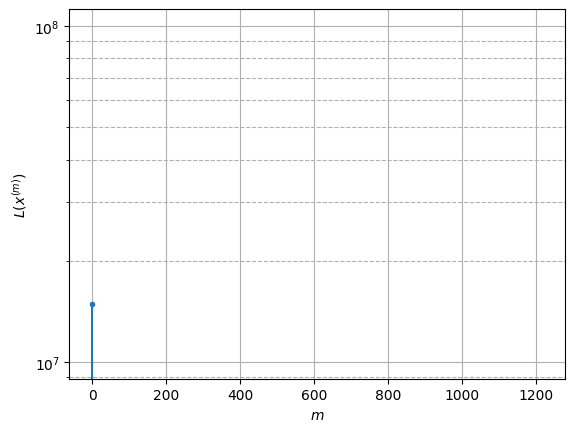

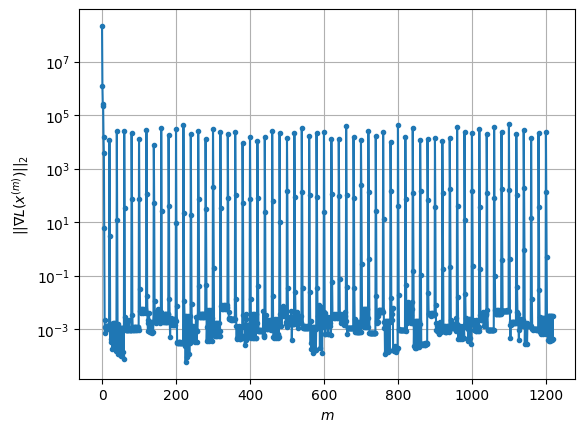

Windows:  16%|█▌        | 61/376 [07:18<37:25,  7.13s/it]

Before applying the algorithm
Cost function: -3151331.71852405
Gradient norm: 18062.589241423575
Global relative error: 12.378546517157764
Position relative errors: 0.04753929190604658 m, 4.732574340702754 m, 10.841382215071317 m, 3.645943368373048 m

Iteration 1
Cost function: -3151335.873340393 (-0.00%)
Gradient norm: 102.73865347128486 (-99.43%)
Global relative error: 13.728719994291957 (10.91%)
Position relative errors: 0.06330145887479818 m, 8.258849427534741 m, 10.858582605069294 m, 1.5348457958315236 m

Iteration 2
Cost function: -3151335.8742424618 (-0.00%)
Gradient norm: 0.04813656516781931 (-99.95%)
Global relative error: 13.619966120689643 (-0.79%)
Position relative errors: 0.06330145870966754 m, 8.252054864794106 m, 10.735608498742517 m, 1.466013092290221 m

Iteration 3
Cost function: -3151335.874242498 (-0.00%)
Gradient norm: 0.0014437536856104233 (-97.00%)
Global relative error: 13.619923987315751 (-0.00%)
Position relative errors: 0.06330145905835621 m, 8.252060875544961

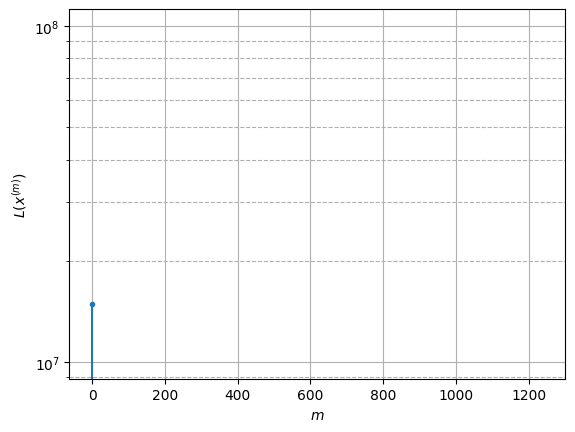

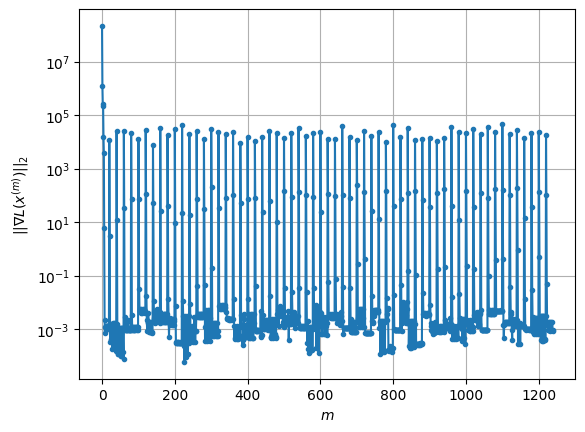

Windows:  16%|█▋        | 62/376 [07:25<37:13,  7.11s/it]

Before applying the algorithm
Cost function: -3151322.6721308595
Gradient norm: 11283.530327250925
Global relative error: 12.65144283302935
Position relative errors: 0.06047275077492548 m, 7.376228207344222 m, 10.06954131927625 m, 2.061642570325459 m

Iteration 1
Cost function: -3151327.919768018 (-0.00%)
Gradient norm: 231.8310562269324 (-97.95%)
Global relative error: 8.306851344321087 (-34.34%)
Position relative errors: 0.06821950549937333 m, 7.36487041964207 m, 1.755612488016407 m, 3.4169203345341006 m

Iteration 2
Cost function: -3151327.9275004165 (-0.00%)
Gradient norm: 2.6696095779621674 (-98.85%)
Global relative error: 8.210811739772033 (-1.16%)
Position relative errors: 0.0682194962066122 m, 7.418118529626826 m, 1.8945097044613226 m, 2.965610665722391 m

Iteration 3
Cost function: -3151327.927500583 (-0.00%)
Gradient norm: 0.0015244578210242793 (-99.94%)
Global relative error: 8.210460090520197 (-0.00%)
Position relative errors: 0.06821949592535782 m, 7.41814297824604 m, 1.89

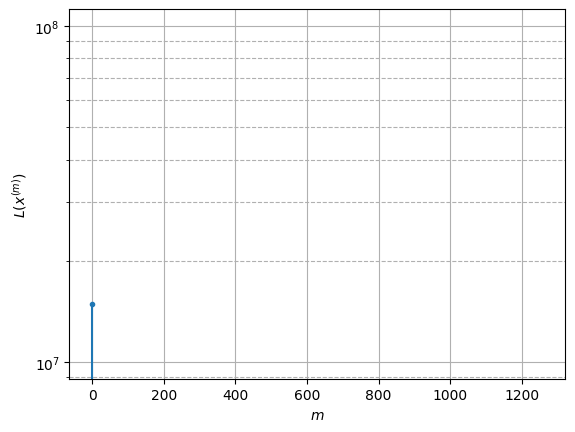

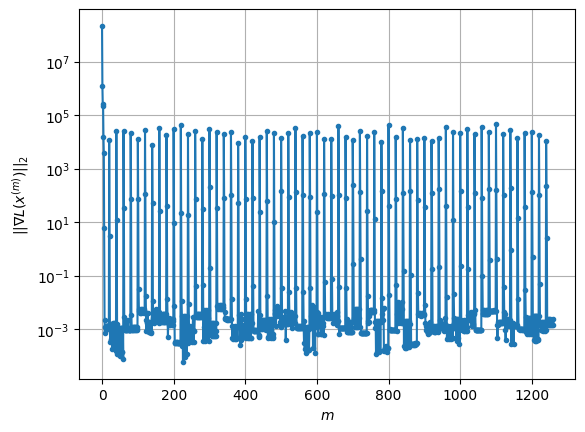

Windows:  17%|█▋        | 63/376 [07:32<36:44,  7.04s/it]

Before applying the algorithm
Cost function: -3151321.300674118
Gradient norm: 37569.042137455035
Global relative error: 7.23031655035306
Position relative errors: 0.06532296013192225 m, 6.516755893909257 m, 1.690502907083462 m, 2.6357185169131743 m

Iteration 1
Cost function: -3151323.643748366 (-0.00%)
Gradient norm: 96.1461799221792 (-99.74%)
Global relative error: 6.156535682763662 (-14.85%)
Position relative errors: 0.07643933605588399 m, 3.2984500814575513 m, 3.0385599859491657 m, 4.217123055620727 m

Iteration 2
Cost function: -3151323.644471885 (-0.00%)
Gradient norm: 0.14471326650906607 (-99.85%)
Global relative error: 6.363020423340735 (3.35%)
Position relative errors: 0.07643933782183968 m, 3.3080883445847706 m, 3.1229063956552614 m, 4.448127278417267 m

Iteration 3
Cost function: -3151323.6444719015 (-0.00%)
Gradient norm: 0.0005300397295610826 (-99.63%)
Global relative error: 6.363114527530932 (0.00%)
Position relative errors: 0.07643933747519532 m, 3.30809198751881 m, 3.1

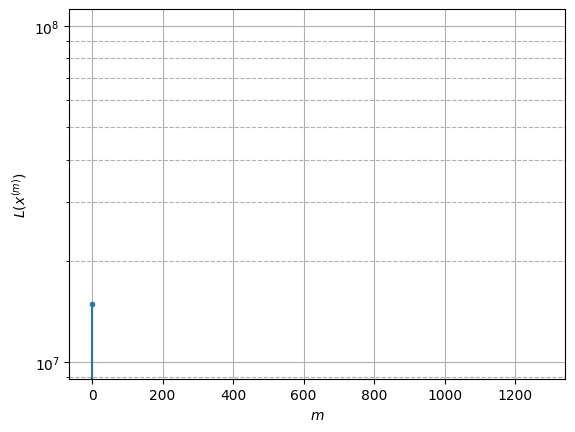

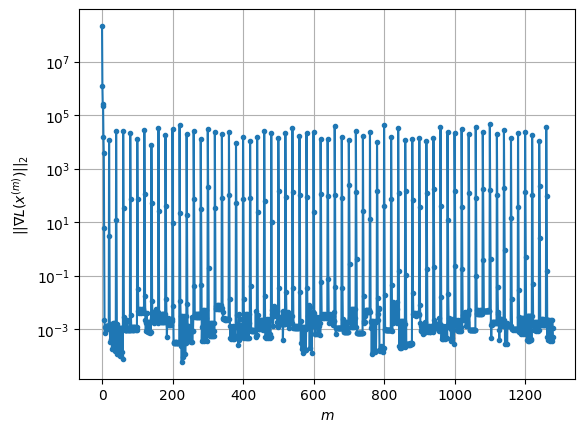

Windows:  17%|█▋        | 64/376 [07:39<36:43,  7.06s/it]

Before applying the algorithm
Cost function: -3151308.0175444637
Gradient norm: 32795.590188334514
Global relative error: 5.268868624984227
Position relative errors: 0.07207588568494099 m, 2.700482375995025 m, 2.7262453472688457 m, 3.609763676834283 m

Iteration 1
Cost function: -3151313.457798632 (-0.00%)
Gradient norm: 123.89401118940107 (-99.62%)
Global relative error: 12.724181078827996 (141.50%)
Position relative errors: 0.08605592323573207 m, 4.247273271038417 m, 3.50487069366207 m, 11.47056469438372 m

Iteration 2
Cost function: -3151313.459498607 (-0.00%)
Gradient norm: 0.2015895265246796 (-99.84%)
Global relative error: 12.768486110089837 (0.35%)
Position relative errors: 0.08605592161060846 m, 4.199336529168502 m, 3.495971503123793 m, 11.53995296271263 m

Iteration 3
Cost function: -3151313.4594986197 (-0.00%)
Gradient norm: 0.002632865609790999 (-98.69%)
Global relative error: 12.768681858597981 (0.00%)
Position relative errors: 0.08605592166952757 m, 4.199269026327473 m, 3.

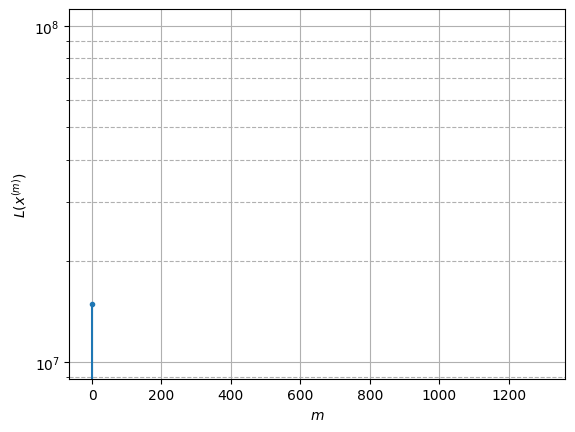

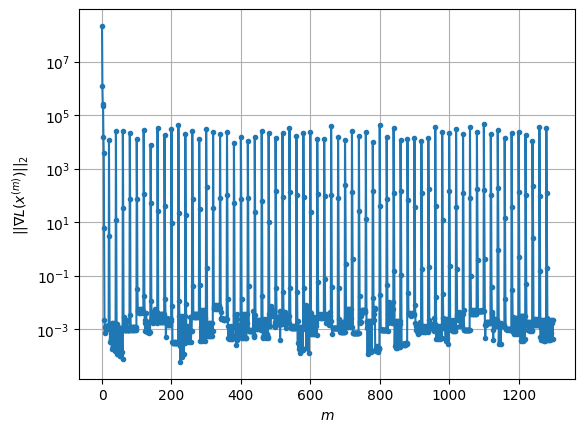

Windows:  17%|█▋        | 65/376 [07:46<36:33,  7.05s/it]

Before applying the algorithm
Cost function: -3151301.858004763
Gradient norm: 23110.36266431762
Global relative error: 12.607281432122033
Position relative errors: 0.08090512362523591 m, 3.9927721532207205 m, 3.2565142902556627 m, 11.506077688067515 m

Iteration 1
Cost function: -3151306.7396894945 (-0.00%)
Gradient norm: 155.2192950541695 (-99.33%)
Global relative error: 6.304109441681606 (-50.00%)
Position relative errors: 0.06306002781510718 m, 1.395383685707424 m, 5.094968196435226 m, 3.4397031055974217 m

Iteration 2
Cost function: -3151306.7425965825 (-0.00%)
Gradient norm: 0.6869172531479689 (-99.56%)
Global relative error: 6.378459737332675 (1.18%)
Position relative errors: 0.06306002125602567 m, 1.2963091819486907 m, 4.9294056361607765 m, 3.8341761022746494 m

Iteration 3
Cost function: -3151306.742596645 (-0.00%)
Gradient norm: 0.0005332796443891618 (-99.92%)
Global relative error: 6.378801589700727 (0.01%)
Position relative errors: 0.06306002125602567 m, 1.2961500959474586 

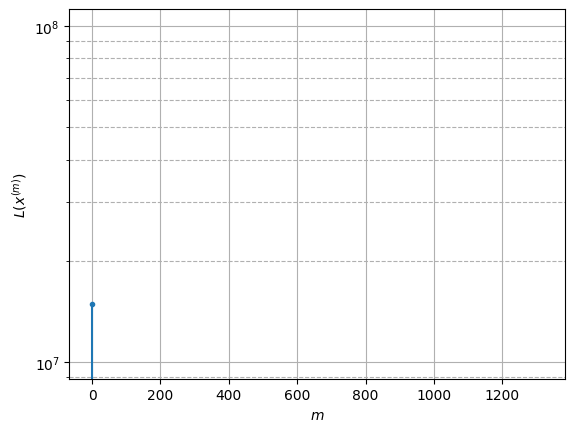

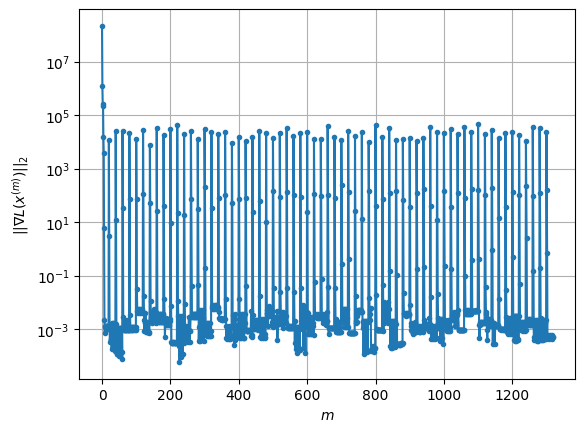

Windows:  18%|█▊        | 66/376 [07:53<36:33,  7.07s/it]

Before applying the algorithm
Cost function: -3151309.1239774474
Gradient norm: 23068.52546226669
Global relative error: 7.017552739399563
Position relative errors: 0.061976134740118885 m, 1.3146997701157093 m, 4.854142713984052 m, 4.893942684246523 m

Iteration 1
Cost function: -3151311.6877410123 (-0.00%)
Gradient norm: 149.82913723950844 (-99.35%)
Global relative error: 12.025864824438274 (71.37%)
Position relative errors: 0.0762523799612347 m, 3.7712017987339457 m, 8.576661008391135 m, 7.538859399357749 m

Iteration 2
Cost function: -3151311.6882619197 (-0.00%)
Gradient norm: 0.030826062686122004 (-99.98%)
Global relative error: 12.02426984722709 (-0.01%)
Position relative errors: 0.07625238362905047 m, 3.8142625394935177 m, 8.54830553990416 m, 7.5468529817003756 m

Iteration 3
Cost function: -3151311.688261908 (0.00%)
Gradient norm: 0.002782481854277387 (-90.97%)
Global relative error: 12.02426101084946 (-0.00%)
Position relative errors: 0.07625238405720912 m, 3.81429234670882 m, 

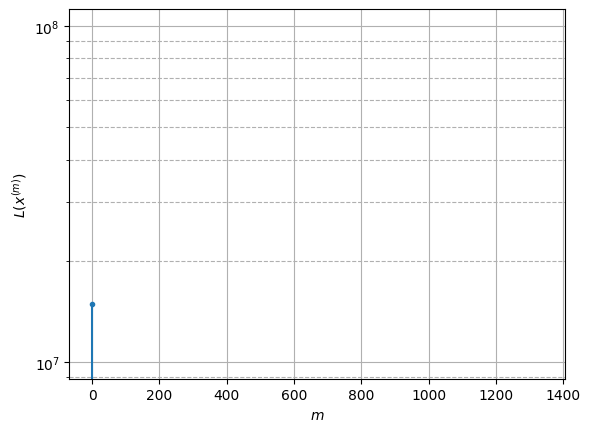

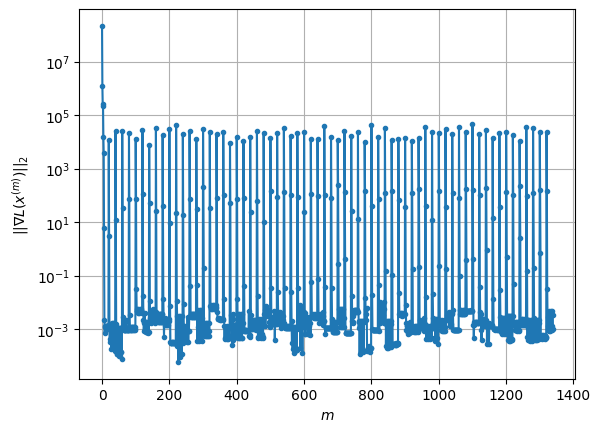

Windows:  18%|█▊        | 67/376 [08:01<37:02,  7.19s/it]

Before applying the algorithm
Cost function: -3151302.989825552
Gradient norm: 47938.455431460025
Global relative error: 11.511880988265624
Position relative errors: 0.07417970581975664 m, 3.4720695290219727 m, 8.126784627930201 m, 7.376847143548307 m

Iteration 1
Cost function: -3151306.1508576144 (-0.00%)
Gradient norm: 54.0526509907194 (-99.89%)
Global relative error: 6.793430667719986 (-40.99%)
Position relative errors: 0.1001669088131653 m, 4.249258703607569 m, 4.352657731217321 m, 3.023039676474429 m

Iteration 2
Cost function: -3151306.1510318564 (-0.00%)
Gradient norm: 0.010503585771408325 (-99.98%)
Global relative error: 6.787841522970098 (-0.08%)
Position relative errors: 0.10016690401921005 m, 4.260218333792423 m, 4.324071824238151 m, 3.036055469019626 m

Iteration 3
Cost function: -3151306.151031841 (0.00%)
Gradient norm: 0.0006708623869418111 (-93.61%)
Global relative error: 6.787837102243616 (-0.00%)
Position relative errors: 0.1001669043851753 m, 4.260213199127302 m, 4.3

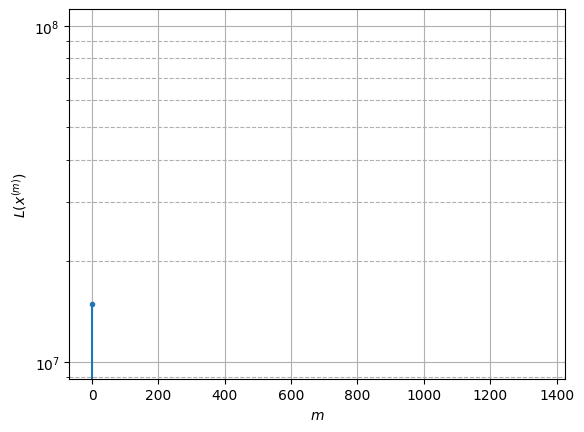

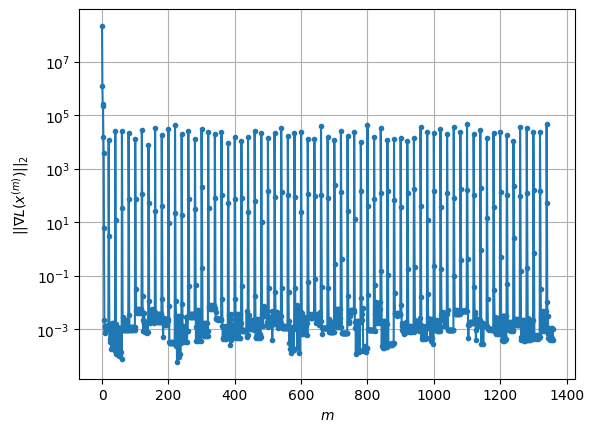

Windows:  18%|█▊        | 68/376 [08:08<37:00,  7.21s/it]

Before applying the algorithm
Cost function: -3151311.253823329
Gradient norm: 24748.52174684569
Global relative error: 6.4010850287199235
Position relative errors: 0.09756419279280772 m, 3.9545448141246093 m, 4.072530742526245 m, 2.9564120599525094 m

Iteration 1
Cost function: -3151313.296266114 (-0.00%)
Gradient norm: 42.59712560038543 (-99.83%)
Global relative error: 13.24551038990638 (106.93%)
Position relative errors: 0.1020284363709949 m, 8.393093274192962 m, 5.716253394004423 m, 8.50371461492045 m

Iteration 2
Cost function: -3151313.2963685114 (-0.00%)
Gradient norm: 0.007484617436218522 (-99.98%)
Global relative error: 13.281338336843872 (0.27%)
Position relative errors: 0.10202843875047042 m, 8.411521035759701 m, 5.751415860708838 m, 8.517667508446591 m

Iteration 3
Cost function: -3151313.2963685235 (-0.00%)
Gradient norm: 0.0007567355507990936 (-89.89%)
Global relative error: 13.281350171521831 (0.00%)
Position relative errors: 0.1020284385541223 m, 8.411526796876686 m, 5.

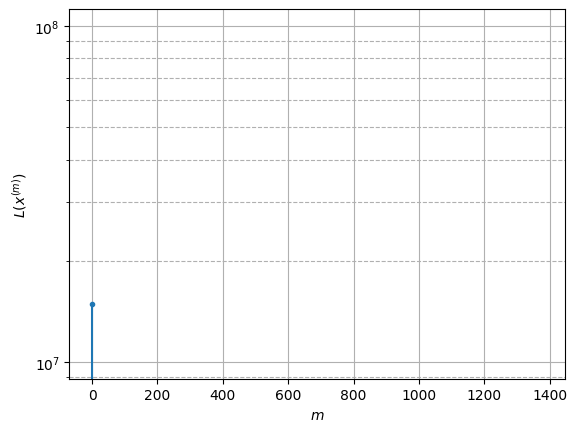

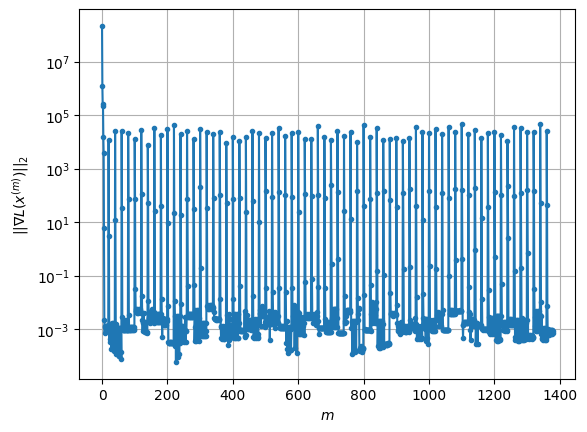

Windows:  18%|█▊        | 69/376 [08:15<36:58,  7.23s/it]

Before applying the algorithm
Cost function: -3151317.7132549244
Gradient norm: 16141.448345100833
Global relative error: 12.24540149804966
Position relative errors: 0.09685313913741649 m, 7.749911651309114 m, 5.178736927481048 m, 7.941010881332257 m

Iteration 1
Cost function: -3151321.141033948 (-0.00%)
Gradient norm: 78.89269991021173 (-99.51%)
Global relative error: 8.103955641122806 (-33.82%)
Position relative errors: 0.07593037801075352 m, 3.8119069689331044 m, 2.7694909578562807 m, 6.592971152025635 m

Iteration 2
Cost function: -3151321.141262162 (-0.00%)
Gradient norm: 0.00426366355089979 (-99.99%)
Global relative error: 8.180996008428652 (0.95%)
Position relative errors: 0.07593037592374134 m, 3.849956215497623 m, 2.786676178738959 m, 6.658442352433401 m

Iteration 3
Cost function: -3151321.1412621485 (0.00%)
Gradient norm: 0.0038751061691400935 (-9.11%)
Global relative error: 8.181007263861769 (0.00%)
Position relative errors: 0.07593037612872812 m, 3.849960757013298 m, 2.78

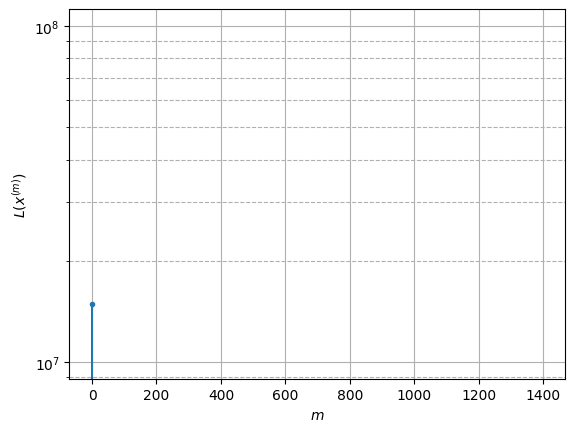

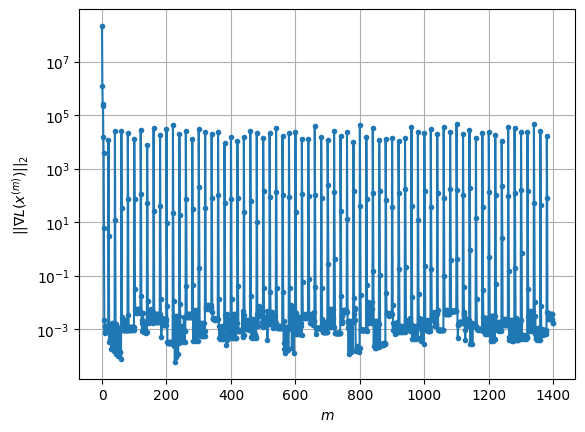

Windows:  19%|█▊        | 70/376 [08:22<36:29,  7.16s/it]

Before applying the algorithm
Cost function: -3151324.1724367635
Gradient norm: 9741.727783852835
Global relative error: 7.875854271315371
Position relative errors: 0.07305873668114288 m, 3.5211357421422718 m, 2.4766172943358815 m, 6.594799586622629 m

Iteration 1
Cost function: -3151326.3434959967 (-0.00%)
Gradient norm: 89.89894557578354 (-99.08%)
Global relative error: 14.553200149242146 (84.78%)
Position relative errors: 0.07254835439377602 m, 2.633086934504055 m, 8.435221866326316 m, 11.563046556777476 m

Iteration 2
Cost function: -3151326.3439111738 (-0.00%)
Gradient norm: 0.026900521110520992 (-99.97%)
Global relative error: 14.36989313531529 (-1.26%)
Position relative errors: 0.07254835591083018 m, 2.6280017410975414 m, 8.454764778749833 m, 11.318079107471068 m

Iteration 3
Cost function: -3151326.343911203 (-0.00%)
Gradient norm: 0.0026132575021056924 (-90.29%)
Global relative error: 14.369760265249047 (-0.00%)
Position relative errors: 0.0725483560906949 m, 2.628015791357176

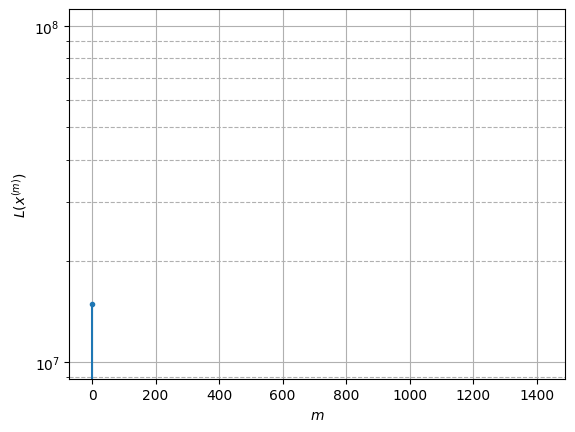

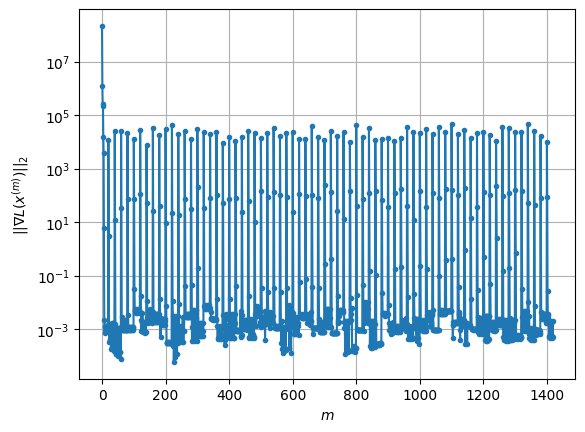

Windows:  19%|█▉        | 71/376 [08:30<36:20,  7.15s/it]

Before applying the algorithm
Cost function: -3151321.456632115
Gradient norm: 21915.904116652604
Global relative error: 13.939798523024772
Position relative errors: 0.06912716479398555 m, 2.350309986837637 m, 8.213055102992746 m, 11.015207384156703 m

Iteration 1
Cost function: -3151324.118057883 (-0.00%)
Gradient norm: 42.13577214371487 (-99.81%)
Global relative error: 19.296387564582453 (38.43%)
Position relative errors: 0.10624728444170083 m, 5.49234660933428 m, 8.01466421183449 m, 16.671483450692897 m

Iteration 2
Cost function: -3151324.1183203864 (-0.00%)
Gradient norm: 0.01858536822733489 (-99.96%)
Global relative error: 19.38981639222048 (0.48%)
Position relative errors: 0.10624728217577604 m, 5.456910512090478 m, 7.969767739862443 m, 16.81244816257004 m

Iteration 3
Cost function: -3151324.1183203543 (0.00%)
Gradient norm: 0.001635438608364273 (-91.20%)
Global relative error: 19.389859260135832 (0.00%)
Position relative errors: 0.10624728146204507 m, 5.456905252466735 m, 7.96

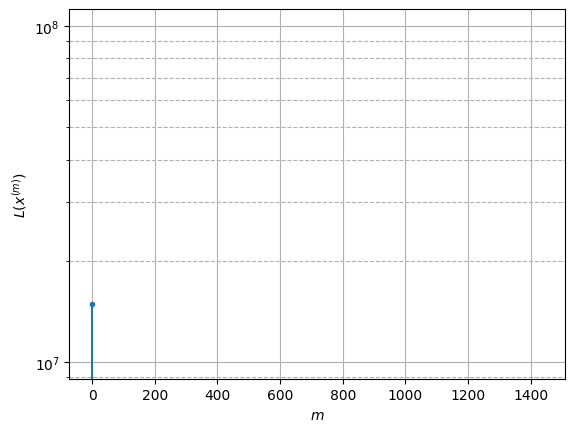

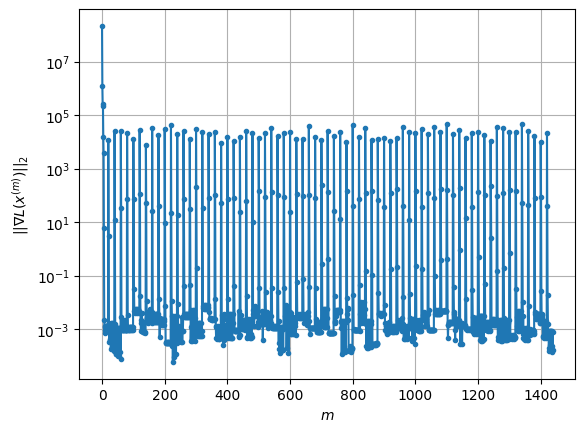

Windows:  19%|█▉        | 72/376 [08:37<36:05,  7.12s/it]

Before applying the algorithm
Cost function: -3151321.406969589
Gradient norm: 19387.26003661285
Global relative error: 18.705647712803042
Position relative errors: 0.09790155083327222 m, 5.156911996941782 m, 7.65104506093214 m, 16.27142341715773 m

Iteration 1
Cost function: -3151324.198663427 (-0.00%)
Gradient norm: 65.4877675478997 (-99.66%)
Global relative error: 12.511100707729737 (-33.12%)
Position relative errors: 0.10170872281247492 m, 4.870183504499865 m, 8.921777444637476 m, 7.293856072501627 m

Iteration 2
Cost function: -3151324.1990088695 (-0.00%)
Gradient norm: 0.017221978024017277 (-99.97%)
Global relative error: 12.538697265674479 (0.22%)
Position relative errors: 0.10170872342460842 m, 4.9068617144069675 m, 8.997195428621726 m, 7.223683431695419 m

Iteration 3
Cost function: -3151324.1990088634 (0.00%)
Gradient norm: 0.0002091626618061859 (-98.79%)
Global relative error: 12.5386790494282 (-0.00%)
Position relative errors: 0.10170872342081792 m, 4.906868659518738 m, 8.9

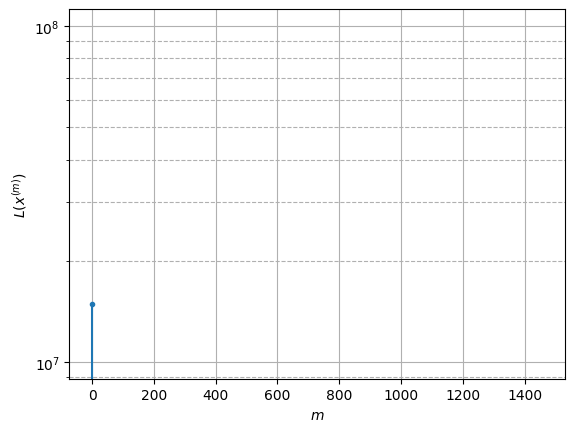

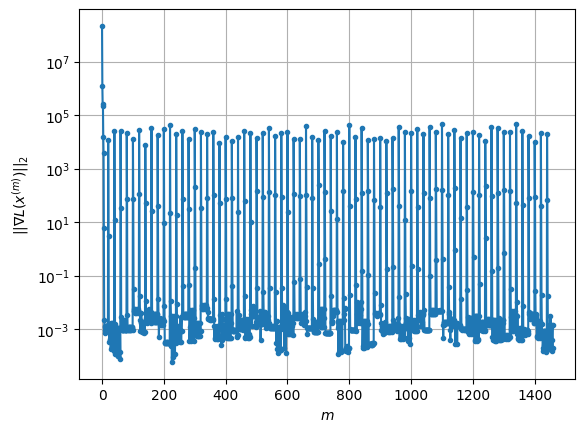

Windows:  19%|█▉        | 73/376 [08:44<35:59,  7.13s/it]

Before applying the algorithm
Cost function: -3151323.4950068383
Gradient norm: 15153.952012918407
Global relative error: 12.045147456058242
Position relative errors: 0.09191122074122797 m, 4.446609028208321 m, 8.687411952412344 m, 7.059285116932833 m

Iteration 1
Cost function: -3151325.064542162 (-0.00%)
Gradient norm: 61.5567172231091 (-99.59%)
Global relative error: 8.727311008779283 (-27.55%)
Position relative errors: 0.085616034868056 m, 5.190780796975768 m, 5.670385324793807 m, 4.130485803674088 m

Iteration 2
Cost function: -3151325.0655266186 (-0.00%)
Gradient norm: 0.10525265415162977 (-99.83%)
Global relative error: 8.627179027604898 (-1.15%)
Position relative errors: 0.0856160349449596 m, 5.14512135322027 m, 5.764338616486542 m, 3.836767455915171 m

Iteration 3
Cost function: -3151325.065526608 (0.00%)
Gradient norm: 0.0005757819530028739 (-99.45%)
Global relative error: 8.627098146059467 (-0.00%)
Position relative errors: 0.08561603497533656 m, 5.145092728084103 m, 5.76439

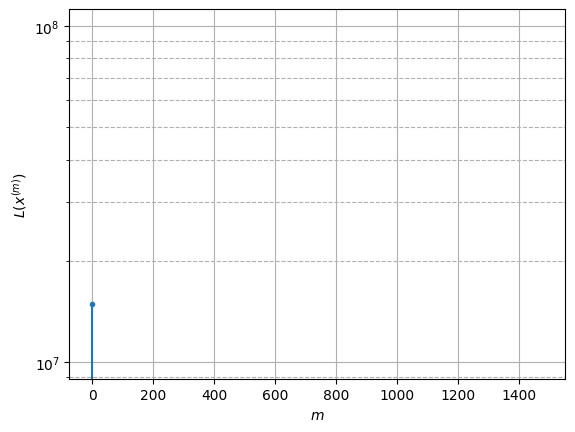

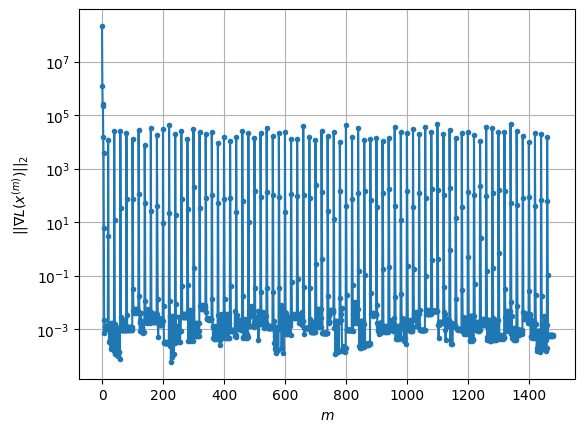

Windows:  20%|█▉        | 74/376 [08:51<35:53,  7.13s/it]

Before applying the algorithm
Cost function: -3151318.617775039
Gradient norm: 21552.81212013484
Global relative error: 7.956365463999553
Position relative errors: 0.07775288356033122 m, 4.579654105907414 m, 5.571365741964863 m, 3.359185328957778 m

Iteration 1
Cost function: -3151322.9097395837 (-0.00%)
Gradient norm: 226.56631013717455 (-98.95%)
Global relative error: 17.855019559989945 (124.41%)
Position relative errors: 0.09545753050172483 m, 10.926262639415574 m, 7.972828779430523 m, 11.655155000548053 m

Iteration 2
Cost function: -3151322.911111909 (-0.00%)
Gradient norm: 0.049777123857189715 (-99.98%)
Global relative error: 17.80951099550726 (-0.25%)
Position relative errors: 0.0954575308185089 m, 10.922317451286007 m, 8.016223719874287 m, 11.559063613000255 m

Iteration 3
Cost function: -3151322.911111936 (-0.00%)
Gradient norm: 0.0013144841914095326 (-97.36%)
Global relative error: 17.809477978475066 (-0.00%)
Position relative errors: 0.09545753086758767 m, 10.922341659241836

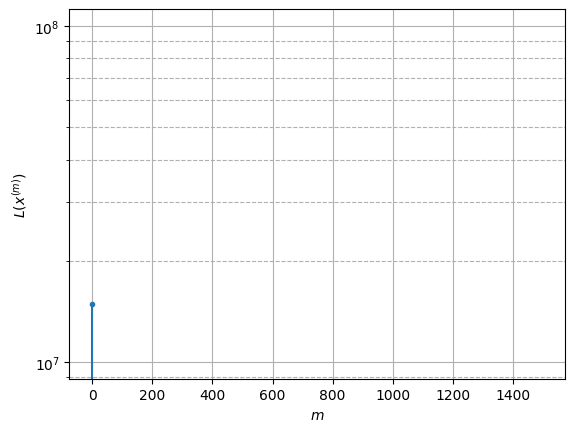

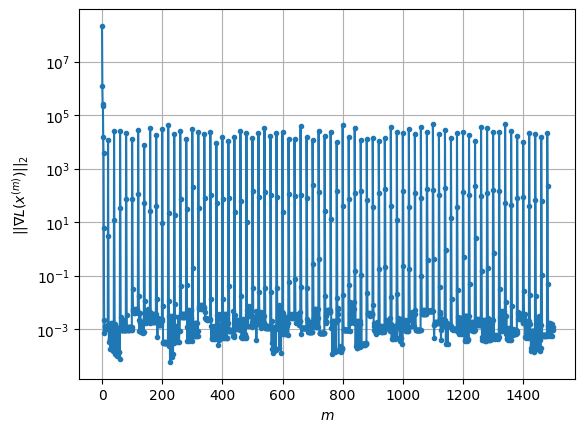

Windows:  20%|█▉        | 75/376 [08:58<35:33,  7.09s/it]

Before applying the algorithm
Cost function: -3151328.5821850044
Gradient norm: 18656.38261511636
Global relative error: 16.76113184142016
Position relative errors: 0.0855014036306557 m, 10.05236524996477 m, 7.96340530480441 m, 10.791737707304682 m

Iteration 1
Cost function: -3151332.838541874 (-0.00%)
Gradient norm: 26.388178842788886 (-99.86%)
Global relative error: 12.812577106952295 (-23.56%)
Position relative errors: 0.06661471953535889 m, 7.096151633806716 m, 7.7258227037221285 m, 7.356195183253543 m

Iteration 2
Cost function: -3151332.8388169953 (-0.00%)
Gradient norm: 0.010221313630729367 (-99.96%)
Global relative error: 12.688174701683252 (-0.97%)
Position relative errors: 0.06661471785532165 m, 6.957353035763043 m, 7.745597451607879 m, 7.251615233459454 m

Iteration 3
Cost function: -3151332.8388169874 (0.00%)
Gradient norm: 0.0016045246154876758 (-84.30%)
Global relative error: 12.688156011332298 (-0.00%)
Position relative errors: 0.0666147186957478 m, 6.957335072540489 m,

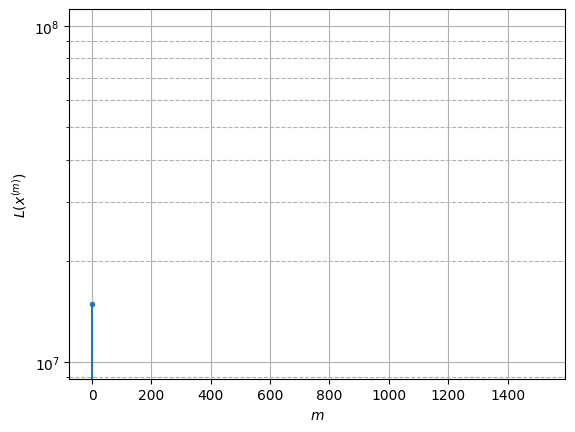

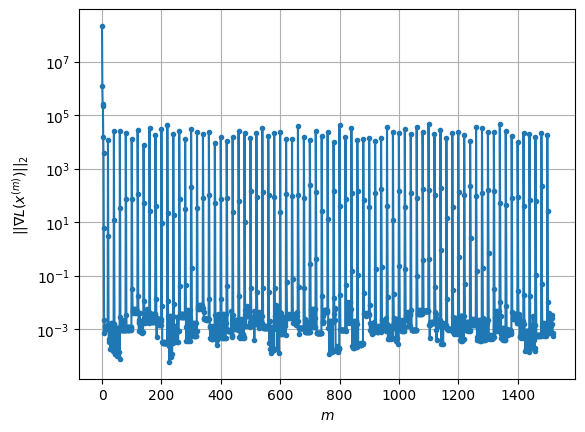

Windows:  20%|██        | 76/376 [09:05<35:24,  7.08s/it]

Before applying the algorithm
Cost function: -3151336.068950632
Gradient norm: 19863.768633855936
Global relative error: 12.58363140182833
Position relative errors: 0.060386126704118005 m, 6.572130317753021 m, 8.218686997675132 m, 6.899570142990203 m

Iteration 1
Cost function: -3151337.9946781774 (-0.00%)
Gradient norm: 25.43812819380652 (-99.87%)
Global relative error: 15.9962042184935 (27.12%)
Position relative errors: 0.04269603623319317 m, 6.423472005009154 m, 13.039359351209942 m, 6.67761427567105 m

Iteration 2
Cost function: -3151337.9947742894 (-0.00%)
Gradient norm: 0.0031931954771114144 (-99.99%)
Global relative error: 15.965505663883722 (-0.19%)
Position relative errors: 0.04269603662822041 m, 6.405427859820684 m, 13.054445006452282 m, 6.591448957951122 m

Iteration 3
Cost function: -3151337.9947743206 (-0.00%)
Gradient norm: 0.0026215232624433563 (-17.90%)
Global relative error: 15.96549624300511 (-0.00%)
Position relative errors: 0.0426960356489746 m, 6.405419891955765 m,

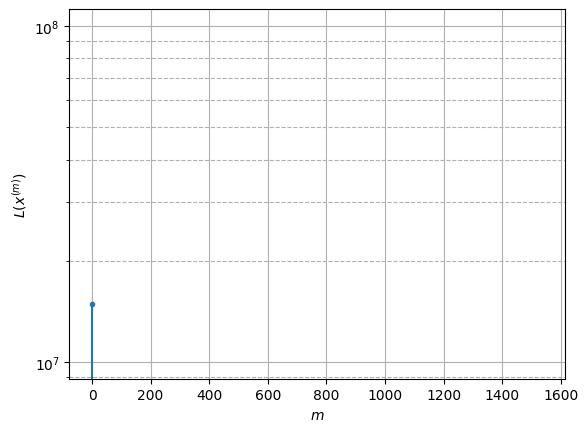

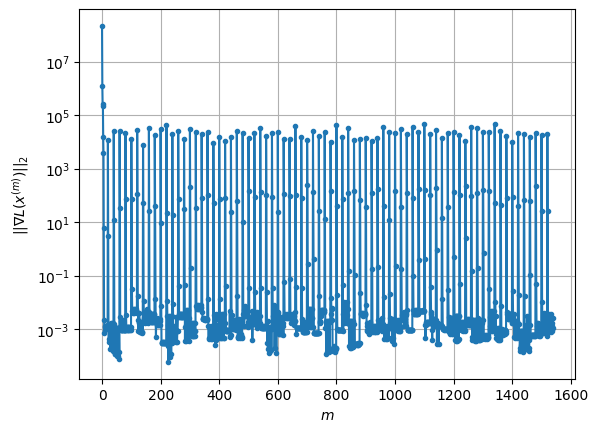

Windows:  20%|██        | 77/376 [09:12<35:01,  7.03s/it]

Before applying the algorithm
Cost function: -3151333.5114329024
Gradient norm: 28196.995910550333
Global relative error: 16.09584970993254
Position relative errors: 0.03735369749555774 m, 6.096462531282986 m, 13.5084581237263 m, 6.279283384469404 m

Iteration 1
Cost function: -3151337.6777612246 (-0.00%)
Gradient norm: 50.72611710154077 (-99.82%)
Global relative error: 16.612552607104664 (3.21%)
Position relative errors: 0.06402138379519084 m, 6.071384452428965 m, 10.024453468625024 m, 11.773739791098228 m

Iteration 2
Cost function: -3151337.6780312518 (-0.00%)
Gradient norm: 0.027713274821025383 (-99.95%)
Global relative error: 16.70127423942701 (0.53%)
Position relative errors: 0.06402138526472921 m, 6.101999553313798 m, 10.000897216008505 m, 11.902757390746356 m

Iteration 3
Cost function: -3151337.678031245 (0.00%)
Gradient norm: 0.0004471263044872548 (-98.39%)
Global relative error: 16.701316771235327 (0.00%)
Position relative errors: 0.0640213855217295 m, 6.102018916734855 m, 1

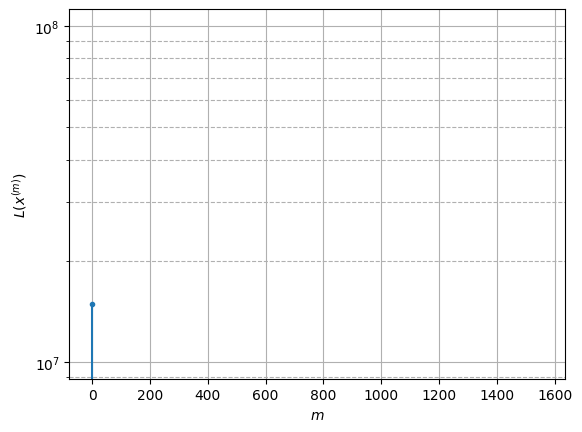

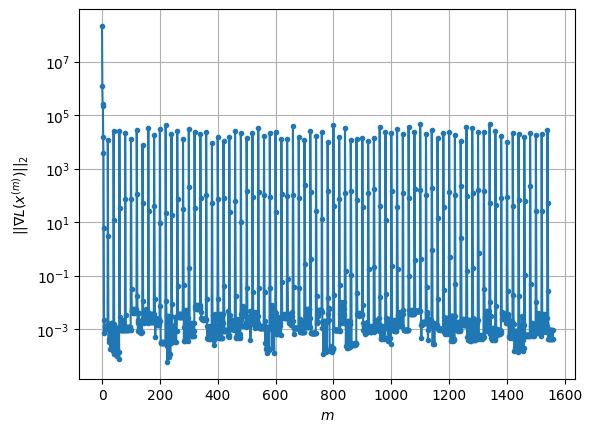

Windows:  21%|██        | 78/376 [09:19<34:51,  7.02s/it]

Before applying the algorithm
Cost function: -3151334.938608694
Gradient norm: 27353.442985115744
Global relative error: 16.183490440666088
Position relative errors: 0.05770578413159023 m, 5.651287730417076 m, 10.44844306840664 m, 10.990658774379323 m

Iteration 1
Cost function: -3151339.9434524453 (-0.00%)
Gradient norm: 43.38761027908356 (-99.84%)
Global relative error: 20.158010427168914 (24.56%)
Position relative errors: 0.07374385093071378 m, 11.09504183719782 m, 12.625428003615395 m, 11.128242616585755 m

Iteration 2
Cost function: -3151339.9441204714 (-0.00%)
Gradient norm: 0.05190591944076875 (-99.88%)
Global relative error: 20.352235043229 (0.96%)
Position relative errors: 0.07374385205280584 m, 11.203113402577147 m, 12.76248308778705 m, 11.216796467832996 m

Iteration 3
Cost function: -3151339.944120472 (-0.00%)
Gradient norm: 0.001586375448770253 (-96.94%)
Global relative error: 20.35229243232341 (0.00%)
Position relative errors: 0.07374385255603629 m, 11.203142893035213 m, 

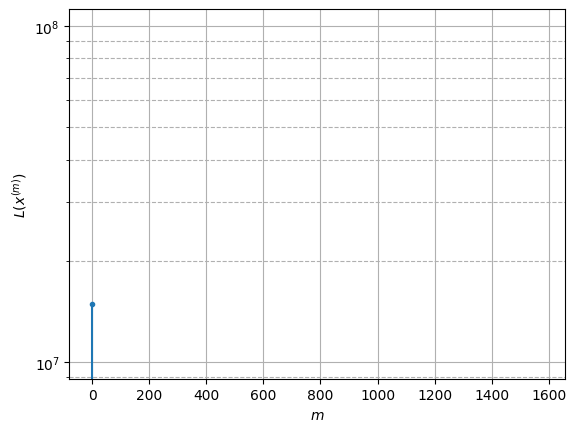

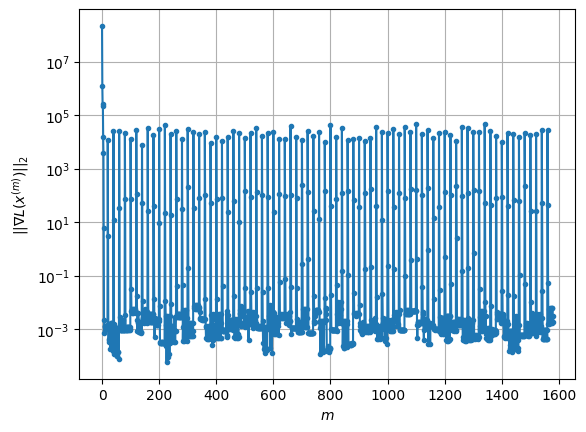

Windows:  21%|██        | 79/376 [09:26<34:15,  6.92s/it]

Before applying the algorithm
Cost function: -3151329.4336408605
Gradient norm: 36753.97090124883
Global relative error: 19.45885219432821
Position relative errors: 0.06526121222822498 m, 10.314007503537804 m, 12.960531312917338 m, 10.212144022594654 m

Iteration 1
Cost function: -3151333.0902745426 (-0.00%)
Gradient norm: 77.00749808266991 (-99.79%)
Global relative error: 24.75885848590083 (27.24%)
Position relative errors: 0.05104689480975191 m, 11.77755402230189 m, 16.497739425137897 m, 14.216580428508513 m

Iteration 2
Cost function: -3151333.090813543 (-0.00%)
Gradient norm: 0.040498788713390015 (-99.95%)
Global relative error: 24.968195276906304 (0.85%)
Position relative errors: 0.05104689503566732 m, 11.874100651775661 m, 16.64840115706001 m, 14.32632202596227 m

Iteration 3
Cost function: -3151333.09081355 (-0.00%)
Gradient norm: 0.0007751221647258853 (-98.09%)
Global relative error: 24.968275625742045 (0.00%)
Position relative errors: 0.05104689450076725 m, 11.874150818478556 

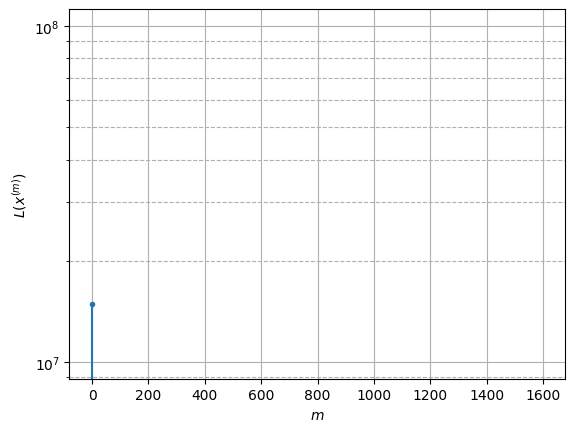

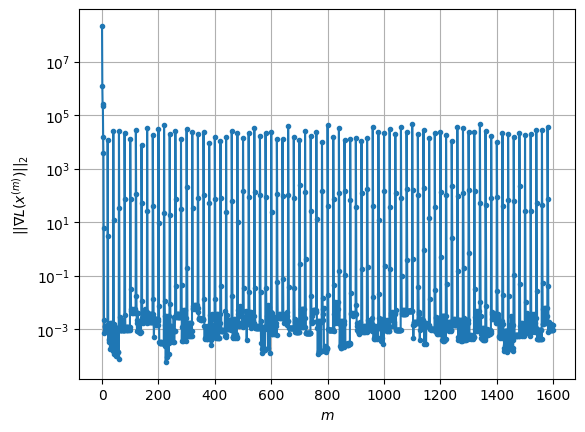

Windows:  21%|██▏       | 80/376 [09:32<34:02,  6.90s/it]

Before applying the algorithm
Cost function: -3151332.4132292448
Gradient norm: 17285.233506514884
Global relative error: 23.944868752095985
Position relative errors: 0.044805897623042774 m, 10.861024204425538 m, 16.889331291146323 m, 13.043864418308226 m

Iteration 1
Cost function: -3151335.406042545 (-0.00%)
Gradient norm: 35.09952440020604 (-99.80%)
Global relative error: 30.67143399856174 (28.09%)
Position relative errors: 0.06233392164311601 m, 17.885414778202346 m, 18.51016696491962 m, 16.67983754830456 m

Iteration 2
Cost function: -3151335.4063360677 (-0.00%)
Gradient norm: 0.024286985692540026 (-99.93%)
Global relative error: 30.760422382055236 (0.29%)
Position relative errors: 0.06233392251168396 m, 17.930688633535556 m, 18.549308503756066 m, 16.751465413422732 m

Iteration 3
Cost function: -3151335.4063360724 (-0.00%)
Gradient norm: 0.0010082888694819964 (-95.85%)
Global relative error: 30.76045026654563 (0.00%)
Position relative errors: 0.062333922219222314 m, 17.9307064622

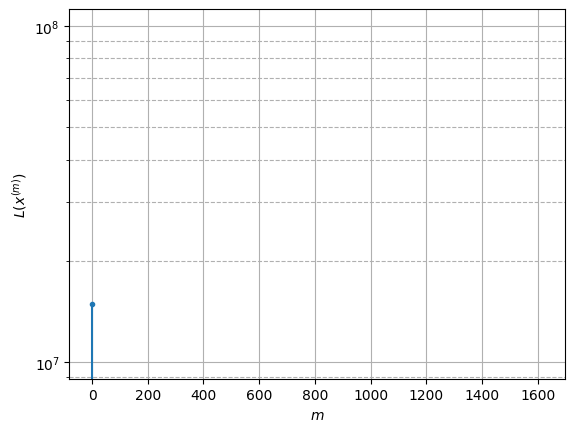

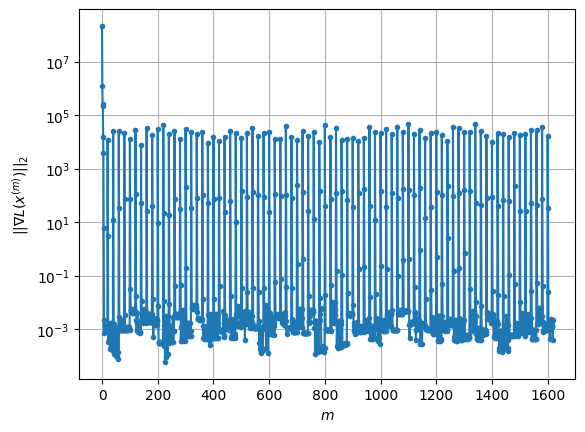

Windows:  22%|██▏       | 81/376 [09:40<34:17,  6.98s/it]

Before applying the algorithm
Cost function: -3151333.8054629024
Gradient norm: 17913.229648585868
Global relative error: 29.317474164276184
Position relative errors: 0.055999495833844046 m, 16.41046461973618 m, 18.835024965016082 m, 15.344322291878449 m

Iteration 1
Cost function: -3151336.9460524246 (-0.00%)
Gradient norm: 52.854633088469974 (-99.70%)
Global relative error: 23.147501506645664 (-21.05%)
Position relative errors: 0.07428476330908058 m, 10.566113139921999 m, 18.97587972708955 m, 8.004626825853814 m

Iteration 2
Cost function: -3151336.946221247 (-0.00%)
Gradient norm: 0.013178614112222783 (-99.98%)
Global relative error: 23.169728175690626 (0.10%)
Position relative errors: 0.07428476293916723 m, 10.62098171070464 m, 18.98562007048018 m, 7.973158759627345 m

Iteration 3
Cost function: -3151336.946221237 (0.00%)
Gradient norm: 0.0007790849017957294 (-94.09%)
Global relative error: 23.16974765038422 (0.00%)
Position relative errors: 0.07428476328952226 m, 10.62101210036526

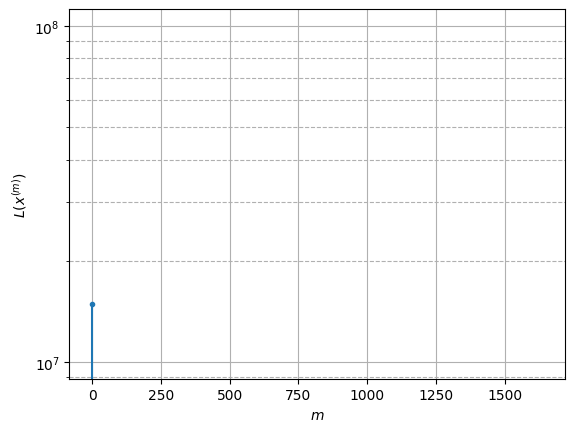

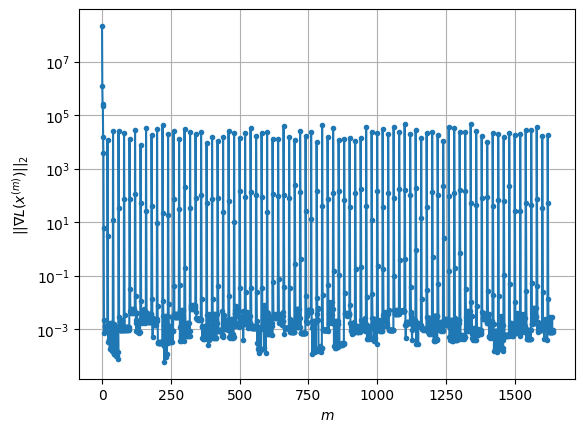

Windows:  22%|██▏       | 82/376 [09:46<33:58,  6.93s/it]

Before applying the algorithm
Cost function: -3151340.456312293
Gradient norm: 16125.48025316827
Global relative error: 22.500630301707925
Position relative errors: 0.06846611678147141 m, 9.706080772685564 m, 18.890359332787806 m, 7.43098652922198 m

Iteration 1
Cost function: -3151342.464745449 (-0.00%)
Gradient norm: 22.001524040901746 (-99.86%)
Global relative error: 25.937983812543308 (15.28%)
Position relative errors: 0.06423402435683292 m, 14.367373827606125 m, 19.347306171581305 m, 9.593448957058298 m

Iteration 2
Cost function: -3151342.4649991794 (-0.00%)
Gradient norm: 0.019308927705848515 (-99.91%)
Global relative error: 26.06791630089432 (0.50%)
Position relative errors: 0.0642340258009503 m, 14.508314379806535 m, 19.391008948642185 m, 9.64514247934663 m

Iteration 3
Cost function: -3151342.464999171 (0.00%)
Gradient norm: 0.0011383446917427376 (-94.10%)
Global relative error: 26.0679699915114 (0.00%)
Position relative errors: 0.06423402587456814 m, 14.50837023856661 m, 19.

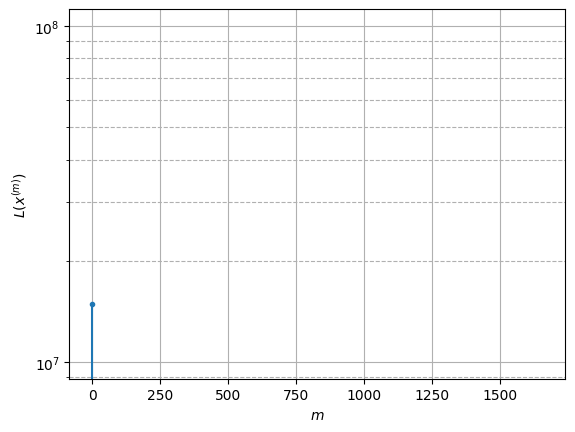

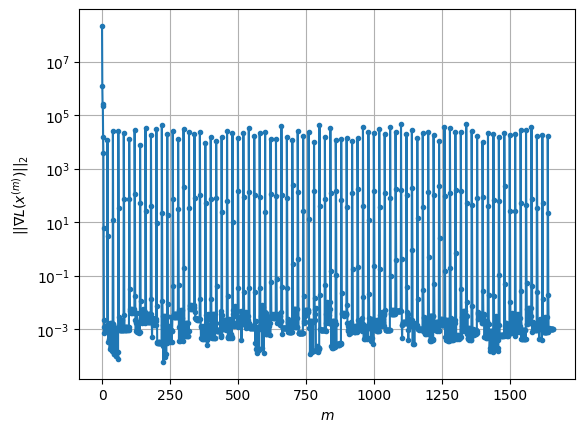

Windows:  22%|██▏       | 83/376 [09:53<33:51,  6.93s/it]

Before applying the algorithm
Cost function: -3151345.80567903
Gradient norm: 16986.520548305492
Global relative error: 25.04475365636645
Position relative errors: 0.059987359083163556 m, 13.128155648973118 m, 19.404779184079466 m, 8.85106030154441 m

Iteration 1
Cost function: -3151348.33904498 (-0.00%)
Gradient norm: 133.04480613818723 (-99.22%)
Global relative error: 29.13857499966388 (16.35%)
Position relative errors: 0.07618423248499476 m, 17.282465638218117 m, 20.953111402851437 m, 10.551425545517764 m

Iteration 2
Cost function: -3151348.339578151 (-0.00%)
Gradient norm: 0.04694338441937455 (-99.96%)
Global relative error: 29.140405788128923 (0.01%)
Position relative errors: 0.07618422981329459 m, 17.325969779415324 m, 20.869223201033602 m, 10.650917965239222 m

Iteration 3
Cost function: -3151348.339578129 (0.00%)
Gradient norm: 0.001010044219775984 (-97.85%)
Global relative error: 29.140460458246473 (0.00%)
Position relative errors: 0.07618423048121963 m, 17.326032293815853 m,

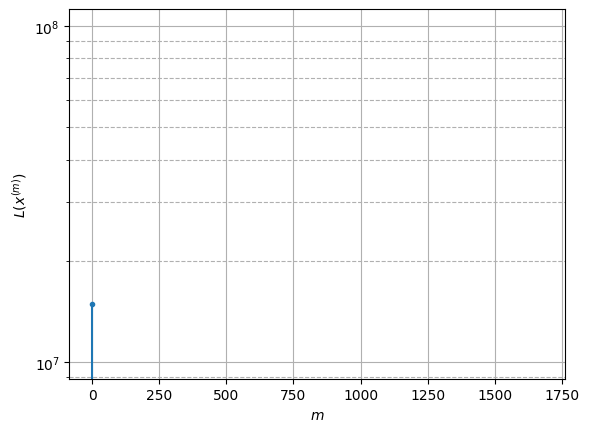

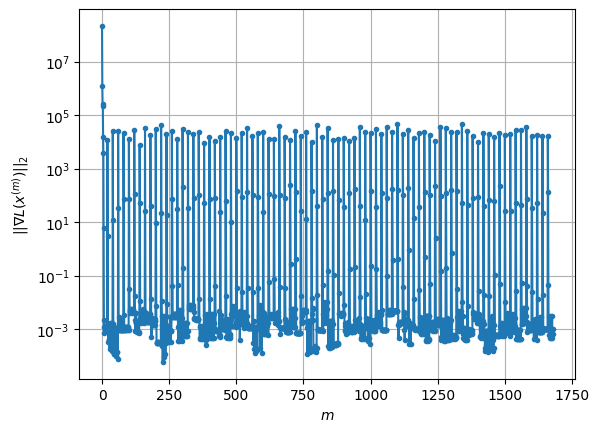

Windows:  22%|██▏       | 84/376 [10:00<33:29,  6.88s/it]

Before applying the algorithm
Cost function: -3151350.990127416
Gradient norm: 15805.718336695407
Global relative error: 27.228082721352564
Position relative errors: 0.06965716385278972 m, 15.484181711087766 m, 20.370696531130722 m, 9.30788444509917 m

Iteration 1
Cost function: -3151356.414360788 (-0.00%)
Gradient norm: 187.03170512461355 (-98.82%)
Global relative error: 15.978155371368953 (-41.32%)
Position relative errors: 0.052587746402649266 m, 3.3971791847871557 m, 12.652019544436945 m, 9.147897806673686 m

Iteration 2
Cost function: -3151356.420359553 (-0.00%)
Gradient norm: 0.3489708789544241 (-99.81%)
Global relative error: 15.446806340349886 (-3.33%)
Position relative errors: 0.05258774652190272 m, 3.24280134290313 m, 12.640415506870905 m, 8.264681384669567 m

Iteration 3
Cost function: -3151356.420359592 (-0.00%)
Gradient norm: 0.0013039330628983202 (-99.63%)
Global relative error: 15.445636717803419 (-0.01%)
Position relative errors: 0.0525877465404254 m, 3.2423046462454295

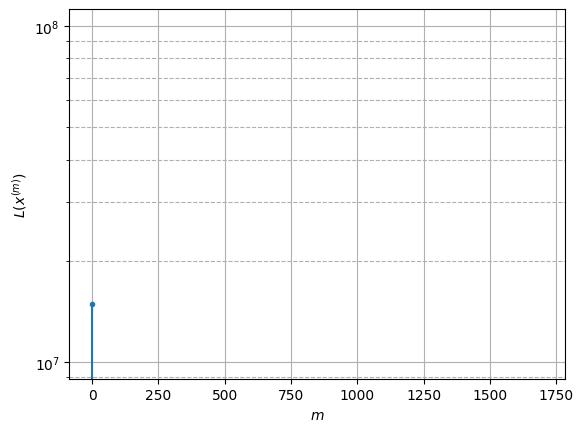

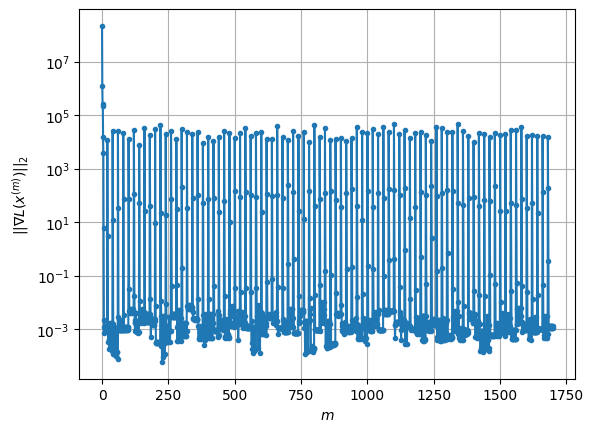

Windows:  23%|██▎       | 85/376 [10:07<33:38,  6.94s/it]

Before applying the algorithm
Cost function: -3151356.173365126
Gradient norm: 15030.68429547754
Global relative error: 15.37922880621005
Position relative errors: 0.045818481199133156 m, 3.282179424068478 m, 12.623781683882061 m, 8.147747479461724 m

Iteration 1
Cost function: -3151357.9358336497 (-0.00%)
Gradient norm: 49.899161774379714 (-99.67%)
Global relative error: 20.056734776698462 (30.41%)
Position relative errors: 0.036212950917303394 m, 8.183686951745297 m, 13.103323066834578 m, 12.790668239546484 m

Iteration 2
Cost function: -3151357.9360432304 (-0.00%)
Gradient norm: 0.026905649817983542 (-99.95%)
Global relative error: 20.084946146593236 (0.14%)
Position relative errors: 0.03621295152507354 m, 8.23962821811069 m, 13.09028400428999 m, 12.81235512042689 m

Iteration 3
Cost function: -3151357.9360432345 (-0.00%)
Gradient norm: 0.006297514031131045 (-76.59%)
Global relative error: 20.08495818924475 (0.00%)
Position relative errors: 0.0362129518341326 m, 8.239644017647725 m,

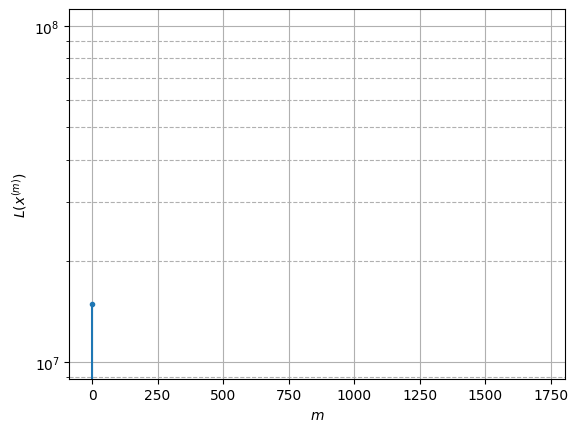

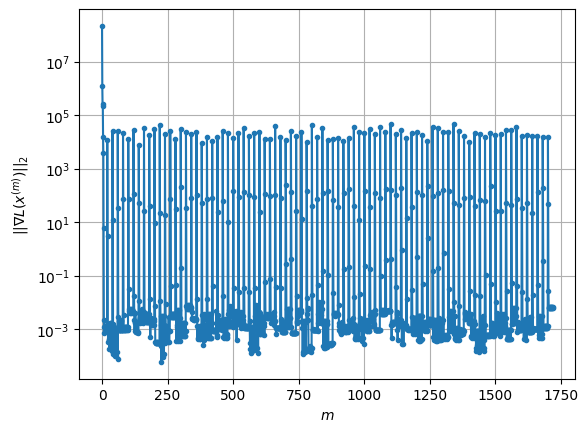

Windows:  23%|██▎       | 86/376 [10:14<33:39,  6.96s/it]

Before applying the algorithm
Cost function: -3151358.1047043772
Gradient norm: 22124.08226279007
Global relative error: 20.003609826509077
Position relative errors: 0.02800006355496072 m, 8.234337904986335 m, 13.232910932036466 m, 12.539103481912827 m

Iteration 1
Cost function: -3151362.113226665 (-0.00%)
Gradient norm: 41.973534306916996 (-99.81%)
Global relative error: 13.083903066456383 (-34.59%)
Position relative errors: 0.03833683744944812 m, 0.8964071528481424 m, 12.822253318626096 m, 2.443981874687208 m

Iteration 2
Cost function: -3151362.113775921 (-0.00%)
Gradient norm: 0.03883628957737447 (-99.91%)
Global relative error: 13.132579917920493 (0.37%)
Position relative errors: 0.03833683737906875 m, 0.8733657727400896 m, 12.867560996516556 m, 2.4750781475655375 m

Iteration 3
Cost function: -3151362.1137759127 (0.00%)
Gradient norm: 0.0017147934199963813 (-95.58%)
Global relative error: 13.132592560973038 (0.00%)
Position relative errors: 0.03833683805012885 m, 0.8733616621722

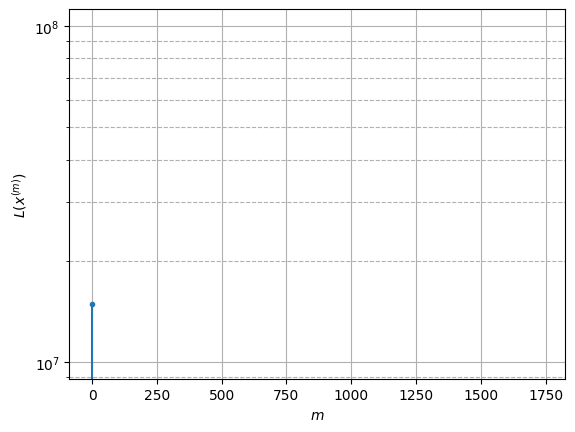

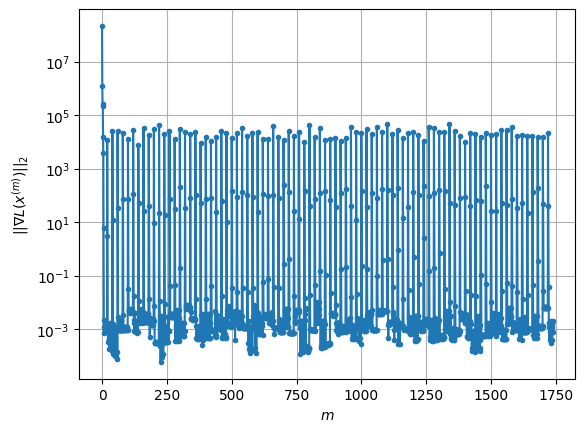

Windows:  23%|██▎       | 87/376 [10:21<33:23,  6.93s/it]

Before applying the algorithm
Cost function: -3151362.747153496
Gradient norm: 35468.581416693436
Global relative error: 13.492493517082385
Position relative errors: 0.03360796232912197 m, 0.8894097692771507 m, 13.250820096775637 m, 2.3813235920710754 m

Iteration 1
Cost function: -3151366.0461143414 (-0.00%)
Gradient norm: 21.17813622418434 (-99.94%)
Global relative error: 11.96647712104476 (-11.31%)
Position relative errors: 0.06174651739467044 m, 1.08564735362291 m, 11.663300884202524 m, 2.4456381155103464 m

Iteration 2
Cost function: -3151366.046254998 (-0.00%)
Gradient norm: 0.012329116283265495 (-99.94%)
Global relative error: 11.967182183233549 (0.01%)
Position relative errors: 0.06174651710618517 m, 1.1048473638281278 m, 11.669515788804594 m, 2.4105917225512736 m

Iteration 3
Cost function: -3151366.0462550037 (-0.00%)
Gradient norm: 0.00031678081973392463 (-97.43%)
Global relative error: 11.96717990755022 (-0.00%)
Position relative errors: 0.06174651710618517 m, 1.10484778524

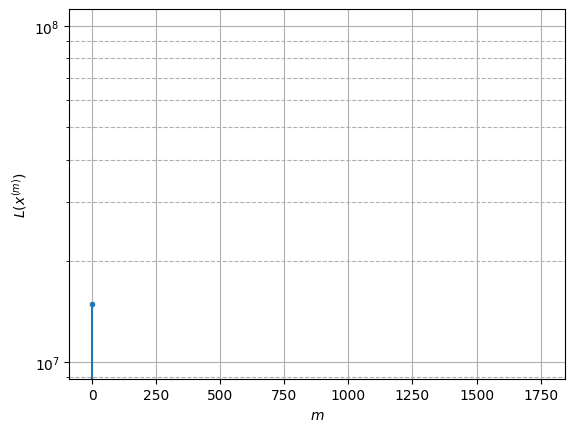

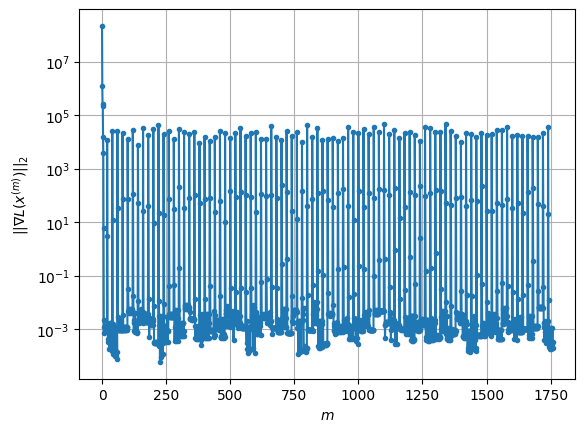

Windows:  23%|██▎       | 88/376 [10:28<33:07,  6.90s/it]

Before applying the algorithm
Cost function: -3151359.6091256486
Gradient norm: 36221.07916433649
Global relative error: 12.516656587937305
Position relative errors: 0.06175167159047165 m, 1.057380698487294 m, 12.340132378158986 m, 1.8070910187931017 m

Iteration 1
Cost function: -3151362.9884628677 (-0.00%)
Gradient norm: 25.856119200772426 (-99.93%)
Global relative error: 12.846917850637892 (2.64%)
Position relative errors: 0.07275892655262924 m, 7.087104349950703 m, 10.272828236253291 m, 3.0462369875896846 m

Iteration 2
Cost function: -3151362.988563158 (-0.00%)
Gradient norm: 0.0027946572151890258 (-99.99%)
Global relative error: 12.814446942734701 (-0.25%)
Position relative errors: 0.07275892661715896 m, 7.029571145551196 m, 10.295486083375389 m, 2.9652072535267244 m

Iteration 3
Cost function: -3151362.9885631585 (-0.00%)
Gradient norm: 0.0005419954869508594 (-80.61%)
Global relative error: 12.814434102474237 (-0.00%)
Position relative errors: 0.07275892694922177 m, 7.0295451932

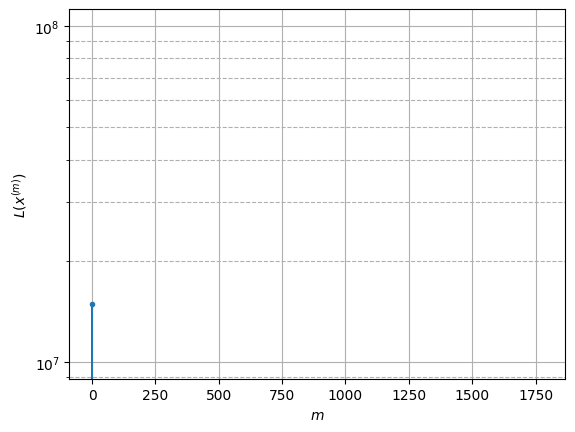

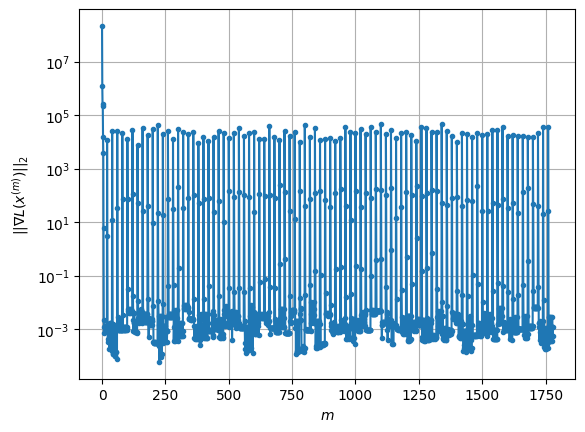

Windows:  24%|██▎       | 89/376 [10:35<32:55,  6.88s/it]

Before applying the algorithm
Cost function: -3151353.7540341164
Gradient norm: 31371.368811949535
Global relative error: 13.32056516138804
Position relative errors: 0.07295878232798068 m, 6.924563661003338 m, 10.937055396999517 m, 3.1405429913965444 m

Iteration 1
Cost function: -3151356.2725620377 (-0.00%)
Gradient norm: 33.78202497602134 (-99.89%)
Global relative error: 16.511391748303193 (23.95%)
Position relative errors: 0.0781053636145534 m, 10.663971834973117 m, 8.715024134115367 m, 9.107565895669609 m

Iteration 2
Cost function: -3151356.2729488905 (-0.00%)
Gradient norm: 0.0304148807576642 (-99.91%)
Global relative error: 16.728586115363424 (1.32%)
Position relative errors: 0.07810536250345622 m, 10.845662102317892 m, 8.725885742377002 m, 9.277378863275565 m

Iteration 3
Cost function: -3151356.2729488784 (0.00%)
Gradient norm: 0.0015815858014076305 (-94.80%)
Global relative error: 16.728657464493708 (0.00%)
Position relative errors: 0.0781053625282009 m, 10.845718377170453 m,

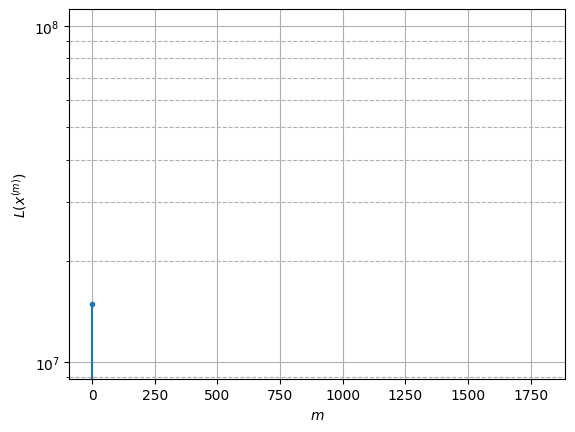

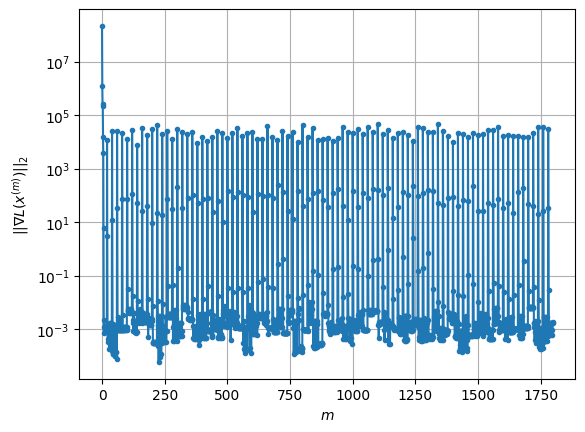

Windows:  24%|██▍       | 90/376 [10:42<33:07,  6.95s/it]

Before applying the algorithm
Cost function: -3151342.8695565346
Gradient norm: 9479.241097748052
Global relative error: 16.670993699757446
Position relative errors: 0.07790099529774026 m, 10.537284775467617 m, 9.138741136489713 m, 9.130430219846007 m

Iteration 1
Cost function: -3151345.1275647106 (-0.00%)
Gradient norm: 60.23609906880209 (-99.36%)
Global relative error: 12.90721667973614 (-22.58%)
Position relative errors: 0.0904583019849085 m, 10.285188963089588 m, 4.846426014065565 m, 6.10858666747223 m

Iteration 2
Cost function: -3151345.127771696 (-0.00%)
Gradient norm: 0.003281940519180619 (-99.99%)
Global relative error: 12.913757170780805 (0.05%)
Position relative errors: 0.09045830238387781 m, 10.302109383792839 m, 4.811533056663516 m, 6.1214673293975865 m

Iteration 3
Cost function: -3151345.1277717194 (-0.00%)
Gradient norm: 0.00302349964962876 (-7.87%)
Global relative error: 12.913763314479606 (0.00%)
Position relative errors: 0.09045830273728052 m, 10.302116927817266 m, 

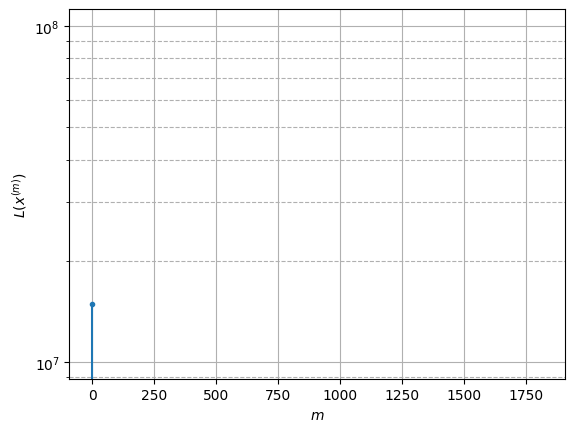

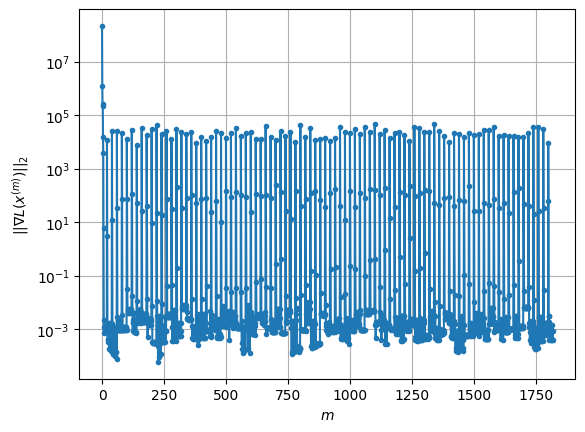

Windows:  24%|██▍       | 91/376 [10:49<33:13,  7.00s/it]

Before applying the algorithm
Cost function: -3151336.9112099297
Gradient norm: 34422.10114982163
Global relative error: 12.678431405604396
Position relative errors: 0.08837681264386131 m, 9.837838556212942 m, 5.289381452241762 m, 5.99782967616819 m

Iteration 1
Cost function: -3151341.667661261 (-0.00%)
Gradient norm: 38.7920541915069 (-99.89%)
Global relative error: 7.8239558317264395 (-38.29%)
Position relative errors: 0.12796439452815553 m, 3.4499480112058487 m, 6.578077188708555 m, 2.454500111386145 m

Iteration 2
Cost function: -3151341.668023919 (-0.00%)
Gradient norm: 0.02266920991929354 (-99.94%)
Global relative error: 7.936965139836311 (1.44%)
Position relative errors: 0.12796439557756623 m, 3.4646440857557357 m, 6.693275322380482 m, 2.485004692236533 m

Iteration 3
Cost function: -3151341.6680239113 (0.00%)
Gradient norm: 0.0007758474581954365 (-96.58%)
Global relative error: 7.936988969169483 (0.00%)
Position relative errors: 0.12796439495380815 m, 3.4646410672084462 m, 6.6

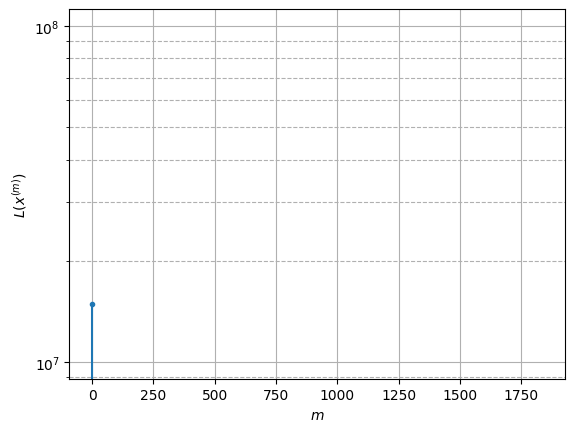

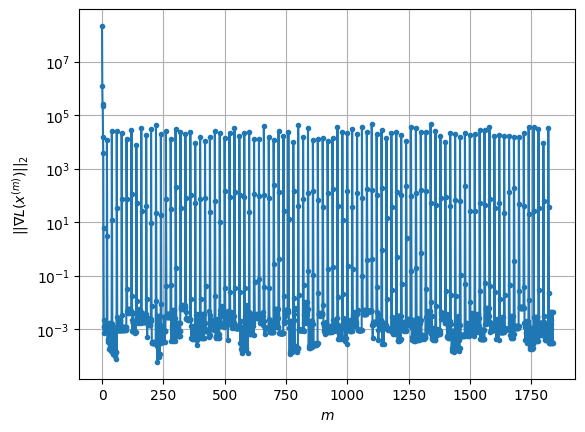

Windows:  24%|██▍       | 92/376 [10:56<33:30,  7.08s/it]

Before applying the algorithm
Cost function: -3151340.8668818376
Gradient norm: 16438.56545135164
Global relative error: 8.002855027451643
Position relative errors: 0.12202704437789219 m, 3.411178352104383 m, 6.926836859571055 m, 2.100832399308261 m

Iteration 1
Cost function: -3151345.240519883 (-0.00%)
Gradient norm: 87.16758691170268 (-99.47%)
Global relative error: 18.008158588532083 (125.02%)
Position relative errors: 0.13963829789870397 m, 7.028657524432975 m, 15.327330425080206 m, 6.320173796506136 m

Iteration 2
Cost function: -3151345.240892664 (-0.00%)
Gradient norm: 0.008701393770614076 (-99.99%)
Global relative error: 17.915345432231764 (-0.52%)
Position relative errors: 0.13963830029076077 m, 6.975877092429927 m, 15.261754474502983 m, 6.273396553102155 m

Iteration 3
Cost function: -3151345.240892649 (0.00%)
Gradient norm: 0.0010775556573087374 (-87.62%)
Global relative error: 17.915306974499295 (-0.00%)
Position relative errors: 0.13963830011830744 m, 6.975858111893529 m,

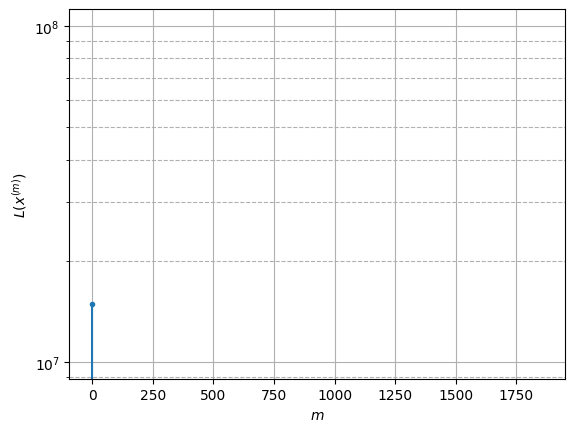

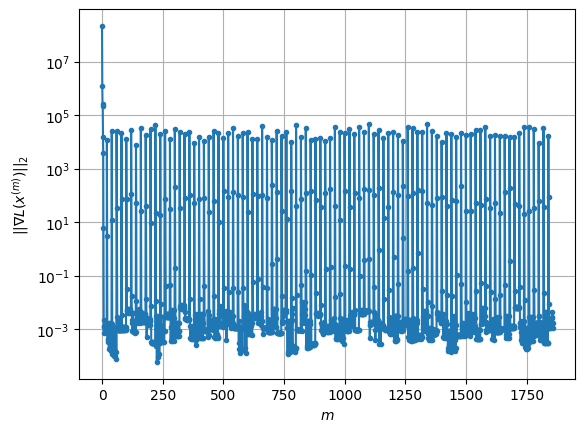

Windows:  25%|██▍       | 93/376 [11:03<33:22,  7.08s/it]

Before applying the algorithm
Cost function: -3151346.5686316965
Gradient norm: 29282.198375250286
Global relative error: 16.55646215463854
Position relative errors: 0.13134193310939507 m, 6.440879981317041 m, 14.109471519878209 m, 5.7910754995623455 m

Iteration 1
Cost function: -3151348.3178619714 (-0.00%)
Gradient norm: 28.300597097977498 (-99.90%)
Global relative error: 17.099525235214532 (3.28%)
Position relative errors: 0.15147676326290047 m, 6.035355978751299 m, 15.34484053770624 m, 4.525561460289419 m

Iteration 2
Cost function: -3151348.317907282 (-0.00%)
Gradient norm: 0.003639134999477878 (-99.99%)
Global relative error: 17.07986020770259 (-0.12%)
Position relative errors: 0.15147676485396194 m, 6.015017761935813 m, 15.338191225835475 m, 4.500852582600804 m

Iteration 3
Cost function: -3151348.317907274 (0.00%)
Gradient norm: 0.0006105893206306448 (-83.22%)
Global relative error: 17.07985789052191 (-0.00%)
Position relative errors: 0.15147676485396963 m, 6.015016360671759 m,

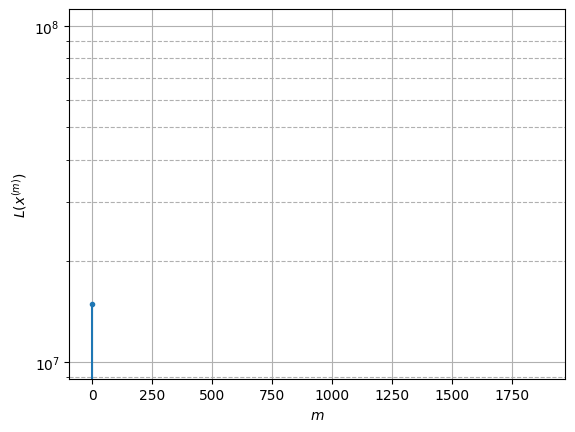

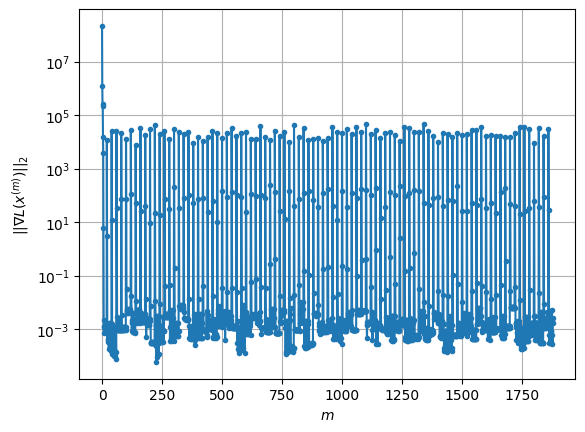

Windows:  25%|██▌       | 94/376 [11:10<33:21,  7.10s/it]

Before applying the algorithm
Cost function: -3151346.9279384087
Gradient norm: 18522.701859989767
Global relative error: 15.945717322054687
Position relative errors: 0.14050354781459626 m, 5.739910149660227 m, 14.27621153237539 m, 4.181983145840378 m

Iteration 1
Cost function: -3151350.2075046003 (-0.00%)
Gradient norm: 49.981978880272806 (-99.73%)
Global relative error: 11.26602075280199 (-29.35%)
Position relative errors: 0.15150193611798085 m, 0.626106839321173 m, 10.50233478153373 m, 4.026033776114188 m

Iteration 2
Cost function: -3151350.2079786053 (-0.00%)
Gradient norm: 0.05934226940464448 (-99.88%)
Global relative error: 11.333445419740029 (0.60%)
Position relative errors: 0.15150193513128135 m, 0.6355191018586243 m, 10.540401869821162 m, 4.113367925934846 m

Iteration 3
Cost function: -3151350.2079786262 (-0.00%)
Gradient norm: 0.0007943084112831053 (-98.66%)
Global relative error: 11.333475602206912 (0.00%)
Position relative errors: 0.15150193488727676 m, 0.635524180848106

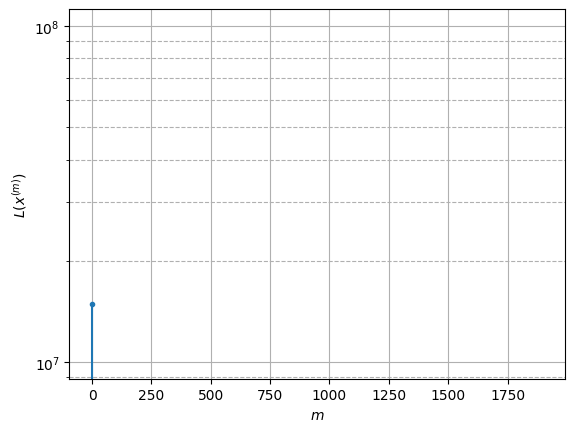

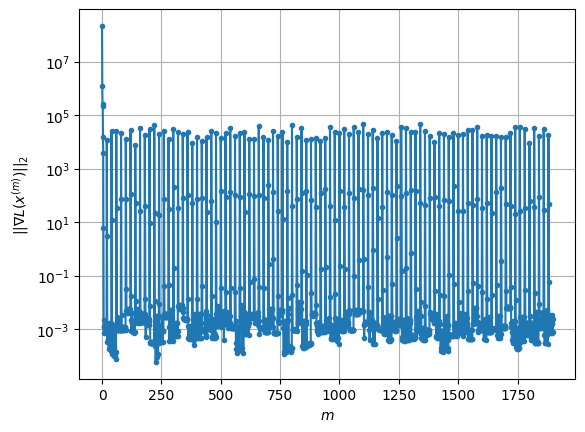

Windows:  25%|██▌       | 95/376 [11:17<32:42,  6.98s/it]

Before applying the algorithm
Cost function: -3151346.3946037497
Gradient norm: 7587.3312878496345
Global relative error: 10.494019702420243
Position relative errors: 0.13974923717687893 m, 0.7601626922475966 m, 9.718063423498192 m, 3.8840786728988665 m

Iteration 1
Cost function: -3151348.4209365603 (-0.00%)
Gradient norm: 62.9909752910828 (-99.17%)
Global relative error: 10.984331004596584 (4.67%)
Position relative errors: 0.17552745891656857 m, 2.178296678839482 m, 9.332779307314443 m, 5.3645585198126575 m

Iteration 2
Cost function: -3151348.4213871295 (-0.00%)
Gradient norm: 0.03485495706878349 (-99.94%)
Global relative error: 10.956429409874557 (-0.25%)
Position relative errors: 0.17552745985887303 m, 2.2013003380496294 m, 9.351771050846965 m, 5.264096832314009 m

Iteration 3
Cost function: -3151348.4213871104 (0.00%)
Gradient norm: 0.0015914225433996305 (-95.43%)
Global relative error: 10.95641876376206 (-0.00%)
Position relative errors: 0.175527460384514 m, 2.2013085272120545 m

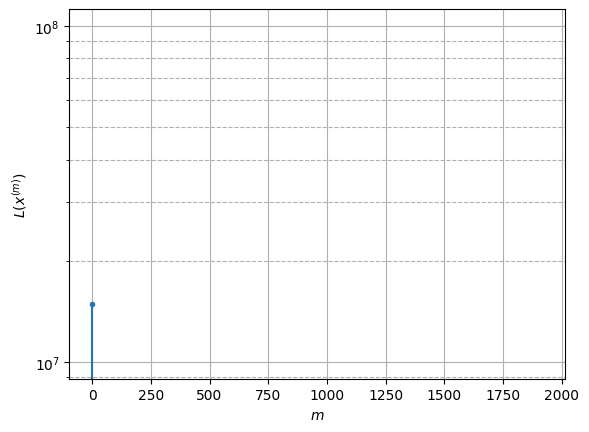

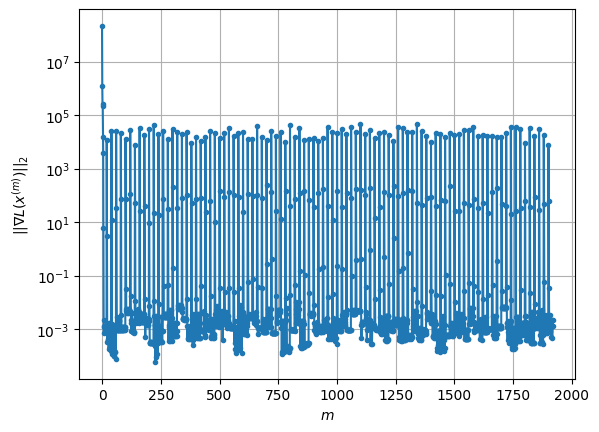

Windows:  26%|██▌       | 96/376 [11:24<32:18,  6.92s/it]

Before applying the algorithm
Cost function: -3151340.818186031
Gradient norm: 27284.346922205514
Global relative error: 9.79292533471507
Position relative errors: 0.1597285982359501 m, 1.970468824237779 m, 8.502031120520423 m, 4.439386112350503 m

Iteration 1
Cost function: -3151345.1158284703 (-0.00%)
Gradient norm: 38.9807663290522 (-99.86%)
Global relative error: 9.015478114662148 (-7.94%)
Position relative errors: 0.1718840505233548 m, 2.3879562300683532 m, 7.843548721786487 m, 3.745058138841424 m

Iteration 2
Cost function: -3151345.1160574276 (-0.00%)
Gradient norm: 0.0678349539798234 (-99.83%)
Global relative error: 9.008084918139557 (-0.08%)
Position relative errors: 0.1718840483812839 m, 2.4036282435913097 m, 7.834536603445431 m, 3.736096051453741 m

Iteration 3
Cost function: -3151345.116057427 (0.00%)
Gradient norm: 0.0004799505608546622 (-99.29%)
Global relative error: 9.008076477586167 (-0.00%)
Position relative errors: 0.17188404873326915 m, 2.4036258105428305 m, 7.83453

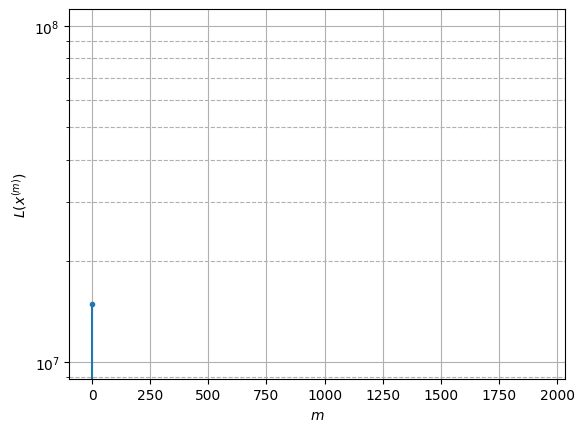

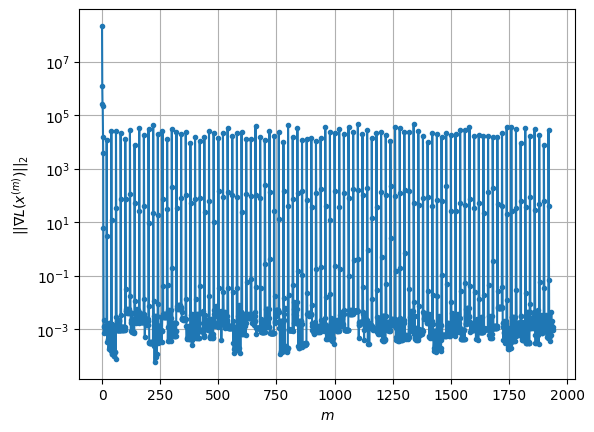

Windows:  26%|██▌       | 97/376 [11:31<32:18,  6.95s/it]

Before applying the algorithm
Cost function: -3151349.374549071
Gradient norm: 10929.919660389762
Global relative error: 8.314422417636862
Position relative errors: 0.1566139569038427 m, 2.196870764911656 m, 7.3826161548338325 m, 3.1265953978650844 m

Iteration 1
Cost function: -3151352.3020106833 (-0.00%)
Gradient norm: 38.95442104346032 (-99.64%)
Global relative error: 8.55102804409168 (2.85%)
Position relative errors: 0.16756486408365018 m, 1.3229965597715156 m, 3.6698424676687367 m, 7.607482328397858 m

Iteration 2
Cost function: -3151352.302087943 (-0.00%)
Gradient norm: 0.013592893204920109 (-99.97%)
Global relative error: 8.584420714158561 (0.39%)
Position relative errors: 0.16756486392940656 m, 1.3407948045234455 m, 3.684239597464458 m, 7.634965551548754 m

Iteration 3
Cost function: -3151352.302087948 (-0.00%)
Gradient norm: 0.0014109915813713167 (-89.62%)
Global relative error: 8.584424001871172 (0.00%)
Position relative errors: 0.1675648642183934 m, 1.3407957999230538 m, 3.6

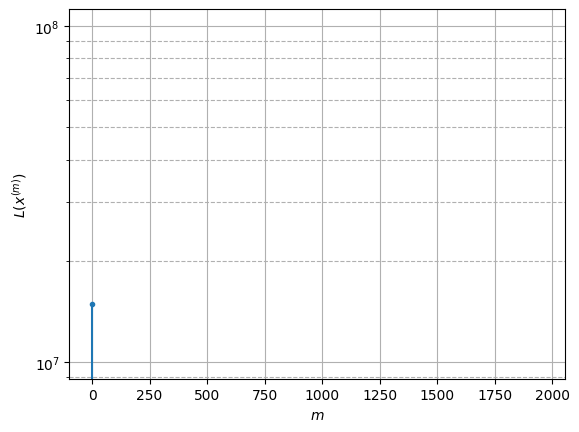

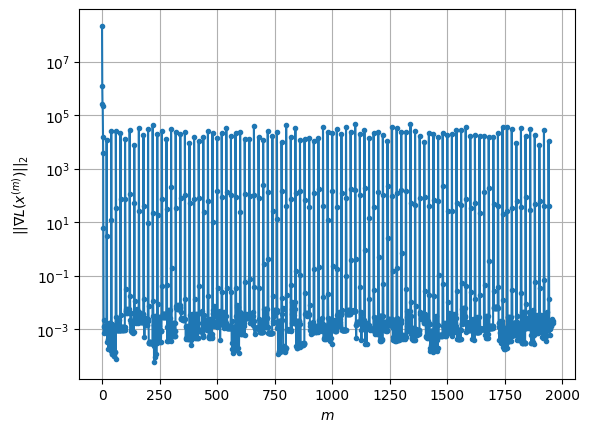

Windows:  26%|██▌       | 98/376 [11:38<32:14,  6.96s/it]

Before applying the algorithm
Cost function: -3151353.7166526434
Gradient norm: 29316.510685468962
Global relative error: 7.957908392193172
Position relative errors: 0.1504695358001094 m, 1.175081821763294 m, 3.662015154250971 m, 6.9652231723745635 m

Iteration 1
Cost function: -3151356.2939278143 (-0.00%)
Gradient norm: 41.10752807186733 (-99.86%)
Global relative error: 4.242099854658061 (-46.69%)
Position relative errors: 0.1577839077511671 m, 0.9582580242698422 m, 2.419209283423529 m, 3.3465813731831195 m

Iteration 2
Cost function: -3151356.2940524654 (-0.00%)
Gradient norm: 0.0038035573125673496 (-99.99%)
Global relative error: 4.27880126613249 (0.87%)
Position relative errors: 0.15778390675109796 m, 0.9252131692357117 m, 2.438444731503106 m, 3.388382387438132 m

Iteration 3
Cost function: -3151356.2940524453 (0.00%)
Gradient norm: 0.0021332424485803903 (-43.91%)
Global relative error: 4.278813190485481 (0.00%)
Position relative errors: 0.15778390646294463 m, 0.9252117851761568 m,

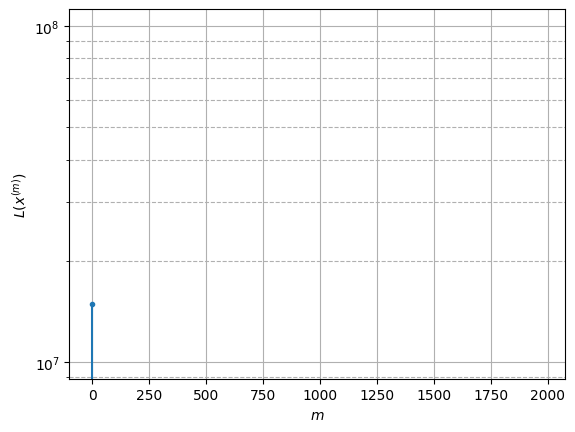

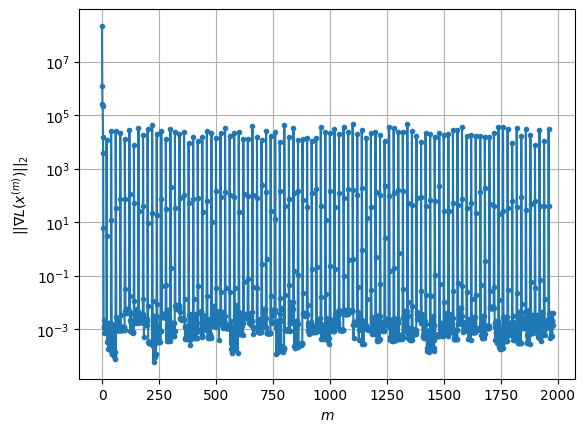

Windows:  26%|██▋       | 99/376 [11:45<31:54,  6.91s/it]

Before applying the algorithm
Cost function: -3151352.831653391
Gradient norm: 19315.641702899
Global relative error: 3.8965545062196645
Position relative errors: 0.1406188099142718 m, 0.6338053376321341 m, 2.169383308609437 m, 3.1710169635895817 m

Iteration 1
Cost function: -3151357.8630319573 (-0.00%)
Gradient norm: 69.41054817272132 (-99.64%)
Global relative error: 13.576761296754372 (248.43%)
Position relative errors: 0.11035103385178466 m, 5.494644810266381 m, 3.5198682501250156 m, 11.905257053978383 m

Iteration 2
Cost function: -3151357.8638956496 (-0.00%)
Gradient norm: 0.11798361391014259 (-99.83%)
Global relative error: 13.825046510757485 (1.83%)
Position relative errors: 0.11035103255777352 m, 5.683034473479351 m, 3.470293901789454 m, 12.115253076933698 m

Iteration 3
Cost function: -3151357.863895638 (0.00%)
Gradient norm: 0.0027131681942809977 (-97.70%)
Global relative error: 13.825181314242032 (0.00%)
Position relative errors: 0.11035103263784124 m, 5.683118730315586 m, 

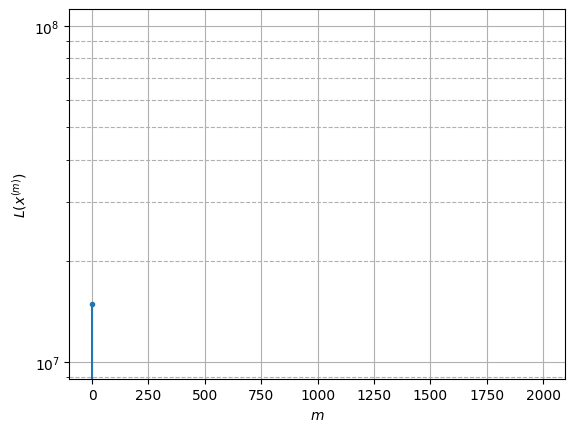

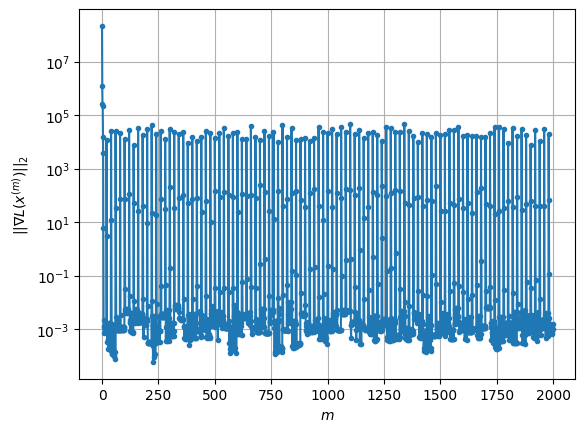

Windows:  27%|██▋       | 100/376 [11:52<31:50,  6.92s/it]

Before applying the algorithm
Cost function: -3151357.243360745
Gradient norm: 22115.219712594127
Global relative error: 12.51131130672376
Position relative errors: 0.09721379362751581 m, 4.815164459743899 m, 3.228034377939141 m, 11.086787234101799 m

Iteration 1
Cost function: -3151360.1910336073 (-0.00%)
Gradient norm: 174.8124672339855 (-99.21%)
Global relative error: 12.739596493901313 (1.82%)
Position relative errors: 0.12108524141008252 m, 4.7475789044008865 m, 5.083321075016352 m, 10.672508318867102 m

Iteration 2
Cost function: -3151360.1923381574 (-0.00%)
Gradient norm: 0.039779543130428925 (-99.98%)
Global relative error: 12.766983882456348 (0.21%)
Position relative errors: 0.12108524060339498 m, 4.684480325362371 m, 5.1618313931836175 m, 10.69541038561412 m

Iteration 3
Cost function: -3151360.1923381607 (-0.00%)
Gradient norm: 0.0025971653400580067 (-93.47%)
Global relative error: 12.766960866557433 (-0.00%)
Position relative errors: 0.12108524060339498 m, 4.684492475860142

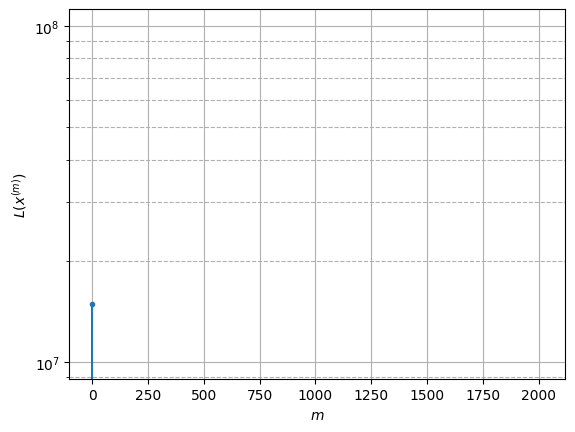

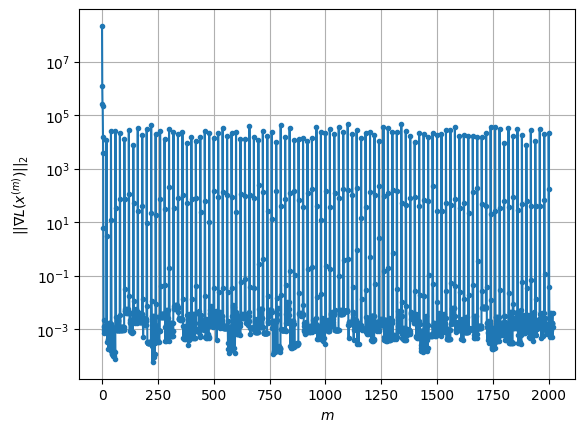

Windows:  27%|██▋       | 101/376 [11:59<31:59,  6.98s/it]

Before applying the algorithm
Cost function: -3151349.8194115674
Gradient norm: 45645.923871864456
Global relative error: 11.50231209615971
Position relative errors: 0.1062607050141115 m, 4.439783820289224 m, 5.055237094505868 m, 9.328676587114026 m

Iteration 1
Cost function: -3151353.0356781404 (-0.00%)
Gradient norm: 29.861120573843262 (-99.93%)
Global relative error: 11.226492666007518 (-2.40%)
Position relative errors: 0.09445822687970827 m, 6.571046322476102 m, 6.682543553583627 m, 6.1797804083358505 m

Iteration 2
Cost function: -3151353.036027294 (-0.00%)
Gradient norm: 0.028517354441282013 (-99.90%)
Global relative error: 11.31106503794904 (0.75%)
Position relative errors: 0.09445822895218137 m, 6.669662390024497 m, 6.75674205829609 m, 6.147586285110356 m

Iteration 3
Cost function: -3151353.036027303 (-0.00%)
Gradient norm: 0.000878976616325665 (-96.92%)
Global relative error: 11.311082394181113 (0.00%)
Position relative errors: 0.09445822895218137 m, 6.669679474338478 m, 6.7

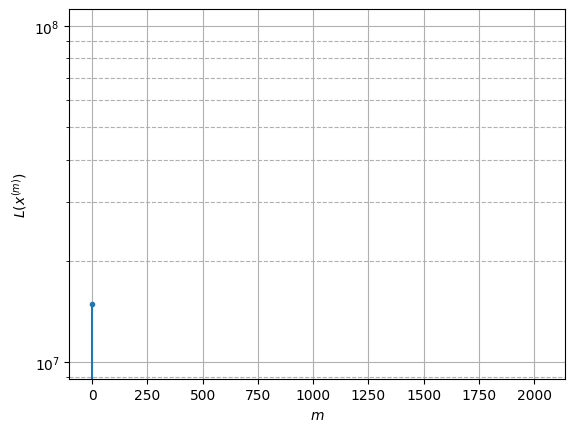

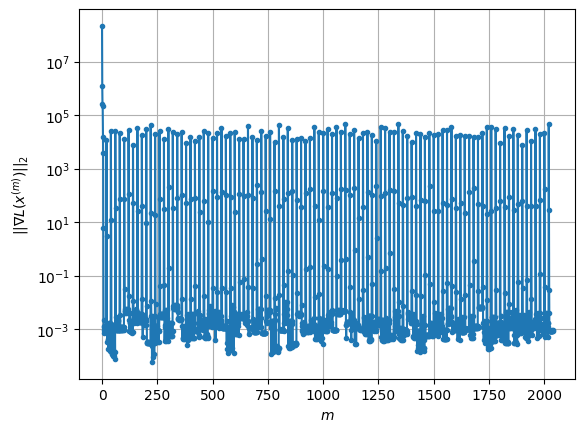

Windows:  27%|██▋       | 102/376 [12:05<31:25,  6.88s/it]

Before applying the algorithm
Cost function: -3151353.6291906494
Gradient norm: 14084.194662410635
Global relative error: 10.216504644166667
Position relative errors: 0.08400532553916233 m, 6.257885706183183 m, 6.253517583261919 m, 5.108990182049935 m

Iteration 1
Cost function: -3151355.2295034262 (-0.00%)
Gradient norm: 45.297415761638334 (-99.68%)
Global relative error: 8.23832928271597 (-19.36%)
Position relative errors: 0.05556710840643519 m, 3.1802321500849007 m, 5.476360800921394 m, 5.268991035256901 m

Iteration 2
Cost function: -3151355.2296780334 (-0.00%)
Gradient norm: 0.04622115216185295 (-99.90%)
Global relative error: 8.223430099824194 (-0.18%)
Position relative errors: 0.055567109069847624 m, 3.1480689554261136 m, 5.481471019706981 m, 5.2597098434676965 m

Iteration 3
Cost function: -3151355.229678019 (0.00%)
Gradient norm: 0.0007030352116496199 (-98.48%)
Global relative error: 8.223423298809442 (-0.00%)
Position relative errors: 0.05556710903479584 m, 3.1480609579908316

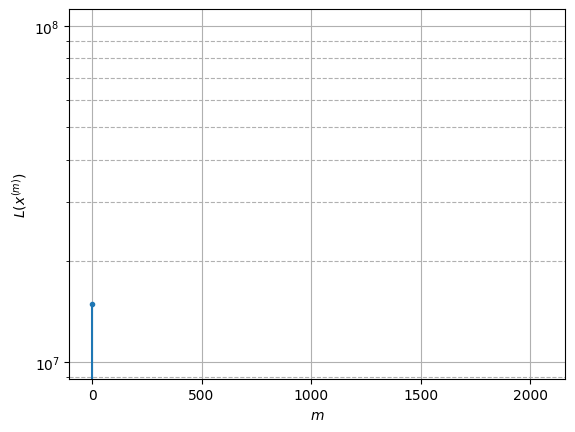

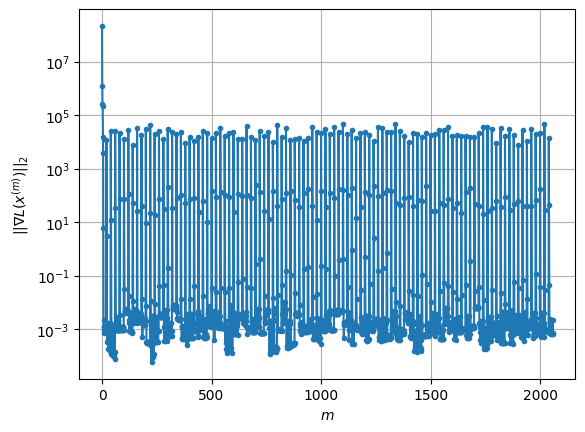

Windows:  27%|██▋       | 103/376 [12:12<31:20,  6.89s/it]

Before applying the algorithm
Cost function: -3151345.5381120043
Gradient norm: 48544.168678652575
Global relative error: 7.591610581788586
Position relative errors: 0.049749300923339096 m, 3.076817460377392 m, 4.999900149792187 m, 4.812896034462804 m

Iteration 1
Cost function: -3151350.7393484777 (-0.00%)
Gradient norm: 207.70222389793594 (-99.57%)
Global relative error: 16.05927763201455 (111.54%)
Position relative errors: 0.060845601086270934 m, 3.133817416349682 m, 5.158594339295131 m, 14.881644358597992 m

Iteration 2
Cost function: -3151350.746339395 (-0.00%)
Gradient norm: 2.3882127129679507 (-98.85%)
Global relative error: 15.105441043805888 (-5.94%)
Position relative errors: 0.06084559116453633 m, 3.088886496903884 m, 5.327759450334676 m, 13.792865401977997 m

Iteration 3
Cost function: -3151350.746339494 (-0.00%)
Gradient norm: 0.0003732188488137079 (-99.98%)
Global relative error: 15.103699734839266 (-0.01%)
Position relative errors: 0.06084559099384551 m, 3.088811572906074

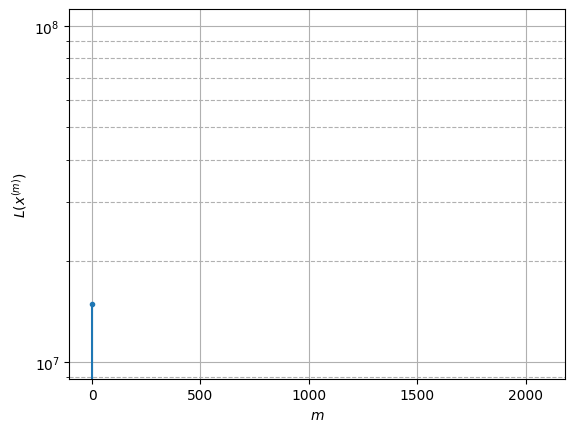

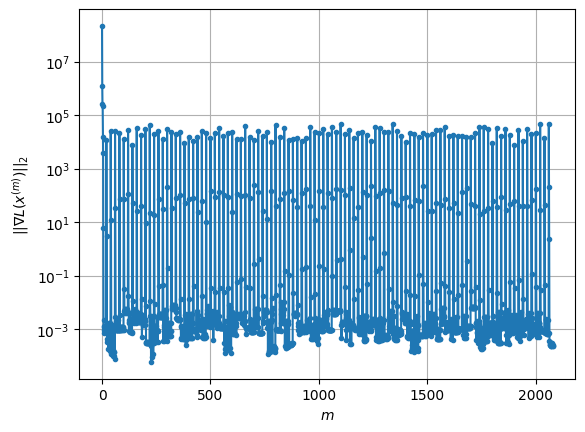

Windows:  28%|██▊       | 104/376 [12:19<30:57,  6.83s/it]

Before applying the algorithm
Cost function: -3151345.4028580044
Gradient norm: 17766.22715150114
Global relative error: 13.114564189197514
Position relative errors: 0.0570061373094183 m, 2.91010389169843 m, 4.982731465983876 m, 11.77670983556474 m

Iteration 1
Cost function: -3151348.5444897222 (-0.00%)
Gradient norm: 220.74034517907086 (-98.76%)
Global relative error: 14.78027024780996 (12.70%)
Position relative errors: 0.057697432017329374 m, 8.591880951768477 m, 4.330021580998752 m, 11.21966775816201 m

Iteration 2
Cost function: -3151348.546550474 (-0.00%)
Gradient norm: 0.8027755398152255 (-99.64%)
Global relative error: 14.846342488555539 (0.45%)
Position relative errors: 0.05769742753721029 m, 8.590266547476133 m, 4.417714217103752 m, 11.273826243955853 m

Iteration 3
Cost function: -3151348.546550514 (-0.00%)
Gradient norm: 0.0023201237628718836 (-99.71%)
Global relative error: 14.84619587856748 (-0.00%)
Position relative errors: 0.057697428127304 m, 8.590222718814344 m, 4.417

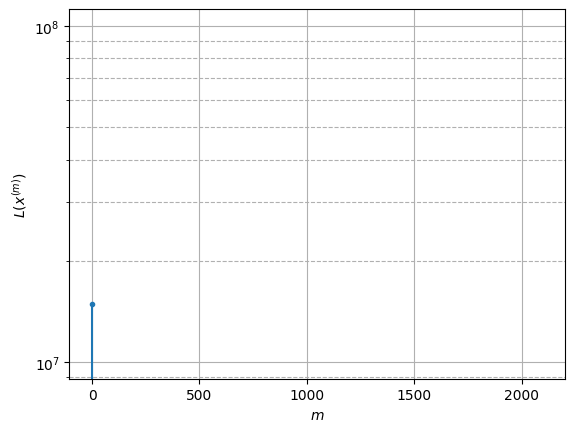

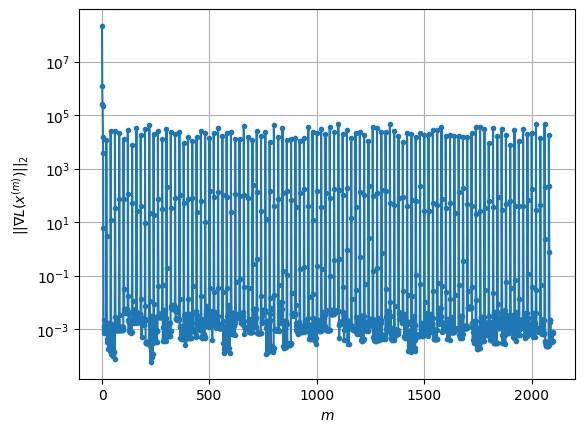

Windows:  28%|██▊       | 105/376 [12:26<30:41,  6.79s/it]

Before applying the algorithm
Cost function: -3151335.4072310263
Gradient norm: 44794.08252164461
Global relative error: 12.189729000995014
Position relative errors: 0.05366714698811418 m, 7.892301629668195 m, 3.982455932774301 m, 8.392594213122072 m

Iteration 1
Cost function: -3151342.863332433 (-0.00%)
Gradient norm: 158.08888856170987 (-99.65%)
Global relative error: 24.88530046642757 (104.15%)
Position relative errors: 0.07744599024087549 m, 5.153281214388804 m, 2.3973272817187983 m, 24.227330180797708 m

Iteration 2
Cost function: -3151342.8670811607 (-0.00%)
Gradient norm: 0.1854132432851314 (-99.88%)
Global relative error: 25.103865487440494 (0.88%)
Position relative errors: 0.07744599130063701 m, 5.2157872235513265 m, 2.2092035003664154 m, 24.45624432865073 m

Iteration 3
Cost function: -3151342.867081154 (0.00%)
Gradient norm: 0.0010157746751850438 (-99.45%)
Global relative error: 25.104424934231552 (0.00%)
Position relative errors: 0.07744599232317273 m, 5.215931116673893 m,

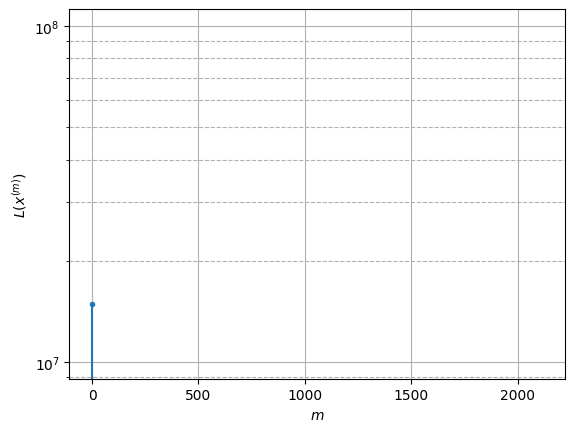

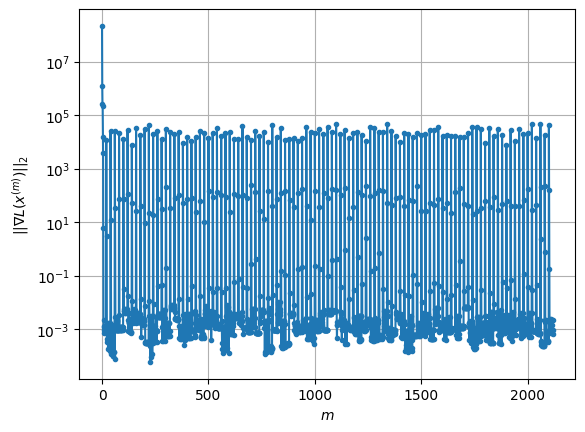

Windows:  28%|██▊       | 106/376 [12:32<30:28,  6.77s/it]

Before applying the algorithm
Cost function: -3151326.0141434157
Gradient norm: 11567.874671696944
Global relative error: 20.82885480146763
Position relative errors: 0.0730434084150577 m, 4.803828716521436 m, 1.9952774316435613 m, 20.1686053947915 m

Iteration 1
Cost function: -3151327.4682457135 (-0.00%)
Gradient norm: 201.6255393920449 (-98.26%)
Global relative error: 16.100352433498994 (-22.70%)
Position relative errors: 0.07525191712917799 m, 6.807006503971703 m, 3.144841883315236 m, 14.247366465824877 m

Iteration 2
Cost function: -3151327.46905022 (-0.00%)
Gradient norm: 0.17547370777916124 (-99.91%)
Global relative error: 15.934042080186112 (-1.03%)
Position relative errors: 0.07525191737689735 m, 6.8156143421080895 m, 3.1376060362619116 m, 14.056602221855648 m

Iteration 3
Cost function: -3151327.469050213 (0.00%)
Gradient norm: 0.0025008431375810733 (-98.57%)
Global relative error: 15.933882472438594 (-0.00%)
Position relative errors: 0.07525191828530943 m, 6.8156336305977225 

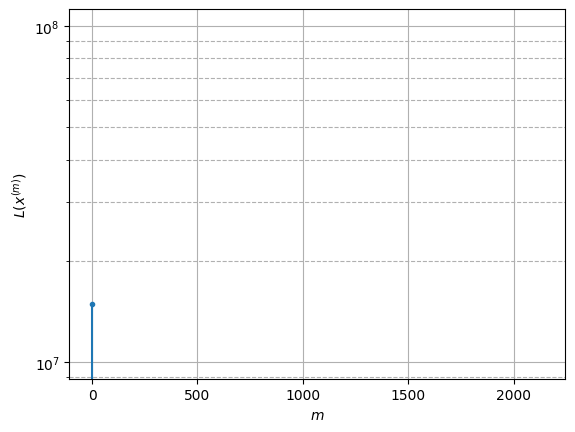

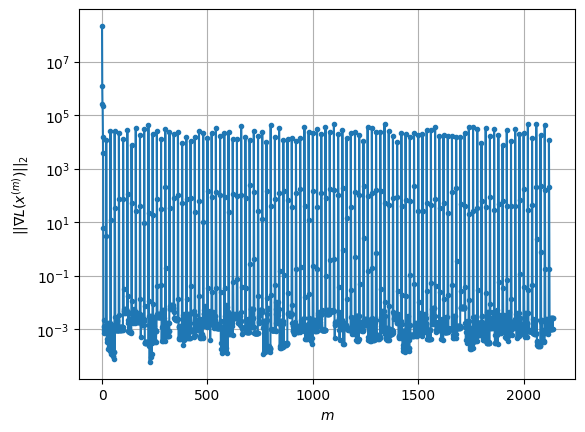

Windows:  28%|██▊       | 107/376 [12:39<30:18,  6.76s/it]

Before applying the algorithm
Cost function: -3151325.209508328
Gradient norm: 25415.26498125968
Global relative error: 13.132475641328028
Position relative errors: 0.0696689415421199 m, 6.251782717676664 m, 3.012073435258981 m, 11.148850586317062 m

Iteration 1
Cost function: -3151329.350988585 (-0.00%)
Gradient norm: 48.677156127321055 (-99.81%)
Global relative error: 12.198041699739857 (-7.12%)
Position relative errors: 0.057167993186258814 m, 6.157861836090235 m, 0.6097926378277485 m, 10.511690266546548 m

Iteration 2
Cost function: -3151329.3511980386 (-0.00%)
Gradient norm: 0.055093565028040165 (-99.89%)
Global relative error: 12.200188601835647 (0.02%)
Position relative errors: 0.057167992246873536 m, 6.141843649278073 m, 0.6092084895469129 m, 10.523579104002474 m

Iteration 3
Cost function: -3151329.3511980246 (0.00%)
Gradient norm: 0.00489810568390081 (-91.11%)
Global relative error: 12.20020061583492 (0.00%)
Position relative errors: 0.057167992482247916 m, 6.141844829388658 

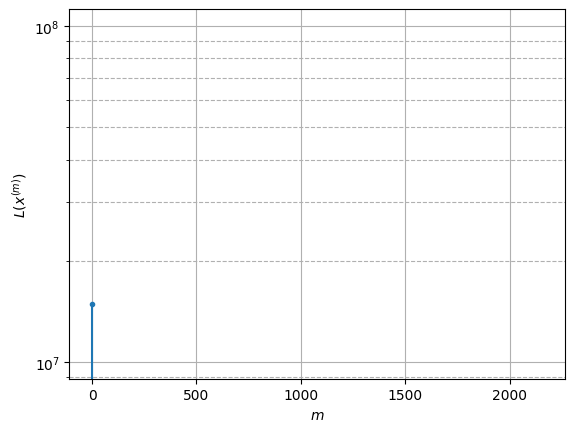

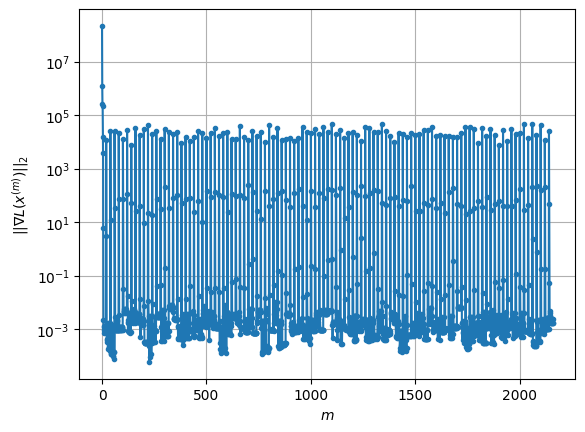

Windows:  29%|██▊       | 108/376 [12:46<30:22,  6.80s/it]

Before applying the algorithm
Cost function: -3151322.652621861
Gradient norm: 44858.3301423943
Global relative error: 10.494856994678143
Position relative errors: 0.05401620720037864 m, 5.609970937361653 m, 0.5692140911057403 m, 8.851052415846755 m

Iteration 1
Cost function: -3151327.9273734675 (-0.00%)
Gradient norm: 63.47235496902289 (-99.86%)
Global relative error: 10.613115694367998 (1.13%)
Position relative errors: 0.08827026847217272 m, 6.669679187010373 m, 3.940515170399252 m, 7.253719009200125 m

Iteration 2
Cost function: -3151327.9282589094 (-0.00%)
Gradient norm: 0.3921059818661846 (-99.38%)
Global relative error: 10.648496112452822 (0.33%)
Position relative errors: 0.0882702680902146 m, 6.705178393456009 m, 3.922781220297336 m, 7.282403528490249 m

Iteration 3
Cost function: -3151327.9282588847 (0.00%)
Gradient norm: 0.0016250129380825642 (-99.59%)
Global relative error: 10.64852506283487 (0.00%)
Position relative errors: 0.08827026848627378 m, 6.70520044276676 m, 3.92276

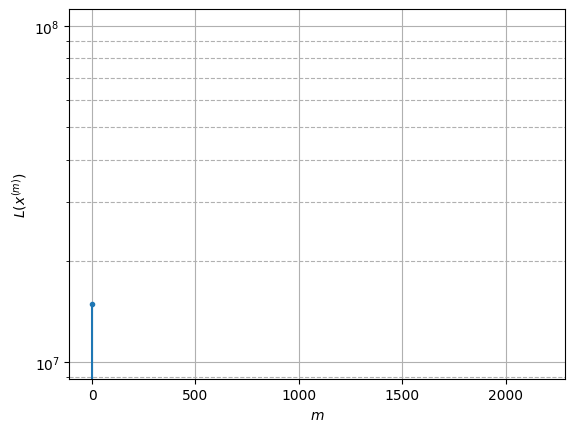

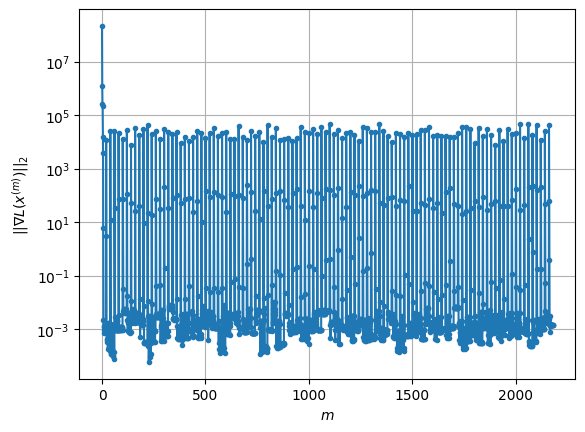

Windows:  29%|██▉       | 109/376 [12:53<30:24,  6.83s/it]

Before applying the algorithm
Cost function: -3151325.8015300552
Gradient norm: 29748.59341584297
Global relative error: 9.951985007066298
Position relative errors: 0.08024327018381872 m, 6.167603309455966 m, 3.652423244681468 m, 6.903219104085448 m

Iteration 1
Cost function: -3151330.410502265 (-0.00%)
Gradient norm: 194.1199869173929 (-99.35%)
Global relative error: 9.857812617893389 (-0.95%)
Position relative errors: 0.09172650539444417 m, 5.022205420370839 m, 4.323045000962293 m, 7.297692323507307 m

Iteration 2
Cost function: -3151330.4145843694 (-0.00%)
Gradient norm: 1.8125914641848517 (-99.07%)
Global relative error: 10.286191570750473 (4.35%)
Position relative errors: 0.09172651751823535 m, 5.080611253470163 m, 4.256580812281303 m, 7.865483800449516 m

Iteration 3
Cost function: -3151330.414584406 (-0.00%)
Gradient norm: 0.0003070377239990803 (-99.98%)
Global relative error: 10.28623836408025 (0.00%)
Position relative errors: 0.09172651753940397 m, 5.080731901773202 m, 4.2564

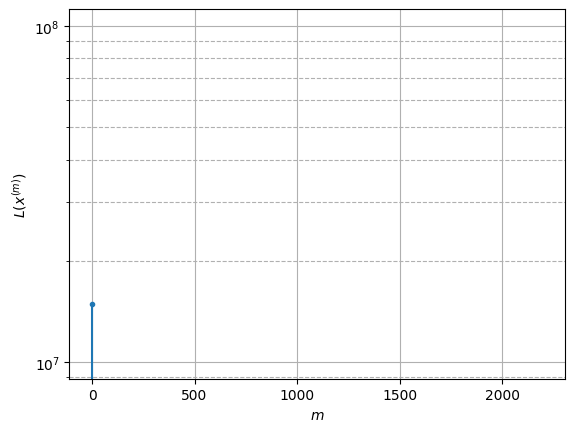

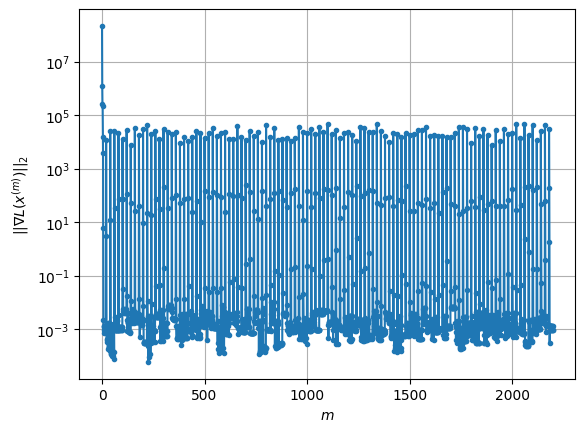

Windows:  29%|██▉       | 110/376 [13:00<30:23,  6.86s/it]

Before applying the algorithm
Cost function: -3151333.8842963716
Gradient norm: 30431.45425767713
Global relative error: 10.64936367025061
Position relative errors: 0.08236544428359177 m, 4.864776035375907 m, 3.8919587946045127 m, 8.636457154803601 m

Iteration 1
Cost function: -3151338.7270998773 (-0.00%)
Gradient norm: 143.9696540146678 (-99.53%)
Global relative error: 30.04637402668401 (182.14%)
Position relative errors: 0.11288426832797153 m, 2.569348583735204 m, 7.517505366170405 m, 28.976836788209138 m

Iteration 2
Cost function: -3151338.731335766 (-0.00%)
Gradient norm: 0.5808623076132643 (-99.60%)
Global relative error: 29.360704267026517 (-2.28%)
Position relative errors: 0.11288427269762297 m, 2.7278845578681308 m, 7.498056961405301 m, 28.255541876762106 m

Iteration 3
Cost function: -3151338.731335806 (-0.00%)
Gradient norm: 0.00029283314710912137 (-99.95%)
Global relative error: 29.357460042646544 (-0.01%)
Position relative errors: 0.11288427269762297 m, 2.7282018687572087

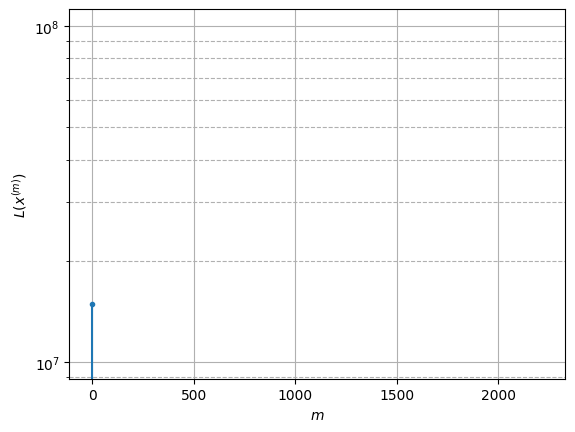

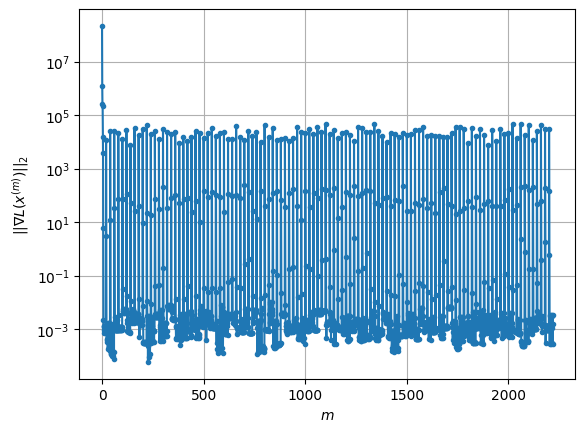

Windows:  30%|██▉       | 111/376 [13:07<30:15,  6.85s/it]

Before applying the algorithm
Cost function: -3151337.4355271156
Gradient norm: 28970.963297493287
Global relative error: 28.2649453296191
Position relative errors: 0.09974637997020469 m, 2.42207142000227 m, 7.040654065681129 m, 27.26645426587688 m

Iteration 1
Cost function: -3151342.656518819 (-0.00%)
Gradient norm: 83.37039757229297 (-99.71%)
Global relative error: 42.52895464970606 (50.47%)
Position relative errors: 0.1205968785289697 m, 6.531543957623883 m, 6.823408152330462 m, 41.466562206561 m

Iteration 2
Cost function: -3151342.6591784656 (-0.00%)
Gradient norm: 0.4681498516253514 (-99.44%)
Global relative error: 41.45135425788975 (-2.53%)
Position relative errors: 0.12059686515959742 m, 6.5192827009327665 m, 6.647955307046087 m, 40.39185931900444 m

Iteration 3
Cost function: -3151342.659178469 (-0.00%)
Gradient norm: 0.0013579011596961906 (-99.71%)
Global relative error: 41.449593752363555 (-0.00%)
Position relative errors: 0.12059686515959742 m, 6.51936813647316 m, 6.647683

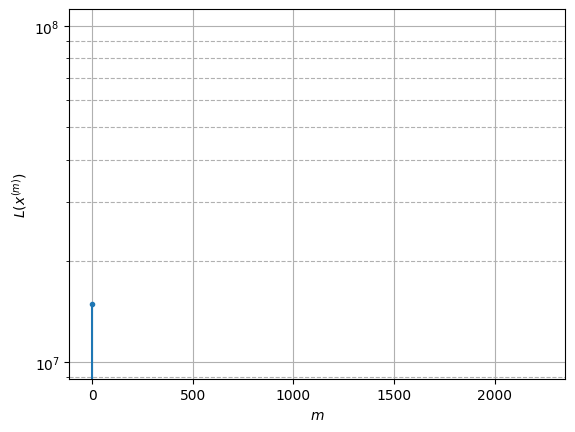

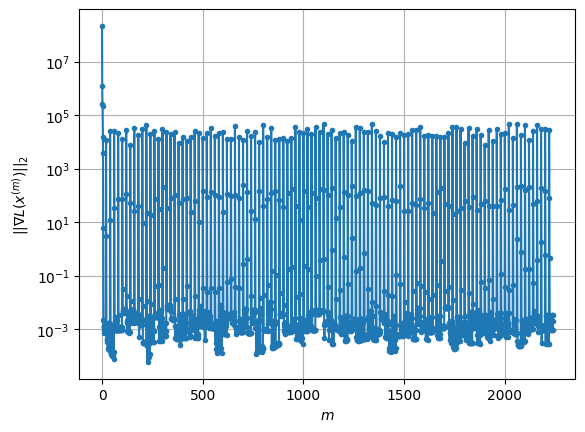

Windows:  30%|██▉       | 112/376 [13:14<30:18,  6.89s/it]

Before applying the algorithm
Cost function: -3151341.075826768
Gradient norm: 20008.721678954746
Global relative error: 39.01226866636788
Position relative errors: 0.10659333195393898 m, 6.033866710162248 m, 6.045473433068714 m, 38.06558371354129 m

Iteration 1
Cost function: -3151342.6075975387 (-0.00%)
Gradient norm: 81.09715174128101 (-99.59%)
Global relative error: 28.07870394984201 (-28.03%)
Position relative errors: 0.13326193661658123 m, 5.328340531721762 m, 4.2519029354010875 m, 27.238309432154548 m

Iteration 2
Cost function: -3151342.6077454966 (-0.00%)
Gradient norm: 0.007341799136489606 (-99.99%)
Global relative error: 28.13069918134837 (0.19%)
Position relative errors: 0.1332619384438289 m, 5.359757430090594 m, 4.267918213129687 m, 27.283252747726316 m

Iteration 3
Cost function: -3151342.607745506 (-0.00%)
Gradient norm: 0.0016189275247310406 (-77.95%)
Global relative error: 28.13072055436313 (0.00%)
Position relative errors: 0.1332619384438289 m, 5.359759125810869 m, 4.

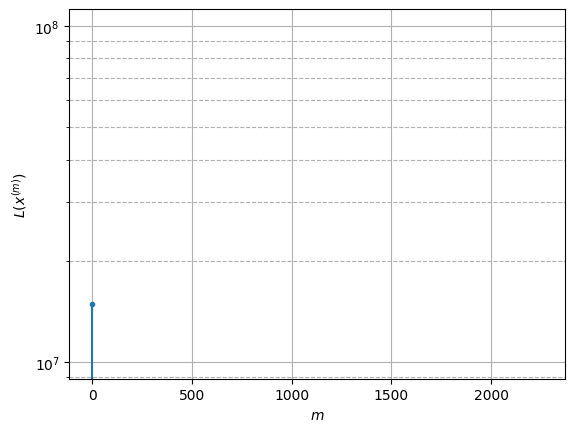

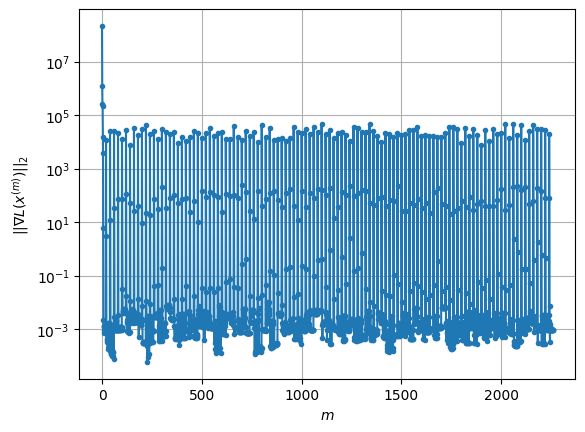

Windows:  30%|███       | 113/376 [13:21<30:11,  6.89s/it]

Before applying the algorithm
Cost function: -3151334.375484946
Gradient norm: 23463.184696993136
Global relative error: 26.811457331836742
Position relative errors: 0.11790848811416262 m, 4.988112369283159 m, 3.906509463792414 m, 26.051827496470985 m

Iteration 1
Cost function: -3151337.7675920837 (-0.00%)
Gradient norm: 86.53658682817593 (-99.63%)
Global relative error: 29.161833713629505 (8.77%)
Position relative errors: 0.094858680759632 m, 12.542262978370518 m, 4.099690663484975 m, 26.005515604733432 m

Iteration 2
Cost function: -3151337.768081349 (-0.00%)
Gradient norm: 0.004721394851008958 (-99.99%)
Global relative error: 29.022435463406655 (-0.48%)
Position relative errors: 0.0948586772752661 m, 12.483687704431203 m, 4.090392389732922 m, 25.878912550946335 m

Iteration 3
Cost function: -3151337.7680813335 (0.00%)
Gradient norm: 0.001631935030334435 (-65.44%)
Global relative error: 29.02239081299751 (-0.00%)
Position relative errors: 0.09485867819999849 m, 12.48366984490906 m, 

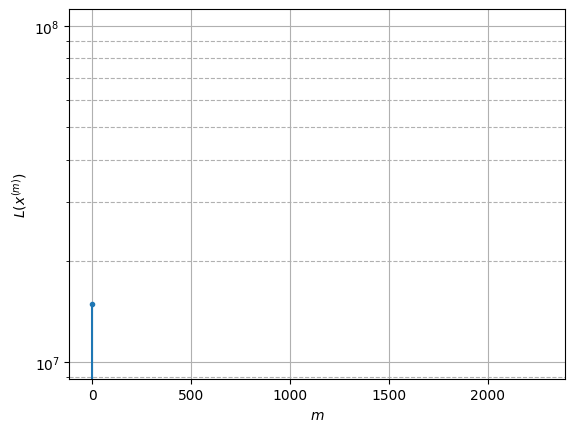

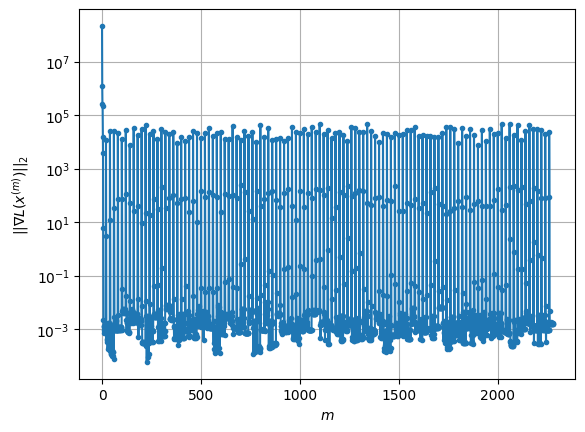

Windows:  30%|███       | 114/376 [13:27<30:01,  6.88s/it]

Before applying the algorithm
Cost function: -3151328.272496542
Gradient norm: 30684.497564735244
Global relative error: 27.325393352608394
Position relative errors: 0.0837117808452867 m, 11.412408742317789 m, 3.5810907868046353 m, 24.568311253772407 m

Iteration 1
Cost function: -3151329.94550041 (-0.00%)
Gradient norm: 46.88201131079159 (-99.85%)
Global relative error: 32.36321686244207 (18.44%)
Position relative errors: 0.06495465727846987 m, 8.908929203713257 m, 5.798109995611376 m, 30.567713086746778 m

Iteration 2
Cost function: -3151329.9458621982 (-0.00%)
Gradient norm: 0.09203482037958953 (-99.80%)
Global relative error: 32.05093324453307 (-0.96%)
Position relative errors: 0.06495465159646019 m, 8.930484664347711 m, 5.722350180039646 m, 30.244964777367077 m

Iteration 3
Cost function: -3151329.94586219 (0.00%)
Gradient norm: 0.002804055665596805 (-96.95%)
Global relative error: 32.05062628259457 (-0.00%)
Position relative errors: 0.06495465160580541 m, 8.930495862463392 m, 5.7

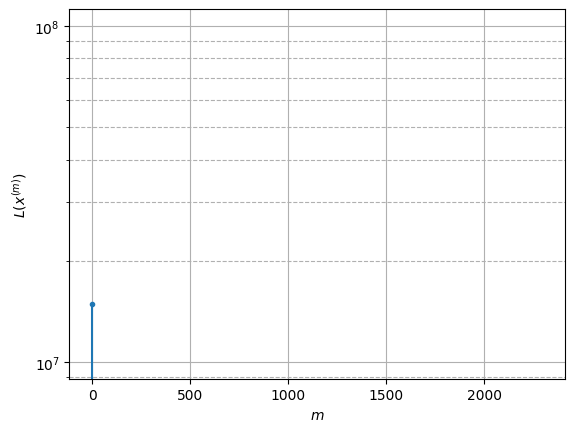

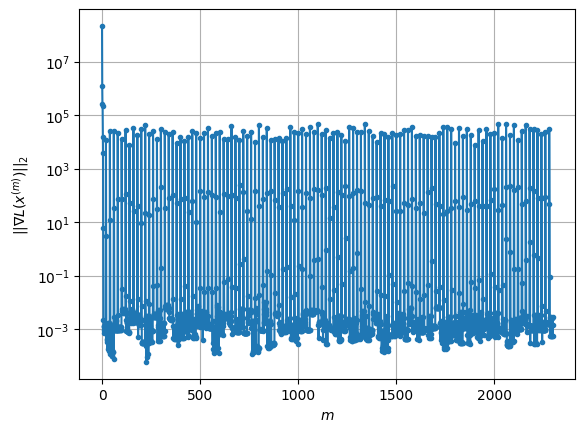

Windows:  31%|███       | 115/376 [13:34<29:51,  6.86s/it]

Before applying the algorithm
Cost function: -3151330.1698749596
Gradient norm: 16055.761077804022
Global relative error: 29.859289871473162
Position relative errors: 0.057659136826050415 m, 8.113360428269505 m, 5.110431327485509 m, 28.27771653813928 m

Iteration 1
Cost function: -3151334.066832491 (-0.00%)
Gradient norm: 12.764541394108493 (-99.92%)
Global relative error: 30.120647129382608 (0.88%)
Position relative errors: 0.05367478135503625 m, 3.6016564068055157 m, 9.336915487597208 m, 28.409490213437337 m

Iteration 2
Cost function: -3151334.066968197 (-0.00%)
Gradient norm: 0.0033477535691466657 (-99.97%)
Global relative error: 30.14570928736583 (0.08%)
Position relative errors: 0.05367478117943267 m, 3.546494998042205 m, 9.304717429539693 m, 28.45354226398221 m

Iteration 3
Cost function: -3151334.0669682003 (-0.00%)
Gradient norm: 0.0005322527430304074 (-84.10%)
Global relative error: 30.14570158462731 (-0.00%)
Position relative errors: 0.053674781142774707 m, 3.546485795704728

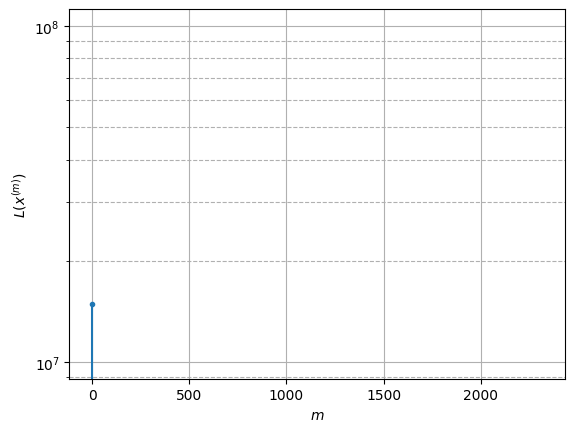

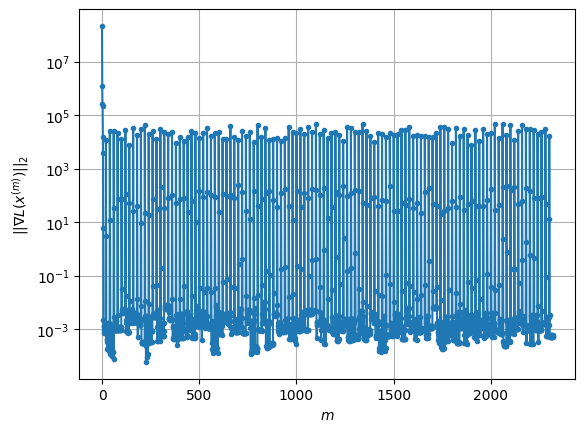

Windows:  31%|███       | 116/376 [13:41<29:40,  6.85s/it]

Before applying the algorithm
Cost function: -3151323.4060301296
Gradient norm: 44281.78508728074
Global relative error: 27.893324114486383
Position relative errors: 0.04622090844587807 m, 3.1148007210915867 m, 8.464734203250865 m, 26.39469850899582 m

Iteration 1
Cost function: -3151327.063608318 (-0.00%)
Gradient norm: 146.31546265833842 (-99.67%)
Global relative error: 20.289187821482095 (-27.26%)
Position relative errors: 0.014738815426121862 m, 4.179625595973389 m, 3.3280692486141974 m, 19.57307877765973 m

Iteration 2
Cost function: -3151327.0651673195 (-0.00%)
Gradient norm: 0.7812354186987175 (-99.47%)
Global relative error: 20.60486178784321 (1.56%)
Position relative errors: 0.014738817310637437 m, 4.187522991896755 m, 3.467477022158843 m, 19.87463534101991 m

Iteration 3
Cost function: -3151327.0651673106 (0.00%)
Gradient norm: 0.0006159016666868591 (-99.92%)
Global relative error: 20.605045727343377 (0.00%)
Position relative errors: 0.014738818058910384 m, 4.187529331520236 

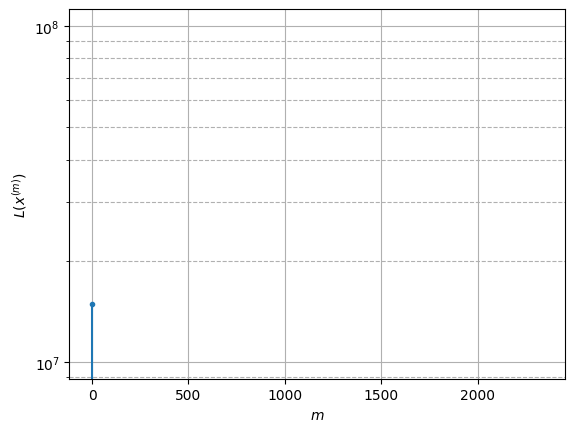

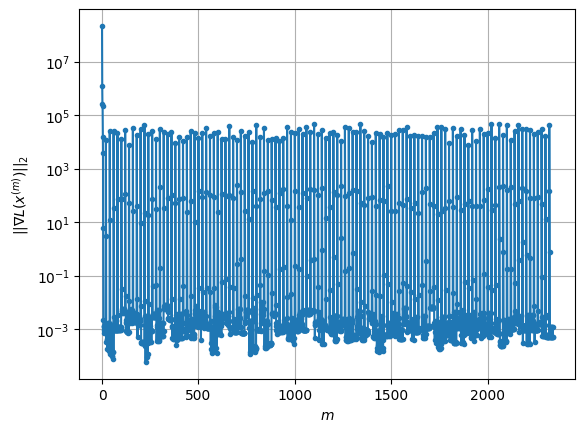

Windows:  31%|███       | 117/376 [13:48<29:21,  6.80s/it]

Before applying the algorithm
Cost function: -3151320.361686036
Gradient norm: 26265.521113301114
Global relative error: 19.74660065631293
Position relative errors: 0.017956339335652566 m, 3.8614515693566966 m, 3.169302406808534 m, 19.104249832415604 m

Iteration 1
Cost function: -3151321.3117701416 (-0.00%)
Gradient norm: 4.635458655180299 (-99.98%)
Global relative error: 20.56198277103722 (4.13%)
Position relative errors: 0.0367442937870433 m, 4.605269798789472 m, 1.6859007753859572 m, 19.968544855160356 m

Iteration 2
Cost function: -3151321.311771472 (-0.00%)
Gradient norm: 0.0012391150981470264 (-99.97%)
Global relative error: 20.571406859295312 (0.05%)
Position relative errors: 0.03674429384306871 m, 4.604945708111182 m, 1.68739164151675 m, 19.978197712350294 m

Iteration 3
Cost function: -3151321.3117714627 (0.00%)
Gradient norm: 0.0005399839453709676 (-56.42%)
Global relative error: 20.571407400601675 (0.00%)
Position relative errors: 0.036744293083877624 m, 4.60494571410759 m,

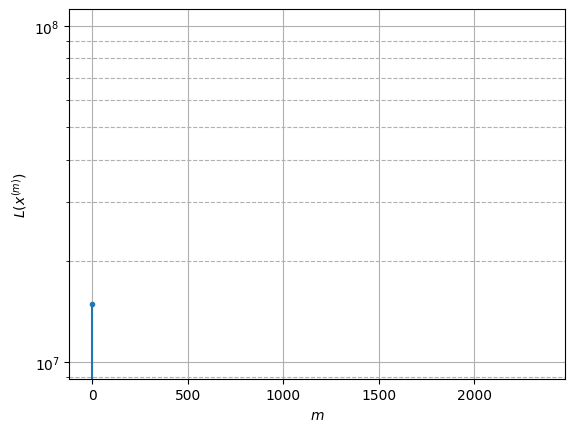

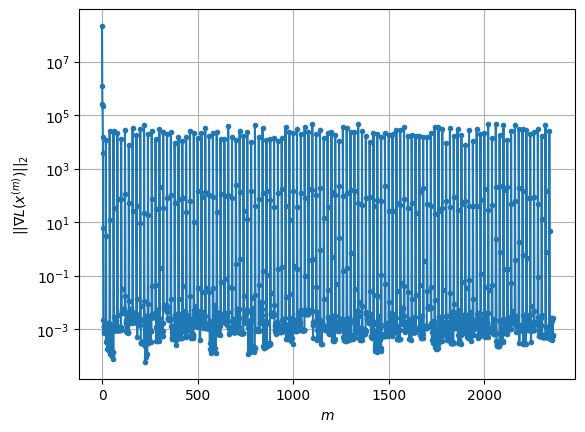

Windows:  31%|███▏      | 118/376 [13:54<29:09,  6.78s/it]

Before applying the algorithm
Cost function: -3151316.8030884084
Gradient norm: 14894.184249891545
Global relative error: 19.73772449250689
Position relative errors: 0.033447894741015664 m, 4.287289458091961 m, 1.6378555292332795 m, 19.196691584517364 m

Iteration 1
Cost function: -3151320.2175497194 (-0.00%)
Gradient norm: 21.99313414476706 (-99.85%)
Global relative error: 19.316571803223585 (-2.13%)
Position relative errors: 0.04899317549361177 m, 1.8905709353385358 m, 6.827858655864507 m, 17.970342686695034 m

Iteration 2
Cost function: -3151320.218021875 (-0.00%)
Gradient norm: 0.08181352735458089 (-99.63%)
Global relative error: 18.753335160518347 (-2.92%)
Position relative errors: 0.048993178763223365 m, 1.8698548073138175 m, 6.691432680628512 m, 17.418758736965316 m

Iteration 3
Cost function: -3151320.218021882 (-0.00%)
Gradient norm: 0.002311409107611166 (-97.17%)
Global relative error: 18.753015997519217 (-0.00%)
Position relative errors: 0.04899317861610686 m, 1.869843512750

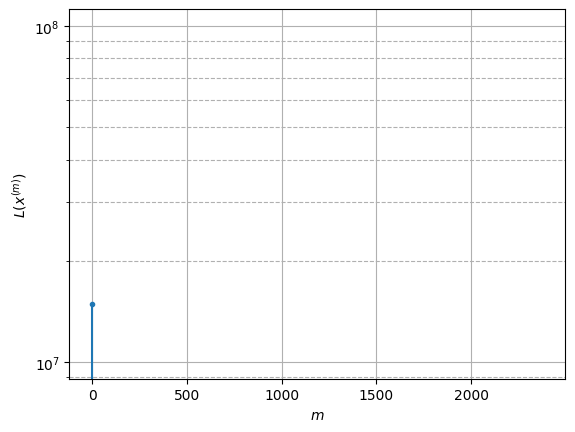

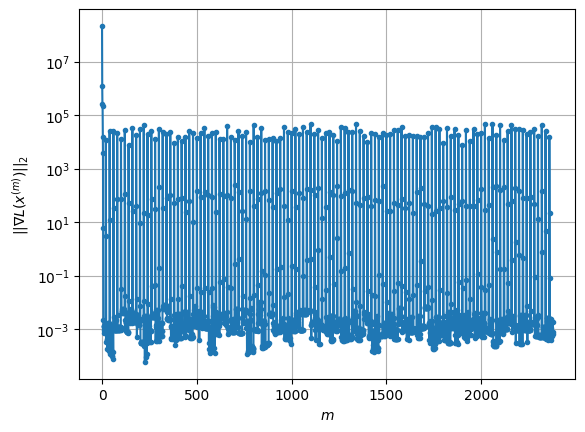

Windows:  32%|███▏      | 119/376 [14:01<28:57,  6.76s/it]

Before applying the algorithm
Cost function: -3151320.8227079194
Gradient norm: 24295.743090255117
Global relative error: 17.870754324734733
Position relative errors: 0.0496033867472578 m, 1.9358395072362793 m, 6.231847862283354 m, 16.636634874469852 m

Iteration 1
Cost function: -3151324.3761461475 (-0.00%)
Gradient norm: 46.89676139788482 (-99.81%)
Global relative error: 13.15746361541335 (-26.37%)
Position relative errors: 0.06905539113465994 m, 3.9478680102697172 m, 5.408436083826889 m, 11.325948275493385 m

Iteration 2
Cost function: -3151324.37651251 (-0.00%)
Gradient norm: 0.17224296411882567 (-99.63%)
Global relative error: 12.971680527351596 (-1.41%)
Position relative errors: 0.06905539145409176 m, 3.968353659567936 m, 5.331048071849286 m, 11.139645181150842 m

Iteration 3
Cost function: -3151324.376512501 (0.00%)
Gradient norm: 0.0004170999694477642 (-99.76%)
Global relative error: 12.971559499187673 (-0.00%)
Position relative errors: 0.06905539157950631 m, 3.968352144796848 

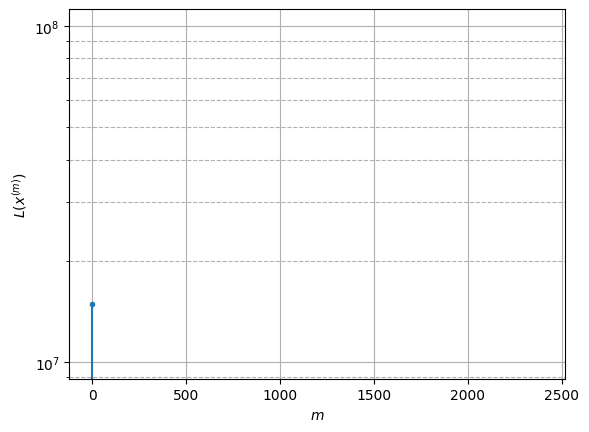

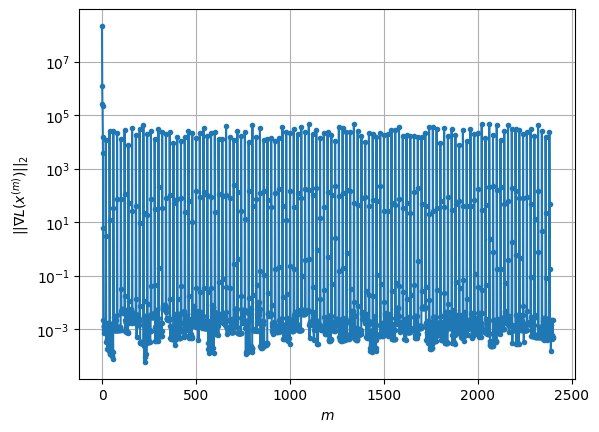

Windows:  32%|███▏      | 120/376 [14:08<29:08,  6.83s/it]

Before applying the algorithm
Cost function: -3151326.475754332
Gradient norm: 13515.754590211118
Global relative error: 12.813519228453051
Position relative errors: 0.06373989446025068 m, 4.126725203123236 m, 4.906474277474141 m, 11.094085829306795 m

Iteration 1
Cost function: -3151328.2550820573 (-0.00%)
Gradient norm: 61.30322006407729 (-99.55%)
Global relative error: 11.47159939338536 (-10.47%)
Position relative errors: 0.06629119929442868 m, 5.05385017217962 m, 4.157141353442233 m, 9.421753910420565 m

Iteration 2
Cost function: -3151328.2561223516 (-0.00%)
Gradient norm: 0.06277117399779424 (-99.90%)
Global relative error: 11.920289217274734 (3.91%)
Position relative errors: 0.06629119558652384 m, 5.0611296542933735 m, 4.283412318332615 m, 9.90584120640237 m

Iteration 3
Cost function: -3151328.256122354 (-0.00%)
Gradient norm: 0.0020418551734137334 (-96.75%)
Global relative error: 11.921589552872916 (0.01%)
Position relative errors: 0.06629119652047319 m, 5.061139266035938 m, 4

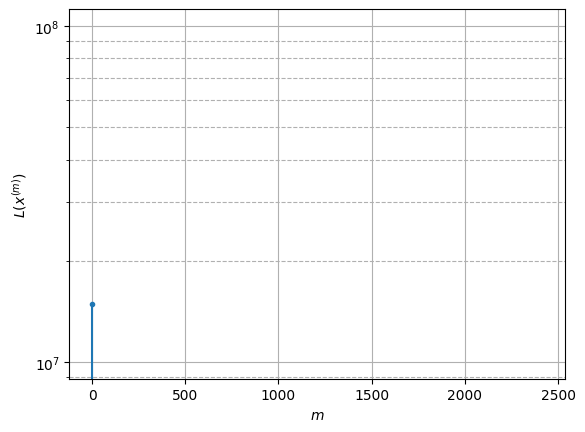

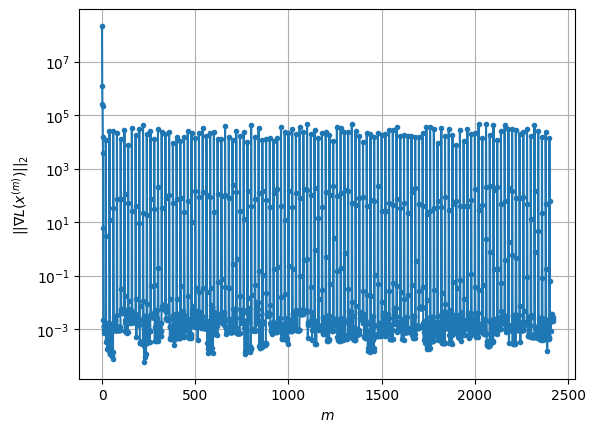

Windows:  32%|███▏      | 121/376 [14:15<29:17,  6.89s/it]

Before applying the algorithm
Cost function: -3151328.2734072856
Gradient norm: 18615.173286197896
Global relative error: 10.68144582689876
Position relative errors: 0.059694707314055157 m, 4.7863810729116105 m, 3.974748432076337 m, 8.682228749785558 m

Iteration 1
Cost function: -3151329.673199558 (-0.00%)
Gradient norm: 16.435529093093727 (-99.91%)
Global relative error: 5.86969642821513 (-45.05%)
Position relative errors: 0.0629339353376116 m, 4.678800488429512 m, 3.179418585046321 m, 1.5649720605479822 m

Iteration 2
Cost function: -3151329.673287489 (-0.00%)
Gradient norm: 0.005960363259492974 (-99.96%)
Global relative error: 5.873129418401829 (0.06%)
Position relative errors: 0.06293393546284173 m, 4.6685184900716585 m, 3.2003664641441634 m, 1.565861691449889 m

Iteration 3
Cost function: -3151329.6732874755 (0.00%)
Gradient norm: 0.001622432909716451 (-72.78%)
Global relative error: 5.8731393250202535 (0.00%)
Position relative errors: 0.0629339362795107 m, 4.66851831870934 m, 3.

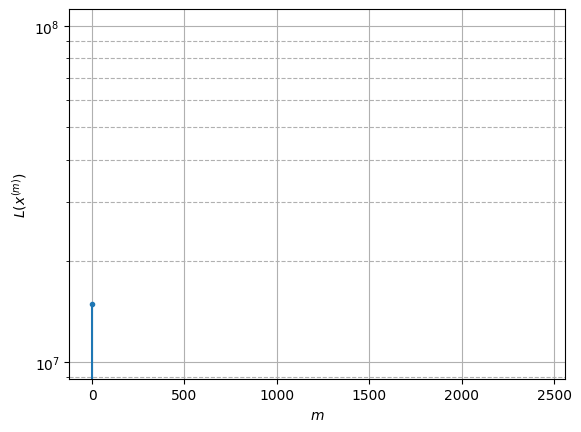

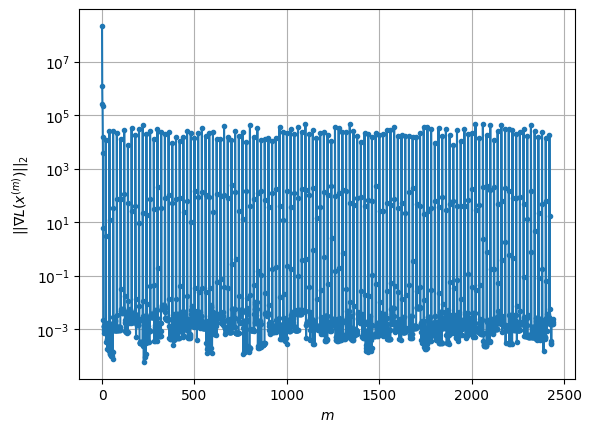

Windows:  32%|███▏      | 122/376 [14:22<29:05,  6.87s/it]

Before applying the algorithm
Cost function: -3151323.330554652
Gradient norm: 27334.861741654207
Global relative error: 5.546564908779577
Position relative errors: 0.06061277523393279 m, 4.4390428241261 m, 2.9560318051824157 m, 1.5222148154156663 m

Iteration 1
Cost function: -3151326.5911876154 (-0.00%)
Gradient norm: 50.02770272041981 (-99.82%)
Global relative error: 17.20265029347346 (210.15%)
Position relative errors: 0.08512575074785805 m, 6.898784051076357 m, 7.41949184818006 m, 13.90253936202869 m

Iteration 2
Cost function: -3151326.592188617 (-0.00%)
Gradient norm: 0.1202013169464249 (-99.76%)
Global relative error: 16.45261896185394 (-4.36%)
Position relative errors: 0.08512575509116896 m, 6.876927771360365 m, 7.219820792886699 m, 13.086722362285899 m

Iteration 3
Cost function: -3151326.592188589 (0.00%)
Gradient norm: 0.002085316465882825 (-98.27%)
Global relative error: 16.45200095403715 (-0.00%)
Position relative errors: 0.0851257545913367 m, 6.876934069124273 m, 7.21962

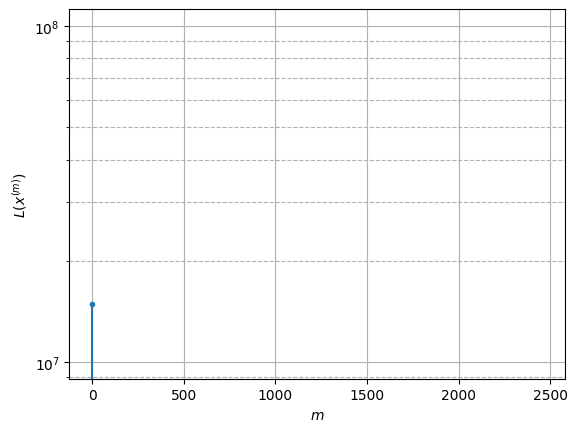

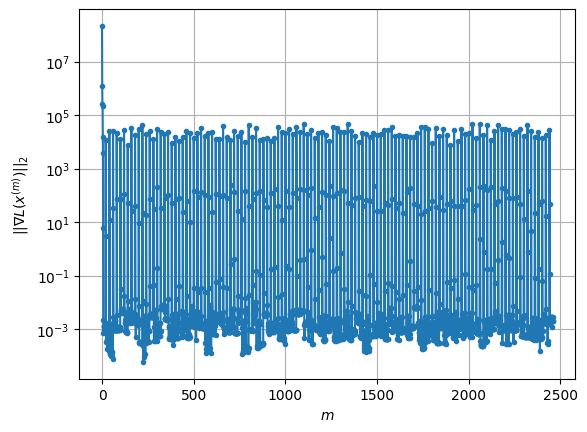

Windows:  33%|███▎      | 123/376 [14:29<28:58,  6.87s/it]

Before applying the algorithm
Cost function: -3151320.6228144797
Gradient norm: 37514.2070716786
Global relative error: 14.597399012793709
Position relative errors: 0.0821954371394934 m, 6.621903620601362 m, 6.6503331154999055 m, 11.180320124811715 m

Iteration 1
Cost function: -3151323.683461029 (-0.00%)
Gradient norm: 197.01365127976877 (-99.47%)
Global relative error: 8.43900325235519 (-42.19%)
Position relative errors: 0.07721488129092802 m, 4.460071248591995 m, 6.737655522945031 m, 2.433614972196133 m

Iteration 2
Cost function: -3151323.683949151 (-0.00%)
Gradient norm: 0.006658495046222609 (-100.00%)
Global relative error: 8.439317579040642 (0.00%)
Position relative errors: 0.0772148810692248 m, 4.421005804429438 m, 6.762269080512541 m, 2.437713893936328 m

Iteration 3
Cost function: -3151323.68394915 (0.00%)
Gradient norm: 0.0010483636447863552 (-84.26%)
Global relative error: 8.439317238912393 (-0.00%)
Position relative errors: 0.07721488108962059 m, 4.420999958941418 m, 6.762

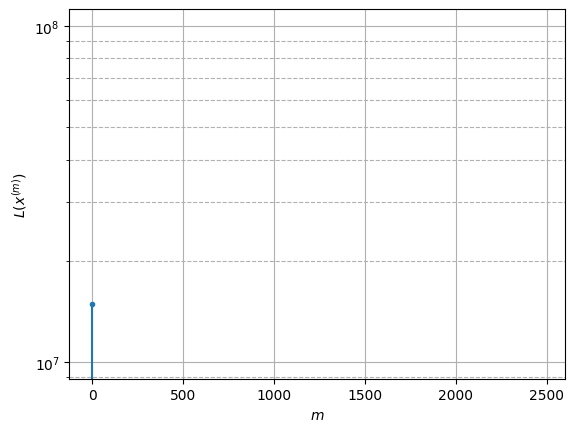

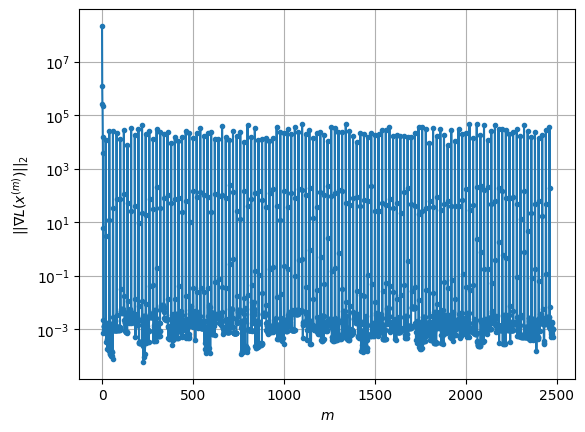

Windows:  33%|███▎      | 124/376 [14:36<28:39,  6.82s/it]

Before applying the algorithm
Cost function: -3151324.9897810137
Gradient norm: 7515.777817666103
Global relative error: 7.978399488598862
Position relative errors: 0.07624252883427261 m, 4.303678928114242 m, 6.34445818725644 m, 2.207976267655526 m

Iteration 1
Cost function: -3151326.956265024 (-0.00%)
Gradient norm: 131.90110326692647 (-98.25%)
Global relative error: 4.495794610739081 (-43.65%)
Position relative errors: 0.10879467819950753 m, 2.349010993315318 m, 3.300017521743634 m, 1.9473156082392948 m

Iteration 2
Cost function: -3151326.9573340155 (-0.00%)
Gradient norm: 0.5837872588196126 (-99.56%)
Global relative error: 4.62615862954818 (2.90%)
Position relative errors: 0.10879467897847597 m, 2.3928107233896885 m, 3.3348632772036213 m, 2.131260558899325 m

Iteration 3
Cost function: -3151326.9573340365 (-0.00%)
Gradient norm: 0.0018856771711103792 (-99.68%)
Global relative error: 4.626477863815667 (0.01%)
Position relative errors: 0.10879467886313965 m, 2.3928399053476803 m, 3.

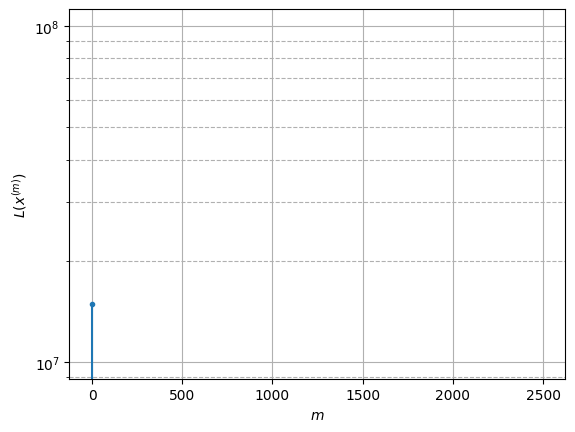

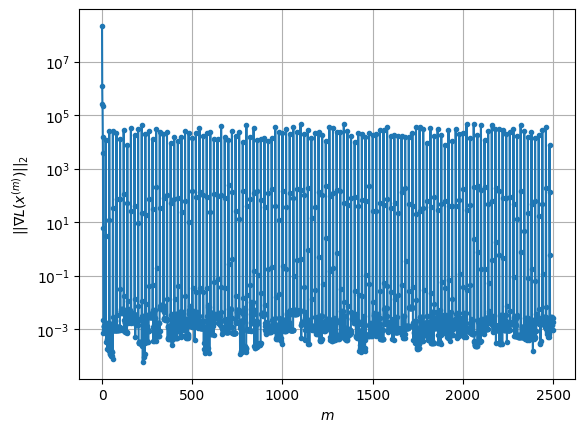

Windows:  33%|███▎      | 125/376 [14:43<28:38,  6.85s/it]

Before applying the algorithm
Cost function: -3151326.560729181
Gradient norm: 20569.355203292078
Global relative error: 4.951471683757851
Position relative errors: 0.10465700497030248 m, 2.486819954857094 m, 3.5528244104002904 m, 2.387239219503092 m

Iteration 1
Cost function: -3151328.4425477055 (-0.00%)
Gradient norm: 18.156057884954706 (-99.91%)
Global relative error: 12.507168220155044 (152.59%)
Position relative errors: 0.07463232413921547 m, 4.162332492790665 m, 3.6439509992371324 m, 11.21695291334392 m

Iteration 2
Cost function: -3151328.4426559387 (-0.00%)
Gradient norm: 0.016539787557282158 (-99.91%)
Global relative error: 12.71050974920669 (1.63%)
Position relative errors: 0.07463232392426301 m, 4.179278896756538 m, 3.6795340938693024 m, 11.4256679376162 m

Iteration 3
Cost function: -3151328.442655936 (0.00%)
Gradient norm: 0.0010503116866354121 (-93.65%)
Global relative error: 12.710700992357838 (0.00%)
Position relative errors: 0.07463232392426301 m, 4.179279416750253 m,

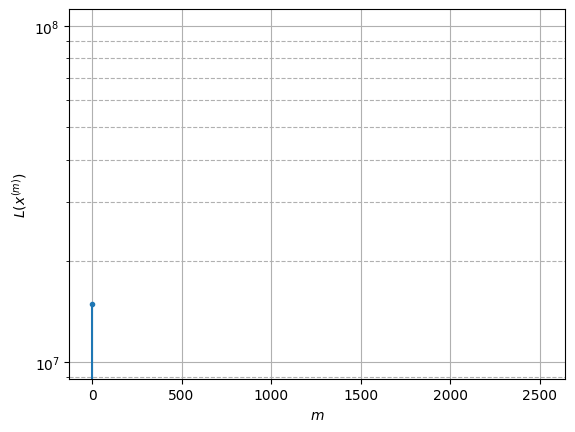

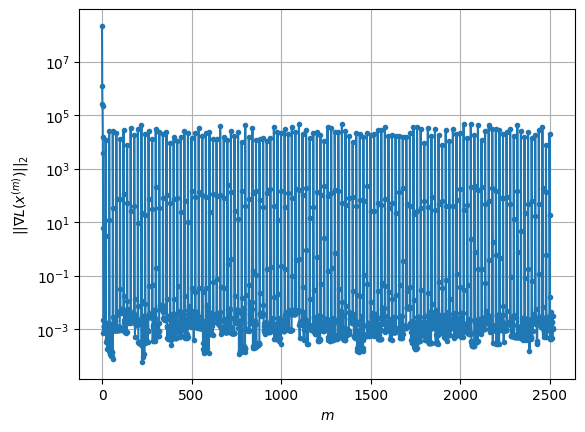

Windows:  34%|███▎      | 126/376 [14:49<28:29,  6.84s/it]

Before applying the algorithm
Cost function: -3151335.2731118933
Gradient norm: 13790.852606038217
Global relative error: 13.42480855989514
Position relative errors: 0.07174274378847685 m, 4.171174150386239 m, 4.053127517649977 m, 12.09932100264668 m

Iteration 1
Cost function: -3151339.094643742 (-0.00%)
Gradient norm: 234.06029375124737 (-98.30%)
Global relative error: 24.60842399286786 (83.31%)
Position relative errors: 0.08700993467627759 m, 5.985097889247879 m, 9.70782437317772 m, 21.805990738356037 m

Iteration 2
Cost function: -3151339.102199768 (-0.00%)
Gradient norm: 1.7768188168914687 (-99.24%)
Global relative error: 24.242423707691454 (-1.49%)
Position relative errors: 0.08700993391567236 m, 5.906614219310355 m, 9.889951397053995 m, 21.330392757323 m

Iteration 3
Cost function: -3151339.1021998404 (-0.00%)
Gradient norm: 0.0018971020677606954 (-99.89%)
Global relative error: 24.23813206980485 (-0.02%)
Position relative errors: 0.08700993414288699 m, 5.906557040246638 m, 9.88

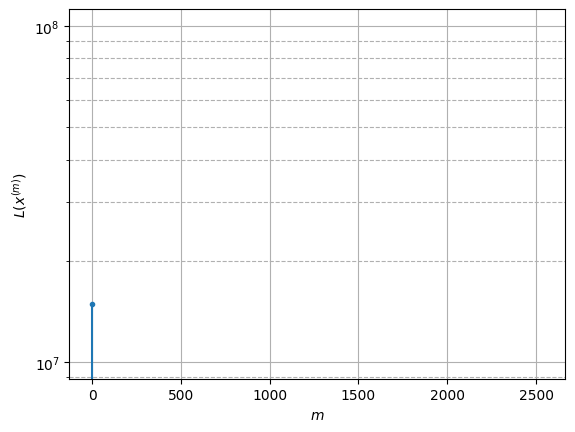

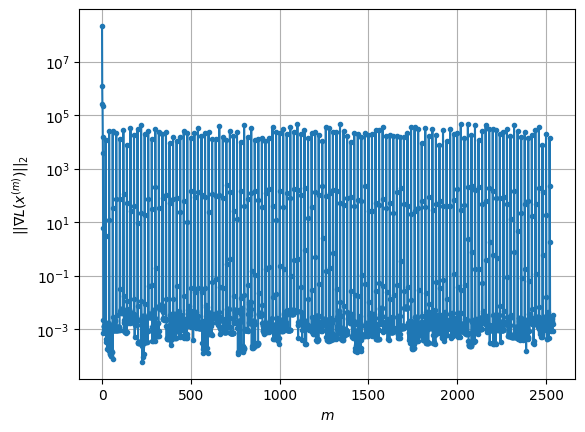

Windows:  34%|███▍      | 127/376 [14:56<28:24,  6.84s/it]

Before applying the algorithm
Cost function: -3151337.98757001
Gradient norm: 17797.882640951622
Global relative error: 21.30031085622115
Position relative errors: 0.08226533240812177 m, 5.561939165086786 m, 9.104075470832322 m, 18.43568173345609 m

Iteration 1
Cost function: -3151341.6107695615 (-0.00%)
Gradient norm: 63.83974169269591 (-99.64%)
Global relative error: 30.260567738326092 (42.07%)
Position relative errors: 0.11750033947967804 m, 3.4518961557114474 m, 7.398517124281046 m, 29.138141773815743 m

Iteration 2
Cost function: -3151341.612603628 (-0.00%)
Gradient norm: 0.6203339818871185 (-99.03%)
Global relative error: 31.770963659262712 (4.99%)
Position relative errors: 0.11750034569287707 m, 3.5012467885581526 m, 7.577792168692832 m, 30.65444869554383 m

Iteration 3
Cost function: -3151341.6126036732 (-0.00%)
Gradient norm: 0.0033817510773486584 (-99.45%)
Global relative error: 31.77422935912906 (0.01%)
Position relative errors: 0.11750034569287707 m, 3.501292159491316 m, 7.

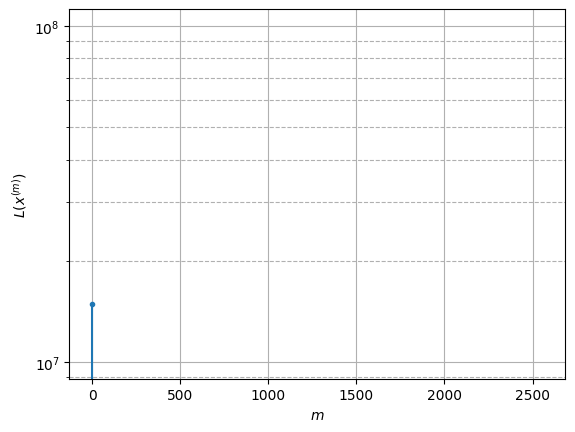

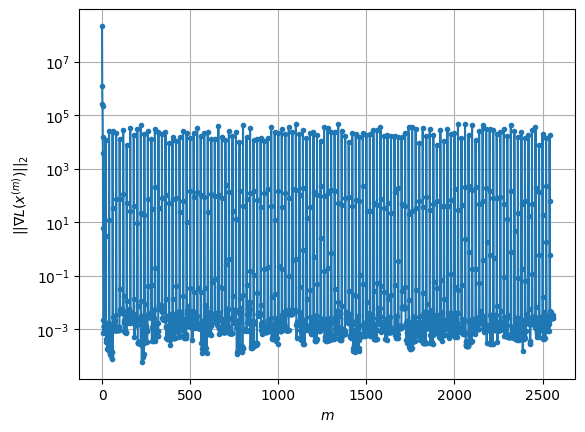

Windows:  34%|███▍      | 128/376 [15:03<28:17,  6.84s/it]

Before applying the algorithm
Cost function: -3151345.1312339115
Gradient norm: 11311.808205464233
Global relative error: 28.290824216964097
Position relative errors: 0.1086151904687456 m, 3.4195393325282564 m, 6.8011231104014955 m, 27.24714289570337 m

Iteration 1
Cost function: -3151346.6766264224 (-0.00%)
Gradient norm: 171.7547414842837 (-98.48%)
Global relative error: 13.092022883943956 (-53.72%)
Position relative errors: 0.09291087146567781 m, 5.13959864030119 m, 1.691928866713708 m, 11.921135362795662 m

Iteration 2
Cost function: -3151346.678216474 (-0.00%)
Gradient norm: 0.5288956736355563 (-99.69%)
Global relative error: 12.046548993988281 (-7.99%)
Position relative errors: 0.09291087156575759 m, 5.101018475204753 m, 1.7901445767356445 m, 10.764986594879707 m

Iteration 3
Cost function: -3151346.6782164746 (-0.00%)
Gradient norm: 0.002265026090522369 (-99.57%)
Global relative error: 12.043467106979367 (-0.03%)
Position relative errors: 0.09291087151551038 m, 5.10098242058814 

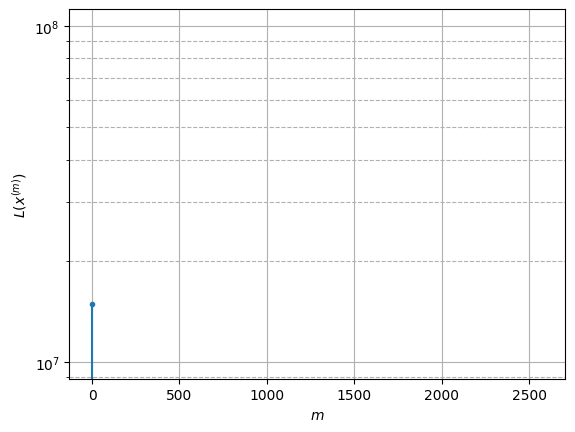

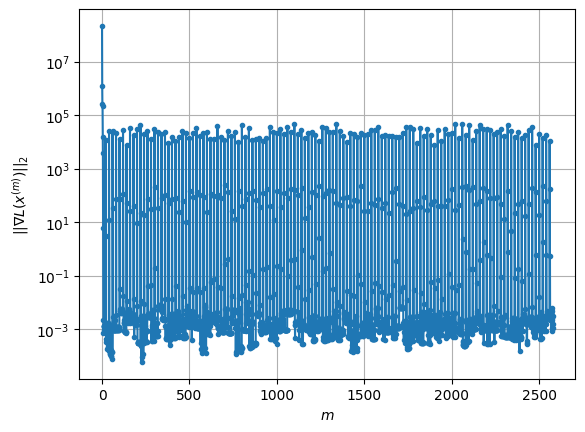

Windows:  34%|███▍      | 129/376 [15:10<28:10,  6.84s/it]

Before applying the algorithm
Cost function: -3151342.8447812917
Gradient norm: 27430.866369099676
Global relative error: 10.705564605073052
Position relative errors: 0.08634796646639036 m, 4.88383646261016 m, 2.197411597988299 m, 9.269325943740977 m

Iteration 1
Cost function: -3151346.246698607 (-0.00%)
Gradient norm: 55.626131216232885 (-99.80%)
Global relative error: 12.752644232317007 (19.12%)
Position relative errors: 0.06685890782875567 m, 10.074049841161598 m, 4.397349253832698 m, 6.465438130714149 m

Iteration 2
Cost function: -3151346.2474566796 (-0.00%)
Gradient norm: 0.11724206629972456 (-99.79%)
Global relative error: 12.967930760028127 (1.69%)
Position relative errors: 0.06685890771497503 m, 10.22639735555151 m, 4.425535488147449 m, 6.633080190785427 m

Iteration 3
Cost function: -3151346.2474566726 (0.00%)
Gradient norm: 0.0023457311469135245 (-98.00%)
Global relative error: 12.968004316725699 (0.00%)
Position relative errors: 0.06685890784002523 m, 10.226458502852426 m,

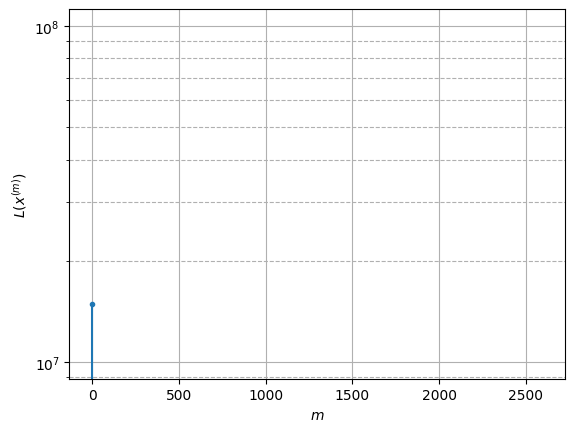

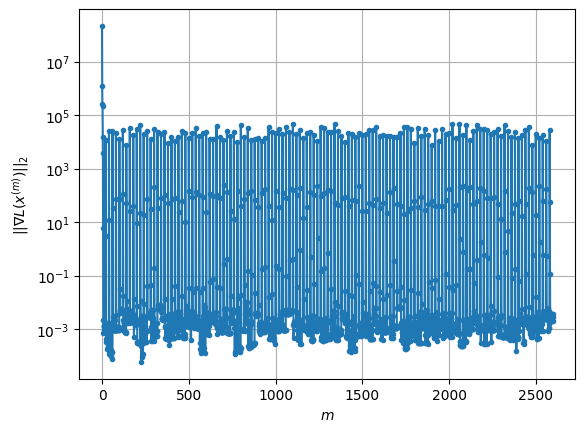

Windows:  35%|███▍      | 130/376 [15:17<28:20,  6.91s/it]

Before applying the algorithm
Cost function: -3151345.6398186292
Gradient norm: 15031.625520987725
Global relative error: 11.879952453821144
Position relative errors: 0.061330937112095196 m, 9.41304074154653 m, 4.407382786954655 m, 5.753146761237553 m

Iteration 1
Cost function: -3151351.164858495 (-0.00%)
Gradient norm: 165.37663322371623 (-98.90%)
Global relative error: 25.910723529256135 (118.10%)
Position relative errors: 0.06089865405301082 m, 6.865820628846682 m, 10.616431527516735 m, 22.616655882654584 m

Iteration 2
Cost function: -3151351.1808210127 (-0.00%)
Gradient norm: 10.199741074815664 (-93.83%)
Global relative error: 22.387963610738293 (-13.60%)
Position relative errors: 0.060898659144203615 m, 6.91903581006111 m, 9.869267395273587 m, 18.866406959044387 m

Iteration 3
Cost function: -3151351.18082315 (-0.00%)
Gradient norm: 0.0012823959533485188 (-99.99%)
Global relative error: 22.36332340145409 (-0.11%)
Position relative errors: 0.06089865855740143 m, 6.919360398068592

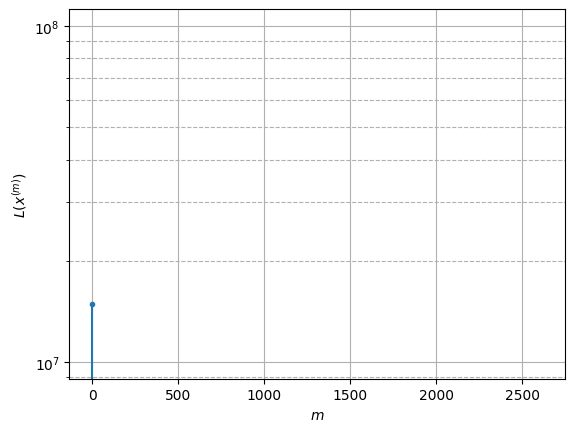

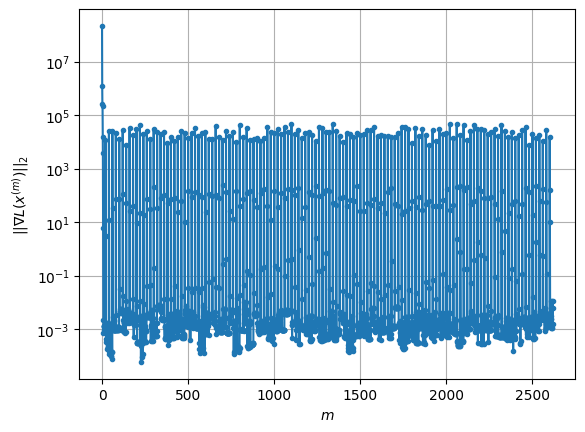

Windows:  35%|███▍      | 131/376 [15:24<28:14,  6.92s/it]

Before applying the algorithm
Cost function: -3151352.9616776486
Gradient norm: 34290.21667869316
Global relative error: 21.271466971035196
Position relative errors: 0.055372103326420126 m, 6.276777051965126 m, 9.365700482486153 m, 18.03767000620013 m

Iteration 1
Cost function: -3151357.4926926796 (-0.00%)
Gradient norm: 462.34005372830006 (-98.65%)
Global relative error: 19.623273061931197 (-7.75%)
Position relative errors: 0.08234160026244743 m, 6.031812993969226 m, 7.810644752633004 m, 16.960997587224373 m

Iteration 2
Cost function: -3151357.4986671205 (-0.00%)
Gradient norm: 2.35687758265069 (-99.49%)
Global relative error: 19.362332047373496 (-1.33%)
Position relative errors: 0.08234159977205861 m, 6.065175009236449 m, 7.909969948731037 m, 16.599326063177514 m

Iteration 3
Cost function: -3151357.4986674064 (-0.00%)
Gradient norm: 0.00047657042447351114 (-99.98%)
Global relative error: 19.35785016433104 (-0.02%)
Position relative errors: 0.08234160032690814 m, 6.06515955069912 m

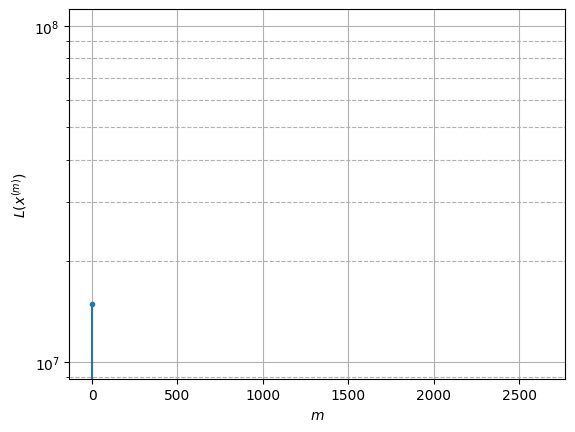

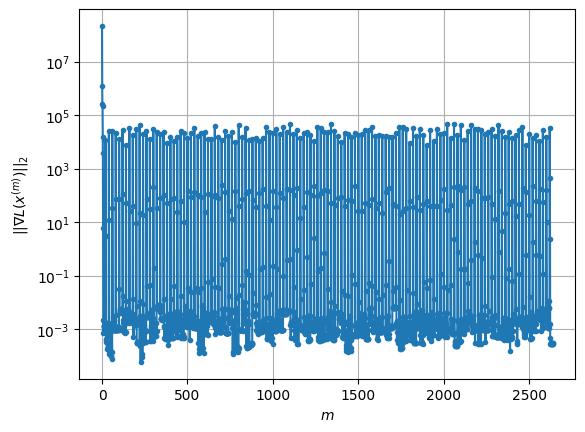

Windows:  35%|███▌      | 132/376 [15:31<28:01,  6.89s/it]

Before applying the algorithm
Cost function: -3151355.269126081
Gradient norm: 15899.168685465485
Global relative error: 17.456483664586596
Position relative errors: 0.07685667248911698 m, 5.58734066010959 m, 7.2985159793784335 m, 14.840308877606665 m

Iteration 1
Cost function: -3151356.7122002007 (-0.00%)
Gradient norm: 162.05520923147725 (-98.98%)
Global relative error: 22.146652885056906 (26.87%)
Position relative errors: 0.09396182741488476 m, 6.409437314279997 m, 11.322736246261092 m, 17.92148586451461 m

Iteration 2
Cost function: -3151356.7131049703 (-0.00%)
Gradient norm: 0.1980497914032194 (-99.88%)
Global relative error: 22.551049461591255 (1.83%)
Position relative errors: 0.09396182775002798 m, 6.453848216687573 m, 11.471060191425504 m, 18.311284011292795 m

Iteration 3
Cost function: -3151356.7131049996 (-0.00%)
Gradient norm: 0.0022541010550018834 (-98.86%)
Global relative error: 22.551883622693968 (0.00%)
Position relative errors: 0.09396182775002798 m, 6.453828637400972

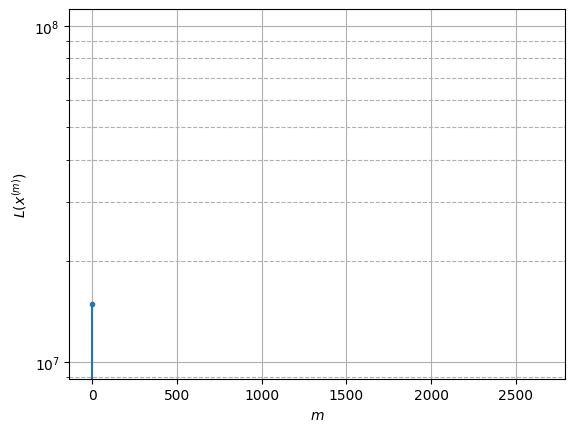

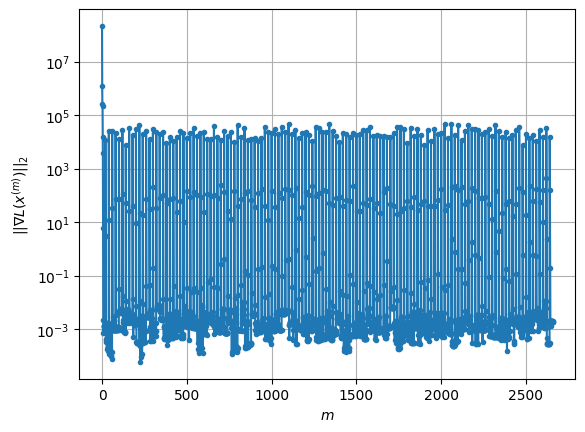

Windows:  35%|███▌      | 133/376 [15:38<27:47,  6.86s/it]

Before applying the algorithm
Cost function: -3151358.673531264
Gradient norm: 22393.592326443668
Global relative error: 21.554729689847598
Position relative errors: 0.08710382364885151 m, 6.119077022853409 m, 10.768191689623793 m, 17.640897929469194 m

Iteration 1
Cost function: -3151361.193183743 (-0.00%)
Gradient norm: 160.33732014943843 (-99.28%)
Global relative error: 15.48492308946995 (-28.16%)
Position relative errors: 0.10051840888180479 m, 1.7898764876085431 m, 5.6373276611161485 m, 14.310422689250638 m

Iteration 2
Cost function: -3151361.1946807234 (-0.00%)
Gradient norm: 0.2641604111786466 (-99.84%)
Global relative error: 15.728889570064172 (1.58%)
Position relative errors: 0.10051840783221754 m, 1.7678946398738833 m, 5.634799176726502 m, 14.577721832076671 m

Iteration 3
Cost function: -3151361.1946807317 (-0.00%)
Gradient norm: 0.0012836702762856248 (-99.51%)
Global relative error: 15.729551837492327 (0.00%)
Position relative errors: 0.10051840783221754 m, 1.7678969771099

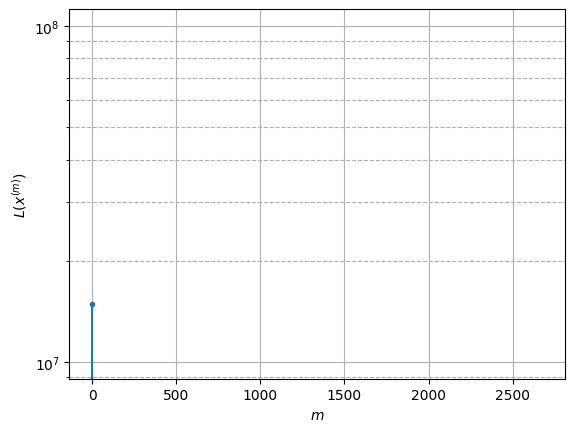

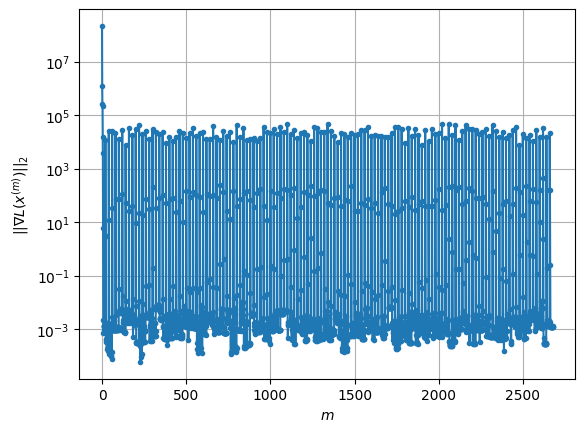

Windows:  36%|███▌      | 134/376 [15:44<27:42,  6.87s/it]

Before applying the algorithm
Cost function: -3151357.629674794
Gradient norm: 32013.432852664668
Global relative error: 13.918814498278637
Position relative errors: 0.09296917184872476 m, 1.5878231353201646 m, 5.115164883887991 m, 12.846681803357942 m

Iteration 1
Cost function: -3151363.0105552 (-0.00%)
Gradient norm: 77.34511002441604 (-99.76%)
Global relative error: 29.428179118621053 (111.43%)
Position relative errors: 0.07440568320868449 m, 1.8478494715043314 m, 4.832110851911012 m, 28.969743860731132 m

Iteration 2
Cost function: -3151363.0118816113 (-0.00%)
Gradient norm: 0.15748577325467872 (-99.80%)
Global relative error: 30.24652779433395 (2.78%)
Position relative errors: 0.07440568265089324 m, 1.8750456069063524 m, 4.850954436525502 m, 29.79592196028045 m

Iteration 3
Cost function: -3151363.011881624 (-0.00%)
Gradient norm: 0.0005085107655674987 (-99.68%)
Global relative error: 30.24840106824319 (0.01%)
Position relative errors: 0.07440568283442109 m, 1.8749667338013756 m,

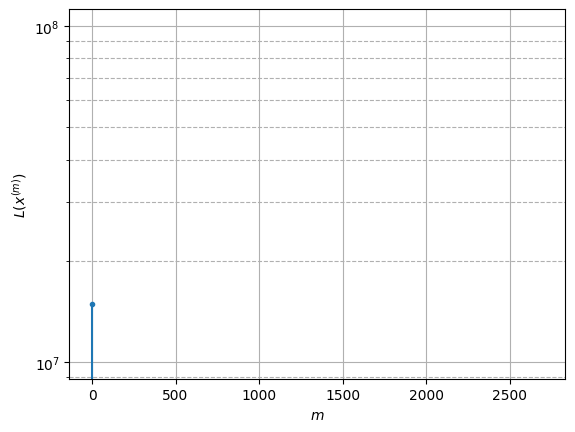

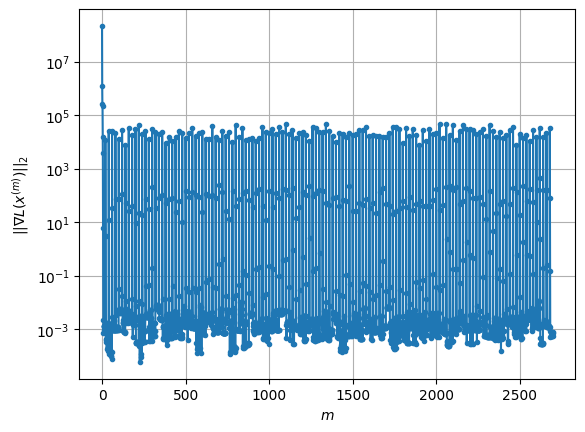

Windows:  36%|███▌      | 135/376 [15:51<27:42,  6.90s/it]

Before applying the algorithm
Cost function: -3151358.715871272
Gradient norm: 12126.636393020624
Global relative error: 27.48443910795424
Position relative errors: 0.0697015162856389 m, 1.2592690481094642 m, 4.805137085835372 m, 27.031685583629184 m

Iteration 1
Cost function: -3151361.8792966553 (-0.00%)
Gradient norm: 58.49090126205009 (-99.52%)
Global relative error: 45.2177605700592 (64.52%)
Position relative errors: 0.0724190268362604 m, 4.657962518634245 m, 5.444570931768975 m, 44.64635463130417 m

Iteration 2
Cost function: -3151361.8801566893 (-0.00%)
Gradient norm: 0.17341448896107978 (-99.70%)
Global relative error: 44.67821415162336 (-1.19%)
Position relative errors: 0.07241903101910097 m, 4.696476591398797 m, 5.3077762740665735 m, 44.11240752481451 m

Iteration 3
Cost function: -3151361.880156671 (0.00%)
Gradient norm: 0.0007896928286493366 (-99.54%)
Global relative error: 44.676752937794845 (-0.00%)
Position relative errors: 0.07241903105336485 m, 4.696510427645127 m, 5.3

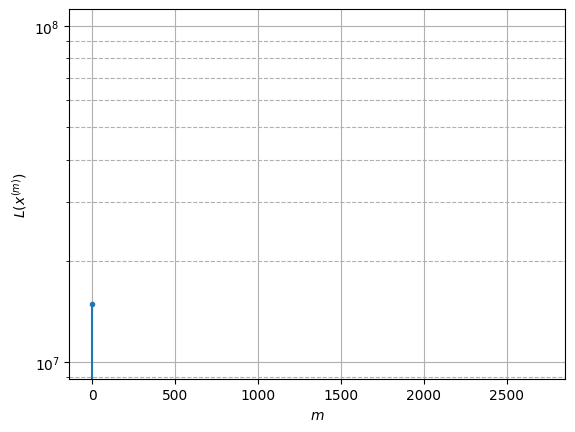

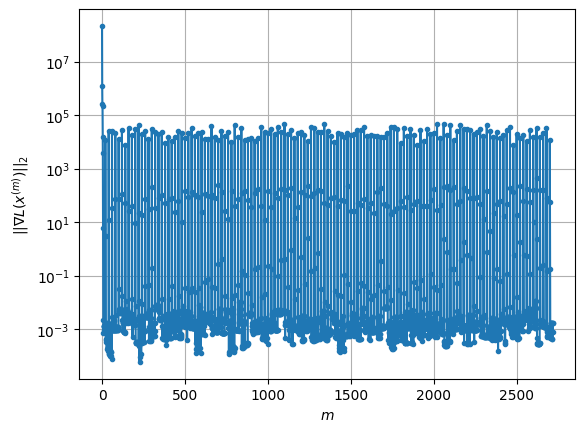

Windows:  36%|███▌      | 136/376 [15:58<27:24,  6.85s/it]

Before applying the algorithm
Cost function: -3151367.011887553
Gradient norm: 16505.048109308857
Global relative error: 41.24173122174971
Position relative errors: 0.06746895396041316 m, 3.7000266603361824 m, 5.901635432459854 m, 40.649137665288585 m

Iteration 1
Cost function: -3151369.98404122 (-0.00%)
Gradient norm: 123.24855264649166 (-99.25%)
Global relative error: 28.99374643838413 (-29.70%)
Position relative errors: 0.03316956669502334 m, 3.6315924052437563 m, 3.110888916043792 m, 28.59665427372964 m

Iteration 2
Cost function: -3151369.984848753 (-0.00%)
Gradient norm: 0.3286937934371136 (-99.73%)
Global relative error: 29.03260670022398 (0.13%)
Position relative errors: 0.033169567079394315 m, 3.6152179795024106 m, 3.0696069520208398 m, 28.642578328854285 m

Iteration 3
Cost function: -3151369.984848762 (-0.00%)
Gradient norm: 0.00044481229845354947 (-99.86%)
Global relative error: 29.032822432771667 (0.00%)
Position relative errors: 0.03316956700530427 m, 3.6152167421981907 

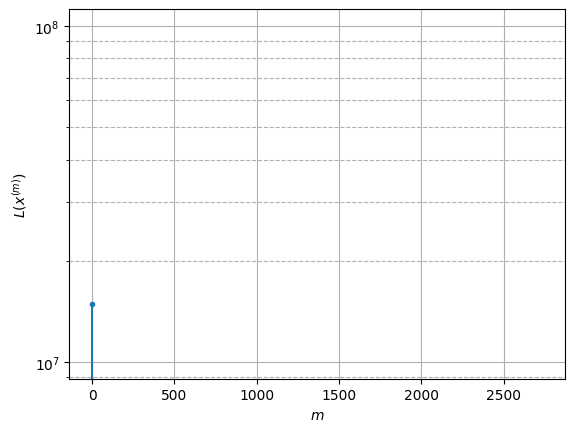

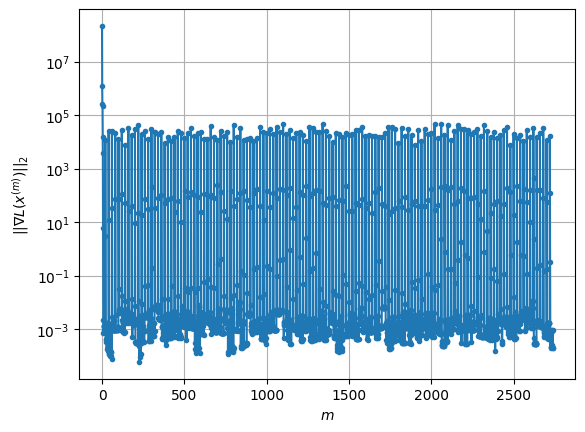

Windows:  36%|███▋      | 137/376 [16:05<27:19,  6.86s/it]

Before applying the algorithm
Cost function: -3151365.894273767
Gradient norm: 18446.333081837434
Global relative error: 26.900575628356002
Position relative errors: 0.029362800861302833 m, 3.7689644333585015 m, 3.6078011640942393 m, 26.38971684955196 m

Iteration 1
Cost function: -3151372.299776751 (-0.00%)
Gradient norm: 199.68512061167658 (-98.92%)
Global relative error: 24.593466355017906 (-8.58%)
Position relative errors: 0.016157568761037015 m, 4.575802586706301 m, 5.135410206718941 m, 23.611990258900292 m

Iteration 2
Cost function: -3151372.3023810997 (-0.00%)
Gradient norm: 0.22393322699759857 (-99.89%)
Global relative error: 24.768331300948116 (0.71%)
Position relative errors: 0.01615756934910751 m, 4.550560840063812 m, 5.022787125501836 m, 23.8229341503456 m

Iteration 3
Cost function: -3151372.3023811025 (-0.00%)
Gradient norm: 0.0011034789222587416 (-99.51%)
Global relative error: 24.768752447567948 (0.00%)
Position relative errors: 0.01615756934910751 m, 4.550515657704188

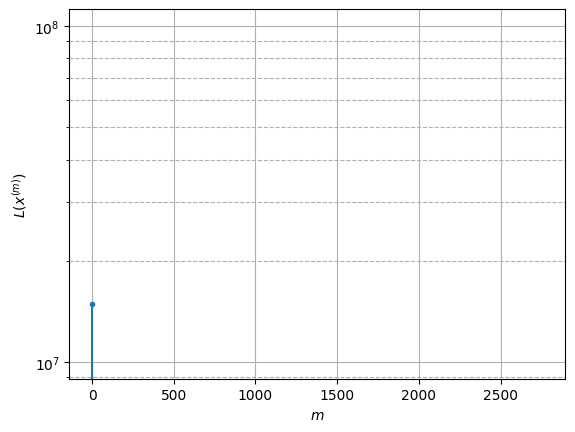

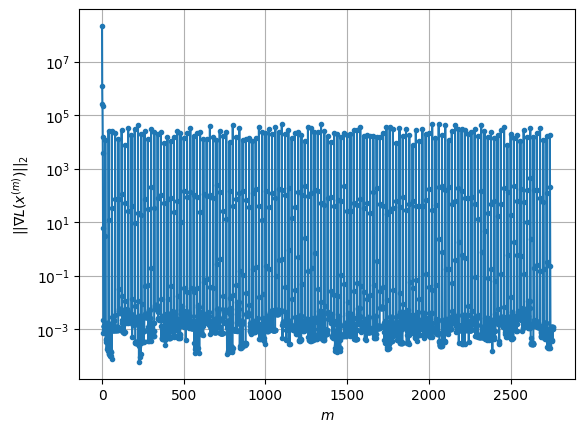

Windows:  37%|███▋      | 138/376 [16:12<27:12,  6.86s/it]

Before applying the algorithm
Cost function: -3151375.3626417005
Gradient norm: 19199.85478858482
Global relative error: 22.34426895234352
Position relative errors: 0.011866075576635188 m, 4.151547925261638 m, 4.603813638614709 m, 21.467041812082844 m

Iteration 1
Cost function: -3151377.254260152 (-0.00%)
Gradient norm: 67.40039990979737 (-99.65%)
Global relative error: 7.705496156065745 (-65.51%)
Position relative errors: 0.03358854088774727 m, 4.846845370610288 m, 5.596071738136024 m, 2.1364492310192325 m

Iteration 2
Cost function: -3151377.255040786 (-0.00%)
Gradient norm: 0.01785275204716222 (-99.97%)
Global relative error: 7.656590434854596 (-0.63%)
Position relative errors: 0.03358854277951556 m, 4.8571398083382205 m, 5.569670432886536 m, 2.0020057288414645 m

Iteration 3
Cost function: -3151377.2550407615 (0.00%)
Gradient norm: 0.0009735817075675307 (-94.55%)
Global relative error: 7.656409433126261 (-0.00%)
Position relative errors: 0.03358854276291732 m, 4.857136992698702 m,

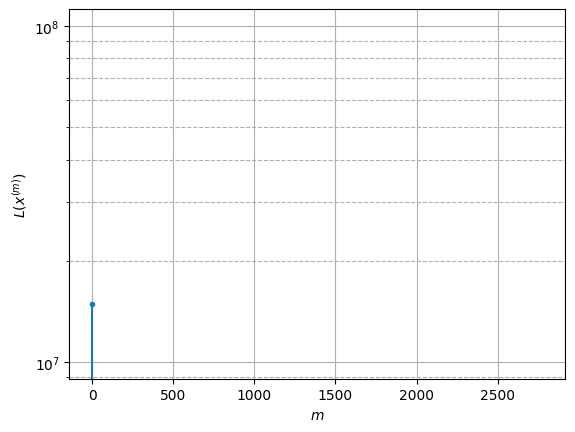

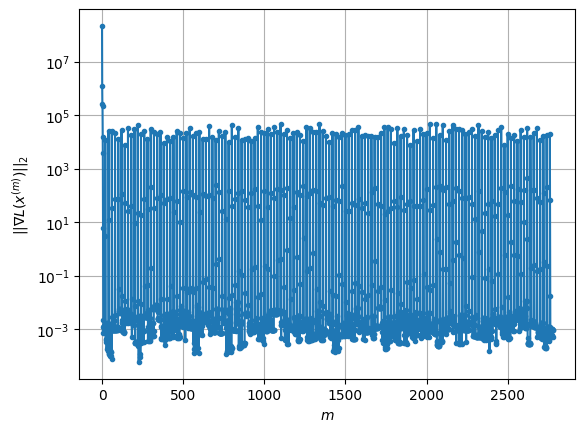

Windows:  37%|███▋      | 139/376 [16:19<27:21,  6.93s/it]

Before applying the algorithm
Cost function: -3151371.3508129693
Gradient norm: 37930.88783130601
Global relative error: 6.317551690201393
Position relative errors: 0.030261408126154528 m, 3.7807265021453635 m, 4.898949279907479 m, 1.2711223051822915 m

Iteration 1
Cost function: -3151373.8794852193 (-0.00%)
Gradient norm: 33.61702419880858 (-99.91%)
Global relative error: 17.34334892306316 (174.53%)
Position relative errors: 0.038921041383962546 m, 10.110476611230741 m, 4.976697420749523 m, 13.183316871075306 m

Iteration 2
Cost function: -3151373.880801299 (-0.00%)
Gradient norm: 0.22672331967445544 (-99.33%)
Global relative error: 16.54513870642899 (-4.60%)
Position relative errors: 0.03892104450603386 m, 10.089658862119688 m, 5.047758365566912 m, 12.101977301775234 m

Iteration 3
Cost function: -3151373.8808013285 (-0.00%)
Gradient norm: 0.005981146240966599 (-97.36%)
Global relative error: 16.54380885081265 (-0.01%)
Position relative errors: 0.038921044505358736 m, 10.089564621296

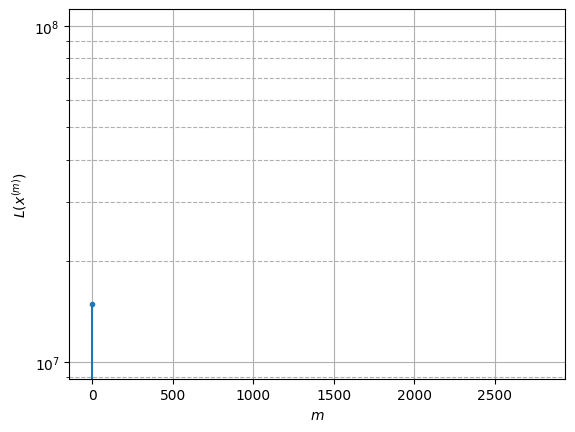

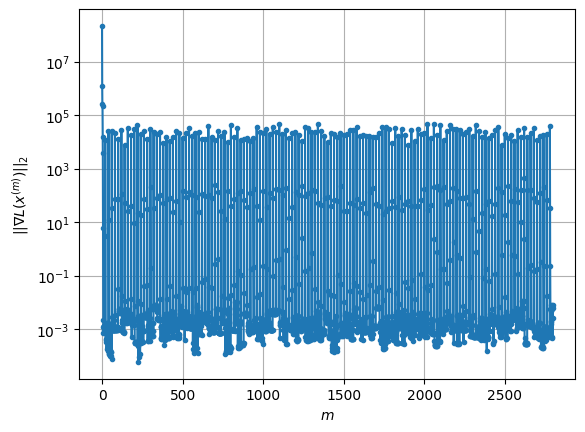

Windows:  37%|███▋      | 140/376 [16:26<27:11,  6.91s/it]

Before applying the algorithm
Cost function: -3151374.7637387905
Gradient norm: 17001.033421883432
Global relative error: 15.75199405983736
Position relative errors: 0.03565108002358291 m, 8.601389999071559 m, 4.506121519311953 m, 12.402977902360828 m

Iteration 1
Cost function: -3151377.193227585 (-0.00%)
Gradient norm: 61.09061072470314 (-99.64%)
Global relative error: 16.511072045915512 (4.82%)
Position relative errors: 0.06233849775737828 m, 4.772265272634794 m, 7.432102140949644 m, 13.949907861446086 m

Iteration 2
Cost function: -3151377.1935722204 (-0.00%)
Gradient norm: 0.03128191555716119 (-99.95%)
Global relative error: 16.665661616665016 (0.94%)
Position relative errors: 0.06233850071141682 m, 4.876690750601407 m, 7.3936928220268205 m, 14.117030611802225 m

Iteration 3
Cost function: -3151377.19357224 (-0.00%)
Gradient norm: 0.0012762815483756903 (-95.92%)
Global relative error: 16.665792957076484 (0.00%)
Position relative errors: 0.062338500734695206 m, 4.876729829170385 m,

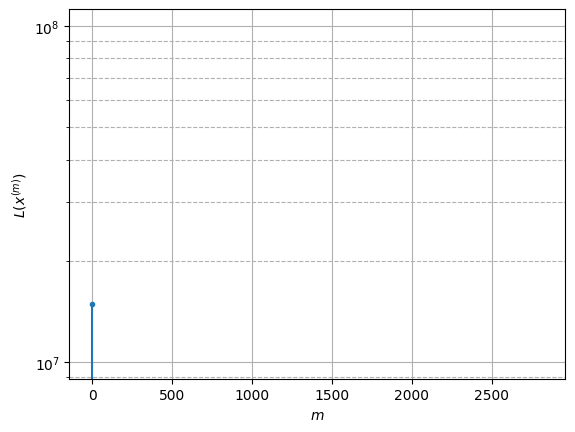

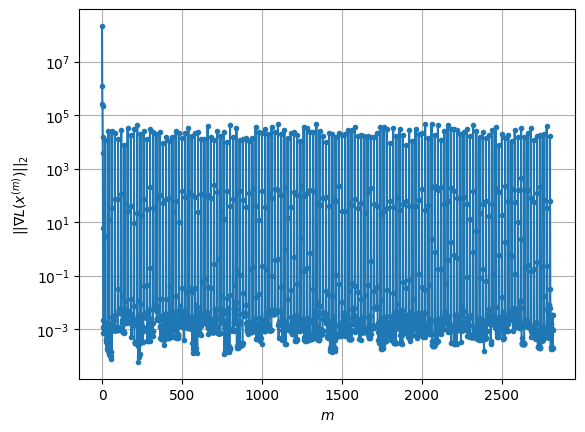

Windows:  38%|███▊      | 141/376 [16:33<27:10,  6.94s/it]

Before applying the algorithm
Cost function: -3151372.374135973
Gradient norm: 11541.001291045948
Global relative error: 15.341331849184558
Position relative errors: 0.05976531701627651 m, 3.955313299408513 m, 6.426960186094477 m, 13.356705902047828 m

Iteration 1
Cost function: -3151374.673054007 (-0.00%)
Gradient norm: 251.43087183297894 (-97.82%)
Global relative error: 34.03471436368881 (121.85%)
Position relative errors: 0.06627885706741034 m, 3.5013831889199665 m, 4.190973143050212 m, 33.59362237745233 m

Iteration 2
Cost function: -3151374.6825488713 (-0.00%)
Gradient norm: 4.788798328125262 (-98.10%)
Global relative error: 31.227382739151953 (-8.25%)
Position relative errors: 0.06627885435235475 m, 3.331729143700435 m, 4.289193965351892 m, 30.751354183329767 m

Iteration 3
Cost function: -3151374.6825495786 (-0.00%)
Gradient norm: 0.0016209806013872383 (-99.97%)
Global relative error: 31.212111926480084 (-0.05%)
Position relative errors: 0.0662788542914662 m, 3.330608489961001 m

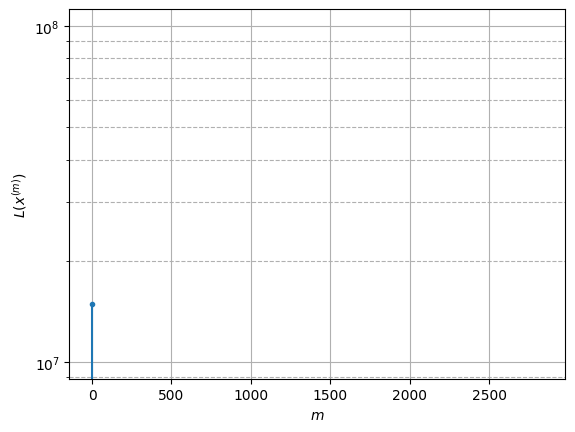

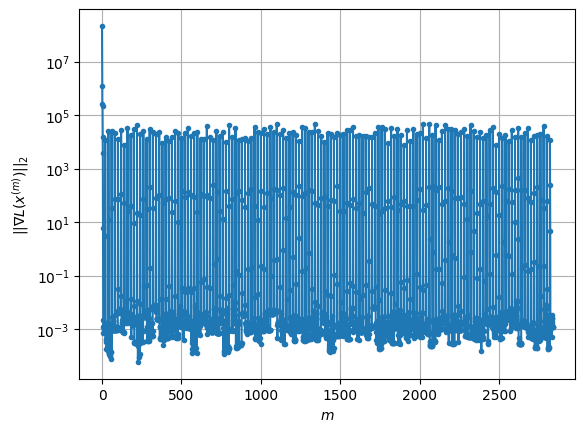

Windows:  38%|███▊      | 142/376 [16:40<27:00,  6.93s/it]

Before applying the algorithm
Cost function: -3151358.6971086874
Gradient norm: 42844.88915946533
Global relative error: 29.148804407519822
Position relative errors: 0.06203088621865347 m, 2.559443314148153 m, 3.3551281102711457 m, 28.841630911648796 m

Iteration 1
Cost function: -3151366.144593546 (-0.00%)
Gradient norm: 37.95398515316216 (-99.91%)
Global relative error: 24.95170304298747 (-14.40%)
Position relative errors: 0.08330809668341613 m, 0.9735855803682942 m, 8.270854245932126 m, 23.52071787326213 m

Iteration 2
Cost function: -3151366.145844902 (-0.00%)
Gradient norm: 0.3564501669906635 (-99.06%)
Global relative error: 25.482084148626743 (2.13%)
Position relative errors: 0.08330809818998212 m, 1.1368013408738717 m, 8.327727421643994 m, 24.055867611751683 m

Iteration 3
Cost function: -3151366.145844883 (0.00%)
Gradient norm: 0.0012537358741152938 (-99.65%)
Global relative error: 25.482352984841082 (0.00%)
Position relative errors: 0.08330809833206743 m, 1.1368177247806446 m,

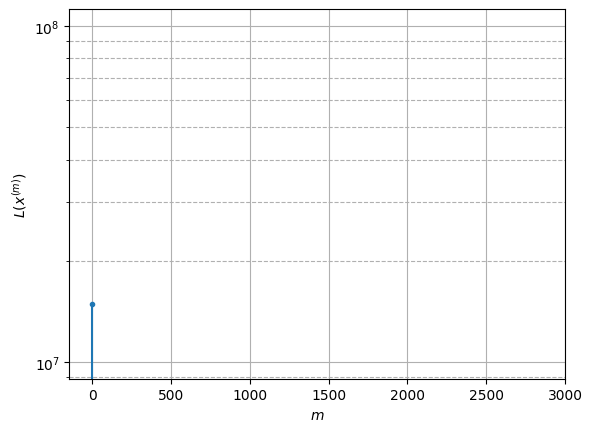

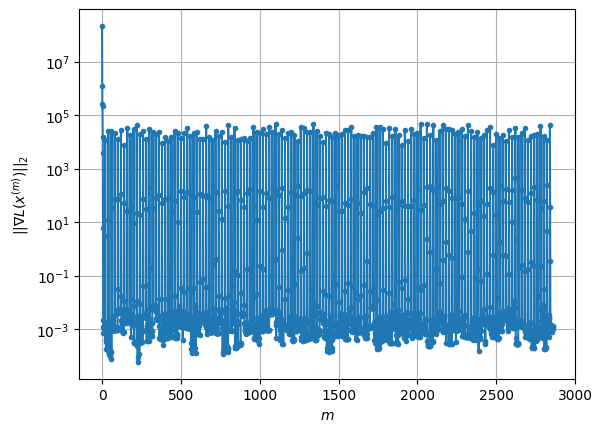

Windows:  38%|███▊      | 143/376 [16:47<27:18,  7.03s/it]

Before applying the algorithm
Cost function: -3151361.723487715
Gradient norm: 38524.92094964197
Global relative error: 23.362147289277154
Position relative errors: 0.07868242760003606 m, 1.3192132086080677 m, 6.9316583970354655 m, 22.270922244432338 m

Iteration 1
Cost function: -3151366.6045258627 (-0.00%)
Gradient norm: 36.059683951293266 (-99.91%)
Global relative error: 22.450994663245584 (-3.90%)
Position relative errors: 0.08231357956285464 m, 6.189201134962877 m, 9.913451054643376 m, 19.169153339034512 m

Iteration 2
Cost function: -3151366.6056631226 (-0.00%)
Gradient norm: 0.3088449343120587 (-99.14%)
Global relative error: 21.833376277416843 (-2.75%)
Position relative errors: 0.08231357876715995 m, 5.930355542949062 m, 9.898954534028595 m, 18.53456149110869 m

Iteration 3
Cost function: -3151366.6056631203 (0.00%)
Gradient norm: 0.0016815871347163214 (-99.46%)
Global relative error: 21.83308344756001 (-0.00%)
Position relative errors: 0.08231357914940954 m, 5.930234335813339 

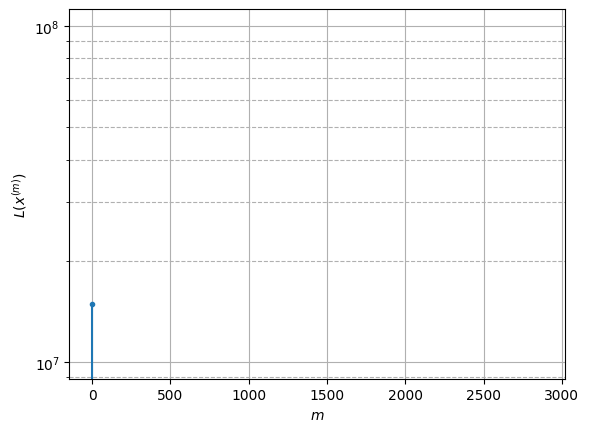

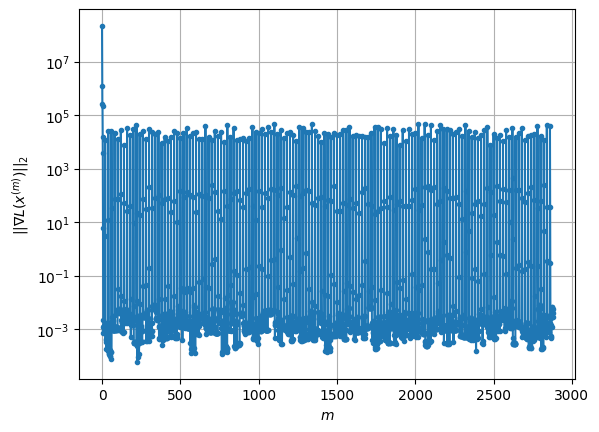

Windows:  38%|███▊      | 144/376 [16:55<28:15,  7.31s/it]

Before applying the algorithm
Cost function: -3151358.502180542
Gradient norm: 40649.39179672111
Global relative error: 19.978000558849573
Position relative errors: 0.07645907358296603 m, 5.843025188449387 m, 8.595954937711605 m, 17.06112914060088 m

Iteration 1
Cost function: -3151363.1714755315 (-0.00%)
Gradient norm: 247.68373934822213 (-99.39%)
Global relative error: 24.571918554503537 (22.99%)
Position relative errors: 0.0765329329399645 m, 5.178897094253276 m, 10.677398828924709 m, 21.516138044043956 m

Iteration 2
Cost function: -3151363.1818628865 (-0.00%)
Gradient norm: 5.617932624328204 (-97.73%)
Global relative error: 22.957296012417533 (-6.57%)
Position relative errors: 0.07653293148493749 m, 4.950863333592247 m, 10.65318196463042 m, 19.72382354945903 m

Iteration 3
Cost function: -3151363.1818635873 (-0.00%)
Gradient norm: 0.0008852973515186487 (-99.98%)
Global relative error: 22.942949961661927 (-0.06%)
Position relative errors: 0.07653293134538881 m, 4.949775302445101 m,

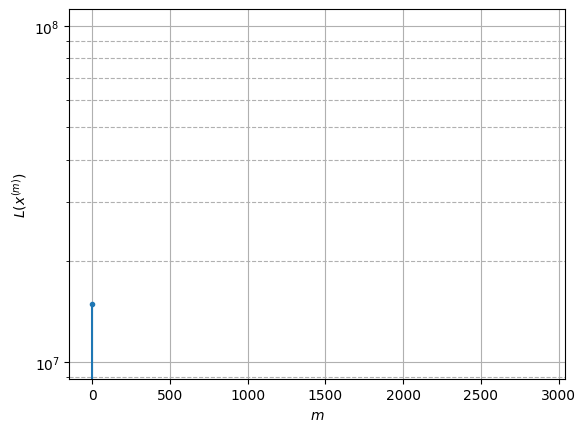

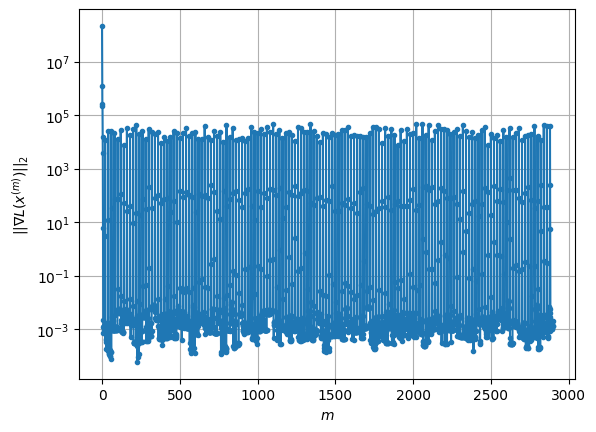

Windows:  39%|███▊      | 145/376 [17:03<28:34,  7.42s/it]

Before applying the algorithm
Cost function: -3151368.050836502
Gradient norm: 47568.48370322342
Global relative error: 21.246685853145472
Position relative errors: 0.07132464438866498 m, 4.538508535295113 m, 9.545062951792671 m, 18.431201218645526 m

Iteration 1
Cost function: -3151369.9279103917 (-0.00%)
Gradient norm: 158.1980163538921 (-99.67%)
Global relative error: 21.195601529527423 (-0.24%)
Position relative errors: 0.057821160334260394 m, 5.019337557259978 m, 8.354609560425606 m, 18.82170062520469 m

Iteration 2
Cost function: -3151369.928279807 (-0.00%)
Gradient norm: 0.05426702904927405 (-99.97%)
Global relative error: 21.301220706141578 (0.50%)
Position relative errors: 0.057821160581127115 m, 5.029874967338247 m, 8.35515692768062 m, 18.93752497848851 m

Iteration 3
Cost function: -3151369.928279783 (0.00%)
Gradient norm: 0.0005209181760235933 (-99.04%)
Global relative error: 21.301410818064955 (0.00%)
Position relative errors: 0.05782116094417255 m, 5.029901348305206 m, 8.

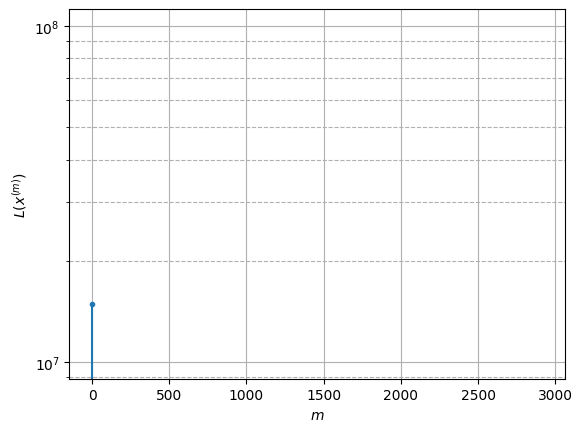

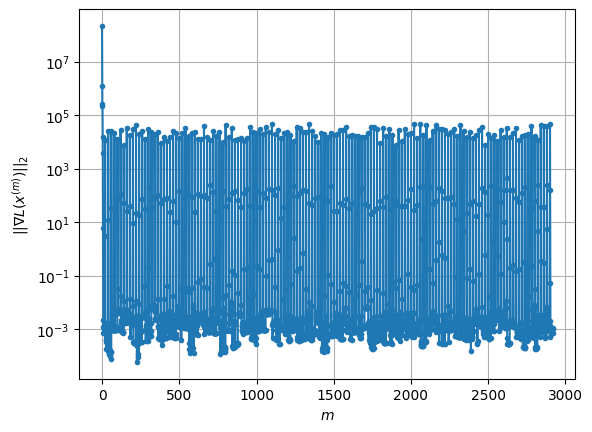

Windows:  39%|███▉      | 146/376 [17:10<28:38,  7.47s/it]

Before applying the algorithm
Cost function: -3151367.5969461002
Gradient norm: 14250.776534959077
Global relative error: 20.59124704769093
Position relative errors: 0.05493537519760516 m, 4.478600514553376 m, 7.492141522531878 m, 18.64955367332223 m

Iteration 1
Cost function: -3151371.647453995 (-0.00%)
Gradient norm: 678.4566203763474 (-95.24%)
Global relative error: 22.367436235310528 (8.63%)
Position relative errors: 0.03915304013608462 m, 9.149995203447245 m, 2.5753161730816414 m, 20.247024482243265 m

Iteration 2
Cost function: -3151371.661346268 (-0.00%)
Gradient norm: 3.8577476264350845 (-99.43%)
Global relative error: 21.252250240078247 (-4.99%)
Position relative errors: 0.03915303440849673 m, 9.08642242660241 m, 2.4241095455643196 m, 19.058166177998768 m

Iteration 3
Cost function: -3151371.661347556 (-0.00%)
Gradient norm: 0.0013026404136839609 (-99.97%)
Global relative error: 21.233523938535317 (-0.09%)
Position relative errors: 0.03915303420046176 m, 9.085627295864606 m, 

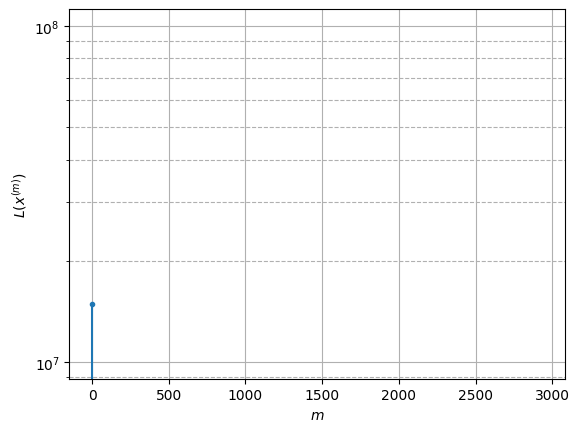

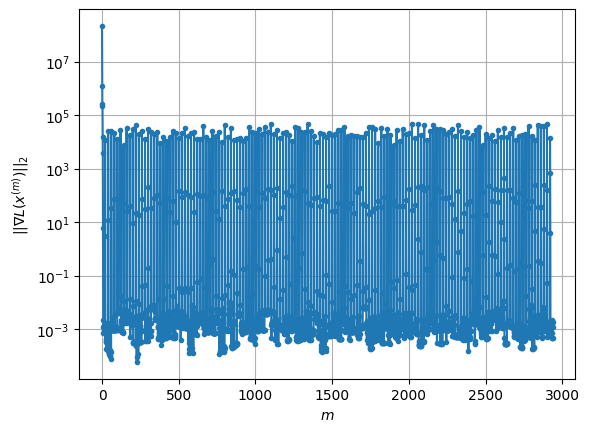

Windows:  39%|███▉      | 147/376 [17:18<28:55,  7.58s/it]

Before applying the algorithm
Cost function: -3151364.251159535
Gradient norm: 30019.445854915182
Global relative error: 18.064769798087873
Position relative errors: 0.03668500768238969 m, 9.032027560900932 m, 2.2238043172591535 m, 15.485737856226494 m

Iteration 1
Cost function: -3151366.6466678698 (-0.00%)
Gradient norm: 96.75247807436939 (-99.68%)
Global relative error: 28.924973738575137 (60.12%)
Position relative errors: 0.030038453869673104 m, 8.801757456252577 m, 4.094965740286969 m, 27.247191665468343 m

Iteration 2
Cost function: -3151366.647167815 (-0.00%)
Gradient norm: 0.14869309754829535 (-99.85%)
Global relative error: 29.445768013876233 (1.80%)
Position relative errors: 0.030038452334461115 m, 8.845970798593989 m, 4.08226340762054 m, 27.787264596661796 m

Iteration 3
Cost function: -3151366.647167808 (0.00%)
Gradient norm: 0.0016501196672425809 (-98.89%)
Global relative error: 29.446555499828417 (0.00%)
Position relative errors: 0.030038452076747792 m, 8.845991942527663 

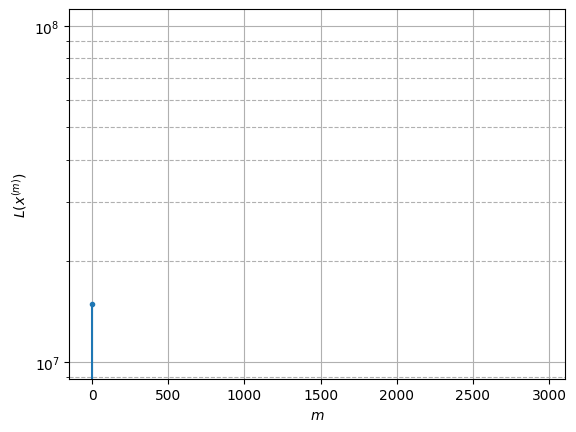

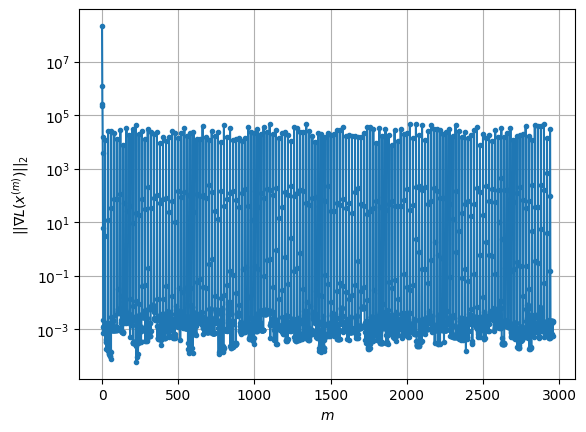

Windows:  39%|███▉      | 148/376 [17:26<29:07,  7.67s/it]

Before applying the algorithm
Cost function: -3151360.5710565276
Gradient norm: 13560.944147153343
Global relative error: 25.65856875177478
Position relative errors: 0.026964907024753838 m, 8.47515486958709 m, 3.7441403017362997 m, 23.927184058565036 m

Iteration 1
Cost function: -3151362.996319294 (-0.00%)
Gradient norm: 114.26163412889872 (-99.16%)
Global relative error: 24.039108009019866 (-6.31%)
Position relative errors: 0.01331746686118634 m, 6.938772659367486 m, 13.33408362043763 m, 18.759837111610366 m

Iteration 2
Cost function: -3151362.997787709 (-0.00%)
Gradient norm: 0.8277071101302375 (-99.28%)
Global relative error: 24.479946109558206 (1.83%)
Position relative errors: 0.013317463434727627 m, 7.01302452615742 m, 13.21833768772762 m, 19.37415146633315 m

Iteration 3
Cost function: -3151362.9977877447 (-0.00%)
Gradient norm: 0.001146797167282501 (-99.86%)
Global relative error: 24.48100927720827 (0.00%)
Position relative errors: 0.013317463434727627 m, 7.013185089363752 m, 

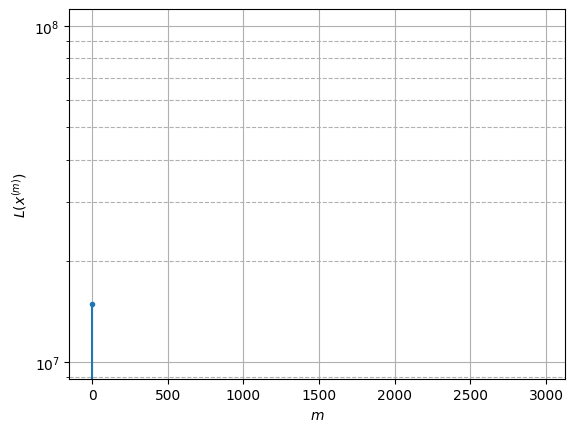

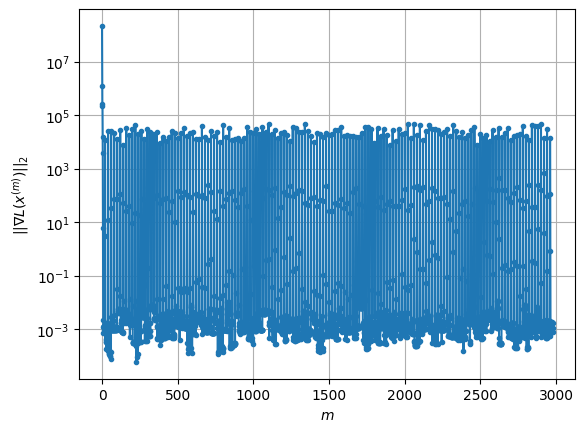

Windows:  40%|███▉      | 149/376 [17:34<29:03,  7.68s/it]

Before applying the algorithm
Cost function: -3151362.2765629417
Gradient norm: 12549.991916122937
Global relative error: 21.616851242000248
Position relative errors: 0.012596452671432733 m, 7.124894729330106 m, 12.080877801836449 m, 16.449114243225655 m

Iteration 1
Cost function: -3151363.9130069166 (-0.00%)
Gradient norm: 59.76017021815984 (-99.52%)
Global relative error: 31.65219529846998 (46.42%)
Position relative errors: 0.04582998558673789 m, 15.767646771594247 m, 8.901294170950555 m, 25.96160858922777 m

Iteration 2
Cost function: -3151363.913400712 (-0.00%)
Gradient norm: 0.10509850076089926 (-99.82%)
Global relative error: 31.66865730375178 (0.05%)
Position relative errors: 0.04582998352079299 m, 15.8060168266722 m, 8.911418119787111 m, 25.954878767553105 m

Iteration 3
Cost function: -3151363.9134007283 (-0.00%)
Gradient norm: 0.0003590295401359985 (-99.66%)
Global relative error: 31.668736796366346 (0.00%)
Position relative errors: 0.04582998414710907 m, 15.806032564289518 

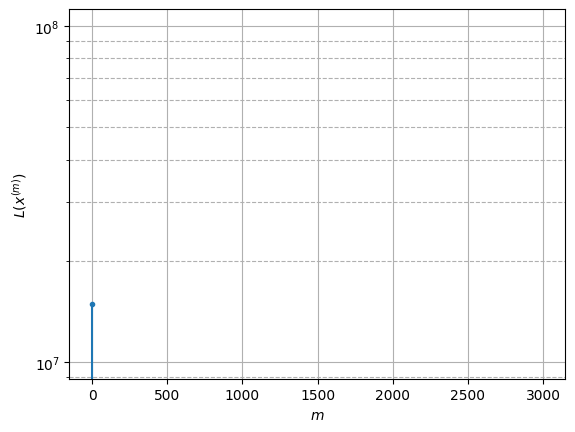

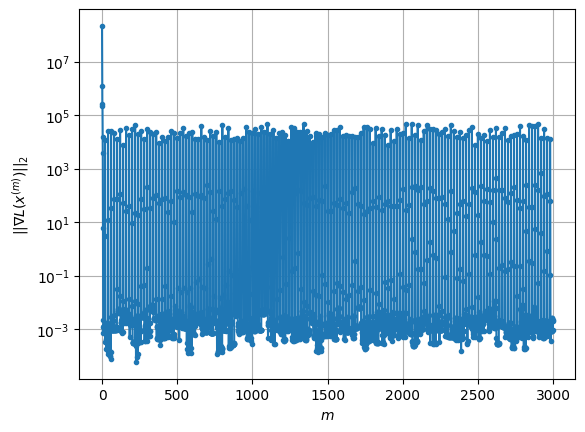

Windows:  40%|███▉      | 150/376 [17:41<28:54,  7.67s/it]

Before applying the algorithm
Cost function: -3151357.850393859
Gradient norm: 12648.873888464454
Global relative error: 28.94044063817184
Position relative errors: 0.04102149051935876 m, 15.440349488441747 m, 8.142905675789915 m, 23.083185195141844 m

Iteration 1
Cost function: -3151360.647595307 (-0.00%)
Gradient norm: 181.35755718362302 (-98.57%)
Global relative error: 25.57963215940286 (-11.61%)
Position relative errors: 0.04881728045063703 m, 23.156213683938468 m, 8.156726644795194 m, 7.181337031681063 m

Iteration 2
Cost function: -3151360.651992049 (-0.00%)
Gradient norm: 0.39133396684039157 (-99.78%)
Global relative error: 25.221296312081222 (-1.40%)
Position relative errors: 0.04881728152520049 m, 22.60647301306441 m, 8.29889378184679 m, 7.495734884802526 m

Iteration 3
Cost function: -3151360.651992081 (-0.00%)
Gradient norm: 0.0013179928318568 (-99.66%)
Global relative error: 25.221370994828177 (0.00%)
Position relative errors: 0.04881728185861955 m, 22.605763363573303 m, 8.

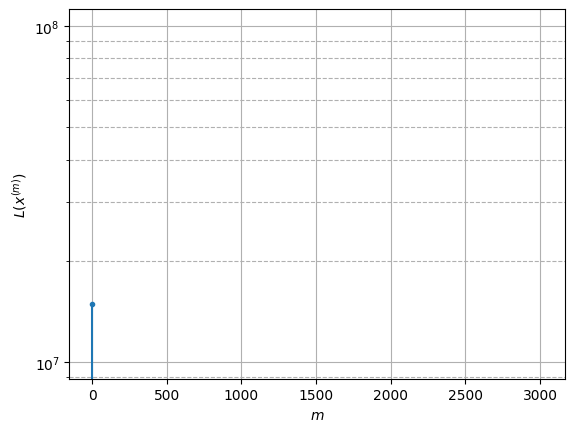

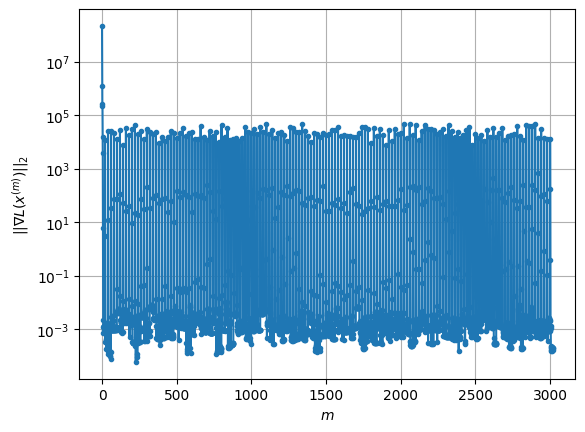

Windows:  40%|████      | 151/376 [17:49<28:42,  7.66s/it]

Before applying the algorithm
Cost function: -3151350.122765577
Gradient norm: 27078.827171975627
Global relative error: 24.01839127837423
Position relative errors: 0.04426540001085705 m, 21.520583976202047 m, 7.366080665874345 m, 7.712672999226581 m

Iteration 1
Cost function: -3151353.533315569 (-0.00%)
Gradient norm: 68.21826066644148 (-99.75%)
Global relative error: 29.932816578454002 (24.62%)
Position relative errors: 0.0213785571077288 m, 15.060414567988943 m, 4.4691363803167246 m, 25.479080900723236 m

Iteration 2
Cost function: -3151353.535798429 (-0.00%)
Gradient norm: 0.9671186478173438 (-98.58%)
Global relative error: 30.834082520058086 (3.01%)
Position relative errors: 0.021378559320954147 m, 14.830459619684127 m, 4.655983297949269 m, 26.62929250529372 m

Iteration 3
Cost function: -3151353.5357984607 (-0.00%)
Gradient norm: 0.0012721620763852966 (-99.87%)
Global relative error: 30.83585610320624 (0.01%)
Position relative errors: 0.021378559370565382 m, 14.83001619377923 m,

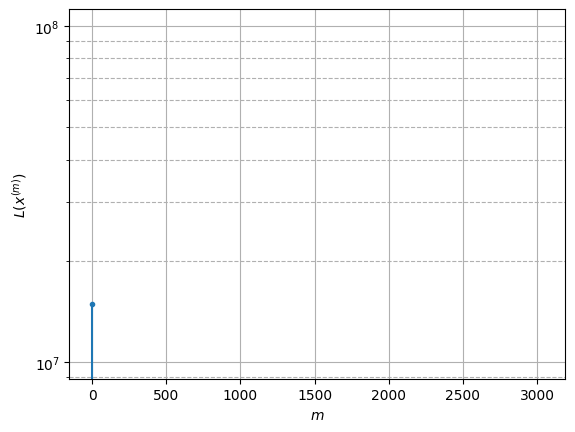

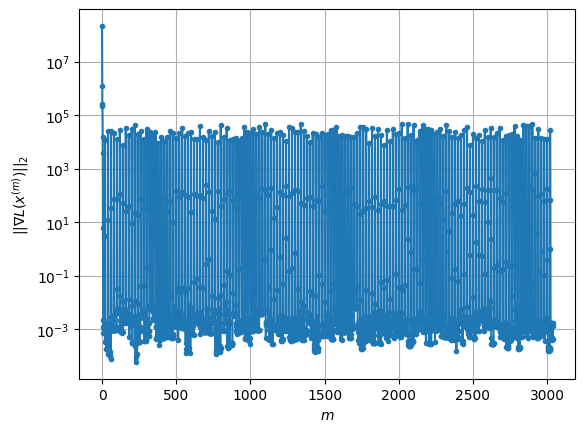

Windows:  40%|████      | 152/376 [17:57<28:33,  7.65s/it]

Before applying the algorithm
Cost function: -3151349.4787717625
Gradient norm: 18238.491973862525
Global relative error: 30.088081624243987
Position relative errors: 0.017358612736346122 m, 14.583238795046345 m, 4.170112490237646 m, 25.98521481144676 m

Iteration 1
Cost function: -3151350.351018269 (-0.00%)
Gradient norm: 40.28158819558001 (-99.78%)
Global relative error: 25.775651975647776 (-14.33%)
Position relative errors: 0.02799975865639185 m, 9.414060797862627 m, 7.313553581230572 m, 22.8532366874172 m

Iteration 2
Cost function: -3151350.3511728696 (-0.00%)
Gradient norm: 0.02509050560931212 (-99.94%)
Global relative error: 25.770388918197266 (-0.02%)
Position relative errors: 0.02799975665855458 m, 9.308603188291125 m, 7.317646625246918 m, 22.88916130146788 m

Iteration 3
Cost function: -3151350.3511728686 (0.00%)
Gradient norm: 0.000861458425117579 (-96.57%)
Global relative error: 25.770385049153454 (-0.00%)
Position relative errors: 0.02799975665855458 m, 9.308566453208638 m

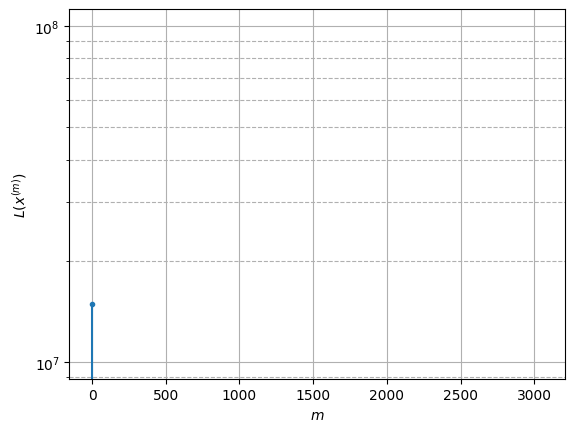

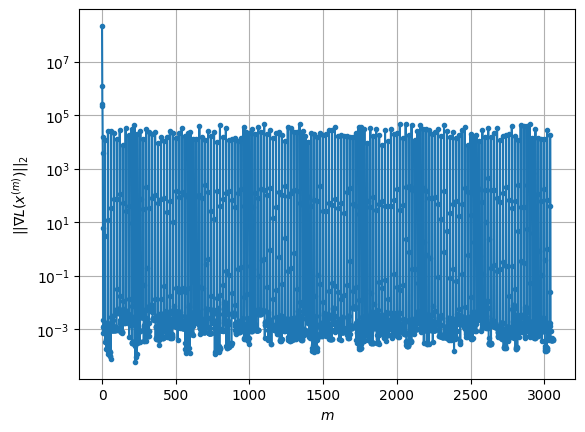

Windows:  41%|████      | 153/376 [18:04<28:25,  7.65s/it]

Before applying the algorithm
Cost function: -3151341.122417387
Gradient norm: 18060.717017028364
Global relative error: 24.659630474251014
Position relative errors: 0.022736473888299663 m, 9.050478390285383 m, 6.594660433299571 m, 21.970336969742732 m

Iteration 1
Cost function: -3151348.399734914 (-0.00%)
Gradient norm: 78.71886365102958 (-99.56%)
Global relative error: 36.23392445603481 (46.94%)
Position relative errors: 0.009974279698627037 m, 4.244119139419054 m, 6.280739316332065 m, 35.432126319340995 m

Iteration 2
Cost function: -3151348.402238203 (-0.00%)
Gradient norm: 0.3340285070851316 (-99.58%)
Global relative error: 36.97658257204756 (2.05%)
Position relative errors: 0.009974274543426129 m, 4.271134904414256 m, 6.3540448903591 m, 36.17526196676368 m

Iteration 3
Cost function: -3151348.4022382256 (-0.00%)
Gradient norm: 0.000674599992557165 (-99.80%)
Global relative error: 36.977231430640714 (0.00%)
Position relative errors: 0.009974273643556445 m, 4.271220731313893 m, 6.

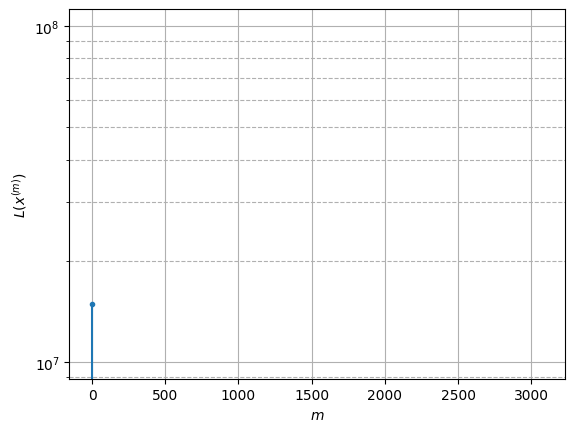

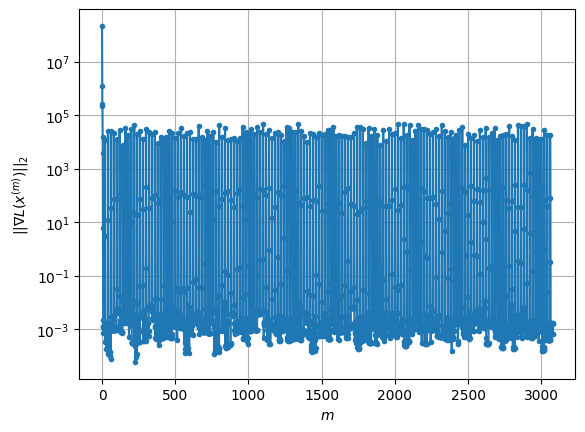

Windows:  41%|████      | 154/376 [18:12<28:35,  7.73s/it]

Before applying the algorithm
Cost function: -3151337.169724472
Gradient norm: 13241.13783134219
Global relative error: 34.68414273270724
Position relative errors: 0.0102186805912234 m, 3.9256315559056727 m, 5.82001984574822 m, 33.966229955988936 m

Iteration 1
Cost function: -3151341.0111633185 (-0.00%)
Gradient norm: 184.06115615950432 (-98.61%)
Global relative error: 14.671671685334406 (-57.70%)
Position relative errors: 0.044195536736669414 m, 2.8500027552360367 m, 1.78159949214113 m, 14.281430910693492 m

Iteration 2
Cost function: -3151341.015400276 (-0.00%)
Gradient norm: 1.8532508587088878 (-98.99%)
Global relative error: 15.703175123457097 (7.03%)
Position relative errors: 0.04419552810689905 m, 2.737382504809172 m, 1.7380478654247082 m, 15.36468559804217 m

Iteration 3
Cost function: -3151341.0154003464 (-0.00%)
Gradient norm: 0.0015952900863476138 (-99.91%)
Global relative error: 15.70543277807289 (0.01%)
Position relative errors: 0.04419552781681952 m, 2.737332118513394 m, 

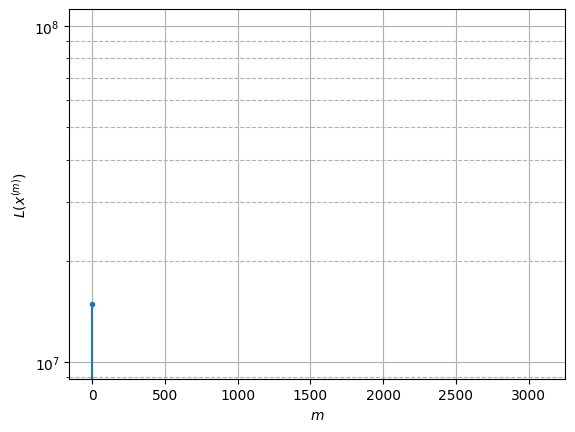

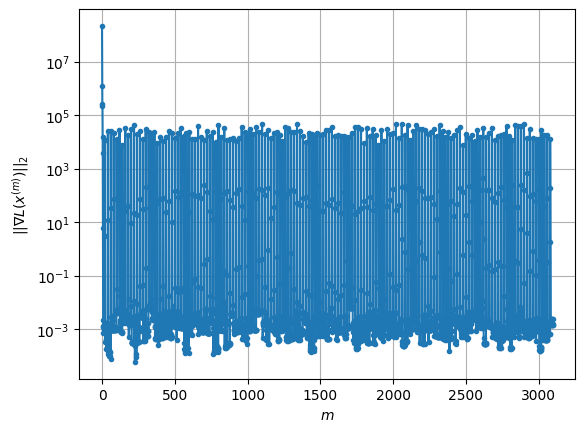

Windows:  41%|████      | 155/376 [18:20<28:25,  7.72s/it]

Before applying the algorithm
Cost function: -3151344.8513879036
Gradient norm: 11551.399028716916
Global relative error: 15.426165415832482
Position relative errors: 0.043207401305530344 m, 2.646445143781562 m, 1.6714838486354173 m, 15.10519997408227 m

Iteration 1
Cost function: -3151347.68606083 (-0.00%)
Gradient norm: 45.057837049906944 (-99.61%)
Global relative error: 9.24770104407164 (-40.05%)
Position relative errors: 0.050737983974809976 m, 5.345122502385523 m, 5.227142249350738 m, 5.442745634304154 m

Iteration 2
Cost function: -3151347.6867742417 (-0.00%)
Gradient norm: 0.3462796012008146 (-99.23%)
Global relative error: 9.157154922322412 (-0.98%)
Position relative errors: 0.05073798764390972 m, 5.3281959442594795 m, 5.096238390329258 m, 5.4303765808494235 m

Iteration 3
Cost function: -3151347.6867742133 (0.00%)
Gradient norm: 0.0014432681853185428 (-99.58%)
Global relative error: 9.157107371679736 (-0.00%)
Position relative errors: 0.05073798764390972 m, 5.3281944438081705 

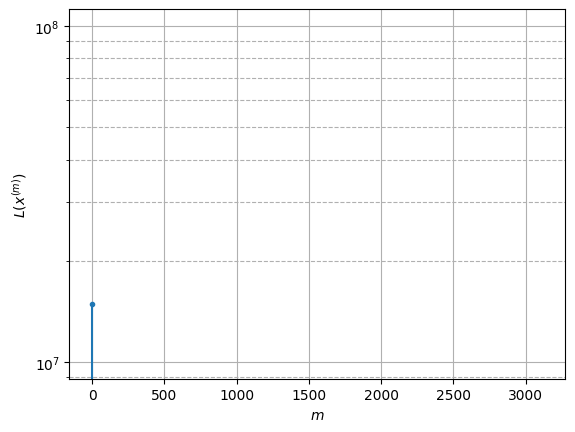

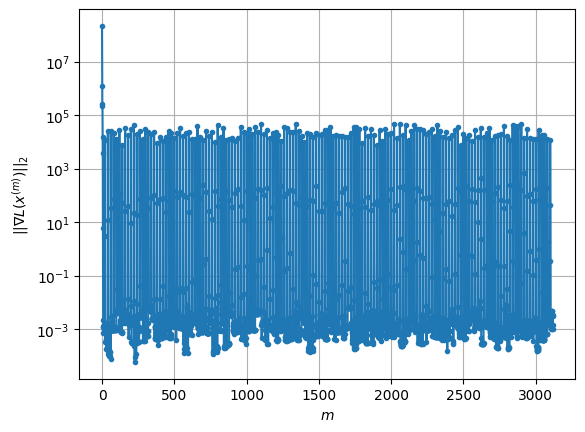

Windows:  41%|████▏     | 156/376 [18:27<27:58,  7.63s/it]

Before applying the algorithm
Cost function: -3151346.8840357955
Gradient norm: 13725.769215985869
Global relative error: 8.420564283993066
Position relative errors: 0.04816578172264524 m, 4.712520521971624 m, 4.90097379282104 m, 4.967454556144363 m

Iteration 1
Cost function: -3151348.7624881286 (-0.00%)
Gradient norm: 60.171044400990965 (-99.56%)
Global relative error: 20.56118118110373 (144.18%)
Position relative errors: 0.06465351054535207 m, 11.981899896291052 m, 6.2042161379507 m, 15.514473697912663 m

Iteration 2
Cost function: -3151348.763714805 (-0.00%)
Gradient norm: 0.2159235339461924 (-99.64%)
Global relative error: 21.25745352144785 (3.39%)
Position relative errors: 0.06465350180612703 m, 12.022993445799933 m, 6.146963746633336 m, 16.417574844147808 m

Iteration 3
Cost function: -3151348.763714816 (-0.00%)
Gradient norm: 0.0005894677691477036 (-99.73%)
Global relative error: 21.25868396495093 (0.01%)
Position relative errors: 0.06465350090416704 m, 12.022973584351341 m, 6.

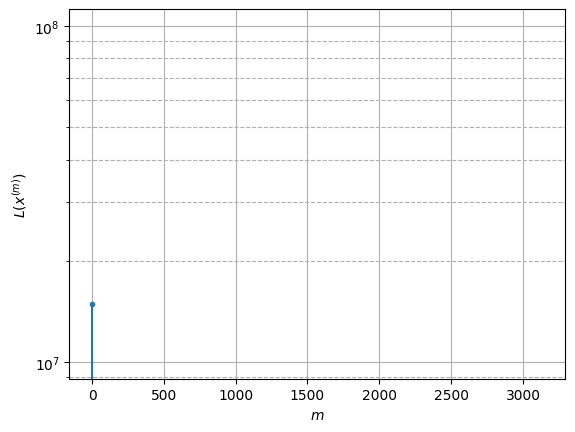

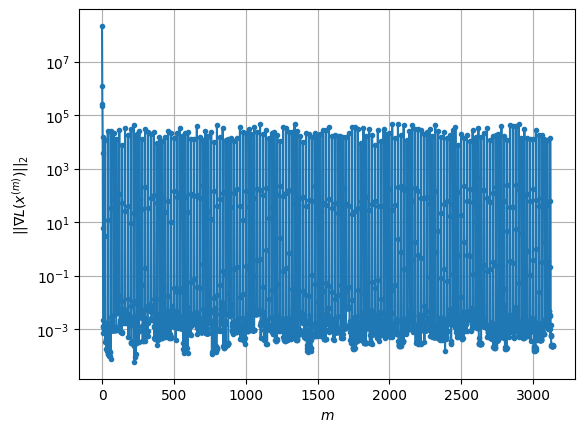

Windows:  42%|████▏     | 157/376 [18:34<27:26,  7.52s/it]

Before applying the algorithm
Cost function: -3151349.661288121
Gradient norm: 10456.053821050547
Global relative error: 20.405923292896848
Position relative errors: 0.06036589465398082 m, 10.742820465350798 m, 5.650668496295197 m, 16.4030181344223 m

Iteration 1
Cost function: -3151351.5823241696 (-0.00%)
Gradient norm: 67.88452010935092 (-99.35%)
Global relative error: 12.580504438948065 (-38.35%)
Position relative errors: 0.06902602985084456 m, 7.818929767307841 m, 4.125259301118253 m, 8.950420357459441 m

Iteration 2
Cost function: -3151351.583300096 (-0.00%)
Gradient norm: 0.1363537095004392 (-99.80%)
Global relative error: 13.01749008520312 (3.47%)
Position relative errors: 0.06902602426791987 m, 7.8704468328056665 m, 4.041794211836378 m, 9.548267755891844 m

Iteration 3
Cost function: -3151351.583300083 (0.00%)
Gradient norm: 0.0032417877179630795 (-97.62%)
Global relative error: 13.018193125343442 (0.01%)
Position relative errors: 0.06902602426791987 m, 7.870542602551854 m, 4.0

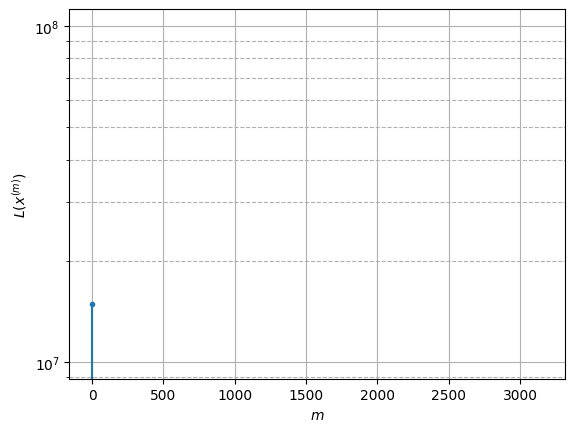

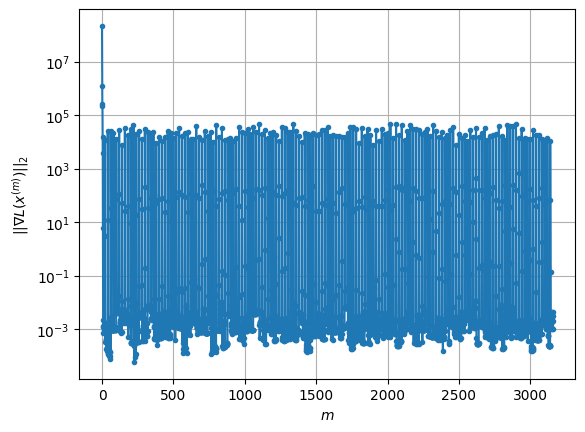

Windows:  42%|████▏     | 158/376 [18:42<26:59,  7.43s/it]

Before applying the algorithm
Cost function: -3151344.3865428246
Gradient norm: 16277.443036107934
Global relative error: 13.039683874352985
Position relative errors: 0.0626713067271421 m, 7.779448662335432 m, 3.913658789114671 m, 9.705262178447907 m

Iteration 1
Cost function: -3151348.6139104515 (-0.00%)
Gradient norm: 94.64469737350935 (-99.42%)
Global relative error: 24.486169914403725 (87.78%)
Position relative errors: 0.03584272302392591 m, 16.699331934778325 m, 4.236137301757567 m, 17.399950898470735 m

Iteration 2
Cost function: -3151348.615010284 (-0.00%)
Gradient norm: 0.09043775918663845 (-99.90%)
Global relative error: 24.078866104086792 (-1.66%)
Position relative errors: 0.035842722287555466 m, 16.493618328547363 m, 4.207498453292029 m, 17.030784406509174 m

Iteration 3
Cost function: -3151348.615010279 (0.00%)
Gradient norm: 0.0006048210313136711 (-99.33%)
Global relative error: 24.078374483587854 (-0.00%)
Position relative errors: 0.035842722425914755 m, 16.4933025908464

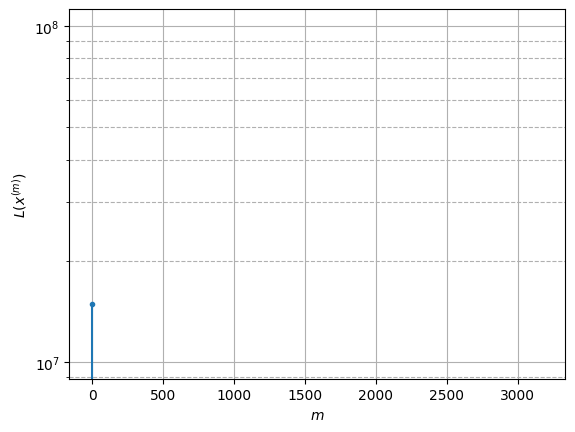

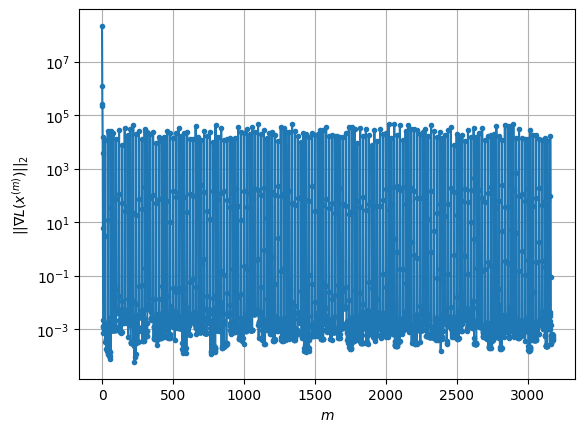

Windows:  42%|████▏     | 159/376 [18:49<26:31,  7.33s/it]

Before applying the algorithm
Cost function: -3151350.0931466497
Gradient norm: 16964.200400313377
Global relative error: 24.115420899625292
Position relative errors: 0.03223775917601925 m, 16.696432536099053 m, 3.7431165102256214 m, 16.99324340652389 m

Iteration 1
Cost function: -3151354.181353024 (-0.00%)
Gradient norm: 230.72639648317985 (-98.64%)
Global relative error: 12.475828939122827 (-48.27%)
Position relative errors: 0.026044792403849427 m, 4.565069870886038 m, 8.855230564916717 m, 7.509151651134208 m

Iteration 2
Cost function: -3151354.1855847156 (-0.00%)
Gradient norm: 0.40320161870802756 (-99.83%)
Global relative error: 12.203076366609471 (-2.19%)
Position relative errors: 0.02604479757840585 m, 4.969669254819172 m, 8.635577567352307 m, 7.045600187021913 m

Iteration 3
Cost function: -3151354.185584732 (-0.00%)
Gradient norm: 0.0005972561105797981 (-99.85%)
Global relative error: 12.201314149691518 (-0.01%)
Position relative errors: 0.026044797471963442 m, 4.971039680779

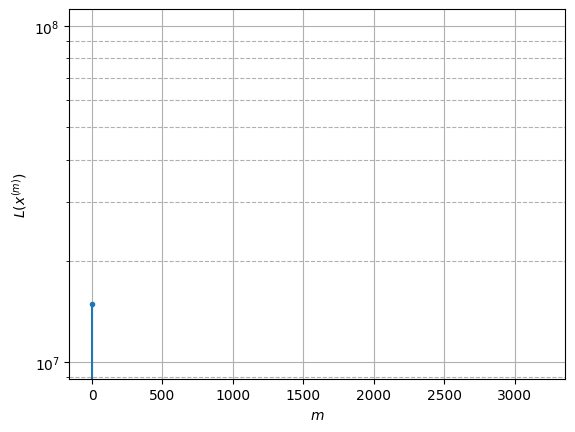

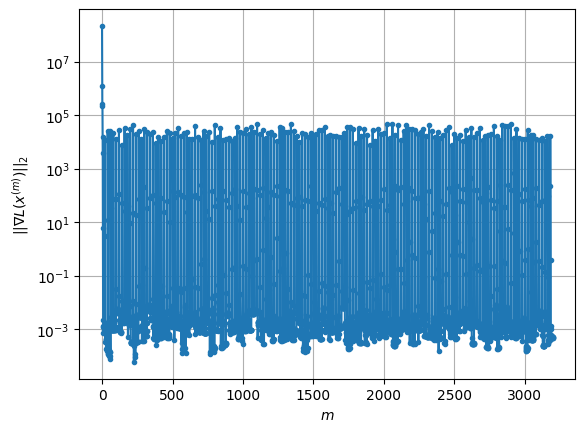

Windows:  43%|████▎     | 160/376 [18:56<26:26,  7.34s/it]

Before applying the algorithm
Cost function: -3151347.594825965
Gradient norm: 39948.42673073243
Global relative error: 10.976074453836159
Position relative errors: 0.025002309476712347 m, 6.495168553483825 m, 7.348588220755067 m, 4.927627168615279 m

Iteration 1
Cost function: -3151350.980023495 (-0.00%)
Gradient norm: 148.52934023187404 (-99.63%)
Global relative error: 18.46464631753544 (68.23%)
Position relative errors: 0.05813042994018557 m, 0.8007664627938625 m, 17.41139724094509 m, 6.0941164394455525 m

Iteration 2
Cost function: -3151350.980692999 (-0.00%)
Gradient norm: 0.014546936032203151 (-99.99%)
Global relative error: 18.42785575724722 (-0.20%)
Position relative errors: 0.058130432760258706 m, 0.8186046594740056 m, 17.297434962550323 m, 6.30139294610751 m

Iteration 3
Cost function: -3151350.980692999 (0.00%)
Gradient norm: 0.0002940631900613035 (-97.98%)
Global relative error: 18.42781266552458 (-0.00%)
Position relative errors: 0.05813043182993837 m, 0.8186677843222481 m

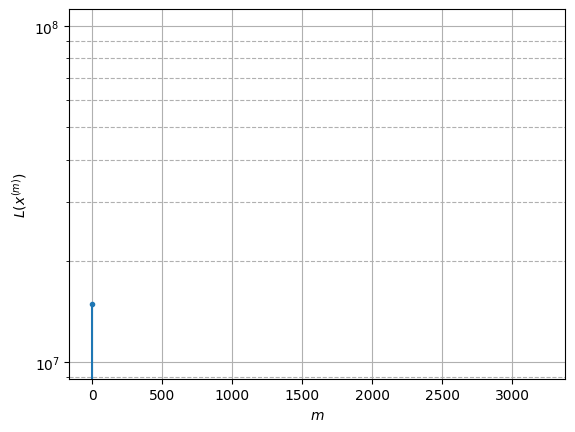

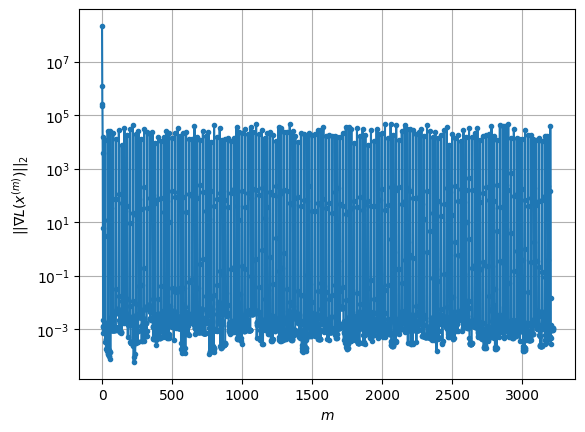

Windows:  43%|████▎     | 161/376 [19:03<26:13,  7.32s/it]

Before applying the algorithm
Cost function: -3151346.7926764768
Gradient norm: 31945.526437840526
Global relative error: 16.258398741886804
Position relative errors: 0.05384626787806608 m, 1.8444439746166155 m, 15.417702755092806 m, 4.81886665521458 m

Iteration 1
Cost function: -3151355.0200552098 (-0.00%)
Gradient norm: 167.71750863299337 (-99.47%)
Global relative error: 25.13895432168218 (54.62%)
Position relative errors: 0.08415811072636106 m, 13.257573553136421 m, 8.550074202088132 m, 19.572678370751373 m

Iteration 2
Cost function: -3151355.023612466 (-0.00%)
Gradient norm: 0.998118174980551 (-99.40%)
Global relative error: 25.682335371948678 (2.16%)
Position relative errors: 0.08415811557535591 m, 13.367561588623861 m, 8.523654251549477 m, 20.20464230830261 m

Iteration 3
Cost function: -3151355.023612487 (-0.00%)
Gradient norm: 0.0005291536229028644 (-99.95%)
Global relative error: 25.68363788460499 (0.01%)
Position relative errors: 0.08415811554295437 m, 13.36773922843745 m, 

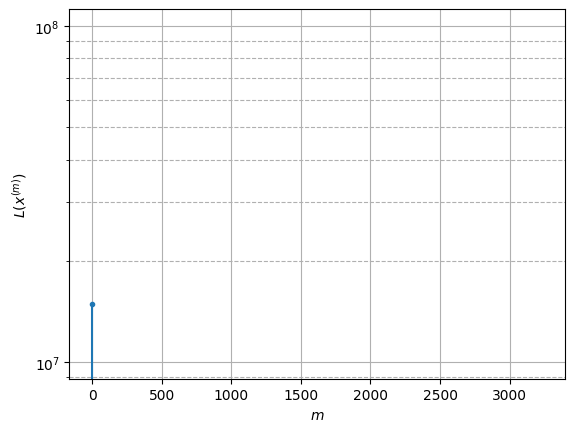

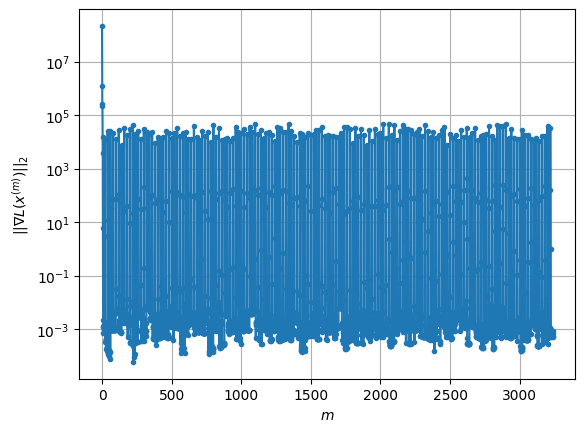

Windows:  43%|████▎     | 162/376 [19:11<25:56,  7.27s/it]

Before applying the algorithm
Cost function: -3151359.0627776217
Gradient norm: 9329.308407573955
Global relative error: 23.092552106455233
Position relative errors: 0.07663137284976122 m, 12.440457518938551 m, 6.859483052141136 m, 18.20547642883427 m

Iteration 1
Cost function: -3151363.230583589 (-0.00%)
Gradient norm: 282.8144437165488 (-96.97%)
Global relative error: 19.831033067507974 (-14.12%)
Position relative errors: 0.059804401672030764 m, 8.246858336970138 m, 12.354911727254226 m, 13.13809333374992 m

Iteration 2
Cost function: -3151363.236292665 (-0.00%)
Gradient norm: 1.0535314625471126 (-99.63%)
Global relative error: 20.288807829839616 (2.31%)
Position relative errors: 0.05980440416947807 m, 7.896871854049898 m, 12.52182925960051 m, 13.873465203691886 m

Iteration 3
Cost function: -3151363.2362927343 (-0.00%)
Gradient norm: 0.00290164807248962 (-99.72%)
Global relative error: 20.289570712217635 (0.00%)
Position relative errors: 0.05980440441781544 m, 7.896826727093774 m, 

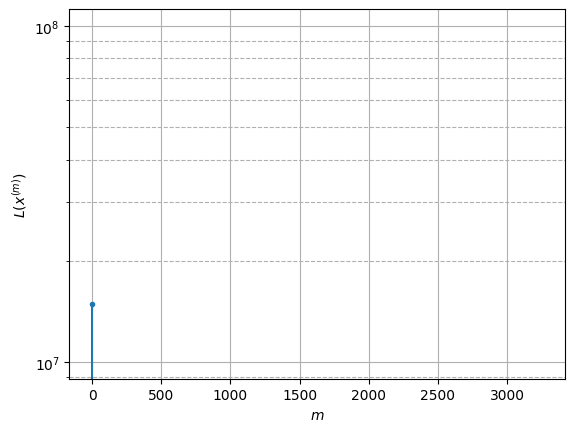

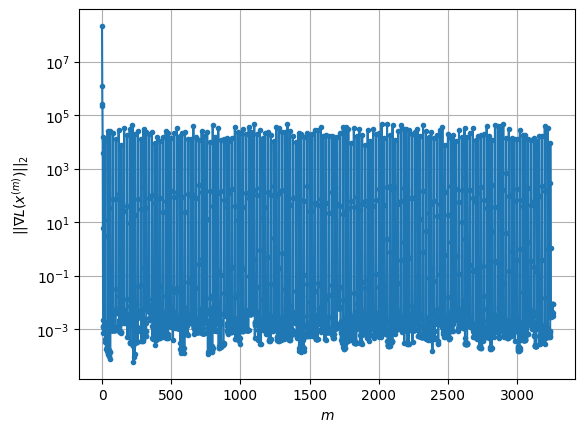

Windows:  43%|████▎     | 163/376 [19:18<25:37,  7.22s/it]

Before applying the algorithm
Cost function: -3151358.5458074817
Gradient norm: 24877.25987518077
Global relative error: 18.13798870040785
Position relative errors: 0.05525810193872417 m, 6.157349978091634 m, 11.007940141213396 m, 13.034322609968228 m

Iteration 1
Cost function: -3151362.194180134 (-0.00%)
Gradient norm: 46.17538478750337 (-99.81%)
Global relative error: 27.014345867711963 (48.94%)
Position relative errors: 0.027508785298919047 m, 5.339804935967723 m, 19.255893339339124 m, 18.178791644567816 m

Iteration 2
Cost function: -3151362.1946301116 (-0.00%)
Gradient norm: 0.12015367255610047 (-99.74%)
Global relative error: 27.198217232736535 (0.68%)
Position relative errors: 0.02750877911487475 m, 5.445939596416005 m, 19.459939656401477 m, 18.204174969888204 m

Iteration 3
Cost function: -3151362.1946300818 (0.00%)
Gradient norm: 0.0013455909771080373 (-98.88%)
Global relative error: 27.198365374995408 (0.00%)
Position relative errors: 0.027508779111114698 m, 5.44601677343019

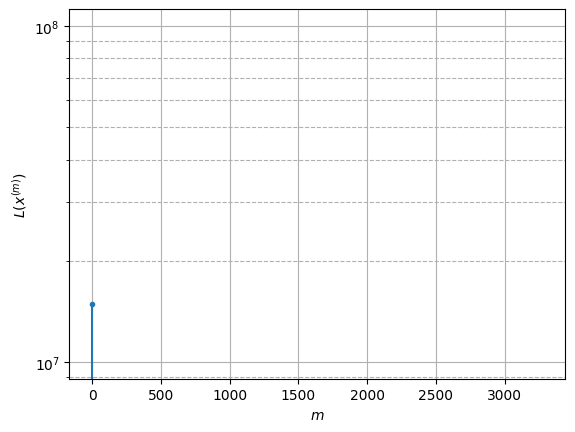

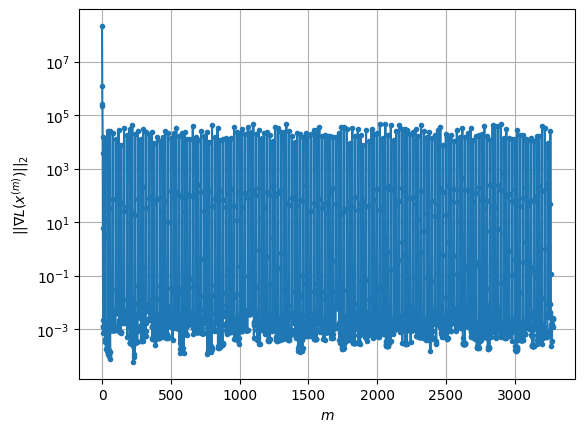

Windows:  44%|████▎     | 164/376 [19:25<25:24,  7.19s/it]

Before applying the algorithm
Cost function: -3151363.2712889644
Gradient norm: 8294.211652573325
Global relative error: 25.649433138870076
Position relative errors: 0.027444754374315716 m, 6.326707517482507 m, 17.23589690240866 m, 17.910514533205486 m

Iteration 1
Cost function: -3151366.686233327 (-0.00%)
Gradient norm: 27.8915081298764 (-99.66%)
Global relative error: 40.451179621454 (57.71%)
Position relative errors: 0.0587210086595559 m, 16.929048406368228 m, 23.24004583464579 m, 28.453452415136915 m

Iteration 2
Cost function: -3151366.686706063 (-0.00%)
Gradient norm: 0.021858749433411838 (-99.92%)
Global relative error: 40.59680047606799 (0.36%)
Position relative errors: 0.058721008334608235 m, 17.144789797526006 m, 23.035783408096332 m, 28.69673383785759 m

Iteration 3
Cost function: -3151366.6867060624 (0.00%)
Gradient norm: 0.0006466669125684048 (-97.04%)
Global relative error: 40.59708866016501 (0.00%)
Position relative errors: 0.05872100792471778 m, 17.14502853796761 m, 23

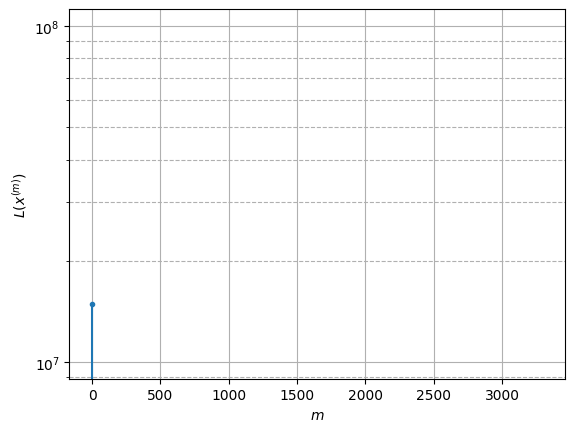

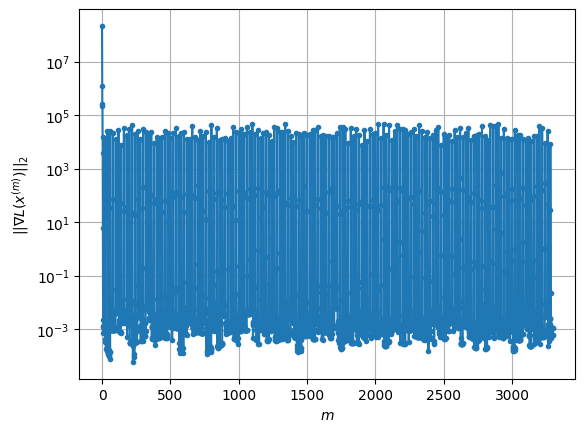

Windows:  44%|████▍     | 165/376 [19:32<25:14,  7.18s/it]

Before applying the algorithm
Cost function: -3151360.349082483
Gradient norm: 12472.863424842322
Global relative error: 39.434126133392446
Position relative errors: 0.05637355653588133 m, 18.512812144537293 m, 20.409615279161223 m, 28.209350414199395 m

Iteration 1
Cost function: -3151365.8888281253 (-0.00%)
Gradient norm: 193.43290845560915 (-98.45%)
Global relative error: 30.84952612053869 (-21.77%)
Position relative errors: 0.03309584097713831 m, 18.723476002242258 m, 11.958904124234715 m, 21.40344229136772 m

Iteration 2
Cost function: -3151365.8962969803 (-0.00%)
Gradient norm: 2.7091904383060226 (-98.60%)
Global relative error: 30.50316618242944 (-1.12%)
Position relative errors: 0.03309585685233174 m, 18.851632181183856 m, 12.204952923302203 m, 20.642095947949205 m

Iteration 3
Cost function: -3151365.8962971508 (-0.00%)
Gradient norm: 0.0017149275444220677 (-99.94%)
Global relative error: 30.503075990835622 (-0.00%)
Position relative errors: 0.03309585701345895 m, 18.852304602

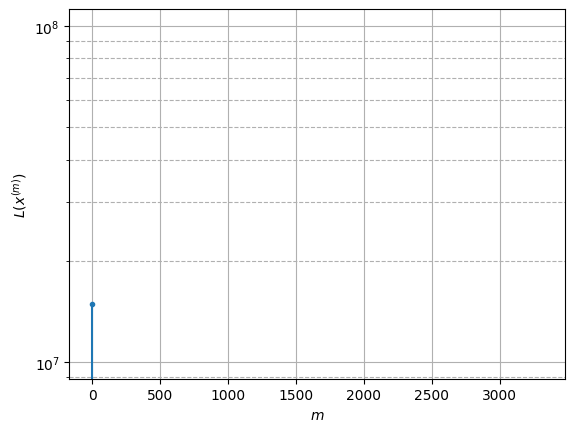

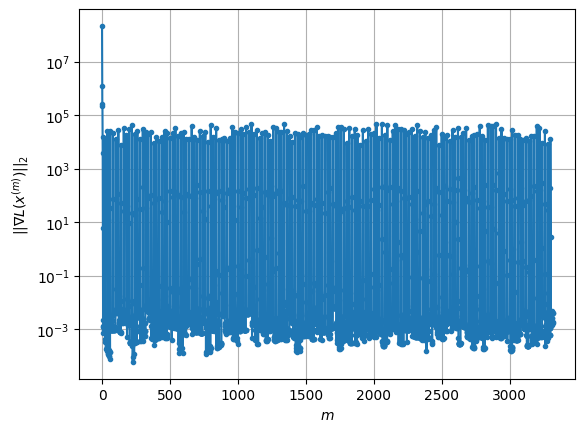

Windows:  44%|████▍     | 166/376 [19:39<24:51,  7.10s/it]

Before applying the algorithm
Cost function: -3151360.692259738
Gradient norm: 19429.66029888839
Global relative error: 30.766520510289947
Position relative errors: 0.031144230359244494 m, 19.87102949894627 m, 10.947881631398168 m, 20.781312477209465 m

Iteration 1
Cost function: -3151362.959354723 (-0.00%)
Gradient norm: 150.37041078986792 (-99.23%)
Global relative error: 17.158656109620264 (-44.23%)
Position relative errors: 0.053856678633297426 m, 15.453355710674645 m, 6.076044723800288 m, 4.323401568221881 m

Iteration 2
Cost function: -3151362.9613860236 (-0.00%)
Gradient norm: 0.2879311320277986 (-99.81%)
Global relative error: 17.214344033501522 (0.32%)
Position relative errors: 0.053856684345536913 m, 15.524143283085747 m, 5.979337352591576 m, 4.42481149739648 m

Iteration 3
Cost function: -3151362.9613860045 (0.00%)
Gradient norm: 0.0010517449401776949 (-99.63%)
Global relative error: 17.214175968761147 (-0.00%)
Position relative errors: 0.05385668511152516 m, 15.5239754197718

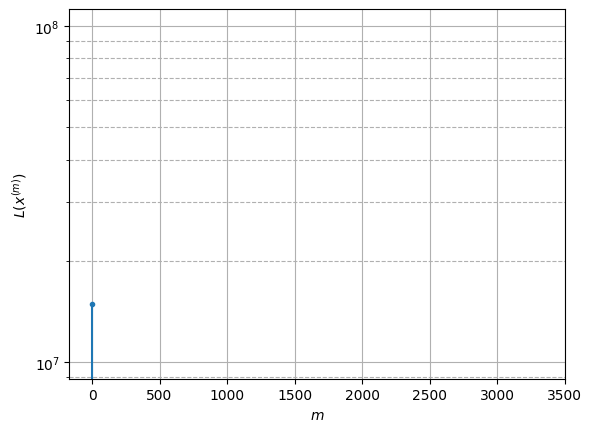

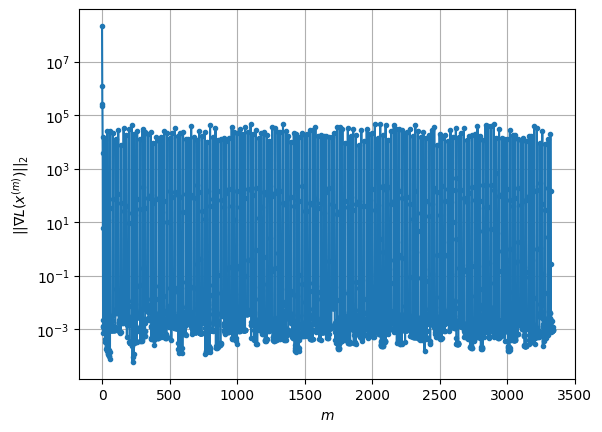

Windows:  44%|████▍     | 167/376 [19:46<24:31,  7.04s/it]

Before applying the algorithm
Cost function: -3151359.2805298828
Gradient norm: 24792.895099824313
Global relative error: 17.43219703528851
Position relative errors: 0.048198685857034115 m, 15.692347193088887 m, 6.086115434282615 m, 4.537437823483633 m

Iteration 1
Cost function: -3151362.950069511 (-0.00%)
Gradient norm: 43.61566249720174 (-99.82%)
Global relative error: 21.44996349336844 (23.05%)
Position relative errors: 0.033804038194544736 m, 14.157989465780894 m, 14.232759156430127 m, 7.5550585828786225 m

Iteration 2
Cost function: -3151362.950414717 (-0.00%)
Gradient norm: 0.0171066184356106 (-99.96%)
Global relative error: 21.34249057835885 (-0.50%)
Position relative errors: 0.033804039804928784 m, 14.166759118740929 m, 14.076572136025995 m, 7.5268216010578515 m

Iteration 3
Cost function: -3151362.9504147414 (-0.00%)
Gradient norm: 0.0013348827570050326 (-92.20%)
Global relative error: 21.34238306634546 (-0.00%)
Position relative errors: 0.03380403995857622 m, 14.166752491776

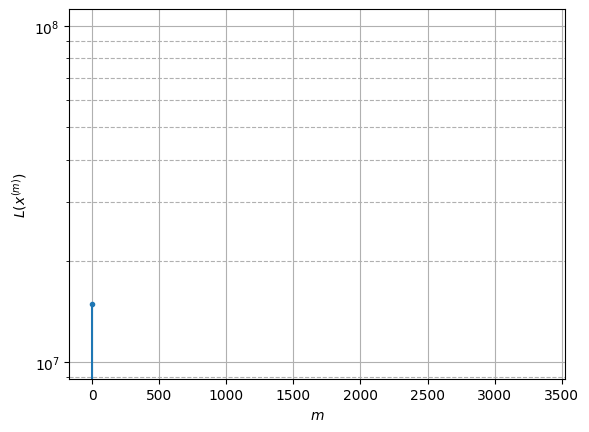

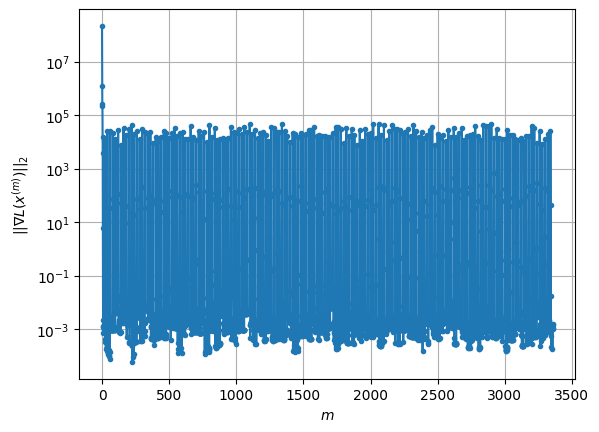

Windows:  45%|████▍     | 168/376 [19:53<24:23,  7.03s/it]

Before applying the algorithm
Cost function: -3151361.847504375
Gradient norm: 21931.705256612073
Global relative error: 20.627807031432184
Position relative errors: 0.03351366405331772 m, 13.830522505940767 m, 13.63403163532303 m, 6.95229605310414 m

Iteration 1
Cost function: -3151363.50014591 (-0.00%)
Gradient norm: 29.051797502891457 (-99.87%)
Global relative error: 28.810388909209696 (39.67%)
Position relative errors: 0.047020386894350674 m, 22.820314598174036 m, 9.960584804993863 m, 14.493311642854277 m

Iteration 2
Cost function: -3151363.5003907764 (-0.00%)
Gradient norm: 0.017321971638715343 (-99.94%)
Global relative error: 29.041435972314513 (0.80%)
Position relative errors: 0.04702038595450851 m, 22.932383073634004 m, 10.067922070037776 m, 14.701882108459696 m

Iteration 3
Cost function: -3151363.5003907843 (-0.00%)
Gradient norm: 0.0015745287390658634 (-90.91%)
Global relative error: 29.041671840951874 (0.00%)
Position relative errors: 0.04702038571622986 m, 22.932517483169

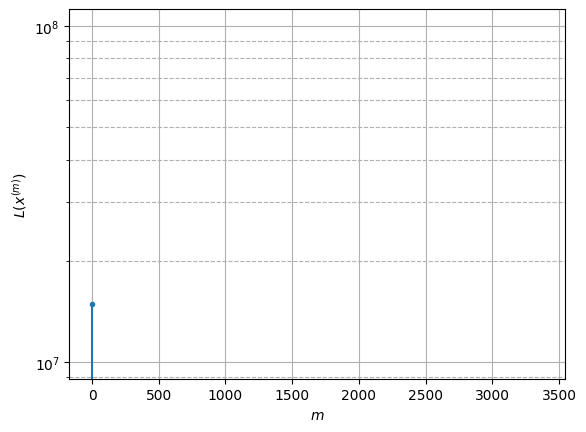

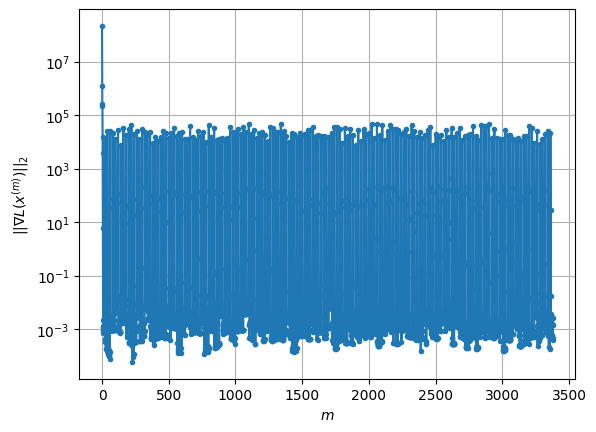

Windows:  45%|████▍     | 169/376 [20:00<24:12,  7.02s/it]

Before applying the algorithm
Cost function: -3151357.5935635194
Gradient norm: 16046.192915928907
Global relative error: 28.81951465200306
Position relative errors: 0.04555548581702583 m, 22.441712379959988 m, 10.197387987599383 m, 14.931342031853191 m

Iteration 1
Cost function: -3151359.760426133 (-0.00%)
Gradient norm: 106.36693460299176 (-99.34%)
Global relative error: 29.62565803335943 (2.80%)
Position relative errors: 0.07431370334661247 m, 22.259024232865972 m, 8.666462968462355 m, 17.524319787532324 m

Iteration 2
Cost function: -3151359.7609956786 (-0.00%)
Gradient norm: 0.06199762961311891 (-99.94%)
Global relative error: 29.478039002759065 (-0.50%)
Position relative errors: 0.07431370406148673 m, 22.24526963609176 m, 8.733310857118829 m, 17.257634247076545 m

Iteration 3
Cost function: -3151359.7609956795 (-0.00%)
Gradient norm: 0.0012070322525421701 (-98.05%)
Global relative error: 29.477855662919094 (-0.00%)
Position relative errors: 0.07431370424194439 m, 22.245215967388

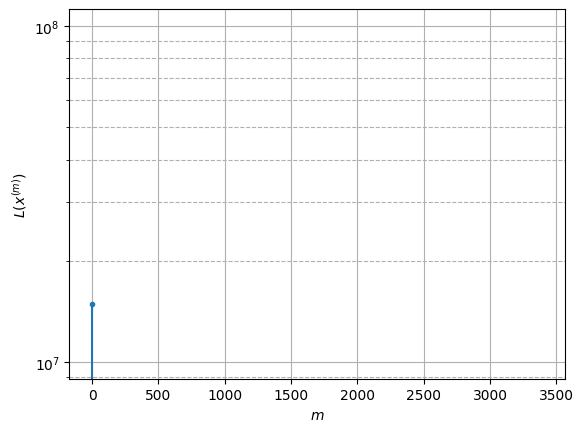

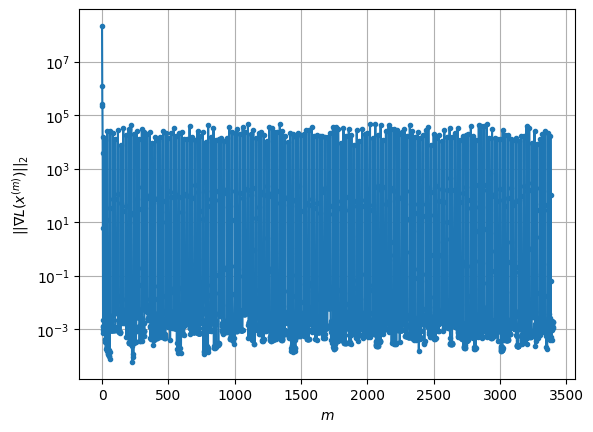

Windows:  45%|████▌     | 170/376 [20:07<24:25,  7.12s/it]

Before applying the algorithm
Cost function: -3151355.2328024097
Gradient norm: 27942.24138759625
Global relative error: 29.55526985095666
Position relative errors: 0.06917359690951287 m, 21.87593315678043 m, 8.570724985546674 m, 17.93027861315853 m

Iteration 1
Cost function: -3151358.5189641006 (-0.00%)
Gradient norm: 50.20385378448378 (-99.82%)
Global relative error: 37.23215862125191 (25.97%)
Position relative errors: 0.10361310161374312 m, 26.896938578994945 m, 9.139625570139975 m, 24.067500503650198 m

Iteration 2
Cost function: -3151358.519151123 (-0.00%)
Gradient norm: 0.0024960979255665744 (-100.00%)
Global relative error: 37.437769500501545 (0.55%)
Position relative errors: 0.10361310827594854 m, 27.031991998851883 m, 9.138492624647139 m, 24.234994355903737 m

Iteration 3
Cost function: -3151358.519151115 (0.00%)
Gradient norm: 0.0005269925518822501 (-78.89%)
Global relative error: 37.437886937637 (0.00%)
Position relative errors: 0.10361310827594854 m, 27.032056423652048 m, 

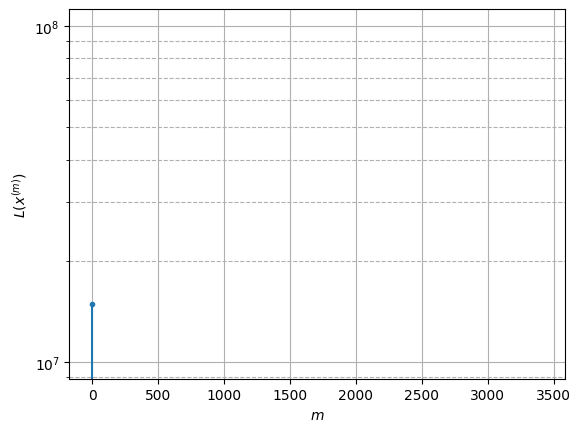

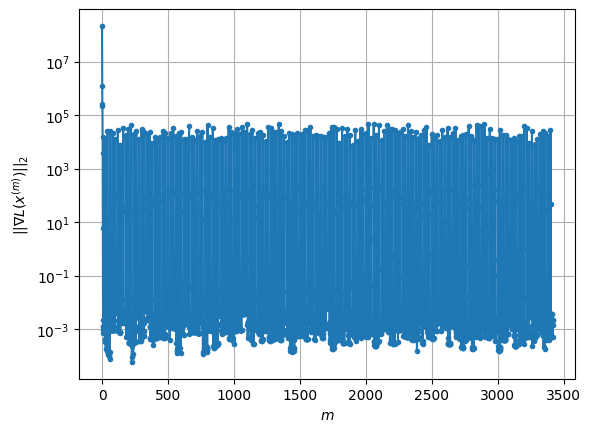

Windows:  45%|████▌     | 171/376 [20:15<25:16,  7.40s/it]

Before applying the algorithm
Cost function: -3151362.3876636256
Gradient norm: 21741.085611993607
Global relative error: 37.229216449632546
Position relative errors: 0.09513139426110963 m, 26.58025089071762 m, 8.801236461315298 m, 24.536376115877687 m

Iteration 1
Cost function: -3151364.684729146 (-0.00%)
Gradient norm: 28.93947814702094 (-99.87%)
Global relative error: 50.65896430263825 (36.07%)
Position relative errors: 0.05352864264202538 m, 35.14468317019574 m, 14.07226349023399 m, 33.662286861314264 m

Iteration 2
Cost function: -3151364.6849765787 (-0.00%)
Gradient norm: 0.04480967331714135 (-99.85%)
Global relative error: 50.50338698621996 (-0.31%)
Position relative errors: 0.05352864360705703 m, 35.09446645883266 m, 14.095672789653047 m, 33.47056575969515 m

Iteration 3
Cost function: -3151364.6849765773 (0.00%)
Gradient norm: 0.0008057885268560337 (-98.20%)
Global relative error: 50.5033050626868 (-0.00%)
Position relative errors: 0.05352864431286409 m, 35.094429890578624 m,

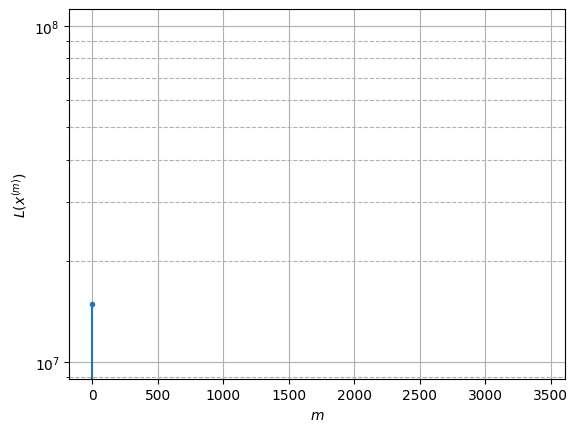

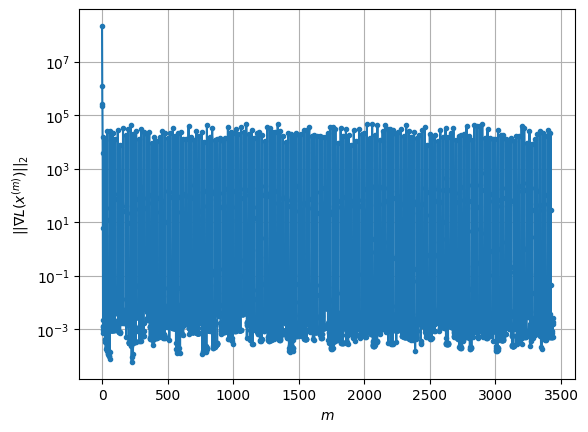

Windows:  46%|████▌     | 172/376 [20:23<25:53,  7.62s/it]

Before applying the algorithm
Cost function: -3151366.5444750385
Gradient norm: 22316.758432137245
Global relative error: 49.4842890840883
Position relative errors: 0.049037093136518016 m, 34.068328986121145 m, 12.95648856873261 m, 33.468940138391304 m

Iteration 1
Cost function: -3151371.726776844 (-0.00%)
Gradient norm: 132.0177081919593 (-99.41%)
Global relative error: 64.08822425748227 (29.51%)
Position relative errors: 0.023670706282787685 m, 40.579464815284524 m, 17.913906969963854 m, 46.25685040921087 m

Iteration 2
Cost function: -3151371.728157897 (-0.00%)
Gradient norm: 0.17053652052524104 (-99.87%)
Global relative error: 64.99963996793923 (1.42%)
Position relative errors: 0.023670705869108907 m, 41.172200122641144 m, 18.227081991707504 m, 46.87828159818645 m

Iteration 3
Cost function: -3151371.728157888 (0.00%)
Gradient norm: 0.0012869360896810272 (-99.25%)
Global relative error: 65.00116182883039 (0.00%)
Position relative errors: 0.023670706296433704 m, 41.17312870734474 m

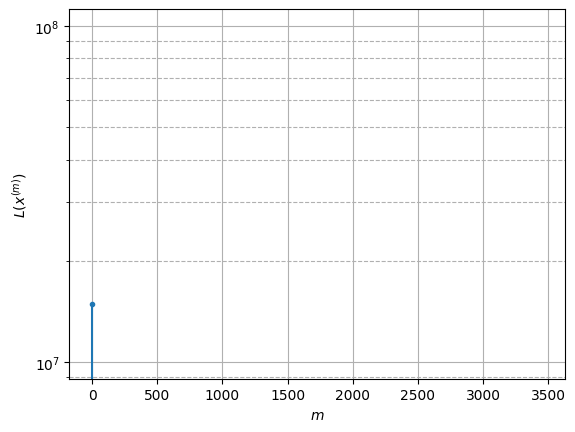

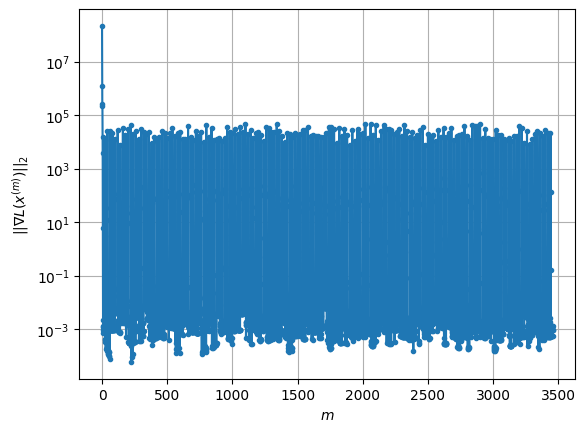

Windows:  46%|████▌     | 173/376 [20:31<26:17,  7.77s/it]

Before applying the algorithm
Cost function: -3151369.1476634685
Gradient norm: 10656.910242655495
Global relative error: 62.66498171811154
Position relative errors: 0.021907160043316398 m, 39.56276185089266 m, 17.07976165541172 m, 45.4968841732074 m

Iteration 1
Cost function: -3151371.5962017016 (-0.00%)
Gradient norm: 27.98247623939383 (-99.74%)
Global relative error: 70.86521125215681 (13.09%)
Position relative errors: 0.004930956292362143 m, 43.076834858079174 m, 24.393933292993196 m, 50.706979396300696 m

Iteration 2
Cost function: -3151371.5965082473 (-0.00%)
Gradient norm: 0.05407435166025144 (-99.81%)
Global relative error: 70.69957549975666 (-0.23%)
Position relative errors: 0.004930955889859199 m, 43.07034268423806 m, 24.507149411927177 m, 50.4259104325608 m

Iteration 3
Cost function: -3151371.5965082906 (-0.00%)
Gradient norm: 0.002535779341913877 (-95.31%)
Global relative error: 70.6994556434974 (-0.00%)
Position relative errors: 0.004930956096210572 m, 43.0703023592391 m

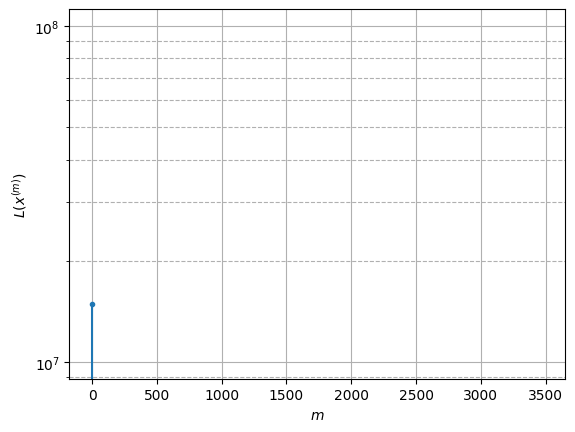

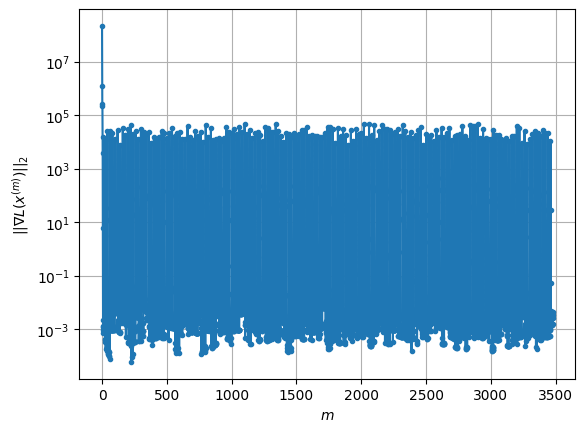

Windows:  46%|████▋     | 174/376 [20:39<26:25,  7.85s/it]

Before applying the algorithm
Cost function: -3151369.0235452927
Gradient norm: 34560.19970408987
Global relative error: 68.41736909114258
Position relative errors: 0.004830381997875746 m, 41.580939702772554 m, 22.963936630306545 m, 49.24039918353376 m

Iteration 1
Cost function: -3151372.661048785 (-0.00%)
Gradient norm: 153.88596288690266 (-99.55%)
Global relative error: 57.57405449473081 (-15.85%)
Position relative errors: 0.031403730514856974 m, 31.558944515591932 m, 12.40247117654818 m, 46.52933977412539 m

Iteration 2
Cost function: -3151372.66359339 (-0.00%)
Gradient norm: 0.7185265156385978 (-99.53%)
Global relative error: 57.23553799527841 (-0.59%)
Position relative errors: 0.03140371985209654 m, 31.37913687581179 m, 12.34914888703678 m, 46.24663389048298 m

Iteration 3
Cost function: -3151372.663593356 (0.00%)
Gradient norm: 0.00039405954466703423 (-99.95%)
Global relative error: 57.23540898409079 (-0.00%)
Position relative errors: 0.031403719979729135 m, 31.37917824821323 m,

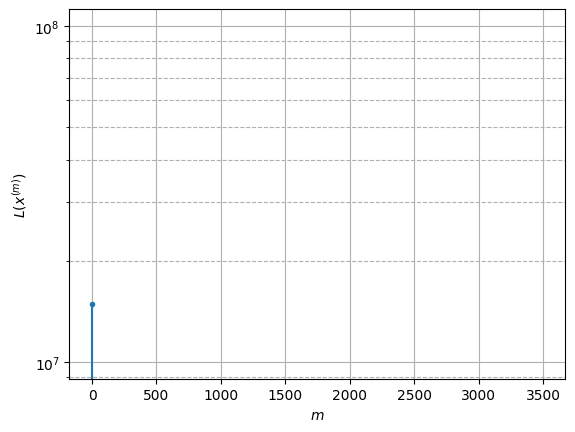

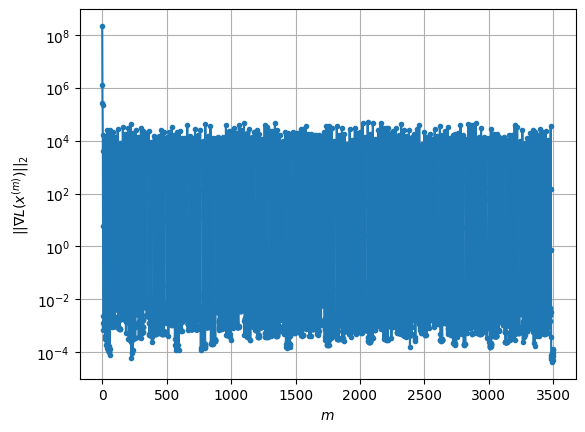

Windows:  47%|████▋     | 175/376 [20:47<26:23,  7.88s/it]

Before applying the algorithm
Cost function: -3151370.693395156
Gradient norm: 15946.260937613919
Global relative error: 54.93161273779571
Position relative errors: 0.028027650653398642 m, 30.04291970849605 m, 10.995563159802275 m, 44.6542164920597 m

Iteration 1
Cost function: -3151372.74311947 (-0.00%)
Gradient norm: 47.14289823881664 (-99.70%)
Global relative error: 38.81204054931821 (-29.34%)
Position relative errors: 0.038065453550955794 m, 20.239139180176267 m, 9.262036738421427 m, 31.795642869701172 m

Iteration 2
Cost function: -3151372.744252282 (-0.00%)
Gradient norm: 0.4434917481923506 (-99.06%)
Global relative error: 38.26347547473017 (-1.41%)
Position relative errors: 0.03806545730969713 m, 19.891447470909473 m, 9.174581373457663 m, 31.37271711661919 m

Iteration 3
Cost function: -3151372.7442522794 (0.00%)
Gradient norm: 0.00025621653217092037 (-99.94%)
Global relative error: 38.2626708139358 (-0.00%)
Position relative errors: 0.03806545654645653 m, 19.89096882466184 m, 9

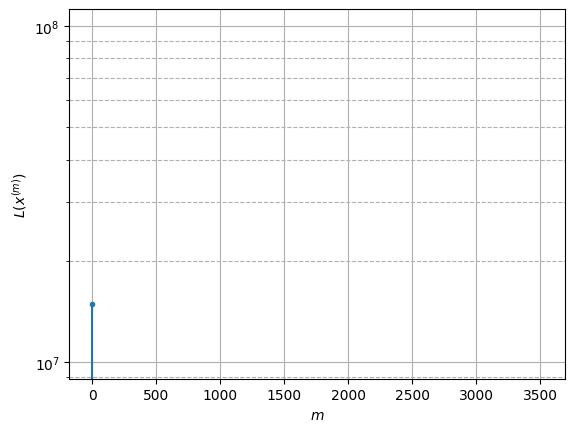

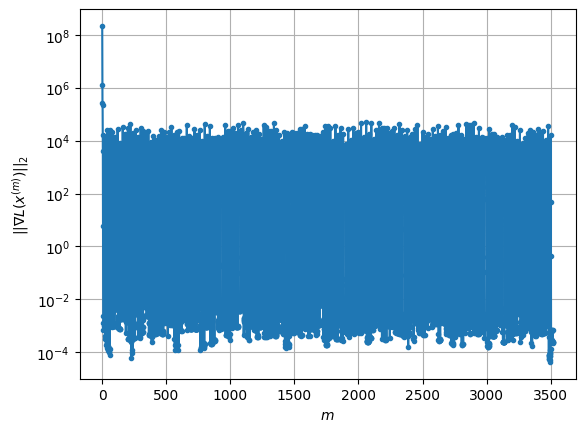

Windows:  47%|████▋     | 176/376 [20:55<26:06,  7.83s/it]

Before applying the algorithm
Cost function: -3151367.4154551486
Gradient norm: 23747.707719822785
Global relative error: 37.081178232018395
Position relative errors: 0.034724184327883774 m, 19.267468419362814 m, 8.084443673980699 m, 30.633593840383142 m

Iteration 1
Cost function: -3151369.9552472904 (-0.00%)
Gradient norm: 81.04352021365429 (-99.66%)
Global relative error: 51.19450692156682 (38.06%)
Position relative errors: 0.03892837706343237 m, 29.158692823430272 m, 17.8430877442729 m, 38.10865002228032 m

Iteration 2
Cost function: -3151369.9565076753 (-0.00%)
Gradient norm: 0.5018760696925632 (-99.38%)
Global relative error: 51.390482016985324 (0.38%)
Position relative errors: 0.03892837826760738 m, 29.334832372781317 m, 18.194940306940246 m, 38.07085768227057 m

Iteration 3
Cost function: -3151369.956507675 (0.00%)
Gradient norm: 0.0013673462969381574 (-99.73%)
Global relative error: 51.39127372005285 (0.00%)
Position relative errors: 0.038928378034096815 m, 29.33530296235703 m

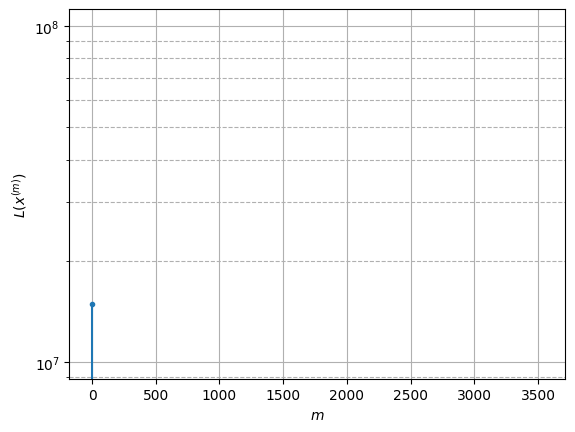

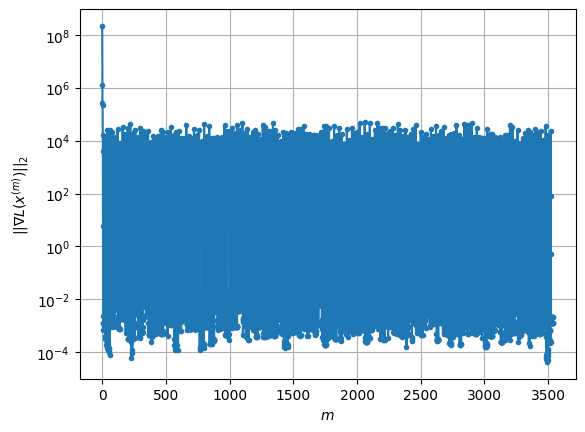

Windows:  47%|████▋     | 177/376 [21:03<25:55,  7.82s/it]

Before applying the algorithm
Cost function: -3151362.726822779
Gradient norm: 22656.244572678937
Global relative error: 49.780472608161766
Position relative errors: 0.03444812972333668 m, 28.539559556073506 m, 17.309376866278214 m, 36.93198796877729 m

Iteration 1
Cost function: -3151365.009104545 (-0.00%)
Gradient norm: 149.92844001034004 (-99.34%)
Global relative error: 40.870246950317664 (-17.90%)
Position relative errors: 0.025401561889160772 m, 23.652871811218834 m, 18.979604635906224 m, 27.39875579142041 m

Iteration 2
Cost function: -3151365.009994077 (-0.00%)
Gradient norm: 0.12268051567973184 (-99.92%)
Global relative error: 40.81786622883067 (-0.13%)
Position relative errors: 0.025401561488654415 m, 23.710225992435873 m, 19.105862990987674 m, 27.182491464471546 m

Iteration 3
Cost function: -3151365.009994096 (-0.00%)
Gradient norm: 0.003510445262753028 (-97.14%)
Global relative error: 40.81770708428938 (-0.00%)
Position relative errors: 0.02540156129215113 m, 23.71015944315

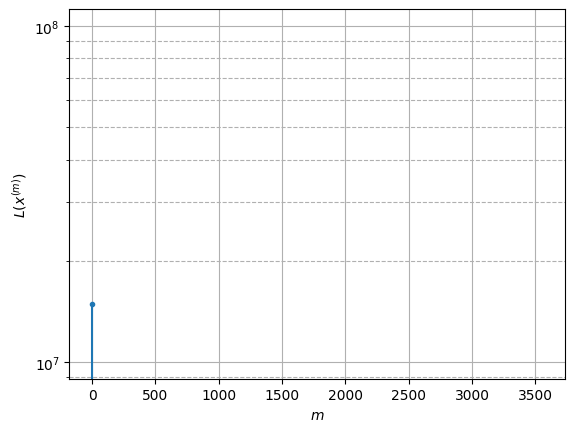

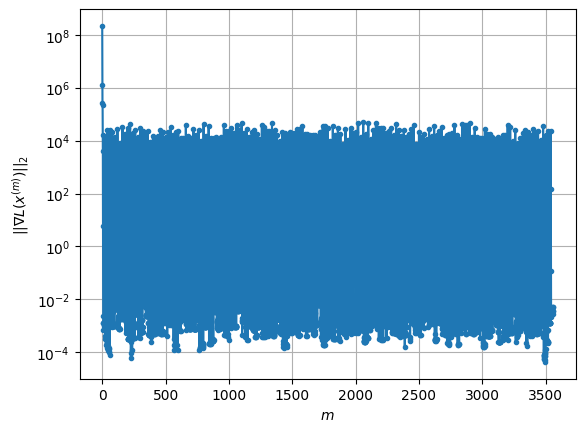

Windows:  47%|████▋     | 178/376 [21:11<25:55,  7.85s/it]

Before applying the algorithm
Cost function: -3151359.660801984
Gradient norm: 22244.59776983863
Global relative error: 40.94728748298829
Position relative errors: 0.024304743132792968 m, 23.796895798318094 m, 19.055757599833232 m, 27.336146282297754 m

Iteration 1
Cost function: -3151360.9128997447 (-0.00%)
Gradient norm: 46.452109729212495 (-99.79%)
Global relative error: 29.43976982661118 (-28.10%)
Position relative errors: 0.03774888371386943 m, 14.482849795132292 m, 17.849662969914785 m, 18.393857903499374 m

Iteration 2
Cost function: -3151360.9131510817 (-0.00%)
Gradient norm: 0.02069183804989669 (-99.96%)
Global relative error: 29.29411654132695 (-0.49%)
Position relative errors: 0.03774888574718735 m, 14.370894613685616 m, 17.757633942082037 m, 18.338114426382464 m

Iteration 3
Cost function: -3151360.9131510826 (-0.00%)
Gradient norm: 0.0002519313510274202 (-98.78%)
Global relative error: 29.293966831675412 (-0.00%)
Position relative errors: 0.037748886650489255 m, 14.3708146

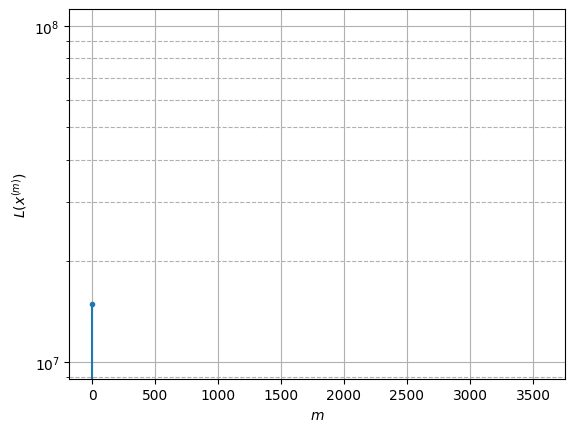

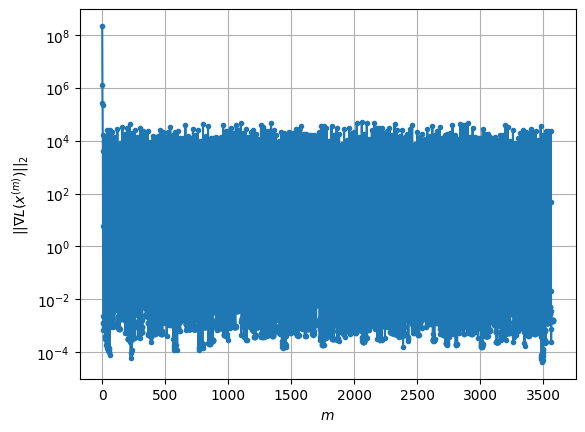

Windows:  48%|████▊     | 179/376 [21:19<25:58,  7.91s/it]

Before applying the algorithm
Cost function: -3151353.28128323
Gradient norm: 20535.518254452054
Global relative error: 30.647068167324235
Position relative errors: 0.03378755102320941 m, 15.19917086173326 m, 18.3303888124868 m, 19.293072291603835 m

Iteration 1
Cost function: -3151357.272827526 (-0.00%)
Gradient norm: 137.9970801327911 (-99.33%)
Global relative error: 32.402302198226515 (5.73%)
Position relative errors: 0.07865448587424062 m, 18.49917339982562 m, 11.235765127148069 m, 24.113058614210566 m

Iteration 2
Cost function: -3151357.276242098 (-0.00%)
Gradient norm: 0.8046954693224253 (-99.42%)
Global relative error: 32.44004768410508 (0.12%)
Position relative errors: 0.07865448970592467 m, 18.561058025579072 m, 12.236257049848515 m, 23.624354202265526 m

Iteration 3
Cost function: -3151357.276242145 (-0.00%)
Gradient norm: 0.001000006688982288 (-99.88%)
Global relative error: 32.43986344133579 (-0.00%)
Position relative errors: 0.07865448906682412 m, 18.560830922805124 m, 12

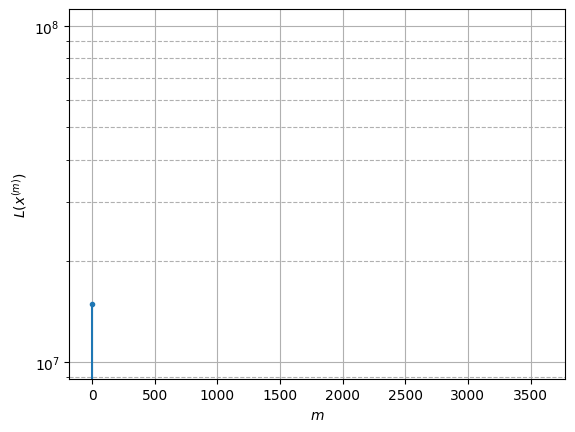

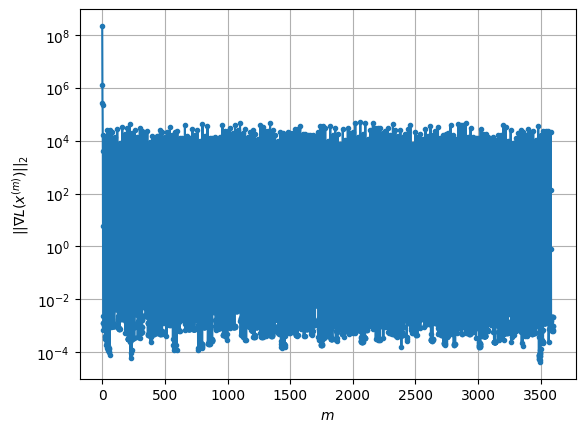

Windows:  48%|████▊     | 180/376 [21:27<25:55,  7.94s/it]

Before applying the algorithm
Cost function: -3151351.4654819123
Gradient norm: 23697.571835318784
Global relative error: 33.646155220602424
Position relative errors: 0.06954043307175502 m, 19.423857370157485 m, 13.319641895112337 m, 24.028284661590934 m

Iteration 1
Cost function: -3151354.097618586 (-0.00%)
Gradient norm: 60.928104060598415 (-99.74%)
Global relative error: 24.285510925602456 (-27.82%)
Position relative errors: 0.0330039269291934 m, 13.502865512247572 m, 8.903156283951951 m, 18.115985611764234 m

Iteration 2
Cost function: -3151354.0981039573 (-0.00%)
Gradient norm: 0.25511614212466405 (-99.58%)
Global relative error: 23.891030070212683 (-1.62%)
Position relative errors: 0.03300392592128248 m, 13.3014024351384 m, 8.780597899688205 m, 17.797513672155873 m

Iteration 3
Cost function: -3151354.0981039475 (0.00%)
Gradient norm: 0.0019846188814683996 (-99.22%)
Global relative error: 23.890588054875177 (-0.00%)
Position relative errors: 0.03300392683612499 m, 13.30115858768

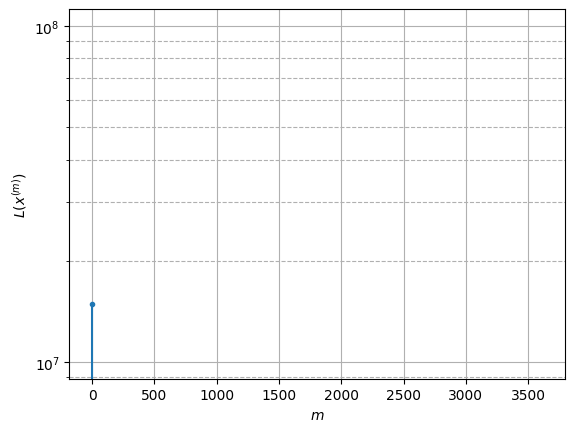

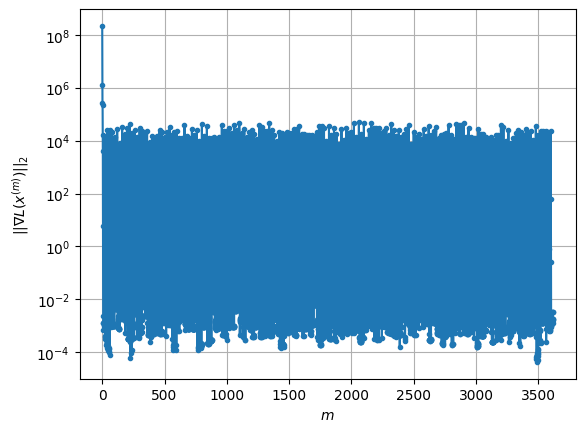

Windows:  48%|████▊     | 181/376 [21:35<25:37,  7.89s/it]

Before applying the algorithm
Cost function: -3151350.2865890344
Gradient norm: 34908.10341548145
Global relative error: 25.7224855842443
Position relative errors: 0.028728672963645053 m, 14.230538218215845 m, 10.871726162102707 m, 18.4645717058574 m

Iteration 1
Cost function: -3151353.907506921 (-0.00%)
Gradient norm: 177.2293806440857 (-99.49%)
Global relative error: 27.253944279140615 (5.95%)
Position relative errors: 0.030322719547797475 m, 12.010561510578885 m, 10.351882667999885 m, 22.166651105116262 m

Iteration 2
Cost function: -3151353.915433317 (-0.00%)
Gradient norm: 4.864968246409711 (-97.25%)
Global relative error: 25.594957640914934 (-6.09%)
Position relative errors: 0.030322724215429014 m, 11.32220530125106 m, 9.141404210985947 m, 21.055688188714456 m

Iteration 3
Cost function: -3151353.915433719 (-0.00%)
Gradient norm: 0.0038425927386789758 (-99.92%)
Global relative error: 25.591058564817672 (-0.02%)
Position relative errors: 0.030322723071179294 m, 11.320157326119348

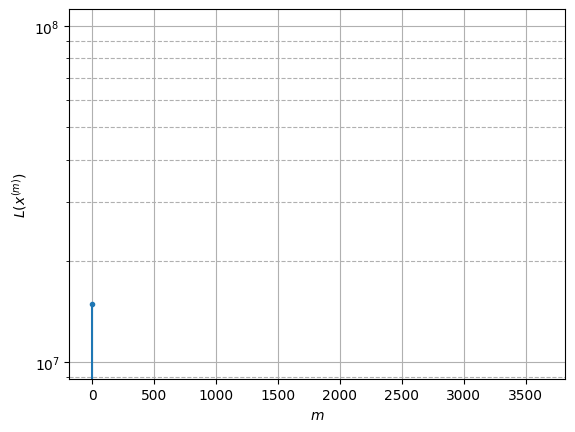

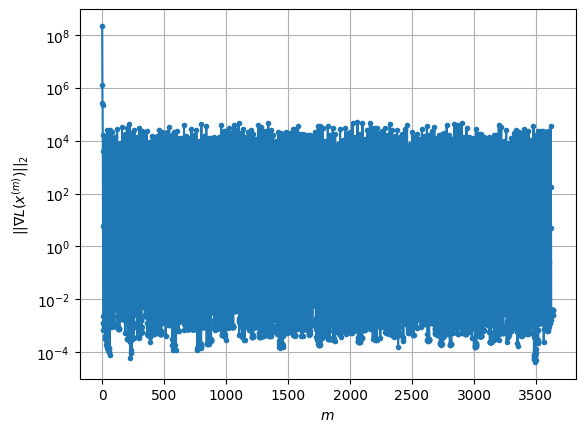

Windows:  48%|████▊     | 182/376 [21:42<25:15,  7.81s/it]

Before applying the algorithm
Cost function: -3151351.730674244
Gradient norm: 37758.01766661279
Global relative error: 26.502493523167686
Position relative errors: 0.02604564496012668 m, 11.71697815673791 m, 10.972654644639258 m, 21.08775750974317 m

Iteration 1
Cost function: -3151356.7599824537 (-0.00%)
Gradient norm: 76.11323851104271 (-99.80%)
Global relative error: 24.87980266843463 (-6.12%)
Position relative errors: 0.022332936409721595 m, 2.461118572242691 m, 11.31216533905928 m, 22.022236289212007 m

Iteration 2
Cost function: -3151356.761398661 (-0.00%)
Gradient norm: 0.315122150371293 (-99.59%)
Global relative error: 24.94451775337969 (0.26%)
Position relative errors: 0.022332934401796997 m, 2.2905216271738396 m, 11.418780864651378 m, 22.05879461755633 m

Iteration 3
Cost function: -3151356.76139866 (0.00%)
Gradient norm: 0.0006011673975733573 (-99.81%)
Global relative error: 24.944567563164938 (0.00%)
Position relative errors: 0.022332934401796997 m, 2.2902873034907016 m, 1

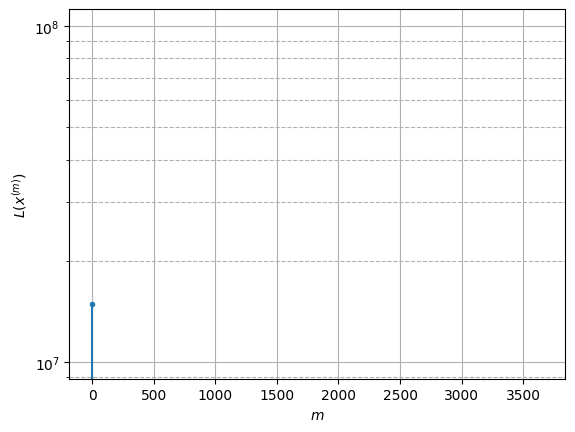

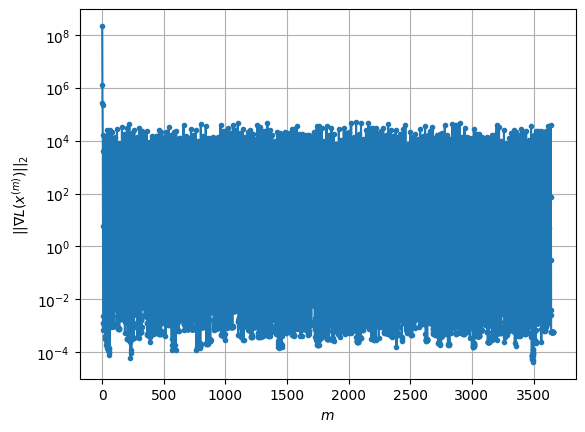

Windows:  49%|████▊     | 183/376 [21:50<24:34,  7.64s/it]

Before applying the algorithm
Cost function: -3151348.442251968
Gradient norm: 19190.19212849766
Global relative error: 24.48776669924955
Position relative errors: 0.020708810527960413 m, 3.2447975725415192 m, 10.449452015787319 m, 21.907249925012906 m

Iteration 1
Cost function: -3151352.5603303625 (-0.00%)
Gradient norm: 39.769277029736585 (-99.79%)
Global relative error: 16.90147808442324 (-30.98%)
Position relative errors: 0.017036823371133117 m, 6.956818545673804 m, 11.28553146706177 m, 10.483114786003947 m

Iteration 2
Cost function: -3151352.561205646 (-0.00%)
Gradient norm: 0.4032837377426097 (-98.99%)
Global relative error: 16.783360938206894 (-0.70%)
Position relative errors: 0.017036820472442087 m, 7.204192665478559 m, 11.350829486488873 m, 10.046673642662455 m

Iteration 3
Cost function: -3151352.5612056395 (0.00%)
Gradient norm: 0.00030677842251998277 (-99.92%)
Global relative error: 16.783272720621095 (-0.00%)
Position relative errors: 0.01703682003365427 m, 7.20441496865

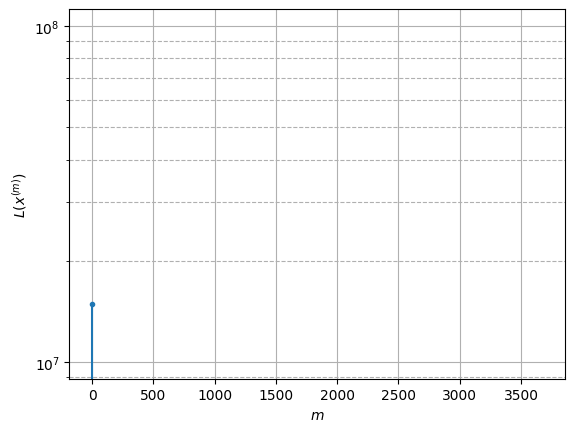

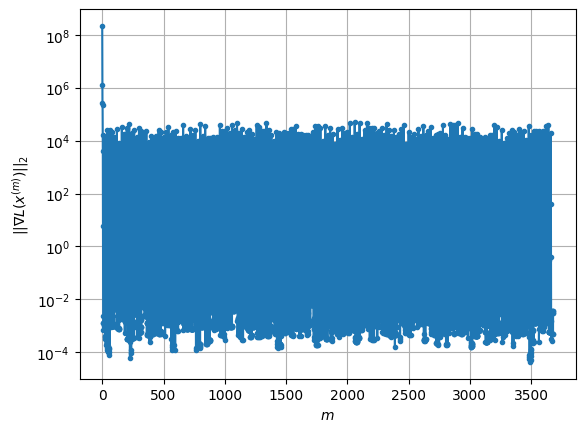

Windows:  49%|████▉     | 184/376 [21:57<24:03,  7.52s/it]

Before applying the algorithm
Cost function: -3151354.085216921
Gradient norm: 24991.14550661461
Global relative error: 16.600679936028786
Position relative errors: 0.016783625444844272 m, 5.703283625617263 m, 11.663075792938354 m, 10.345243744627204 m

Iteration 1
Cost function: -3151356.5530071356 (-0.00%)
Gradient norm: 110.0665299411796 (-99.56%)
Global relative error: 31.193231420373724 (87.90%)
Position relative errors: 0.04026237787916625 m, 9.091943265714685 m, 13.316129668211135 m, 26.70263949667626 m

Iteration 2
Cost function: -3151356.555017128 (-0.00%)
Gradient norm: 0.5009906104254416 (-99.54%)
Global relative error: 30.161431395007753 (-3.31%)
Position relative errors: 0.04026237629402064 m, 8.575509674620566 m, 12.974344828993454 m, 25.842501894510104 m

Iteration 3
Cost function: -3151356.555017131 (-0.00%)
Gradient norm: 0.0026716091980462722 (-99.47%)
Global relative error: 30.159384684863994 (-0.01%)
Position relative errors: 0.04026237594861862 m, 8.574394319973221

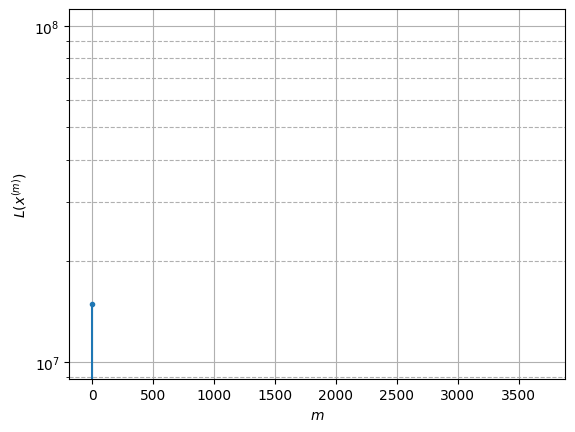

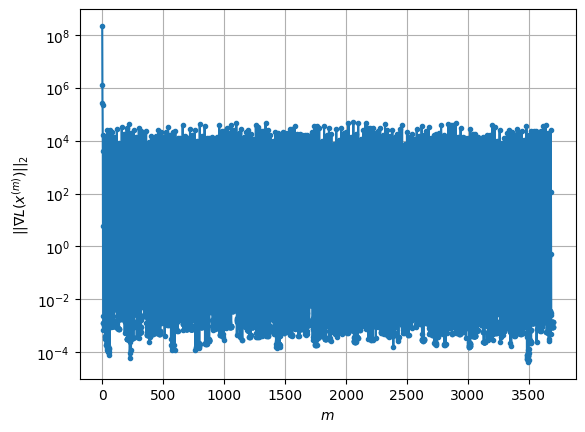

Windows:  49%|████▉     | 185/376 [22:04<23:27,  7.37s/it]

Before applying the algorithm
Cost function: -3151351.198304816
Gradient norm: 19725.5208702218
Global relative error: 29.85354454106434
Position relative errors: 0.036611617900456056 m, 8.881940458905238 m, 14.075678861158801 m, 24.783398757526683 m

Iteration 1
Cost function: -3151353.7988975244 (-0.00%)
Gradient norm: 148.11771135335104 (-99.25%)
Global relative error: 29.828056507761833 (-0.09%)
Position relative errors: 0.046030297946961445 m, 4.318390939335448 m, 17.258443978521402 m, 23.941609750456436 m

Iteration 2
Cost function: -3151353.803905436 (-0.00%)
Gradient norm: 0.732765890229906 (-99.51%)
Global relative error: 29.75231062042071 (-0.25%)
Position relative errors: 0.046030297074817914 m, 4.173521563351764 m, 17.783355675802905 m, 23.48455355557086 m

Iteration 3
Cost function: -3151353.80390549 (-0.00%)
Gradient norm: 0.0012895382045170515 (-99.82%)
Global relative error: 29.753059484700497 (0.00%)
Position relative errors: 0.046030296777644635 m, 4.173496278319447 m

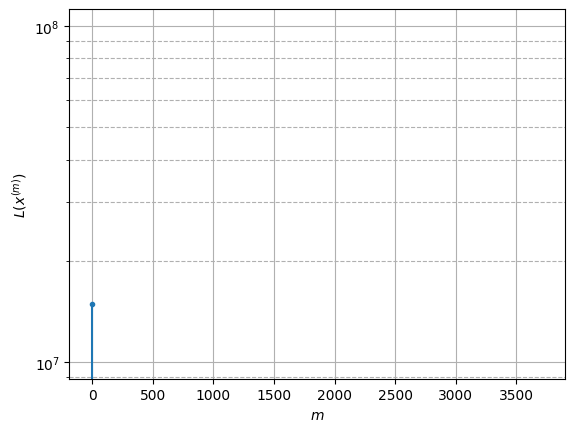

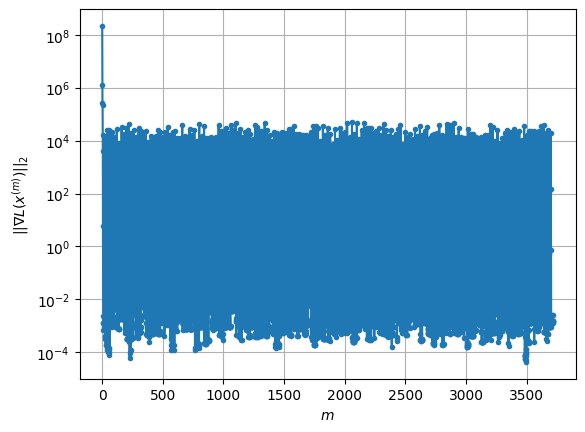

Windows:  49%|████▉     | 186/376 [22:11<23:08,  7.31s/it]

Before applying the algorithm
Cost function: -3151350.4149711267
Gradient norm: 13633.549691317858
Global relative error: 26.117821355180094
Position relative errors: 0.04185485223063118 m, 4.079260454263926 m, 14.340073453214456 m, 21.44418786056319 m

Iteration 1
Cost function: -3151354.90436975 (-0.00%)
Gradient norm: 115.30016663537684 (-99.15%)
Global relative error: 19.431693430867337 (-25.60%)
Position relative errors: 0.050597227937226166 m, 1.5489680929953864 m, 14.655534348233282 m, 12.66486775252821 m

Iteration 2
Cost function: -3151354.907015719 (-0.00%)
Gradient norm: 0.7516785133059505 (-99.35%)
Global relative error: 19.358389770573844 (-0.38%)
Position relative errors: 0.050597229174570435 m, 1.7963590256356583 m, 14.70938462023001 m, 12.45579070387817 m

Iteration 3
Cost function: -3151354.90701573 (-0.00%)
Gradient norm: 0.0003471263880021082 (-99.95%)
Global relative error: 19.358283751253374 (-0.00%)
Position relative errors: 0.050597229385581366 m, 1.7963716152489

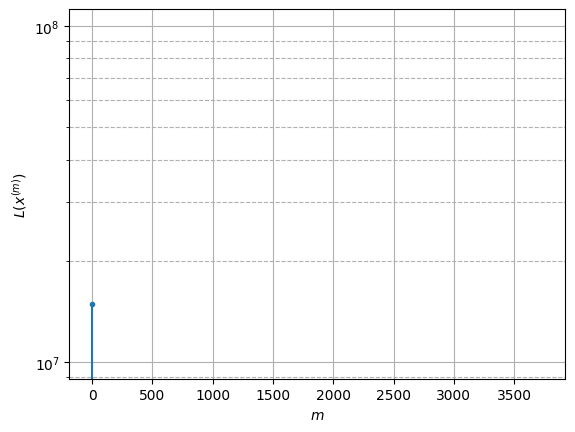

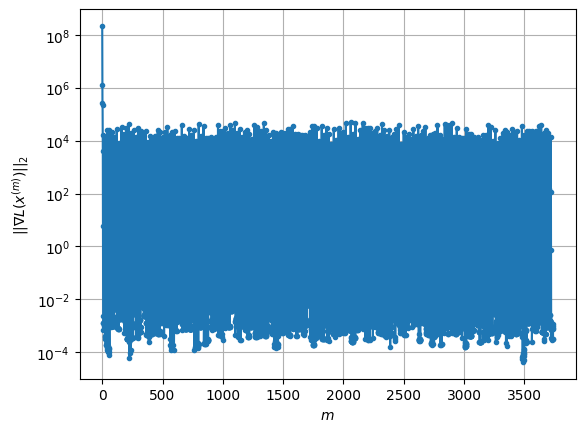

Windows:  50%|████▉     | 187/376 [22:18<23:00,  7.30s/it]

Before applying the algorithm
Cost function: -3151350.7657368644
Gradient norm: 29922.276547453563
Global relative error: 18.98284571892641
Position relative errors: 0.04687167987083344 m, 1.4916725814811538 m, 15.328240470609396 m, 11.097804890454166 m

Iteration 1
Cost function: -3151352.684095106 (-0.00%)
Gradient norm: 127.67430705815086 (-99.57%)
Global relative error: 32.96328174439207 (73.65%)
Position relative errors: 0.03331591286359123 m, 6.879924123717557 m, 27.42502797847555 m, 16.94425857723527 m

Iteration 2
Cost function: -3151352.685522366 (-0.00%)
Gradient norm: 0.37364433545405634 (-99.71%)
Global relative error: 32.39558000237899 (-1.72%)
Position relative errors: 0.0333159153117577 m, 6.574677853571928 m, 27.167532993517426 m, 16.375832309106464 m

Iteration 3
Cost function: -3151352.685522378 (-0.00%)
Gradient norm: 0.000603067398777668 (-99.84%)
Global relative error: 32.39398085979671 (-0.00%)
Position relative errors: 0.03331591510268931 m, 6.573985945407044 m, 

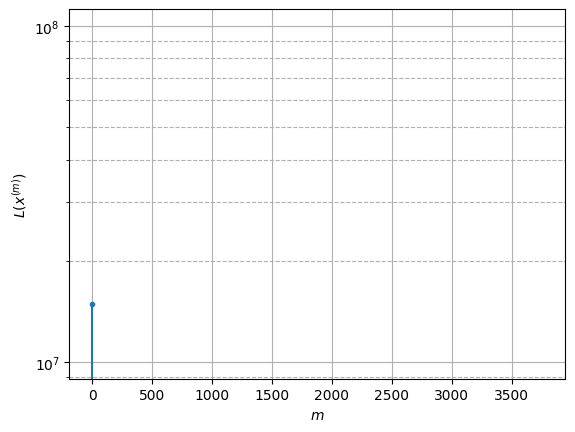

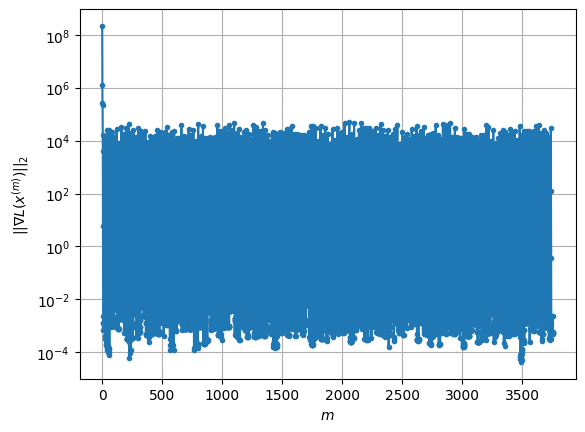

Windows:  50%|█████     | 188/376 [22:26<23:02,  7.35s/it]

Before applying the algorithm
Cost function: -3151352.196525666
Gradient norm: 15908.236061697988
Global relative error: 32.81506241583336
Position relative errors: 0.030716874204102896 m, 5.762079274644259 m, 28.93589002245175 m, 14.364431559617623 m

Iteration 1
Cost function: -3151354.7964812703 (-0.00%)
Gradient norm: 30.013269017723626 (-99.81%)
Global relative error: 34.74332725979911 (5.88%)
Position relative errors: 0.06185401802473373 m, 14.413796775941236 m, 24.88062170247843 m, 19.500995563015177 m

Iteration 2
Cost function: -3151354.796956196 (-0.00%)
Gradient norm: 0.14422938225675355 (-99.52%)
Global relative error: 34.48775012603205 (-0.74%)
Position relative errors: 0.06185401432037508 m, 14.336243175305947 m, 24.7046636447415 m, 19.327431267755014 m

Iteration 3
Cost function: -3151354.7969561857 (0.00%)
Gradient norm: 0.005089045685080642 (-96.47%)
Global relative error: 34.4875610461832 (-0.00%)
Position relative errors: 0.0618540144628142 m, 14.336140235381766 m, 2

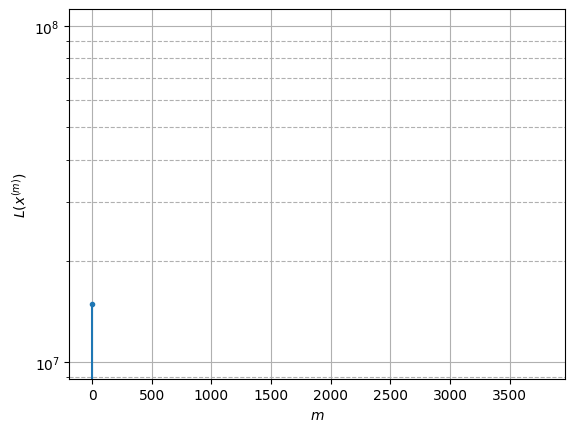

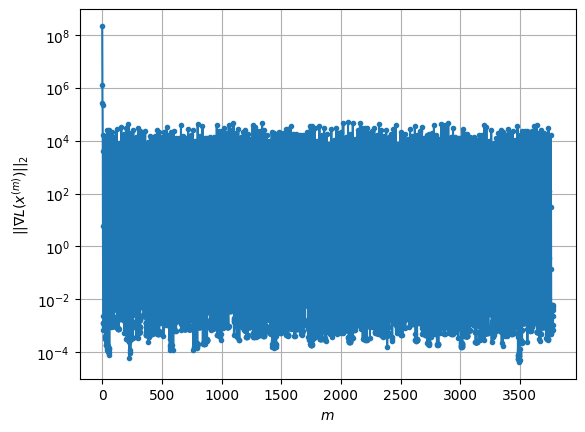

Windows:  50%|█████     | 189/376 [22:33<23:03,  7.40s/it]

Before applying the algorithm
Cost function: -3151353.4072313295
Gradient norm: 29219.083066133102
Global relative error: 34.182846741730565
Position relative errors: 0.05519021328727172 m, 12.900644879214976 m, 26.580814568462465 m, 17.18995117018511 m

Iteration 1
Cost function: -3151357.9558992763 (-0.00%)
Gradient norm: 52.7936495547977 (-99.82%)
Global relative error: 32.34585658967437 (-5.37%)
Position relative errors: 0.10669344873679833 m, 10.255495769306293 m, 29.70993529150099 m, 7.641051831743718 m

Iteration 2
Cost function: -3151357.956273953 (-0.00%)
Gradient norm: 0.04059826785863032 (-99.92%)
Global relative error: 31.94493882801579 (-1.24%)
Position relative errors: 0.10669344797994364 m, 10.035688604289504 m, 29.37725476438616 m, 7.531776341742348 m

Iteration 3
Cost function: -3151357.956273969 (-0.00%)
Gradient norm: 0.001637556672695566 (-95.97%)
Global relative error: 31.944774655267317 (-0.00%)
Position relative errors: 0.10669344733829865 m, 10.035559723258181 m

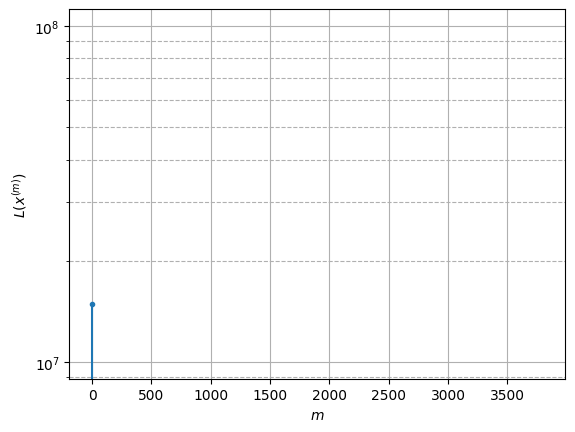

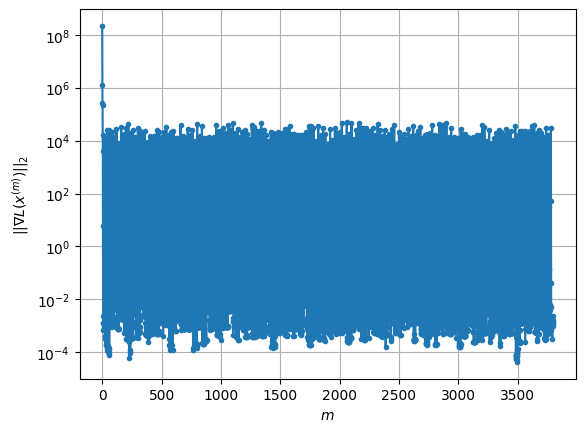

Windows:  51%|█████     | 190/376 [22:41<22:52,  7.38s/it]

Before applying the algorithm
Cost function: -3151354.053531208
Gradient norm: 31504.117022574774
Global relative error: 32.52471455949982
Position relative errors: 0.09469683417577493 m, 8.889155812918952 m, 30.76265376923246 m, 5.699845848784892 m

Iteration 1
Cost function: -3151358.158810244 (-0.00%)
Gradient norm: 153.79301461258893 (-99.51%)
Global relative error: 54.68084541914164 (68.12%)
Position relative errors: 0.09837563677963557 m, 21.674654394068806 m, 47.21399069149628 m, 17.059629042757418 m

Iteration 2
Cost function: -3151358.161614599 (-0.00%)
Gradient norm: 0.1529114601691137 (-99.90%)
Global relative error: 53.841371634404084 (-1.54%)
Position relative errors: 0.09837564312025426 m, 21.37468374630553 m, 46.57594013898941 m, 16.513197829186222 m

Iteration 3
Cost function: -3151358.161614605 (-0.00%)
Gradient norm: 0.0005510725821693863 (-99.64%)
Global relative error: 53.83780854415397 (-0.01%)
Position relative errors: 0.09837564293416266 m, 21.373360726540835 m, 

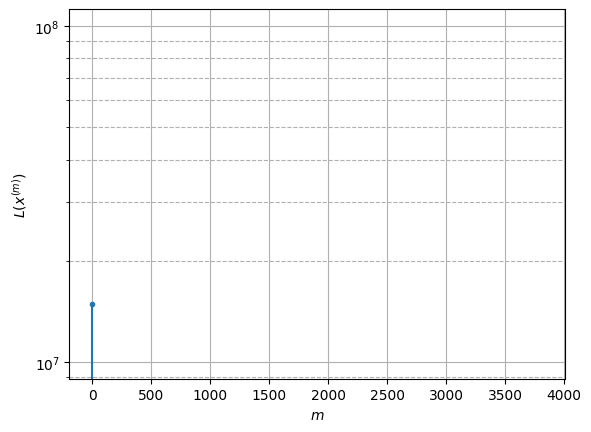

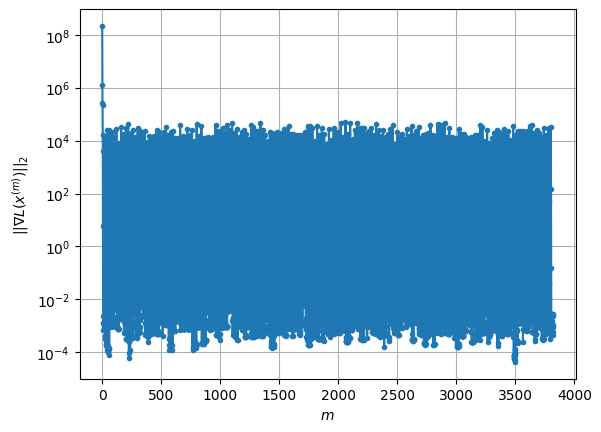

Windows:  51%|█████     | 191/376 [22:48<22:42,  7.37s/it]

Before applying the algorithm
Cost function: -3151359.0872099004
Gradient norm: 24574.90890615082
Global relative error: 52.571521396534166
Position relative errors: 0.08937773068312758 m, 19.139988601549998 m, 46.741495825743115 m, 14.582439907804511 m

Iteration 1
Cost function: -3151361.44049528 (-0.00%)
Gradient norm: 39.001442950916285 (-99.84%)
Global relative error: 63.63394861969156 (21.04%)
Position relative errors: 0.07617587688131676 m, 26.13039028010315 m, 57.182126952861125 m, 9.832521341643236 m

Iteration 2
Cost function: -3151361.4410188356 (-0.00%)
Gradient norm: 0.024850750004716874 (-99.94%)
Global relative error: 63.24502271212003 (-0.61%)
Position relative errors: 0.0761758796610977 m, 25.997769545029342 m, 56.81885540119236 m, 9.780519632029803 m

Iteration 3
Cost function: -3151361.441018811 (0.00%)
Gradient norm: 0.004820945437041545 (-80.60%)
Global relative error: 63.24478936792457 (-0.00%)
Position relative errors: 0.0761758795788294 m, 25.997664127608292 m, 

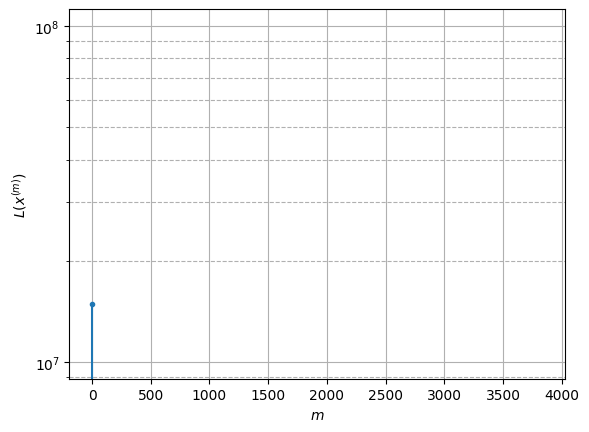

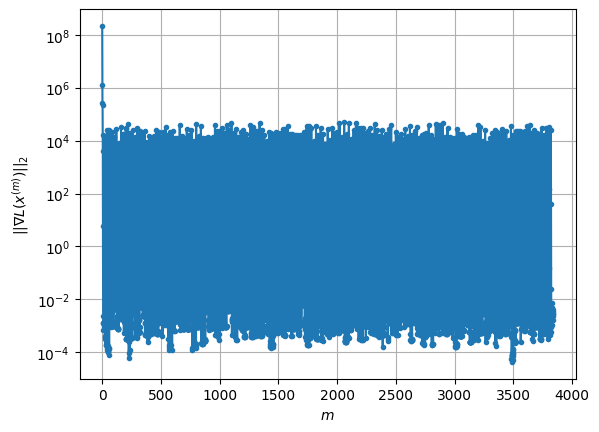

Windows:  51%|█████     | 192/376 [22:55<22:33,  7.35s/it]

Before applying the algorithm
Cost function: -3151350.416119083
Gradient norm: 36192.46568337745
Global relative error: 61.438309184760634
Position relative errors: 0.06911111000628382 m, 23.813454867480186 m, 55.9696962905316 m, 8.65858917748593 m

Iteration 1
Cost function: -3151353.8277487135 (-0.00%)
Gradient norm: 180.46196459482377 (-99.50%)
Global relative error: 57.86068818049872 (-5.82%)
Position relative errors: 0.03461998898945959 m, 25.383964601561654 m, 48.32266467859635 m, 19.194526442683124 m

Iteration 2
Cost function: -3151353.829410975 (-0.00%)
Gradient norm: 0.467464329532011 (-99.74%)
Global relative error: 58.131943046102435 (0.47%)
Position relative errors: 0.034619990042414873 m, 25.75517063215634 m, 48.37614971750694 m, 19.383971268076625 m

Iteration 3
Cost function: -3151353.829410972 (0.00%)
Gradient norm: 0.0010963812455458835 (-99.77%)
Global relative error: 58.13216200394299 (0.00%)
Position relative errors: 0.034619989932661986 m, 25.75566819842603 m, 48.

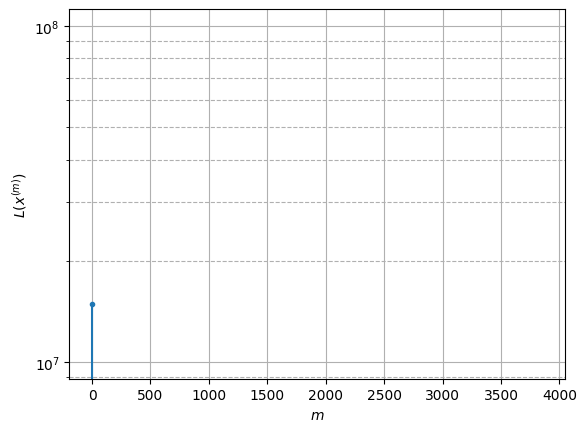

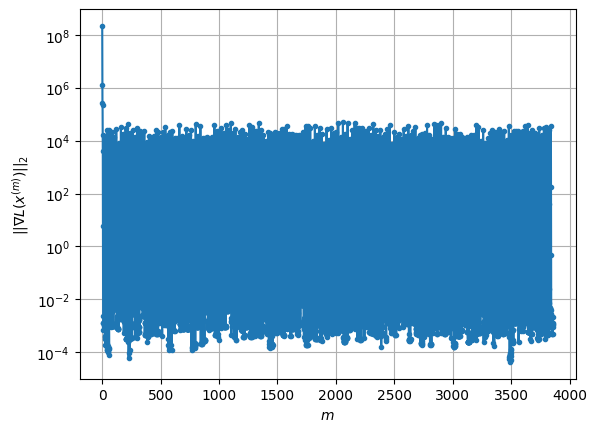

Windows:  51%|█████▏    | 193/376 [23:02<22:17,  7.31s/it]

Before applying the algorithm
Cost function: -3151352.8984778593
Gradient norm: 15848.319481795892
Global relative error: 56.166680023384544
Position relative errors: 0.03144237374770296 m, 23.911352414223163 m, 47.85206048976887 m, 17.120739513982663 m

Iteration 1
Cost function: -3151355.6381243924 (-0.00%)
Gradient norm: 146.18600082176528 (-99.08%)
Global relative error: 77.89416537071378 (38.68%)
Position relative errors: 0.054242761905809816 m, 36.49862196878764 m, 64.1120887375116 m, 24.99965824132087 m

Iteration 2
Cost function: -3151355.641121711 (-0.00%)
Gradient norm: 0.8631896352302111 (-99.41%)
Global relative error: 77.65816845742722 (-0.30%)
Position relative errors: 0.054242762740704345 m, 36.69606505937838 m, 63.653404797609966 m, 25.148063472016556 m

Iteration 3
Cost function: -3151355.6411217 (0.00%)
Gradient norm: 0.00454614903342928 (-99.47%)
Global relative error: 77.65772394027056 (-0.00%)
Position relative errors: 0.05424276265723998 m, 36.69643051196698 m, 63

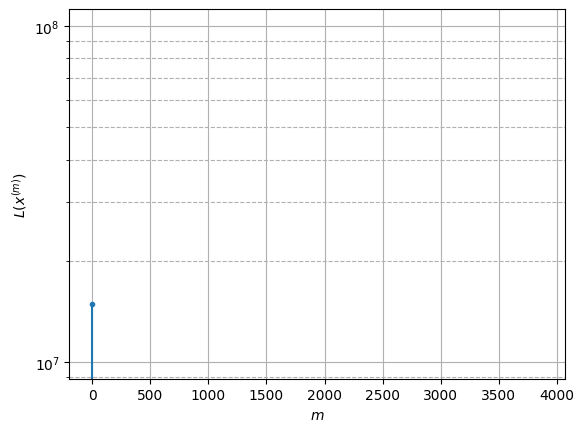

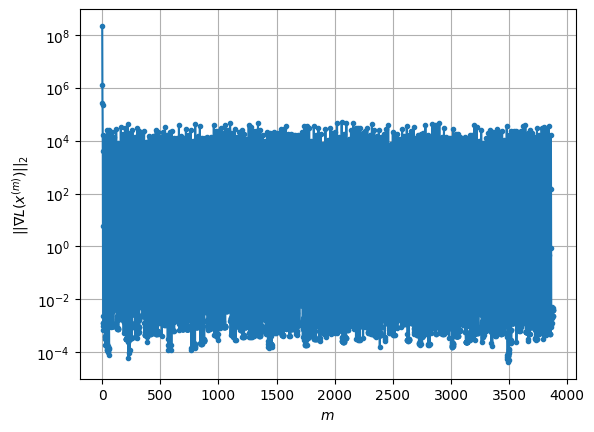

Windows:  52%|█████▏    | 194/376 [23:10<22:25,  7.39s/it]

Before applying the algorithm
Cost function: -3151349.7884669155
Gradient norm: 41681.14449776403
Global relative error: 73.66815131829063
Position relative errors: 0.04959880451639122 m, 34.24351836780431 m, 61.39430081764323 m, 22.025186328594753 m

Iteration 1
Cost function: -3151355.5477071586 (-0.00%)
Gradient norm: 119.90038016303747 (-99.71%)
Global relative error: 60.435836767050404 (-17.96%)
Position relative errors: 0.06451728574217575 m, 35.027187774545965 m, 35.19432126672002 m, 34.45192681726599 m

Iteration 2
Cost function: -3151355.5581198083 (-0.00%)
Gradient norm: 2.6728671201876484 (-97.77%)
Global relative error: 60.48916118421809 (0.09%)
Position relative errors: 0.06451729025594859 m, 35.60280539309818 m, 34.448040121188754 m, 34.70879508765487 m

Iteration 3
Cost function: -3151355.558120059 (-0.00%)
Gradient norm: 0.001346820350226493 (-99.95%)
Global relative error: 60.4886475178527 (-0.00%)
Position relative errors: 0.06451729045163551 m, 35.6040249116278 m, 34

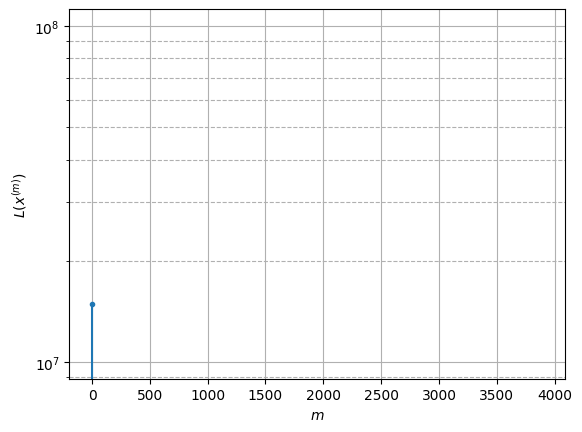

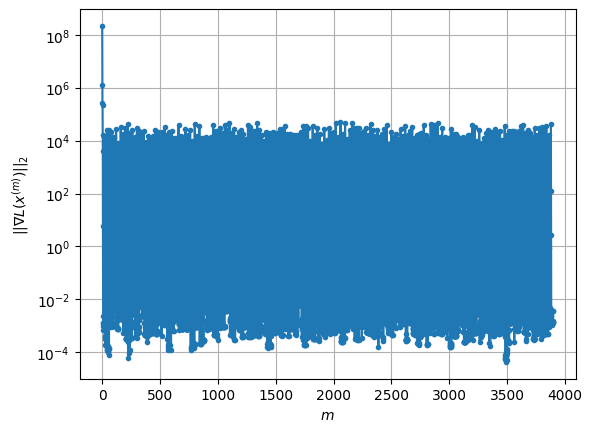

Windows:  52%|█████▏    | 195/376 [23:17<22:12,  7.36s/it]

Before applying the algorithm
Cost function: -3151346.702718045
Gradient norm: 16219.8389951514
Global relative error: 56.30579280199463
Position relative errors: 0.05942354233168136 m, 32.97420382550098 m, 33.88951073630113 m, 30.57015674655966 m

Iteration 1
Cost function: -3151350.2405613954 (-0.00%)
Gradient norm: 158.4922300512937 (-99.02%)
Global relative error: 54.87286728472234 (-2.54%)
Position relative errors: 0.061074161708191875 m, 33.1126808842966 m, 28.52690414053663 m, 33.178156414226144 m

Iteration 2
Cost function: -3151350.2449801955 (-0.00%)
Gradient norm: 0.899742019138993 (-99.43%)
Global relative error: 55.76067504680003 (1.62%)
Position relative errors: 0.06107415581900144 m, 33.70257443595152 m, 28.723168161551513 m, 33.887476408107545 m

Iteration 3
Cost function: -3151350.2449802225 (-0.00%)
Gradient norm: 0.0021785024682868474 (-99.76%)
Global relative error: 55.762483745885795 (0.00%)
Position relative errors: 0.06107415500923441 m, 33.70374027688654 m, 28.7

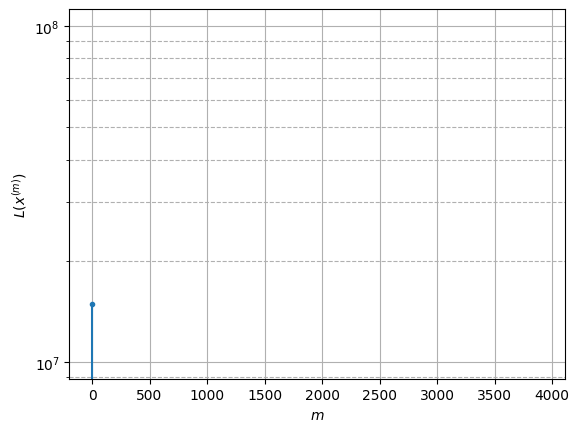

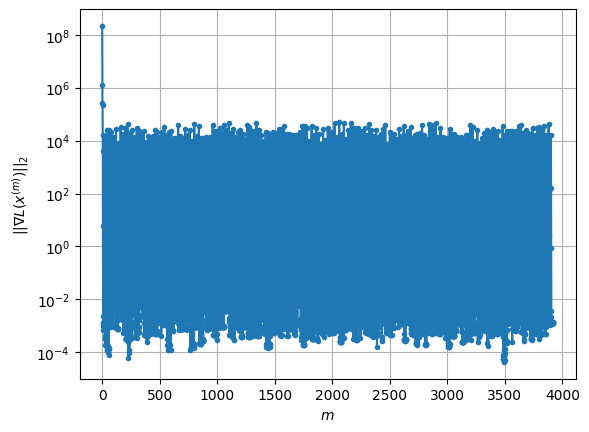

Windows:  52%|█████▏    | 196/376 [23:25<22:43,  7.57s/it]

Before applying the algorithm
Cost function: -3151345.208839524
Gradient norm: 17940.767093885377
Global relative error: 52.15495308259547
Position relative errors: 0.055725366081301464 m, 31.860023371578652 m, 27.783244809366437 m, 30.547694327196673 m

Iteration 1
Cost function: -3151348.1100044474 (-0.00%)
Gradient norm: 384.92477770772103 (-97.85%)
Global relative error: 40.89254829872582 (-21.59%)
Position relative errors: 0.07766978894522704 m, 23.486954822782998 m, 27.46355668480279 m, 19.13921211721023 m

Iteration 2
Cost function: -3151348.1148097995 (-0.00%)
Gradient norm: 2.04149820638131 (-99.47%)
Global relative error: 40.5711723223353 (-0.79%)
Position relative errors: 0.07766979119410679 m, 23.56794811719926 m, 27.311732935449072 m, 18.56432459975327 m

Iteration 3
Cost function: -3151348.1148098987 (-0.00%)
Gradient norm: 0.0008823514791873408 (-99.96%)
Global relative error: 40.5698573252936 (-0.00%)
Position relative errors: 0.0776697920926203 m, 23.56785692261286 m, 

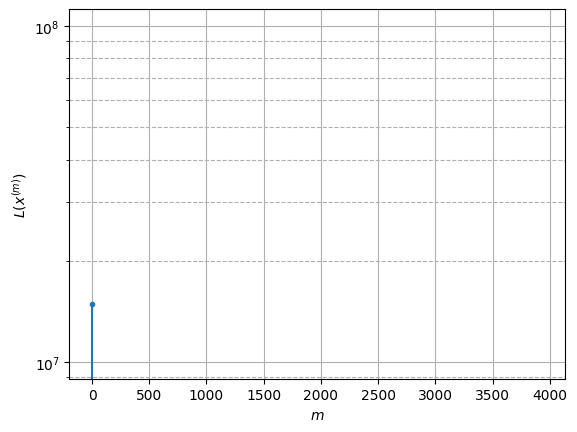

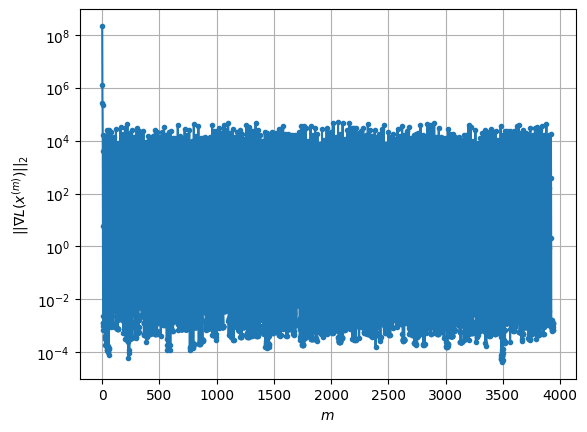

Windows:  52%|█████▏    | 197/376 [23:33<22:57,  7.70s/it]

Before applying the algorithm
Cost function: -3151345.088629866
Gradient norm: 27328.23071216146
Global relative error: 39.120789055556706
Position relative errors: 0.06880065860176822 m, 22.462338829062116 m, 27.03983960539601 m, 17.167433688888163 m

Iteration 1
Cost function: -3151348.2157355784 (-0.00%)
Gradient norm: 119.88251105273862 (-99.56%)
Global relative error: 19.713909176211157 (-49.61%)
Position relative errors: 0.0722906201007875 m, 2.984796860488538 m, 18.698230113374656 m, 5.486349433994512 m

Iteration 2
Cost function: -3151348.217988997 (-0.00%)
Gradient norm: 0.04092341612643617 (-99.97%)
Global relative error: 19.566657216730547 (-0.75%)
Position relative errors: 0.07229062011243478 m, 2.9753463298969867 m, 18.48562334838881 m, 5.68135138512377 m

Iteration 3
Cost function: -3151348.2179890084 (-0.00%)
Gradient norm: 0.00333508586765943 (-91.85%)
Global relative error: 19.566344156799477 (-0.00%)
Position relative errors: 0.07229062001440774 m, 2.975181925220823 m

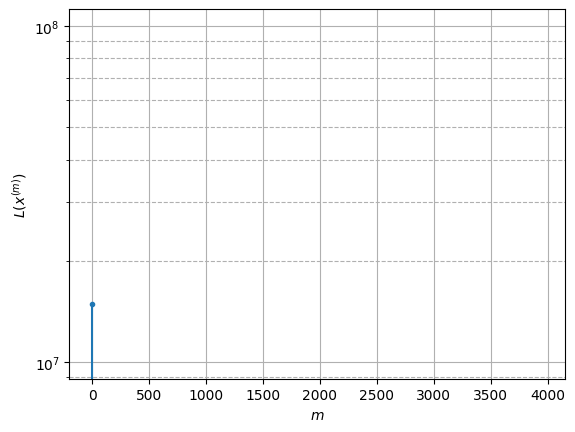

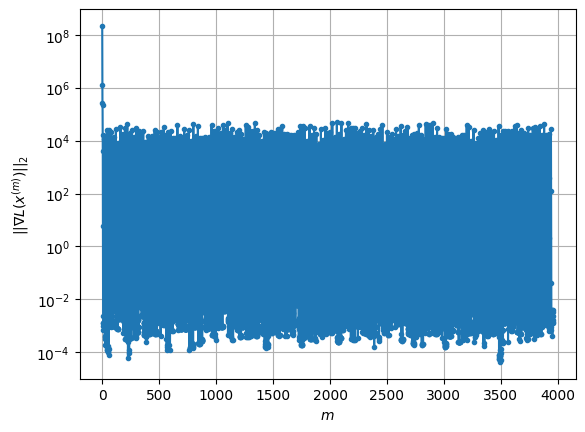

Windows:  53%|█████▎    | 198/376 [23:41<22:54,  7.72s/it]

Before applying the algorithm
Cost function: -3151343.089778873
Gradient norm: 34955.87441881606
Global relative error: 19.87330466346562
Position relative errors: 0.06491084080115757 m, 2.9102731237300485 m, 18.822172812140995 m, 5.6745069761278035 m

Iteration 1
Cost function: -3151348.1991278874 (-0.00%)
Gradient norm: 77.90793972564641 (-99.78%)
Global relative error: 37.74313179864128 (89.92%)
Position relative errors: 0.0881564809954923 m, 16.37533788268189 m, 15.716410673909412 m, 30.155895234395015 m

Iteration 2
Cost function: -3151348.20183944 (-0.00%)
Gradient norm: 0.35115376552457295 (-99.55%)
Global relative error: 36.898990753460595 (-2.24%)
Position relative errors: 0.08815647840571779 m, 16.002621074496897 m, 15.69782064168273 m, 29.30906739887125 m

Iteration 3
Cost function: -3151348.2018394447 (-0.00%)
Gradient norm: 0.003325823322989589 (-99.05%)
Global relative error: 36.89676792768277 (-0.01%)
Position relative errors: 0.0881564778424891 m, 16.001406243098426 m, 

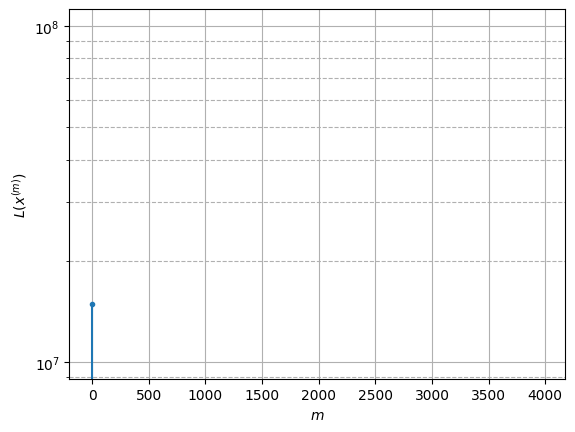

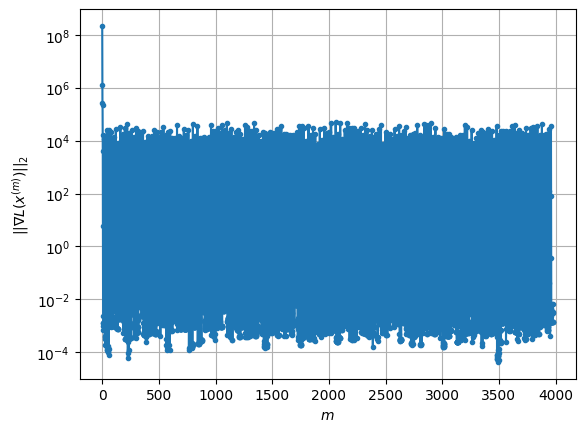

Windows:  53%|█████▎    | 199/376 [23:49<23:03,  7.81s/it]

Before applying the algorithm
Cost function: -3151343.2733349744
Gradient norm: 39083.995497899305
Global relative error: 35.676353675437426
Position relative errors: 0.07746274093269448 m, 14.722106246782024 m, 16.091810490401656 m, 28.233109563027348 m

Iteration 1
Cost function: -3151346.4329171986 (-0.00%)
Gradient norm: 17.449635083926072 (-99.96%)
Global relative error: 25.922823481409395 (-27.34%)
Position relative errors: 0.07441452478688927 m, 8.875334760113022 m, 6.969709963284126 m, 23.337476542281994 m

Iteration 2
Cost function: -3151346.433046595 (-0.00%)
Gradient norm: 0.004640831584534852 (-99.97%)
Global relative error: 25.916405420555282 (-0.02%)
Position relative errors: 0.07441452312649277 m, 8.765782386649864 m, 7.002465563394289 m, 23.36193640991361 m

Iteration 3
Cost function: -3151346.4330466078 (-0.00%)
Gradient norm: 0.0004850643948285212 (-89.55%)
Global relative error: 25.916384078624805 (-0.00%)
Position relative errors: 0.07441452305658332 m, 8.7657455067

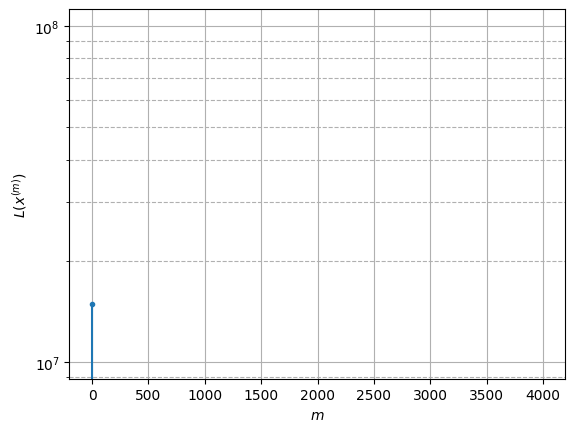

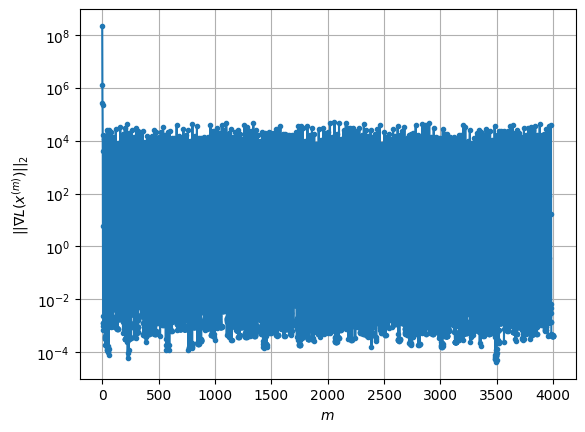

Windows:  53%|█████▎    | 200/376 [23:57<22:56,  7.82s/it]

Before applying the algorithm
Cost function: -3151342.113918589
Gradient norm: 36063.53510999682
Global relative error: 24.59507032101732
Position relative errors: 0.06483427600438565 m, 7.561494408150784 m, 7.543688631883065 m, 22.15465616956241 m

Iteration 1
Cost function: -3151345.7006983417 (-0.00%)
Gradient norm: 166.52080793078977 (-99.54%)
Global relative error: 34.6770443385187 (40.99%)
Position relative errors: 0.0780509338337394 m, 9.545546402357258 m, 14.562486024080066 m, 29.988428209821304 m

Iteration 2
Cost function: -3151345.7025663047 (-0.00%)
Gradient norm: 0.2439011002664372 (-99.85%)
Global relative error: 34.50819270291538 (-0.49%)
Position relative errors: 0.07805093060126247 m, 9.488039321352415 m, 14.507253326853375 m, 29.838296110582707 m

Iteration 3
Cost function: -3151345.702566326 (-0.00%)
Gradient norm: 0.0030735542129786356 (-98.74%)
Global relative error: 34.508038450835215 (-0.00%)
Position relative errors: 0.0780509305083795 m, 9.487942865750894 m, 14

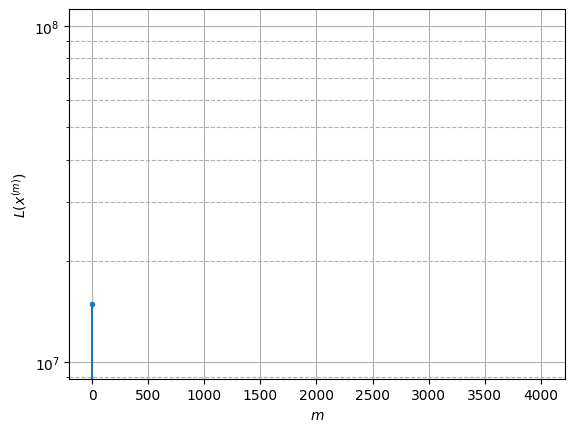

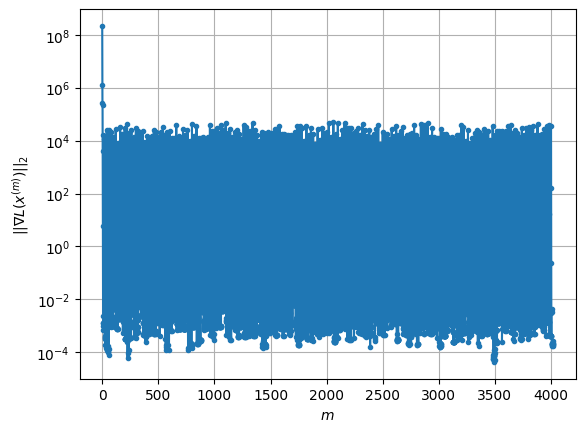

Windows:  53%|█████▎    | 201/376 [24:05<23:01,  7.89s/it]

Before applying the algorithm
Cost function: -3151334.6992277936
Gradient norm: 17851.49392086825
Global relative error: 31.939065397669854
Position relative errors: 0.06947428172163131 m, 8.31749872793468 m, 13.848949898663848 m, 27.55218087996015 m

Iteration 1
Cost function: -3151338.9312406615 (-0.00%)
Gradient norm: 43.01191400411483 (-99.76%)
Global relative error: 34.57559754375501 (8.25%)
Position relative errors: 0.07768349911171728 m, 13.179334737402973 m, 14.6229606137054 m, 28.424252340355192 m

Iteration 2
Cost function: -3151338.9320566924 (-0.00%)
Gradient norm: 0.3768735303899247 (-99.12%)
Global relative error: 34.22274252938967 (-1.02%)
Position relative errors: 0.0776835026787499 m, 12.926604551358068 m, 14.658501071487441 m, 28.093049990204076 m

Iteration 3
Cost function: -3151338.9320566943 (-0.00%)
Gradient norm: 0.0011873544511539972 (-99.68%)
Global relative error: 34.22247421485419 (-0.00%)
Position relative errors: 0.07768350307351363 m, 12.926437788544678 m,

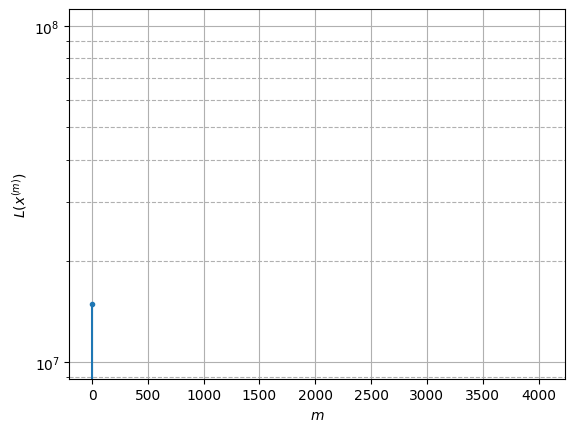

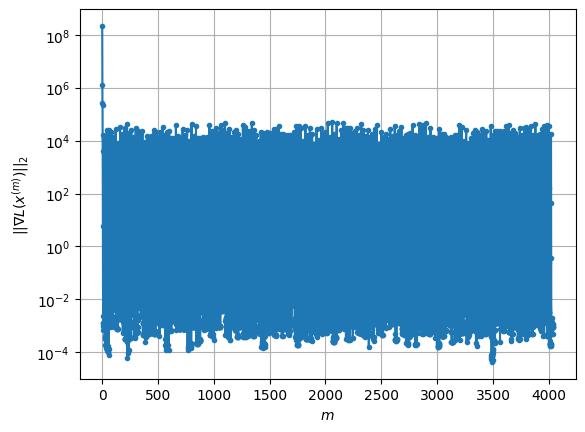

Windows:  54%|█████▎    | 202/376 [24:13<23:02,  7.95s/it]

Before applying the algorithm
Cost function: -3151332.8130944297
Gradient norm: 29256.822775258715
Global relative error: 31.629221379014034
Position relative errors: 0.06856603490941453 m, 11.627147973665195 m, 13.689572473429285 m, 26.034706586140203 m

Iteration 1
Cost function: -3151337.117422452 (-0.00%)
Gradient norm: 60.34195118407573 (-99.79%)
Global relative error: 33.95203932069088 (7.34%)
Position relative errors: 0.013313754472279728 m, 12.530389573474814 m, 4.645520424132627 m, 31.211337716883616 m

Iteration 2
Cost function: -3151337.118954637 (-0.00%)
Gradient norm: 0.2148390599708049 (-99.64%)
Global relative error: 33.98880457944932 (0.11%)
Position relative errors: 0.013313747334232514 m, 12.36447496186571 m, 4.405761961765484 m, 31.351970232574125 m

Iteration 3
Cost function: -3151337.1189546473 (-0.00%)
Gradient norm: 0.002328546557250817 (-98.92%)
Global relative error: 33.98889748738981 (0.00%)
Position relative errors: 0.013313747334232514 m, 12.36436497908232 m

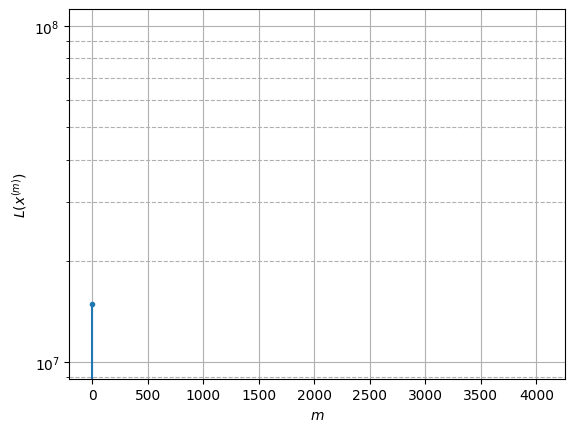

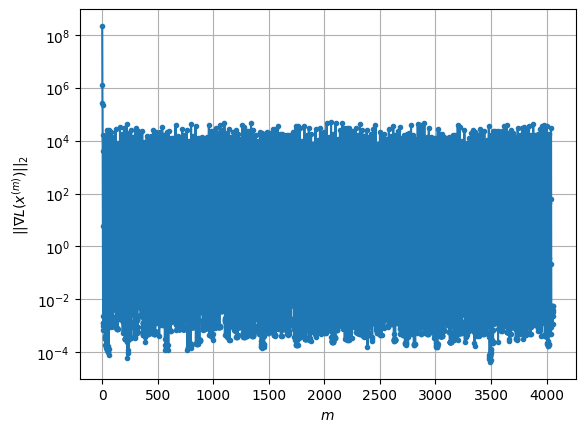

Windows:  54%|█████▍    | 203/376 [24:21<22:51,  7.93s/it]

Before applying the algorithm
Cost function: -3151335.2382582207
Gradient norm: 17237.84172169449
Global relative error: 31.496157392746472
Position relative errors: 0.01492644739372485 m, 11.534899079977993 m, 4.025155262356989 m, 29.030158551040664 m

Iteration 1
Cost function: -3151338.4810585775 (-0.00%)
Gradient norm: 48.18765425473392 (-99.72%)
Global relative error: 25.406216781671905 (-19.34%)
Position relative errors: 0.012074188703223776 m, 3.1484667705731946 m, 3.3370642793249874 m, 24.988504909330526 m

Iteration 2
Cost function: -3151338.482005325 (-0.00%)
Gradient norm: 0.21787848779982322 (-99.55%)
Global relative error: 25.19693025864939 (-0.82%)
Position relative errors: 0.012074186167329805 m, 3.0867093592254715 m, 3.2191342125744167 m, 24.799055174218722 m

Iteration 3
Cost function: -3151338.4820053065 (0.00%)
Gradient norm: 0.0020428157570601736 (-99.06%)
Global relative error: 25.19672782435406 (-0.00%)
Position relative errors: 0.012074186184255313 m, 3.086693231

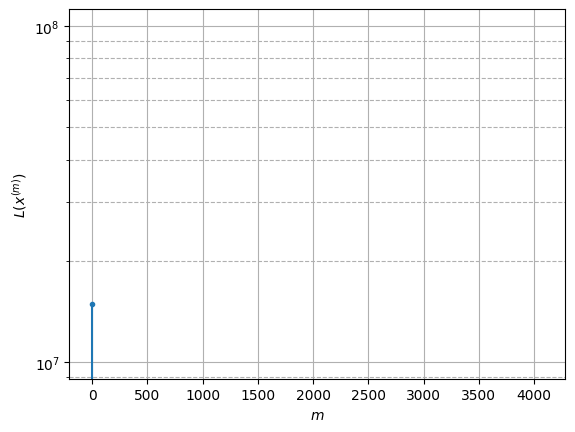

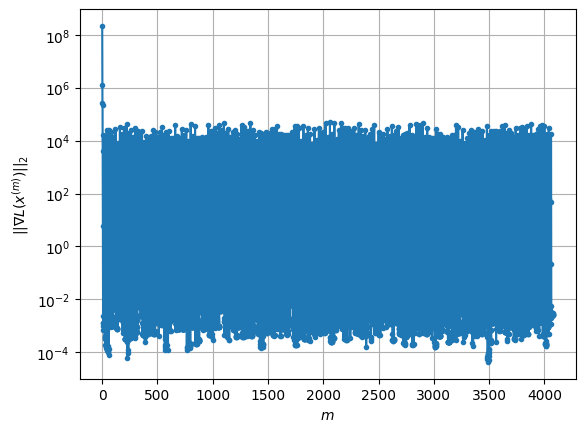

Windows:  54%|█████▍    | 204/376 [24:29<22:54,  7.99s/it]

Before applying the algorithm
Cost function: -3151328.2875959026
Gradient norm: 24768.11586104074
Global relative error: 22.920543867316624
Position relative errors: 0.01342808746375544 m, 2.899620685192846 m, 2.6473494624035077 m, 22.58170391864617 m

Iteration 1
Cost function: -3151334.5624763044 (-0.00%)
Gradient norm: 126.51382229794818 (-99.49%)
Global relative error: 23.714956872897616 (3.47%)
Position relative errors: 0.027867251038800545 m, 17.360646075428615 m, 0.6053817048242178 m, 16.144317680708692 m

Iteration 2
Cost function: -3151334.568561124 (-0.00%)
Gradient norm: 2.347711867456434 (-98.14%)
Global relative error: 24.628818700315144 (3.85%)
Position relative errors: 0.02786725309540943 m, 16.465837055270203 m, 0.6099548323213428 m, 18.305222098411484 m

Iteration 3
Cost function: -3151334.568561252 (-0.00%)
Gradient norm: 0.002166413604731236 (-99.91%)
Global relative error: 24.63150203687328 (0.01%)
Position relative errors: 0.027867253447575242 m, 16.464032264346766

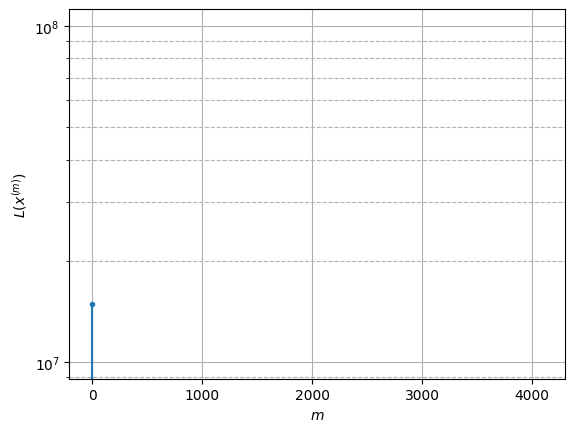

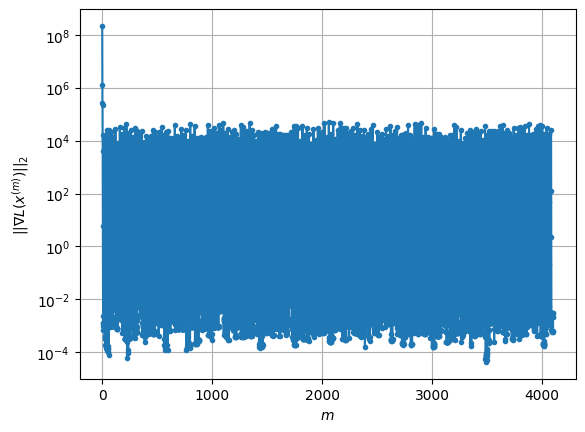

Windows:  55%|█████▍    | 205/376 [24:37<22:35,  7.92s/it]

Before applying the algorithm
Cost function: -3151335.072244465
Gradient norm: 20331.770940282582
Global relative error: 22.851905812259076
Position relative errors: 0.022335319801734956 m, 15.18653579124875 m, 0.4646479561685942 m, 17.069309806740613 m

Iteration 1
Cost function: -3151338.1088075773 (-0.00%)
Gradient norm: 26.154688992290055 (-99.87%)
Global relative error: 21.028116006363945 (-7.98%)
Position relative errors: 0.02726755842492137 m, 19.061190391247557 m, 2.2052337858075513 m, 8.601612330825075 m

Iteration 2
Cost function: -3151338.10974504 (-0.00%)
Gradient norm: 0.34099445067501066 (-98.70%)
Global relative error: 20.798954480232617 (-1.09%)
Position relative errors: 0.027267542971891528 m, 19.134040919604256 m, 2.2290574284560547 m, 7.8431118165706355 m

Iteration 3
Cost function: -3151338.1097450373 (0.00%)
Gradient norm: 0.0004887095848175909 (-99.86%)
Global relative error: 20.79914301084521 (0.00%)
Position relative errors: 0.027267544157371374 m, 19.1342776225

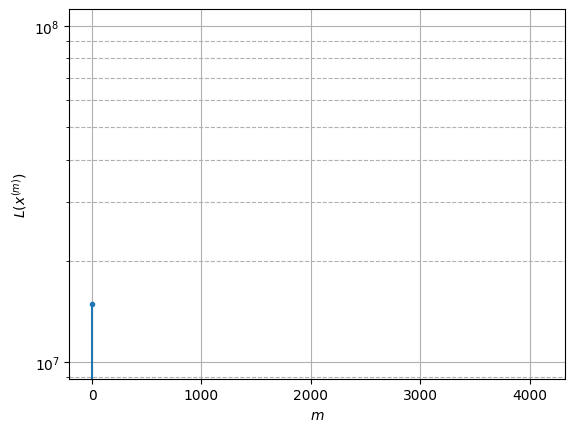

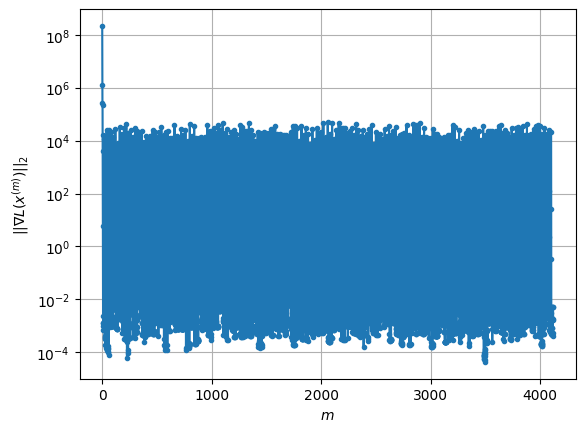

Windows:  55%|█████▍    | 206/376 [24:45<22:26,  7.92s/it]

Before applying the algorithm
Cost function: -3151328.960783835
Gradient norm: 29359.009099109255
Global relative error: 18.82368330860875
Position relative errors: 0.02250634847982169 m, 17.24355261673328 m, 1.9137375245751356 m, 7.30252301972021 m

Iteration 1
Cost function: -3151332.414241736 (-0.00%)
Gradient norm: 217.51766789718914 (-99.26%)
Global relative error: 18.392284174524974 (-2.29%)
Position relative errors: 0.03836775381875023 m, 15.571402139643206 m, 4.4079096701081735 m, 8.739250153865694 m

Iteration 2
Cost function: -3151332.4167969455 (-0.00%)
Gradient norm: 1.7880568650761683 (-99.18%)
Global relative error: 18.847168489242996 (2.47%)
Position relative errors: 0.038367735782929235 m, 15.79065065492115 m, 4.397779565246482 m, 9.301993721780914 m

Iteration 3
Cost function: -3151332.416796986 (-0.00%)
Gradient norm: 0.0012691893737237518 (-99.93%)
Global relative error: 18.848800430212762 (0.01%)
Position relative errors: 0.03836773656438141 m, 15.79148636462219 m, 

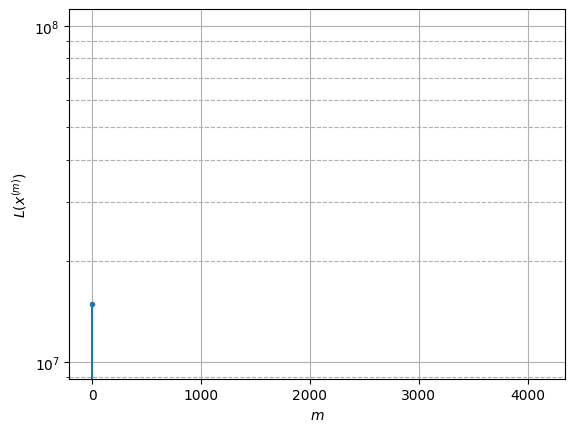

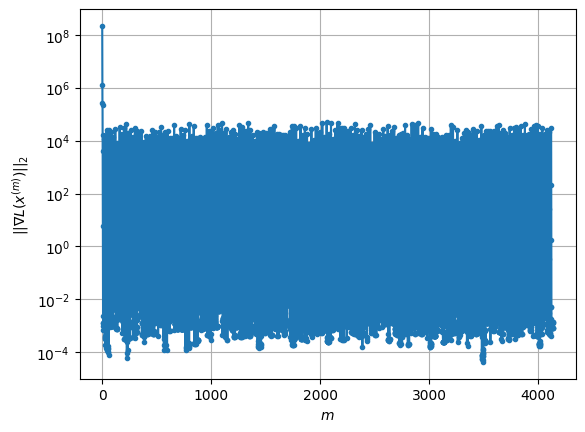

Windows:  55%|█████▌    | 207/376 [24:53<22:08,  7.86s/it]

Before applying the algorithm
Cost function: -3151331.7057432914
Gradient norm: 9422.486103376981
Global relative error: 16.3438316114495
Position relative errors: 0.02944681446602897 m, 13.772421753919156 m, 4.64593696706478 m, 7.473516602195463 m

Iteration 1
Cost function: -3151335.4612689586 (-0.00%)
Gradient norm: 32.46551085507927 (-99.66%)
Global relative error: 30.821623817613556 (88.58%)
Position relative errors: 0.05537981890215385 m, 17.578745666974566 m, 9.793735381959541 m, 23.34603192327537 m

Iteration 2
Cost function: -3151335.461975212 (-0.00%)
Gradient norm: 0.09542434430972999 (-99.71%)
Global relative error: 31.541990866430545 (2.34%)
Position relative errors: 0.05537981205982715 m, 17.67851456193245 m, 9.760395111520065 m, 24.230067854258305 m

Iteration 3
Cost function: -3151335.4619751736 (0.00%)
Gradient norm: 0.0036335774419558957 (-96.19%)
Global relative error: 31.54331937528064 (0.00%)
Position relative errors: 0.055379812075534766 m, 17.6787001781335 m, 9.7

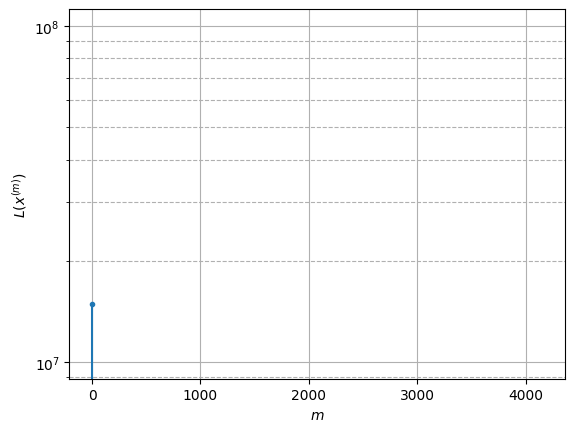

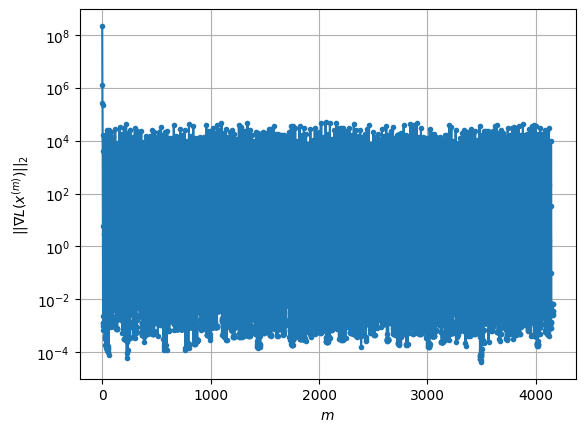

Windows:  55%|█████▌    | 208/376 [25:00<21:40,  7.74s/it]

Before applying the algorithm
Cost function: -3151333.6013292577
Gradient norm: 37559.38580591103
Global relative error: 28.573247205747183
Position relative errors: 0.04630827333907593 m, 15.593442541740112 m, 9.76306535415681 m, 21.862124713719158 m

Iteration 1
Cost function: -3151336.181718573 (-0.00%)
Gradient norm: 13.316173554797961 (-99.96%)
Global relative error: 25.06205789717698 (-12.29%)
Position relative errors: 0.06336868100977218 m, 16.49803475029216 m, 5.460496859513407 m, 18.058179538950412 m

Iteration 2
Cost function: -3151336.181931076 (-0.00%)
Gradient norm: 0.03871932637343432 (-99.71%)
Global relative error: 25.433444848838494 (1.48%)
Position relative errors: 0.06336868010155118 m, 16.666919240149063 m, 5.440289670760268 m, 18.42472224593817 m

Iteration 3
Cost function: -3151336.1819310472 (0.00%)
Gradient norm: 0.0029262992069818057 (-92.44%)
Global relative error: 25.43354158891851 (0.00%)
Position relative errors: 0.0633686796825702 m, 16.666966694180356 m, 

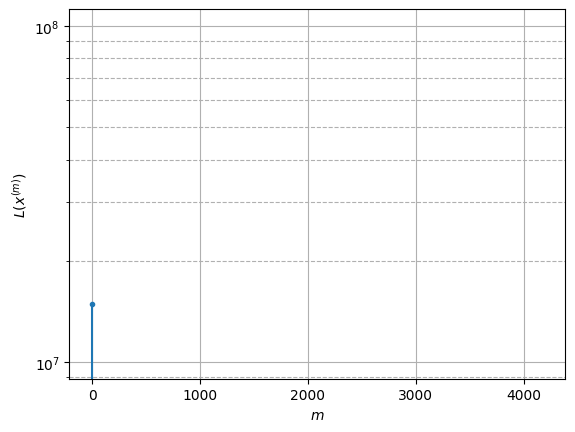

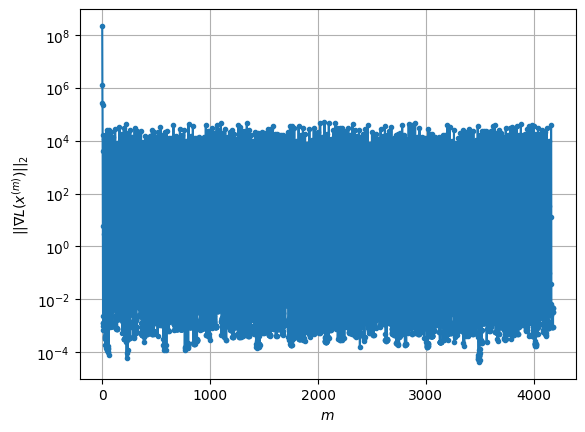

Windows:  56%|█████▌    | 209/376 [25:07<21:06,  7.58s/it]

Before applying the algorithm
Cost function: -3151333.8284638105
Gradient norm: 22638.966969311863
Global relative error: 22.41439607053751
Position relative errors: 0.05622397368747267 m, 14.40152403073366 m, 5.608848224353026 m, 16.233791578121075 m

Iteration 1
Cost function: -3151336.2447056514 (-0.00%)
Gradient norm: 104.04637691500551 (-99.54%)
Global relative error: 35.86642266444195 (60.02%)
Position relative errors: 0.07958056203034553 m, 10.492763559019549 m, 4.150316530256336 m, 34.045076240810346 m

Iteration 2
Cost function: -3151336.246184339 (-0.00%)
Gradient norm: 0.0631718208158209 (-99.94%)
Global relative error: 35.18130795761958 (-1.91%)
Position relative errors: 0.07958056324038655 m, 10.312368918781132 m, 4.175666895216358 m, 33.375642640094576 m

Iteration 3
Cost function: -3151336.246184363 (-0.00%)
Gradient norm: 0.00034396550139979186 (-99.46%)
Global relative error: 35.17814500130937 (-0.01%)
Position relative errors: 0.07958056285002856 m, 10.311990440771623

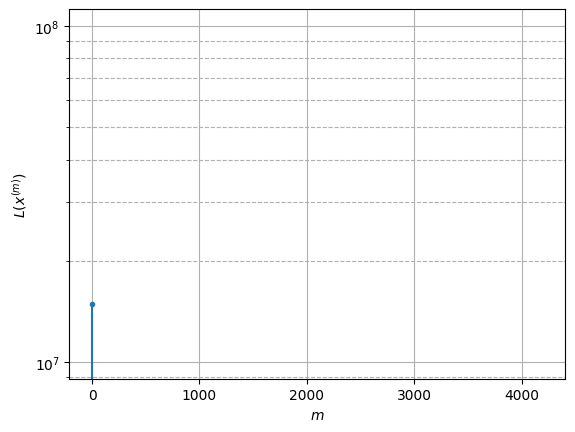

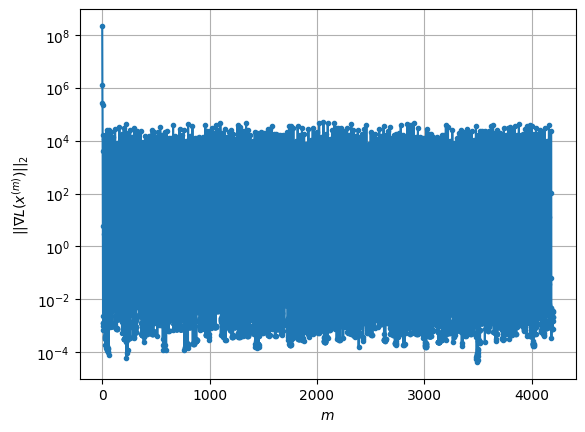

Windows:  56%|█████▌    | 210/376 [25:14<20:30,  7.41s/it]

Before applying the algorithm
Cost function: -3151336.101498506
Gradient norm: 27136.0475595872
Global relative error: 32.020847491944124
Position relative errors: 0.07211573211508955 m, 8.014609928738208 m, 4.361824635014692 m, 30.693098786125145 m

Iteration 1
Cost function: -3151339.454148809 (-0.00%)
Gradient norm: 162.14542714889276 (-99.40%)
Global relative error: 19.05043044624584 (-40.51%)
Position relative errors: 0.0710154142470384 m, 0.22369878940668347 m, 5.430796709282485 m, 18.25834231165257 m

Iteration 2
Cost function: -3151339.455670322 (-0.00%)
Gradient norm: 0.5344821131007833 (-99.67%)
Global relative error: 19.092669681553716 (0.22%)
Position relative errors: 0.07101541207524545 m, 0.2666913976140658 m, 5.425375618894739 m, 18.30343885424462 m

Iteration 3
Cost function: -3151339.4556703204 (0.00%)
Gradient norm: 0.0028340235290738335 (-99.47%)
Global relative error: 19.09237200798859 (-0.00%)
Position relative errors: 0.07101541258686635 m, 0.2668714406998246 m, 5

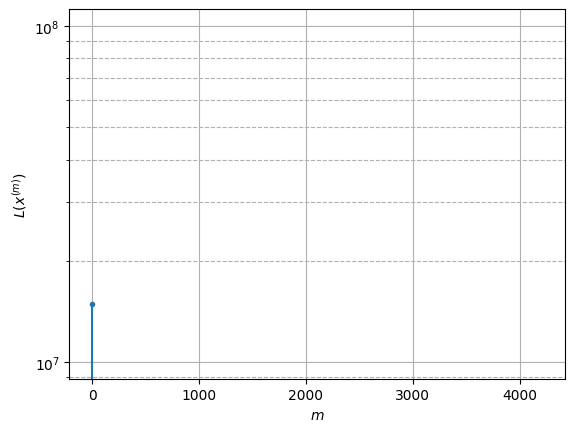

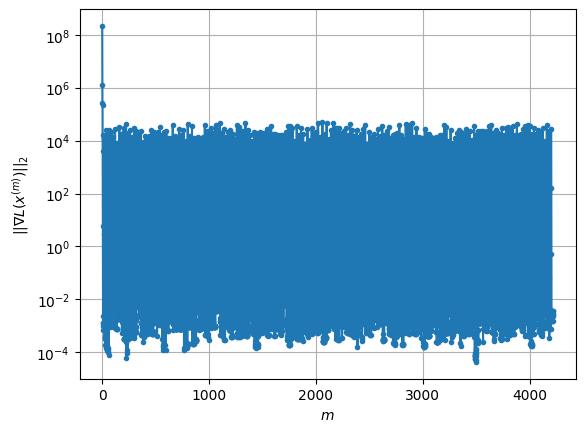

Windows:  56%|█████▌    | 211/376 [25:21<20:10,  7.34s/it]

Before applying the algorithm
Cost function: -3151327.7577935387
Gradient norm: 19114.9301503773
Global relative error: 16.16555844287202
Position relative errors: 0.06694984398643782 m, 1.2646164266178772 m, 5.446175160226479 m, 15.167639917630561 m

Iteration 1
Cost function: -3151331.2766391854 (-0.00%)
Gradient norm: 146.6111179727625 (-99.23%)
Global relative error: 32.28770278538079 (99.73%)
Position relative errors: 0.08700859442112106 m, 6.0873686091221355 m, 7.372455896790348 m, 30.839446887217075 m

Iteration 2
Cost function: -3151331.278377277 (-0.00%)
Gradient norm: 0.12422981178295205 (-99.92%)
Global relative error: 31.492872935894916 (-2.46%)
Position relative errors: 0.08700859606524586 m, 6.015230348554767 m, 7.33035109965882 m, 30.031134784140313 m

Iteration 3
Cost function: -3151331.278377289 (-0.00%)
Gradient norm: 0.0015828854695803828 (-98.73%)
Global relative error: 31.49018417682241 (-0.01%)
Position relative errors: 0.08700859606524586 m, 6.015329022995127 m, 

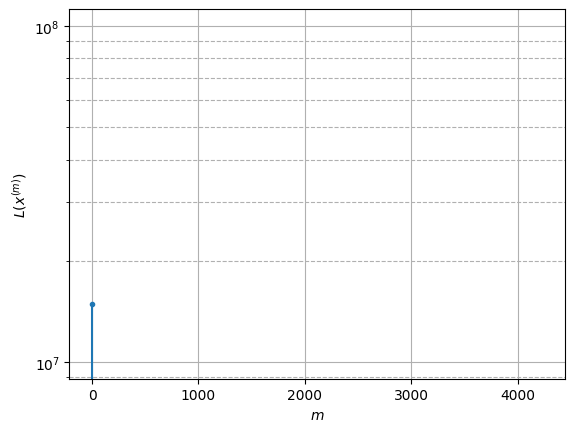

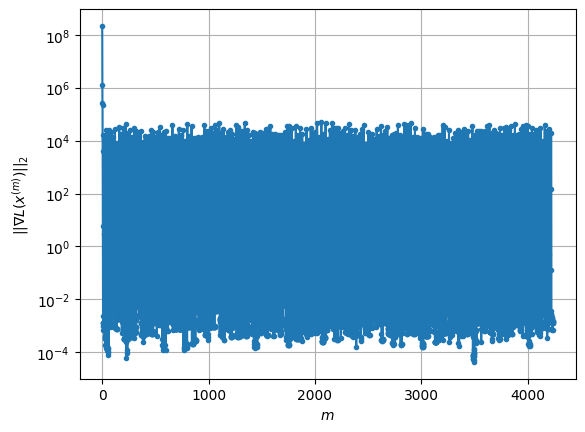

Windows:  56%|█████▋    | 212/376 [25:29<19:58,  7.31s/it]

Before applying the algorithm
Cost function: -3151319.7386461166
Gradient norm: 16459.859984059778
Global relative error: 26.94435248281658
Position relative errors: 0.08384448356656743 m, 6.941054922294857 m, 6.913424354973827 m, 25.099994779363165 m

Iteration 1
Cost function: -3151328.5228725728 (-0.00%)
Gradient norm: 168.9007149438562 (-98.97%)
Global relative error: 56.27951761820188 (108.87%)
Position relative errors: 0.0696743482392099 m, 3.8823508025756057 m, 5.836568853251743 m, 55.841076896592746 m

Iteration 2
Cost function: -3151328.5320878006 (-0.00%)
Gradient norm: 4.911731733758047 (-97.09%)
Global relative error: 54.44215169215229 (-3.26%)
Position relative errors: 0.06967435130104815 m, 4.005243648412984 m, 5.700299322956278 m, 53.994386008014246 m

Iteration 3
Cost function: -3151328.532088118 (-0.00%)
Gradient norm: 0.0011558036080348574 (-99.98%)
Global relative error: 54.428768386629216 (-0.02%)
Position relative errors: 0.0696743512606723 m, 4.006410606156932 m, 

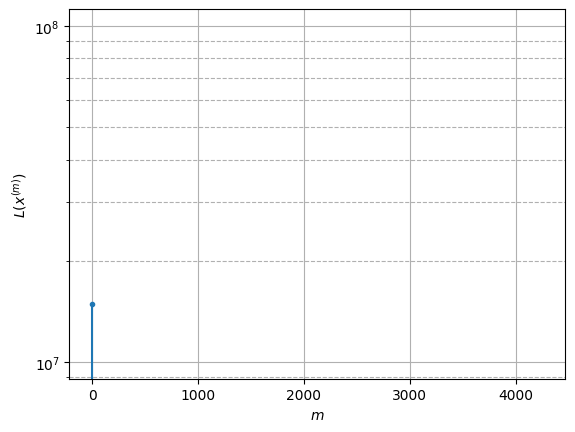

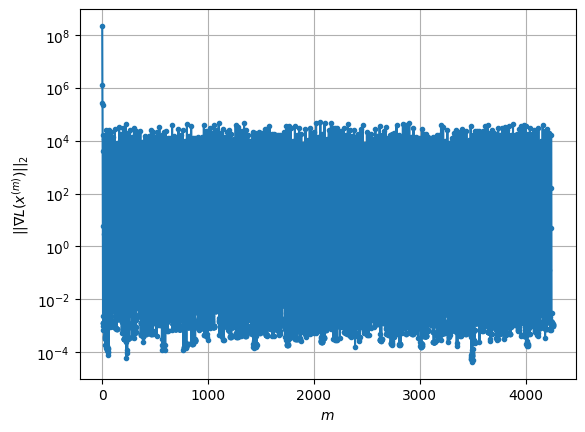

Windows:  57%|█████▋    | 213/376 [25:36<20:00,  7.36s/it]

Before applying the algorithm
Cost function: -3151321.878667686
Gradient norm: 33950.72378034307
Global relative error: 47.71454446852379
Position relative errors: 0.06650649893761738 m, 4.992367351082324 m, 5.585032243788295 m, 47.12263072997088 m

Iteration 1
Cost function: -3151327.070807331 (-0.00%)
Gradient norm: 317.40205516629356 (-99.07%)
Global relative error: 52.97496435759351 (11.02%)
Position relative errors: 0.1111724487179232 m, 9.762555536817509 m, 7.940601311838497 m, 51.45837960141377 m

Iteration 2
Cost function: -3151327.0726714833 (-0.00%)
Gradient norm: 0.16167513739510045 (-99.95%)
Global relative error: 52.5576928282549 (-0.79%)
Position relative errors: 0.11117244369579155 m, 9.819605151111288 m, 7.959185496800274 m, 51.014866212922406 m

Iteration 3
Cost function: -3151327.0726714805 (0.00%)
Gradient norm: 0.0008097398969158761 (-99.50%)
Global relative error: 52.55644567684578 (-0.00%)
Position relative errors: 0.11117244361193618 m, 9.819471779972222 m, 7.959

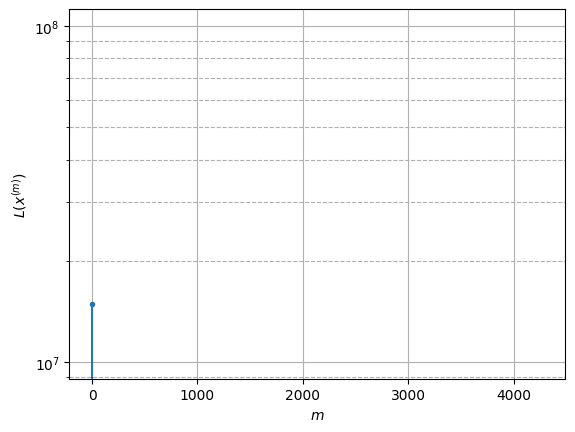

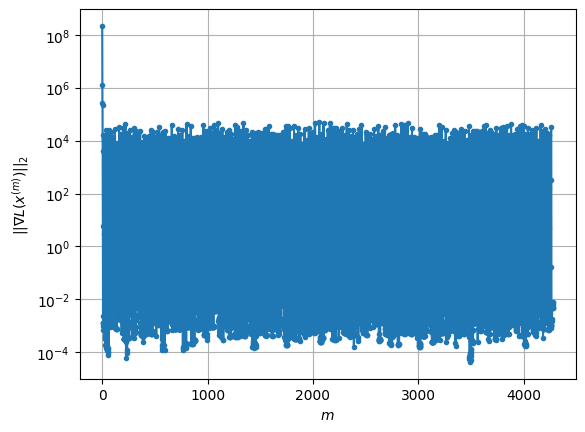

Windows:  57%|█████▋    | 214/376 [25:43<19:46,  7.33s/it]

Before applying the algorithm
Cost function: -3151320.644359112
Gradient norm: 19914.960030332433
Global relative error: 47.06758776870845
Position relative errors: 0.10293790039767063 m, 8.091728191255996 m, 7.595015290562357 m, 45.740327008730745 m

Iteration 1
Cost function: -3151326.5173860057 (-0.00%)
Gradient norm: 973.3244448169344 (-95.11%)
Global relative error: 29.85873398733639 (-36.56%)
Position relative errors: 0.11545517991726496 m, 7.997266941186427 m, 2.7896142893086884 m, 28.631981772006387 m

Iteration 2
Cost function: -3151326.5577489757 (-0.00%)
Gradient norm: 30.818531024081615 (-96.83%)
Global relative error: 33.73840367463892 (12.99%)
Position relative errors: 0.11545521786835994 m, 8.852256139523552 m, 2.8660171000709056 m, 32.42972600636623 m

Iteration 3
Cost function: -3151326.5577688576 (-0.00%)
Gradient norm: 0.01148769691637624 (-99.96%)
Global relative error: 33.78841392384797 (0.15%)
Position relative errors: 0.11545521875377483 m, 8.865990624236407 m, 2

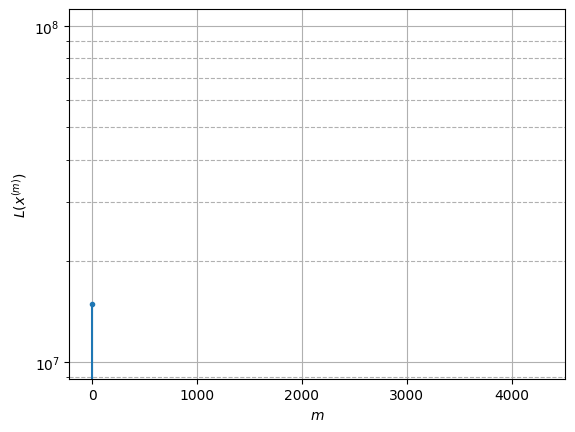

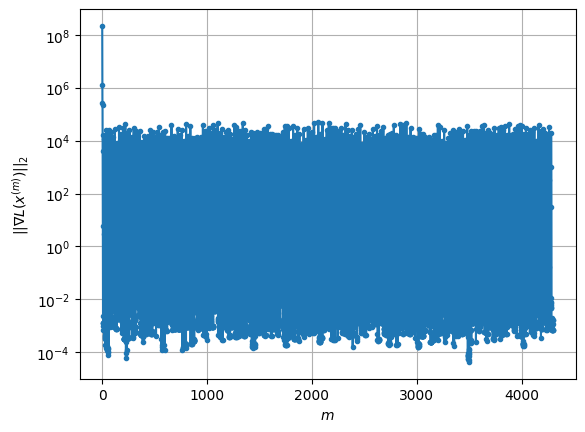

Windows:  57%|█████▋    | 215/376 [25:51<19:45,  7.37s/it]

Before applying the algorithm
Cost function: -3151315.5774360877
Gradient norm: 23448.580453689483
Global relative error: 30.868295203926618
Position relative errors: 0.10675796987231342 m, 6.821958943526125 m, 2.6162321049127604 m, 29.99088753144578 m

Iteration 1
Cost function: -3151320.2894464866 (-0.00%)
Gradient norm: 1719.4000174353148 (-92.67%)
Global relative error: 12.456296272813685 (-59.65%)
Position relative errors: 0.11993230433272226 m, 3.160871875402705 m, 4.323313815988231 m, 11.245394161438593 m

Iteration 2
Cost function: -3151320.35174436 (-0.00%)
Gradient norm: 26.210379754787507 (-98.48%)
Global relative error: 14.311998739315525 (14.90%)
Position relative errors: 0.11993233314781933 m, 3.335392191651944 m, 4.450433520503661 m, 13.186525883381952 m

Iteration 3
Cost function: -3151320.3517773594 (-0.00%)
Gradient norm: 0.029111314198937154 (-99.89%)
Global relative error: 14.286488055340621 (-0.18%)
Position relative errors: 0.11993233335858633 m, 3.34143774450211 

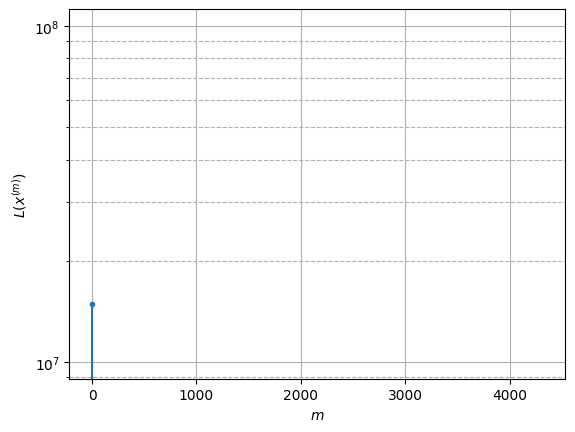

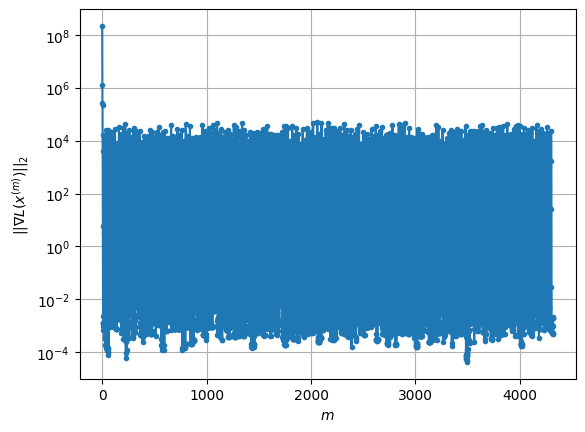

Windows:  57%|█████▋    | 216/376 [25:58<19:39,  7.37s/it]

Before applying the algorithm
Cost function: -3151307.0112827853
Gradient norm: 13709.638786534417
Global relative error: 11.587657714992332
Position relative errors: 0.11121209656303634 m, 2.700652666345266 m, 4.293395033157178 m, 10.417840219950227 m

Iteration 1
Cost function: -3151313.7563654743 (-0.00%)
Gradient norm: 240.04322110488891 (-98.25%)
Global relative error: 46.046191048976674 (297.37%)
Position relative errors: 0.12968290473294114 m, 8.979831179018618 m, 7.50782115941189 m, 44.53340435439738 m

Iteration 2
Cost function: -3151313.768414529 (-0.00%)
Gradient norm: 4.028589561261973 (-98.32%)
Global relative error: 48.80437155245751 (5.99%)
Position relative errors: 0.12968290423678544 m, 9.227376201629031 m, 7.441020379804145 m, 47.34268350110016 m

Iteration 3
Cost function: -3151313.768415187 (-0.00%)
Gradient norm: 0.0026534422866464564 (-99.93%)
Global relative error: 48.834581467525226 (0.06%)
Position relative errors: 0.12968290423931605 m, 9.229235573828001 m, 7.

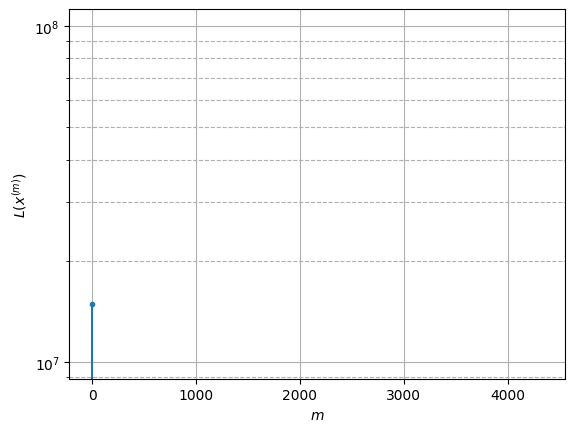

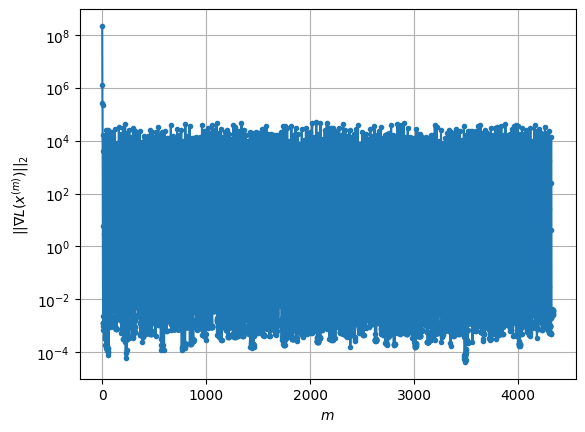

Windows:  58%|█████▊    | 217/376 [26:06<19:34,  7.39s/it]

Before applying the algorithm
Cost function: -3151317.95823951
Gradient norm: 23355.83462389323
Global relative error: 43.91086631123796
Position relative errors: 0.12074234301234106 m, 9.358415854354016 m, 7.18006146706617 m, 42.296677097012136 m

Iteration 1
Cost function: -3151320.5850916863 (-0.00%)
Gradient norm: 10.894531686444074 (-99.95%)
Global relative error: 50.679371776928434 (15.41%)
Position relative errors: 0.10754226110655181 m, 10.22712130217703 m, 9.271715628060432 m, 48.76289952522609 m

Iteration 2
Cost function: -3151320.5851735747 (-0.00%)
Gradient norm: 0.04304789328919342 (-99.60%)
Global relative error: 51.01378447399061 (0.66%)
Position relative errors: 0.107542260877687 m, 10.236101249347772 m, 9.264426698273393 m, 49.109867659639434 m

Iteration 3
Cost function: -3151320.5851735487 (0.00%)
Gradient norm: 0.003627465310545105 (-91.57%)
Global relative error: 51.0140171672237 (0.00%)
Position relative errors: 0.10754226100343142 m, 10.236105609232586 m, 9.2644

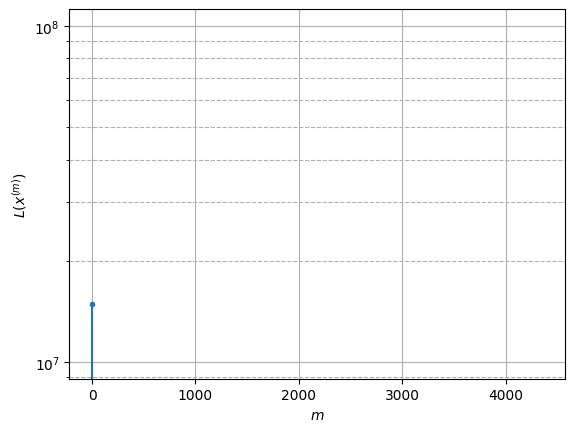

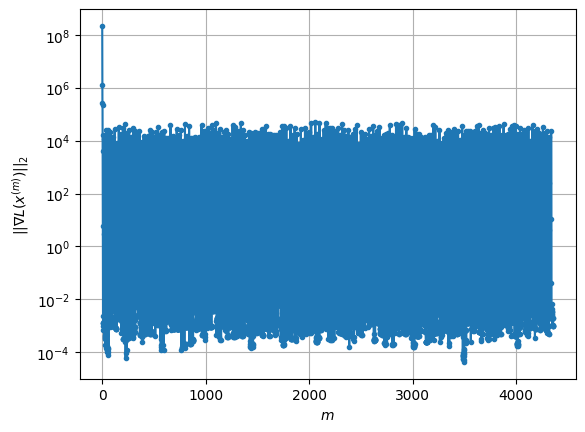

Windows:  58%|█████▊    | 218/376 [26:13<19:31,  7.41s/it]

Before applying the algorithm
Cost function: -3151316.9962757947
Gradient norm: 21383.759176116575
Global relative error: 45.676886487200285
Position relative errors: 0.09912866795500318 m, 10.170286052702357 m, 8.886155940160812 m, 43.63440036639487 m

Iteration 1
Cost function: -3151324.217242413 (-0.00%)
Gradient norm: 124.98603799566776 (-99.42%)
Global relative error: 49.17084848258465 (7.65%)
Position relative errors: 0.11933579406454886 m, 25.264771648818954 m, 8.68883919052437 m, 41.27887200886061 m

Iteration 2
Cost function: -3151324.2241177936 (-0.00%)
Gradient norm: 4.8664205717841105 (-96.11%)
Global relative error: 48.11771627752943 (-2.14%)
Position relative errors: 0.11933579023178799 m, 24.715468564886223 m, 8.720464428032193 m, 40.35334060544245 m

Iteration 3
Cost function: -3151324.2241180646 (-0.00%)
Gradient norm: 0.0010003951686478338 (-99.98%)
Global relative error: 48.11354147719804 (-0.01%)
Position relative errors: 0.1193357903772461 m, 24.714307302728656 m, 

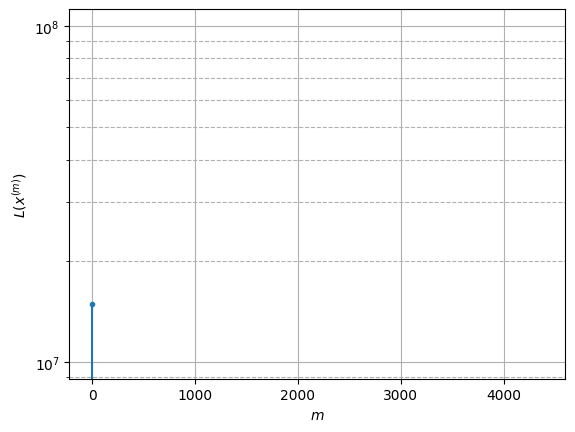

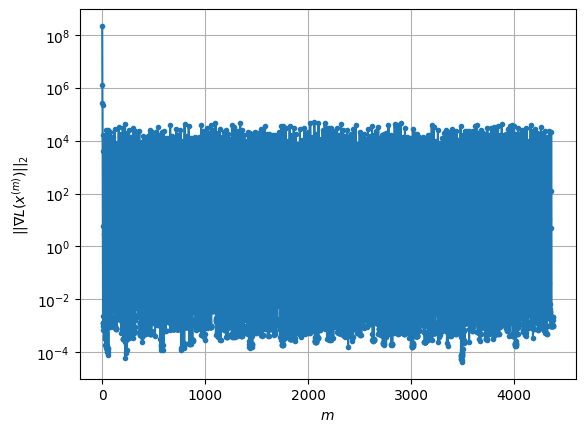

Windows:  58%|█████▊    | 219/376 [26:21<19:24,  7.42s/it]

Before applying the algorithm
Cost function: -3151319.5573236155
Gradient norm: 19652.417054786038
Global relative error: 43.193329329277795
Position relative errors: 0.10751737580465567 m, 23.46193610001133 m, 8.303557006319329 m, 35.302022456738634 m

Iteration 1
Cost function: -3151323.769073482 (-0.00%)
Gradient norm: 475.55219792926215 (-97.58%)
Global relative error: 54.10789554321967 (25.27%)
Position relative errors: 0.09403914709249982 m, 19.733968123653092 m, 5.652747869981541 m, 50.06252254577993 m

Iteration 2
Cost function: -3151323.7833964583 (-0.00%)
Gradient norm: 13.010439599784565 (-97.26%)
Global relative error: 51.489115791110194 (-4.84%)
Position relative errors: 0.09403914622797302 m, 19.402718552366995 m, 5.72235025195305 m, 47.34865481215298 m

Iteration 3
Cost function: -3151323.7833998385 (-0.00%)
Gradient norm: 0.0038682672078114324 (-99.97%)
Global relative error: 51.461858019804204 (-0.05%)
Position relative errors: 0.09403914545851644 m, 19.40028194286 m, 

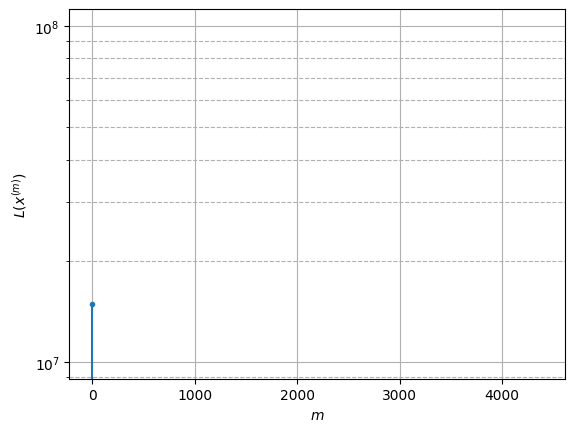

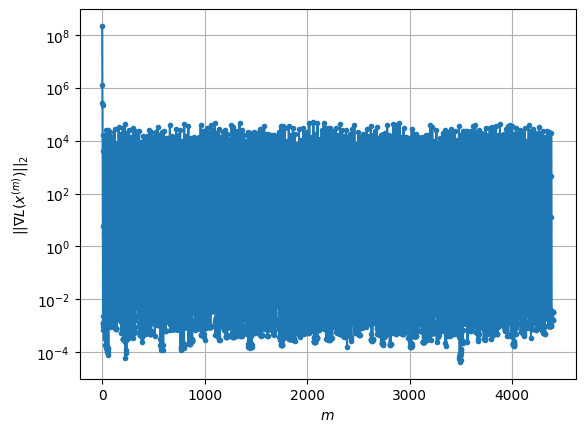

Windows:  59%|█████▊    | 220/376 [26:28<19:22,  7.45s/it]

Before applying the algorithm
Cost function: -3151323.2041346896
Gradient norm: 14917.17917125089
Global relative error: 44.676502000702285
Position relative errors: 0.08679570050079083 m, 18.710213635605122 m, 5.435892221767687 m, 40.203810808019455 m

Iteration 1
Cost function: -3151326.2496374664 (-0.00%)
Gradient norm: 465.84622127565865 (-96.88%)
Global relative error: 44.584325644228294 (-0.21%)
Position relative errors: 0.05576074593548023 m, 18.141299398066856 m, 2.865189990654344 m, 40.62555223457328 m

Iteration 2
Cost function: -3151326.258481478 (-0.00%)
Gradient norm: 7.933941118857765 (-98.30%)
Global relative error: 42.28383524699829 (-5.16%)
Position relative errors: 0.05576074379319227 m, 18.05744432700605 m, 2.907948796559055 m, 38.12329694332134 m

Iteration 3
Cost function: -3151326.258482901 (-0.00%)
Gradient norm: 0.0019162735820669084 (-99.98%)
Global relative error: 42.26840702611126 (-0.04%)
Position relative errors: 0.05576074337846715 m, 18.055690190479297 m,

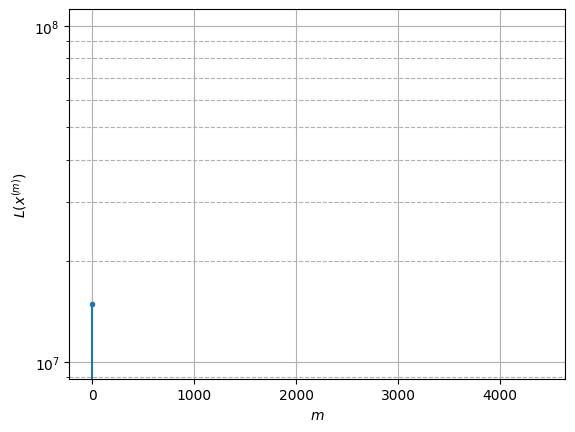

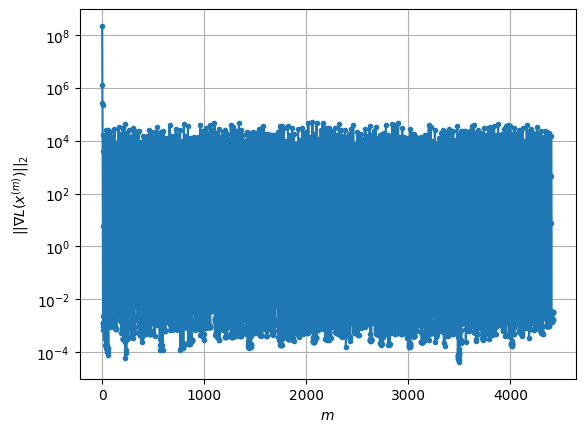

Windows:  59%|█████▉    | 221/376 [26:36<19:16,  7.46s/it]

Before applying the algorithm
Cost function: -3151321.178830392
Gradient norm: 20189.477043219926
Global relative error: 37.7488262520422
Position relative errors: 0.05166770941790021 m, 17.58148673229847 m, 2.747456718482029 m, 33.291249368795455 m

Iteration 1
Cost function: -3151325.085263255 (-0.00%)
Gradient norm: 56.557721355011125 (-99.72%)
Global relative error: 51.377349265111846 (36.10%)
Position relative errors: 0.07223508539603847 m, 11.11692361497077 m, 0.9862375900775374 m, 50.150373460296265 m

Iteration 2
Cost function: -3151325.0888184886 (-0.00%)
Gradient norm: 0.9138218284394777 (-98.38%)
Global relative error: 48.5307694209451 (-5.54%)
Position relative errors: 0.0722350880114637 m, 11.047433491155072 m, 0.9623226397333674 m, 47.24670171516357 m

Iteration 3
Cost function: -3151325.088818776 (-0.00%)
Gradient norm: 0.001331298359601183 (-99.85%)
Global relative error: 48.515179551283644 (-0.03%)
Position relative errors: 0.0722350880114637 m, 11.047545370214563 m, 0

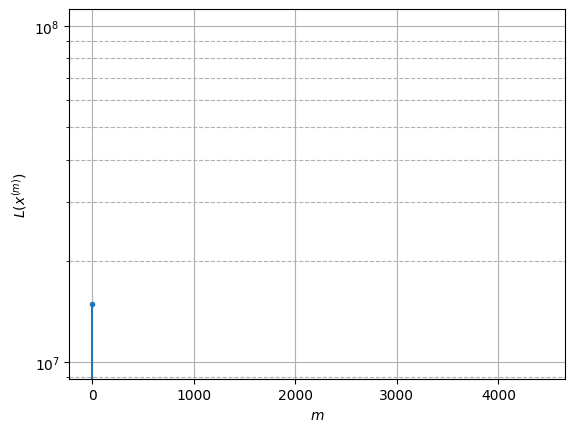

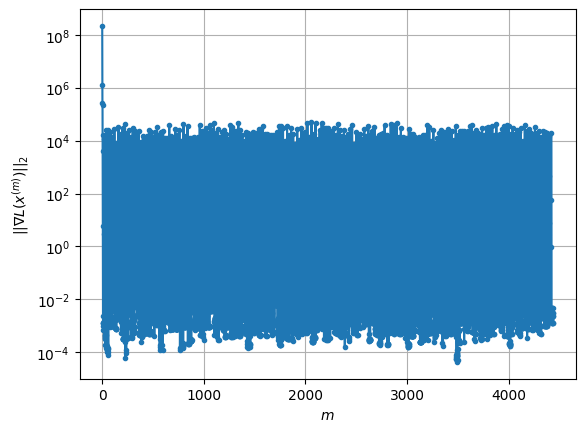

Windows:  59%|█████▉    | 222/376 [26:43<19:29,  7.59s/it]

Before applying the algorithm
Cost function: -3151322.8532418027
Gradient norm: 8953.620057628737
Global relative error: 43.34366038129182
Position relative errors: 0.06668333108027595 m, 10.992289164778306 m, 0.8915157170769366 m, 41.91700257433034 m

Iteration 1
Cost function: -3151326.9311317382 (-0.00%)
Gradient norm: 46.27909540262302 (-99.48%)
Global relative error: 58.22226317177975 (34.33%)
Position relative errors: 0.06298976921684189 m, 16.41571792906585 m, 3.5810872026467635 m, 55.74512573146741 m

Iteration 2
Cost function: -3151326.9317767997 (-0.00%)
Gradient norm: 0.16698390467654659 (-99.64%)
Global relative error: 57.09348720790183 (-1.94%)
Position relative errors: 0.06298977355701538 m, 16.350892110528797 m, 3.568440812089619 m, 54.58541995946873 m

Iteration 3
Cost function: -3151326.9317768393 (-0.00%)
Gradient norm: 0.002002061675154709 (-98.80%)
Global relative error: 57.09183601671411 (-0.00%)
Position relative errors: 0.06298977318144353 m, 16.35084191483889 m,

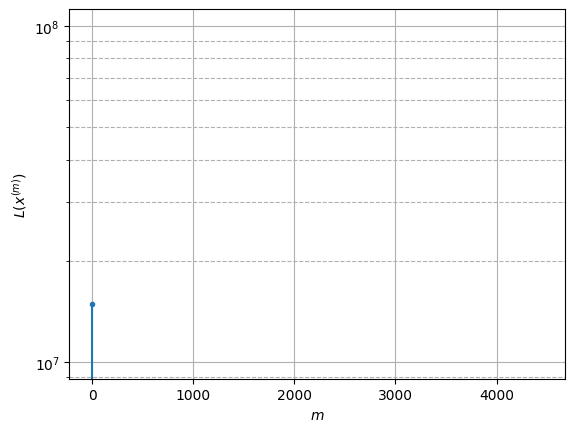

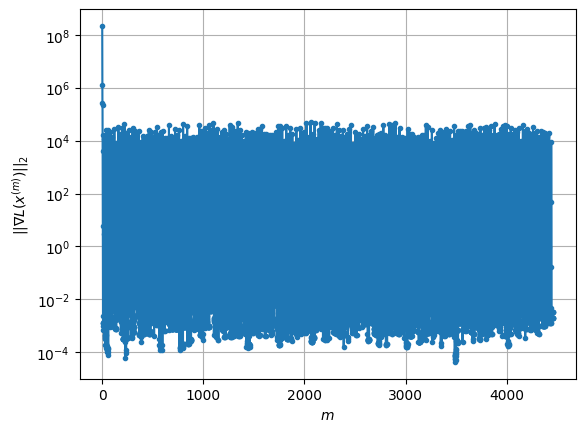

Windows:  59%|█████▉    | 223/376 [26:52<19:46,  7.75s/it]

Before applying the algorithm
Cost function: -3151324.83090738
Gradient norm: 25294.975372118584
Global relative error: 51.55918627636373
Position relative errors: 0.05765062797438172 m, 15.905733992427011 m, 3.2401796759617403 m, 48.93716370897127 m

Iteration 1
Cost function: -3151329.2387216957 (-0.00%)
Gradient norm: 24.675133145933938 (-99.90%)
Global relative error: 55.98762711698914 (8.59%)
Position relative errors: 0.08917748461177773 m, 15.879919001223765 m, 2.530971348692432 m, 53.628515666264555 m

Iteration 2
Cost function: -3151329.239538232 (-0.00%)
Gradient norm: 0.789112163415565 (-96.80%)
Global relative error: 55.160722773222666 (-1.48%)
Position relative errors: 0.08917748230280241 m, 15.83535602158228 m, 2.550956427340334 m, 52.77708647867113 m

Iteration 3
Cost function: -3151329.2395382165 (0.00%)
Gradient norm: 0.003813104982564918 (-99.52%)
Global relative error: 55.15979387489104 (-0.00%)
Position relative errors: 0.08917748281895911 m, 15.835371679416868 m, 2.

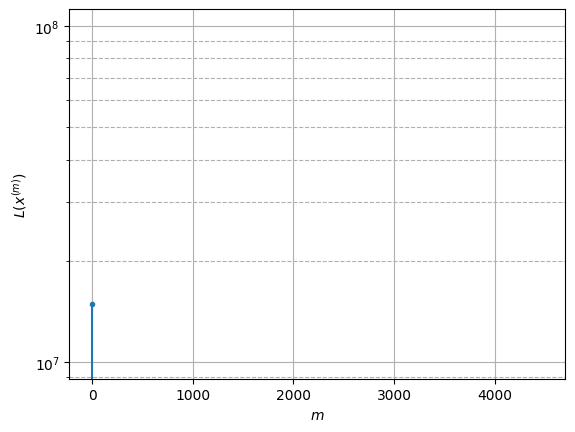

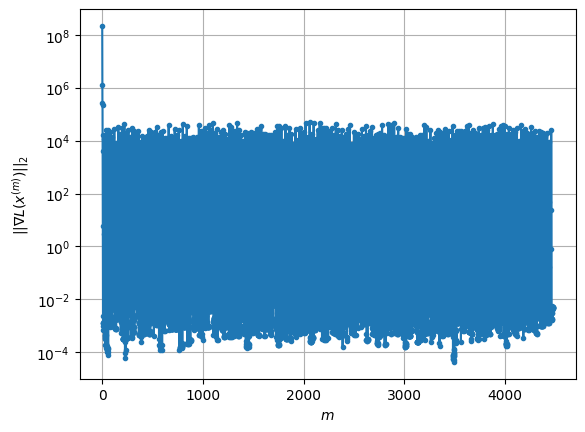

Windows:  60%|█████▉    | 224/376 [27:00<19:56,  7.87s/it]

Before applying the algorithm
Cost function: -3151322.183444067
Gradient norm: 22476.587439260507
Global relative error: 48.988900645433354
Position relative errors: 0.08059624977057578 m, 14.953167947294883 m, 2.3466853151726275 m, 46.59174316049742 m

Iteration 1
Cost function: -3151326.47782907 (-0.00%)
Gradient norm: 803.1573339400029 (-96.43%)
Global relative error: 14.48164271713037 (-70.44%)
Position relative errors: 0.0496709847141463 m, 11.680482157441384 m, 2.6920809208420597 m, 8.126115660200801 m

Iteration 2
Cost function: -3151326.4972263784 (-0.00%)
Gradient norm: 7.626896127571314 (-99.05%)
Global relative error: 12.502680184689224 (-13.67%)
Position relative errors: 0.04967098426099198 m, 11.660888846795926 m, 2.642262572158278 m, 3.6546145718768313 m

Iteration 3
Cost function: -3151326.497232505 (-0.00%)
Gradient norm: 0.00551363140108718 (-99.93%)
Global relative error: 12.479052090407293 (-0.19%)
Position relative errors: 0.049670983310981826 m, 11.661852002337412 

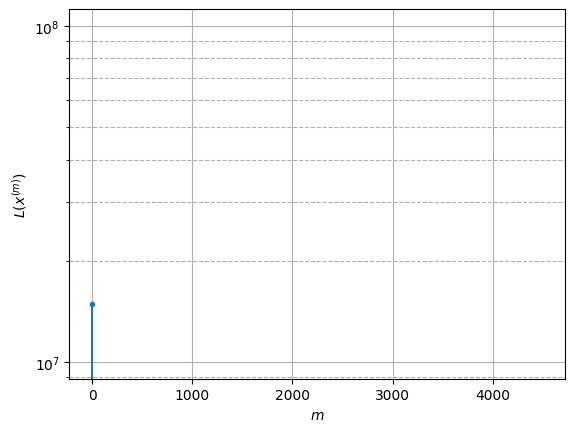

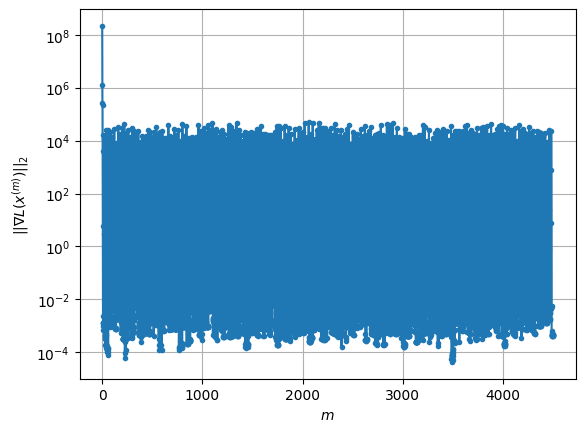

Windows:  60%|█████▉    | 225/376 [27:08<20:02,  7.96s/it]

Before applying the algorithm
Cost function: -3151328.8559416165
Gradient norm: 21197.51843926281
Global relative error: 11.808878366039387
Position relative errors: 0.04498170288828 m, 11.287493169154645 m, 2.368122729678564 m, 2.5360639088823804 m

Iteration 1
Cost function: -3151331.316220945 (-0.00%)
Gradient norm: 83.66343198836003 (-99.61%)
Global relative error: 25.794923503105228 (118.44%)
Position relative errors: 0.06708626914554058 m, 19.361464165851604 m, 0.5688585623742725 m, 17.03476125493643 m

Iteration 2
Cost function: -3151331.3185650567 (-0.00%)
Gradient norm: 0.9858057006900289 (-98.82%)
Global relative error: 26.41572946425209 (2.41%)
Position relative errors: 0.06708627019234169 m, 19.10555632287403 m, 0.5954968978814047 m, 18.23208243483709 m

Iteration 3
Cost function: -3151331.3185651153 (-0.00%)
Gradient norm: 0.0016945981755033558 (-99.83%)
Global relative error: 26.420102214192116 (0.02%)
Position relative errors: 0.06708626979406601 m, 19.105732609468017 m,

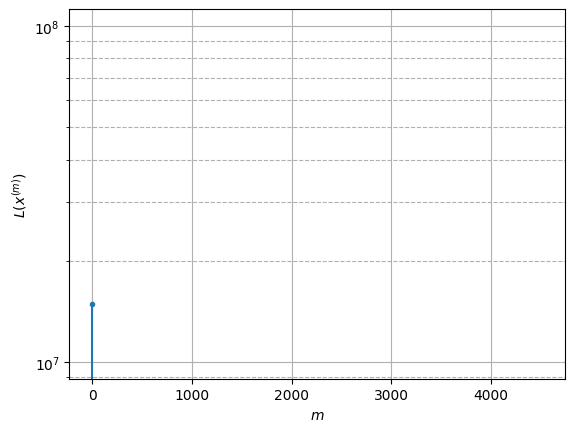

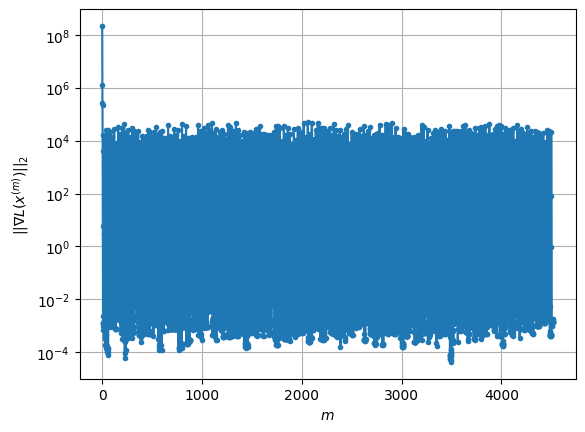

Windows:  60%|██████    | 226/376 [27:16<20:09,  8.06s/it]

Before applying the algorithm
Cost function: -3151328.770238764
Gradient norm: 33368.84070221316
Global relative error: 25.63157346821814
Position relative errors: 0.06128841017372526 m, 17.736849295110105 m, 0.5724015546969312 m, 18.494587151271237 m

Iteration 1
Cost function: -3151335.118102578 (-0.00%)
Gradient norm: 494.83289915458914 (-98.52%)
Global relative error: 70.4084197192192 (174.69%)
Position relative errors: 0.10855654067695628 m, 12.941293972415744 m, 3.322009263569265 m, 69.12898419260188 m

Iteration 2
Cost function: -3151335.1442036657 (-0.00%)
Gradient norm: 14.583976515230754 (-97.05%)
Global relative error: 75.29268888769164 (6.94%)
Position relative errors: 0.10855654504268088 m, 12.528161268493525 m, 3.5239595063384344 m, 74.15927610563352 m

Iteration 3
Cost function: -3151335.144213788 (-0.00%)
Gradient norm: 0.005818212203308478 (-99.96%)
Global relative error: 75.42852860310704 (0.18%)
Position relative errors: 0.10855654418449416 m, 12.531383507382763 m, 3

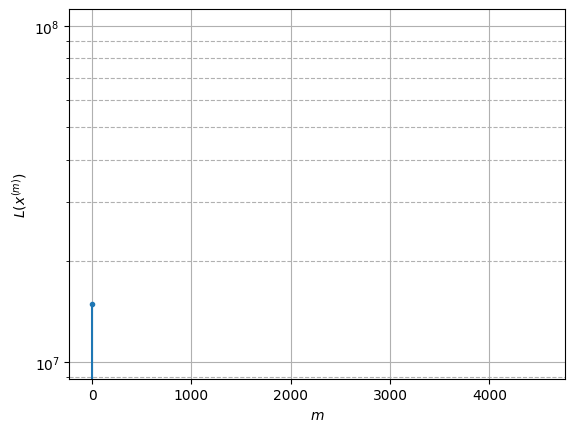

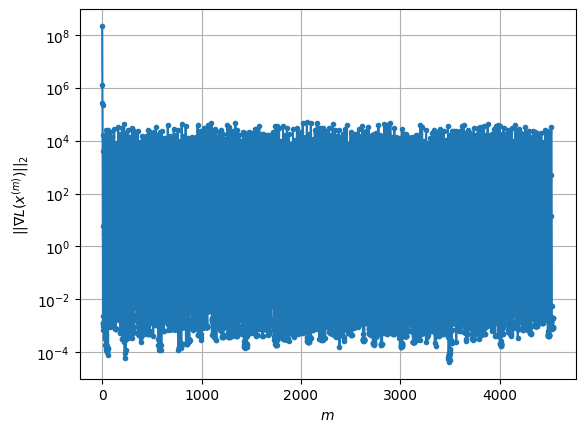

Windows:  60%|██████    | 227/376 [27:25<20:16,  8.16s/it]

Before applying the algorithm
Cost function: -3151333.650782414
Gradient norm: 14958.910669526958
Global relative error: 70.7233578640964
Position relative errors: 0.10026107737537458 m, 11.488713176547268 m, 3.0394526940912465 m, 69.71762920008204 m

Iteration 1
Cost function: -3151335.866370847 (-0.00%)
Gradient norm: 461.1542915527927 (-96.92%)
Global relative error: 56.83005811910328 (-19.64%)
Position relative errors: 0.1231034286572771 m, 6.194646110865276 m, 2.3550742533419666 m, 56.44217164095601 m

Iteration 2
Cost function: -3151335.8756442643 (-0.00%)
Gradient norm: 7.700912033004969 (-98.33%)
Global relative error: 59.40061433043626 (4.52%)
Position relative errors: 0.12310342979434415 m, 6.014421390051229 m, 2.404920251647659 m, 59.04624269806418 m

Iteration 3
Cost function: -3151335.875646311 (-0.00%)
Gradient norm: 0.0019270525286732988 (-99.97%)
Global relative error: 59.43066404500324 (0.05%)
Position relative errors: 0.12310342968585047 m, 6.015535257746027 m, 2.4049

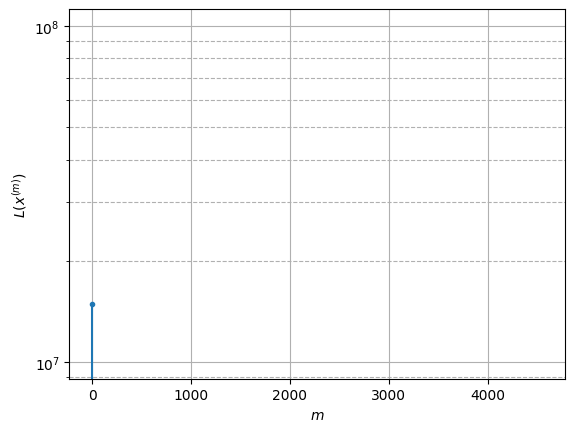

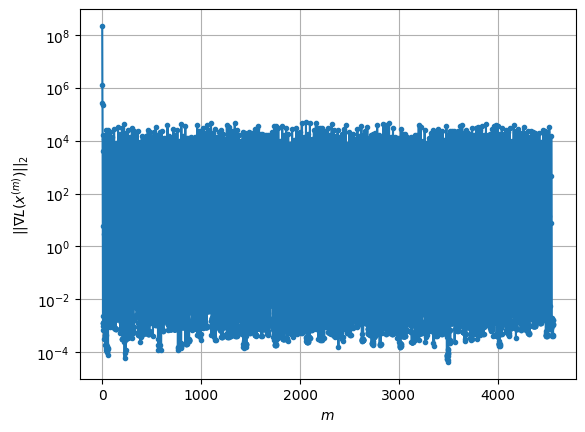

Windows:  61%|██████    | 228/376 [27:33<20:08,  8.16s/it]

Before applying the algorithm
Cost function: -3151335.5820885743
Gradient norm: 32802.50978781561
Global relative error: 56.59492185404464
Position relative errors: 0.11444744647729799 m, 5.573762225479136 m, 2.017214003499458 m, 56.283510796652884 m

Iteration 1
Cost function: -3151339.104329264 (-0.00%)
Gradient norm: 139.48218051545174 (-99.57%)
Global relative error: 61.64978129353913 (8.93%)
Position relative errors: 0.13501390168419886 m, 5.952553014328791 m, 1.5138915981541023 m, 61.34289721735937 m

Iteration 2
Cost function: -3151339.106193742 (-0.00%)
Gradient norm: 1.8730893391200323 (-98.66%)
Global relative error: 63.30284507999986 (2.68%)
Position relative errors: 0.13501390269899616 m, 5.982273970261157 m, 1.5323269617276882 m, 63.00075047637946 m

Iteration 3
Cost function: -3151339.1061938163 (-0.00%)
Gradient norm: 0.0022359036838284965 (-99.88%)
Global relative error: 63.3071672541744 (0.01%)
Position relative errors: 0.13501390231773946 m, 5.982354169646261 m, 1.532

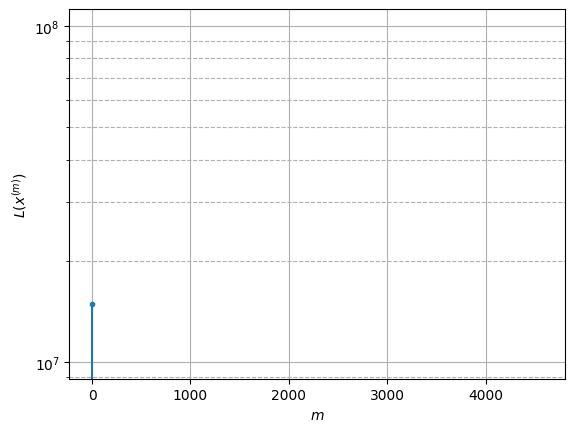

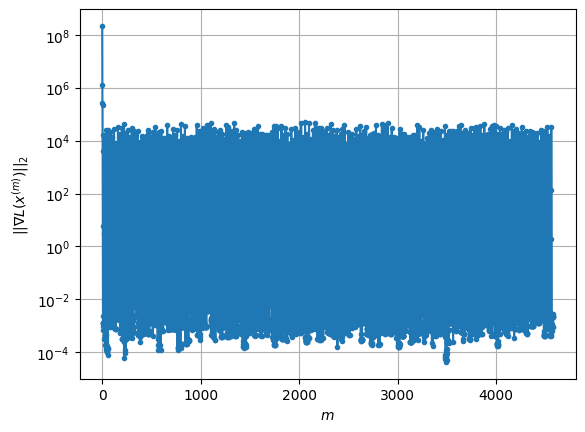

Windows:  61%|██████    | 229/376 [27:41<19:59,  8.16s/it]

Before applying the algorithm
Cost function: -3151338.023844717
Gradient norm: 22354.591286113933
Global relative error: 60.77991151979132
Position relative errors: 0.1249676745355588 m, 5.652014502548516 m, 1.2271336370118306 m, 60.503957059547034 m

Iteration 1
Cost function: -3151340.441708964 (-0.00%)
Gradient norm: 110.22875821727074 (-99.51%)
Global relative error: 56.13908501504293 (-7.64%)
Position relative errors: 0.11680901852003066 m, 7.25455047387374 m, 0.8674986762169861 m, 55.66148741228493 m

Iteration 2
Cost function: -3151340.4463842465 (-0.00%)
Gradient norm: 4.132592226341204 (-96.25%)
Global relative error: 53.958952358142994 (-3.88%)
Position relative errors: 0.11680902009768074 m, 7.618763451328065 m, 0.8802096496357319 m, 53.410989604278384 m

Iteration 3
Cost function: -3151340.44638457 (-0.00%)
Gradient norm: 0.0027809646084174565 (-99.93%)
Global relative error: 53.95090309224126 (-0.01%)
Position relative errors: 0.11680902044087549 m, 7.620068293895567 m, 0.

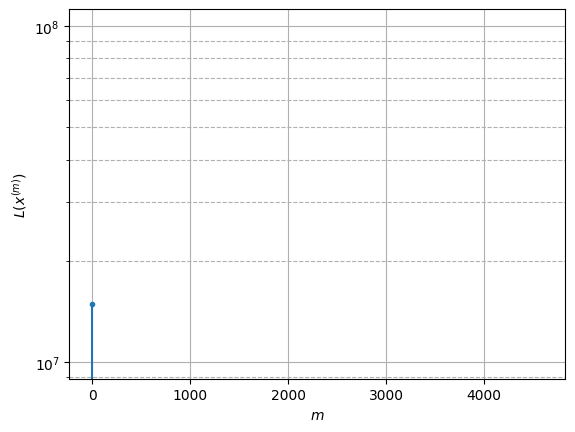

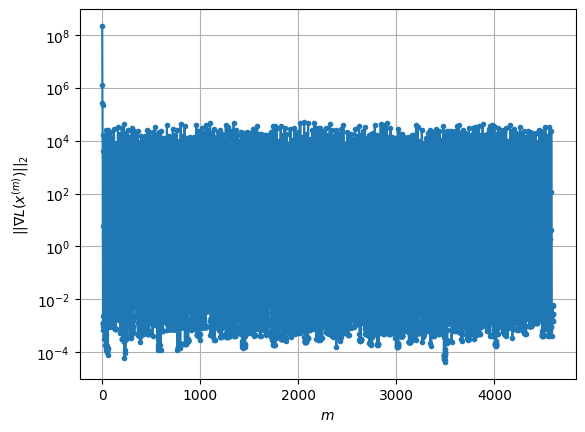

Windows:  61%|██████    | 230/376 [27:49<19:50,  8.16s/it]

Before applying the algorithm
Cost function: -3151328.76207932
Gradient norm: 29207.08863731736
Global relative error: 52.487608706799286
Position relative errors: 0.10742635457786204 m, 6.9600426852733115 m, 0.6029693190504005 m, 52.020485258052794 m

Iteration 1
Cost function: -3151331.2645677486 (-0.00%)
Gradient norm: 1259.0596102458296 (-95.69%)
Global relative error: 17.401663617635464 (-66.85%)
Position relative errors: 0.0908012446750147 m, 5.420785472709221 m, 0.2585250559418473 m, 16.53342446276127 m

Iteration 2
Cost function: -3151331.2854976733 (-0.00%)
Gradient norm: 0.4931071459894233 (-99.96%)
Global relative error: 17.772916196604143 (2.13%)
Position relative errors: 0.09080124353575364 m, 5.522600364508813 m, 0.2548805678359983 m, 16.89083653613579 m

Iteration 3
Cost function: -3151331.285498152 (-0.00%)
Gradient norm: 0.00266074080441575 (-99.46%)
Global relative error: 17.764475935277396 (-0.05%)
Position relative errors: 0.0908012438392807 m, 5.52318302183087 m, 0

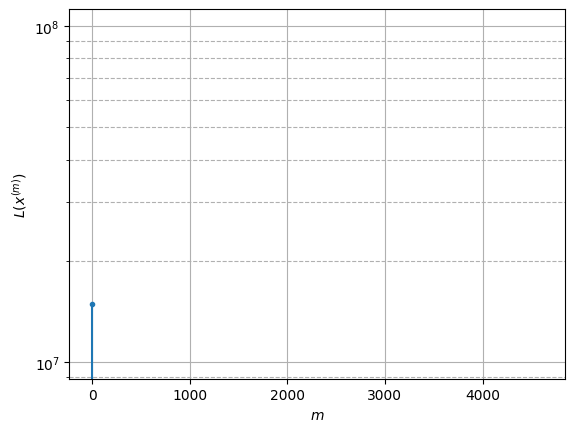

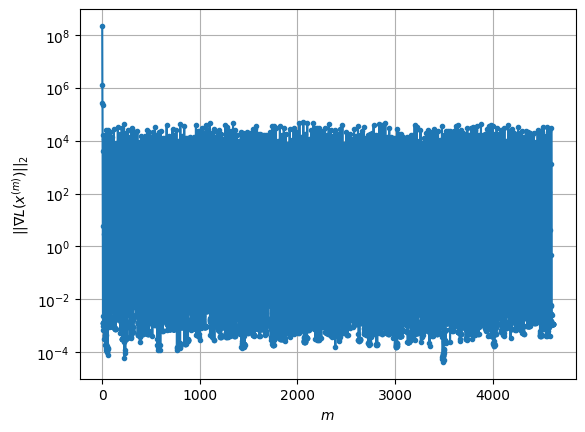

Windows:  61%|██████▏   | 231/376 [27:57<19:40,  8.14s/it]

Before applying the algorithm
Cost function: -3151336.175771398
Gradient norm: 29468.585951843725
Global relative error: 21.06296254068784
Position relative errors: 0.08381071469686832 m, 4.999439409086304 m, 0.22436086220020468 m, 20.459543502188875 m

Iteration 1
Cost function: -3151339.6277114325 (-0.00%)
Gradient norm: 91.37346236970397 (-99.69%)
Global relative error: 32.04650146618612 (52.15%)
Position relative errors: 0.07854032118795268 m, 14.132134140071827 m, 0.7718947132257848 m, 28.75161473947669 m

Iteration 2
Cost function: -3151339.628613636 (-0.00%)
Gradient norm: 0.04996958470509101 (-99.95%)
Global relative error: 31.294800188394234 (-2.35%)
Position relative errors: 0.07854032171424659 m, 13.8579292485466 m, 0.7534689805855339 m, 28.048969411236616 m

Iteration 3
Cost function: -3151339.6286136163 (0.00%)
Gradient norm: 0.005680262019837769 (-88.63%)
Global relative error: 31.294165197321526 (-0.00%)
Position relative errors: 0.078540321730769 m, 13.857526257045153 m

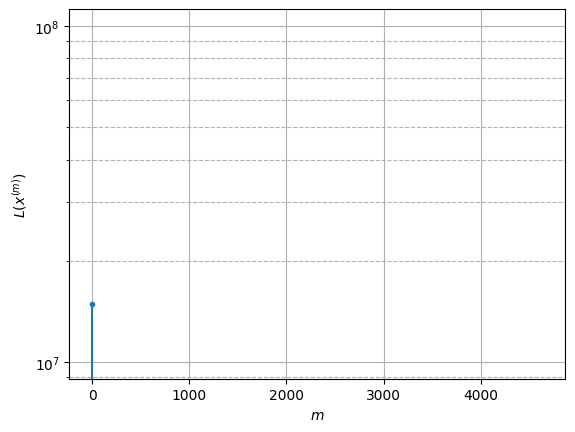

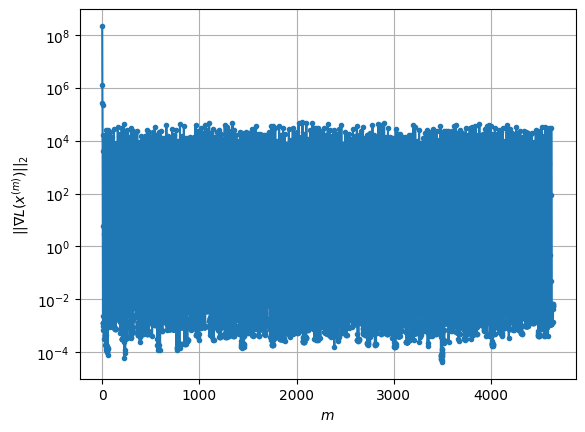

Windows:  62%|██████▏   | 232/376 [28:05<19:35,  8.17s/it]

Before applying the algorithm
Cost function: -3151333.0372132547
Gradient norm: 27674.271384201184
Global relative error: 34.29642728649857
Position relative errors: 0.07231029330370707 m, 13.631837311733689 m, 0.6903475751141065 m, 31.46319511380319 m

Iteration 1
Cost function: -3151336.107467757 (-0.00%)
Gradient norm: 56.631412987790426 (-99.80%)
Global relative error: 51.96740656536218 (51.52%)
Position relative errors: 0.08407075901935268 m, 17.674376940690568 m, 1.2295512685283565 m, 48.85394073731559 m

Iteration 2
Cost function: -3151336.108035595 (-0.00%)
Gradient norm: 0.1864836035195028 (-99.67%)
Global relative error: 52.62574658561338 (1.27%)
Position relative errors: 0.08407075694456712 m, 17.788887359150365 m, 1.2377223663528016 m, 49.51246692216823 m

Iteration 3
Cost function: -3151336.1080355938 (0.00%)
Gradient norm: 0.0020679162558073674 (-98.89%)
Global relative error: 52.62715689601553 (0.00%)
Position relative errors: 0.08407075694456712 m, 17.789046563093034 m,

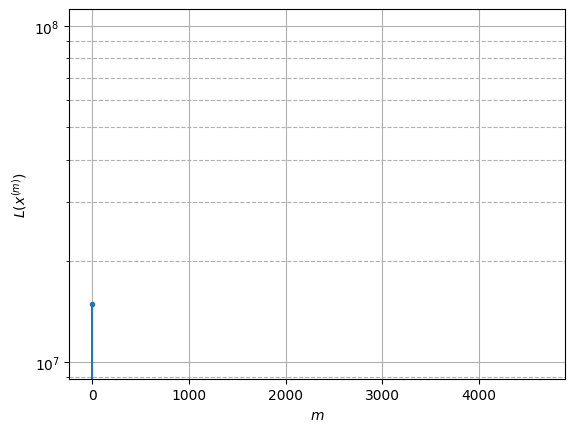

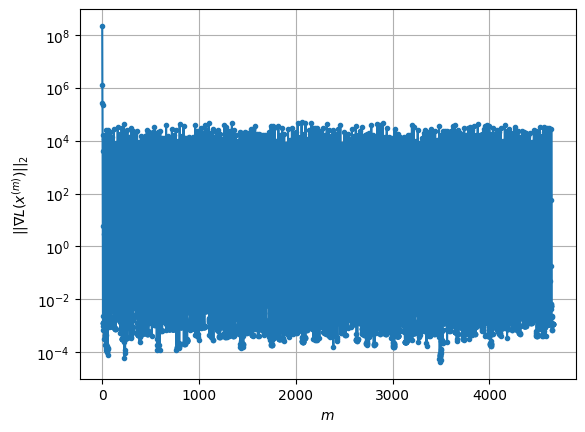

Windows:  62%|██████▏   | 233/376 [28:13<19:04,  8.00s/it]

Before applying the algorithm
Cost function: -3151332.645492699
Gradient norm: 20335.719189256935
Global relative error: 54.083043651343836
Position relative errors: 0.07642461986562311 m, 16.955725070524874 m, 1.0473437691001313 m, 51.34564390512794 m

Iteration 1
Cost function: -3151338.0244068974 (-0.00%)
Gradient norm: 226.21839730460533 (-98.89%)
Global relative error: 39.82292753797422 (-26.37%)
Position relative errors: 0.03855412967685939 m, 14.033181842000399 m, 1.0985157651710047 m, 37.25219839290135 m

Iteration 2
Cost function: -3151338.0305921705 (-0.00%)
Gradient norm: 4.645902472608743 (-97.95%)
Global relative error: 42.934545322839384 (7.81%)
Position relative errors: 0.03855413050719576 m, 14.146978659256975 m, 1.080661648558052 m, 40.5224399744187 m

Iteration 3
Cost function: -3151338.0305927247 (-0.00%)
Gradient norm: 0.0005098381409033089 (-99.99%)
Global relative error: 42.94867690638468 (0.03%)
Position relative errors: 0.03855413028918998 m, 14.147707011944009 

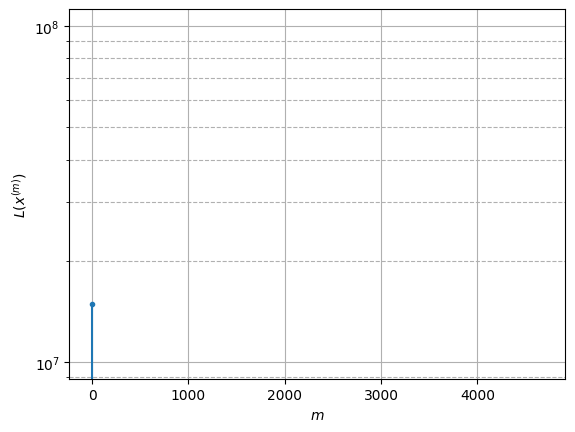

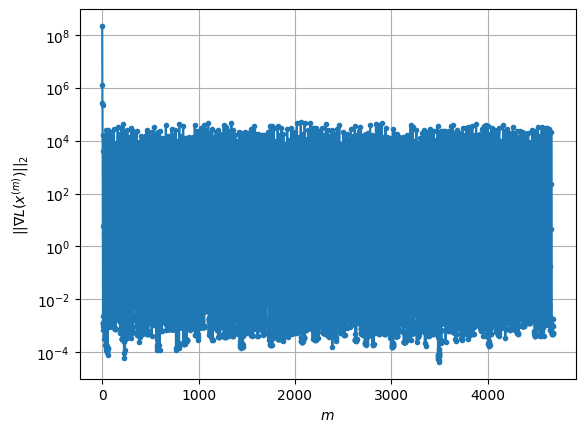

Windows:  62%|██████▏   | 234/376 [28:20<18:32,  7.83s/it]

Before applying the algorithm
Cost function: -3151336.913524259
Gradient norm: 21549.53071031918
Global relative error: 42.754505032639344
Position relative errors: 0.03397672861566088 m, 12.777695808162674 m, 1.0056362849658977 m, 40.788050070369415 m

Iteration 1
Cost function: -3151339.955323319 (-0.00%)
Gradient norm: 251.0533345875577 (-98.83%)
Global relative error: 11.080244653999195 (-74.08%)
Position relative errors: 0.021329379474470715 m, 1.6907281721184293 m, 0.9700345444106173 m, 10.907215857448609 m

Iteration 2
Cost function: -3151339.971557804 (-0.00%)
Gradient norm: 14.909777023672216 (-94.06%)
Global relative error: 9.556749969744665 (-13.75%)
Position relative errors: 0.021329375437728778 m, 1.4270578152078537 m, 0.9595838872456504 m, 9.400554168289455 m

Iteration 3
Cost function: -3151339.9715618636 (-0.00%)
Gradient norm: 0.0009787814355340057 (-99.99%)
Global relative error: 9.549181880027978 (-0.08%)
Position relative errors: 0.021329375931046272 m, 1.4228486814

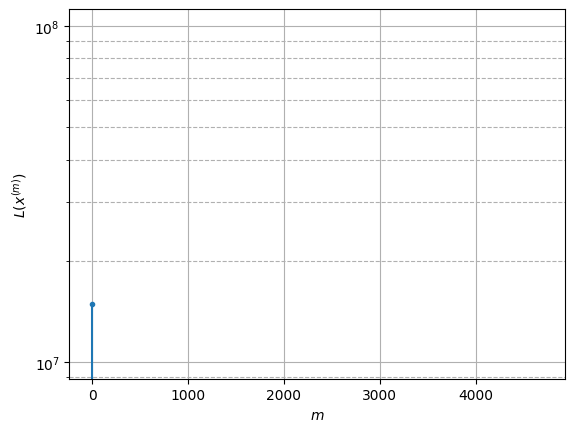

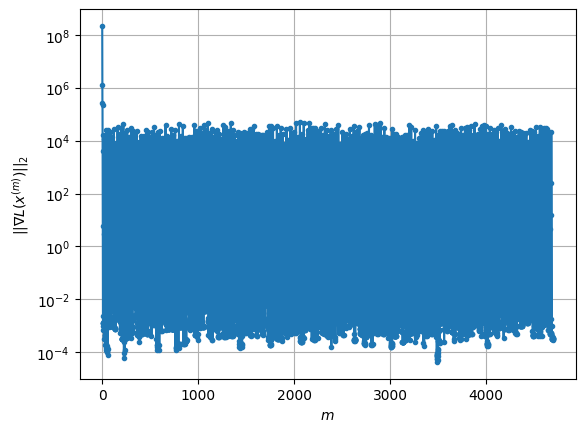

Windows:  62%|██████▎   | 235/376 [28:28<18:05,  7.70s/it]

Before applying the algorithm
Cost function: -3151344.3285286864
Gradient norm: 6575.15244557062
Global relative error: 9.334649205110242
Position relative errors: 0.01699927082295525 m, 1.3784635112024926 m, 0.8552048060924319 m, 9.192421986044668 m

Iteration 1
Cost function: -3151347.1280715903 (-0.00%)
Gradient norm: 390.07909451634356 (-94.07%)
Global relative error: 8.083572965439085 (-13.40%)
Position relative errors: 0.019468744984407975 m, 2.63930878808855 m, 1.2802021111066342 m, 7.53249463580448 m

Iteration 2
Cost function: -3151347.133619233 (-0.00%)
Gradient norm: 4.581359715186755 (-98.83%)
Global relative error: 6.792777191624808 (-15.97%)
Position relative errors: 0.019468746046604535 m, 2.6446025336282215 m, 1.2873907398442739 m, 6.122866822503753 m

Iteration 3
Cost function: -3151347.1336199846 (-0.00%)
Gradient norm: 0.0016195841045227048 (-99.96%)
Global relative error: 6.780450117875372 (-0.18%)
Position relative errors: 0.01946874613244137 m, 2.643489743763235 m

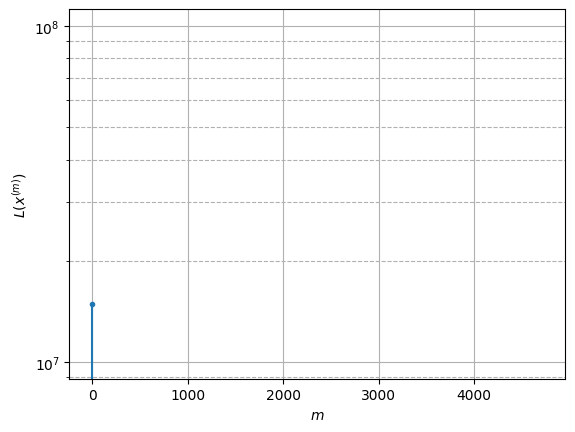

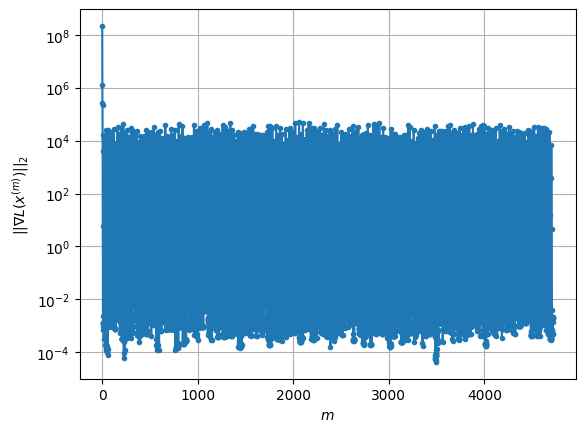

Windows:  63%|██████▎   | 236/376 [28:35<17:42,  7.59s/it]

Before applying the algorithm
Cost function: -3151344.693640815
Gradient norm: 17079.59824590651
Global relative error: 8.078361836565684
Position relative errors: 0.01935766627346534 m, 2.5958361985490375 m, 1.4115998703709784 m, 7.518507215975316 m

Iteration 1
Cost function: -3151348.8271838487 (-0.00%)
Gradient norm: 237.62699009335458 (-98.61%)
Global relative error: 26.74369322513335 (231.05%)
Position relative errors: 0.028982879980171156 m, 16.347251070188985 m, 1.8529810886629334 m, 21.08453967107482 m

Iteration 2
Cost function: -3151348.839921558 (-0.00%)
Gradient norm: 7.5074326670390965 (-96.84%)
Global relative error: 30.389018694244452 (13.63%)
Position relative errors: 0.028982882907713146 m, 15.90987514970978 m, 1.853875017221667 m, 25.824987561192376 m

Iteration 3
Cost function: -3151348.8399231927 (-0.00%)
Gradient norm: 0.001353235280474781 (-99.98%)
Global relative error: 30.415542124188615 (0.09%)
Position relative errors: 0.028982882814241977 m, 15.9059866054570

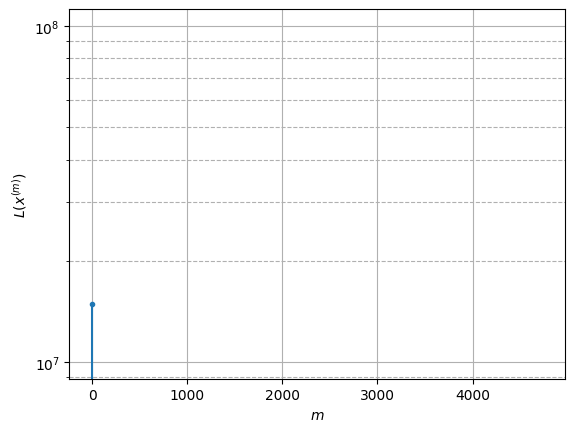

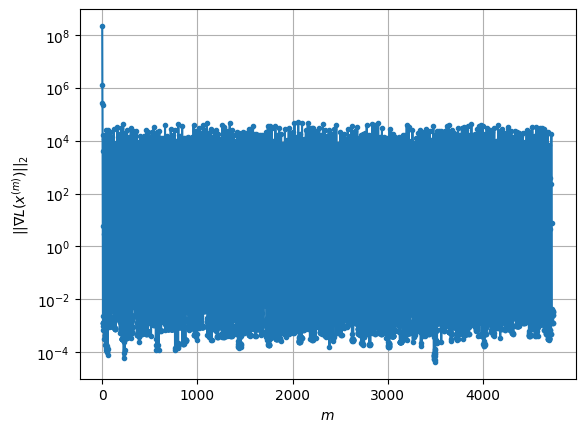

Windows:  63%|██████▎   | 237/376 [28:42<17:19,  7.48s/it]

Before applying the algorithm
Cost function: -3151341.974067175
Gradient norm: 11283.091121507836
Global relative error: 29.03836811190341
Position relative errors: 0.02889657863975585 m, 15.794441029940218 m, 1.7621242214300208 m, 24.303411087906973 m

Iteration 1
Cost function: -3151343.834857832 (-0.00%)
Gradient norm: 523.3915540689059 (-95.36%)
Global relative error: 21.690211524841338 (-25.30%)
Position relative errors: 0.045725233276096934 m, 19.580417028128124 m, 1.1418702068499547 m, 9.260948228014286 m

Iteration 2
Cost function: -3151343.851606871 (-0.00%)
Gradient norm: 11.836632759491247 (-97.74%)
Global relative error: 24.394088654757375 (12.47%)
Position relative errors: 0.045725229847339385 m, 20.0688097230184 m, 1.143643124073554 m, 13.820355487452915 m

Iteration 3
Cost function: -3151343.8516123337 (-0.00%)
Gradient norm: 0.0037789137810726693 (-99.97%)
Global relative error: 24.437180051339872 (0.18%)
Position relative errors: 0.04572522961543127 m, 20.0750767251251

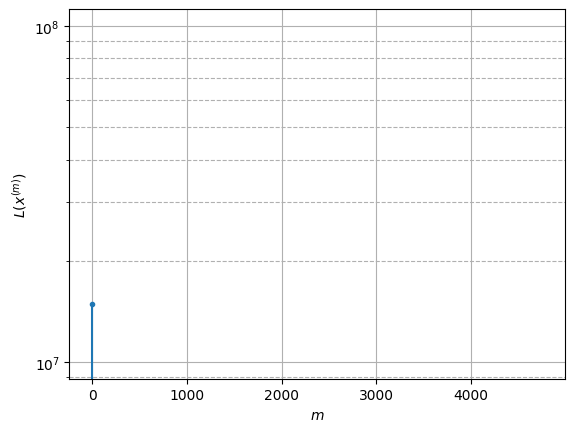

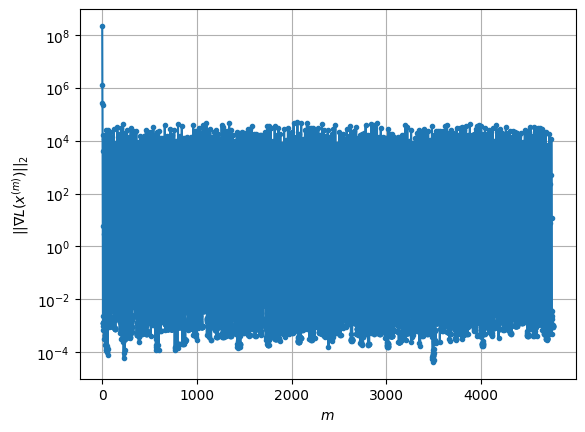

Windows:  63%|██████▎   | 238/376 [28:50<17:07,  7.44s/it]

Before applying the algorithm
Cost function: -3151341.601165697
Gradient norm: 38943.83096408044
Global relative error: 22.362293388048304
Position relative errors: 0.04382785826232886 m, 19.369560027869518 m, 0.8631434712311339 m, 11.14195004757877 m

Iteration 1
Cost function: -3151346.6754834815 (-0.00%)
Gradient norm: 425.7710461951419 (-98.91%)
Global relative error: 40.21133557384065 (79.82%)
Position relative errors: 0.0792167015028904 m, 14.408660512933343 m, 4.600153226609465 m, 37.258100573981515 m

Iteration 2
Cost function: -3151346.6838534437 (-0.00%)
Gradient norm: 1.6545247738217592 (-99.61%)
Global relative error: 37.093738803997105 (-7.75%)
Position relative errors: 0.07921670906203186 m, 13.933064038728666 m, 4.618493178343297 m, 34.06567725907277 m

Iteration 3
Cost function: -3151346.683853801 (-0.00%)
Gradient norm: 0.00436531024386919 (-99.74%)
Global relative error: 37.074154903629484 (-0.05%)
Position relative errors: 0.07921670890855528 m, 13.9325685978513 m, 4

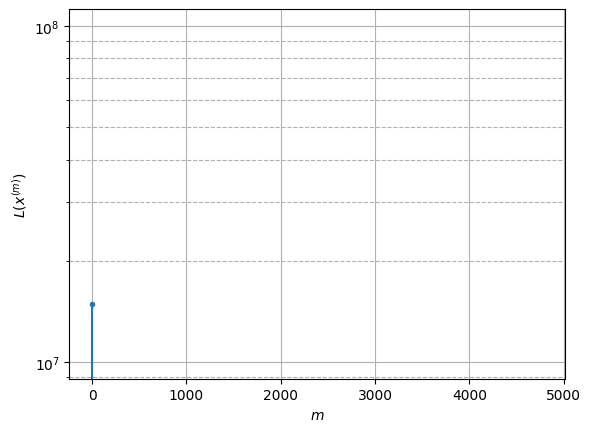

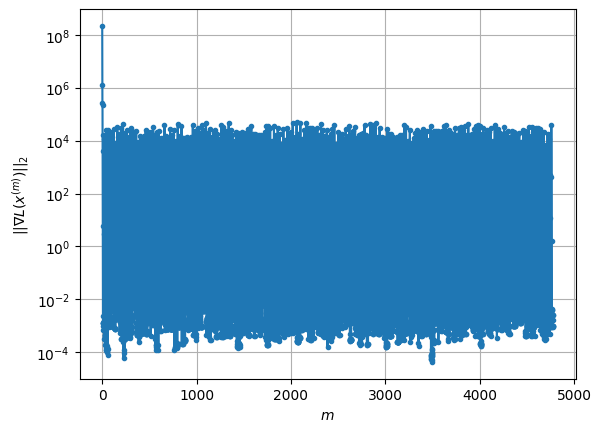

Windows:  64%|██████▎   | 239/376 [28:57<17:01,  7.45s/it]

Before applying the algorithm
Cost function: -3151349.080457208
Gradient norm: 13194.077263447736
Global relative error: 32.12651253811432
Position relative errors: 0.07462614378189916 m, 13.914911237112399 m, 4.104911450238526 m, 28.663980623971 m

Iteration 1
Cost function: -3151350.841900223 (-0.00%)
Gradient norm: 115.04178562593864 (-99.13%)
Global relative error: 54.15011127565089 (68.55%)
Position relative errors: 0.07985878569545861 m, 9.139846748066953 m, 2.479302710027951 m, 53.315382718974554 m

Iteration 2
Cost function: -3151350.845231818 (-0.00%)
Gradient norm: 1.108760871159155 (-99.04%)
Global relative error: 56.65550880884893 (4.63%)
Position relative errors: 0.07985878537823471 m, 9.191511215075604 m, 2.5346608436779037 m, 55.84726204292172 m

Iteration 3
Cost function: -3151350.8452319703 (-0.00%)
Gradient norm: 0.003527864374824218 (-99.68%)
Global relative error: 56.67221595723406 (0.03%)
Position relative errors: 0.07985878540726034 m, 9.191864474171254 m, 2.53476

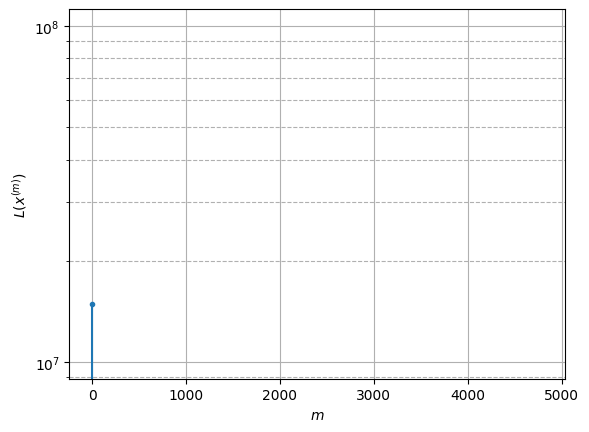

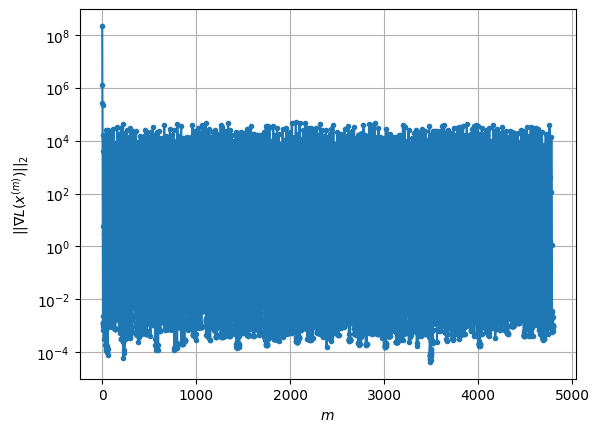

Windows:  64%|██████▍   | 240/376 [29:05<16:51,  7.44s/it]

Before applying the algorithm
Cost function: -3151352.1194991744
Gradient norm: 17673.096101121428
Global relative error: 49.29809221647707
Position relative errors: 0.0751072985853906 m, 9.227229397149717 m, 2.090922381848749 m, 48.3814677680924 m

Iteration 1
Cost function: -3151354.357876177 (-0.00%)
Gradient norm: 346.57838416162554 (-98.04%)
Global relative error: 27.805999832604876 (-43.60%)
Position relative errors: 0.07636696880509747 m, 6.555778520752986 m, 9.644277986120956 m, 25.242232677766722 m

Iteration 2
Cost function: -3151354.365985947 (-0.00%)
Gradient norm: 3.406023342279945 (-99.02%)
Global relative error: 31.439082401783157 (13.07%)
Position relative errors: 0.07636696635053022 m, 6.839250398930564 m, 9.535930641778597 m, 29.166636269029006 m

Iteration 3
Cost function: -3151354.3659867668 (-0.00%)
Gradient norm: 0.0017518579609298415 (-99.95%)
Global relative error: 31.466175834740074 (0.09%)
Position relative errors: 0.07636696645850768 m, 6.841181589311288 m, 9

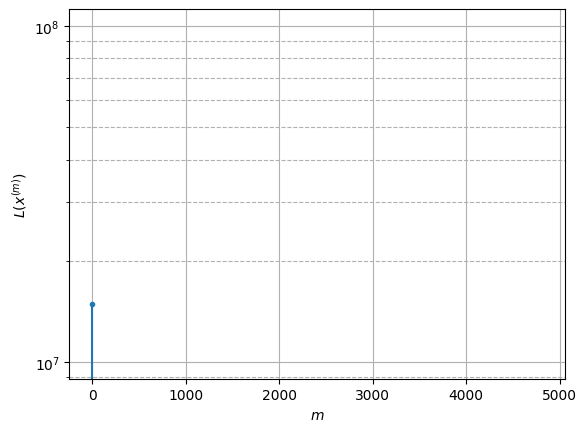

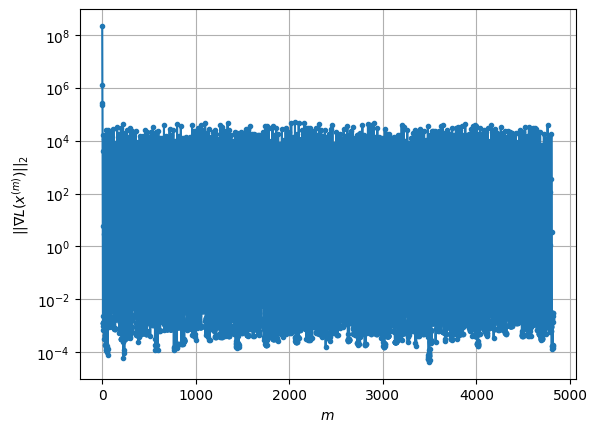

Windows:  64%|██████▍   | 241/376 [29:12<16:50,  7.49s/it]

Before applying the algorithm
Cost function: -3151355.8830345403
Gradient norm: 15999.864970477274
Global relative error: 26.40394452275524
Position relative errors: 0.07277981207580123 m, 7.230476968973597 m, 8.121465779197244 m, 24.060685663097015 m

Iteration 1
Cost function: -3151359.64146993 (-0.00%)
Gradient norm: 34.04901183619369 (-99.79%)
Global relative error: 22.700753821148748 (-14.03%)
Position relative errors: 0.06309567993260976 m, 8.818023723424785 m, 10.138739073751353 m, 18.296486350361942 m

Iteration 2
Cost function: -3151359.642676192 (-0.00%)
Gradient norm: 0.7569053985316543 (-97.78%)
Global relative error: 23.95367015416152 (5.52%)
Position relative errors: 0.06309567642724243 m, 8.926080690850213 m, 10.223044622934207 m, 19.737808201966054 m

Iteration 3
Cost function: -3151359.642676217 (-0.00%)
Gradient norm: 0.0017605827140812695 (-99.77%)
Global relative error: 23.955591318364977 (0.01%)
Position relative errors: 0.06309567645195234 m, 8.92622785791458 m, 1

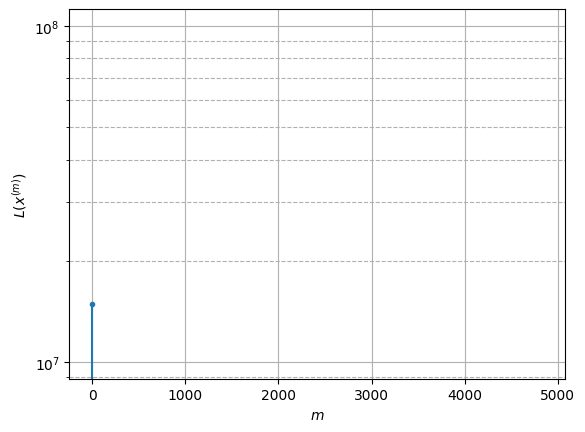

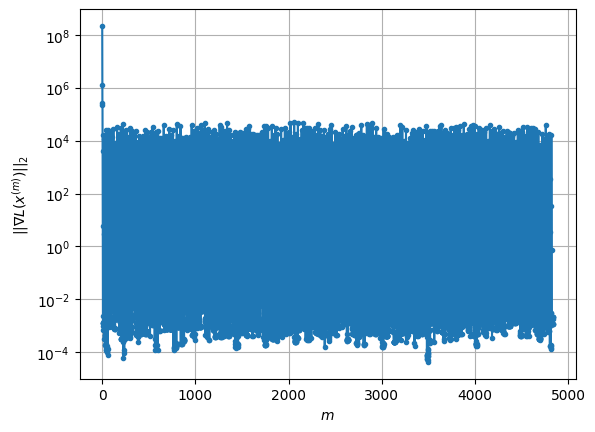

Windows:  64%|██████▍   | 242/376 [29:20<16:39,  7.46s/it]

Before applying the algorithm
Cost function: -3151359.678315281
Gradient norm: 24952.679932260868
Global relative error: 19.582636794326476
Position relative errors: 0.05985758144904105 m, 9.202693593599575 m, 8.861913041824302 m, 14.840658757412363 m

Iteration 1
Cost function: -3151363.858940562 (-0.00%)
Gradient norm: 56.24236136978357 (-99.77%)
Global relative error: 10.876741371330592 (-44.46%)
Position relative errors: 0.07461413215722282 m, 3.35597486196422 m, 2.5504611241168225 m, 10.02625419887646 m

Iteration 2
Cost function: -3151363.8610059223 (-0.00%)
Gradient norm: 0.36098225256842126 (-99.36%)
Global relative error: 10.827331343551005 (-0.45%)
Position relative errors: 0.0746141317090836 m, 3.4796103017964186 m, 2.373194929693034 m, 9.974027469922229 m

Iteration 3
Cost function: -3151363.8610059274 (-0.00%)
Gradient norm: 0.002350842810431902 (-99.35%)
Global relative error: 10.827176008300079 (-0.00%)
Position relative errors: 0.07461413182223131 m, 3.4794025557271637 

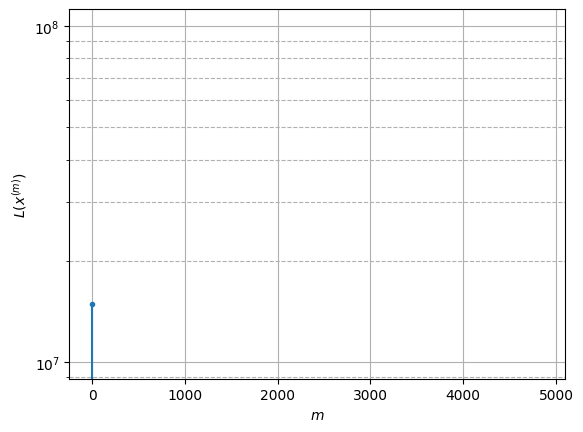

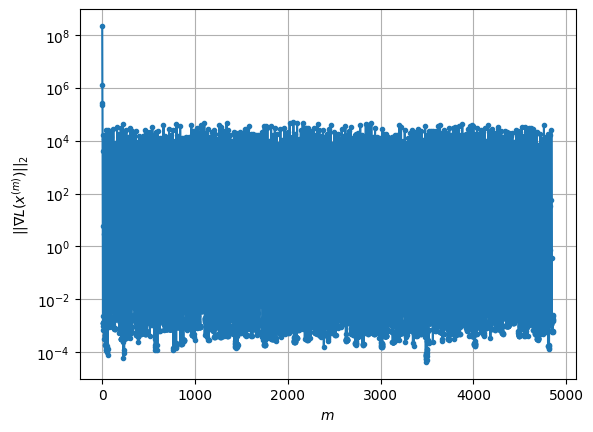

Windows:  65%|██████▍   | 243/376 [29:27<16:24,  7.40s/it]

Before applying the algorithm
Cost function: -3151352.7252116734
Gradient norm: 18055.22312326898
Global relative error: 11.940311074367498
Position relative errors: 0.06980826250116405 m, 3.605498704975445 m, 2.0803697533954293 m, 11.190805471879937 m

Iteration 1
Cost function: -3151358.9626607234 (-0.00%)
Gradient norm: 177.54522946040777 (-99.02%)
Global relative error: 24.326816589603514 (103.74%)
Position relative errors: 0.06595734076031008 m, 14.183100492384476 m, 12.658358756153774 m, 15.178620391759194 m

Iteration 2
Cost function: -3151358.975873997 (-0.00%)
Gradient norm: 8.951170008461075 (-94.96%)
Global relative error: 23.8881346152023 (-1.80%)
Position relative errors: 0.0659573403248088 m, 15.361035513391657 m, 13.24122617094244 m, 12.623044353421987 m

Iteration 3
Cost function: -3151358.9758752696 (-0.00%)
Gradient norm: 0.0004888166231181609 (-99.99%)
Global relative error: 23.88483929921656 (-0.01%)
Position relative errors: 0.06595734069771296 m, 15.36502980691426

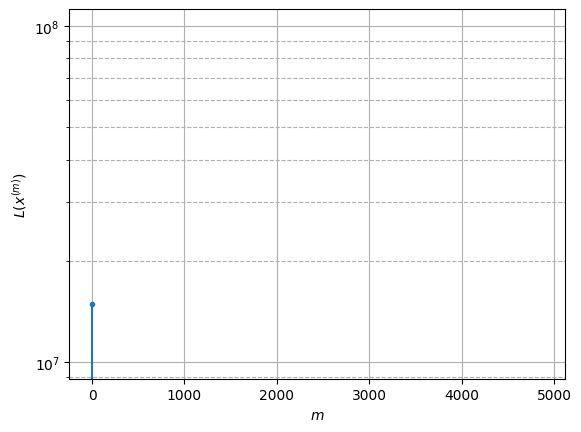

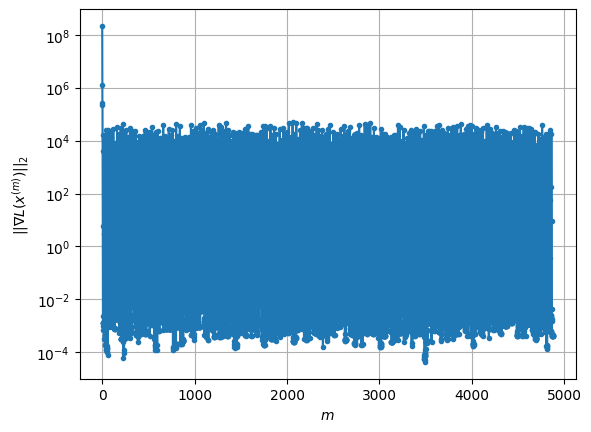

Windows:  65%|██████▍   | 244/376 [29:34<16:12,  7.37s/it]

Before applying the algorithm
Cost function: -3151357.7220334643
Gradient norm: 23494.199309459244
Global relative error: 25.21478800854749
Position relative errors: 0.06116692366411043 m, 13.49709562390482 m, 13.136130697275215 m, 16.76444071301206 m

Iteration 1
Cost function: -3151361.119272893 (-0.00%)
Gradient norm: 93.34378716680143 (-99.60%)
Global relative error: 24.249779524085305 (-3.83%)
Position relative errors: 0.07196949827280988 m, 9.912445490231926 m, 7.769979978443646 m, 20.72225486703472 m

Iteration 2
Cost function: -3151361.122061656 (-0.00%)
Gradient norm: 1.9807064909563838 (-97.88%)
Global relative error: 24.117259277515554 (-0.55%)
Position relative errors: 0.07196949106587275 m, 10.037438278395204 m, 7.607905000534217 m, 20.56697985470051 m

Iteration 3
Cost function: -3151361.122061729 (-0.00%)
Gradient norm: 0.0012030708100506328 (-99.94%)
Global relative error: 24.115805920120394 (-0.01%)
Position relative errors: 0.07196949118676939 m, 10.038272221922691 m,

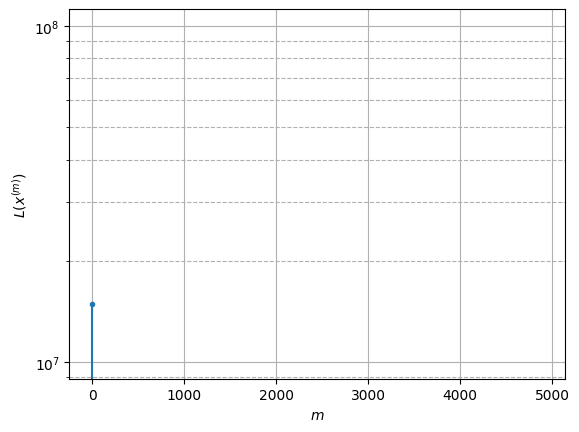

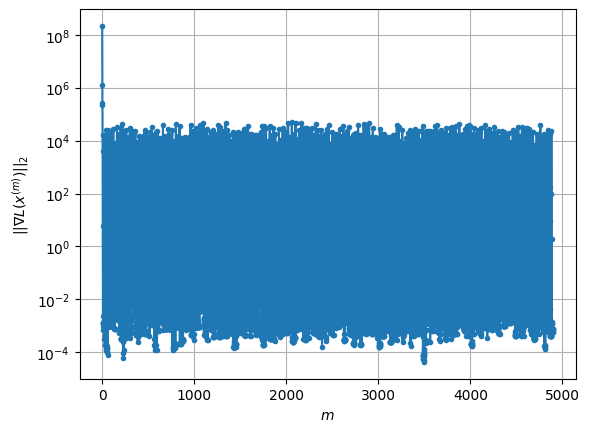

Windows:  65%|██████▌   | 245/376 [29:42<16:16,  7.45s/it]

Before applying the algorithm
Cost function: -3151356.5664389394
Gradient norm: 17359.53913725319
Global relative error: 27.663135232562823
Position relative errors: 0.06636792740774386 m, 9.03559542741777 m, 7.932046305061069 m, 24.913441400888136 m

Iteration 1
Cost function: -3151361.3337859428 (-0.00%)
Gradient norm: 48.881559195921184 (-99.72%)
Global relative error: 27.443814739450076 (-0.79%)
Position relative errors: 0.10005170271970339 m, 13.456078256753697 m, 15.660893963906071 m, 18.078001833838766 m

Iteration 2
Cost function: -3151361.334279076 (-0.00%)
Gradient norm: 0.06237981982968113 (-99.87%)
Global relative error: 27.12294307809015 (-1.17%)
Position relative errors: 0.10005171098611501 m, 13.730006489515885 m, 15.726250460290593 m, 17.31492622480261 m

Iteration 3
Cost function: -3151361.3342790795 (-0.00%)
Gradient norm: 0.0017670015447764891 (-97.17%)
Global relative error: 27.12256881546591 (-0.00%)
Position relative errors: 0.10005171166247757 m, 13.7302577619697

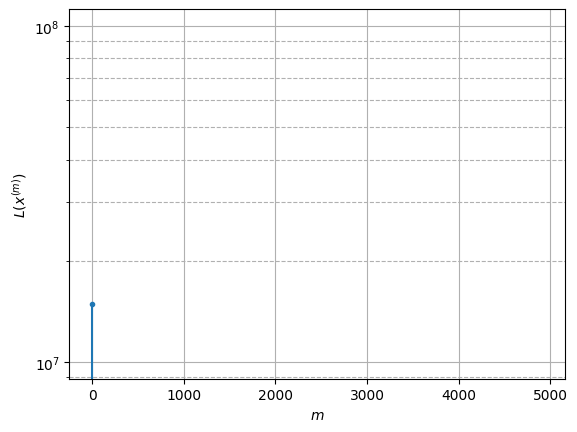

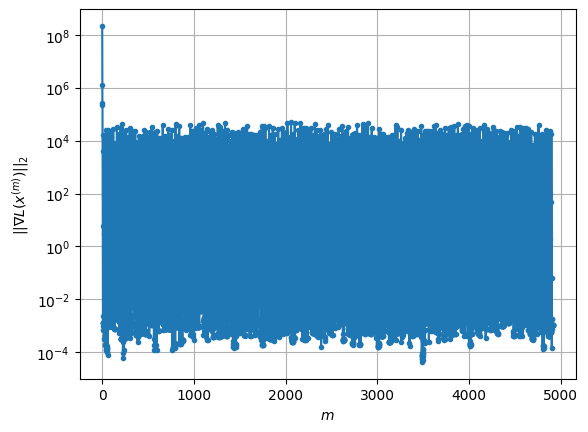

Windows:  65%|██████▌   | 246/376 [29:49<16:08,  7.45s/it]

Before applying the algorithm
Cost function: -3151359.1514951
Gradient norm: 32438.403904595536
Global relative error: 29.548767487947295
Position relative errors: 0.0902193329070282 m, 12.199509507441904 m, 15.754195744827172 m, 21.81948007334207 m

Iteration 1
Cost function: -3151362.1023521437 (-0.00%)
Gradient norm: 342.7409950386559 (-98.94%)
Global relative error: 67.52085770196062 (128.51%)
Position relative errors: 0.0630065822456048 m, 5.4493965761467695 m, 11.169038124916822 m, 66.36729544563248 m

Iteration 2
Cost function: -3151362.112284967 (-0.00%)
Gradient norm: 1.8248216872468703 (-99.47%)
Global relative error: 65.23680900977695 (-3.38%)
Position relative errors: 0.06300658930298701 m, 6.156660857983538 m, 11.797723853811034 m, 63.86505500344608 m

Iteration 3
Cost function: -3151362.1122855595 (-0.00%)
Gradient norm: 0.0017757802687610382 (-99.90%)
Global relative error: 65.2013766893904 (-0.05%)
Position relative errors: 0.06300659075451824 m, 6.163368072959529 m, 11

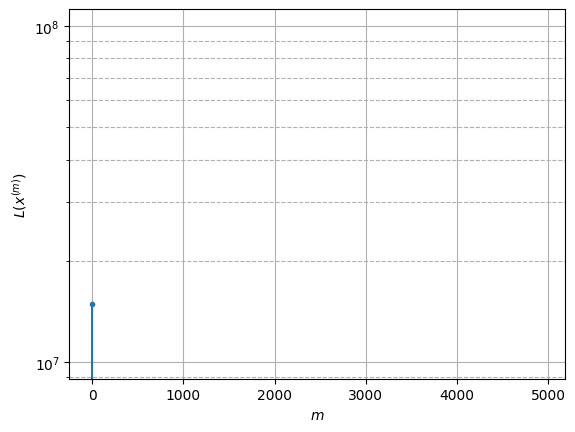

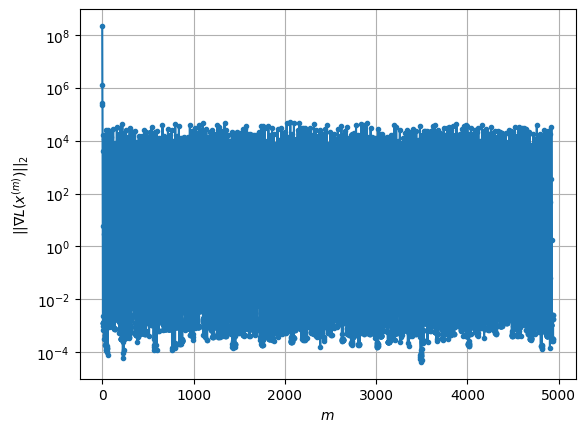

Windows:  66%|██████▌   | 247/376 [29:57<16:25,  7.64s/it]

Before applying the algorithm
Cost function: -3151354.751695213
Gradient norm: 41479.89461798109
Global relative error: 66.69617944287054
Position relative errors: 0.05450852654374698 m, 5.582379745786045 m, 11.76415916732665 m, 65.41267473668452 m

Iteration 1
Cost function: -3151357.0872921012 (-0.00%)
Gradient norm: 28.408670761038696 (-99.93%)
Global relative error: 69.58017494798408 (4.32%)
Position relative errors: 0.043741676416378626 m, 1.4447638798553033 m, 3.365230695356014 m, 69.48370338309267 m

Iteration 2
Cost function: -3151357.087434066 (-0.00%)
Gradient norm: 0.015507346908302954 (-99.95%)
Global relative error: 69.6610646632454 (0.12%)
Position relative errors: 0.043741675491886595 m, 1.4089081051376642 m, 3.3780395978179785 m, 69.56481996234463 m

Iteration 3
Cost function: -3151357.087434056 (0.00%)
Gradient norm: 0.0016927912406898748 (-89.08%)
Global relative error: 69.6610827097981 (0.00%)
Position relative errors: 0.0437416755325263 m, 1.4088990819815372 m, 3.37

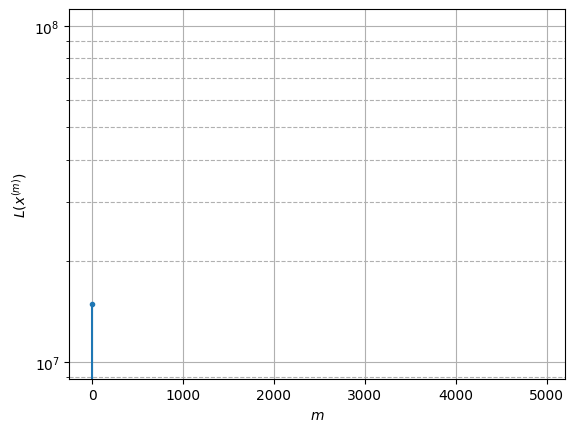

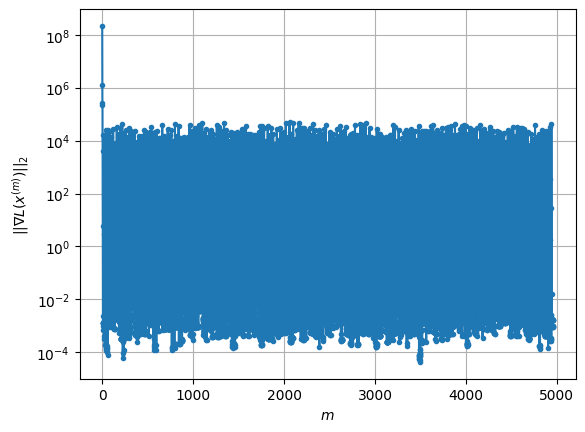

Windows:  66%|██████▌   | 248/376 [30:06<16:42,  7.83s/it]

Before applying the algorithm
Cost function: -3151343.7107980624
Gradient norm: 25561.967536765496
Global relative error: 71.50652124503604
Position relative errors: 0.038704829566533164 m, 0.7354139572998022 m, 4.222771642474591 m, 71.37791769796901 m

Iteration 1
Cost function: -3151346.3852419895 (-0.00%)
Gradient norm: 49.72383689568197 (-99.81%)
Global relative error: 81.23641962008126 (13.61%)
Position relative errors: 0.022710984045000132 m, 1.9965724554433129 m, 11.62531837683443 m, 80.37549043802602 m

Iteration 2
Cost function: -3151346.385761694 (-0.00%)
Gradient norm: 0.07463538584411371 (-99.85%)
Global relative error: 82.01627825221284 (0.96%)
Position relative errors: 0.022710985366892145 m, 1.9164284935403728 m, 11.937820996515423 m, 81.12017999456789 m

Iteration 3
Cost function: -3151346.385761687 (0.00%)
Gradient norm: 0.0035603066267788004 (-95.23%)
Global relative error: 82.01673585683798 (0.00%)
Position relative errors: 0.02271098539519595 m, 1.9163740172835848 m

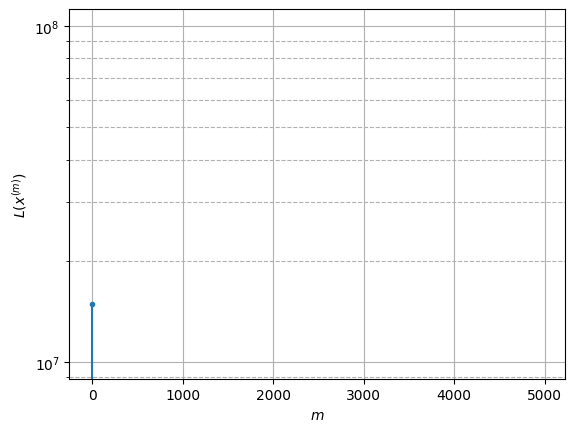

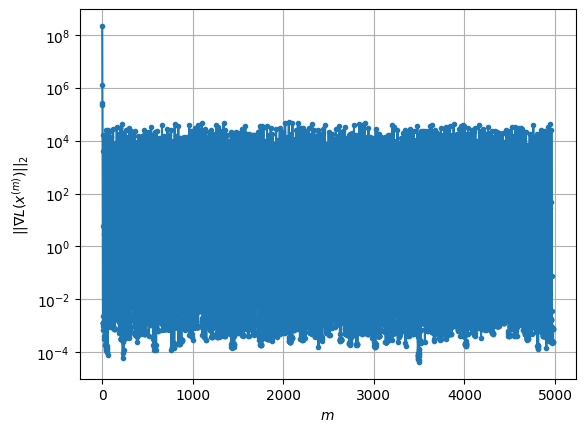

Windows:  66%|██████▌   | 249/376 [30:14<16:50,  7.95s/it]

Before applying the algorithm
Cost function: -3151343.2869497603
Gradient norm: 9802.82040112143
Global relative error: 83.58203656652036
Position relative errors: 0.019091150130699848 m, 1.2224394279076334 m, 12.971229847987628 m, 82.5603304492763 m

Iteration 1
Cost function: -3151345.6937922826 (-0.00%)
Gradient norm: 338.45869397545516 (-96.55%)
Global relative error: 58.241268108112145 (-30.32%)
Position relative errors: 0.06024465013650659 m, 20.86583348252324 m, 14.700091262049092 m, 52.350341244447655 m

Iteration 2
Cost function: -3151345.701192936 (-0.00%)
Gradient norm: 3.4637465160775758 (-98.98%)
Global relative error: 59.81888663383881 (2.71%)
Position relative errors: 0.06024465093111001 m, 20.009183315710217 m, 14.511049693679002 m, 54.47339446618546 m

Iteration 3
Cost function: -3151345.701193457 (-0.00%)
Gradient norm: 0.0018281218166133458 (-99.95%)
Global relative error: 59.83105790612855 (0.02%)
Position relative errors: 0.06024465093111001 m, 20.0013472888475 m, 

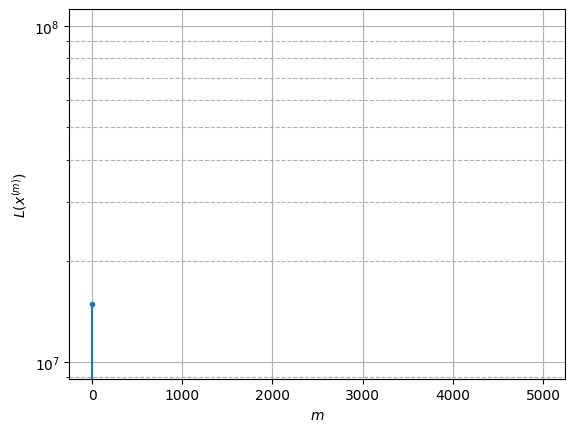

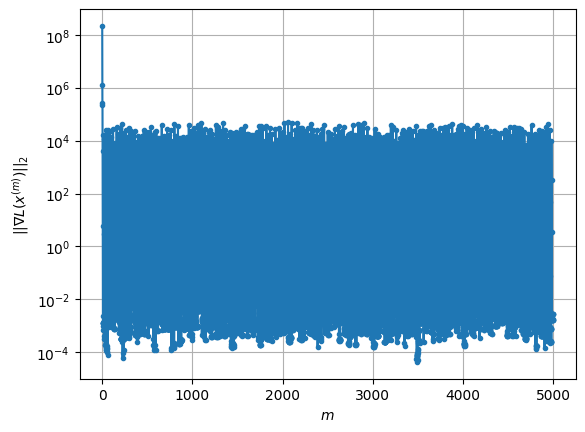

Windows:  66%|██████▋   | 250/376 [30:22<16:45,  7.98s/it]

Before applying the algorithm
Cost function: -3151340.0113649126
Gradient norm: 33786.525846490396
Global relative error: 62.684980632078336
Position relative errors: 0.05511620192960521 m, 17.236569738146827 m, 14.867794850494306 m, 58.405878673562874 m

Iteration 1
Cost function: -3151343.272100815 (-0.00%)
Gradient norm: 140.8790914870377 (-99.58%)
Global relative error: 45.61505979090265 (-27.23%)
Position relative errors: 0.05686136225219834 m, 29.91920862715042 m, 24.777003263306046 m, 23.909447018843174 m

Iteration 2
Cost function: -3151343.2756629824 (-0.00%)
Gradient norm: 0.2347522825811299 (-99.83%)
Global relative error: 45.81612986037528 (0.44%)
Position relative errors: 0.05686135553174997 m, 29.24747181934674 m, 24.724079263541334 m, 25.147770138111046 m

Iteration 3
Cost function: -3151343.275663012 (-0.00%)
Gradient norm: 0.004051596846340107 (-98.27%)
Global relative error: 45.818640645558595 (0.01%)
Position relative errors: 0.05686135553174997 m, 29.243690537697894

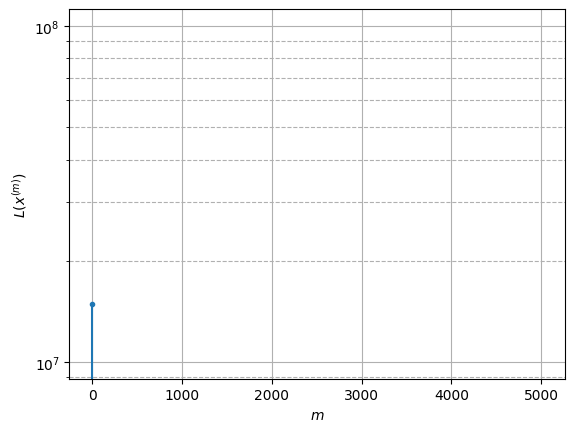

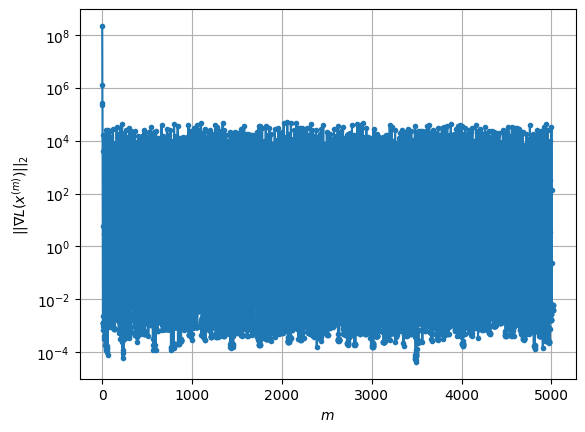

Windows:  67%|██████▋   | 251/376 [30:30<16:35,  7.96s/it]

Before applying the algorithm
Cost function: -3151334.996692774
Gradient norm: 36538.82424809674
Global relative error: 46.12369103488882
Position relative errors: 0.05051138457250666 m, 25.881235476112916 m, 23.98956019365932 m, 29.69925140437553 m

Iteration 1
Cost function: -3151340.665189577 (-0.00%)
Gradient norm: 187.09918917981528 (-99.49%)
Global relative error: 28.449875648189707 (-38.32%)
Position relative errors: 0.04423112967139785 m, 26.31636420482501 m, 8.174949189938024 m, 7.071490370139995 m

Iteration 2
Cost function: -3151340.674817044 (-0.00%)
Gradient norm: 1.864239624728255 (-99.00%)
Global relative error: 29.179537320552505 (2.56%)
Position relative errors: 0.04423110745219082 m, 27.041487730286754 m, 8.680384607267275 m, 6.696654984831391 m

Iteration 3
Cost function: -3151340.6748172543 (-0.00%)
Gradient norm: 0.0017002699479565237 (-99.91%)
Global relative error: 29.18343807813945 (0.01%)
Position relative errors: 0.04423110745219082 m, 27.044733908534422 m, 8.

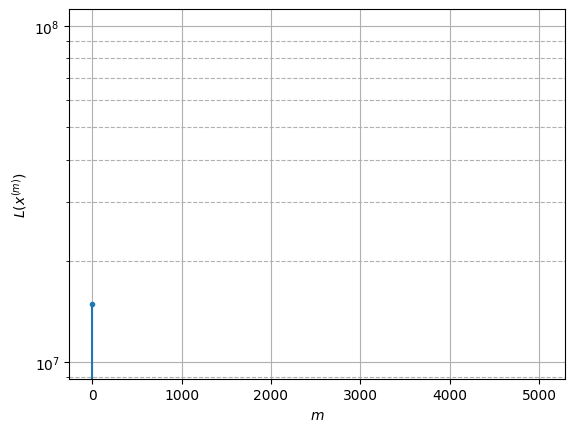

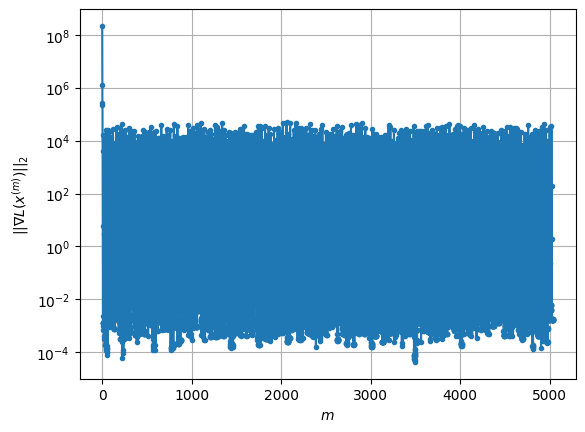

Windows:  67%|██████▋   | 252/376 [30:38<16:20,  7.90s/it]

Before applying the algorithm
Cost function: -3151343.174238685
Gradient norm: 13002.202239599968
Global relative error: 28.50848984012331
Position relative errors: 0.039051309828623045 m, 25.068464256133375 m, 8.275065252905103 m, 10.76200354104652 m

Iteration 1
Cost function: -3151346.6992746866 (-0.00%)
Gradient norm: 101.28346150008238 (-99.22%)
Global relative error: 22.585904987331954 (-20.77%)
Position relative errors: 0.04639060026090135 m, 21.696674684208094 m, 4.60258793684632 m, 4.2644263334396895 m

Iteration 2
Cost function: -3151346.7014786755 (-0.00%)
Gradient norm: 0.6555993591855029 (-99.35%)
Global relative error: 22.60918025181992 (0.10%)
Position relative errors: 0.04639059907193405 m, 21.581868046611174 m, 5.184860343574527 m, 4.301968875707715 m

Iteration 3
Cost function: -3151346.701478693 (-0.00%)
Gradient norm: 0.002470339327790106 (-99.62%)
Global relative error: 22.608589637369683 (-0.00%)
Position relative errors: 0.0463905988874059 m, 21.5813358864377 m, 

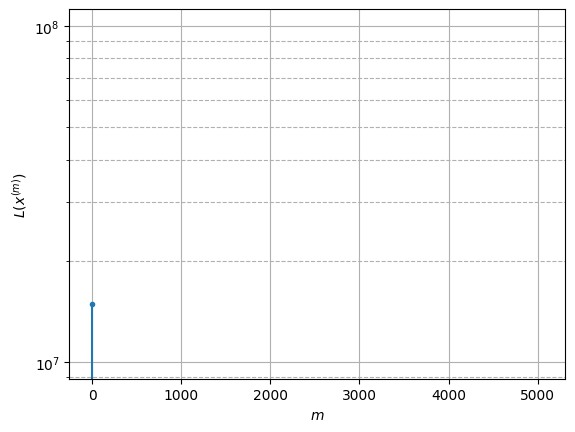

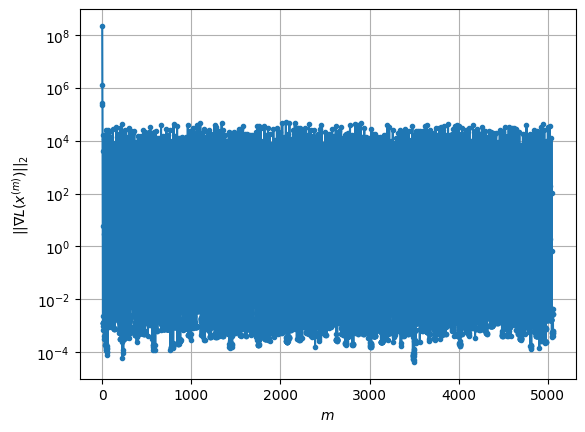

Windows:  67%|██████▋   | 253/376 [30:45<16:08,  7.87s/it]

Before applying the algorithm
Cost function: -3151336.7518668543
Gradient norm: 30487.100433602533
Global relative error: 20.85505798622033
Position relative errors: 0.041938065921090735 m, 19.715495307355923 m, 4.065740782502466 m, 5.449265944615678 m

Iteration 1
Cost function: -3151341.3465880626 (-0.00%)
Gradient norm: 883.8559116822805 (-97.10%)
Global relative error: 62.08436696709199 (197.69%)
Position relative errors: 0.041606833078105775 m, 19.688694575138815 m, 6.991959289964558 m, 58.46309453426147 m

Iteration 2
Cost function: -3151341.3909512656 (-0.00%)
Gradient norm: 15.513872117536424 (-98.24%)
Global relative error: 56.20495027474124 (-9.47%)
Position relative errors: 0.04160678827868265 m, 18.8779696110032 m, 7.115722754014786 m, 52.45934044219511 m

Iteration 3
Cost function: -3151341.3909672718 (-0.00%)
Gradient norm: 0.008385732707098942 (-99.95%)
Global relative error: 56.07551190718083 (-0.23%)
Position relative errors: 0.04160678756756499 m, 18.84455328953177 m,

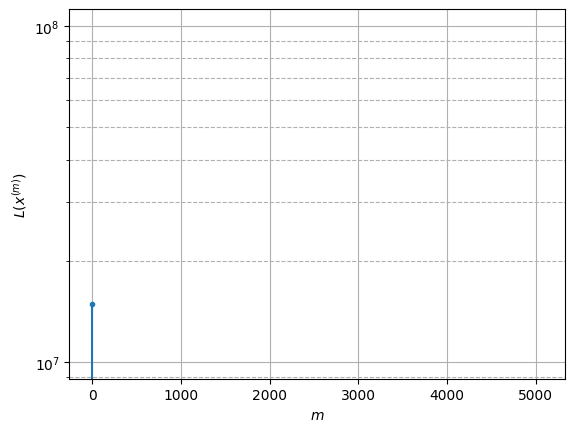

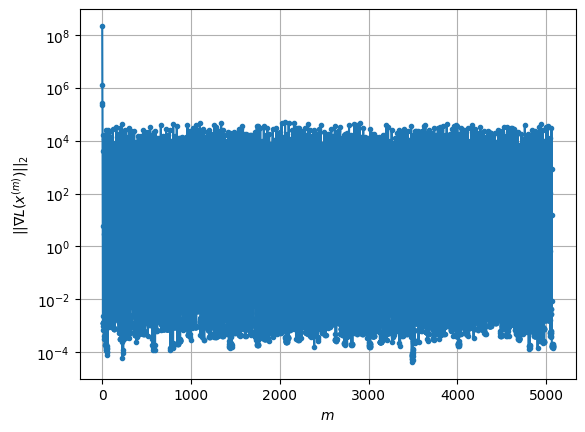

Windows:  68%|██████▊   | 254/376 [30:53<15:59,  7.87s/it]

Before applying the algorithm
Cost function: -3151335.1334771826
Gradient norm: 35405.86560364253
Global relative error: 55.03328962274145
Position relative errors: 0.03716820518972864 m, 17.636201339880177 m, 6.442061585816908 m, 51.73127564311209 m

Iteration 1
Cost function: -3151338.4368673675 (-0.00%)
Gradient norm: 212.0154722314077 (-99.40%)
Global relative error: 75.2141231879594 (36.67%)
Position relative errors: 0.04939402837221813 m, 29.259823238369286 m, 11.206275197585336 m, 68.37719858629085 m

Iteration 2
Cost function: -3151338.4384418777 (-0.00%)
Gradient norm: 0.06093736172436896 (-99.97%)
Global relative error: 75.70325125615112 (0.65%)
Position relative errors: 0.04939402995501191 m, 29.55937320540496 m, 11.499801340346117 m, 68.73845409386966 m

Iteration 3
Cost function: -3151338.438441889 (-0.00%)
Gradient norm: 0.00047075848069571863 (-99.23%)
Global relative error: 75.70497934531753 (0.00%)
Position relative errors: 0.04939402988955091 m, 29.56004957540228 m, 1

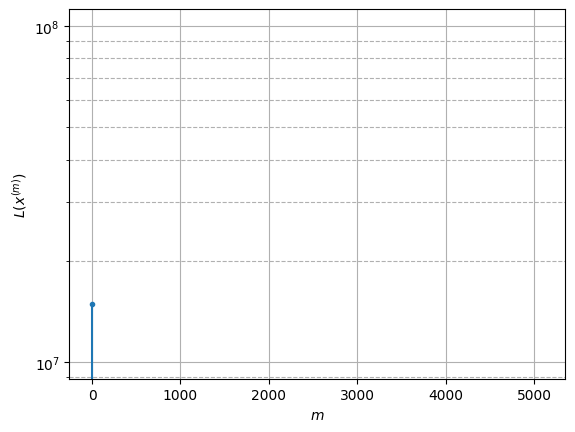

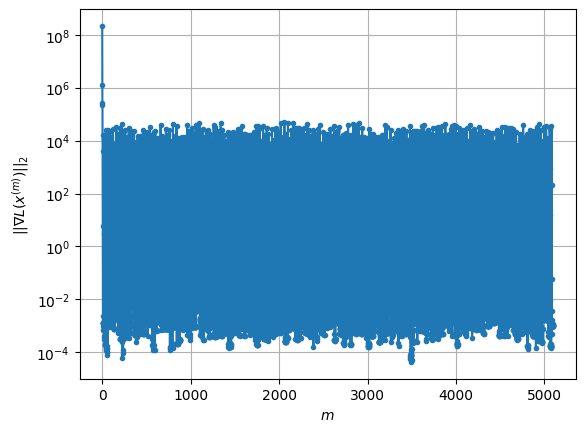

Windows:  68%|██████▊   | 255/376 [31:01<15:50,  7.86s/it]

Before applying the algorithm
Cost function: -3151327.466861603
Gradient norm: 40818.8719568382
Global relative error: 72.60993329301483
Position relative errors: 0.044489262347423675 m, 28.1001829199979 m, 11.115942366545426 m, 66.02282072325893 m

Iteration 1
Cost function: -3151332.5592878326 (-0.00%)
Gradient norm: 98.0339996568644 (-99.76%)
Global relative error: 105.60818824054536 (45.45%)
Position relative errors: 0.042847356552379826 m, 40.59848885931539 m, 10.721482980387979 m, 96.90146917179025 m

Iteration 2
Cost function: -3151332.5612485236 (-0.00%)
Gradient norm: 0.4851767524241776 (-99.51%)
Global relative error: 105.52301572373462 (-0.08%)
Position relative errors: 0.04284734962571473 m, 40.47014830102151 m, 10.285594150786407 m, 96.90961440967493 m

Iteration 3
Cost function: -3151332.5612485544 (-0.00%)
Gradient norm: 0.0008380204403147306 (-99.83%)
Global relative error: 105.52357157502375 (0.00%)
Position relative errors: 0.04284734971155809 m, 40.47053420371645 m, 

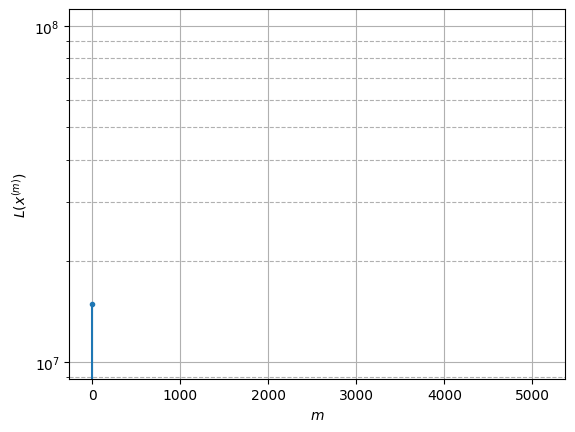

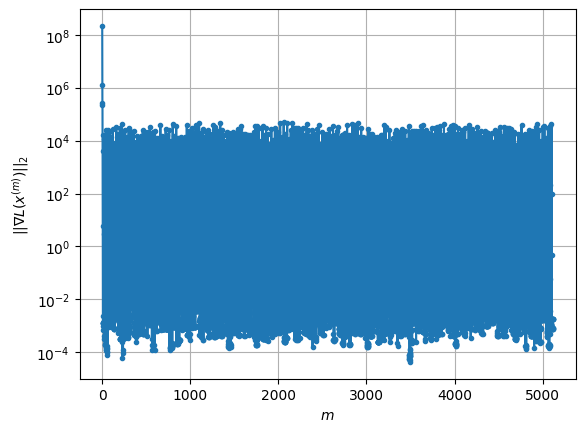

Windows:  68%|██████▊   | 256/376 [31:09<15:46,  7.88s/it]

Before applying the algorithm
Cost function: -3151329.0550173335
Gradient norm: 16456.4617461049
Global relative error: 101.14128083272996
Position relative errors: 0.03921853819313313 m, 38.81892822731916 m, 9.01168143953883 m, 92.95929908361366 m

Iteration 1
Cost function: -3151335.4826611476 (-0.00%)
Gradient norm: 235.54944110232353 (-98.57%)
Global relative error: 139.5489430425436 (37.97%)
Position relative errors: 0.03524884508494001 m, 63.223416579774366 m, 20.403815783288415 m, 122.7207213855905 m

Iteration 2
Cost function: -3151335.4971656115 (-0.00%)
Gradient norm: 6.724108297215956 (-97.15%)
Global relative error: 136.7091557101433 (-2.03%)
Position relative errors: 0.03524884627942702 m, 62.154146822333765 m, 20.33162244924596 m, 120.05359622421317 m

Iteration 3
Cost function: -3151335.497166684 (-0.00%)
Gradient norm: 0.003683326814682036 (-99.95%)
Global relative error: 136.68501197508766 (-0.02%)
Position relative errors: 0.03524884670869812 m, 62.14466404875405 m, 2

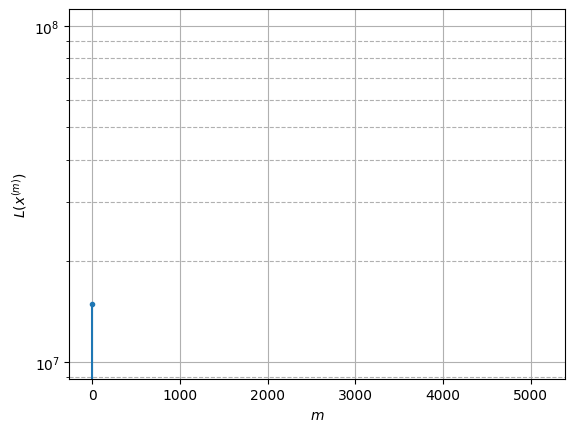

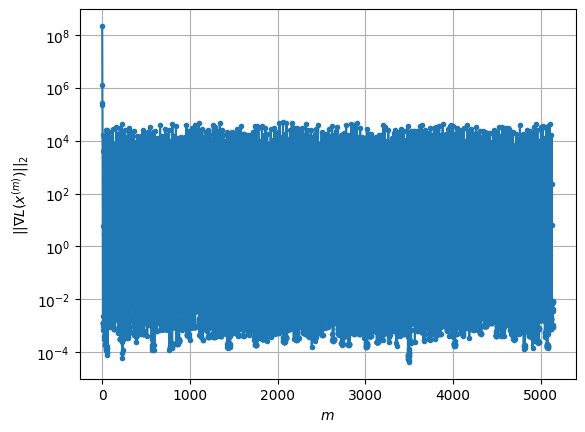

Windows:  68%|██████▊   | 257/376 [31:17<15:32,  7.83s/it]

Before applying the algorithm
Cost function: -3151325.502638422
Gradient norm: 35923.85946460602
Global relative error: 129.81681390185753
Position relative errors: 0.03222044611139416 m, 58.164038748980516 m, 18.68687953349016 m, 114.54315540127057 m

Iteration 1
Cost function: -3151331.65835434 (-0.00%)
Gradient norm: 151.19858895210993 (-99.58%)
Global relative error: 90.20724720419332 (-30.51%)
Position relative errors: 0.04642125711071466 m, 43.423267149388735 m, 14.469186921431872 m, 77.73289690923953 m

Iteration 2
Cost function: -3151331.6621679068 (-0.00%)
Gradient norm: 0.4174043402763372 (-99.72%)
Global relative error: 92.08882653899065 (2.09%)
Position relative errors: 0.04642125350864875 m, 44.160402259713706 m, 14.533842284268841 m, 79.49195801868687 m

Iteration 3
Cost function: -3151331.662167957 (-0.00%)
Gradient norm: 0.0028615869954517633 (-99.31%)
Global relative error: 92.10270789237615 (0.02%)
Position relative errors: 0.04642125344978423 m, 44.16571951900106 m, 

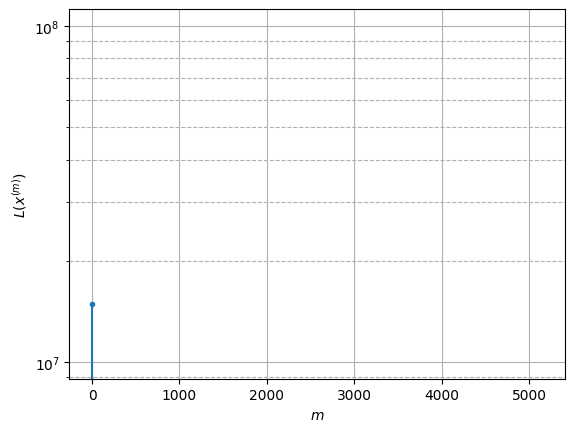

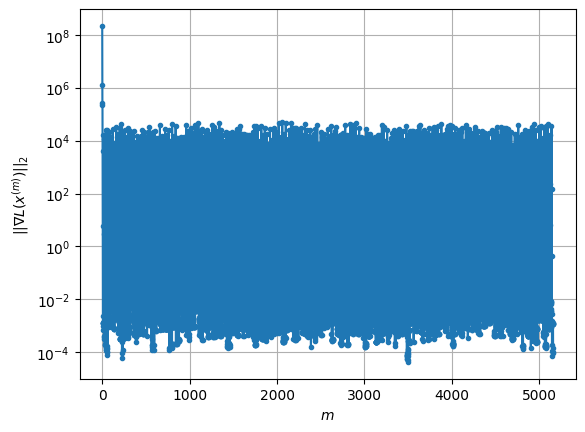

Windows:  69%|██████▊   | 258/376 [31:25<15:23,  7.83s/it]

Before applying the algorithm
Cost function: -3151327.829069245
Gradient norm: 13299.210999452293
Global relative error: 88.07251553211938
Position relative errors: 0.042626830526200477 m, 41.85969708347811 m, 13.335739408286916 m, 76.33272269218351 m

Iteration 1
Cost function: -3151329.648525614 (-0.00%)
Gradient norm: 21.49635303561337 (-99.84%)
Global relative error: 87.8858809994172 (-0.21%)
Position relative errors: 0.043174536288400775 m, 40.704944805140975 m, 15.058869185148978 m, 76.42158824946007 m

Iteration 2
Cost function: -3151329.6491950825 (-0.00%)
Gradient norm: 0.42007937246498245 (-98.05%)
Global relative error: 87.19401737099463 (-0.79%)
Position relative errors: 0.043174536875598246 m, 40.44056476314602 m, 14.878151379417188 m, 75.80231759806126 m

Iteration 3
Cost function: -3151329.6491950876 (-0.00%)
Gradient norm: 0.0016090054738067798 (-99.62%)
Global relative error: 87.1936023782962 (-0.00%)
Position relative errors: 0.04317453612300516 m, 40.440464931902206 

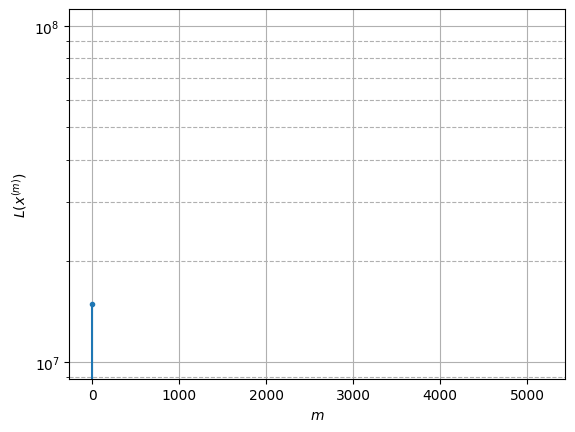

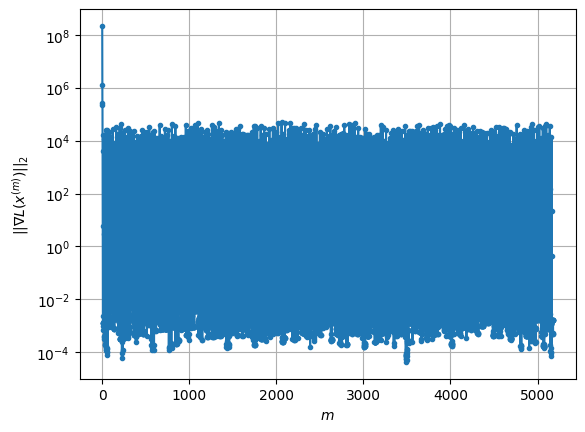

Windows:  69%|██████▉   | 259/376 [31:32<15:03,  7.72s/it]

Before applying the algorithm
Cost function: -3151320.6135795307
Gradient norm: 46094.64132103324
Global relative error: 83.03619428128599
Position relative errors: 0.03836024827796827 m, 38.33059217426799 m, 14.170761199552755 m, 72.28386954737108 m

Iteration 1
Cost function: -3151324.31922114 (-0.00%)
Gradient norm: 97.0448395216048 (-99.79%)
Global relative error: 56.62023240259107 (-31.81%)
Position relative errors: 0.02353846254456049 m, 28.668851316959795 m, 7.373594073509065 m, 48.26566097313181 m

Iteration 2
Cost function: -3151324.3233294864 (-0.00%)
Gradient norm: 2.2669789038061254 (-97.66%)
Global relative error: 59.333635738979034 (4.79%)
Position relative errors: 0.023538461125191108 m, 29.720525495657213 m, 7.559823810111818 m, 50.79385328155341 m

Iteration 3
Cost function: -3151324.3233295768 (-0.00%)
Gradient norm: 0.001770499625532625 (-99.92%)
Global relative error: 59.3392175969894 (0.01%)
Position relative errors: 0.02353846121154895 m, 29.722733721210766 m, 7.5

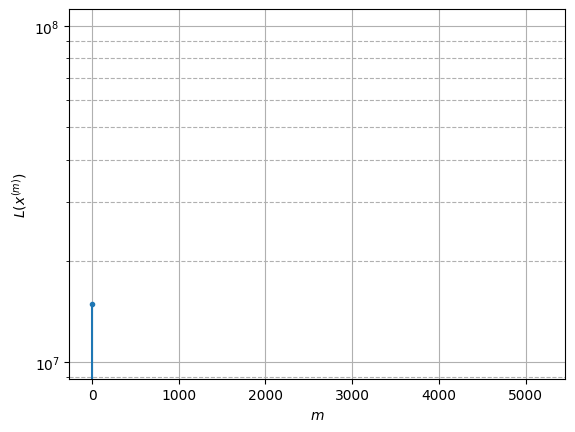

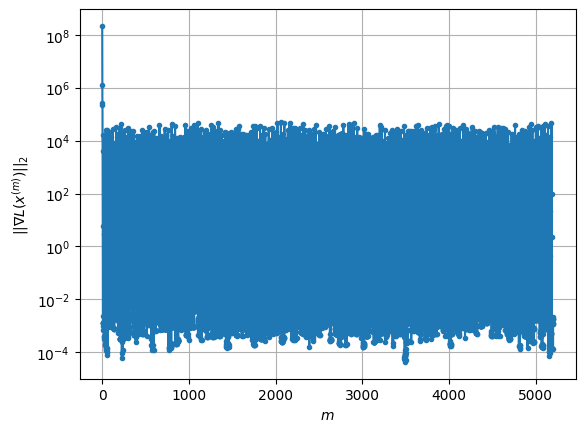

Windows:  69%|██████▉   | 260/376 [31:39<14:28,  7.49s/it]

Before applying the algorithm
Cost function: -3151317.9951106324
Gradient norm: 25832.333815613612
Global relative error: 55.60835225684414
Position relative errors: 0.021818080180074726 m, 27.665273346187135 m, 7.140590767015383 m, 47.70669563871105 m

Iteration 1
Cost function: -3151323.4319980238 (-0.00%)
Gradient norm: 531.8072960050208 (-97.94%)
Global relative error: 76.66677242909732 (37.87%)
Position relative errors: 0.03433115520237189 m, 33.45763272944958 m, 34.93216117599726 m, 59.48204251212749 m

Iteration 2
Cost function: -3151323.465259607 (-0.00%)
Gradient norm: 21.77756630363222 (-95.90%)
Global relative error: 75.87464055709064 (-1.03%)
Position relative errors: 0.03433118179898958 m, 32.64544495715943 m, 37.27848717430197 m, 57.45903079514922 m

Iteration 3
Cost function: -3151323.4652690054 (-0.00%)
Gradient norm: 0.0028895247727897455 (-99.99%)
Global relative error: 75.85868479961991 (-0.02%)
Position relative errors: 0.034331182630601365 m, 32.6337008066105 m, 37

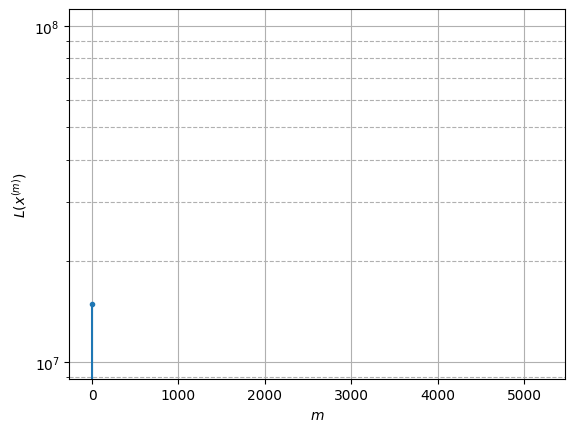

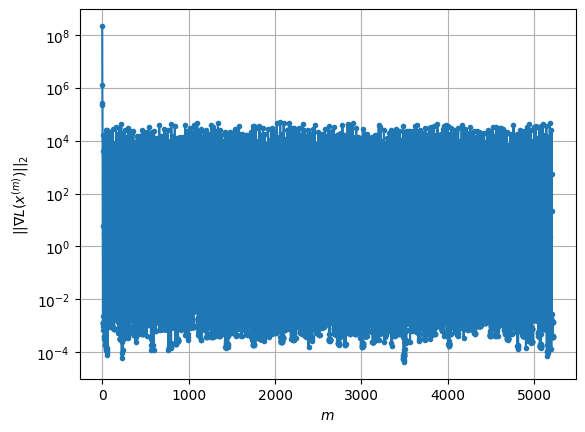

Windows:  69%|██████▉   | 261/376 [31:46<14:04,  7.34s/it]

Before applying the algorithm
Cost function: -3151324.744233571
Gradient norm: 20688.171891786576
Global relative error: 70.01621567311825
Position relative errors: 0.03285318086899124 m, 30.09914035740854 m, 34.25043044050542 m, 53.13387933199988 m

Iteration 1
Cost function: -3151326.6961465646 (-0.00%)
Gradient norm: 30.199478059949257 (-99.85%)
Global relative error: 73.34676533269685 (4.76%)
Position relative errors: 0.03367894153669251 m, 34.631708341493464 m, 27.64296100541393 m, 58.4486883079382 m

Iteration 2
Cost function: -3151326.69630329 (-0.00%)
Gradient norm: 0.026190052663051078 (-99.91%)
Global relative error: 73.13292892013737 (-0.29%)
Position relative errors: 0.033678941176458525 m, 34.53937168681334 m, 27.36156769193476 m, 58.36772642214907 m

Iteration 3
Cost function: -3151326.6963032647 (0.00%)
Gradient norm: 0.0004876629501425503 (-98.14%)
Global relative error: 73.1327961914584 (-0.00%)
Position relative errors: 0.03367894121556684 m, 34.539312545592495 m, 27.

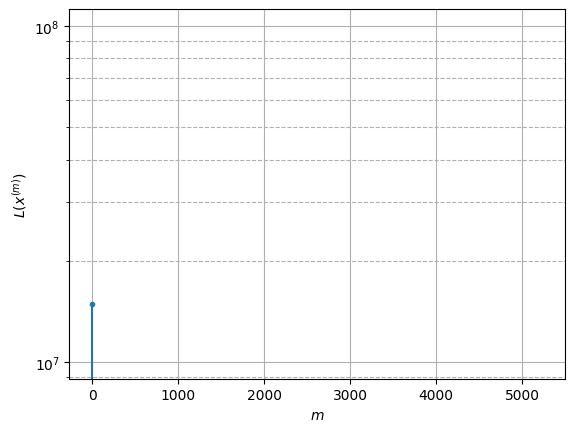

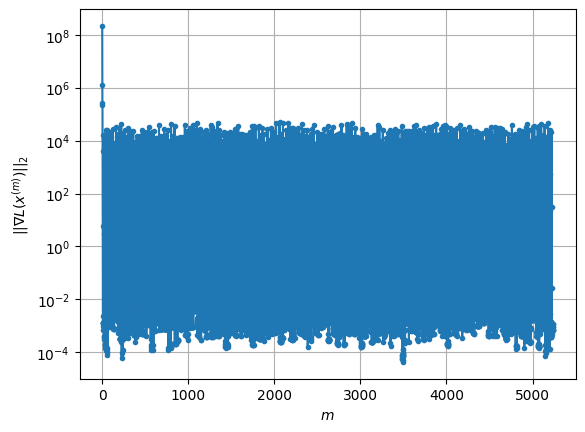

Windows:  70%|██████▉   | 262/376 [31:53<13:39,  7.19s/it]

Before applying the algorithm
Cost function: -3151324.072713824
Gradient norm: 17239.126366174754
Global relative error: 67.39979592258206
Position relative errors: 0.031513432808452126 m, 32.29251705035163 m, 24.15650132947892 m, 54.00350219629026 m

Iteration 1
Cost function: -3151328.427656648 (-0.00%)
Gradient norm: 79.83642663772065 (-99.54%)
Global relative error: 74.13228004493536 (9.99%)
Position relative errors: 0.04590173416207126 m, 36.45032036726478 m, 15.853134056817675 m, 62.57503267941337 m

Iteration 2
Cost function: -3151328.4293324966 (-0.00%)
Gradient norm: 0.8011954241889527 (-99.00%)
Global relative error: 73.34336054532707 (-1.06%)
Position relative errors: 0.045901733535453265 m, 36.146191900504114 m, 16.614189663461925 m, 61.61702584126475 m

Iteration 3
Cost function: -3151328.429332485 (0.00%)
Gradient norm: 0.0021834633226523502 (-99.73%)
Global relative error: 73.34235668424124 (-0.00%)
Position relative errors: 0.04590173327158877 m, 36.145691261842565 m, 1

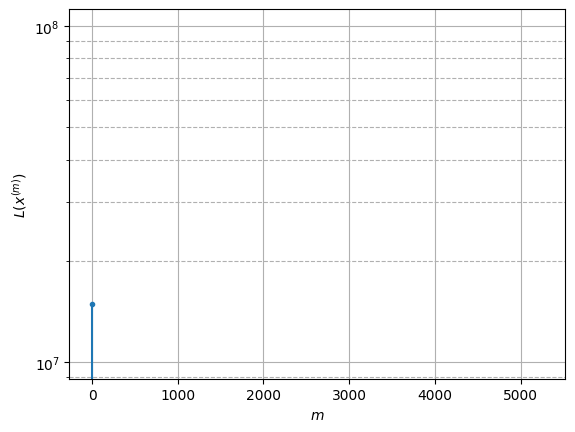

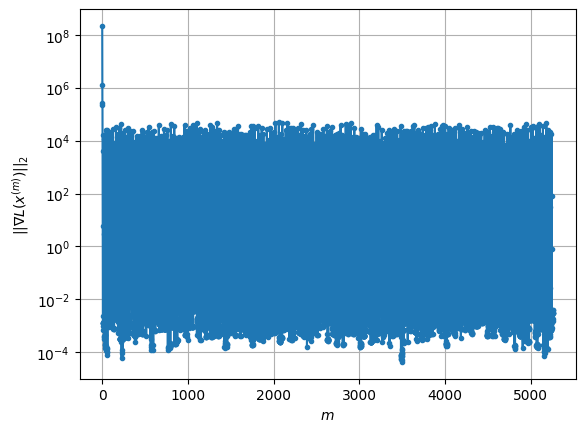

Windows:  70%|██████▉   | 263/376 [32:00<13:26,  7.14s/it]

Before applying the algorithm
Cost function: -3151328.4270538567
Gradient norm: 18224.149989773887
Global relative error: 67.22105792458784
Position relative errors: 0.04305174147754768 m, 33.180699785773 m, 14.65676429312805 m, 56.59397612065899 m

Iteration 1
Cost function: -3151330.5342709185 (-0.00%)
Gradient norm: 53.97074279951019 (-99.70%)
Global relative error: 62.40150847225633 (-7.17%)
Position relative errors: 0.02559396825544503 m, 32.511099137381294 m, 3.7136438948847212 m, 53.13358203171089 m

Iteration 2
Cost function: -3151330.5349895665 (-0.00%)
Gradient norm: 0.3074728445356412 (-99.43%)
Global relative error: 62.07121200487272 (-0.53%)
Position relative errors: 0.025593961596750814 m, 32.50146549192506 m, 3.820988282835386 m, 52.74354985429083 m

Iteration 3
Cost function: -3151330.534989586 (-0.00%)
Gradient norm: 0.0009241825551357138 (-99.70%)
Global relative error: 62.07135005124588 (0.00%)
Position relative errors: 0.025593961718448115 m, 32.501729849064006 m, 3

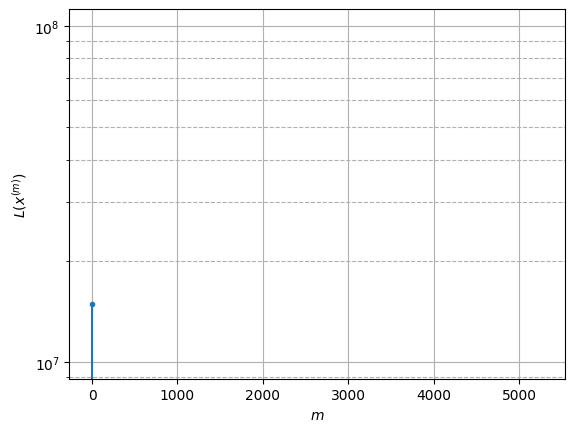

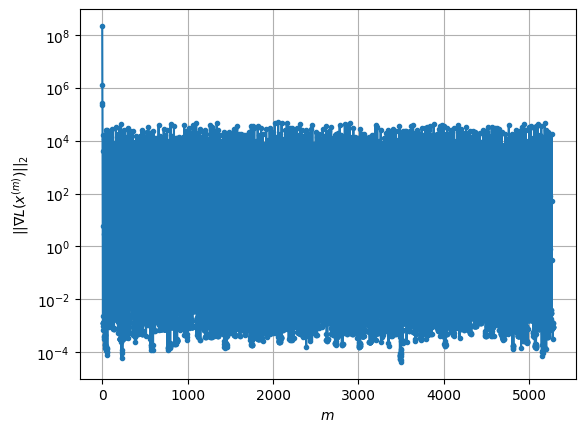

Windows:  70%|███████   | 264/376 [32:08<13:38,  7.31s/it]

Before applying the algorithm
Cost function: -3151326.8797515193
Gradient norm: 17784.99233359266
Global relative error: 56.97511472953867
Position relative errors: 0.024608517525146794 m, 29.89356973750387 m, 3.570266820929487 m, 48.37129988695664 m

Iteration 1
Cost function: -3151331.343078607 (-0.00%)
Gradient norm: 213.8735001477028 (-98.80%)
Global relative error: 35.84825960298942 (-37.08%)
Position relative errors: 0.06951416694331972 m, 17.977376587742313 m, 23.12620958857537 m, 20.66589939724302 m

Iteration 2
Cost function: -3151331.3477090597 (-0.00%)
Gradient norm: 1.2633252567921596 (-99.41%)
Global relative error: 34.36374167813619 (-4.14%)
Position relative errors: 0.06951418370372582 m, 17.481312679283374 m, 21.6734545142641 m, 20.137565798451504 m

Iteration 3
Cost function: -3151331.347709138 (-0.00%)
Gradient norm: 0.0010639620920175027 (-99.92%)
Global relative error: 34.35723580979427 (-0.02%)
Position relative errors: 0.06951418277191787 m, 17.479132054042374 m, 

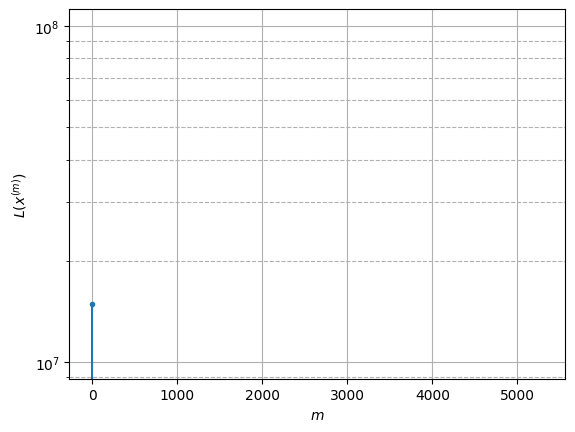

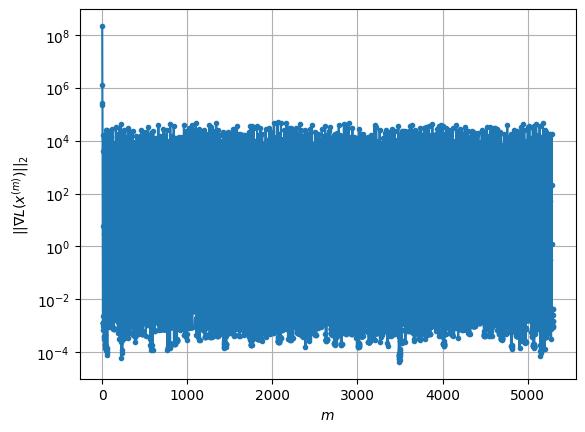

Windows:  70%|███████   | 265/376 [32:15<13:23,  7.24s/it]

Before applying the algorithm
Cost function: -3151327.689546964
Gradient norm: 11067.749307763743
Global relative error: 29.956977616756596
Position relative errors: 0.06272671013300635 m, 14.776771468520927 m, 19.453890887538474 m, 17.33793438562185 m

Iteration 1
Cost function: -3151331.066181203 (-0.00%)
Gradient norm: 60.68394111635316 (-99.45%)
Global relative error: 28.932865235604606 (-3.42%)
Position relative errors: 0.06150626205634541 m, 12.461315785699021 m, 22.4263385839619 m, 13.374403367576889 m

Iteration 2
Cost function: -3151331.066697231 (-0.00%)
Gradient norm: 0.02269583185402341 (-99.96%)
Global relative error: 29.024312316304147 (0.32%)
Position relative errors: 0.061506268371129685 m, 12.56498175338366 m, 22.394584656010668 m, 13.527877046807951 m

Iteration 3
Cost function: -3151331.0666972264 (0.00%)
Gradient norm: 0.0017139352231753178 (-92.45%)
Global relative error: 29.024670297460528 (0.00%)
Position relative errors: 0.061506268371129685 m, 12.56513796889883

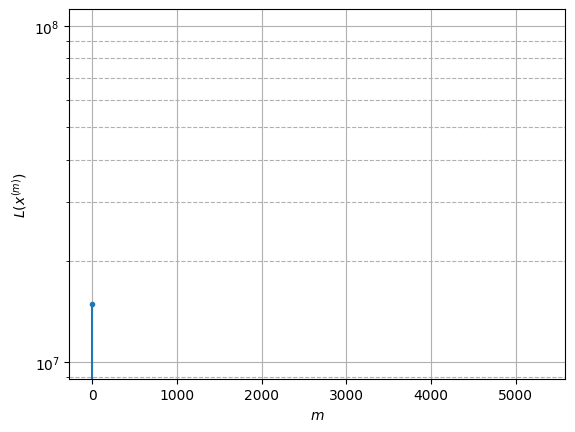

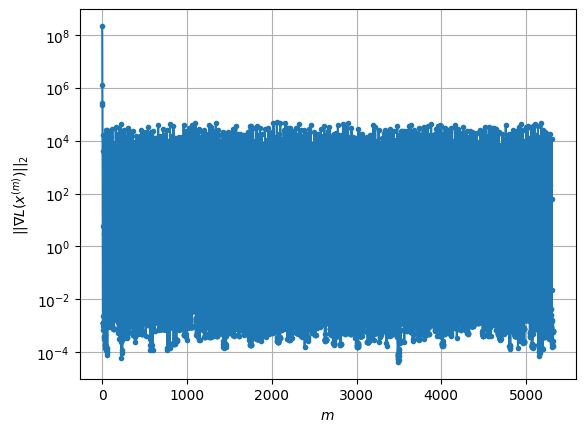

Windows:  71%|███████   | 266/376 [32:22<13:13,  7.22s/it]

Before applying the algorithm
Cost function: -3151326.9171995334
Gradient norm: 24208.14028777228
Global relative error: 25.226075172660583
Position relative errors: 0.0548738420022839 m, 10.15245221773296 m, 20.397860187952887 m, 10.825871864003863 m

Iteration 1
Cost function: -3151330.867543584 (-0.00%)
Gradient norm: 45.57750268049528 (-99.81%)
Global relative error: 18.639461603049195 (-26.11%)
Position relative errors: 0.03893504546586929 m, 9.688598735649082 m, 15.46795934972395 m, 3.780824363979645 m

Iteration 2
Cost function: -3151330.868418724 (-0.00%)
Gradient norm: 0.5468957395549375 (-98.80%)
Global relative error: 18.20638900479803 (-2.32%)
Position relative errors: 0.038935051438806635 m, 9.68785640171173 m, 14.913687030397377 m, 3.897678783824584 m

Iteration 3
Cost function: -3151330.8684187285 (-0.00%)
Gradient norm: 0.003460006185849862 (-99.37%)
Global relative error: 18.205879935043566 (-0.00%)
Position relative errors: 0.03893505207812746 m, 9.687617184680224 m, 

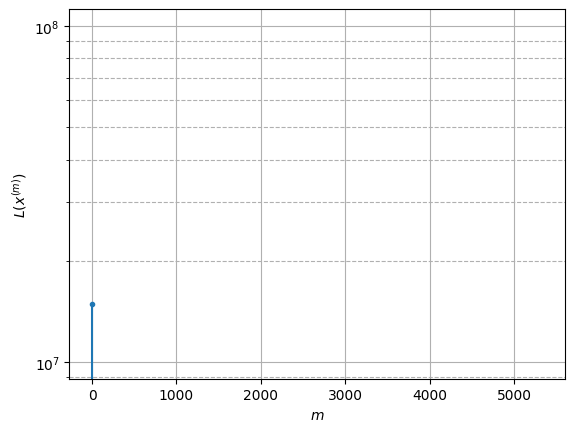

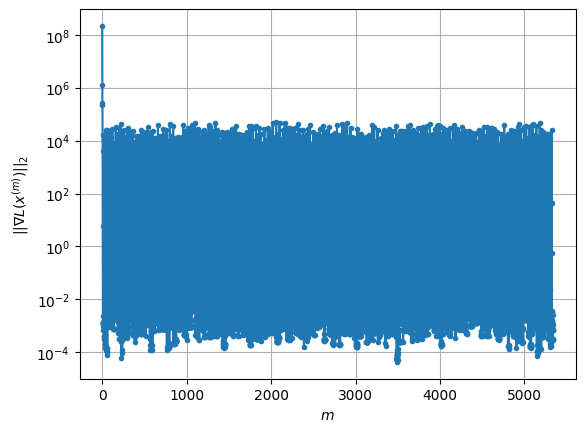

Windows:  71%|███████   | 267/376 [32:29<13:04,  7.20s/it]

Before applying the algorithm
Cost function: -3151332.9663328263
Gradient norm: 10714.77120916861
Global relative error: 15.225950675565256
Position relative errors: 0.0354118993123296 m, 6.600596908666195 m, 13.545016103204363 m, 2.187765114414851 m

Iteration 1
Cost function: -3151335.1089354753 (-0.00%)
Gradient norm: 121.19910452789554 (-98.87%)
Global relative error: 28.975961803751847 (90.31%)
Position relative errors: 0.027152180985833465 m, 10.428895932391594 m, 25.011363781978922 m, 10.259906107254205 m

Iteration 2
Cost function: -3151335.1293636253 (-0.00%)
Gradient norm: 8.231320606217524 (-93.21%)
Global relative error: 24.35244144169438 (-15.96%)
Position relative errors: 0.0271521519156029 m, 11.122691987314862 m, 19.084554483559142 m, 10.251650978554864 m

Iteration 3
Cost function: -3151335.1293694517 (-0.00%)
Gradient norm: 0.0026819186835726457 (-99.97%)
Global relative error: 24.288355335489733 (-0.26%)
Position relative errors: 0.02715215090167603 m, 11.12996512167

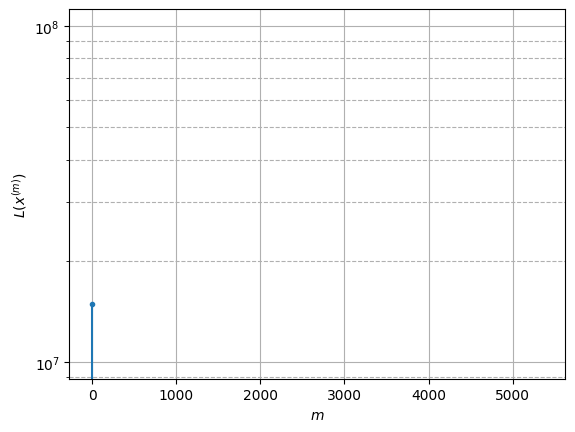

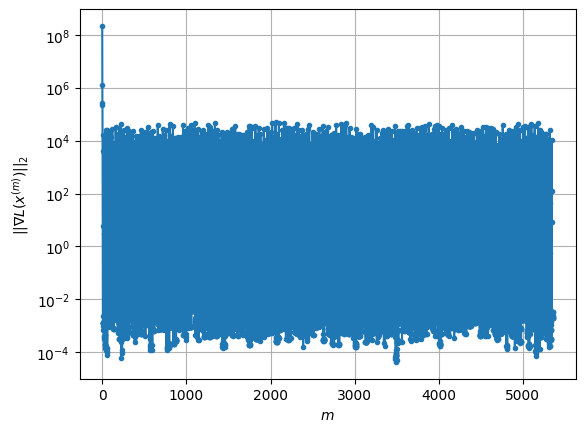

Windows:  71%|███████▏  | 268/376 [32:36<12:55,  7.18s/it]

Before applying the algorithm
Cost function: -3151343.3945364333
Gradient norm: 23968.69667232148
Global relative error: 20.587457913342888
Position relative errors: 0.024896899748866174 m, 7.562668678794984 m, 18.157000636570356 m, 6.079652570558793 m

Iteration 1
Cost function: -3151347.9143126067 (-0.00%)
Gradient norm: 184.58988120675147 (-99.23%)
Global relative error: 33.81638195483341 (64.26%)
Position relative errors: 0.04943703264102409 m, 11.949744339169687 m, 17.12163654404699 m, 26.600617870330034 m

Iteration 2
Cost function: -3151347.9198299884 (-0.00%)
Gradient norm: 0.8219537792491289 (-99.55%)
Global relative error: 34.8777691678134 (3.14%)
Position relative errors: 0.04943703300523974 m, 11.856596389440394 m, 19.03638423627305 m, 26.71119627970819 m

Iteration 3
Cost function: -3151347.91983011 (-0.00%)
Gradient norm: 0.0007263718471190892 (-99.91%)
Global relative error: 34.889361237462026 (0.03%)
Position relative errors: 0.04943703300523974 m, 11.856206421305252 m,

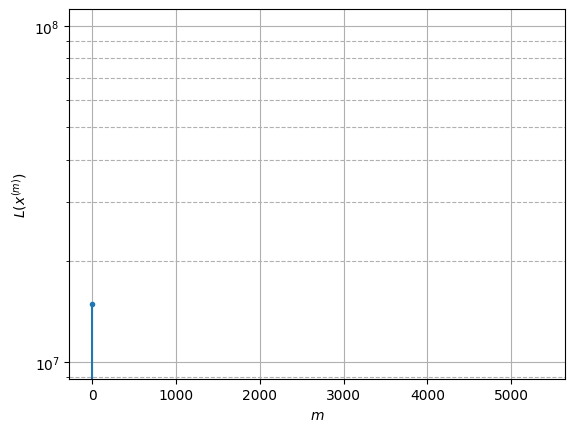

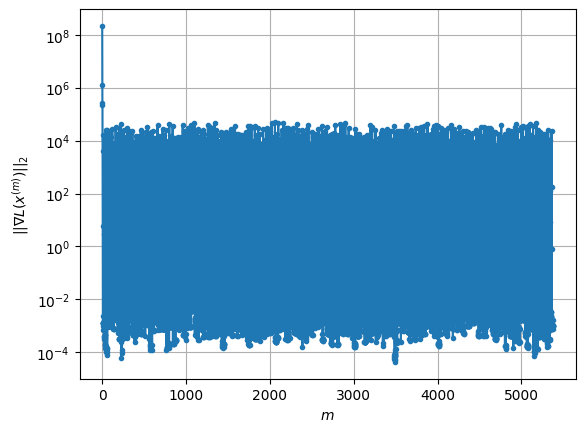

Windows:  72%|███████▏  | 269/376 [32:43<12:49,  7.19s/it]

Before applying the algorithm
Cost function: -3151348.133566767
Gradient norm: 14144.758804374727
Global relative error: 37.108039603939915
Position relative errors: 0.04227377680512853 m, 15.068815184267587 m, 17.585910729222082 m, 28.994241731606134 m

Iteration 1
Cost function: -3151349.9959857175 (-0.00%)
Gradient norm: 198.99689933673451 (-98.59%)
Global relative error: 59.956200253998915 (61.57%)
Position relative errors: 0.04576835550979881 m, 30.666205606984846 m, 5.679407864800897 m, 51.20614473455222 m

Iteration 2
Cost function: -3151349.9992632945 (-0.00%)
Gradient norm: 2.197740353099274 (-98.90%)
Global relative error: 60.43266785692582 (0.79%)
Position relative errors: 0.04576835011870607 m, 31.050810046994705 m, 4.951364132258447 m, 51.60846609330333 m

Iteration 3
Cost function: -3151349.9992633965 (-0.00%)
Gradient norm: 0.0011286709448328294 (-99.95%)
Global relative error: 60.436758454129986 (0.01%)
Position relative errors: 0.04576835042228134 m, 31.0538898329339 m

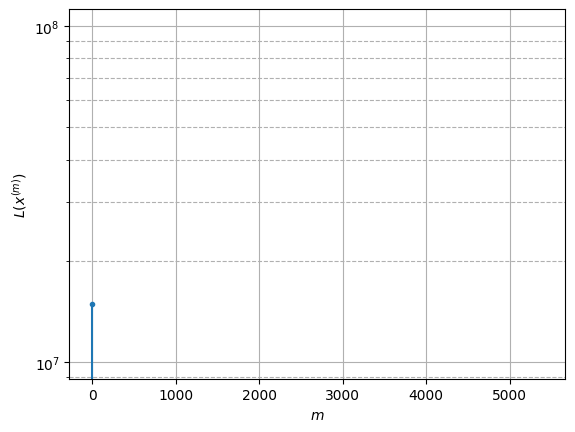

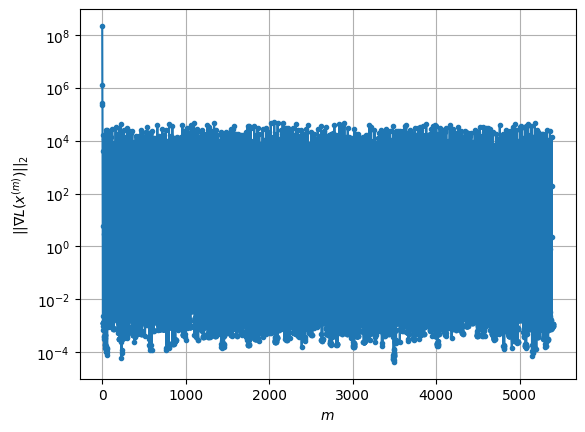

Windows:  72%|███████▏  | 270/376 [32:50<12:38,  7.16s/it]

Before applying the algorithm
Cost function: -3151350.5260103685
Gradient norm: 31911.522150235713
Global relative error: 63.01651754581405
Position relative errors: 0.03879726408244433 m, 33.3677619897736 m, 5.561973004868359 m, 53.16704459877163 m

Iteration 1
Cost function: -3151355.2701990386 (-0.00%)
Gradient norm: 23.138558968923288 (-99.93%)
Global relative error: 53.124072149573735 (-15.70%)
Position relative errors: 0.05212085956768474 m, 21.831166641612604 m, 15.849632658696057 m, 45.76407017371446 m

Iteration 2
Cost function: -3151355.2704302357 (-0.00%)
Gradient norm: 0.052455316551535396 (-99.77%)
Global relative error: 52.73737123961417 (-0.73%)
Position relative errors: 0.05212085917379029 m, 21.580547257609926 m, 15.838319295628263 m, 45.43843821334138 m

Iteration 3
Cost function: -3151355.2704302436 (-0.00%)
Gradient norm: 0.004496886617872032 (-91.43%)
Global relative error: 52.73705074877031 (-0.00%)
Position relative errors: 0.052120859027635885 m, 21.580370092184

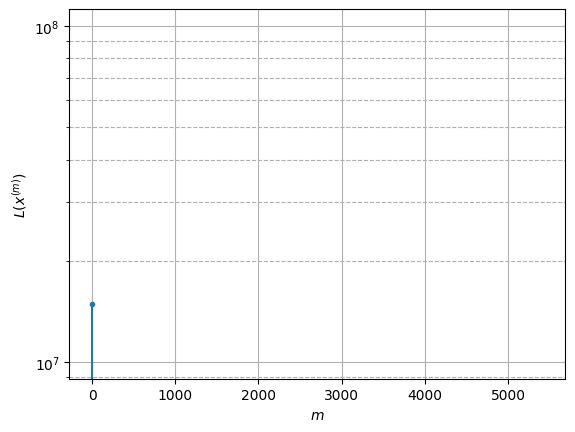

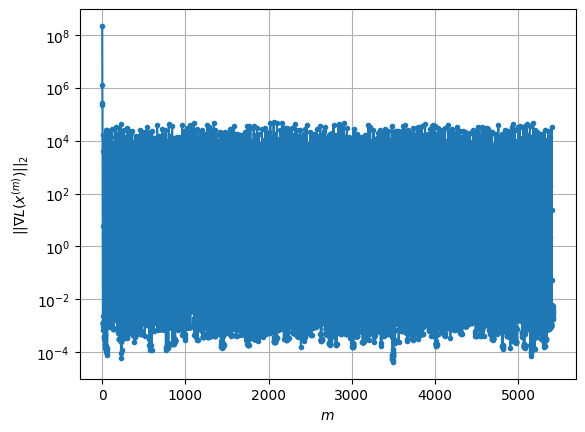

Windows:  72%|███████▏  | 271/376 [32:58<12:34,  7.19s/it]

Before applying the algorithm
Cost function: -3151357.301682421
Gradient norm: 9740.170125485909
Global relative error: 55.2524937867273
Position relative errors: 0.048538059675049365 m, 24.204469125265973 m, 15.593134681098793 m, 47.15750610162462 m

Iteration 1
Cost function: -3151360.849580866 (-0.00%)
Gradient norm: 428.21991712552926 (-95.60%)
Global relative error: 16.763607643444207 (-69.66%)
Position relative errors: 0.031460509255761396 m, 2.7702518817126776 m, 13.510524066972879 m, 9.528812200958791 m

Iteration 2
Cost function: -3151360.865632466 (-0.00%)
Gradient norm: 4.953254370029685 (-98.84%)
Global relative error: 18.464381589524887 (10.15%)
Position relative errors: 0.03146051284708527 m, 4.61652487872443 m, 12.515201445079313 m, 12.766363390327506 m

Iteration 3
Cost function: -3151360.865633995 (-0.00%)
Gradient norm: 0.0006416971130161238 (-99.99%)
Global relative error: 18.47217147779105 (0.04%)
Position relative errors: 0.0314605122935485 m, 4.632915612938173 m, 

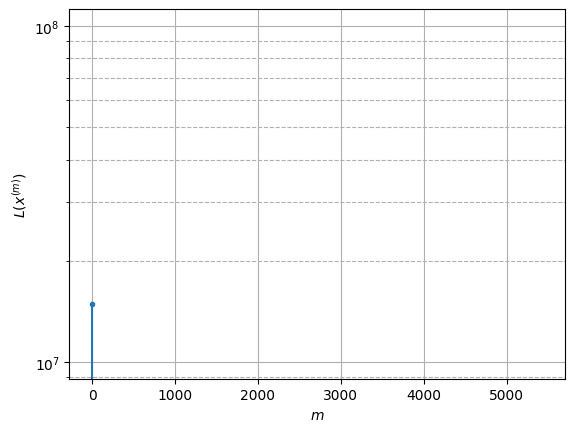

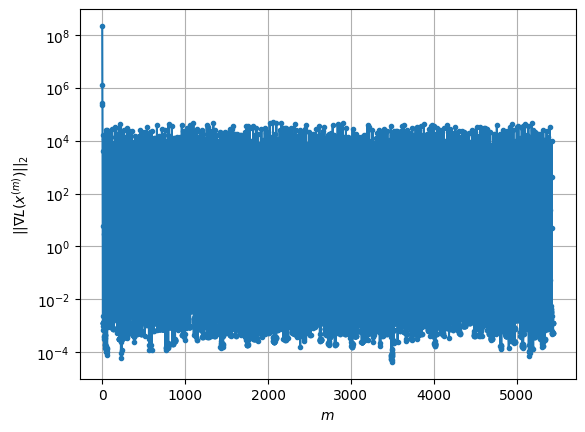

Windows:  72%|███████▏  | 272/376 [33:05<12:19,  7.11s/it]

Before applying the algorithm
Cost function: -3151346.677961636
Gradient norm: 20183.284172287727
Global relative error: 21.626323207068726
Position relative errors: 0.03044140011260821 m, 8.547350255732832 m, 11.351443843494524 m, 16.302604438277303 m

Iteration 1
Cost function: -3151351.79219134 (-0.00%)
Gradient norm: 143.0518451859585 (-99.29%)
Global relative error: 26.685540819041243 (23.39%)
Position relative errors: 0.06446882939299618 m, 12.67727429829081 m, 19.98929924828167 m, 12.321649698491324 m

Iteration 2
Cost function: -3151351.7998226504 (-0.00%)
Gradient norm: 4.19335418810466 (-97.07%)
Global relative error: 24.785935912246167 (-7.12%)
Position relative errors: 0.06446882159641808 m, 12.390380936621717 m, 17.690800453886677 m, 12.159229414904868 m

Iteration 3
Cost function: -3151351.799823564 (-0.00%)
Gradient norm: 0.0023732132965525554 (-99.94%)
Global relative error: 24.77969674702356 (-0.03%)
Position relative errors: 0.06446882042040084 m, 12.392135886471015 m

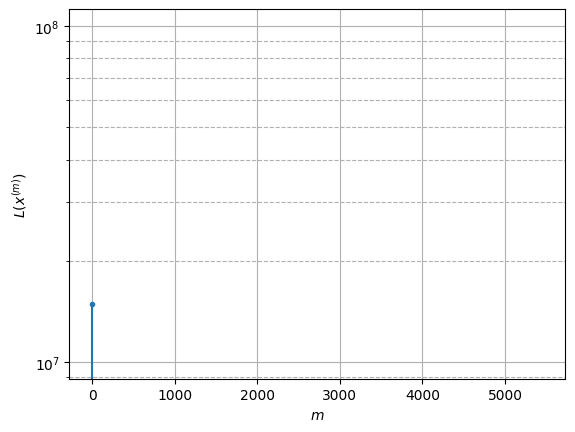

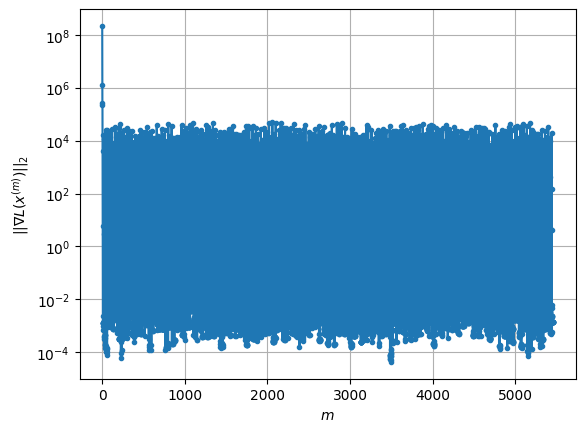

Windows:  73%|███████▎  | 273/376 [33:12<12:30,  7.29s/it]

Before applying the algorithm
Cost function: -3151350.098945012
Gradient norm: 16775.11979786959
Global relative error: 26.847901533754797
Position relative errors: 0.061194365461165016 m, 14.29750514462492 m, 16.672806591500265 m, 15.440193674713454 m

Iteration 1
Cost function: -3151356.1698094285 (-0.00%)
Gradient norm: 404.2277889310655 (-97.59%)
Global relative error: 26.691891582074177 (-0.58%)
Position relative errors: 0.04306034754453303 m, 12.585018386829942 m, 22.599619161606945 m, 6.581766363004567 m

Iteration 2
Cost function: -3151356.192296089 (-0.00%)
Gradient norm: 16.02196297214482 (-96.04%)
Global relative error: 25.69945658190099 (-3.72%)
Position relative errors: 0.04306034657593608 m, 13.12177683036268 m, 21.102714222569713 m, 6.5533277445603755 m

Iteration 3
Cost function: -3151356.19230075 (-0.00%)
Gradient norm: 0.0019380880007366984 (-99.99%)
Global relative error: 25.67412987557937 (-0.10%)
Position relative errors: 0.043060346255303326 m, 13.128126471484066 

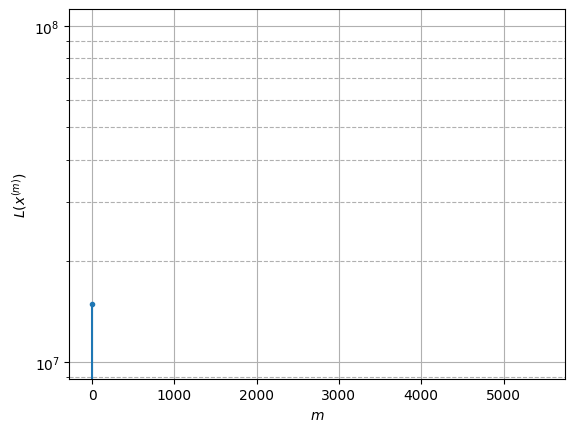

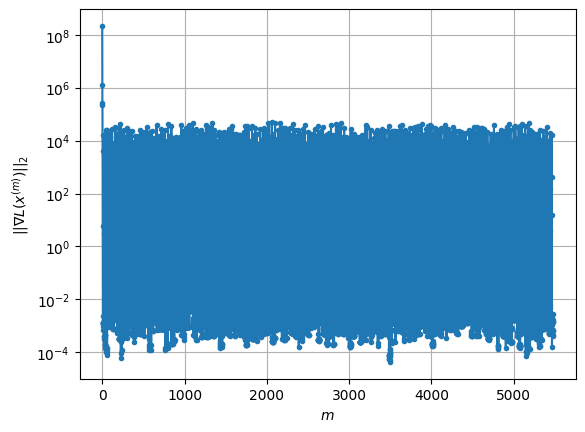

Windows:  73%|███████▎  | 274/376 [33:20<12:34,  7.40s/it]

Before applying the algorithm
Cost function: -3151351.857344201
Gradient norm: 40825.15615623718
Global relative error: 24.53854703994142
Position relative errors: 0.03984597880607344 m, 13.908361110335791 m, 18.75055787007236 m, 7.556744435363551 m

Iteration 1
Cost function: -3151355.2243576255 (-0.00%)
Gradient norm: 245.65431142809106 (-99.40%)
Global relative error: 33.02922399322452 (34.60%)
Position relative errors: 0.06388905609231993 m, 22.618604890094826 m, 10.40733879530065 m, 21.70274775117819 m

Iteration 2
Cost function: -3151355.2274789657 (-0.00%)
Gradient norm: 0.4865856249440483 (-99.80%)
Global relative error: 33.95103097003596 (2.79%)
Position relative errors: 0.06388905990257293 m, 23.172427782529564 m, 9.401905609406832 m, 22.963210511637612 m

Iteration 3
Cost function: -3151355.2274790024 (-0.00%)
Gradient norm: 0.0011199495860556546 (-99.77%)
Global relative error: 33.95252079153559 (0.00%)
Position relative errors: 0.06388906039811425 m, 23.173804460292224 m, 

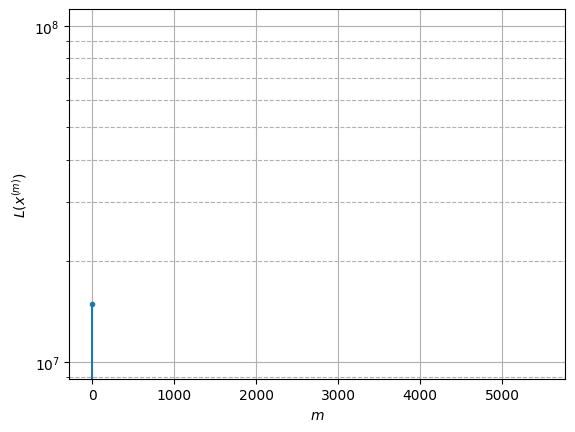

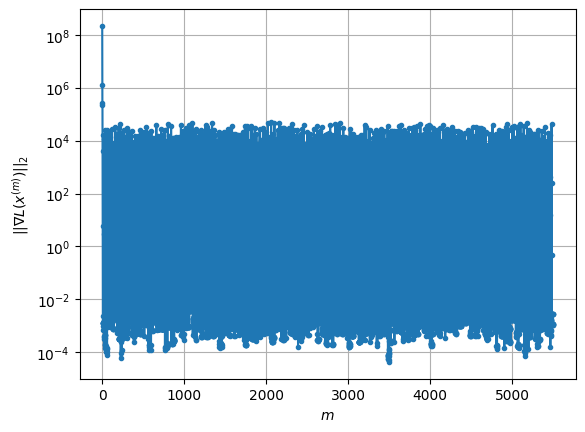

Windows:  73%|███████▎  | 275/376 [33:28<12:34,  7.47s/it]

Before applying the algorithm
Cost function: -3151361.2445369945
Gradient norm: 7297.529333407618
Global relative error: 34.50187718587142
Position relative errors: 0.06002943631334063 m, 23.214293361948656 m, 7.941094868159854 m, 24.25715494027538 m

Iteration 1
Cost function: -3151364.461479216 (-0.00%)
Gradient norm: 238.21597159047107 (-96.74%)
Global relative error: 58.79738549604189 (70.42%)
Position relative errors: 0.07106451734090316 m, 33.82150817946069 m, 12.793932388516744 m, 46.36320620780297 m

Iteration 2
Cost function: -3151364.4637582637 (-0.00%)
Gradient norm: 0.34652143489695403 (-99.85%)
Global relative error: 59.86626643648143 (1.82%)
Position relative errors: 0.07106451848489495 m, 34.12114544563633 m, 13.505758828668762 m, 47.30015887683796 m

Iteration 3
Cost function: -3151364.46375828 (-0.00%)
Gradient norm: 0.0011647492014272426 (-99.66%)
Global relative error: 59.86918246707681 (0.00%)
Position relative errors: 0.07106451857965991 m, 34.122295813543325 m, 13

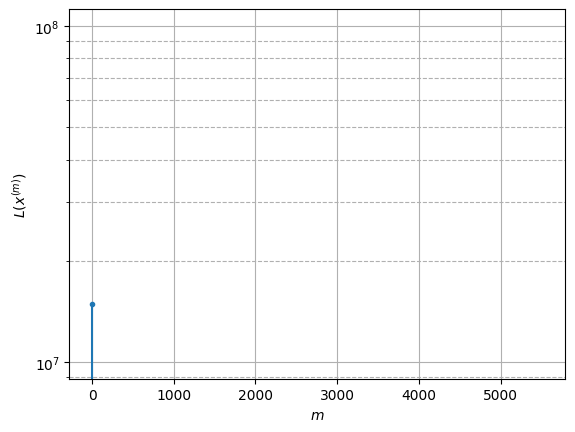

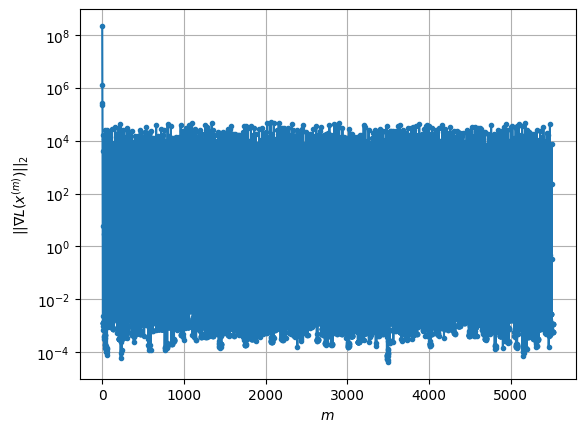

Windows:  73%|███████▎  | 276/376 [33:35<12:40,  7.60s/it]

Before applying the algorithm
Cost function: -3151366.6112444317
Gradient norm: 21854.65980637915
Global relative error: 57.92622523471996
Position relative errors: 0.06752794650017269 m, 33.134760858783736 m, 11.54764691057986 m, 46.0888331189669 m

Iteration 1
Cost function: -3151371.016728851 (-0.00%)
Gradient norm: 110.85965800134812 (-99.49%)
Global relative error: 62.98500849671891 (8.73%)
Position relative errors: 0.08326926492566575 m, 42.195934779628246 m, 10.81390101244923 m, 45.493589041477144 m

Iteration 2
Cost function: -3151371.0238738726 (-0.00%)
Gradient norm: 1.8769478109171425 (-98.31%)
Global relative error: 65.91231224448741 (4.65%)
Position relative errors: 0.08326926445568199 m, 43.384728557513 m, 13.830735463614108 m, 47.65397805220204 m

Iteration 3
Cost function: -3151371.02387445 (-0.00%)
Gradient norm: 8.332009013336602e-05 (-100.00%)
Global relative error: 65.92139312896308 (0.01%)
Position relative errors: 0.08326926473240394 m, 43.38827436577356 m, 13.846

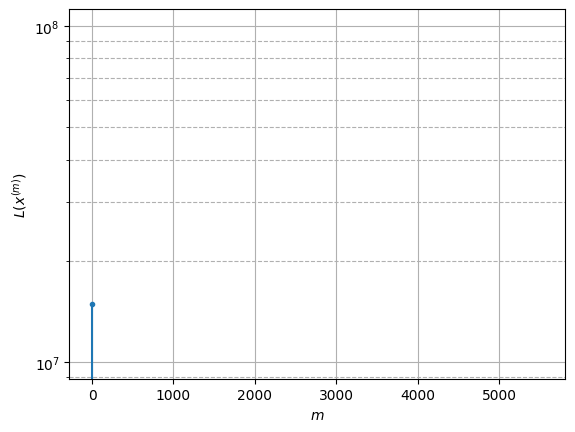

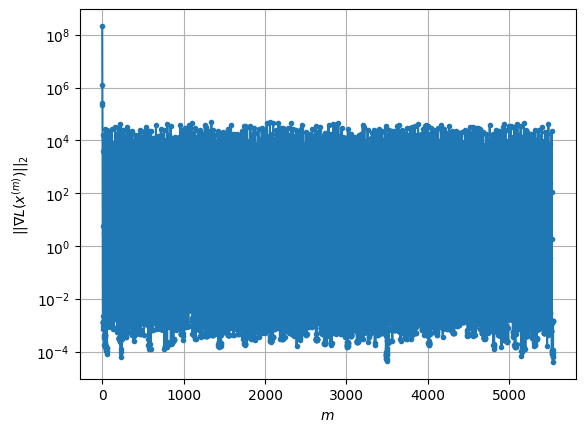

Windows:  74%|███████▎  | 277/376 [33:43<12:34,  7.63s/it]

Before applying the algorithm
Cost function: -3151367.995192726
Gradient norm: 32313.862417739347
Global relative error: 65.18414035214215
Position relative errors: 0.07780635389417753 m, 42.82061637505002 m, 13.148355093374114 m, 47.354843504612376 m

Iteration 1
Cost function: -3151371.4032912045 (-0.00%)
Gradient norm: 51.44523687668917 (-99.84%)
Global relative error: 59.06028215869995 (-9.39%)
Position relative errors: 0.053000218493494095 m, 36.18038589274223 m, 13.434225806186374 m, 44.70586961456983 m

Iteration 2
Cost function: -3151371.4035461047 (-0.00%)
Gradient norm: 0.06724279516260138 (-99.87%)
Global relative error: 58.92378019767997 (-0.23%)
Position relative errors: 0.053000216908767175 m, 36.1905946162126 m, 13.397527257238188 m, 44.528144060432766 m

Iteration 3
Cost function: -3151371.403546105 (-0.00%)
Gradient norm: 0.0014651067001509636 (-97.82%)
Global relative error: 58.923839691012326 (0.00%)
Position relative errors: 0.05300021718318315 m, 36.190660643010425

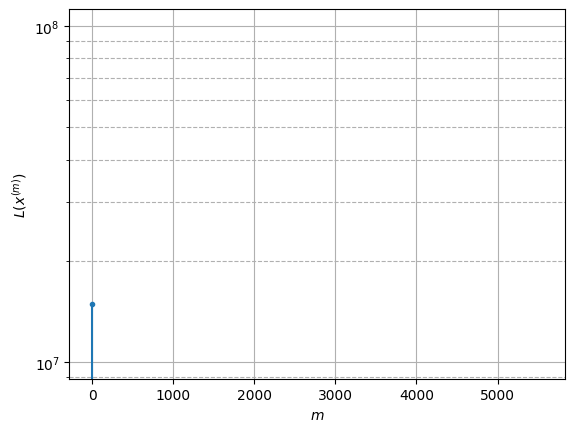

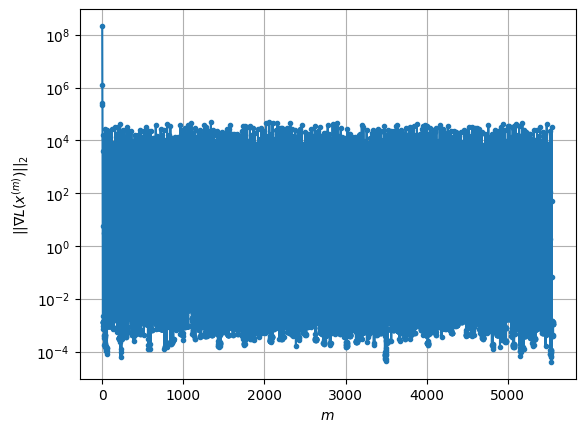

Windows:  74%|███████▍  | 278/376 [33:51<12:31,  7.67s/it]

Before applying the algorithm
Cost function: -3151363.004373602
Gradient norm: 20577.25524829411
Global relative error: 58.03769805119948
Position relative errors: 0.04871906226086015 m, 35.59602584431746 m, 13.49144688438725 m, 43.80953365674973 m

Iteration 1
Cost function: -3151367.662345764 (-0.00%)
Gradient norm: 231.44993419202262 (-98.88%)
Global relative error: 56.47466968843231 (-2.69%)
Position relative errors: 0.03805256346957125 m, 30.59742487046103 m, 24.619477542123967 m, 40.58400582386072 m

Iteration 2
Cost function: -3151367.6796358563 (-0.00%)
Gradient norm: 10.05104837381405 (-95.66%)
Global relative error: 56.743648152734686 (0.48%)
Position relative errors: 0.03805256058567152 m, 32.08216944871534 m, 20.351301143045614 m, 42.1473110048853 m

Iteration 3
Cost function: -3151367.6796408747 (-0.00%)
Gradient norm: 0.002816964858256647 (-99.97%)
Global relative error: 56.73524494922145 (-0.01%)
Position relative errors: 0.038052560165689676 m, 32.09687493765424 m, 20.2

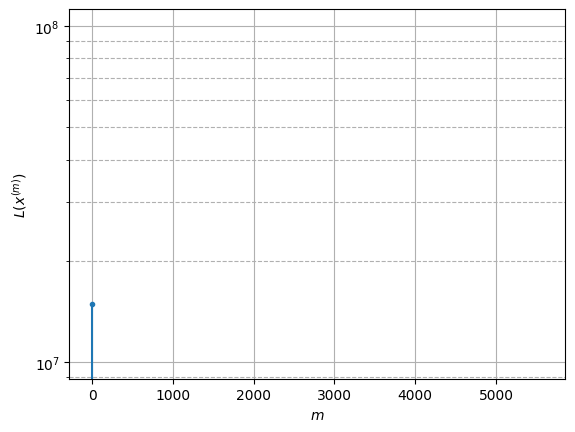

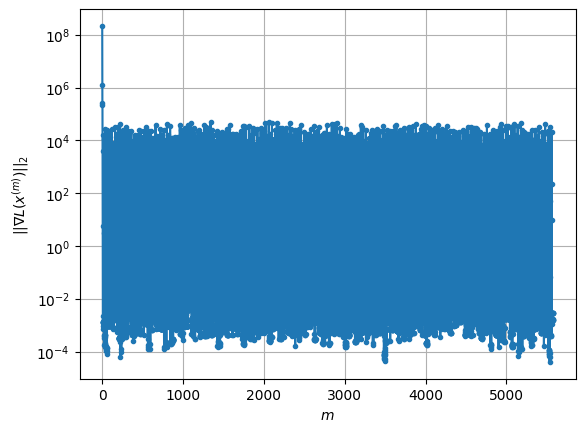

Windows:  74%|███████▍  | 279/376 [33:59<12:27,  7.71s/it]

Before applying the algorithm
Cost function: -3151366.2830745517
Gradient norm: 22353.185003546205
Global relative error: 54.131054701234284
Position relative errors: 0.037256269903095156 m, 31.07529555885484 m, 17.226750064730638 m, 40.8378648027499 m

Iteration 1
Cost function: -3151370.402098204 (-0.00%)
Gradient norm: 138.8956271385367 (-99.38%)
Global relative error: 54.202037062484806 (0.13%)
Position relative errors: 0.020798113062854364 m, 28.916773575256084 m, 8.831198614158183 m, 44.98542101025673 m

Iteration 2
Cost function: -3151370.409436326 (-0.00%)
Gradient norm: 6.99395383146098 (-94.96%)
Global relative error: 55.43559145800861 (2.28%)
Position relative errors: 0.020798112052966986 m, 29.560844419076986 m, 9.08160956364595 m, 46.008507192907246 m

Iteration 3
Cost function: -3151370.409437157 (-0.00%)
Gradient norm: 0.0003484191407843577 (-100.00%)
Global relative error: 55.44051353513945 (0.01%)
Position relative errors: 0.020798112414735472 m, 29.563490460179437 m, 

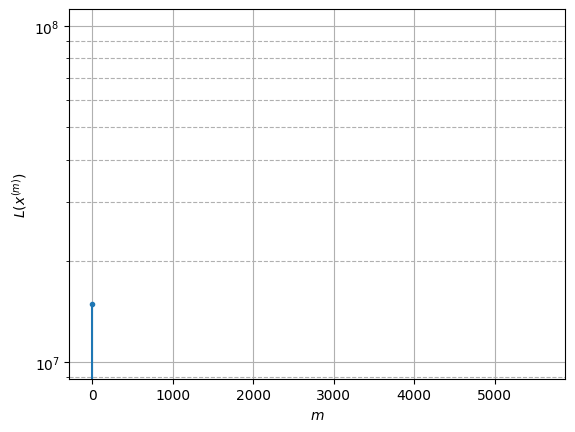

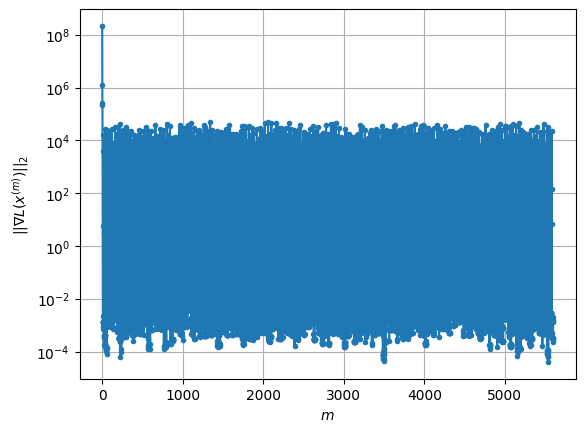

Windows:  74%|███████▍  | 280/376 [34:06<12:15,  7.66s/it]

Before applying the algorithm
Cost function: -3151371.1476946333
Gradient norm: 25800.622655143034
Global relative error: 52.79782079963818
Position relative errors: 0.017678669377274265 m, 27.987579397275432 m, 9.632862069445125 m, 43.72082107084406 m

Iteration 1
Cost function: -3151373.4846106106 (-0.00%)
Gradient norm: 65.60940933045899 (-99.75%)
Global relative error: 58.02157239245284 (9.89%)
Position relative errors: 0.04054113708765101 m, 30.38877364814879 m, 26.72008719328143 m, 41.5819518663507 m

Iteration 2
Cost function: -3151373.4851748445 (-0.00%)
Gradient norm: 0.3137857959647494 (-99.52%)
Global relative error: 58.47353136166159 (0.78%)
Position relative errors: 0.040541139814523536 m, 30.60298319014349 m, 27.074076086900593 m, 41.82824501847472 m

Iteration 3
Cost function: -3151373.4851748664 (-0.00%)
Gradient norm: 0.0015799148140970489 (-99.50%)
Global relative error: 58.474859439997296 (0.00%)
Position relative errors: 0.040541140499293235 m, 30.603357309280394 m,

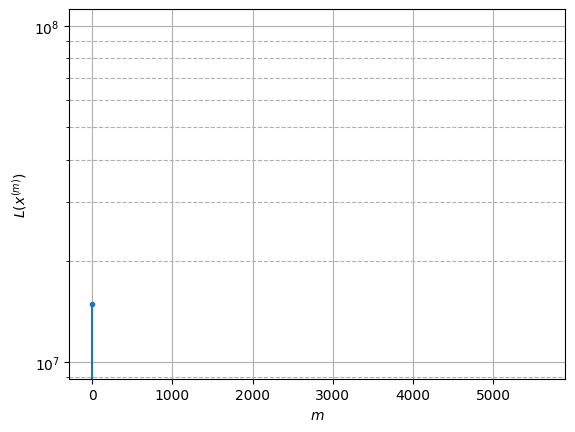

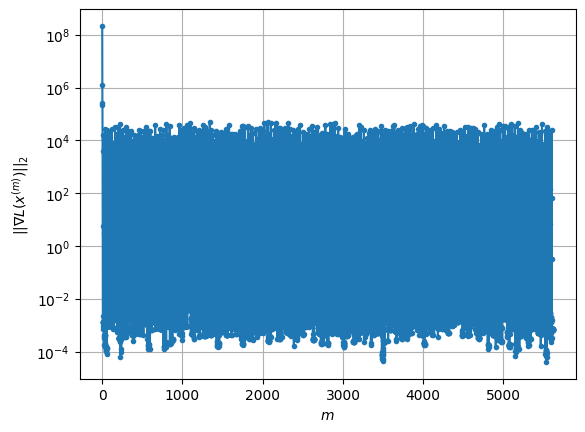

Windows:  75%|███████▍  | 281/376 [34:14<12:06,  7.65s/it]

Before applying the algorithm
Cost function: -3151365.86338459
Gradient norm: 24150.869815959733
Global relative error: 55.778714924892874
Position relative errors: 0.03668921015469101 m, 28.909549343383386 m, 26.33968249358873 m, 39.77084905538944 m

Iteration 1
Cost function: -3151367.95688803 (-0.00%)
Gradient norm: 96.41746824262982 (-99.60%)
Global relative error: 58.799664611349236 (5.42%)
Position relative errors: 0.07565489281218785 m, 30.940228623399587 m, 31.469205639196026 m, 38.85595528439318 m

Iteration 2
Cost function: -3151367.9573233933 (-0.00%)
Gradient norm: 0.10779186424438623 (-99.89%)
Global relative error: 58.96695787317198 (0.28%)
Position relative errors: 0.07565489323493411 m, 31.046118913862543 m, 31.732987042070956 m, 38.81045569363465 m

Iteration 3
Cost function: -3151367.95732341 (-0.00%)
Gradient norm: 0.0011757628392452086 (-98.91%)
Global relative error: 58.967270724463646 (0.00%)
Position relative errors: 0.0756548932044442 m, 31.046287432453173 m, 31

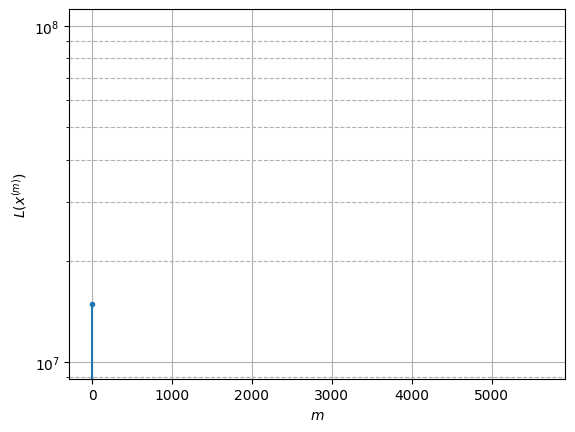

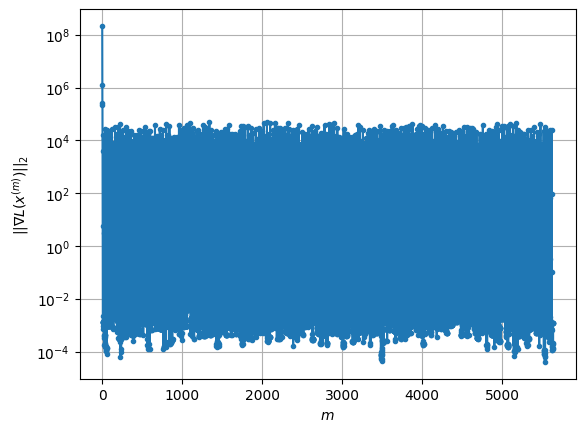

Windows:  75%|███████▌  | 282/376 [34:22<12:02,  7.69s/it]

Before applying the algorithm
Cost function: -3151368.1798274787
Gradient norm: 13718.073816721211
Global relative error: 57.19179104526491
Position relative errors: 0.06945389808300412 m, 30.120218326965222 m, 30.205327498522255 m, 38.09600485518279 m

Iteration 1
Cost function: -3151370.2240459016 (-0.00%)
Gradient norm: 223.63206256270402 (-98.37%)
Global relative error: 36.05395634849708 (-36.96%)
Position relative errors: 0.06854869914133943 m, 18.35133396059655 m, 20.65091331224551 m, 23.165731598339416 m

Iteration 2
Cost function: -3151370.2272867938 (-0.00%)
Gradient norm: 1.089413908952342 (-99.51%)
Global relative error: 38.19524789016419 (5.94%)
Position relative errors: 0.06854869635053377 m, 19.003043798819824 m, 22.7514431628284 m, 24.08585019012225 m

Iteration 3
Cost function: -3151370.2272869507 (-0.00%)
Gradient norm: 0.0020812749529309105 (-99.81%)
Global relative error: 38.20559804781006 (0.03%)
Position relative errors: 0.06854869646927271 m, 19.006772854189123 m,

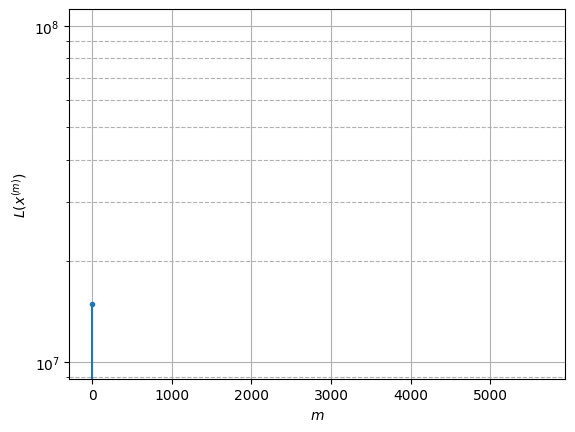

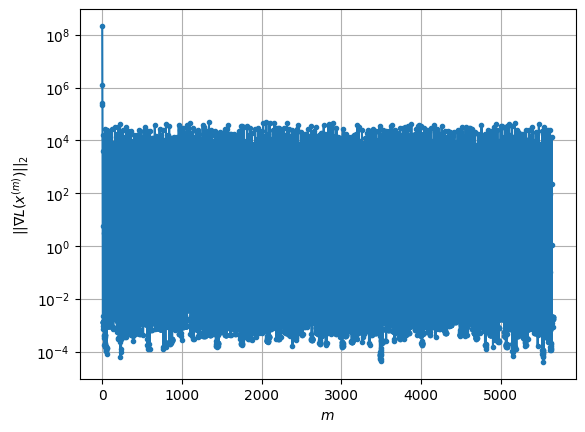

Windows:  75%|███████▌  | 283/376 [34:29<11:50,  7.64s/it]

Before applying the algorithm
Cost function: -3151365.6463262164
Gradient norm: 21141.068465418564
Global relative error: 38.4967370992402
Position relative errors: 0.06332037801641367 m, 19.164160145579082 m, 22.419079229090755 m, 24.740945878126375 m

Iteration 1
Cost function: -3151367.9399954295 (-0.00%)
Gradient norm: 153.14233222163378 (-99.28%)
Global relative error: 42.49130218101042 (10.38%)
Position relative errors: 0.05066749376531374 m, 22.0378677552856 m, 12.239960344280437 m, 34.20560889894965 m

Iteration 2
Cost function: -3151367.940919217 (-0.00%)
Gradient norm: 0.5544316864259267 (-99.64%)
Global relative error: 43.028761707723426 (1.26%)
Position relative errors: 0.050667492216007845 m, 22.267728313383053 m, 12.915470468400917 m, 34.47912926948039 m

Iteration 3
Cost function: -3151367.9409192223 (-0.00%)
Gradient norm: 0.0009180371370335536 (-99.83%)
Global relative error: 43.02962913286221 (0.00%)
Position relative errors: 0.05066749214893516 m, 22.26803412665147 m

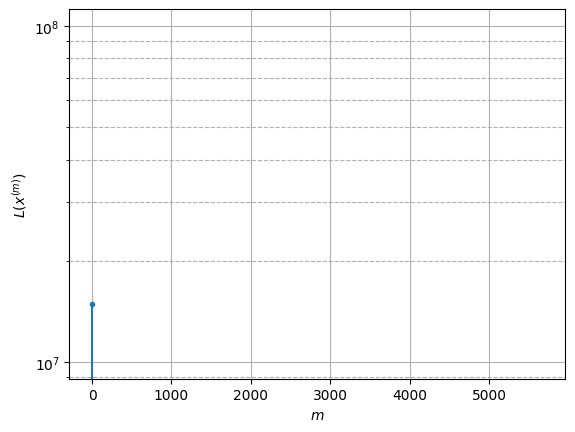

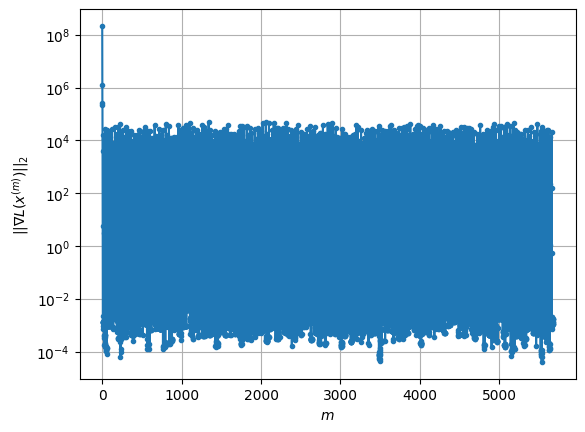

Windows:  76%|███████▌  | 284/376 [34:37<11:44,  7.66s/it]

Before applying the algorithm
Cost function: -3151362.7212806433
Gradient norm: 37308.718322270564
Global relative error: 42.02659761392109
Position relative errors: 0.045903561804826694 m, 21.95886424265605 m, 12.570443414358992 m, 33.5562906125195 m

Iteration 1
Cost function: -3151366.141275659 (-0.00%)
Gradient norm: 217.06116850220096 (-99.42%)
Global relative error: 57.244412254097476 (36.21%)
Position relative errors: 0.05025614807834096 m, 27.468658238373195 m, 11.497742287445188 m, 48.88959768462136 m

Iteration 2
Cost function: -3151366.143359568 (-0.00%)
Gradient norm: 0.42365379316376883 (-99.80%)
Global relative error: 56.03489126241854 (-2.11%)
Position relative errors: 0.05025614667474651 m, 27.14860750591826 m, 11.262187406697013 m, 47.70765926661844 m

Iteration 3
Cost function: -3151366.143359601 (-0.00%)
Gradient norm: 0.0005614520358027211 (-99.87%)
Global relative error: 56.033068796983585 (-0.00%)
Position relative errors: 0.05025614637990885 m, 27.148195641879692

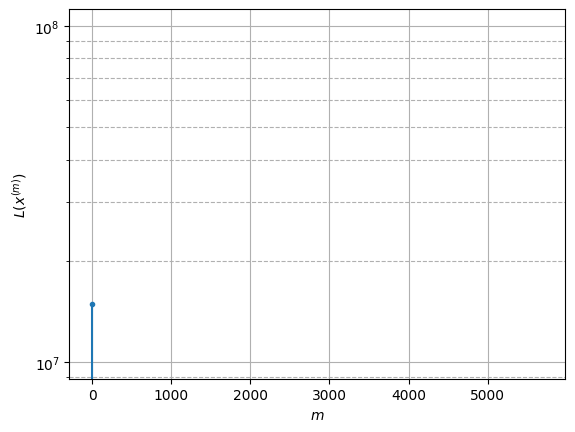

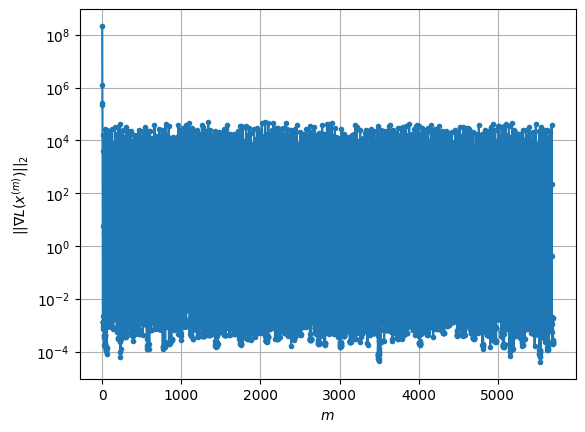

Windows:  76%|███████▌  | 285/376 [34:45<11:37,  7.67s/it]

Before applying the algorithm
Cost function: -3151356.8897386733
Gradient norm: 38310.29832521935
Global relative error: 53.55583053844973
Position relative errors: 0.04745460280210675 m, 26.675533114677258 m, 11.5231049407129 m, 44.987291362656705 m

Iteration 1
Cost function: -3151361.4804401724 (-0.00%)
Gradient norm: 175.38219215734554 (-99.54%)
Global relative error: 44.23024722853567 (-17.41%)
Position relative errors: 0.06686922254593056 m, 15.510157391708107 m, 18.80938198493748 m, 36.904595902550554 m

Iteration 2
Cost function: -3151361.4851353113 (-0.00%)
Gradient norm: 0.8302956527459857 (-99.53%)
Global relative error: 44.19557225978623 (-0.08%)
Position relative errors: 0.06686921755620717 m, 16.076992844072556 m, 17.57869681004495 m, 37.22580837279245 m

Iteration 3
Cost function: -3151361.4851354253 (-0.00%)
Gradient norm: 0.002116741146292994 (-99.75%)
Global relative error: 44.19627561389781 (0.00%)
Position relative errors: 0.06686921822211123 m, 16.081052763749163 m

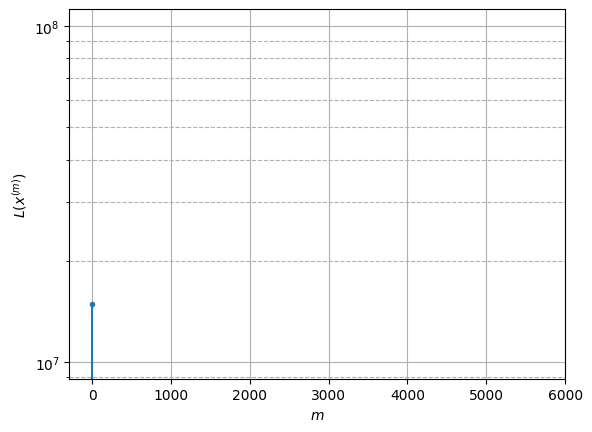

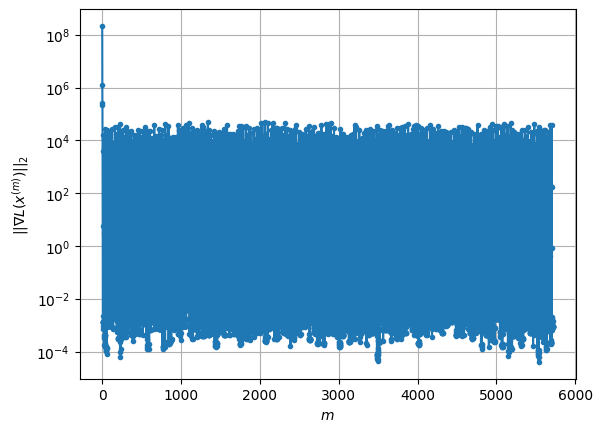

Windows:  76%|███████▌  | 286/376 [34:52<11:15,  7.51s/it]

Before applying the algorithm
Cost function: -3151358.2005936094
Gradient norm: 19385.467191272975
Global relative error: 41.13492921693058
Position relative errors: 0.06331774373132593 m, 15.98505814132418 m, 16.28408294621799 m, 34.225453201644434 m

Iteration 1
Cost function: -3151360.835184731 (-0.00%)
Gradient norm: 245.54513602635976 (-98.73%)
Global relative error: 61.760726706107135 (50.14%)
Position relative errors: 0.055901780711877735 m, 9.624130595765957 m, 46.75713933751629 m, 39.18572234965435 m

Iteration 2
Cost function: -3151360.840964625 (-0.00%)
Gradient norm: 0.9796916214816652 (-99.60%)
Global relative error: 60.743451592504506 (-1.65%)
Position relative errors: 0.055901783049801035 m, 9.942089055227799 m, 44.58555825134251 m, 40.03794440503069 m

Iteration 3
Cost function: -3151360.840964797 (-0.00%)
Gradient norm: 0.0007856081195935638 (-99.92%)
Global relative error: 60.733768091474914 (-0.02%)
Position relative errors: 0.05590178364001502 m, 9.943793030100936 m

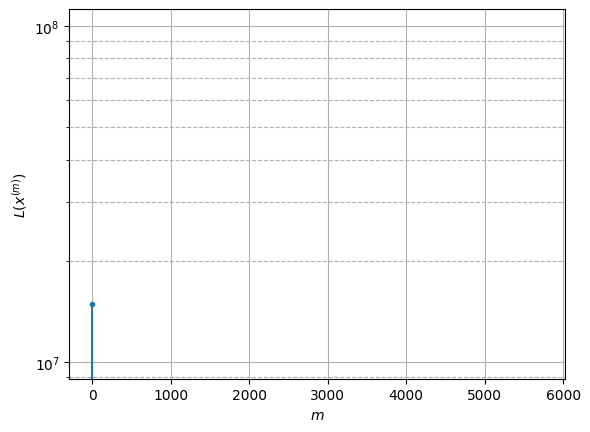

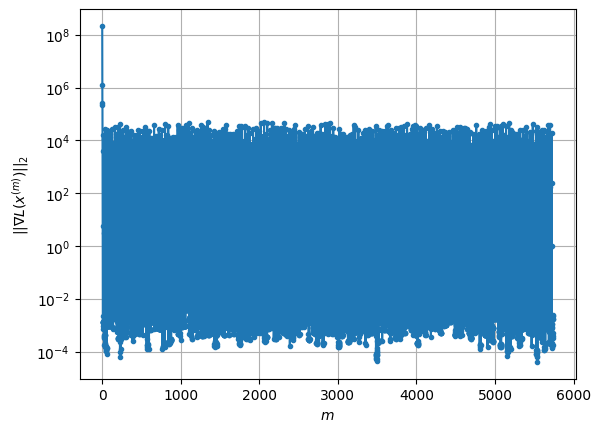

Windows:  76%|███████▋  | 287/376 [34:59<10:56,  7.37s/it]

Before applying the algorithm
Cost function: -3151349.902621496
Gradient norm: 24825.67129564223
Global relative error: 54.9029983599671
Position relative errors: 0.05273596594642023 m, 10.188935155676939 m, 40.16169584770804 m, 36.021518249357776 m

Iteration 1
Cost function: -3151357.2987465244 (-0.00%)
Gradient norm: 410.2008166062459 (-98.35%)
Global relative error: 25.0513197731457 (-54.37%)
Position relative errors: 0.054994570742429576 m, 7.482135075068541 m, 14.732511798637205 m, 18.829036020194522 m

Iteration 2
Cost function: -3151357.3104244815 (-0.00%)
Gradient norm: 3.305616076839765 (-99.19%)
Global relative error: 25.38977919606114 (1.35%)
Position relative errors: 0.054994573869422435 m, 7.548414830382098 m, 14.348434068986485 m, 19.539126965038978 m

Iteration 3
Cost function: -3151357.310425515 (-0.00%)
Gradient norm: 0.001305466210602188 (-99.96%)
Global relative error: 25.38971358668215 (-0.00%)
Position relative errors: 0.054994574729508854 m, 7.549774587459531 m, 

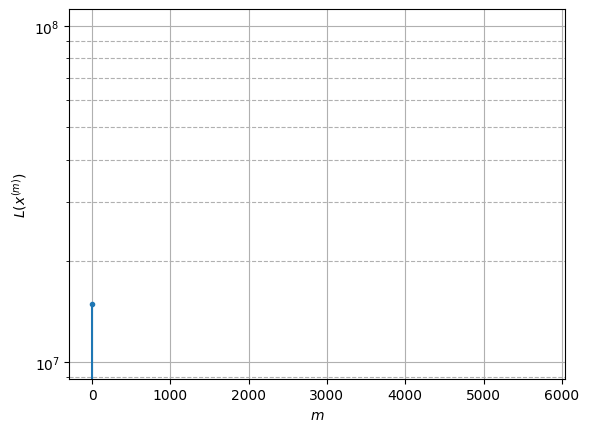

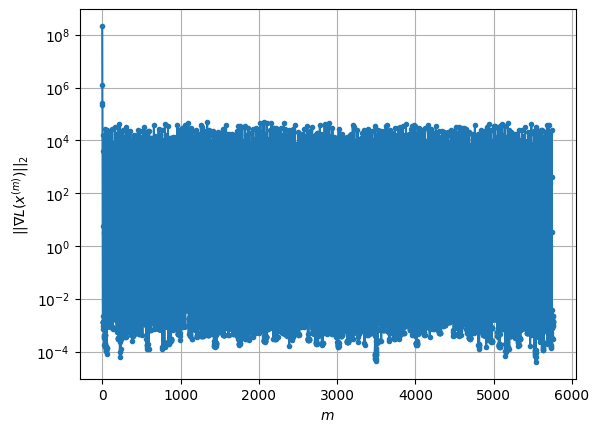

Windows:  77%|███████▋  | 288/376 [35:06<10:34,  7.21s/it]

Before applying the algorithm
Cost function: -3151351.378140159
Gradient norm: 15788.69955271368
Global relative error: 21.799297837247206
Position relative errors: 0.05285433734734373 m, 7.000059941163609 m, 13.03178800366527 m, 16.011678081903124 m

Iteration 1
Cost function: -3151354.3866564734 (-0.00%)
Gradient norm: 250.73419546959977 (-98.41%)
Global relative error: 38.06397617228574 (74.61%)
Position relative errors: 0.06008948133449042 m, 8.238158180780962 m, 10.448388622144819 m, 35.662576896053054 m

Iteration 2
Cost function: -3151354.396544178 (-0.00%)
Gradient norm: 5.167205938500494 (-97.94%)
Global relative error: 39.59758002872037 (4.03%)
Position relative errors: 0.06008949121878494 m, 9.247148615356318 m, 10.418502177042361 m, 37.06618542468784 m

Iteration 3
Cost function: -3151354.3965452267 (-0.00%)
Gradient norm: 0.0028402180606384043 (-99.95%)
Global relative error: 39.61086239030487 (0.03%)
Position relative errors: 0.060089490588333606 m, 9.254486111919997 m, 1

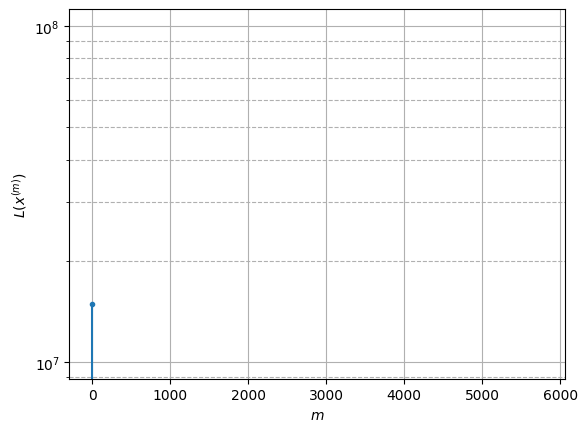

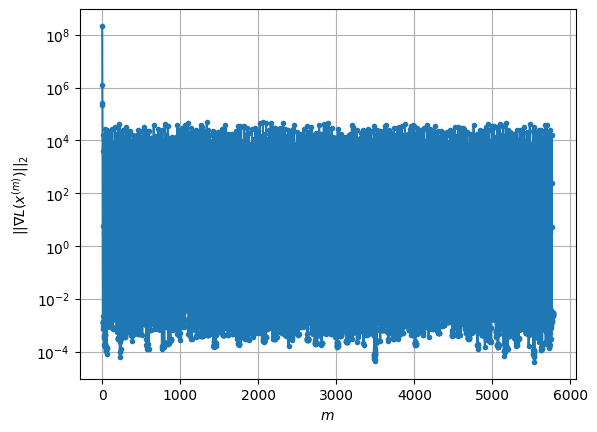

Windows:  77%|███████▋  | 289/376 [35:13<10:19,  7.12s/it]

Before applying the algorithm
Cost function: -3151345.8869171073
Gradient norm: 30876.73684059493
Global relative error: 34.43248676975933
Position relative errors: 0.056663675169447404 m, 8.38729747509403 m, 9.745736323942548 m, 31.941489162447677 m

Iteration 1
Cost function: -3151351.5120044947 (-0.00%)
Gradient norm: 165.8938898638222 (-99.46%)
Global relative error: 38.67618597901025 (12.32%)
Position relative errors: 0.07216380741959653 m, 1.1505996415787372 m, 36.229123370999076 m, 13.489352305471801 m

Iteration 2
Cost function: -3151351.514652964 (-0.00%)
Gradient norm: 0.42858715539167697 (-99.74%)
Global relative error: 39.6620429887563 (2.55%)
Position relative errors: 0.07216381653038324 m, 1.3824918258235783 m, 37.15891366798003 m, 13.797455655077881 m

Iteration 3
Cost function: -3151351.514652962 (0.00%)
Gradient norm: 0.0015331904454623179 (-99.64%)
Global relative error: 39.668525764700014 (0.02%)
Position relative errors: 0.07216381653433245 m, 1.3834351991433915 m, 

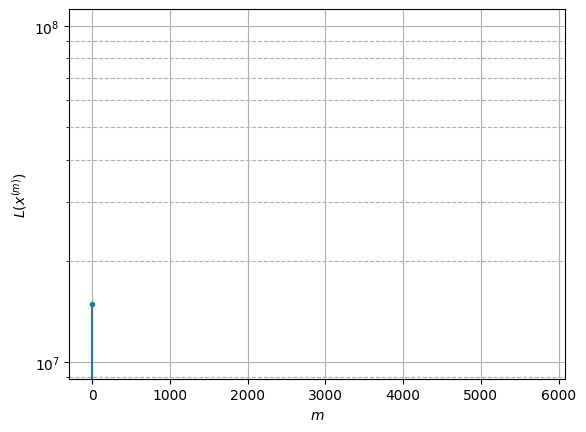

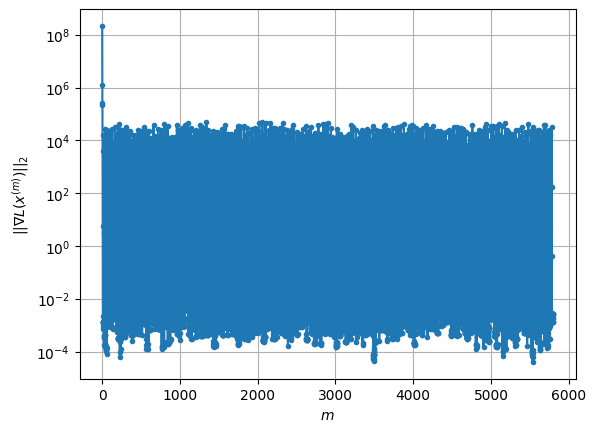

Windows:  77%|███████▋  | 290/376 [35:20<10:08,  7.07s/it]

Before applying the algorithm
Cost function: -3151342.205406463
Gradient norm: 18912.950100170085
Global relative error: 35.81460863642487
Position relative errors: 0.06675977043856353 m, 0.5978645924819505 m, 34.3486593865458 m, 10.123591831813648 m

Iteration 1
Cost function: -3151347.148115518 (-0.00%)
Gradient norm: 45.52349544724411 (-99.76%)
Global relative error: 33.78295573777264 (-5.67%)
Position relative errors: 0.03830461266222286 m, 17.29269203740556 m, 26.644179628169127 m, 11.503512561187554 m

Iteration 2
Cost function: -3151347.1495774556 (-0.00%)
Gradient norm: 0.11981247292587102 (-99.74%)
Global relative error: 33.966363984184994 (0.54%)
Position relative errors: 0.038304612574624954 m, 17.52594392870443 m, 26.21203071953346 m, 12.628410396504997 m

Iteration 3
Cost function: -3151347.1495774644 (-0.00%)
Gradient norm: 0.00028685180049987523 (-99.76%)
Global relative error: 33.96739593708387 (0.00%)
Position relative errors: 0.03830461256367521 m, 17.526604539089917 

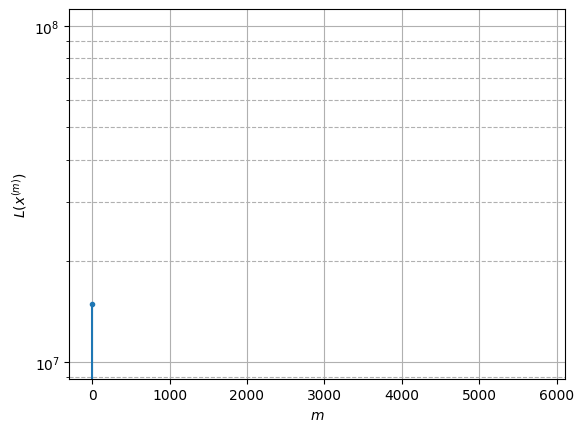

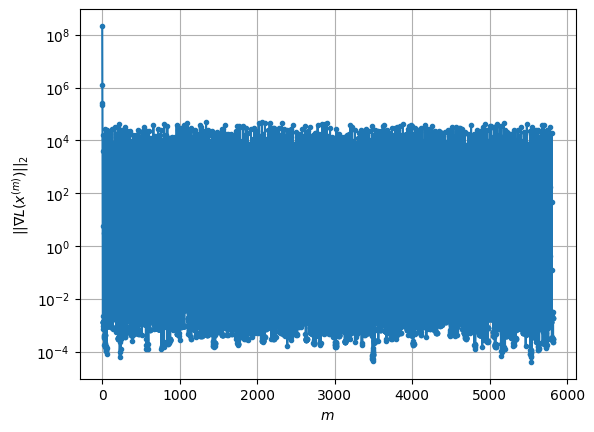

Windows:  77%|███████▋  | 291/376 [35:26<09:52,  6.98s/it]

Before applying the algorithm
Cost function: -3151343.553955605
Gradient norm: 23607.87991229481
Global relative error: 29.708236332236893
Position relative errors: 0.03424763020730576 m, 15.738267582188502 m, 23.519161574895154 m, 9.040322563225507 m

Iteration 1
Cost function: -3151346.7335677813 (-0.00%)
Gradient norm: 227.1800583350518 (-99.04%)
Global relative error: 21.8455118321809 (-26.47%)
Position relative errors: 0.023365674157556873 m, 17.46912659913075 m, 11.457300735657014 m, 6.386224882794442 m

Iteration 2
Cost function: -3151346.7430330124 (-0.00%)
Gradient norm: 5.193466989991809 (-97.71%)
Global relative error: 22.320081060845613 (2.17%)
Position relative errors: 0.023365678436539052 m, 18.38937810925808 m, 12.010743385632269 m, 3.969382103303225 m

Iteration 3
Cost function: -3151346.743033722 (-0.00%)
Gradient norm: 0.002553681491943876 (-99.95%)
Global relative error: 22.325930157440453 (0.03%)
Position relative errors: 0.023365678239704046 m, 18.394079526934906 m

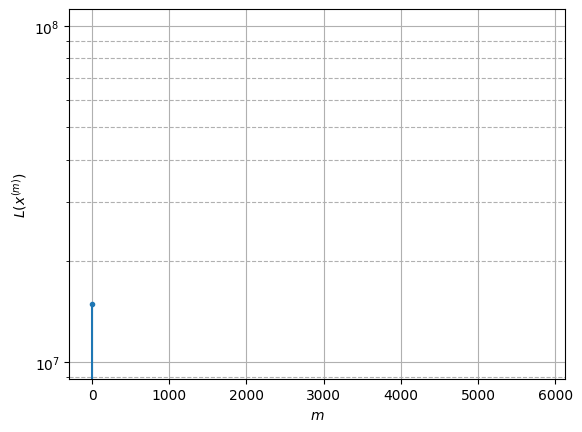

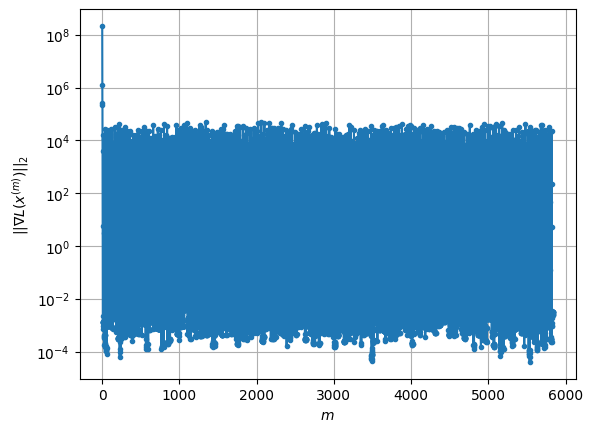

Windows:  78%|███████▊  | 292/376 [35:33<09:46,  6.98s/it]

Before applying the algorithm
Cost function: -3151344.697373131
Gradient norm: 23536.067061726862
Global relative error: 20.81634520475208
Position relative errors: 0.021515184330029472 m, 17.527334924248414 m, 9.990035839436626 m, 5.1292471042577565 m

Iteration 1
Cost function: -3151347.082590881 (-0.00%)
Gradient norm: 115.10372503437617 (-99.51%)
Global relative error: 23.72813398324927 (13.99%)
Position relative errors: 0.02918601997403959 m, 20.80086865759124 m, 4.625271611109607 m, 10.43785500233993 m

Iteration 2
Cost function: -3151347.0864362298 (-0.00%)
Gradient norm: 2.6864281130938816 (-97.67%)
Global relative error: 22.481212337097354 (-5.26%)
Position relative errors: 0.029186012074429734 m, 20.166032825087203 m, 4.227464949680197 m, 8.992154614724463 m

Iteration 3
Cost function: -3151347.0864363364 (-0.00%)
Gradient norm: 0.0007527821754360737 (-99.97%)
Global relative error: 22.47873788082412 (-0.01%)
Position relative errors: 0.029186012281790685 m, 20.16460509277118

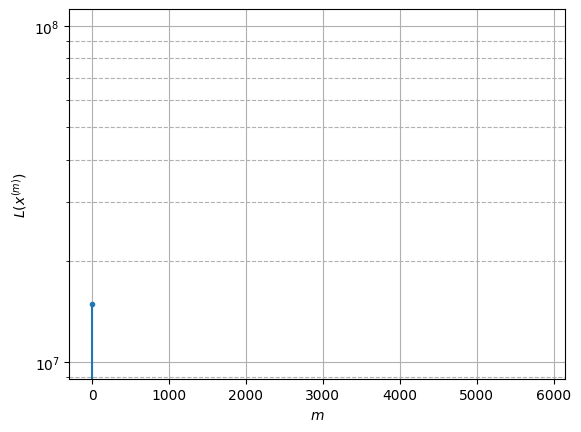

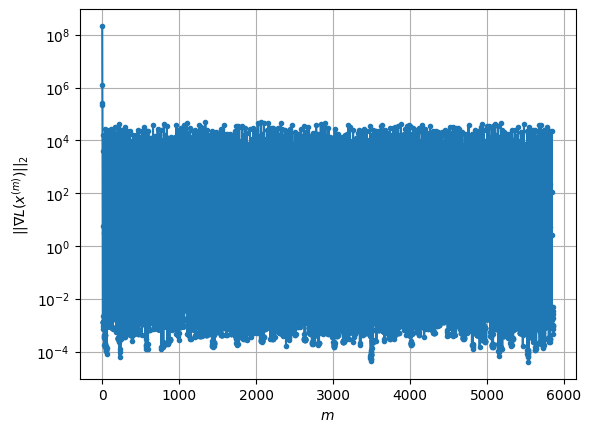

Windows:  78%|███████▊  | 293/376 [35:40<09:39,  6.98s/it]

Before applying the algorithm
Cost function: -3151344.2030210267
Gradient norm: 27392.419640174958
Global relative error: 19.638254268241834
Position relative errors: 0.02496366887377473 m, 18.5581345753742 m, 3.7579582477754268 m, 5.208533700793985 m

Iteration 1
Cost function: -3151346.274688632 (-0.00%)
Gradient norm: 289.1655883122345 (-98.94%)
Global relative error: 28.16726989134223 (43.43%)
Position relative errors: 0.04596624872505396 m, 10.83797712363797 m, 5.553576742600863 m, 25.398591296757036 m

Iteration 2
Cost function: -3151346.2813648144 (-0.00%)
Gradient norm: 3.335720135771094 (-98.85%)
Global relative error: 29.919385767422852 (6.22%)
Position relative errors: 0.0459662429494608 m, 10.147903331631019 m, 5.044956786718298 m, 27.68998941948747 m

Iteration 3
Cost function: -3151346.2813652544 (-0.00%)
Gradient norm: 0.0006229039559767627 (-99.98%)
Global relative error: 29.93200820618914 (0.04%)
Position relative errors: 0.04596624384035643 m, 10.143686490794941 m, 5.

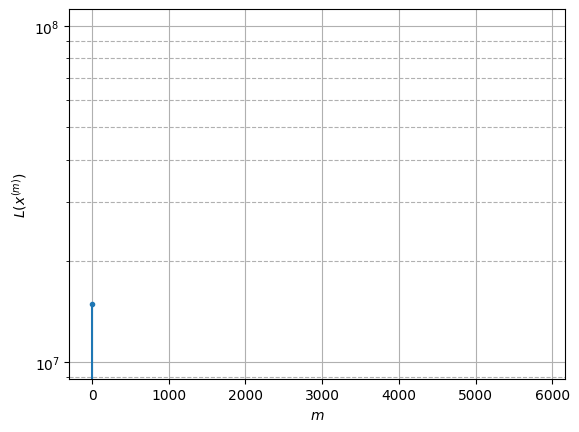

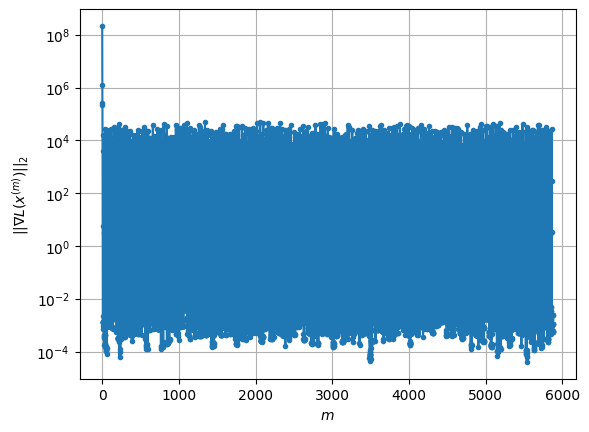

Windows:  78%|███████▊  | 294/376 [35:47<09:32,  6.98s/it]

Before applying the algorithm
Cost function: -3151344.623247615
Gradient norm: 15272.354727531785
Global relative error: 29.625709958415946
Position relative errors: 0.04041498371332034 m, 9.702845190446993 m, 4.391951147135898 m, 27.645002498014346 m

Iteration 1
Cost function: -3151348.073888799 (-0.00%)
Gradient norm: 83.29343345858317 (-99.45%)
Global relative error: 30.69426679652786 (3.61%)
Position relative errors: 0.03222162543250031 m, 5.77531292169738 m, 14.337248057066887 m, 26.51840712800811 m

Iteration 2
Cost function: -3151348.075559868 (-0.00%)
Gradient norm: 0.8136673894209651 (-99.02%)
Global relative error: 30.22833925889234 (-1.52%)
Position relative errors: 0.03222162499329424 m, 5.823340928263494 m, 13.314742888240449 m, 26.505803958179005 m

Iteration 3
Cost function: -3151348.075559892 (-0.00%)
Gradient norm: 0.0012299651028492911 (-99.85%)
Global relative error: 30.227549313323017 (-0.00%)
Position relative errors: 0.032221624553899264 m, 5.82339359663958 m, 13

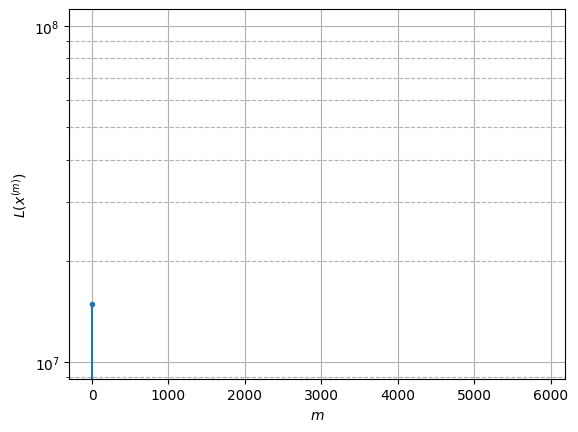

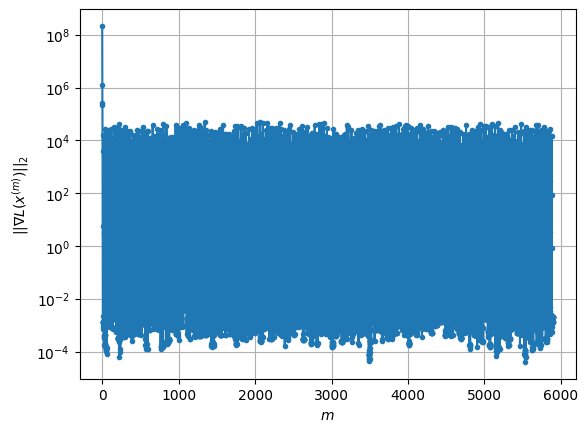

Windows:  78%|███████▊  | 295/376 [35:54<09:22,  6.94s/it]

Before applying the algorithm
Cost function: -3151338.5152946706
Gradient norm: 25350.034212200007
Global relative error: 29.93251681535297
Position relative errors: 0.02834052770175264 m, 5.322602200467228 m, 13.179556436363042 m, 26.342433812833594 m

Iteration 1
Cost function: -3151345.141255195 (-0.00%)
Gradient norm: 1057.1407511629427 (-95.83%)
Global relative error: 48.65905190376353 (62.56%)
Position relative errors: 0.018331570135589618 m, 14.380009938838173 m, 37.810657794900976 m, 27.04188266613018 m

Iteration 2
Cost function: -3151345.3042797875 (-0.00%)
Gradient norm: 46.84154673957272 (-95.57%)
Global relative error: 44.54151995086518 (-8.46%)
Position relative errors: 0.018331527133090473 m, 12.40171848944116 m, 34.62615429745698 m, 25.12304154379162 m

Iteration 3
Cost function: -3151345.3044842044 (-0.00%)
Gradient norm: 0.06787645389716665 (-99.86%)
Global relative error: 44.40749490757486 (-0.30%)
Position relative errors: 0.01833152624749535 m, 12.297480963065157 m

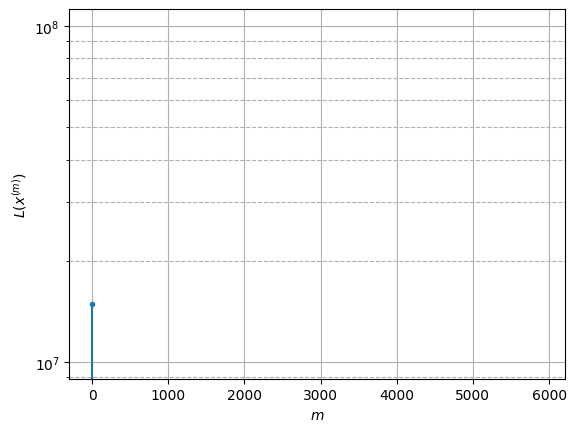

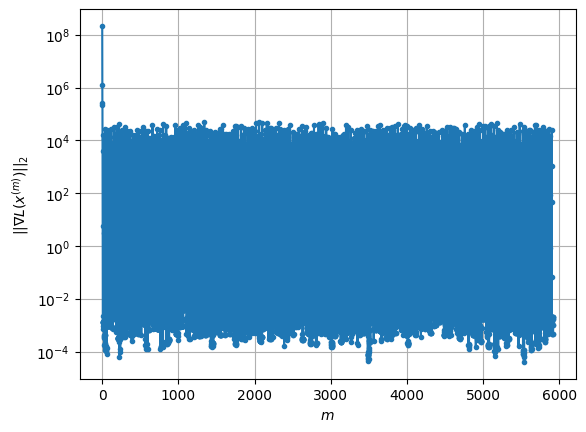

Windows:  79%|███████▊  | 296/376 [36:01<09:11,  6.89s/it]

Before applying the algorithm
Cost function: -3151341.9603704843
Gradient norm: 16426.76227633591
Global relative error: 40.21264928442454
Position relative errors: 0.01631311729631208 m, 11.165321594569871 m, 29.952250723393504 m, 24.397719687999256 m

Iteration 1
Cost function: -3151346.4702614928 (-0.00%)
Gradient norm: 188.66859931758 (-98.85%)
Global relative error: 51.63176210226596 (28.40%)
Position relative errors: 0.05374686036091465 m, 11.978098103105888 m, 27.774901112556563 m, 41.84389771541586 m

Iteration 2
Cost function: -3151346.474764464 (-0.00%)
Gradient norm: 1.5175104737863063 (-99.20%)
Global relative error: 50.733138700851725 (-1.74%)
Position relative errors: 0.053746861391291055 m, 11.84143633525853 m, 26.950927092823996 m, 41.3191528882405 m

Iteration 3
Cost function: -3151346.474764587 (-0.00%)
Gradient norm: 0.0016552539307765428 (-99.89%)
Global relative error: 50.72983796197653 (-0.01%)
Position relative errors: 0.0537468604904439 m, 11.840102955100729 m, 

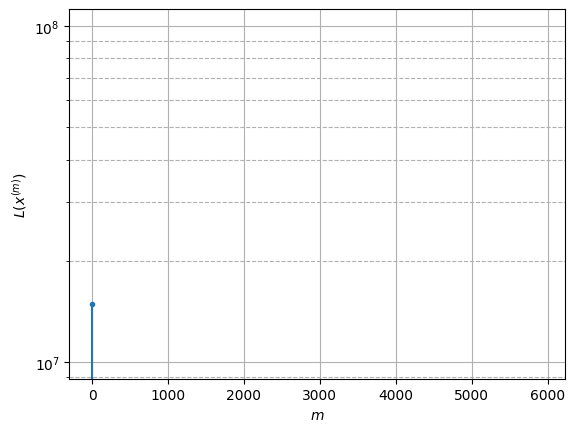

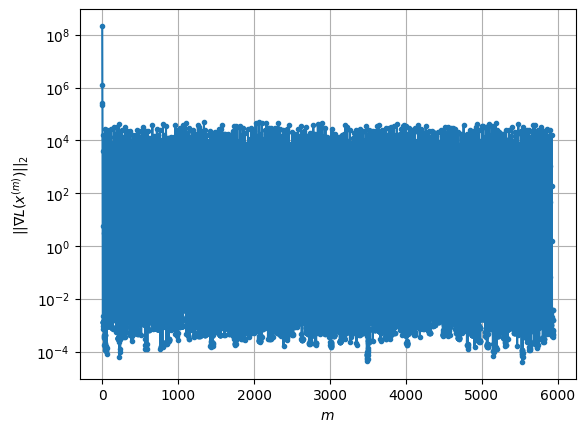

Windows:  79%|███████▉  | 297/376 [36:08<09:05,  6.91s/it]

Before applying the algorithm
Cost function: -3151338.364929373
Gradient norm: 18555.171826039463
Global relative error: 47.41947541359507
Position relative errors: 0.0471211315814473 m, 11.178406008389075 m, 23.88195131067297 m, 39.411876672127995 m

Iteration 1
Cost function: -3151344.0923108407 (-0.00%)
Gradient norm: 65.8641220307567 (-99.65%)
Global relative error: 42.41176204210479 (-10.56%)
Position relative errors: 0.0562732857187446 m, 7.061346448406173 m, 10.870560896401932 m, 40.3821865723972 m

Iteration 2
Cost function: -3151344.1006601406 (-0.00%)
Gradient norm: 4.366234935609342 (-93.37%)
Global relative error: 42.83435263860085 (1.00%)
Position relative errors: 0.05627326954440678 m, 6.121502817647456 m, 9.441188154776652 m, 41.329992604196384 m

Iteration 3
Cost function: -3151344.10066065 (-0.00%)
Gradient norm: 0.0012425718047012874 (-99.97%)
Global relative error: 42.83380230657724 (-0.00%)
Position relative errors: 0.056273268874172826 m, 6.11933261933959 m, 9.4354

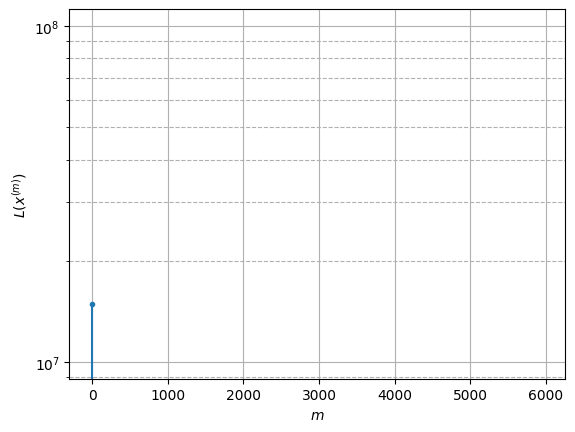

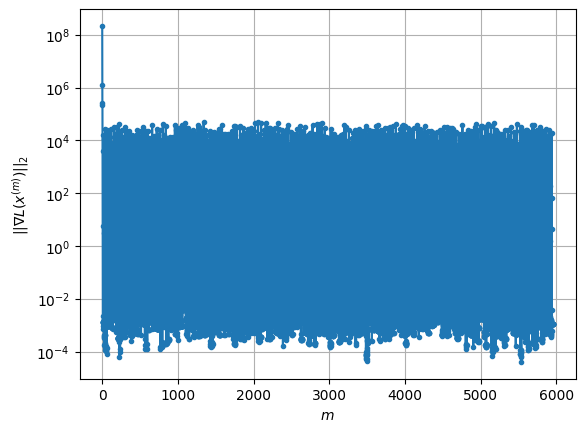

Windows:  79%|███████▉  | 298/376 [36:15<09:02,  6.96s/it]

Before applying the algorithm
Cost function: -3151339.248573708
Gradient norm: 29555.61167973514
Global relative error: 41.090106750130566
Position relative errors: 0.05064143478843573 m, 5.495660379584321 m, 8.100914299004636 m, 39.90696304542148 m

Iteration 1
Cost function: -3151342.0531013384 (-0.00%)
Gradient norm: 37.179896412952154 (-99.87%)
Global relative error: 50.82322566391636 (23.69%)
Position relative errors: 0.04392235014806231 m, 4.521102510068505 m, 17.937474372885543 m, 47.33712575757544 m

Iteration 2
Cost function: -3151342.054291095 (-0.00%)
Gradient norm: 0.25250155681553094 (-99.32%)
Global relative error: 50.99121123302909 (0.33%)
Position relative errors: 0.043922353348301135 m, 4.352413424574632 m, 19.15013893880584 m, 47.05771791657552 m

Iteration 3
Cost function: -3151342.0542910993 (-0.00%)
Gradient norm: 0.0008921420328125632 (-99.65%)
Global relative error: 50.99087510977719 (-0.00%)
Position relative errors: 0.043922353348301135 m, 4.352298191830519 m, 

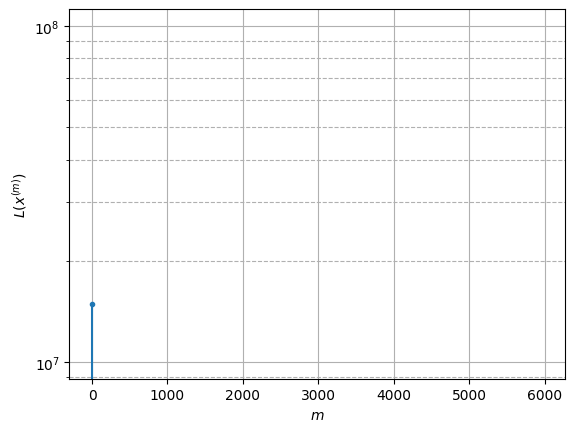

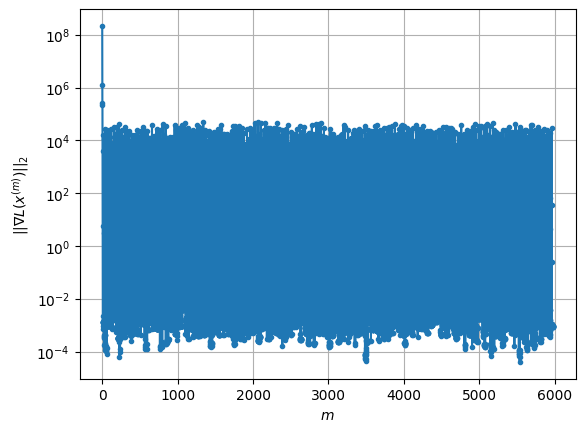

Windows:  80%|███████▉  | 299/376 [36:22<08:52,  6.92s/it]

Before applying the algorithm
Cost function: -3151329.727973005
Gradient norm: 11342.716865896562
Global relative error: 48.9158167387578
Position relative errors: 0.03952455946116487 m, 4.116739196496981 m, 17.434885361066048 m, 45.517371734930336 m

Iteration 1
Cost function: -3151335.0271825246 (-0.00%)
Gradient norm: 370.725174955214 (-96.73%)
Global relative error: 37.64468083630823 (-23.04%)
Position relative errors: 0.07214121705775071 m, 16.45806271484925 m, 25.285859450707427 m, 22.51376881348924 m

Iteration 2
Cost function: -3151335.0416472703 (-0.00%)
Gradient norm: 9.149938244557736 (-97.53%)
Global relative error: 38.415397629571366 (2.05%)
Position relative errors: 0.07214120751364377 m, 17.917772889492426 m, 26.756055333964387 m, 20.94753460204638 m

Iteration 3
Cost function: -3151335.04164931 (-0.00%)
Gradient norm: 0.0015356502852187078 (-99.98%)
Global relative error: 38.41739854311595 (0.01%)
Position relative errors: 0.0721412079348696 m, 17.93229126422831 m, 26.7

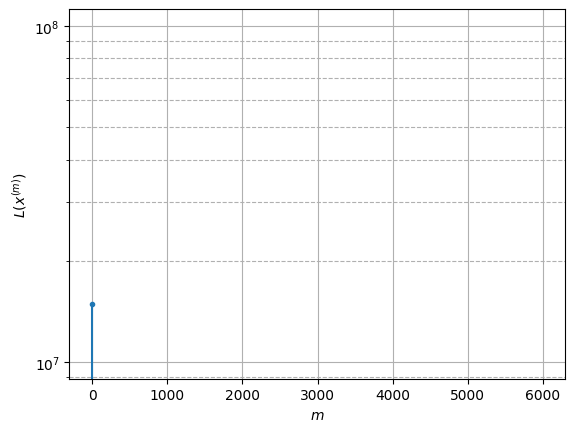

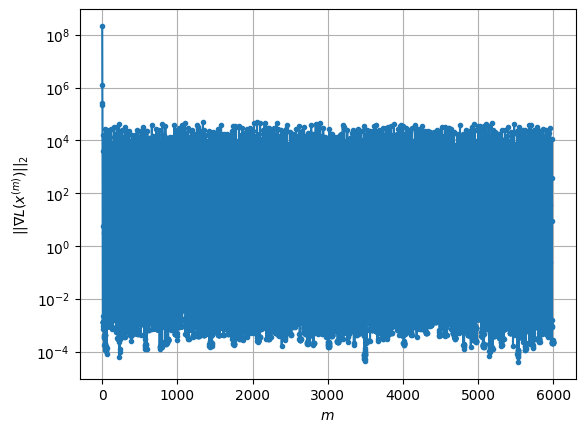

Windows:  80%|███████▉  | 300/376 [36:29<08:46,  6.93s/it]

Before applying the algorithm
Cost function: -3151323.7371385354
Gradient norm: 28353.276163209142
Global relative error: 35.444512194250734
Position relative errors: 0.06494874204858327 m, 15.691649583119272 m, 23.337701334640666 m, 21.573771167477208 m

Iteration 1
Cost function: -3151328.3183679376 (-0.00%)
Gradient norm: 83.71417072233722 (-99.70%)
Global relative error: 46.46310896236535 (31.09%)
Position relative errors: 0.08629543773261229 m, 29.038887637588758 m, 27.92332796585838 m, 23.14812701694841 m

Iteration 2
Cost function: -3151328.3202177216 (-0.00%)
Gradient norm: 1.101368865226637 (-98.68%)
Global relative error: 46.121768908384716 (-0.73%)
Position relative errors: 0.08629544183266841 m, 28.4503232079506 m, 27.341939564328566 m, 23.878858699924898 m

Iteration 3
Cost function: -3151328.3202177417 (-0.00%)
Gradient norm: 0.002540115704753528 (-99.77%)
Global relative error: 46.12118660587365 (-0.00%)
Position relative errors: 0.08629544153215926 m, 28.44929227352069 

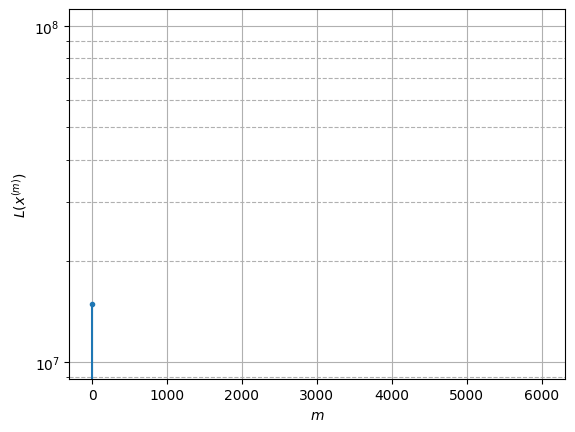

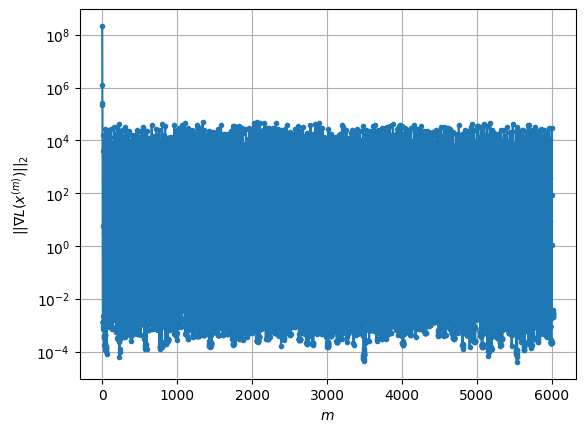

Windows:  80%|████████  | 301/376 [36:36<08:39,  6.92s/it]

Before applying the algorithm
Cost function: -3151318.291305331
Gradient norm: 32233.670426627024
Global relative error: 42.39496583787351
Position relative errors: 0.07518181162193972 m, 25.965919155958662 m, 22.973346760970596 m, 24.3990971949708 m

Iteration 1
Cost function: -3151322.632421874 (-0.00%)
Gradient norm: 73.67260163599106 (-99.77%)
Global relative error: 67.43505087946433 (59.06%)
Position relative errors: 0.03675102480443322 m, 10.153022199676304 m, 30.419768610490983 m, 59.32143019696971 m

Iteration 2
Cost function: -3151322.6342790537 (-0.00%)
Gradient norm: 0.09766422067019075 (-99.87%)
Global relative error: 66.78465071372193 (-0.96%)
Position relative errors: 0.0367510154643009 m, 9.869639228145887 m, 29.840141175562312 m, 58.92654833406626 m

Iteration 3
Cost function: -3151322.634279069 (-0.00%)
Gradient norm: 0.002095386155886402 (-97.85%)
Global relative error: 66.78158140111145 (-0.00%)
Position relative errors: 0.036751015869591834 m, 9.86949710123042 m, 29

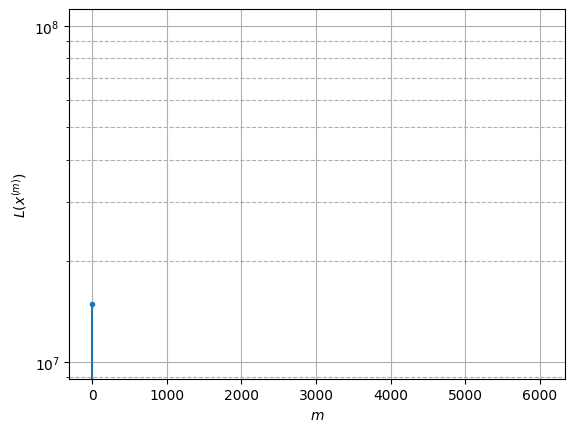

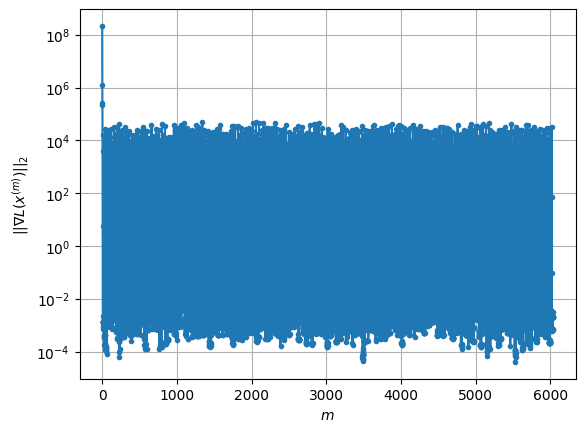

Windows:  80%|████████  | 302/376 [36:42<08:32,  6.92s/it]

Before applying the algorithm
Cost function: -3151320.012267134
Gradient norm: 11209.187539901714
Global relative error: 64.07881468547403
Position relative errors: 0.0307676467110984 m, 7.949058089873853 m, 25.598991522231184 m, 58.203015758431995 m

Iteration 1
Cost function: -3151322.1161273047 (-0.00%)
Gradient norm: 108.23261170789513 (-99.03%)
Global relative error: 56.90343299060354 (-11.20%)
Position relative errors: 0.056742735067182797 m, 9.531308913221157 m, 6.006567970922896 m, 55.77695700217617 m

Iteration 2
Cost function: -3151322.119057686 (-0.00%)
Gradient norm: 0.6575912262783313 (-99.39%)
Global relative error: 57.05308815661164 (0.26%)
Position relative errors: 0.056742730382757726 m, 8.978894194046525 m, 5.489614506594694 m, 56.07398389601552 m

Iteration 3
Cost function: -3151322.1190577345 (-0.00%)
Gradient norm: 0.0003721687247845194 (-99.94%)
Global relative error: 57.0539689667522 (0.00%)
Position relative errors: 0.056742730503966866 m, 8.977248613960557 m, 5

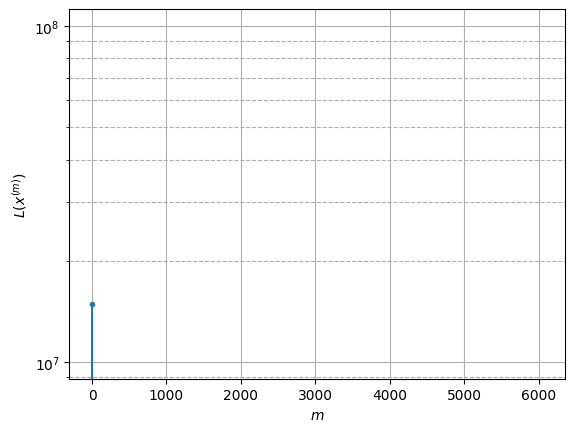

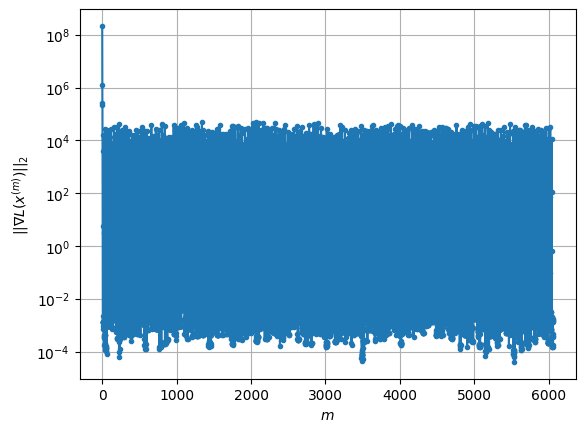

Windows:  81%|████████  | 303/376 [36:50<08:31,  7.00s/it]

Before applying the algorithm
Cost function: -3151326.065520357
Gradient norm: 25412.464617510544
Global relative error: 56.72117042168069
Position relative errors: 0.048726771694470414 m, 7.240298486137533 m, 4.766841326664228 m, 56.05479995861543 m

Iteration 1
Cost function: -3151329.0415052953 (-0.00%)
Gradient norm: 83.03841366651919 (-99.67%)
Global relative error: 49.80606128656517 (-12.19%)
Position relative errors: 0.095204309350358 m, 6.156488646232359 m, 0.8238377449475108 m, 49.41711333312589 m

Iteration 2
Cost function: -3151329.0424463316 (-0.00%)
Gradient norm: 0.43096599073292546 (-99.48%)
Global relative error: 50.851285378492065 (2.10%)
Position relative errors: 0.09520431610067039 m, 5.844205967231053 m, 0.8378985536133706 m, 50.50727573185816 m

Iteration 3
Cost function: -3151329.042446352 (-0.00%)
Gradient norm: 0.0039009339644684683 (-99.09%)
Global relative error: 50.85180329510136 (0.00%)
Position relative errors: 0.09520431695471991 m, 5.843900003518808 m, 0.

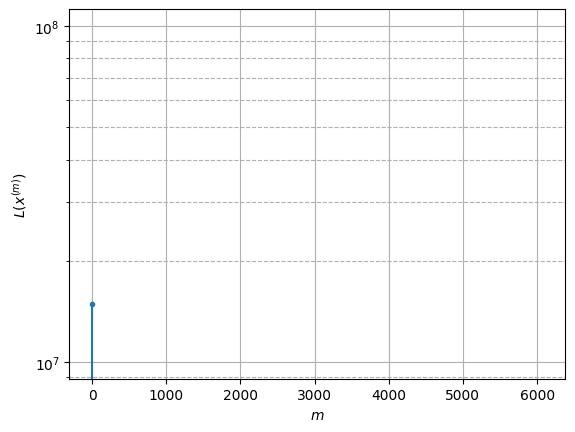

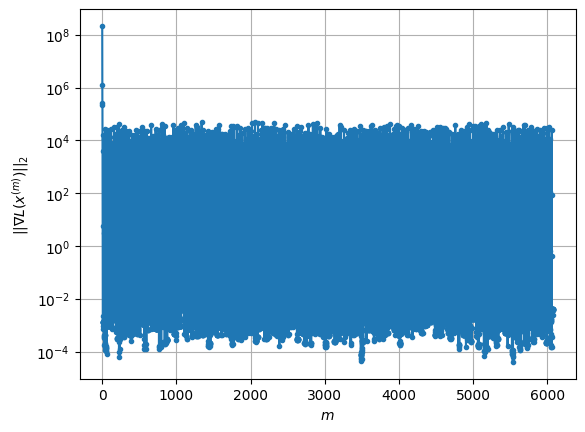

Windows:  81%|████████  | 304/376 [36:57<08:26,  7.03s/it]

Before applying the algorithm
Cost function: -3151327.383798132
Gradient norm: 27793.931652364612
Global relative error: 51.225397656052465
Position relative errors: 0.08432008200896778 m, 4.361808815159692 m, 2.2612535482005227 m, 50.98914884341711 m

Iteration 1
Cost function: -3151332.720647221 (-0.00%)
Gradient norm: 32.609548258353726 (-99.88%)
Global relative error: 40.92157841244217 (-20.11%)
Position relative errors: 0.09262936059014817 m, 3.4382070260158986 m, 5.013233313234674 m, 40.467400275593484 m

Iteration 2
Cost function: -3151332.7212948794 (-0.00%)
Gradient norm: 0.1408789354945609 (-99.57%)
Global relative error: 42.0761679980819 (2.82%)
Position relative errors: 0.09262936878529417 m, 3.0706873110251007 m, 5.171779230652604 m, 41.64392216039032 m

Iteration 3
Cost function: -3151332.7212948804 (-0.00%)
Gradient norm: 0.0003492980494624548 (-99.75%)
Global relative error: 42.07773149164871 (0.00%)
Position relative errors: 0.09262936886182191 m, 3.0703336242969845 m,

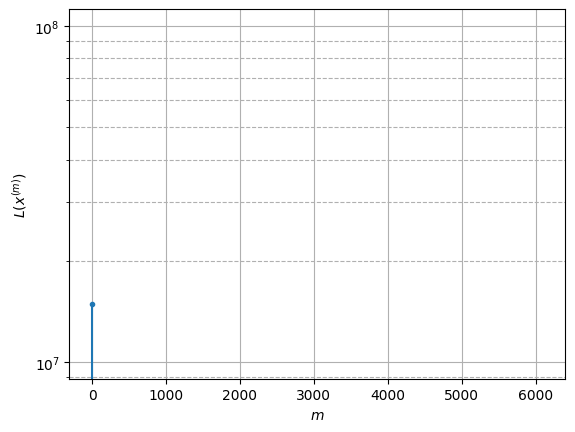

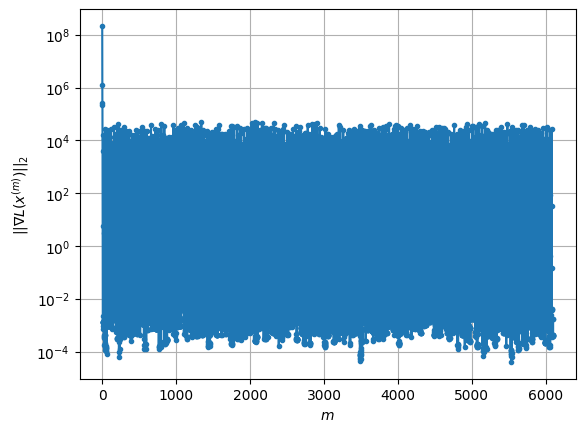

Windows:  81%|████████  | 305/376 [37:04<08:21,  7.06s/it]

Before applying the algorithm
Cost function: -3151334.0665614917
Gradient norm: 27011.25466761624
Global relative error: 42.553679069760676
Position relative errors: 0.08246829995280786 m, 1.4937641442858574 m, 7.091915648797719 m, 41.9318455627479 m

Iteration 1
Cost function: -3151336.5245192097 (-0.00%)
Gradient norm: 115.80659482960492 (-99.57%)
Global relative error: 20.956010484740094 (-50.75%)
Position relative errors: 0.07385802958215015 m, 5.693251473543536 m, 6.144741085653452 m, 19.20874134679327 m

Iteration 2
Cost function: -3151336.5267602773 (-0.00%)
Gradient norm: 0.7026702146601562 (-99.39%)
Global relative error: 20.69576486784963 (-1.24%)
Position relative errors: 0.07385803381320451 m, 5.749295185656175 m, 6.380634767373423 m, 18.829237541153717 m

Iteration 3
Cost function: -3151336.526760293 (-0.00%)
Gradient norm: 0.0006804530947905981 (-99.90%)
Global relative error: 20.69143855681271 (-0.02%)
Position relative errors: 0.07385803222320456 m, 5.748860695957174 m,

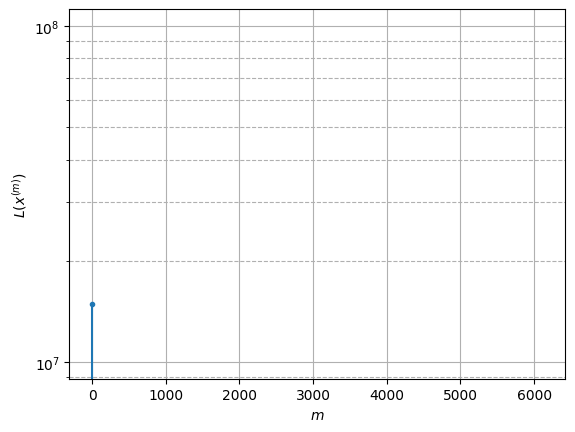

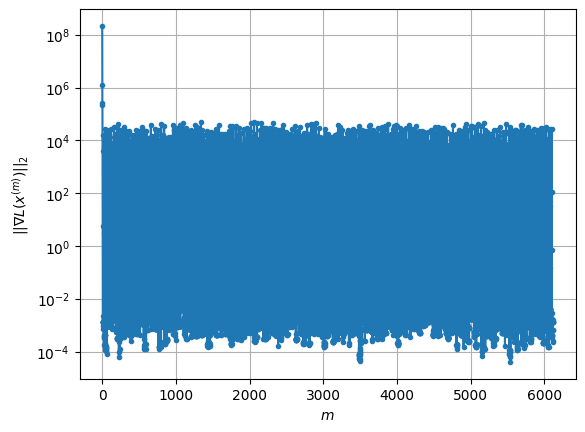

Windows:  81%|████████▏ | 306/376 [37:11<08:17,  7.10s/it]

Before applying the algorithm
Cost function: -3151336.205515042
Gradient norm: 22159.486502595202
Global relative error: 22.818438599042114
Position relative errors: 0.0680272975621273 m, 6.817444616020386 m, 7.813097956816427 m, 20.32615193224422 m

Iteration 1
Cost function: -3151341.720345266 (-0.00%)
Gradient norm: 106.17039068026402 (-99.52%)
Global relative error: 27.860480583084364 (22.10%)
Position relative errors: 0.0801979739177197 m, 6.576826044199577 m, 26.894285740469666 m, 3.104719511223737 m

Iteration 2
Cost function: -3151341.7232993417 (-0.00%)
Gradient norm: 0.41125622524545236 (-99.61%)
Global relative error: 27.60584292456218 (-0.91%)
Position relative errors: 0.08019798720551215 m, 6.675824560161613 m, 26.560291116490045 m, 3.4723479875778573 m

Iteration 3
Cost function: -3151341.7232994055 (-0.00%)
Gradient norm: 0.0010329399894229404 (-99.75%)
Global relative error: 27.604929678447387 (-0.00%)
Position relative errors: 0.08019798629048501 m, 6.676023213813952 m

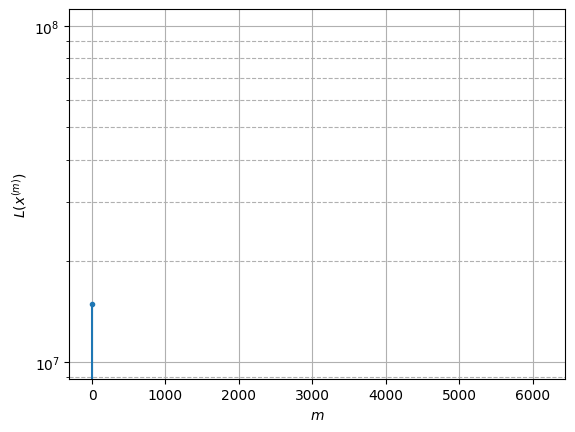

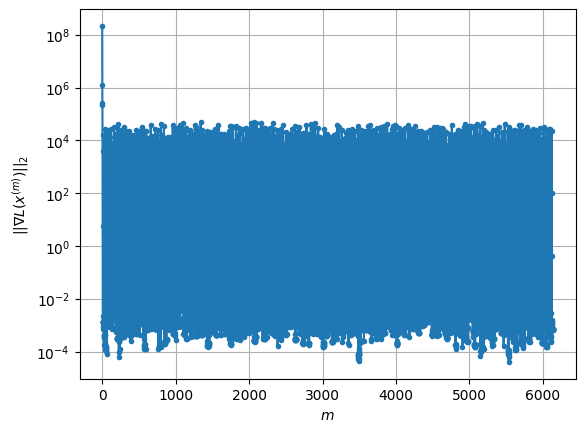

Windows:  82%|████████▏ | 307/376 [37:18<08:13,  7.16s/it]

Before applying the algorithm
Cost function: -3151336.039495249
Gradient norm: 34168.529788747466
Global relative error: 28.59250444594132
Position relative errors: 0.07266496217162974 m, 7.182217504795808 m, 27.23912773723365 m, 4.895770156381148 m

Iteration 1
Cost function: -3151341.4368663956 (-0.00%)
Gradient norm: 854.0959069809427 (-97.50%)
Global relative error: 53.65756184997345 (87.66%)
Position relative errors: 0.09374233027596951 m, 6.764529845348076 m, 34.38058369404795 m, 40.63649954021973 m

Iteration 2
Cost function: -3151341.4698657896 (-0.00%)
Gradient norm: 25.19368584011437 (-97.05%)
Global relative error: 54.877109458513786 (2.27%)
Position relative errors: 0.0937423447108555 m, 6.218782159206446 m, 35.35333047509553 m, 41.5083433217462 m

Iteration 3
Cost function: -3151341.469879206 (-0.00%)
Gradient norm: 0.009479866839469298 (-99.96%)
Global relative error: 54.8682496722592 (-0.02%)
Position relative errors: 0.09374234509757438 m, 6.20913167889247 m, 35.3642599

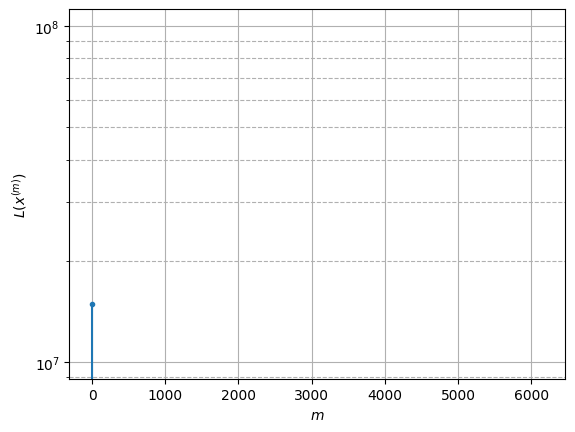

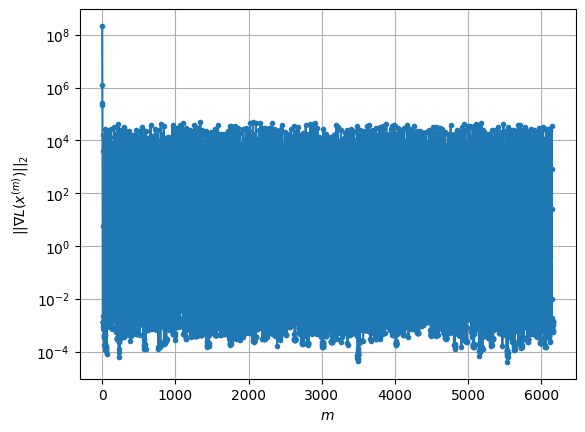

Windows:  82%|████████▏ | 308/376 [37:25<08:01,  7.08s/it]

Before applying the algorithm
Cost function: -3151337.2932212707
Gradient norm: 12933.011307019437
Global relative error: 49.7865309890243
Position relative errors: 0.08683869919578616 m, 5.2057083623966 m, 35.26789957611756 m, 34.752724650970805 m

Iteration 1
Cost function: -3151342.388942917 (-0.00%)
Gradient norm: 46.716291841532 (-99.64%)
Global relative error: 47.36772170874385 (-4.86%)
Position relative errors: 0.07819223356909784 m, 5.86440829679246 m, 29.449746635847813 m, 36.633341492592805 m

Iteration 2
Cost function: -3151342.3897797037 (-0.00%)
Gradient norm: 0.20039324204168618 (-99.57%)
Global relative error: 47.87429142033439 (1.07%)
Position relative errors: 0.07819223185058949 m, 5.895280272276678 m, 29.374483029785672 m, 37.340497100213646 m

Iteration 3
Cost function: -3151342.389779703 (0.00%)
Gradient norm: 0.0018518134574317222 (-99.08%)
Global relative error: 47.87498053164663 (0.00%)
Position relative errors: 0.07819223205791052 m, 5.895169553333386 m, 29.3744

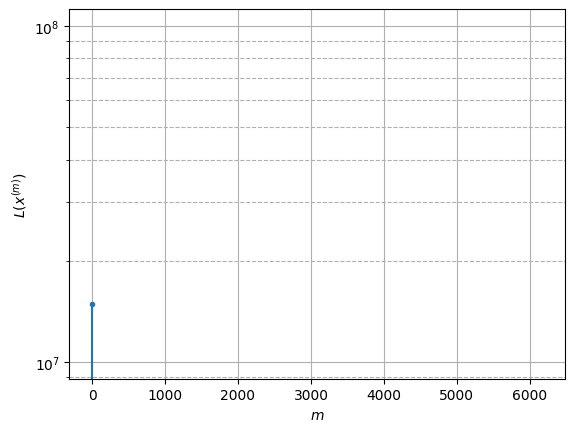

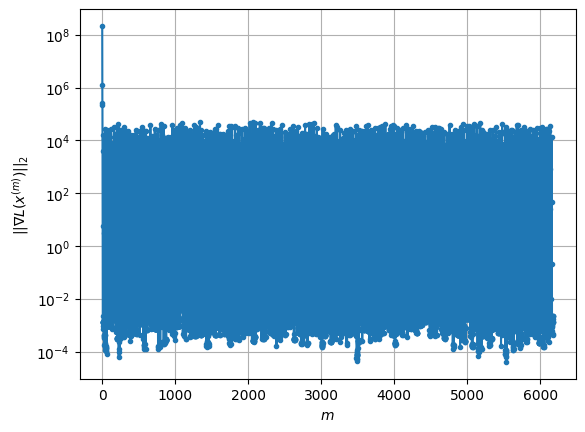

Windows:  82%|████████▏ | 309/376 [37:33<08:06,  7.26s/it]

Before applying the algorithm
Cost function: -3151340.146999187
Gradient norm: 14742.817108760766
Global relative error: 42.81001857592895
Position relative errors: 0.07344611893060318 m, 7.700302850664993 m, 29.171004616682396 m, 30.3716190752938 m

Iteration 1
Cost function: -3151343.943520219 (-0.00%)
Gradient norm: 120.17480823902008 (-99.18%)
Global relative error: 60.1881221945619 (40.59%)
Position relative errors: 0.0831023295578742 m, 12.123421413745893 m, 38.91822915385549 m, 44.28293738413791 m

Iteration 2
Cost function: -3151343.9498847574 (-0.00%)
Gradient norm: 0.6549746313991974 (-99.45%)
Global relative error: 62.93131809435023 (4.56%)
Position relative errors: 0.08310233281789073 m, 12.579963183226806 m, 40.53937682188526 m, 46.46103815034934 m

Iteration 3
Cost function: -3151343.9498849185 (-0.00%)
Gradient norm: 0.001245187083342528 (-99.81%)
Global relative error: 62.93867763166009 (0.01%)
Position relative errors: 0.08310233312545603 m, 12.581284137370265 m, 40.54

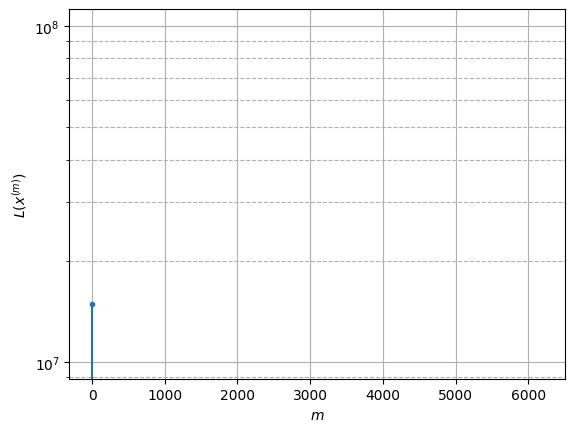

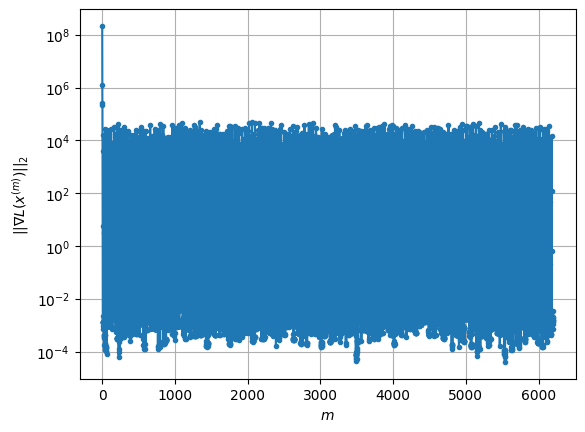

Windows:  82%|████████▏ | 310/376 [37:41<08:05,  7.35s/it]

Before applying the algorithm
Cost function: -3151341.865065195
Gradient norm: 30258.469112125982
Global relative error: 56.12489777255666
Position relative errors: 0.0750607822425504 m, 13.25598136765574 m, 38.88859287661049 m, 38.23525312460832 m

Iteration 1
Cost function: -3151345.999608512 (-0.00%)
Gradient norm: 27.777336352563356 (-99.91%)
Global relative error: 43.93769763006142 (-21.71%)
Position relative errors: 0.06951619972455583 m, 10.2589572163777 m, 27.487626944658714 m, 32.70598937071626 m

Iteration 2
Cost function: -3151345.9999506925 (-0.00%)
Gradient norm: 0.08483652819922781 (-99.69%)
Global relative error: 43.99137063722055 (0.12%)
Position relative errors: 0.06951620204591755 m, 10.492494737499259 m, 27.753476292457037 m, 32.47875081462821 m

Iteration 3
Cost function: -3151345.9999506758 (0.00%)
Gradient norm: 0.0014316231470766234 (-98.31%)
Global relative error: 43.99145799308627 (0.00%)
Position relative errors: 0.0695162018299198 m, 10.492700508267035 m, 27.

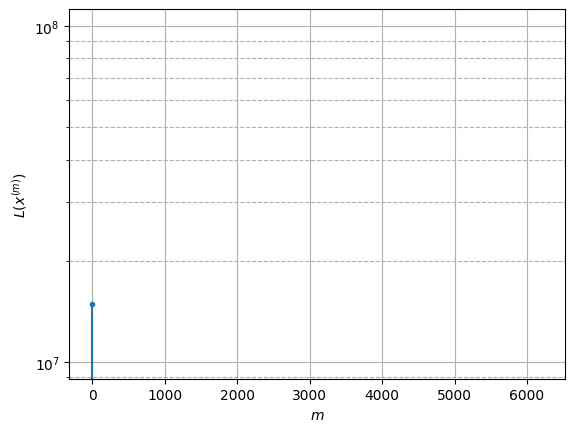

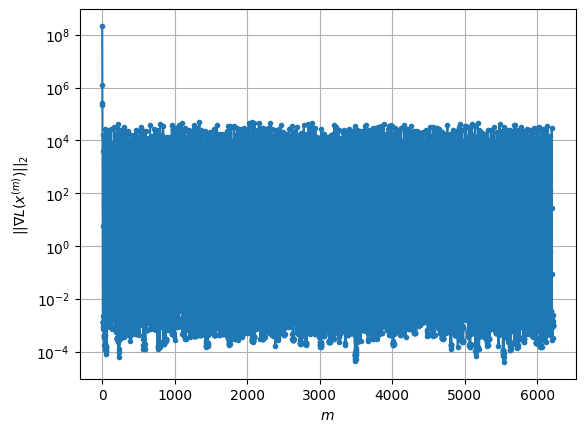

Windows:  83%|████████▎ | 311/376 [37:48<07:52,  7.28s/it]

Before applying the algorithm
Cost function: -3151332.9649365526
Gradient norm: 48081.518638035835
Global relative error: 37.80341231078686
Position relative errors: 0.06405761434731633 m, 11.22636242558268 m, 26.505212699579268 m, 24.505450324244414 m

Iteration 1
Cost function: -3151340.2464350224 (-0.00%)
Gradient norm: 485.91248831591037 (-98.99%)
Global relative error: 42.78312983617198 (13.17%)
Position relative errors: 0.09925432940108855 m, 20.18604224873033 m, 33.81153287798516 m, 16.723750280294535 m

Iteration 2
Cost function: -3151340.3108592494 (-0.00%)
Gradient norm: 74.34037568609567 (-84.70%)
Global relative error: 47.55157483608367 (11.15%)
Position relative errors: 0.09925434321024507 m, 23.111875873456533 m, 34.91755383704975 m, 22.533174116746476 m

Iteration 3
Cost function: -3151340.3109262926 (-0.00%)
Gradient norm: 0.01200285385278668 (-99.98%)
Global relative error: 47.629223289465344 (0.16%)
Position relative errors: 0.0992543433230533 m, 23.15658599787428 m, 

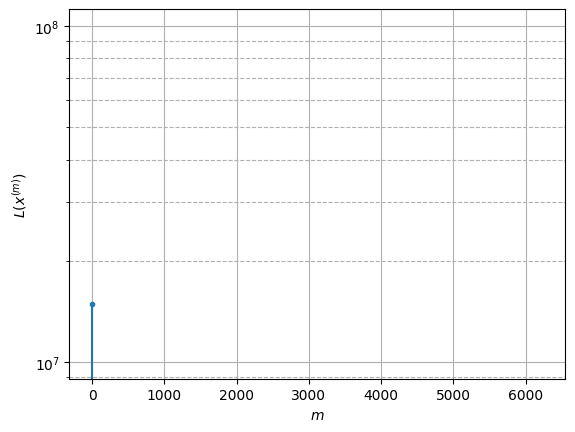

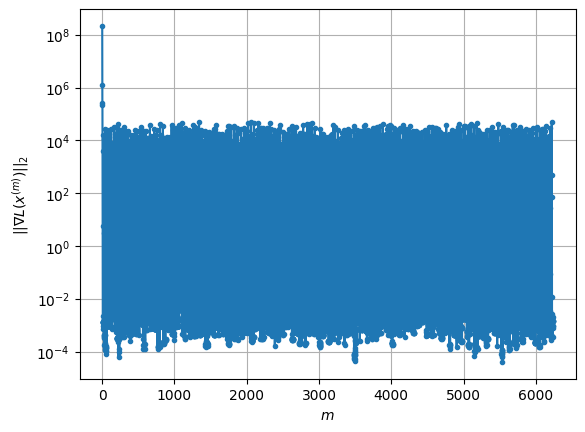

Windows:  83%|████████▎ | 312/376 [37:55<07:39,  7.18s/it]

Before applying the algorithm
Cost function: -3151337.391686156
Gradient norm: 33369.35281882014
Global relative error: 47.12946806298206
Position relative errors: 0.09098295748052165 m, 22.808847913555134 m, 32.57837530809591 m, 25.289924949846796 m

Iteration 1
Cost function: -3151342.6688752314 (-0.00%)
Gradient norm: 404.9580500092419 (-98.79%)
Global relative error: 22.810196726671748 (-51.60%)
Position relative errors: 0.12548064586536012 m, 12.363590590258893 m, 18.574988349080417 m, 4.7320825817434065 m

Iteration 2
Cost function: -3151342.6781767407 (-0.00%)
Gradient norm: 1.70789312195318 (-99.58%)
Global relative error: 23.895518014338844 (4.76%)
Position relative errors: 0.12548064439292841 m, 13.52615041875104 m, 19.249782497207914 m, 4.17872485185274 m

Iteration 3
Cost function: -3151342.6781772696 (-0.00%)
Gradient norm: 0.00214590747070293 (-99.87%)
Global relative error: 23.90690929936415 (0.05%)
Position relative errors: 0.12548064400822226 m, 13.536931556275915 m, 1

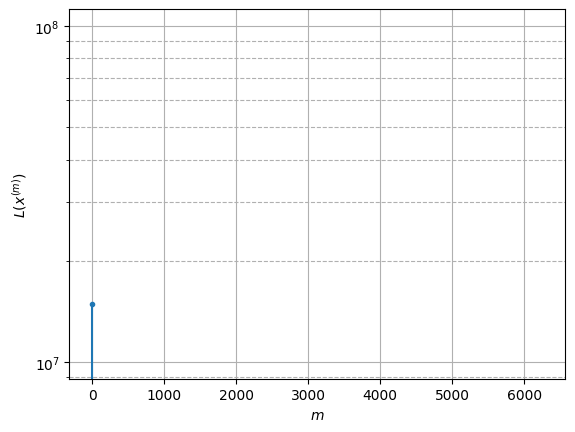

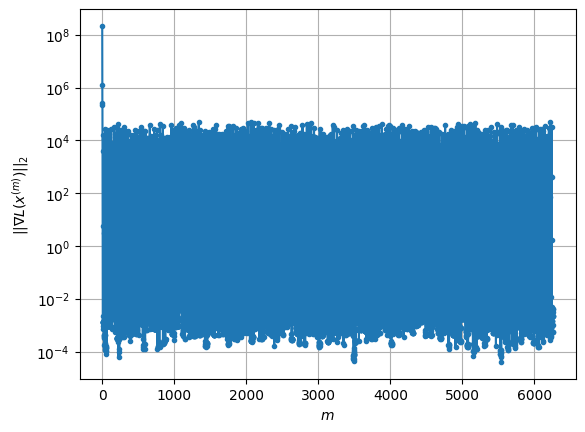

Windows:  83%|████████▎ | 313/376 [38:02<07:30,  7.16s/it]

Before applying the algorithm
Cost function: -3151341.3203737047
Gradient norm: 16483.60477839888
Global relative error: 24.87157725628141
Position relative errors: 0.11608546120474751 m, 15.221257189749362 m, 18.43043608153452 m, 6.870727406270937 m

Iteration 1
Cost function: -3151347.570788522 (-0.00%)
Gradient norm: 140.29057819323282 (-99.15%)
Global relative error: 41.06660900475473 (65.11%)
Position relative errors: 0.10464611491494262 m, 7.600479557005443 m, 36.82016611710111 m, 16.5212616921585 m

Iteration 2
Cost function: -3151347.5774473883 (-0.00%)
Gradient norm: 3.366879665345783 (-97.60%)
Global relative error: 40.09413416094914 (-2.37%)
Position relative errors: 0.10464609809438778 m, 6.704274477434034 m, 36.25048347828579 m, 15.76296592445134 m

Iteration 3
Cost function: -3151347.5774479564 (-0.00%)
Gradient norm: 0.00140572364841342 (-99.96%)
Global relative error: 40.09142572649798 (-0.01%)
Position relative errors: 0.10464609854757055 m, 6.700851151196658 m, 36.248

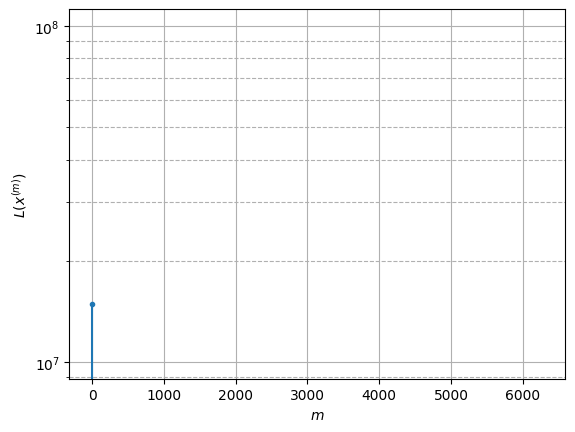

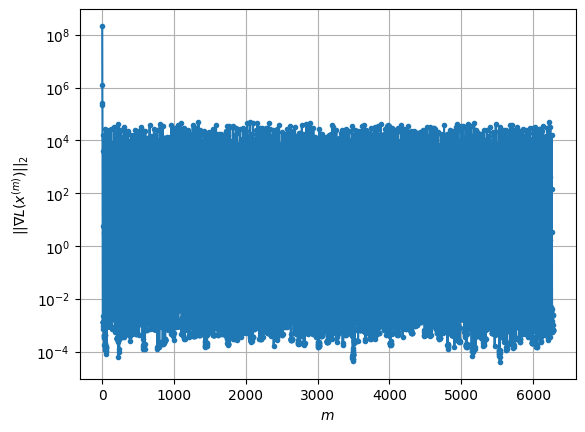

Windows:  84%|████████▎ | 314/376 [38:09<07:23,  7.16s/it]

Before applying the algorithm
Cost function: -3151344.5888899374
Gradient norm: 16313.006969971042
Global relative error: 39.01019128376722
Position relative errors: 0.09622550176377952 m, 8.292555324726045 m, 34.44912384703941 m, 16.31761309549972 m

Iteration 1
Cost function: -3151349.0429378278 (-0.00%)
Gradient norm: 203.24765401482375 (-98.75%)
Global relative error: 55.937726291091394 (43.39%)
Position relative errors: 0.09474112218850439 m, 14.247302198776376 m, 26.1280444010517 m, 47.36406418955263 m

Iteration 2
Cost function: -3151349.0614096243 (-0.00%)
Gradient norm: 11.46326826471903 (-94.36%)
Global relative error: 50.666042768774 (-9.42%)
Position relative errors: 0.09474111342902407 m, 13.85644660424751 m, 27.045845782346948 m, 40.54076033362206 m

Iteration 3
Cost function: -3151349.0614154935 (-0.00%)
Gradient norm: 0.005165794961807393 (-99.95%)
Global relative error: 50.59585739771299 (-0.14%)
Position relative errors: 0.09474111324350032 m, 13.851899633575878 m, 27

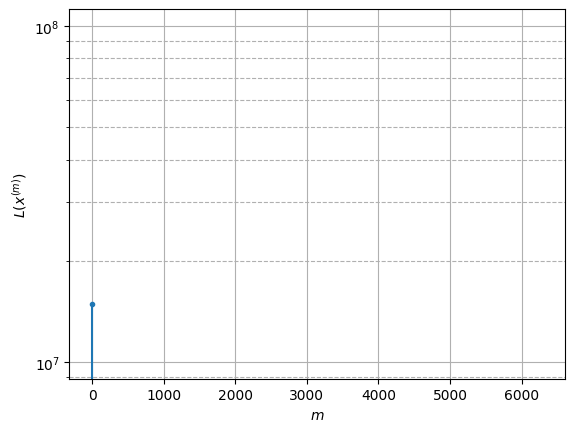

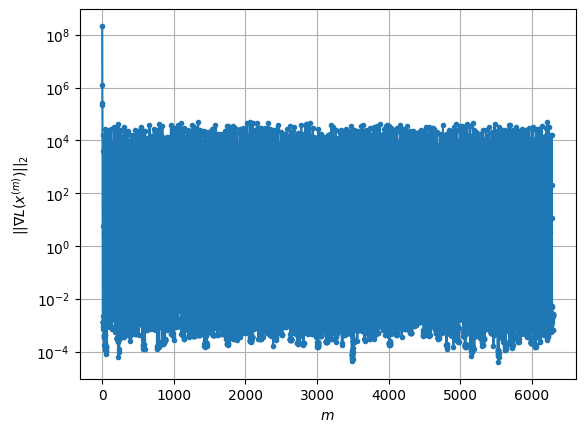

Windows:  84%|████████▍ | 315/376 [38:16<07:14,  7.12s/it]

Before applying the algorithm
Cost function: -3151349.8825302273
Gradient norm: 20248.039341607324
Global relative error: 53.021324720830236
Position relative errors: 0.08573003750921705 m, 15.07726278041649 m, 25.43234523926043 m, 44.01271562427109 m

Iteration 1
Cost function: -3151351.9041246236 (-0.00%)
Gradient norm: 118.54639867889145 (-99.41%)
Global relative error: 57.9061686227542 (9.21%)
Position relative errors: 0.07167530729833203 m, 12.289372921427773 m, 24.610418077233227 m, 50.95502375439435 m

Iteration 2
Cost function: -3151351.904584254 (-0.00%)
Gradient norm: 0.11497158406801072 (-99.90%)
Global relative error: 57.22193553622085 (-1.18%)
Position relative errors: 0.07167530781652617 m, 12.236065741051679 m, 24.64395486136626 m, 50.17265701181407 m

Iteration 3
Cost function: -3151351.904584254 (0.00%)
Gradient norm: 0.001418810314098516 (-98.77%)
Global relative error: 57.22140206865407 (-0.00%)
Position relative errors: 0.07167530783795463 m, 12.236076140638056 m, 2

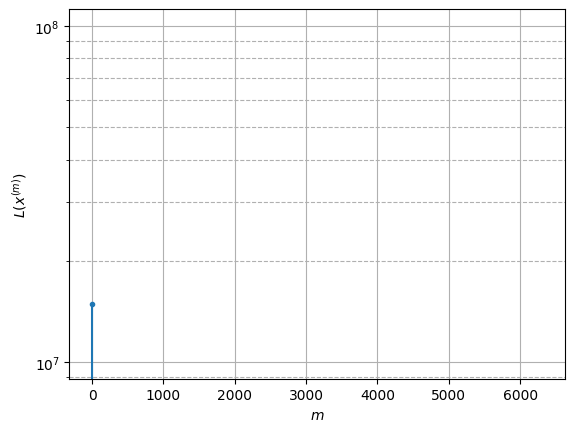

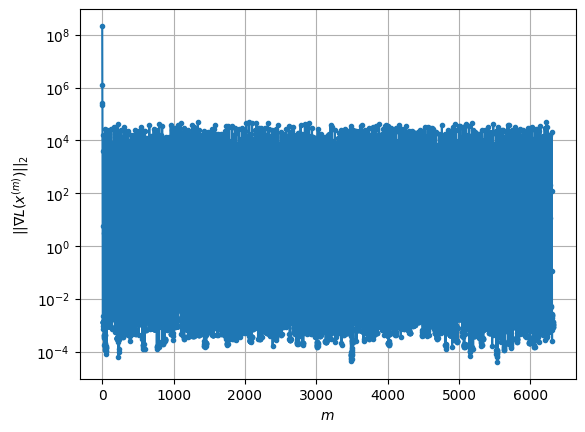

Windows:  84%|████████▍ | 316/376 [38:23<07:04,  7.08s/it]

Before applying the algorithm
Cost function: -3151345.925644698
Gradient norm: 17492.405001443785
Global relative error: 58.13931331391195
Position relative errors: 0.06562005026388848 m, 12.719018302384777 m, 22.996483613751288 m, 51.86097370065497 m

Iteration 1
Cost function: -3151352.1793661127 (-0.00%)
Gradient norm: 292.96671004251453 (-98.33%)
Global relative error: 75.30162063749283 (29.52%)
Position relative errors: 0.04017061979294864 m, 15.16278842229154 m, 30.32263119829111 m, 67.23806784220699 m

Iteration 2
Cost function: -3151352.20323845 (-0.00%)
Gradient norm: 33.68971221046493 (-88.50%)
Global relative error: 70.56042363009666 (-6.30%)
Position relative errors: 0.04017061897021293 m, 13.87227575650667 m, 30.76495677619149 m, 61.966493977804895 m

Iteration 3
Cost function: -3151352.2032535262 (-0.00%)
Gradient norm: 0.004060899289984563 (-99.99%)
Global relative error: 70.51184112610495 (-0.07%)
Position relative errors: 0.04017061813468606 m, 13.86172016269912 m, 30.

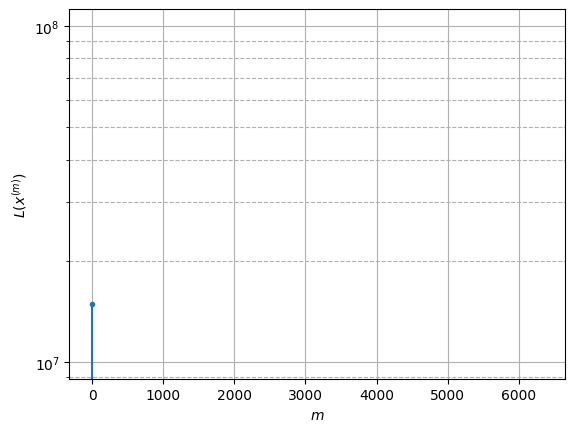

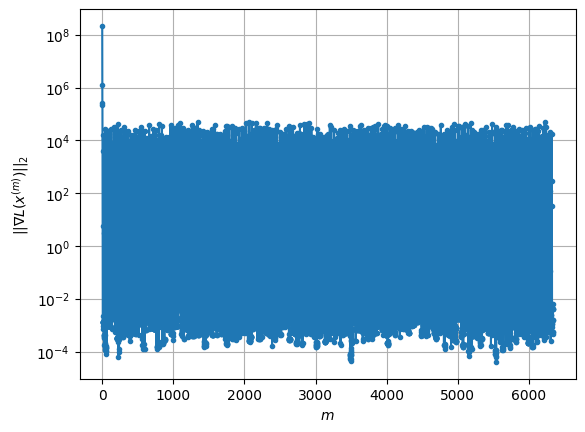

Windows:  84%|████████▍ | 317/376 [38:31<07:09,  7.28s/it]

Before applying the algorithm
Cost function: -3151345.7186513506
Gradient norm: 18780.656038589834
Global relative error: 70.25998902660598
Position relative errors: 0.03691842712714973 m, 15.888033787817294 m, 28.48928297908124 m, 62.22855477733019 m

Iteration 1
Cost function: -3151349.564669745 (-0.00%)
Gradient norm: 59.15001141244524 (-99.69%)
Global relative error: 71.69435134908572 (2.04%)
Position relative errors: 0.05461382625484207 m, 25.088755440718877 m, 27.91368514533808 m, 61.085643919829245 m

Iteration 2
Cost function: -3151349.566331505 (-0.00%)
Gradient norm: 0.5298081816003626 (-99.10%)
Global relative error: 71.97687481940892 (0.39%)
Position relative errors: 0.054613826966157165 m, 25.42482239287603 m, 28.46765850865787 m, 61.023246852030354 m

Iteration 3
Cost function: -3151349.56633149 (0.00%)
Gradient norm: 0.0023898293644333104 (-99.55%)
Global relative error: 71.97684118842082 (-0.00%)
Position relative errors: 0.0546138272314189 m, 25.425279377447875 m, 28.4

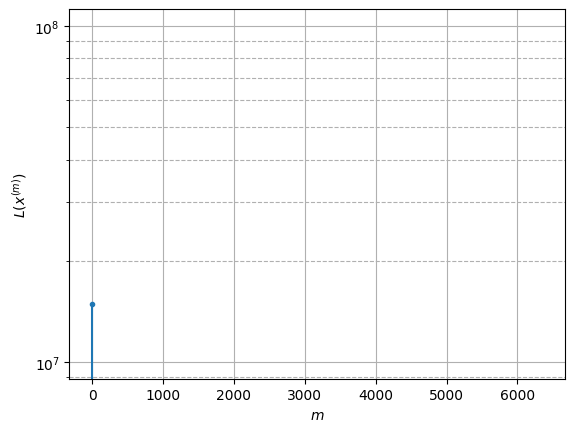

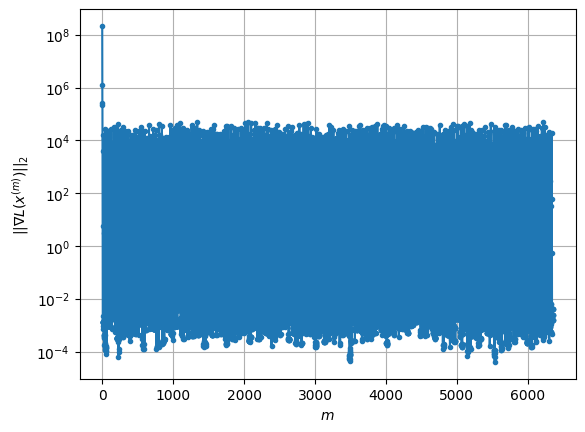

Windows:  85%|████████▍ | 318/376 [38:39<07:13,  7.47s/it]

Before applying the algorithm
Cost function: -3151352.337568215
Gradient norm: 11986.485609169165
Global relative error: 71.880663524656
Position relative errors: 0.05343248580671595 m, 26.387555821664815 m, 26.341998220921177 m, 61.454220933999004 m

Iteration 1
Cost function: -3151358.308785668 (-0.00%)
Gradient norm: 372.62870461449876 (-96.89%)
Global relative error: 96.94777039402925 (34.87%)
Position relative errors: 0.054445294818059244 m, 50.169614602176026 m, 38.26594614273231 m, 73.60427552181304 m

Iteration 2
Cost function: -3151358.321164697 (-0.00%)
Gradient norm: 9.188727683171576 (-97.53%)
Global relative error: 94.18264262316205 (-2.85%)
Position relative errors: 0.05444529376050554 m, 50.16717369749686 m, 38.64746592044382 m, 69.71363440633567 m

Iteration 3
Cost function: -3151358.3211661233 (-0.00%)
Gradient norm: 0.0014416043095622927 (-99.98%)
Global relative error: 94.16347738088469 (-0.02%)
Position relative errors: 0.054445293871655455 m, 50.16623686080051 m, 3

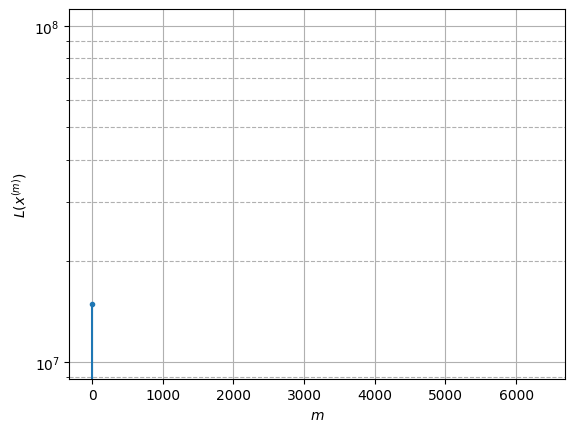

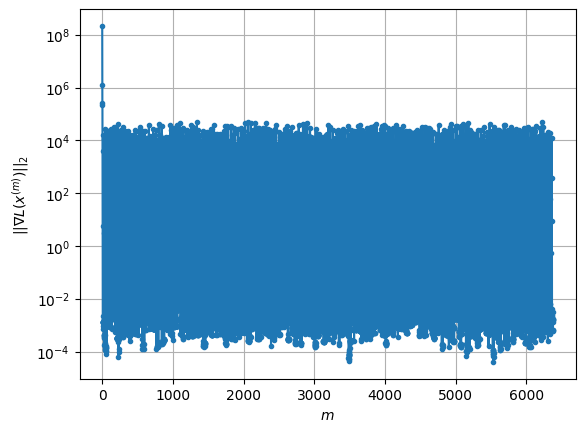

Windows:  85%|████████▍ | 319/376 [38:46<07:14,  7.62s/it]

Before applying the algorithm
Cost function: -3151351.1639098763
Gradient norm: 13572.008104262433
Global relative error: 90.41376955042028
Position relative errors: 0.055779911196233545 m, 48.15439910693883 m, 35.65664128870058 m, 67.70819151755052 m

Iteration 1
Cost function: -3151353.5383708705 (-0.00%)
Gradient norm: 272.13880761808866 (-97.99%)
Global relative error: 53.970508199368 (-40.31%)
Position relative errors: 0.059397324486805736 m, 32.679710298744446 m, 19.699798471910032 m, 38.16758991663031 m

Iteration 2
Cost function: -3151353.5502189957 (-0.00%)
Gradient norm: 5.551651984809323 (-97.96%)
Global relative error: 58.08549461119075 (7.62%)
Position relative errors: 0.05939732300597797 m, 34.026420054405854 m, 20.87334107784952 m, 42.195091603900494 m

Iteration 3
Cost function: -3151353.550220437 (-0.00%)
Gradient norm: 0.001982933992253774 (-99.96%)
Global relative error: 58.13086079788693 (0.08%)
Position relative errors: 0.05939732342353447 m, 34.037770653175336 m, 

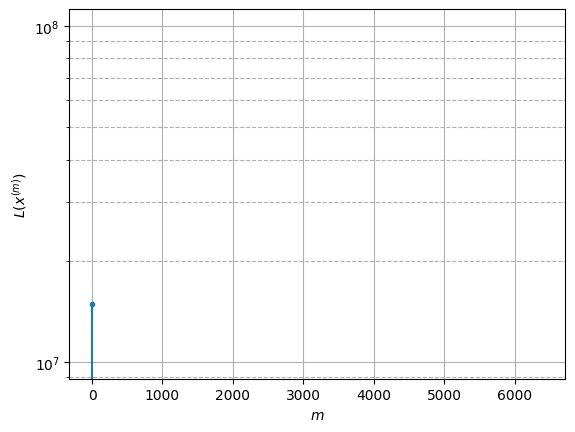

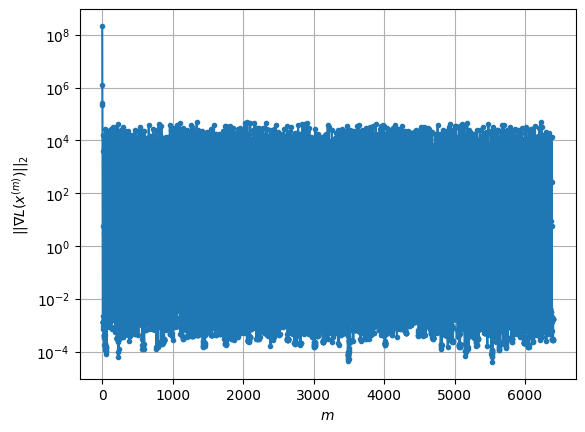

Windows:  85%|████████▌ | 320/376 [38:54<07:11,  7.71s/it]

Before applying the algorithm
Cost function: -3151355.8892886443
Gradient norm: 20090.64432549169
Global relative error: 57.151550650571316
Position relative errors: 0.06015673883537951 m, 33.12264518727523 m, 18.695677701798804 m, 42.65742961507091 m

Iteration 1
Cost function: -3151360.3993082065 (-0.00%)
Gradient norm: 95.24095980989344 (-99.53%)
Global relative error: 46.422935366412744 (-18.77%)
Position relative errors: 0.09803123398770831 m, 27.196907945640586 m, 12.843174319070918 m, 35.361841421806865 m

Iteration 2
Cost function: -3151360.4006653717 (-0.00%)
Gradient norm: 0.4038107019375725 (-99.58%)
Global relative error: 45.369342885877096 (-2.27%)
Position relative errors: 0.09803123568374053 m, 26.973147843877225 m, 12.93921430941248 m, 34.10854866664113 m

Iteration 3
Cost function: -3151360.4006653707 (0.00%)
Gradient norm: 0.009482934020335352 (-97.65%)
Global relative error: 45.36826571295964 (-0.00%)
Position relative errors: 0.09803123568374053 m, 26.97316050857474

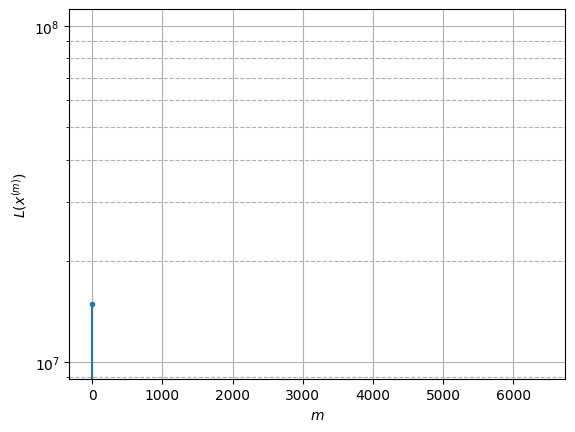

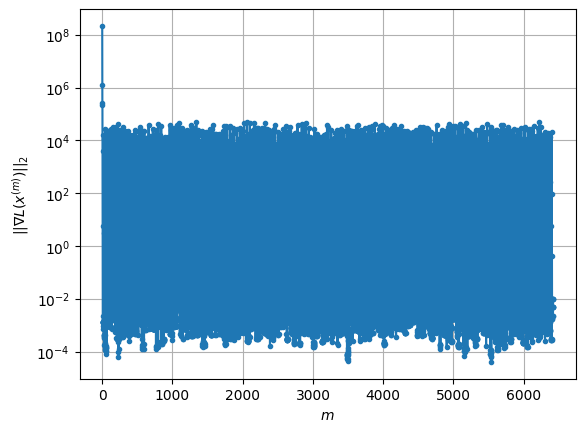

Windows:  85%|████████▌ | 321/376 [39:02<07:04,  7.72s/it]

Before applying the algorithm
Cost function: -3151365.5251567527
Gradient norm: 10109.535676562118
Global relative error: 45.0113721244179
Position relative errors: 0.09545430908435332 m, 26.614348248101148 m, 11.66039446627136 m, 34.37623554161418 m

Iteration 1
Cost function: -3151368.4377462235 (-0.00%)
Gradient norm: 29.25055377574583 (-99.71%)
Global relative error: 48.50794994006639 (7.77%)
Position relative errors: 0.06980100267984427 m, 27.699316174580222 m, 7.903583909336341 m, 39.02943686410964 m

Iteration 2
Cost function: -3151368.438053695 (-0.00%)
Gradient norm: 0.0494474456609605 (-99.83%)
Global relative error: 48.684963272045295 (0.36%)
Position relative errors: 0.0698010046484612 m, 27.55384398625172 m, 7.649075540544386 m, 39.401744694596005 m

Iteration 3
Cost function: -3151368.4380536987 (-0.00%)
Gradient norm: 0.0006493693703903193 (-98.69%)
Global relative error: 48.68483592285967 (-0.00%)
Position relative errors: 0.0698010046484612 m, 27.553885708721836 m, 7.6

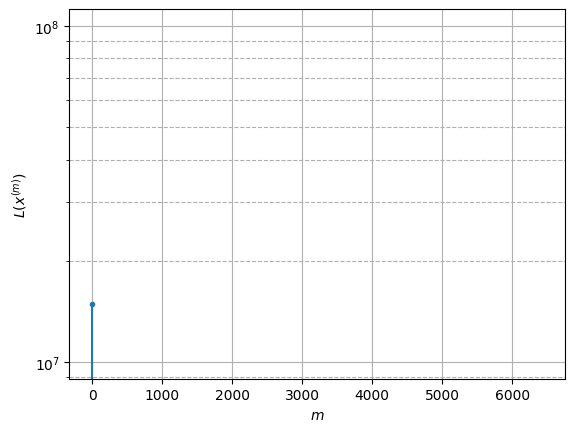

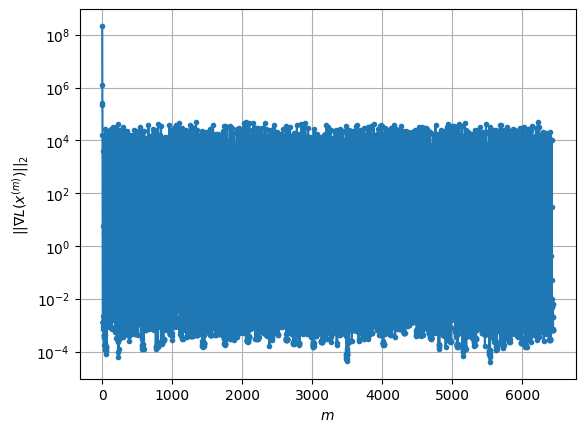

Windows:  86%|████████▌ | 322/376 [39:10<06:59,  7.78s/it]

Before applying the algorithm
Cost function: -3151365.598224186
Gradient norm: 23289.103576721544
Global relative error: 47.52785911775351
Position relative errors: 0.0690016665997852 m, 26.469125661573347 m, 6.90875016840751 m, 38.86574954957765 m

Iteration 1
Cost function: -3151370.3067025384 (-0.00%)
Gradient norm: 42.71913134206314 (-99.82%)
Global relative error: 48.62610921188579 (2.31%)
Position relative errors: 0.08337631929300052 m, 17.25428957036072 m, 2.4440124534919327 m, 45.39611610491831 m

Iteration 2
Cost function: -3151370.309966424 (-0.00%)
Gradient norm: 4.173531020412319 (-90.23%)
Global relative error: 51.31292774497986 (5.53%)
Position relative errors: 0.08337631257175204 m, 17.899115562750538 m, 2.2862685393388755 m, 48.035440092971534 m

Iteration 3
Cost function: -3151370.309966659 (-0.00%)
Gradient norm: 0.001305516661537223 (-99.97%)
Global relative error: 51.3188480542073 (0.01%)
Position relative errors: 0.08337631267596705 m, 17.900088621237618 m, 2.28659

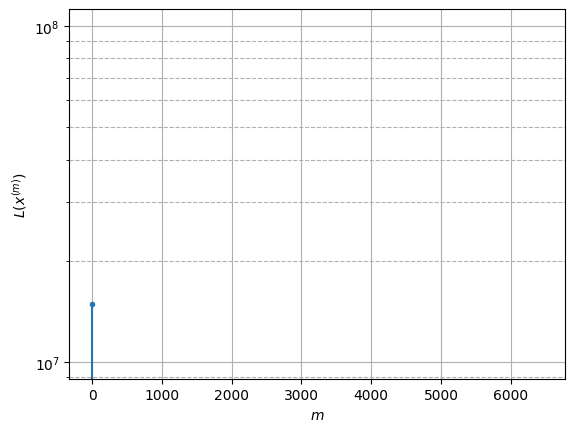

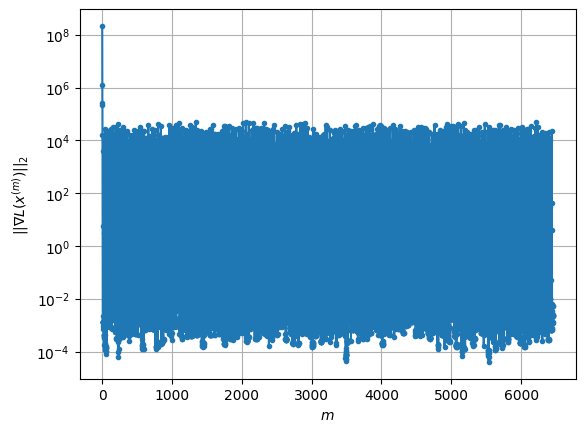

Windows:  86%|████████▌ | 323/376 [39:18<06:52,  7.78s/it]

Before applying the algorithm
Cost function: -3151368.953162852
Gradient norm: 22282.875254875602
Global relative error: 49.79615190767672
Position relative errors: 0.08008441858232195 m, 17.624832913141166 m, 2.380651980798703 m, 46.511796660770884 m

Iteration 1
Cost function: -3151370.1748147695 (-0.00%)
Gradient norm: 143.78977300254385 (-99.35%)
Global relative error: 46.00169638473612 (-7.62%)
Position relative errors: 0.10010833549875799 m, 26.822363040246287 m, 3.0154890618283883 m, 37.25068314413153 m

Iteration 2
Cost function: -3151370.1760916216 (-0.00%)
Gradient norm: 0.9452655142150648 (-99.34%)
Global relative error: 47.02599087209309 (2.23%)
Position relative errors: 0.10010833599673831 m, 27.397146658753222 m, 2.8190561472431694 m, 38.11669898598737 m

Iteration 3
Cost function: -3151370.176091646 (-0.00%)
Gradient norm: 0.0013318886053757745 (-99.86%)
Global relative error: 47.030095430175386 (0.01%)
Position relative errors: 0.10010833606013846 m, 27.398069911897743 

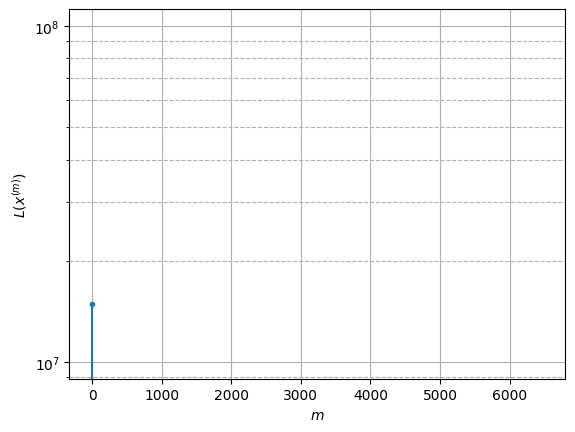

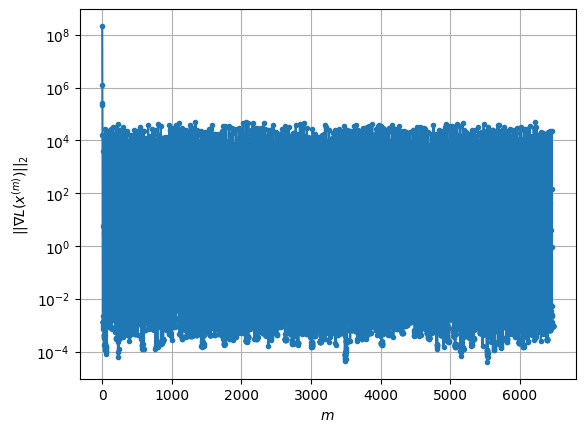

Windows:  86%|████████▌ | 324/376 [39:26<06:46,  7.83s/it]

Before applying the algorithm
Cost function: -3151368.8607180244
Gradient norm: 31907.501275763352
Global relative error: 46.4689208927134
Position relative errors: 0.0955282011996783 m, 26.672927414671523 m, 2.635539505996672 m, 37.95997918272827 m

Iteration 1
Cost function: -3151370.355202008 (-0.00%)
Gradient norm: 195.01195147172504 (-99.39%)
Global relative error: 62.13494249019215 (33.71%)
Position relative errors: 0.07913109459141662 m, 31.666494542684692 m, 2.074352282479263 m, 53.41979391789689 m

Iteration 2
Cost function: -3151370.355906824 (-0.00%)
Gradient norm: 0.03026517332310934 (-99.98%)
Global relative error: 62.596295510590366 (0.74%)
Position relative errors: 0.07913109493627889 m, 31.56480420756086 m, 2.2198484761841852 m, 54.009487553202504 m

Iteration 3
Cost function: -3151370.3559068264 (-0.00%)
Gradient norm: 0.0024020127108567947 (-92.06%)
Global relative error: 62.59847775702692 (0.00%)
Position relative errors: 0.07913109435172 m, 31.564830752171947 m, 2.2

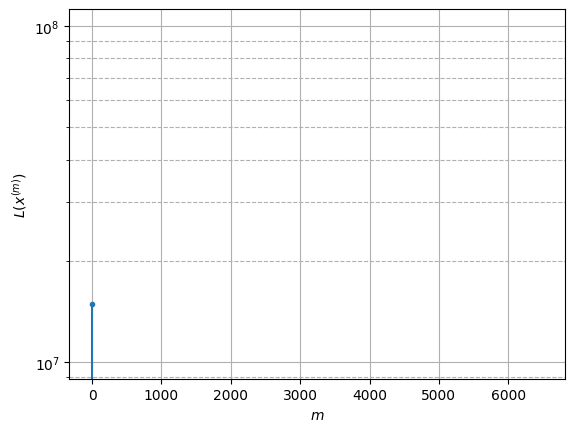

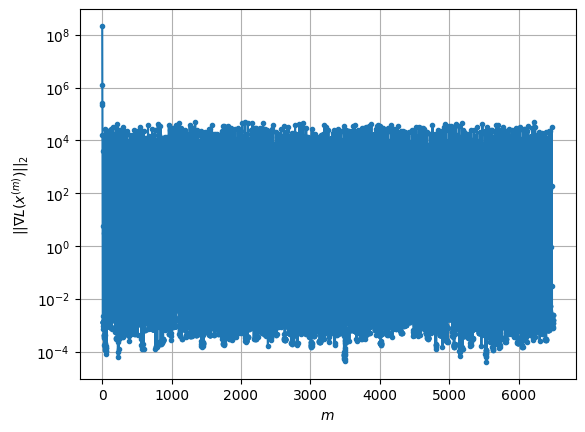

Windows:  86%|████████▋ | 325/376 [39:34<06:40,  7.84s/it]

Before applying the algorithm
Cost function: -3151366.813418478
Gradient norm: 19097.282143716395
Global relative error: 62.387563366940114
Position relative errors: 0.07609108857925163 m, 30.314335047169326 m, 2.5768376088041447 m, 54.46652772901914 m

Iteration 1
Cost function: -3151369.537302766 (-0.00%)
Gradient norm: 69.78927768020701 (-99.63%)
Global relative error: 79.77769029914323 (27.87%)
Position relative errors: 0.07571019056951686 m, 45.44217829149752 m, 5.1277698774042655 m, 65.36961097568405 m

Iteration 2
Cost function: -3151369.538929715 (-0.00%)
Gradient norm: 1.056523014338752 (-98.49%)
Global relative error: 78.2145756612424 (-1.96%)
Position relative errors: 0.07571019357660415 m, 45.556691264627304 m, 5.17046895332166 m, 63.36691413017527 m

Iteration 3
Cost function: -3151369.5389297316 (-0.00%)
Gradient norm: 0.002136708129529546 (-99.80%)
Global relative error: 78.21294826890758 (-0.00%)
Position relative errors: 0.07571019282483232 m, 45.55699979192258 m, 5.17

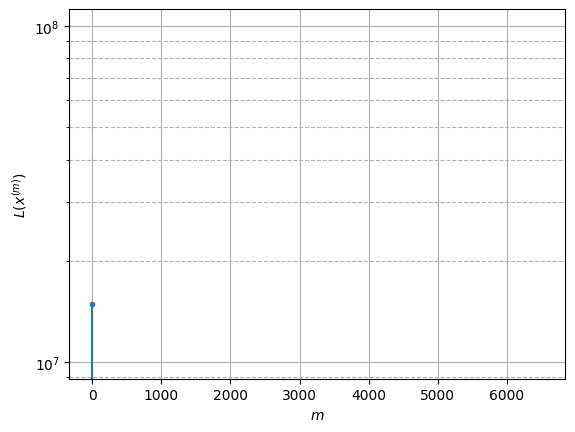

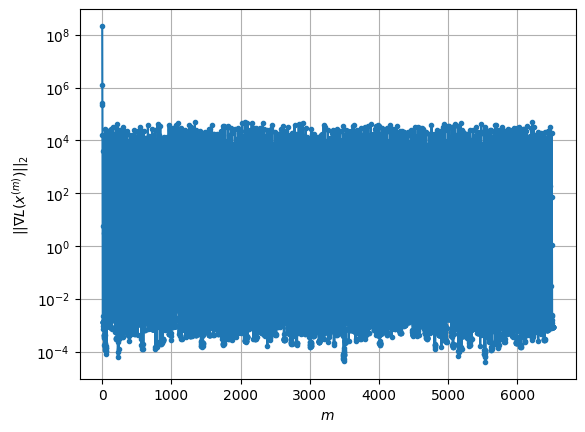

Windows:  87%|████████▋ | 326/376 [39:41<06:31,  7.83s/it]

Before applying the algorithm
Cost function: -3151369.6427543666
Gradient norm: 14976.857316399755
Global relative error: 76.20875766397194
Position relative errors: 0.06976679034524084 m, 42.529986979608275 m, 4.877759233603923 m, 63.04898681983124 m

Iteration 1
Cost function: -3151372.725268068 (-0.00%)
Gradient norm: 149.88407730375158 (-99.00%)
Global relative error: 79.19957696218611 (3.92%)
Position relative errors: 0.10739393729420825 m, 22.585922067521377 m, 20.58364194554507 m, 73.06673518614407 m

Iteration 2
Cost function: -3151372.72827098 (-0.00%)
Gradient norm: 0.5364810707650015 (-99.64%)
Global relative error: 78.62037353985579 (-0.73%)
Position relative errors: 0.10739394280964354 m, 23.3019111253244 m, 20.06265174866125 m, 72.35785462821173 m

Iteration 3
Cost function: -3151372.728271031 (-0.00%)
Gradient norm: 0.0010425272080931845 (-99.81%)
Global relative error: 78.61476648534408 (-0.01%)
Position relative errors: 0.10739394238253923 m, 23.30387295649065 m, 20.06

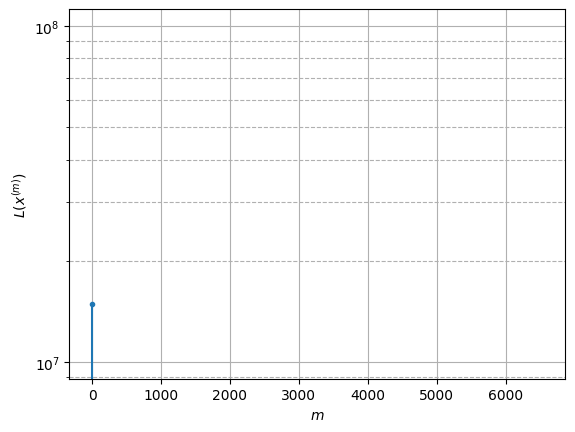

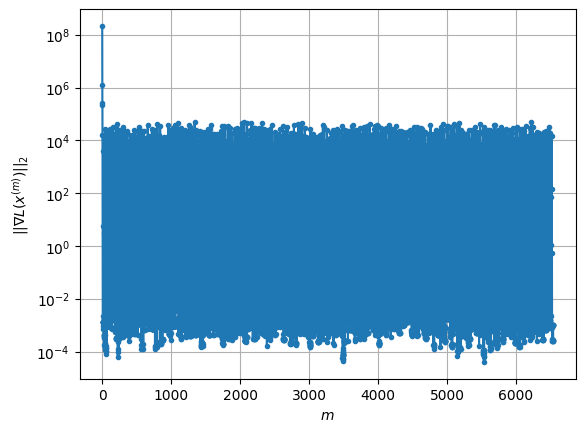

Windows:  87%|████████▋ | 327/376 [39:49<06:23,  7.83s/it]

Before applying the algorithm
Cost function: -3151368.5797033636
Gradient norm: 31277.553102479633
Global relative error: 75.79856495293087
Position relative errors: 0.10105435848034879 m, 21.04651928673747 m, 17.923943369979636 m, 70.577508121828 m

Iteration 1
Cost function: -3151373.846742033 (-0.00%)
Gradient norm: 932.6662938611353 (-97.02%)
Global relative error: 26.20040620300237 (-65.43%)
Position relative errors: 0.10080248624618607 m, 6.801245983232995 m, 12.2125298176996 m, 22.159458924754443 m

Iteration 2
Cost function: -3151373.8948977278 (-0.00%)
Gradient norm: 33.55751657069732 (-96.40%)
Global relative error: 29.89206658965098 (14.09%)
Position relative errors: 0.10080249945974222 m, 7.273247755130037 m, 13.82717143656705 m, 25.483915620385826 m

Iteration 3
Cost function: -3151373.8949343073 (-0.00%)
Gradient norm: 0.03159645181109831 (-99.91%)
Global relative error: 29.978304686343265 (0.29%)
Position relative errors: 0.10080249926506187 m, 7.2555543292820985 m, 13.8

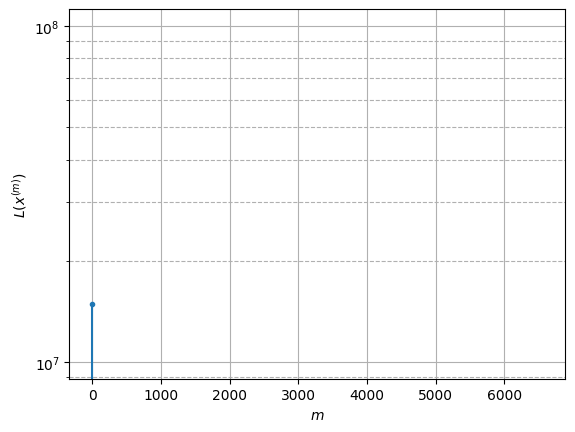

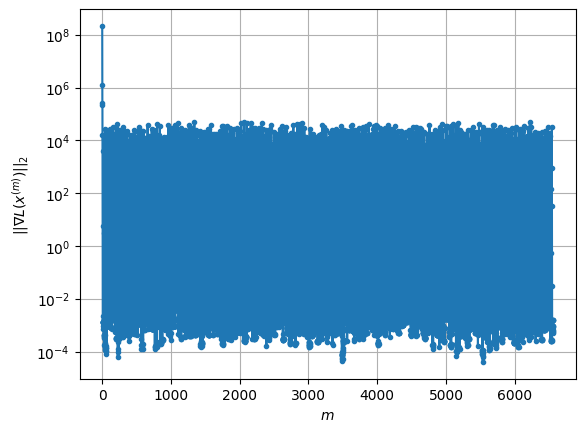

Windows:  87%|████████▋ | 328/376 [39:57<06:13,  7.78s/it]

Before applying the algorithm
Cost function: -3151373.2221866674
Gradient norm: 20700.119114434736
Global relative error: 32.98689759047795
Position relative errors: 0.093107379558789 m, 6.792547603684982 m, 13.166362680904696 m, 29.47253908286056 m

Iteration 1
Cost function: -3151374.7197590647 (-0.00%)
Gradient norm: 188.3122352512139 (-99.09%)
Global relative error: 23.60970697185133 (-28.43%)
Position relative errors: 0.10487185053090523 m, 11.6609282047413 m, 16.065278829657935 m, 12.77977233348952 m

Iteration 2
Cost function: -3151374.726074124 (-0.00%)
Gradient norm: 2.10377672495929 (-98.88%)
Global relative error: 21.06085700656212 (-10.80%)
Position relative errors: 0.10487185037135126 m, 10.739540827860894 m, 15.717341977145441 m, 9.009065221058693 m

Iteration 3
Cost function: -3151374.7260749335 (-0.00%)
Gradient norm: 0.002694032107191723 (-99.87%)
Global relative error: 21.033865565041985 (-0.13%)
Position relative errors: 0.10487185030752967 m, 10.73303214166803 m, 15

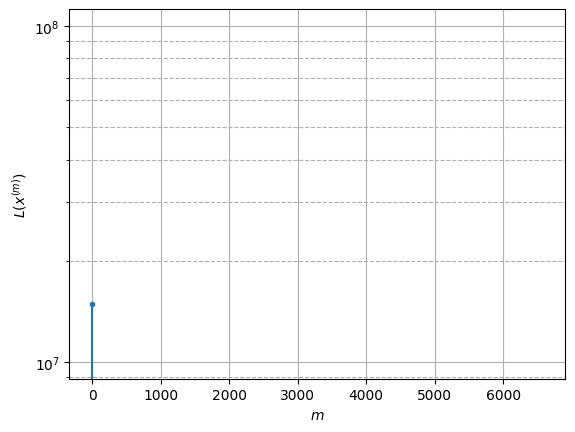

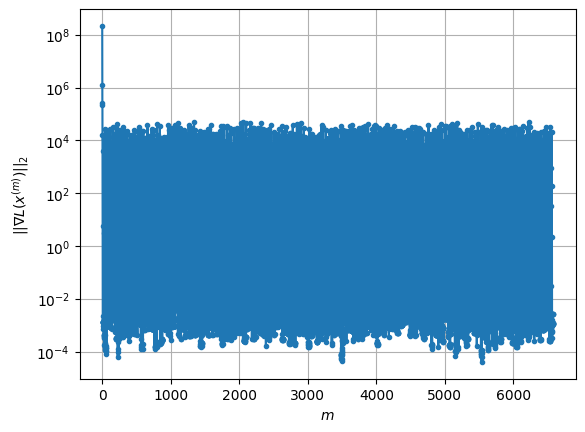

Windows:  88%|████████▊ | 329/376 [40:05<06:04,  7.75s/it]

Before applying the algorithm
Cost function: -3151375.2178896824
Gradient norm: 22661.99098732105
Global relative error: 17.97691740416417
Position relative errors: 0.09672656731713956 m, 9.425016660446836 m, 14.664070149271996 m, 4.391057103222624 m

Iteration 1
Cost function: -3151376.664715205 (-0.00%)
Gradient norm: 52.899337355796554 (-99.77%)
Global relative error: 11.029349512259065 (-38.65%)
Position relative errors: 0.07415926055417331 m, 7.249812137231781 m, 8.102285397427092 m, 1.8499059923790875 m

Iteration 2
Cost function: -3151376.66493883 (-0.00%)
Gradient norm: 0.07721659369227096 (-99.85%)
Global relative error: 11.132017395412245 (0.93%)
Position relative errors: 0.07415925989521444 m, 7.242181216293339 m, 8.237418228635045 m, 1.8973491119163048 m

Iteration 3
Cost function: -3151376.664938861 (-0.00%)
Gradient norm: 0.001810512284999612 (-97.66%)
Global relative error: 11.132154974716977 (0.00%)
Position relative errors: 0.0741592606238678 m, 7.24222890377787 m, 8.2

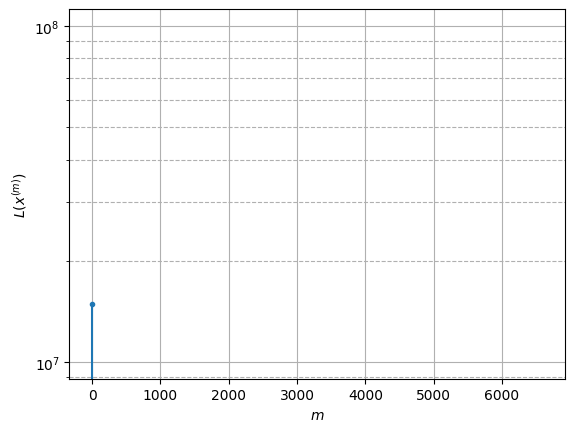

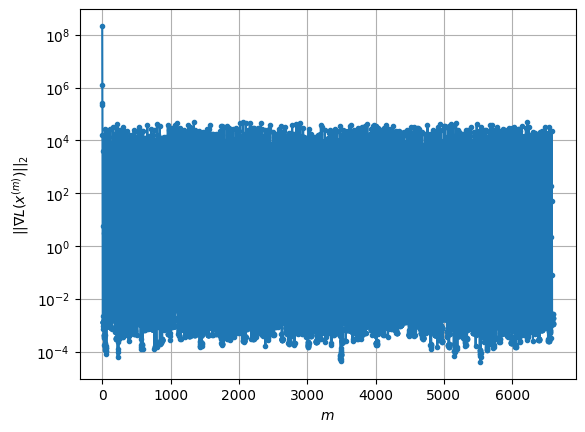

Windows:  88%|████████▊ | 330/376 [40:12<05:44,  7.49s/it]

Before applying the algorithm
Cost function: -3151368.4084792836
Gradient norm: 39682.71657887241
Global relative error: 12.110120875668793
Position relative errors: 0.06888559897934075 m, 5.949935334087869 m, 7.799947028359353 m, 7.099106887808694 m

Iteration 1
Cost function: -3151371.9832369057 (-0.00%)
Gradient norm: 50.44971390342651 (-99.87%)
Global relative error: 23.021484555468955 (90.10%)
Position relative errors: 0.07908051949637236 m, 12.290893568386764 m, 4.758080432248334 m, 18.874753982478524 m

Iteration 2
Cost function: -3151371.9851779006 (-0.00%)
Gradient norm: 0.6113483414091057 (-98.79%)
Global relative error: 24.592156878210574 (6.82%)
Position relative errors: 0.07908052212364529 m, 12.469701165978577 m, 4.6357845150991155 m, 20.682420107401086 m

Iteration 3
Cost function: -3151371.9851779146 (-0.00%)
Gradient norm: 0.0008073190482543894 (-99.87%)
Global relative error: 24.598425657813902 (0.03%)
Position relative errors: 0.07908052280145834 m, 12.47024772923678

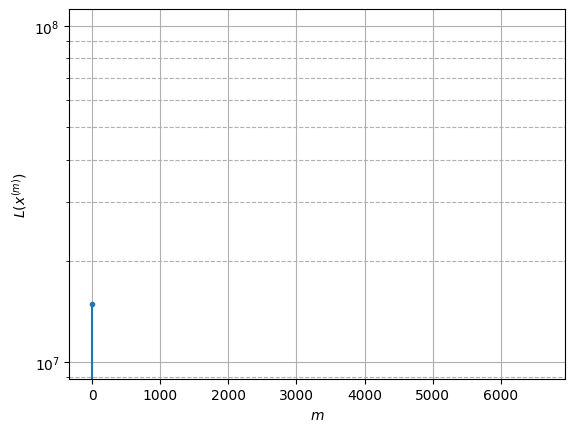

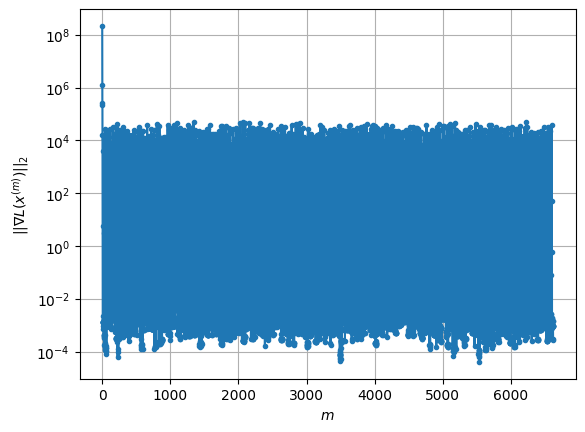

Windows:  88%|████████▊ | 331/376 [40:19<05:30,  7.34s/it]

Before applying the algorithm
Cost function: -3151367.316886763
Gradient norm: 30040.830293477975
Global relative error: 16.275134040206815
Position relative errors: 0.07354123152458167 m, 9.9997371725901 m, 3.6834577521192946 m, 12.300004068844883 m

Iteration 1
Cost function: -3151372.451149339 (-0.00%)
Gradient norm: 122.79317400940589 (-99.59%)
Global relative error: 24.39497257515282 (49.89%)
Position relative errors: 0.08201855861409851 m, 12.074185613529728 m, 7.415382617897347 m, 19.857560180213788 m

Iteration 2
Cost function: -3151372.454503032 (-0.00%)
Gradient norm: 2.3791525794896105 (-98.06%)
Global relative error: 23.93602119225683 (-1.88%)
Position relative errors: 0.08201855877901214 m, 12.109468514469071 m, 7.613470462394464 m, 19.191437228387873 m

Iteration 3
Cost function: -3151372.454503107 (-0.00%)
Gradient norm: 0.0016225894713846874 (-99.93%)
Global relative error: 23.93301735864505 (-0.01%)
Position relative errors: 0.08201855902040037 m, 12.109639019417981 m,

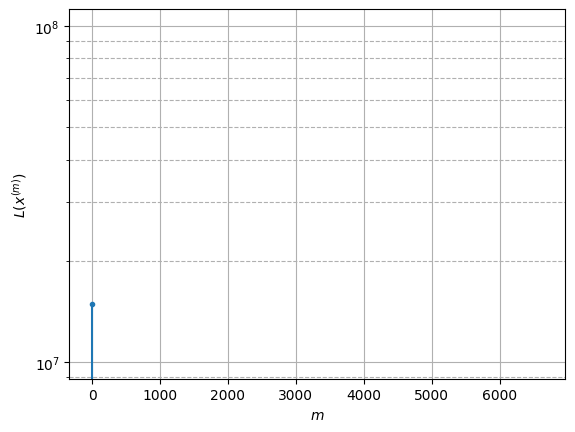

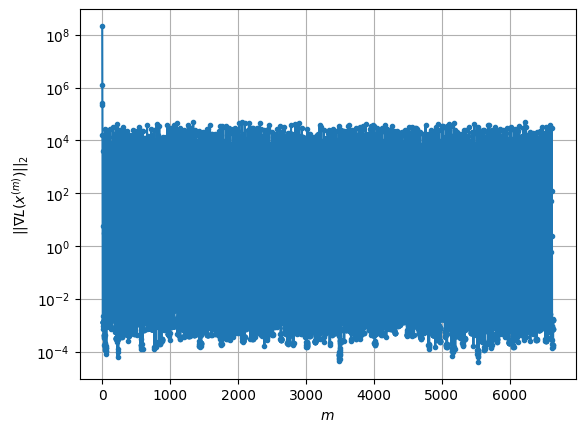

Windows:  88%|████████▊ | 332/376 [40:25<05:14,  7.14s/it]

Before applying the algorithm
Cost function: -3151374.8429006506
Gradient norm: 20861.044388138398
Global relative error: 26.912676878782708
Position relative errors: 0.07948944754771771 m, 10.737243490811682 m, 6.984240112935604 m, 23.668697511524442 m

Iteration 1
Cost function: -3151379.0847226167 (-0.00%)
Gradient norm: 162.6794403885544 (-99.22%)
Global relative error: 47.32114112506172 (75.83%)
Position relative errors: 0.06527671237795761 m, 11.569142038081251 m, 17.209592898841954 m, 42.535487639328174 m

Iteration 2
Cost function: -3151379.0903669596 (-0.00%)
Gradient norm: 1.9698548375812952 (-98.79%)
Global relative error: 49.89351435227443 (5.44%)
Position relative errors: 0.0652767151402241 m, 11.425447439165973 m, 17.909433769490487 m, 45.14495467703791 m

Iteration 3
Cost function: -3151379.090367112 (-0.00%)
Gradient norm: 0.0022902474316873487 (-99.88%)
Global relative error: 49.90786757027798 (0.03%)
Position relative errors: 0.06527671501105979 m, 11.42276400653151 m

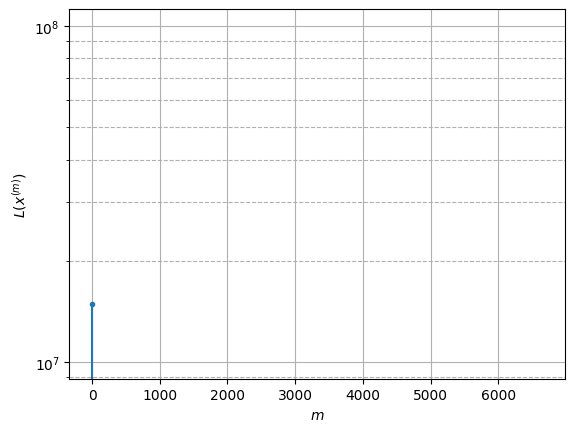

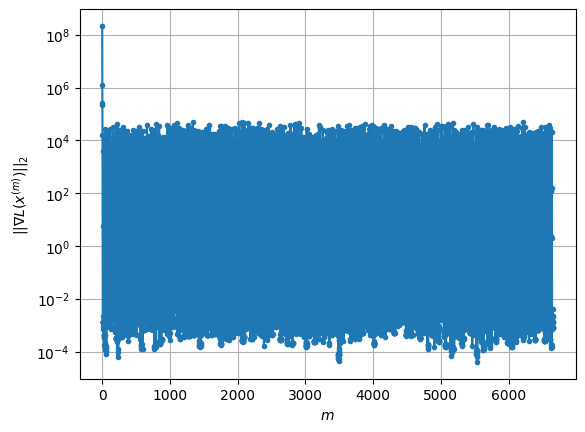

Windows:  89%|████████▊ | 333/376 [40:32<05:04,  7.07s/it]

Before applying the algorithm
Cost function: -3151371.965085847
Gradient norm: 23832.286566109047
Global relative error: 51.28734205939365
Position relative errors: 0.06232018131803949 m, 10.081770534250408 m, 16.362559614320773 m, 47.550072596884384 m

Iteration 1
Cost function: -3151376.130622611 (-0.00%)
Gradient norm: 147.06967107915392 (-99.38%)
Global relative error: 28.725932755314766 (-43.99%)
Position relative errors: 0.0683036762939778 m, 27.110439526896677 m, 7.608921046558706 m, 5.6832491489044346 m

Iteration 2
Cost function: -3151376.134363132 (-0.00%)
Gradient norm: 0.4902812845042782 (-99.67%)
Global relative error: 28.648523166519457 (-0.27%)
Position relative errors: 0.06830368091460444 m, 26.435950880958245 m, 7.8859587076577355 m, 7.725413648802209 m

Iteration 3
Cost function: -3151376.1343633644 (-0.00%)
Gradient norm: 0.0006515816298803017 (-99.87%)
Global relative error: 28.649539008727373 (0.00%)
Position relative errors: 0.06830368084357824 m, 26.4300236741813

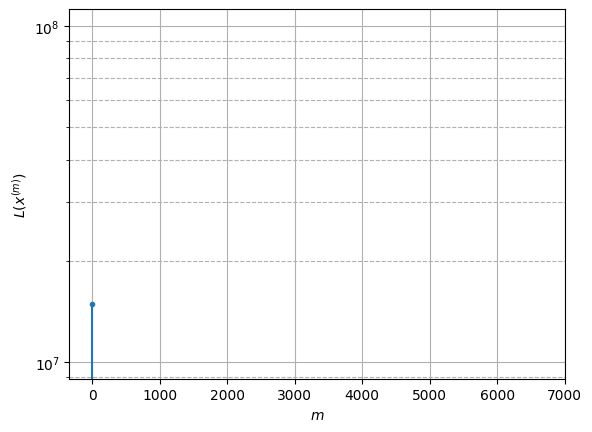

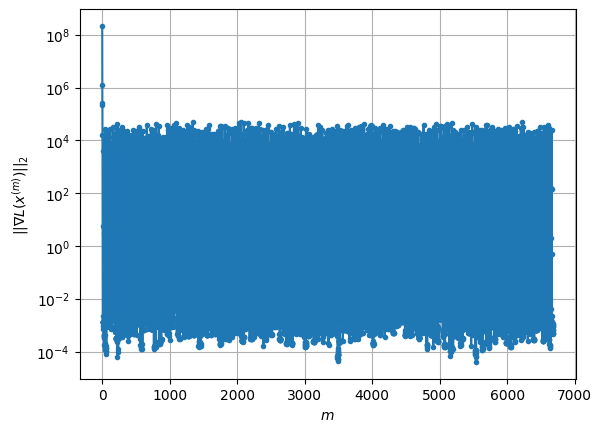

Windows:  89%|████████▉ | 334/376 [40:39<04:58,  7.12s/it]

Before applying the algorithm
Cost function: -3151376.3421222013
Gradient norm: 9509.291293586819
Global relative error: 27.622494904709832
Position relative errors: 0.0657776724894739 m, 24.91603342449075 m, 6.437897311958429 m, 10.036894184431999 m

Iteration 1
Cost function: -3151378.1196659505 (-0.00%)
Gradient norm: 204.92711089265123 (-97.84%)
Global relative error: 38.96614791655245 (41.07%)
Position relative errors: 0.04914460872559036 m, 25.23163776346035 m, 2.5478534710130667 m, 29.58428569345022 m

Iteration 2
Cost function: -3151378.123315664 (-0.00%)
Gradient norm: 3.5832350516988583 (-98.25%)
Global relative error: 38.82003549155054 (-0.37%)
Position relative errors: 0.04914460914685153 m, 25.86154340218631 m, 2.5769189989664585 m, 28.836285121360724 m

Iteration 3
Cost function: -3151378.1233158824 (-0.00%)
Gradient norm: 0.0005295384869756414 (-99.99%)
Global relative error: 38.8163733379811 (-0.01%)
Position relative errors: 0.049144609616745695 m, 25.864090458204046 m

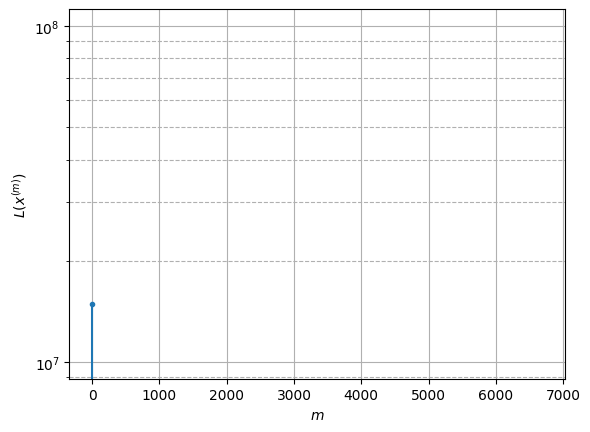

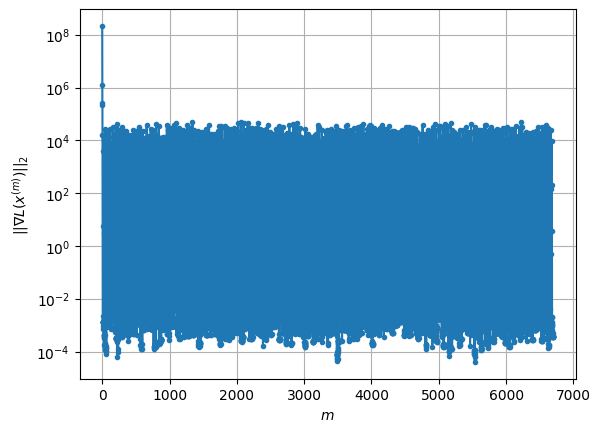

Windows:  89%|████████▉ | 335/376 [40:47<04:52,  7.15s/it]

Before applying the algorithm
Cost function: -3151376.8241443387
Gradient norm: 11514.070129358257
Global relative error: 38.699569290972775
Position relative errors: 0.048290930756120364 m, 24.04878939047458 m, 2.4557765258105557 m, 30.22048565454471 m

Iteration 1
Cost function: -3151379.149921054 (-0.00%)
Gradient norm: 13.776005987608073 (-99.88%)
Global relative error: 43.095030927889006 (11.36%)
Position relative errors: 0.05534495278964682 m, 15.322972747432601 m, 7.395482575153194 m, 39.59407965922622 m

Iteration 2
Cost function: -3151379.150410907 (-0.00%)
Gradient norm: 0.13612113516952332 (-99.01%)
Global relative error: 43.134049600415054 (0.09%)
Position relative errors: 0.05534495455571736 m, 15.099649172667931 m, 6.833546168173695 m, 39.822677226980055 m

Iteration 3
Cost function: -3151379.150410867 (0.00%)
Gradient norm: 0.0038856484091758727 (-97.15%)
Global relative error: 43.134320400824436 (0.00%)
Position relative errors: 0.055344954768189354 m, 15.09956454031101

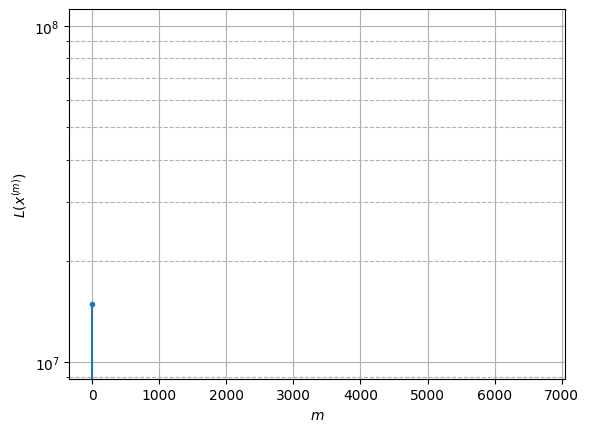

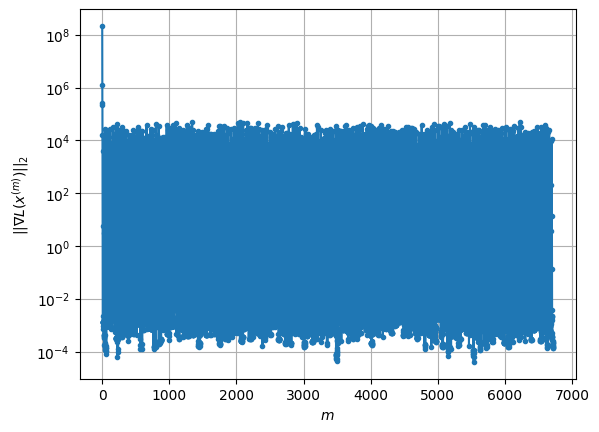

Windows:  89%|████████▉ | 336/376 [40:53<04:41,  7.05s/it]

Before applying the algorithm
Cost function: -3151373.308599237
Gradient norm: 14691.128296271794
Global relative error: 43.40377815339006
Position relative errors: 0.054405603831501885 m, 13.897415389015086 m, 6.210299173904265 m, 40.646996092826896 m

Iteration 1
Cost function: -3151377.2682133457 (-0.00%)
Gradient norm: 263.45542691083676 (-98.21%)
Global relative error: 45.56556977084564 (4.98%)
Position relative errors: 0.05931800106017058 m, 5.459941542320762 m, 7.326969551820128 m, 44.63988995008873 m

Iteration 2
Cost function: -3151377.281253753 (-0.00%)
Gradient norm: 5.611908636515462 (-97.87%)
Global relative error: 42.62241278649334 (-6.46%)
Position relative errors: 0.0593180121796419 m, 4.84591110129019 m, 8.160558126460058 m, 41.55220650500489 m

Iteration 3
Cost function: -3151377.2812549407 (-0.00%)
Gradient norm: 0.000994855743243112 (-99.98%)
Global relative error: 42.601995337496206 (-0.05%)
Position relative errors: 0.05931801169262165 m, 4.8400775572315435 m, 8.1

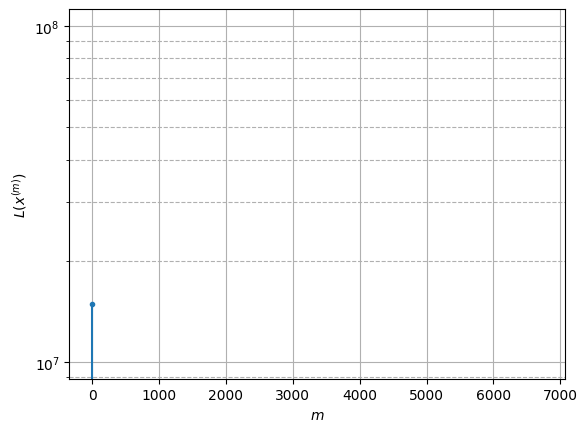

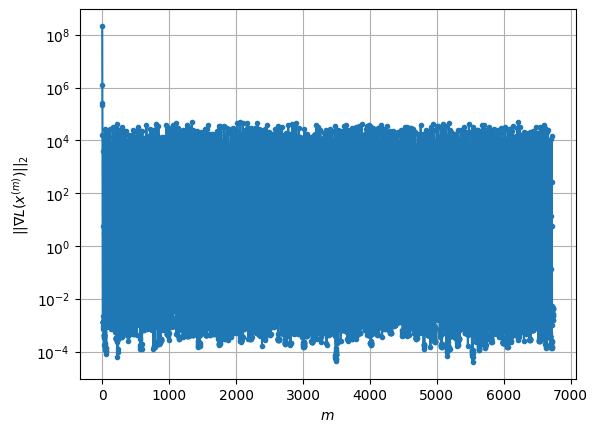

Windows:  90%|████████▉ | 337/376 [41:01<04:36,  7.08s/it]

Before applying the algorithm
Cost function: -3151370.1921426742
Gradient norm: 30278.32182904758
Global relative error: 44.56625087080865
Position relative errors: 0.05785283380571458 m, 5.367950168212997 m, 6.475789929059182 m, 43.76521136259935 m

Iteration 1
Cost function: -3151372.208047444 (-0.00%)
Gradient norm: 37.29176770069976 (-99.88%)
Global relative error: 58.1093572124864 (30.39%)
Position relative errors: 0.06312863238641346 m, 20.61910535438026 m, 8.687402827449542 m, 53.62903409650976 m

Iteration 2
Cost function: -3151372.2087218943 (-0.00%)
Gradient norm: 0.4929265526332112 (-98.68%)
Global relative error: 57.63177758956472 (-0.82%)
Position relative errors: 0.06312863021121123 m, 20.458310391114683 m, 8.726550535365432 m, 53.16691656567249 m

Iteration 3
Cost function: -3151372.2087218924 (0.00%)
Gradient norm: 0.0007975165248889796 (-99.84%)
Global relative error: 57.63111955001268 (-0.00%)
Position relative errors: 0.06312863002918842 m, 20.45807707356232 m, 8.726

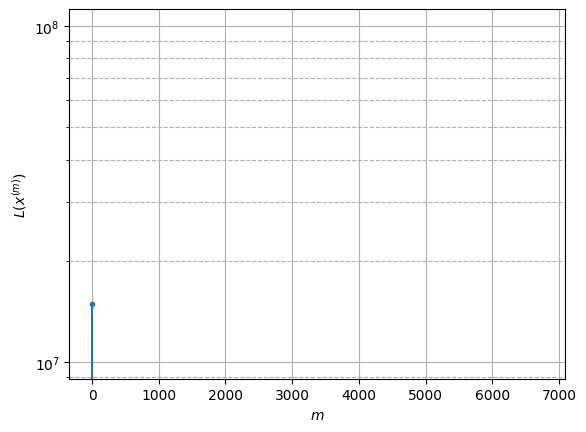

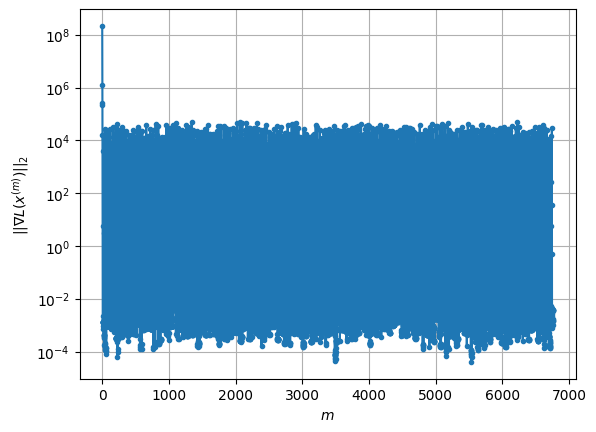

Windows:  90%|████████▉ | 338/376 [41:07<04:27,  7.04s/it]

Before applying the algorithm
Cost function: -3151364.7615091763
Gradient norm: 25834.05580919205
Global relative error: 58.44445118454555
Position relative errors: 0.06153829140409212 m, 20.45788371595921 m, 8.106179849559322 m, 54.14345310147896 m

Iteration 1
Cost function: -3151368.3751980113 (-0.00%)
Gradient norm: 108.37849702328593 (-99.58%)
Global relative error: 79.7495923363103 (36.45%)
Position relative errors: 0.0813984425490982 m, 16.677949451723443 m, 15.929737031946642 m, 76.34185080000927 m

Iteration 2
Cost function: -3151368.377266542 (-0.00%)
Gradient norm: 0.3137800820167799 (-99.71%)
Global relative error: 79.21950407969899 (-0.66%)
Position relative errors: 0.08139844375850638 m, 16.707220643248156 m, 15.425030477921498 m, 75.88582473417287 m

Iteration 3
Cost function: -3151368.377266555 (-0.00%)
Gradient norm: 0.001820327240198486 (-99.42%)
Global relative error: 79.21287934124484 (-0.01%)
Position relative errors: 0.08139844370542255 m, 16.705681847560314 m, 15

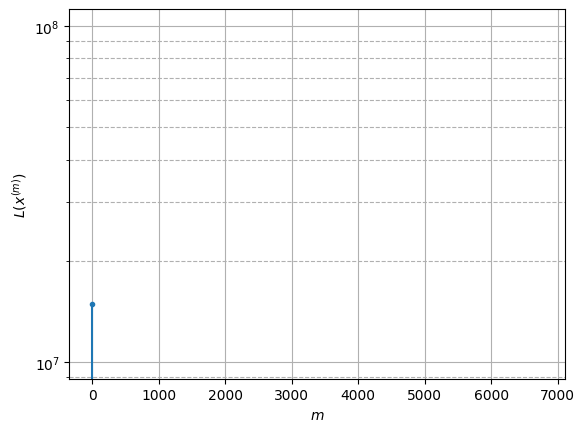

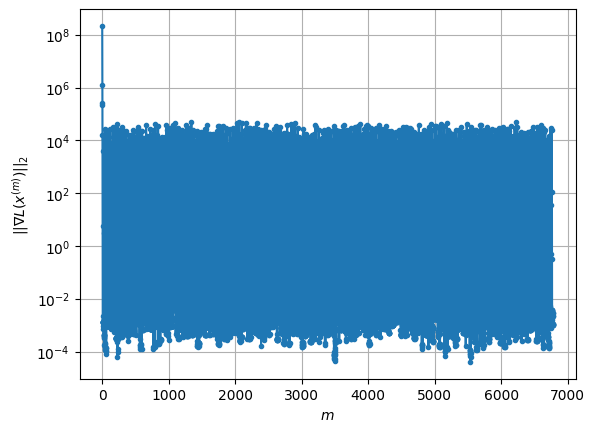

Windows:  90%|█████████ | 339/376 [41:14<04:17,  6.97s/it]

Before applying the algorithm
Cost function: -3151378.897097551
Gradient norm: 9775.07449800264
Global relative error: 77.83813088634601
Position relative errors: 0.07793103142086126 m, 16.194387429877523 m, 12.840161660949942 m, 75.04424253354368 m

Iteration 1
Cost function: -3151380.550331959 (-0.00%)
Gradient norm: 290.9425587705758 (-97.02%)
Global relative error: 78.69861091899287 (1.11%)
Position relative errors: 0.08358941774788813 m, 11.632869893821242 m, 43.7510725026115 m, 64.37371138217837 m

Iteration 2
Cost function: -3151380.5579398884 (-0.00%)
Gradient norm: 3.015210028051255 (-98.96%)
Global relative error: 77.02008706828875 (-2.13%)
Position relative errors: 0.08358942168192858 m, 11.486823625136536 m, 42.00496705057648 m, 63.5272668721229 m

Iteration 3
Cost function: -3151380.5579404 (-0.00%)
Gradient norm: 0.005946500455292568 (-99.80%)
Global relative error: 77.0077752947596 (-0.02%)
Position relative errors: 0.08358942082920755 m, 11.486373154086435 m, 41.9852849

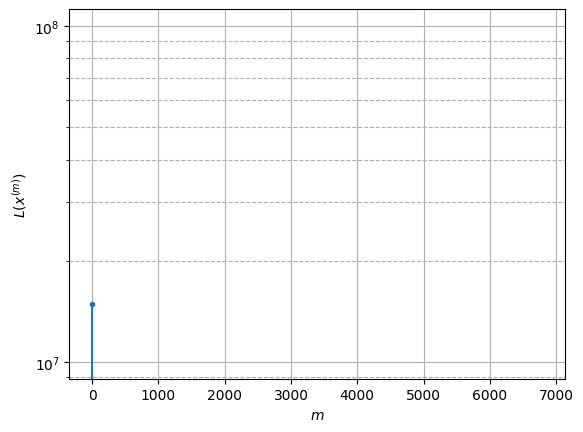

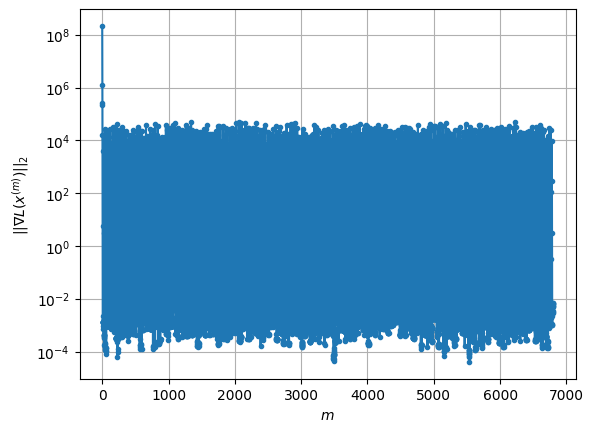

Windows:  90%|█████████ | 340/376 [41:21<04:08,  6.90s/it]

Before applying the algorithm
Cost function: -3151375.282289374
Gradient norm: 21343.554800970483
Global relative error: 74.75151683266937
Position relative errors: 0.07908305038966991 m, 11.074702399591285 m, 36.37713178324784 m, 64.35704370709574 m

Iteration 1
Cost function: -3151378.6376988967 (-0.00%)
Gradient norm: 678.2118738611618 (-96.82%)
Global relative error: 100.40113220442917 (34.31%)
Position relative errors: 0.08634857418306983 m, 13.718179921080754 m, 6.22916937776766 m, 99.26422462452008 m

Iteration 2
Cost function: -3151378.6522989995 (-0.00%)
Gradient norm: 2.7558760161219804 (-99.59%)
Global relative error: 100.19815926618176 (-0.20%)
Position relative errors: 0.08634858616441532 m, 13.32818467255179 m, 5.491787554871735 m, 99.15574184981769 m

Iteration 3
Cost function: -3151378.652299636 (-0.00%)
Gradient norm: 0.001178033581430375 (-99.96%)
Global relative error: 100.187973184221 (-0.01%)
Position relative errors: 0.08634858532425745 m, 13.318627588171141 m, 5.

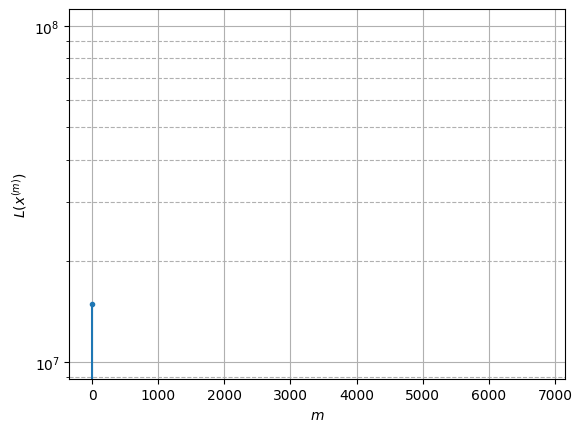

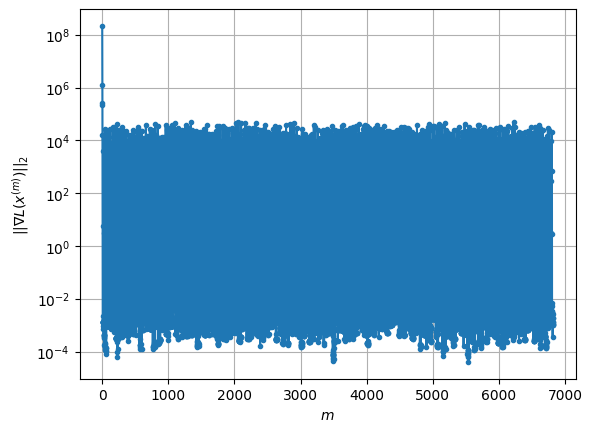

Windows:  91%|█████████ | 341/376 [41:28<04:02,  6.92s/it]

Before applying the algorithm
Cost function: -3151376.7956669466
Gradient norm: 22893.968632685617
Global relative error: 97.45758220821352
Position relative errors: 0.07932260216840759 m, 13.112460719822725 m, 4.117015673545359 m, 96.48359806370726 m

Iteration 1
Cost function: -3151378.3105938113 (-0.00%)
Gradient norm: 38.16627189547608 (-99.83%)
Global relative error: 98.18072312915386 (0.74%)
Position relative errors: 0.08531226457528401 m, 8.163788921764649 m, 11.42195999224665 m, 97.17168633954039 m

Iteration 2
Cost function: -3151378.311262279 (-0.00%)
Gradient norm: 0.5082018963762565 (-98.67%)
Global relative error: 98.28872229554565 (0.11%)
Position relative errors: 0.08531226544278817 m, 8.101815214987209 m, 11.572527862978538 m, 97.26819047089957 m

Iteration 3
Cost function: -3151378.3112622937 (-0.00%)
Gradient norm: 0.004065261906594013 (-99.20%)
Global relative error: 98.28903731844281 (0.00%)
Position relative errors: 0.08531226547616075 m, 8.101772712788415 m, 11.57

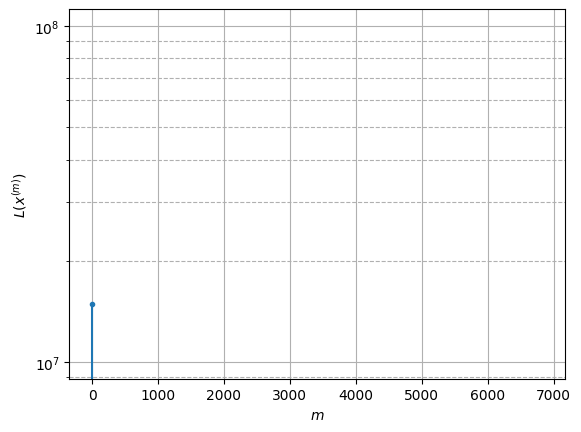

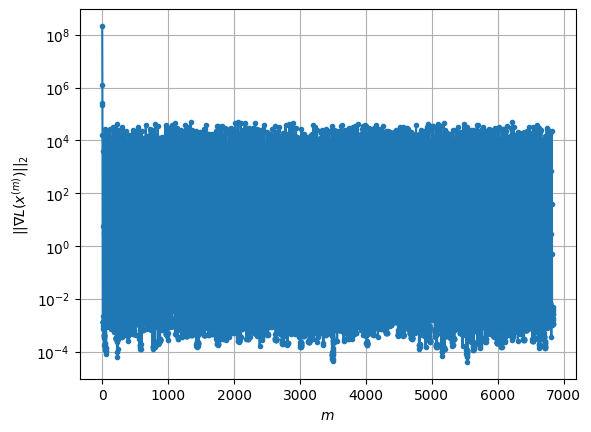

Windows:  91%|█████████ | 342/376 [41:35<03:52,  6.84s/it]

Before applying the algorithm
Cost function: -3151363.0961904796
Gradient norm: 19658.75073383599
Global relative error: 95.7982035334628
Position relative errors: 0.08029723420057248 m, 8.41239253310666 m, 12.183001328441266 m, 94.64720294175842 m

Iteration 1
Cost function: -3151366.6077754176 (-0.00%)
Gradient norm: 501.1271802708579 (-97.45%)
Global relative error: 53.69380772652539 (-43.95%)
Position relative errors: 0.08453302923407537 m, 5.891313538024802 m, 9.229704757109175 m, 52.56539678496849 m

Iteration 2
Cost function: -3151366.6242339932 (-0.00%)
Gradient norm: 11.683445454622827 (-97.67%)
Global relative error: 57.72051736140596 (7.50%)
Position relative errors: 0.08453303516339024 m, 4.367070198464719 m, 7.376058558978647 m, 57.0803989687764 m

Iteration 3
Cost function: -3151366.6242380636 (-0.00%)
Gradient norm: 0.0023184838249150864 (-99.98%)
Global relative error: 57.770686860682716 (0.09%)
Position relative errors: 0.08453303433698836 m, 4.346391466566186 m, 7.359

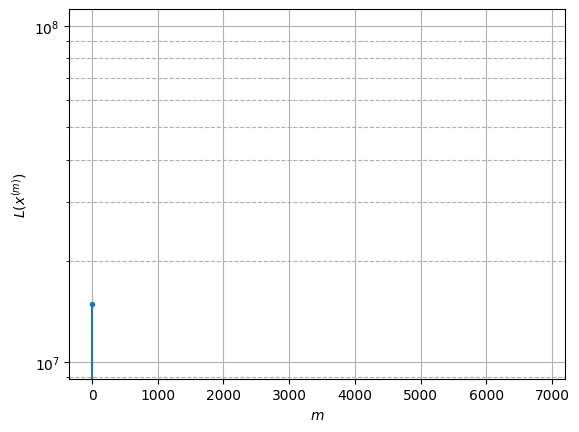

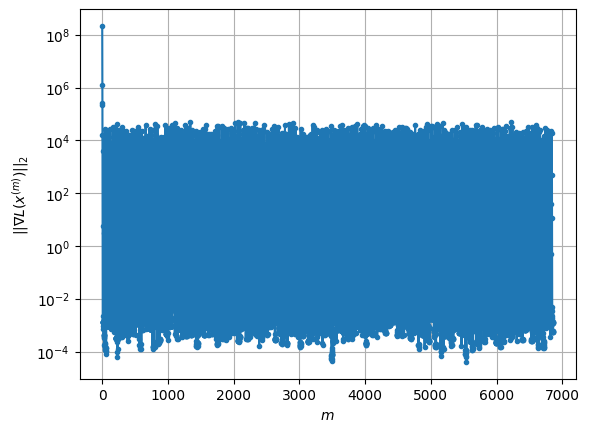

Windows:  91%|█████████ | 343/376 [41:42<03:47,  6.89s/it]

Before applying the algorithm
Cost function: -3151360.2865672763
Gradient norm: 25863.758726092045
Global relative error: 58.9692531541721
Position relative errors: 0.07982186554534393 m, 2.7774338415741084 m, 8.179213568217419 m, 58.33310785427037 m

Iteration 1
Cost function: -3151362.9863054543 (-0.00%)
Gradient norm: 168.6396694726869 (-99.35%)
Global relative error: 69.8804690559332 (18.50%)
Position relative errors: 0.08966714241044968 m, 4.055865459057714 m, 13.72462901185602 m, 68.39923748820665 m

Iteration 2
Cost function: -3151362.9882679065 (-0.00%)
Gradient norm: 1.3474761467670997 (-99.20%)
Global relative error: 71.12574075613679 (1.78%)
Position relative errors: 0.08966714045157631 m, 4.150247170414091 m, 13.365358157515566 m, 69.735247363228 m

Iteration 3
Cost function: -3151362.988267962 (-0.00%)
Gradient norm: 0.0003210028603726486 (-99.98%)
Global relative error: 71.12828482610543 (0.00%)
Position relative errors: 0.08966714045157631 m, 4.150838573305882 m, 13.3631

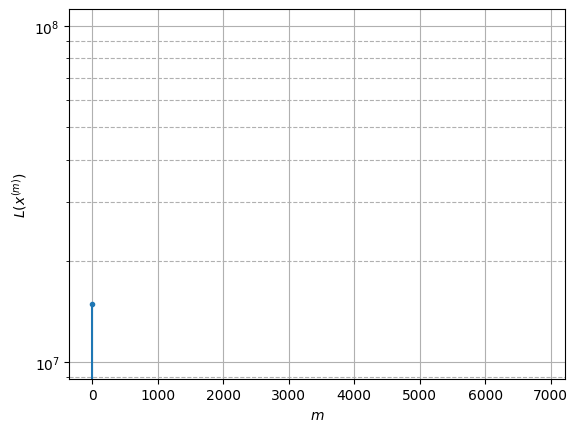

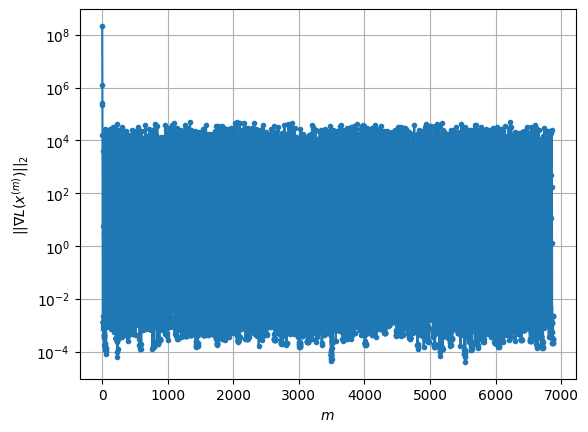

Windows:  91%|█████████▏| 344/376 [41:49<03:47,  7.10s/it]

Before applying the algorithm
Cost function: -3151358.29339632
Gradient norm: 22810.8674237564
Global relative error: 69.85093430084578
Position relative errors: 0.08046884800522744 m, 3.9509782926837196 m, 14.287437642731367 m, 68.25982999432618 m

Iteration 1
Cost function: -3151359.672991947 (-0.00%)
Gradient norm: 156.57040065653197 (-99.31%)
Global relative error: 65.01588934759253 (-6.92%)
Position relative errors: 0.059608174135305836 m, 3.7843680834314855 m, 14.791454282686354 m, 63.19773040080933 m

Iteration 2
Cost function: -3151359.6746948604 (-0.00%)
Gradient norm: 1.604586438911308 (-98.98%)
Global relative error: 64.16491979836984 (-1.31%)
Position relative errors: 0.059608175211759144 m, 3.379291358412737 m, 15.419096449315642 m, 62.1929627331266 m

Iteration 3
Cost function: -3151359.674694919 (-0.00%)
Gradient norm: 0.001345390833202224 (-99.92%)
Global relative error: 64.1621809681362 (-0.00%)
Position relative errors: 0.059608175211759144 m, 3.378202357922327 m, 15.

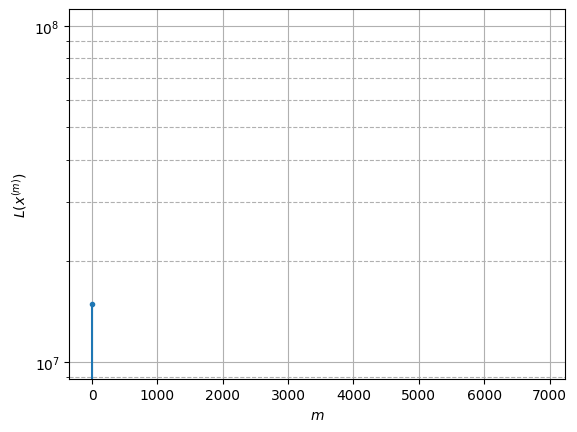

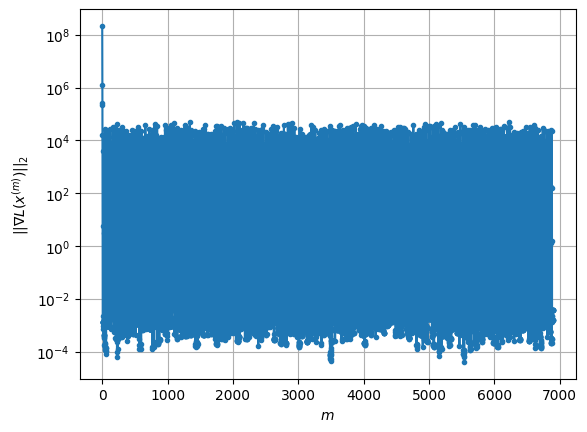

Windows:  92%|█████████▏| 345/376 [41:57<03:44,  7.24s/it]

Before applying the algorithm
Cost function: -3151354.9031293886
Gradient norm: 14154.232506446473
Global relative error: 62.916414835123305
Position relative errors: 0.052964068613802734 m, 4.166549808513375 m, 14.726060190069973 m, 61.02667170599328 m

Iteration 1
Cost function: -3151358.2971639563 (-0.00%)
Gradient norm: 90.97490434317153 (-99.36%)
Global relative error: 46.68929560135022 (-25.79%)
Position relative errors: 0.040023314209708276 m, 8.358044152326997 m, 20.642359805378504 m, 41.03563670783112 m

Iteration 2
Cost function: -3151358.299824614 (-0.00%)
Gradient norm: 1.9431379856486775 (-97.86%)
Global relative error: 45.57388265769217 (-2.39%)
Position relative errors: 0.04002331871315434 m, 7.570258010272647 m, 20.9573041779269 m, 39.754980370655694 m

Iteration 3
Cost function: -3151358.2998246914 (-0.00%)
Gradient norm: 0.0031394897987491598 (-99.84%)
Global relative error: 45.570300678297 (-0.01%)
Position relative errors: 0.040023317926494356 m, 7.56849944985795 m,

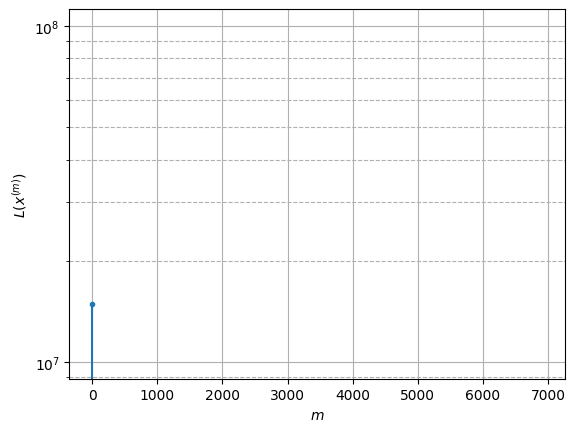

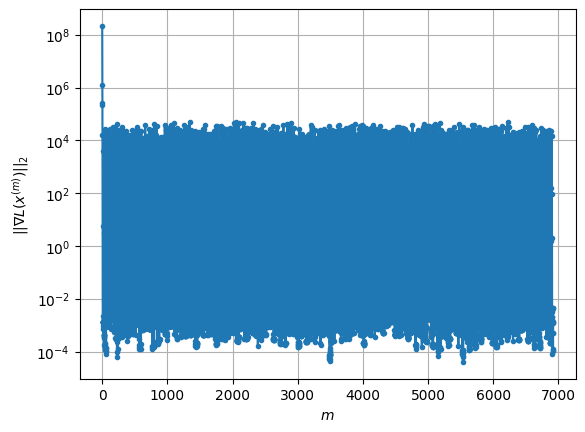

Windows:  92%|█████████▏| 346/376 [42:04<03:39,  7.30s/it]

Before applying the algorithm
Cost function: -3151355.5988866147
Gradient norm: 28662.125667737044
Global relative error: 44.18424513104618
Position relative errors: 0.032313629269061686 m, 7.775749982100692 m, 18.83706024545597 m, 39.20392709120874 m

Iteration 1
Cost function: -3151357.8744862597 (-0.00%)
Gradient norm: 57.03565220162278 (-99.80%)
Global relative error: 64.82323502538162 (46.71%)
Position relative errors: 0.01451352663733274 m, 11.783508095479627 m, 31.796376227193274 m, 55.24660764828177 m

Iteration 2
Cost function: -3151357.8755594627 (-0.00%)
Gradient norm: 0.7685375629357213 (-98.65%)
Global relative error: 64.05802149299012 (-1.18%)
Position relative errors: 0.014513527737088095 m, 11.908971029650314 m, 30.75540157606509 m, 54.91546561246085 m

Iteration 3
Cost function: -3151357.8755594795 (-0.00%)
Gradient norm: 0.00043619122245584264 (-99.94%)
Global relative error: 64.05688956330572 (-0.00%)
Position relative errors: 0.01451352850017745 m, 11.90923700806629

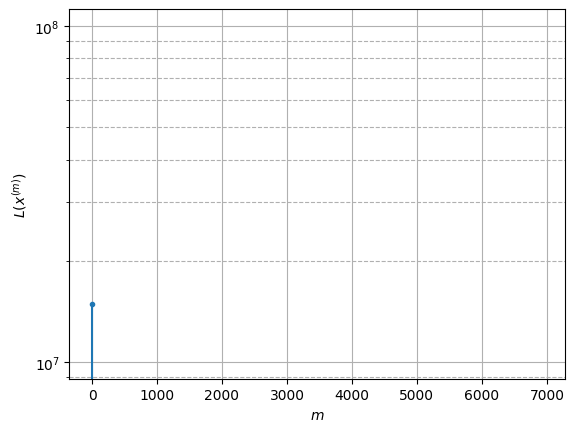

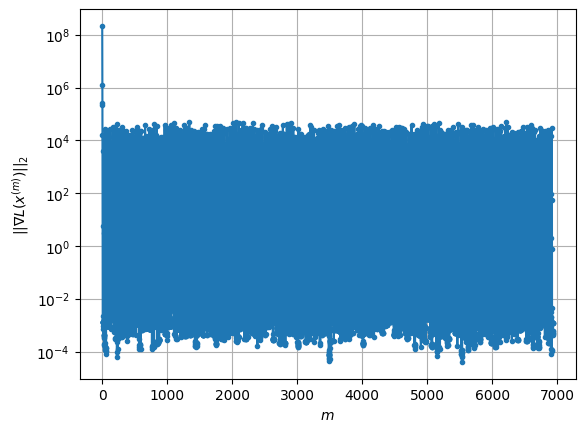

Windows:  92%|█████████▏| 347/376 [42:12<03:34,  7.41s/it]

Before applying the algorithm
Cost function: -3151359.8179804864
Gradient norm: 26748.87277293892
Global relative error: 60.72428646033789
Position relative errors: 0.010515867364340693 m, 11.496361176543815 m, 28.16017325060336 m, 52.557334994661964 m

Iteration 1
Cost function: -3151361.7656075275 (-0.00%)
Gradient norm: 40.870373367427305 (-99.85%)
Global relative error: 37.49358153539029 (-38.26%)
Position relative errors: 0.036827058588980124 m, 12.980324963097305 m, 11.849325380040531 m, 33.119023553722286 m

Iteration 2
Cost function: -3151361.7664315538 (-0.00%)
Gradient norm: 0.1994593164325915 (-99.51%)
Global relative error: 36.186292736994574 (-3.49%)
Position relative errors: 0.036827056944960156 m, 12.482494669532509 m, 11.783492585678896 m, 31.85562657059818 m

Iteration 3
Cost function: -3151361.7664315603 (-0.00%)
Gradient norm: 0.0031838237050333677 (-98.40%)
Global relative error: 36.1834951357121 (-0.01%)
Position relative errors: 0.036827056944960156 m, 12.48177215

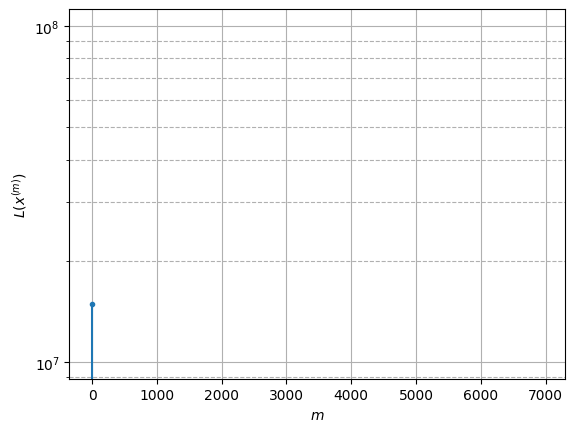

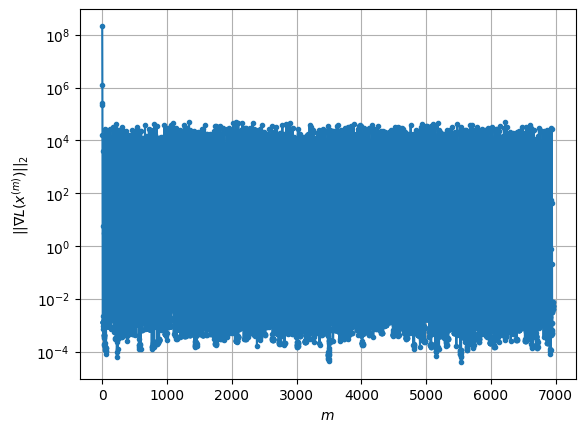

Windows:  93%|█████████▎| 348/376 [42:19<03:27,  7.42s/it]

Before applying the algorithm
Cost function: -3151357.6826664982
Gradient norm: 47885.19259183531
Global relative error: 33.919649330950755
Position relative errors: 0.03559038182146021 m, 11.92671018260892 m, 9.568403060910885 m, 30.277686924812546 m

Iteration 1
Cost function: -3151360.700917317 (-0.00%)
Gradient norm: 95.65576525038789 (-99.80%)
Global relative error: 20.274414992326555 (-40.23%)
Position relative errors: 0.05251560013674326 m, 5.816617783698538 m, 18.51575502609202 m, 5.863353986976332 m

Iteration 2
Cost function: -3151360.7039211937 (-0.00%)
Gradient norm: 1.7912406744536271 (-98.13%)
Global relative error: 19.726445694650433 (-2.70%)
Position relative errors: 0.05251560638950504 m, 6.773143005975708 m, 16.930296687503155 m, 7.5243417759376765 m

Iteration 3
Cost function: -3151360.703921359 (-0.00%)
Gradient norm: 0.0027076905501556697 (-99.85%)
Global relative error: 19.72634403602527 (-0.00%)
Position relative errors: 0.05251560638420956 m, 6.7786419448833835 

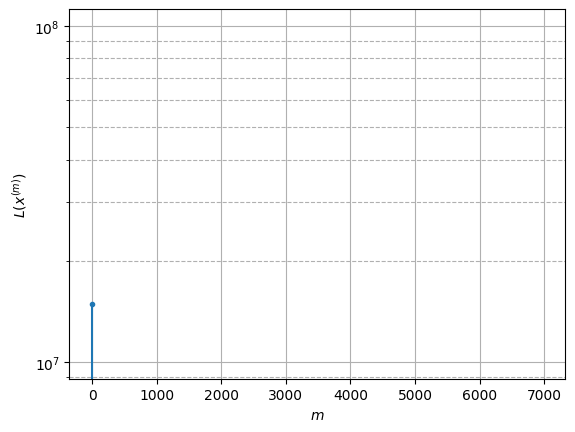

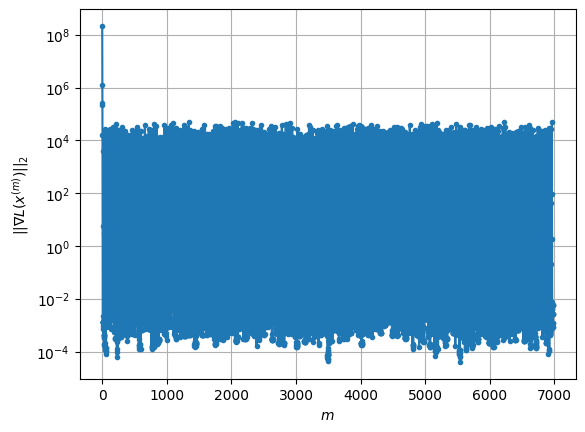

Windows:  93%|█████████▎| 349/376 [42:27<03:20,  7.44s/it]

Before applying the algorithm
Cost function: -3151353.0263287555
Gradient norm: 33700.56901841236
Global relative error: 16.26929422899882
Position relative errors: 0.05022014413503256 m, 6.207012185008101 m, 13.46632678418379 m, 6.694368521316802 m

Iteration 1
Cost function: -3151357.337144426 (-0.00%)
Gradient norm: 108.49373423073762 (-99.68%)
Global relative error: 22.27706878908184 (36.93%)
Position relative errors: 0.07733847720074893 m, 14.79449325936686 m, 10.617283128681219 m, 12.831847520158965 m

Iteration 2
Cost function: -3151357.339449074 (-0.00%)
Gradient norm: 1.612187455151538 (-98.51%)
Global relative error: 22.50516254888817 (1.02%)
Position relative errors: 0.07733848117235417 m, 14.769964428695454 m, 10.000878400226217 m, 13.722429760219253 m

Iteration 3
Cost function: -3151357.3394491584 (-0.00%)
Gradient norm: 0.0013746725468169957 (-99.91%)
Global relative error: 22.506393880721934 (0.01%)
Position relative errors: 0.0773384810537192 m, 14.769946365981681 m, 9

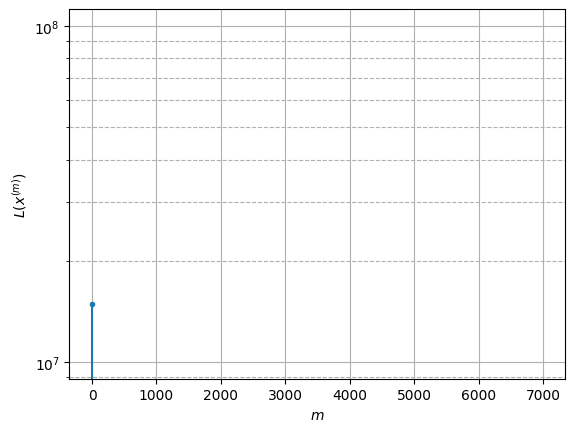

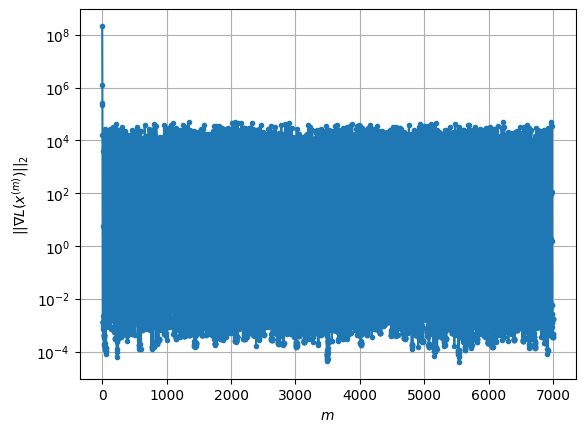

Windows:  93%|█████████▎| 350/376 [42:34<03:13,  7.45s/it]

Before applying the algorithm
Cost function: -3151352.305056763
Gradient norm: 19676.172865152075
Global relative error: 21.68918766797353
Position relative errors: 0.07246253094374684 m, 13.63245422197097 m, 9.98494628345231 m, 13.596725554474547 m

Iteration 1
Cost function: -3151355.722036123 (-0.00%)
Gradient norm: 145.37783613840884 (-99.26%)
Global relative error: 36.475684205254154 (68.17%)
Position relative errors: 0.08846577447220506 m, 11.504188921787941 m, 17.715846078590168 m, 29.7366140035962 m

Iteration 2
Cost function: -3151355.726817155 (-0.00%)
Gradient norm: 1.7058892780230406 (-98.83%)
Global relative error: 36.87864752709702 (1.10%)
Position relative errors: 0.0884657856184923 m, 11.561359611925505 m, 15.229714043084234 m, 31.534330823143414 m

Iteration 3
Cost function: -3151355.726817414 (-0.00%)
Gradient norm: 0.001228433008514566 (-99.93%)
Global relative error: 36.87474176411524 (-0.01%)
Position relative errors: 0.0884657856184923 m, 11.561370061268864 m, 15.

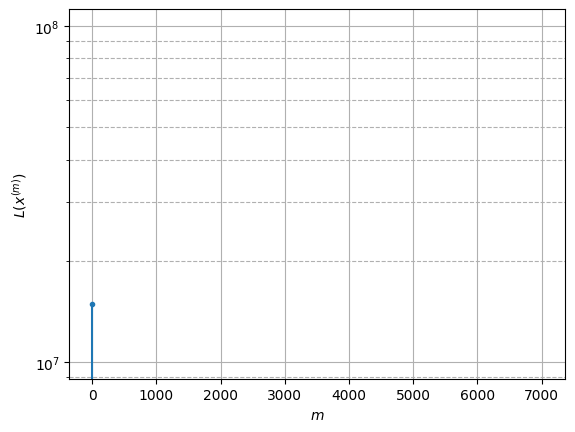

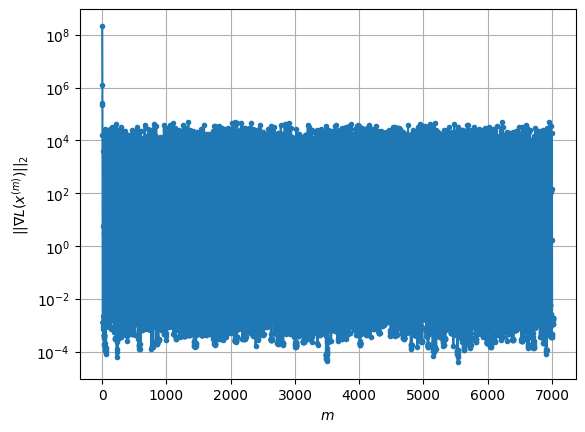

Windows:  93%|█████████▎| 351/376 [42:42<03:07,  7.50s/it]

Before applying the algorithm
Cost function: -3151342.2945338017
Gradient norm: 31560.90898038102
Global relative error: 33.82742554101167
Position relative errors: 0.0822983622776703 m, 10.659270677816883 m, 12.502110155299976 m, 29.569603353151464 m

Iteration 1
Cost function: -3151346.8682388267 (-0.00%)
Gradient norm: 55.167563807023306 (-99.83%)
Global relative error: 43.138690414779255 (27.53%)
Position relative errors: 0.06505175158582437 m, 4.491805329790945 m, 15.35271423840759 m, 40.063145294171505 m

Iteration 2
Cost function: -3151346.868965069 (-0.00%)
Gradient norm: 0.19679809097377599 (-99.64%)
Global relative error: 43.90847740482292 (1.78%)
Position relative errors: 0.06505175934464717 m, 4.73230708334558 m, 15.552840970907983 m, 40.78798550905502 m

Iteration 3
Cost function: -3151346.8689651033 (-0.00%)
Gradient norm: 0.002983713030703994 (-98.48%)
Global relative error: 43.91014648079172 (0.00%)
Position relative errors: 0.06505175945511814 m, 4.732803946154547 m, 1

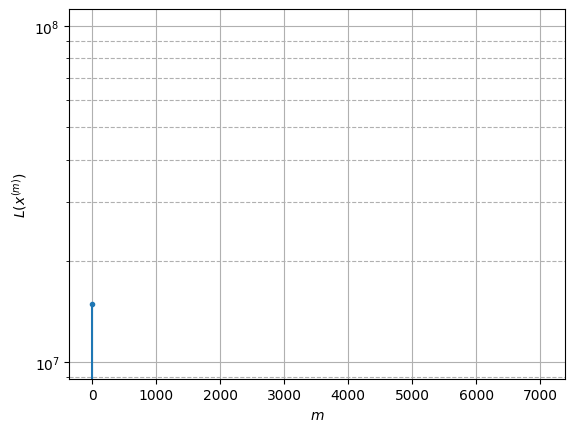

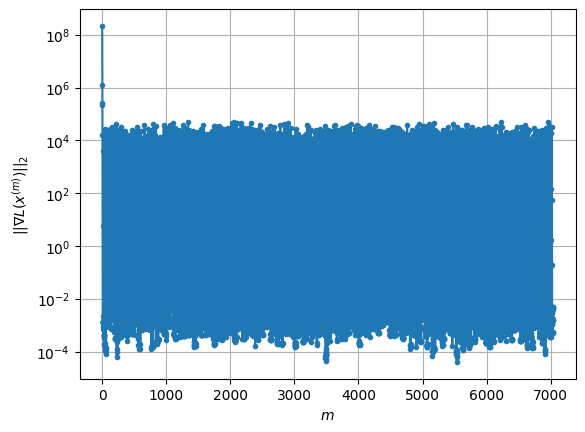

Windows:  94%|█████████▎| 352/376 [42:49<02:59,  7.48s/it]

Before applying the algorithm
Cost function: -3151338.8847800936
Gradient norm: 14535.03837850197
Global relative error: 39.897277342601235
Position relative errors: 0.06012325039139263 m, 3.9492980804997435 m, 13.002439522533837 m, 37.51164537469716 m

Iteration 1
Cost function: -3151343.050448759 (-0.00%)
Gradient norm: 52.16754903213748 (-99.64%)
Global relative error: 44.50356100293392 (11.55%)
Position relative errors: 0.06204843964706037 m, 12.878821447642032 m, 10.229247733834692 m, 41.35280735574005 m

Iteration 2
Cost function: -3151343.05214778 (-0.00%)
Gradient norm: 1.0095628827166676 (-98.06%)
Global relative error: 45.82629043521672 (2.97%)
Position relative errors: 0.06204843998573385 m, 13.015323030430014 m, 10.189577003666125 m, 42.74121642459609 m

Iteration 3
Cost function: -3151343.0521477717 (0.00%)
Gradient norm: 0.001715829256589187 (-99.83%)
Global relative error: 45.82806696859021 (0.00%)
Position relative errors: 0.06204843906948506 m, 13.015360058002665 m, 10

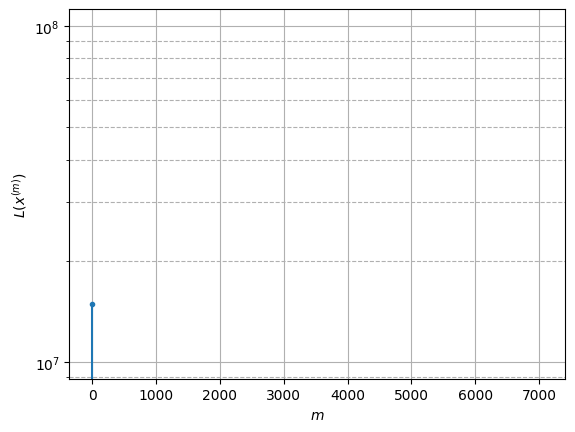

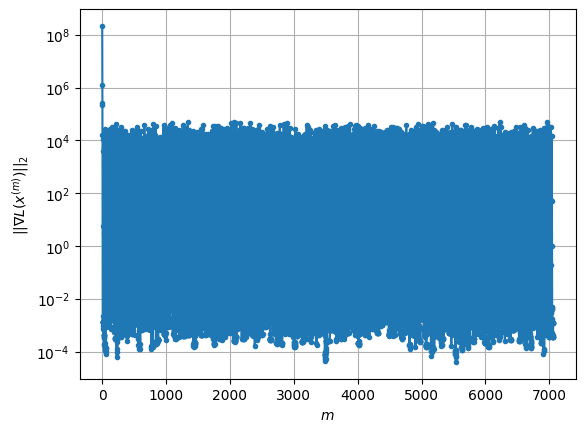

Windows:  94%|█████████▍| 353/376 [42:57<02:51,  7.47s/it]

Before applying the algorithm
Cost function: -3151340.4141692636
Gradient norm: 21085.43224420206
Global relative error: 41.143238314817076
Position relative errors: 0.05655426892327289 m, 11.85516595846945 m, 7.957315397076798 m, 38.5861550113559 m

Iteration 1
Cost function: -3151347.3988970616 (-0.00%)
Gradient norm: 966.266000903286 (-95.42%)
Global relative error: 42.238794079694934 (2.66%)
Position relative errors: 0.10174384931690604 m, 17.22499311015521 m, 37.70350963481002 m, 8.114695359820526 m

Iteration 2
Cost function: -3151347.433288973 (-0.00%)
Gradient norm: 8.641616205093552 (-99.11%)
Global relative error: 42.586457558415205 (0.82%)
Position relative errors: 0.1017438471518279 m, 15.535188086197264 m, 38.071602195929124 m, 11.081727144380181 m

Iteration 3
Cost function: -3151347.433296885 (-0.00%)
Gradient norm: 0.008859841725899154 (-99.90%)
Global relative error: 42.54284587204925 (-0.10%)
Position relative errors: 0.10174384623547231 m, 15.493139742290605 m, 38.01

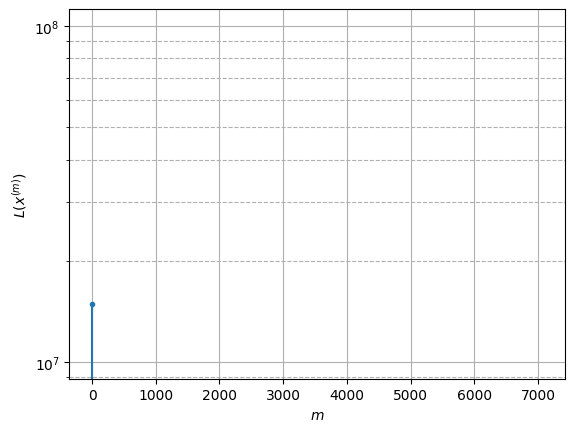

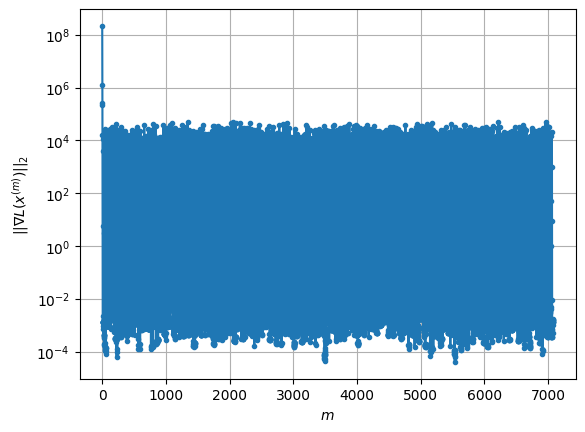

Windows:  94%|█████████▍| 354/376 [43:04<02:44,  7.46s/it]

Before applying the algorithm
Cost function: -3151347.2565715127
Gradient norm: 16092.891177227364
Global relative error: 40.04102236769462
Position relative errors: 0.09241778542401141 m, 15.451682781935277 m, 35.72499935767754 m, 9.393734904247426 m

Iteration 1
Cost function: -3151350.0037246183 (-0.00%)
Gradient norm: 153.5737120151096 (-99.05%)
Global relative error: 55.44358317720816 (38.47%)
Position relative errors: 0.11653741910958665 m, 23.25965274817333 m, 49.31161167255463 m, 10.066223888823671 m

Iteration 2
Cost function: -3151350.006354131 (-0.00%)
Gradient norm: 1.5529453232765955 (-98.99%)
Global relative error: 55.014242493033876 (-0.77%)
Position relative errors: 0.11653741954949891 m, 22.58959317587004 m, 49.362956002465395 m, 8.91964893049264 m

Iteration 3
Cost function: -3151350.006354182 (-0.00%)
Gradient norm: 0.0004919102919057746 (-99.97%)
Global relative error: 55.0116743162539 (-0.00%)
Position relative errors: 0.11653741952854885 m, 22.586324765679233 m, 4

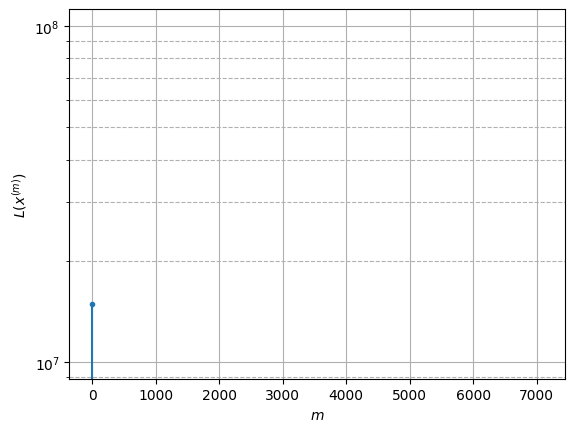

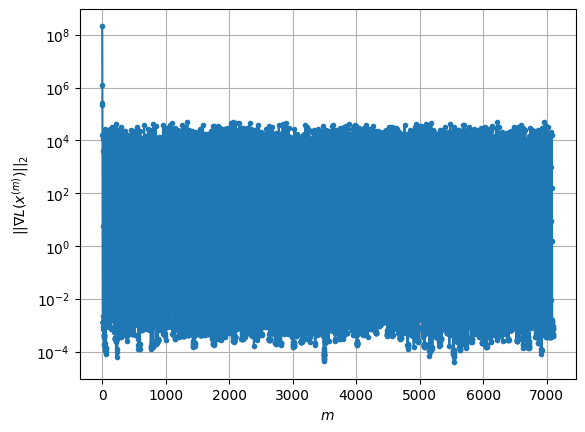

Windows:  94%|█████████▍| 355/376 [43:12<02:36,  7.45s/it]

Before applying the algorithm
Cost function: -3151345.33422329
Gradient norm: 19217.809122274102
Global relative error: 52.66538403697362
Position relative errors: 0.10471019944748941 m, 22.553841295028338 m, 46.67629529971677 m, 9.288547020168032 m

Iteration 1
Cost function: -3151347.427783965 (-0.00%)
Gradient norm: 510.27486674561095 (-97.34%)
Global relative error: 76.06390237494382 (44.43%)
Position relative errors: 0.11809613639387813 m, 18.577908387929742 m, 73.70165794187346 m, 2.9353052926267966 m

Iteration 2
Cost function: -3151347.441128175 (-0.00%)
Gradient norm: 2.7879617372166474 (-99.45%)
Global relative error: 81.99051823111473 (7.79%)
Position relative errors: 0.11809614438230129 m, 19.51601629279489 m, 79.57397206696363 m, 3.086076227841319 m

Iteration 3
Cost function: -3151347.441130719 (-0.00%)
Gradient norm: 0.003312734491073276 (-99.88%)
Global relative error: 82.03923231194962 (0.06%)
Position relative errors: 0.11809614341455767 m, 19.520156132591033 m, 79.62

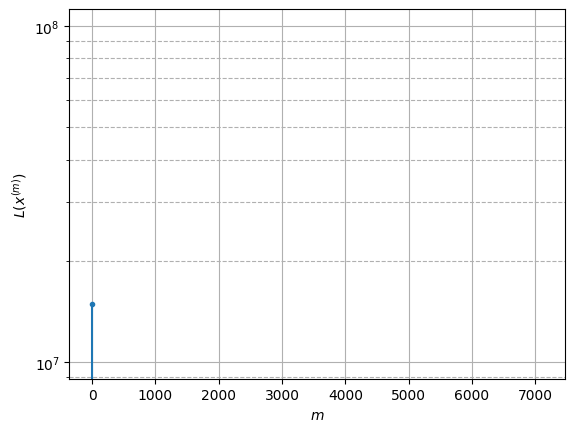

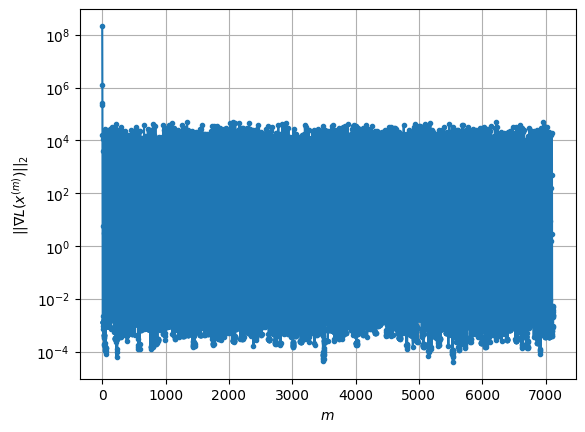

Windows:  95%|█████████▍| 356/376 [43:18<02:24,  7.24s/it]

Before applying the algorithm
Cost function: -3151343.2350376984
Gradient norm: 21248.224224393995
Global relative error: 74.85478008585508
Position relative errors: 0.10618662101183524 m, 19.62758964564321 m, 72.14791758626826 m, 3.556096765805649 m

Iteration 1
Cost function: -3151346.554225969 (-0.00%)
Gradient norm: 545.9851878685944 (-97.43%)
Global relative error: 78.29413250345242 (4.59%)
Position relative errors: 0.11493759840124909 m, 2.857708589906878 m, 76.56267893280382 m, 16.12267364609098 m

Iteration 2
Cost function: -3151346.5649176072 (-0.00%)
Gradient norm: 4.132466718543949 (-99.24%)
Global relative error: 79.3124174641614 (1.30%)
Position relative errors: 0.11493759595234947 m, 3.0615631653380353 m, 77.67560237226415 m, 15.73422410998176 m

Iteration 3
Cost function: -3151346.56492006 (-0.00%)
Gradient norm: 0.002810188986226275 (-99.93%)
Global relative error: 79.33465662641996 (0.03%)
Position relative errors: 0.11493759598354336 m, 3.0665309098406537 m, 77.699339

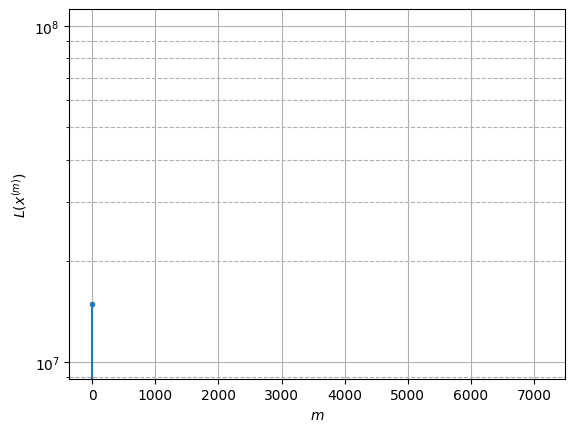

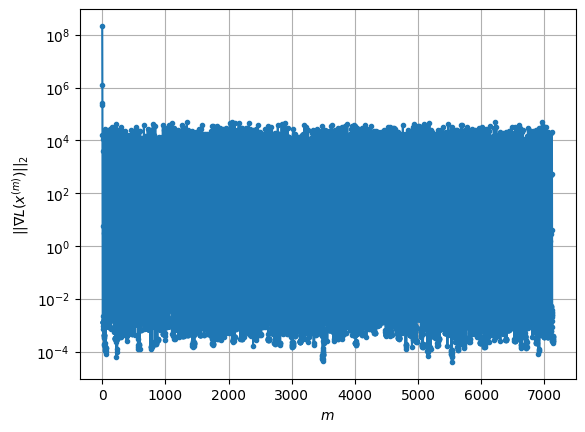

Windows:  95%|█████████▍| 357/376 [43:25<02:14,  7.09s/it]

Before applying the algorithm
Cost function: -3151344.194295507
Gradient norm: 23863.249174465054
Global relative error: 73.81924925133926
Position relative errors: 0.10359656416110595 m, 2.9125425417152946 m, 72.4574452363126 m, 13.809321666778562 m

Iteration 1
Cost function: -3151348.0554910763 (-0.00%)
Gradient norm: 1153.2100200274513 (-95.17%)
Global relative error: 23.185854310008267 (-68.59%)
Position relative errors: 0.07445184551569145 m, 7.964876949259998 m, 8.62558692941557 m, 19.993406524413285 m

Iteration 2
Cost function: -3151348.121840013 (-0.00%)
Gradient norm: 6.308023501271097 (-99.45%)
Global relative error: 20.20286911456495 (-12.87%)
Position relative errors: 0.07445184331799908 m, 5.106115894168599 m, 15.023697299929093 m, 12.504609369074535 m

Iteration 3
Cost function: -3151348.1218707887 (-0.00%)
Gradient norm: 0.008267604733941327 (-99.87%)
Global relative error: 20.37089699435298 (0.83%)
Position relative errors: 0.0744518432676496 m, 5.0917974288365615 m, 

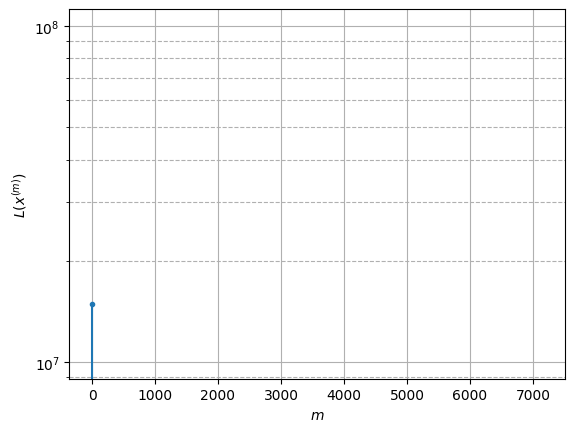

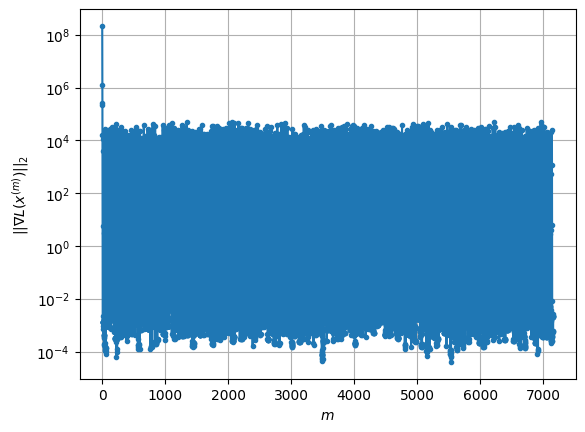

Windows:  95%|█████████▌| 358/376 [43:32<02:06,  7.00s/it]

Before applying the algorithm
Cost function: -3151353.5693552443
Gradient norm: 23008.204693751082
Global relative error: 21.009881778165518
Position relative errors: 0.0678052299887375 m, 4.249271131415629 m, 16.55077409156573 m, 12.223950862531181 m

Iteration 1
Cost function: -3151354.8658391205 (-0.00%)
Gradient norm: 95.91829109466147 (-99.58%)
Global relative error: 35.3646132434376 (68.32%)
Position relative errors: 0.07895311570224527 m, 6.406642164489163 m, 28.370746995781907 m, 20.117229339349045 m

Iteration 2
Cost function: -3151354.8668651753 (-0.00%)
Gradient norm: 1.1679654136643147 (-98.78%)
Global relative error: 34.854638447980214 (-1.44%)
Position relative errors: 0.07895311095207204 m, 6.261391656018218 m, 27.887242142283746 m, 19.948278893570397 m

Iteration 3
Cost function: -3151354.8668651646 (0.00%)
Gradient norm: 0.0013191583406878672 (-99.89%)
Global relative error: 34.85277780241419 (-0.01%)
Position relative errors: 0.07895311011714069 m, 6.2606010920615 m, 

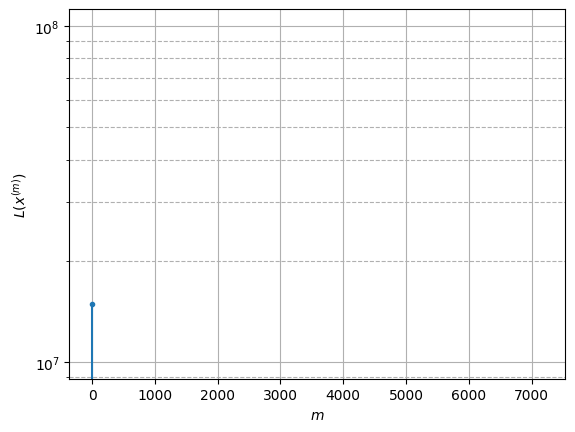

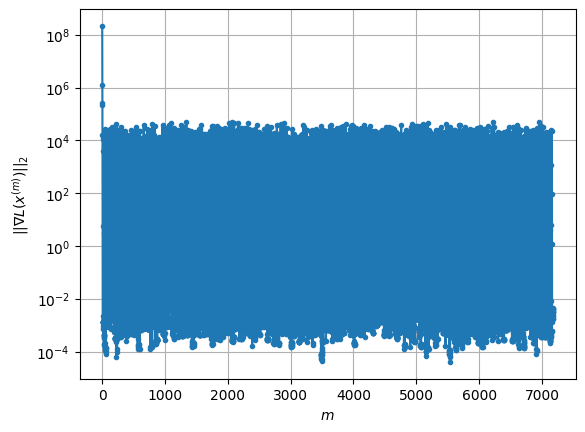

Windows:  95%|█████████▌| 359/376 [43:39<01:58,  7.00s/it]

Before applying the algorithm
Cost function: -3151354.1004885514
Gradient norm: 15490.29636447433
Global relative error: 34.033318972360014
Position relative errors: 0.07226891075324847 m, 4.6057384340229754 m, 28.390466127032774 m, 18.194168509552988 m

Iteration 1
Cost function: -3151355.5656159115 (-0.00%)
Gradient norm: 52.40188394467749 (-99.66%)
Global relative error: 37.523799445862984 (10.26%)
Position relative errors: 0.08568315157339704 m, 4.192800786298621 m, 32.43492193225467 m, 18.39614806823764 m

Iteration 2
Cost function: -3151355.5657550683 (-0.00%)
Gradient norm: 0.0077160294617848475 (-99.99%)
Global relative error: 37.41223217997931 (-0.30%)
Position relative errors: 0.08568315059400097 m, 4.202556966156205 m, 32.18471583880024 m, 18.6049490549818 m

Iteration 3
Cost function: -3151355.5657550883 (-0.00%)
Gradient norm: 0.00028040668262435827 (-96.37%)
Global relative error: 37.412151283234365 (-0.00%)
Position relative errors: 0.08568315115156144 m, 4.2025591008869

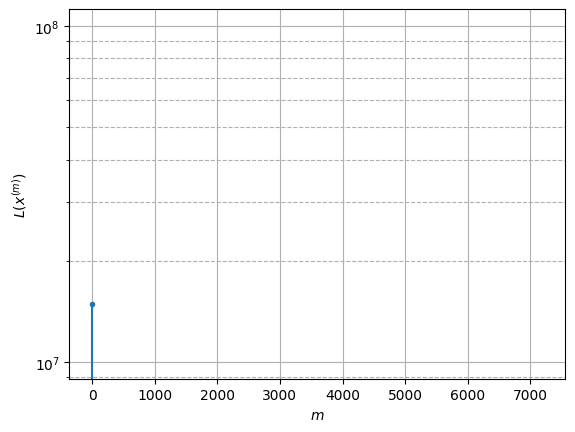

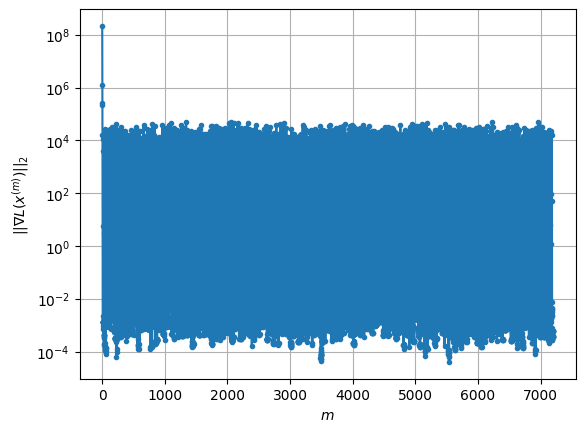

Windows:  96%|█████████▌| 360/376 [43:46<01:52,  7.03s/it]

Before applying the algorithm
Cost function: -3151346.836512202
Gradient norm: 25251.570858751726
Global relative error: 37.10429030050542
Position relative errors: 0.0787751090725624 m, 4.442231487122639 m, 33.328642335581996 m, 15.690259774748482 m

Iteration 1
Cost function: -3151351.325354516 (-0.00%)
Gradient norm: 204.7843373777662 (-99.19%)
Global relative error: 34.46322268577597 (-7.12%)
Position relative errors: 0.04789838095002966 m, 8.700244378445372 m, 21.858866679555298 m, 25.183210453961703 m

Iteration 2
Cost function: -3151351.3424257264 (-0.00%)
Gradient norm: 11.275752144926557 (-94.49%)
Global relative error: 33.473328900440904 (-2.87%)
Position relative errors: 0.047898371038389106 m, 8.781779195049427 m, 19.417787037892115 m, 25.812351790825954 m

Iteration 3
Cost function: -3151351.3424296496 (-0.00%)
Gradient norm: 0.001431985854905402 (-99.99%)
Global relative error: 33.425786871968945 (-0.14%)
Position relative errors: 0.047898371038389106 m, 8.784933113553539

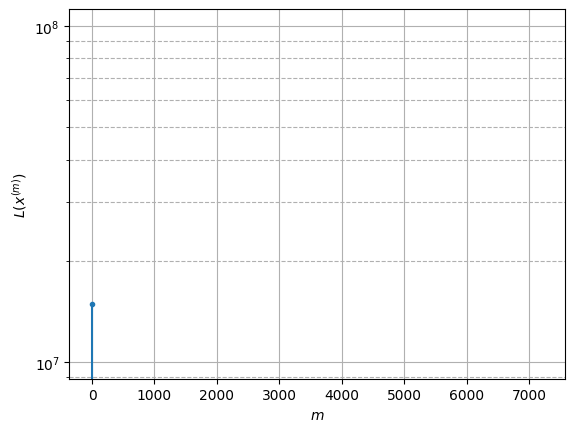

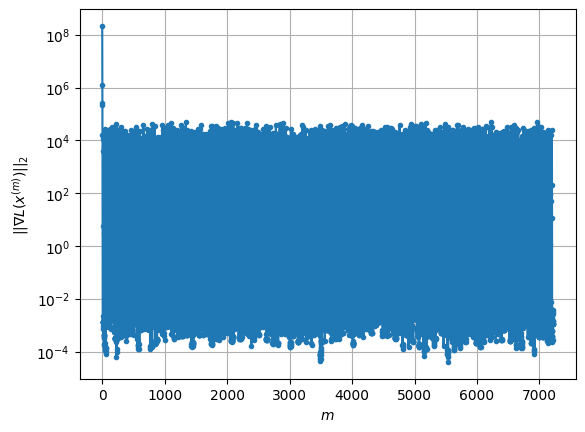

Windows:  96%|█████████▌| 361/376 [43:53<01:45,  7.05s/it]

Before applying the algorithm
Cost function: -3151344.9614785714
Gradient norm: 26617.656039957114
Global relative error: 26.971803004930436
Position relative errors: 0.04575219967321175 m, 5.899297215296527 m, 14.039059240302834 m, 22.261286775640976 m

Iteration 1
Cost function: -3151348.175113454 (-0.00%)
Gradient norm: 87.4093733783299 (-99.67%)
Global relative error: 14.366063598129786 (-46.74%)
Position relative errors: 0.05746642746565822 m, 7.29100829972301 m, 12.000375416819399 m, 3.034479935384645 m

Iteration 2
Cost function: -3151348.178823059 (-0.00%)
Gradient norm: 3.5607590680328043 (-95.93%)
Global relative error: 14.372900424741882 (0.05%)
Position relative errors: 0.05746642726262519 m, 7.6411988553174135 m, 11.413033940649319 m, 4.234064048074594 m

Iteration 3
Cost function: -3151348.1788232704 (-0.00%)
Gradient norm: 0.0011129824649414946 (-99.97%)
Global relative error: 14.37209623389256 (-0.01%)
Position relative errors: 0.05746642715965951 m, 7.642550270921738 m

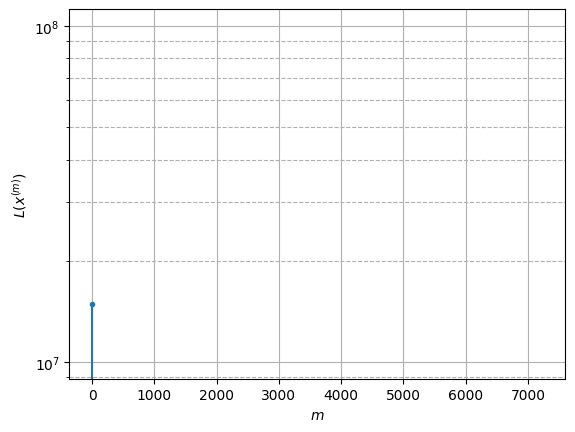

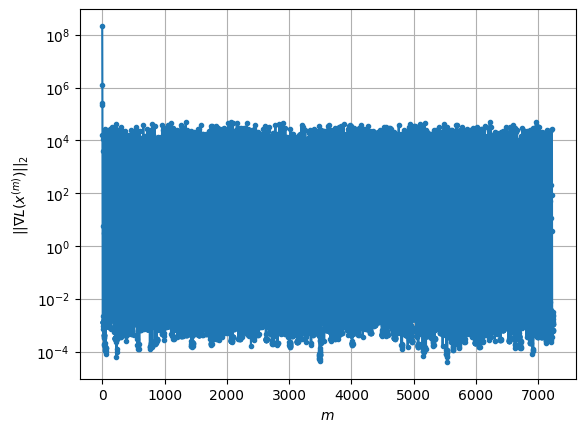

Windows:  96%|█████████▋| 362/376 [44:00<01:38,  7.06s/it]

Before applying the algorithm
Cost function: -3151348.8412391804
Gradient norm: 17529.174205094863
Global relative error: 15.440731221270024
Position relative errors: 0.05269318234054047 m, 6.42419114699592 m, 13.718998861447385 m, 2.987964029288504 m

Iteration 1
Cost function: -3151351.521714585 (-0.00%)
Gradient norm: 219.68076109740142 (-98.75%)
Global relative error: 25.327291323686982 (64.03%)
Position relative errors: 0.07892406784208333 m, 7.838733944581378 m, 19.35778000100677 m, 14.327718242174738 m

Iteration 2
Cost function: -3151351.5286063757 (-0.00%)
Gradient norm: 3.3163506285294506 (-98.49%)
Global relative error: 24.997723431492748 (-1.30%)
Position relative errors: 0.07892406636250404 m, 6.21347804381417 m, 21.437990176378886 m, 11.254912743750598 m

Iteration 3
Cost function: -3151351.5286067817 (-0.00%)
Gradient norm: 0.0039836617417016275 (-99.88%)
Global relative error: 25.012932844539794 (0.06%)
Position relative errors: 0.07892406593735497 m, 6.208248060080545 

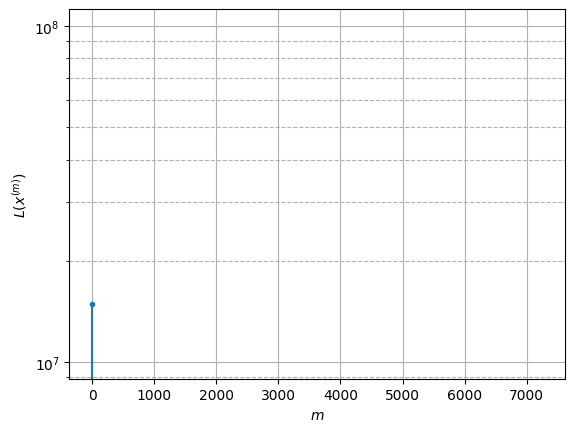

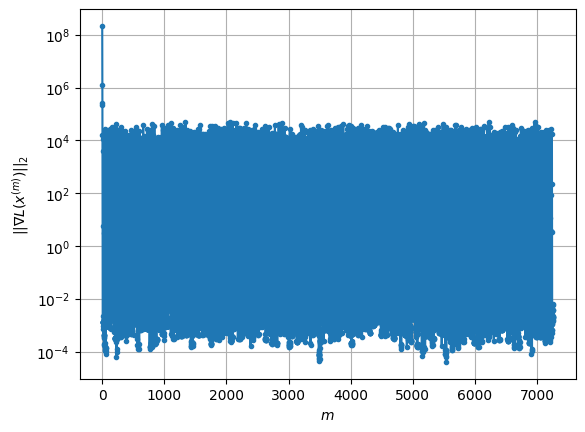

Windows:  97%|█████████▋| 363/376 [44:07<01:31,  7.02s/it]

Before applying the algorithm
Cost function: -3151350.3204649976
Gradient norm: 30399.676853544606
Global relative error: 18.58450320633454
Position relative errors: 0.07164232082000896 m, 3.399509938188974 m, 16.47299769257927 m, 7.902519502970715 m

Iteration 1
Cost function: -3151352.107521493 (-0.00%)
Gradient norm: 79.82039066241099 (-99.74%)
Global relative error: 23.98485145174292 (29.06%)
Position relative errors: 0.037302334951468424 m, 7.352165451787833 m, 4.862240097744176 m, 22.30613964081587 m

Iteration 2
Cost function: -3151352.108765179 (-0.00%)
Gradient norm: 0.16416111563240762 (-99.79%)
Global relative error: 22.818995185136174 (-4.86%)
Position relative errors: 0.037302334144741 m, 6.963249139410158 m, 4.966832401851907 m, 21.155069854006605 m

Iteration 3
Cost function: -3151352.108765184 (-0.00%)
Gradient norm: 0.0030721638888444418 (-98.13%)
Global relative error: 22.81477210603079 (-0.02%)
Position relative errors: 0.037302334144741 m, 6.961846913532302 m, 4.963

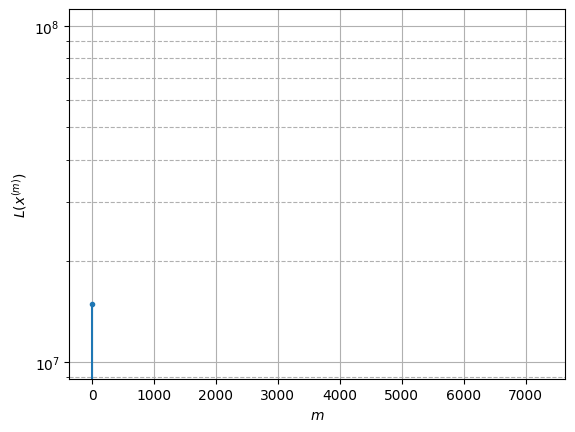

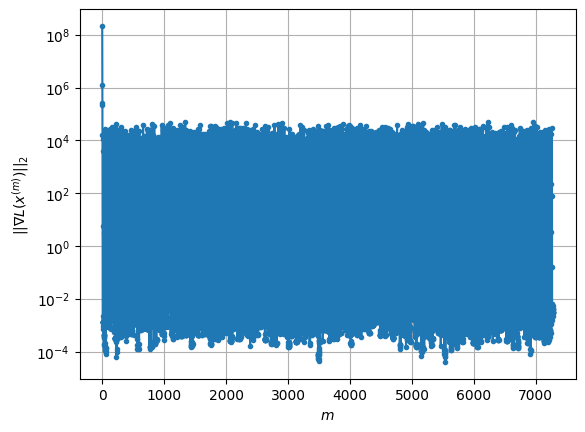

Windows:  97%|█████████▋| 364/376 [44:14<01:23,  6.97s/it]

Before applying the algorithm
Cost function: -3151354.5073746038
Gradient norm: 7517.251759262196
Global relative error: 20.295637397742716
Position relative errors: 0.03313445143436085 m, 4.949020032798948 m, 9.48504090221153 m, 17.246477064969426 m

Iteration 1
Cost function: -3151358.314909548 (-0.00%)
Gradient norm: 97.8351437108149 (-98.70%)
Global relative error: 32.03343457633306 (57.83%)
Position relative errors: 0.024407379054768502 m, 13.204888211413 m, 21.31811809799355 m, 19.932177078834027 m

Iteration 2
Cost function: -3151358.319008585 (-0.00%)
Gradient norm: 3.9825321655047934 (-95.93%)
Global relative error: 32.08395989566346 (0.16%)
Position relative errors: 0.024407368166195053 m, 12.429007286204829 m, 23.002071927582662 m, 18.595335673304884 m

Iteration 3
Cost function: -3151358.319008914 (-0.00%)
Gradient norm: 0.0007729997041899936 (-99.98%)
Global relative error: 32.093803986945986 (0.03%)
Position relative errors: 0.024407368166195053 m, 12.425686201256662 m, 2

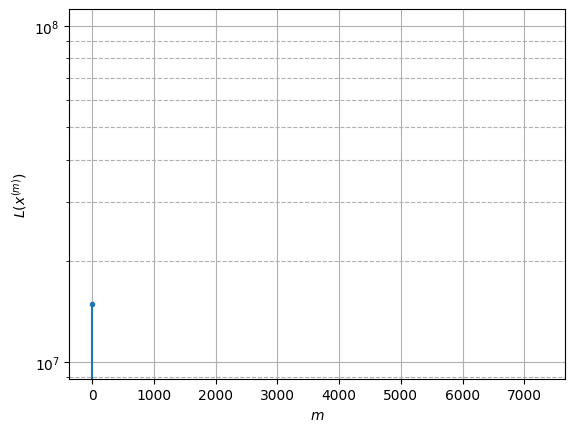

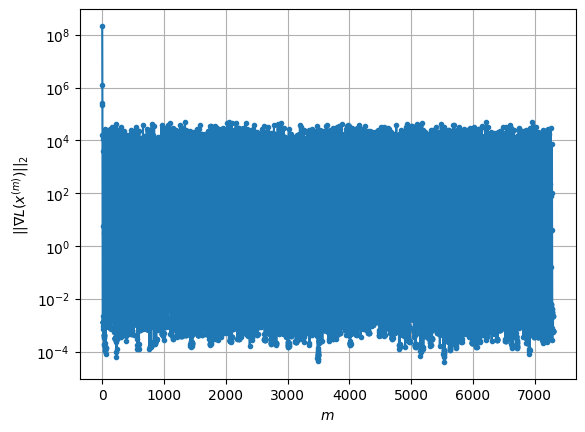

Windows:  97%|█████████▋| 365/376 [44:21<01:16,  6.92s/it]

Before applying the algorithm
Cost function: -3151356.703129473
Gradient norm: 39658.03573437819
Global relative error: 24.447446957920267
Position relative errors: 0.02140904672616209 m, 10.09304614996648 m, 16.417861980709564 m, 15.041379545330228 m

Iteration 1
Cost function: -3151358.7523775143 (-0.00%)
Gradient norm: 85.10267567356355 (-99.79%)
Global relative error: 70.81565164991248 (189.66%)
Position relative errors: 0.02839559211637094 m, 21.50513922247235 m, 56.9547979647071 m, 36.17319664258813 m

Iteration 2
Cost function: -3151358.758687665 (-0.00%)
Gradient norm: 1.424258691217486 (-98.33%)
Global relative error: 65.5566414062418 (-7.43%)
Position relative errors: 0.028395591995853887 m, 20.34716602358175 m, 52.335110016267194 m, 33.83294306337901 m

Iteration 3
Cost function: -3151358.758688816 (-0.00%)
Gradient norm: 0.0009221281512227526 (-99.94%)
Global relative error: 65.48661904634652 (-0.11%)
Position relative errors: 0.0283955919303365 m, 20.3405553142131 m, 52.25

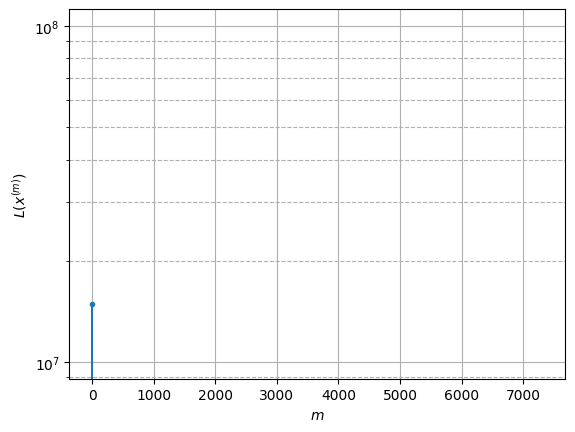

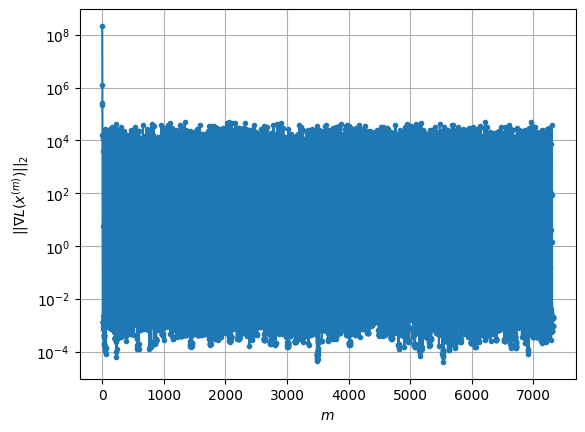

Windows:  97%|█████████▋| 366/376 [44:28<01:08,  6.89s/it]

Before applying the algorithm
Cost function: -3151350.7872109567
Gradient norm: 17754.36115067277
Global relative error: 54.45260706296194
Position relative errors: 0.022827913814960323 m, 16.475559172198814 m, 43.56913719593169 m, 28.201721359609095 m

Iteration 1
Cost function: -3151355.2702570595 (-0.00%)
Gradient norm: 162.0624524327487 (-99.09%)
Global relative error: 33.792454021839454 (-37.94%)
Position relative errors: 0.03829475368989591 m, 13.17080035001664 m, 25.40107895475423 m, 17.97853914656662 m

Iteration 2
Cost function: -3151355.2814568058 (-0.00%)
Gradient norm: 11.084897632482326 (-93.16%)
Global relative error: 35.10688550726143 (3.89%)
Position relative errors: 0.038294757657900774 m, 11.93011170427097 m, 28.706454680138737 m, 16.31217262975436 m

Iteration 3
Cost function: -3151355.28145914 (-0.00%)
Gradient norm: 0.005142656643656698 (-99.95%)
Global relative error: 35.12783514603117 (0.06%)
Position relative errors: 0.03829475775655684 m, 11.926668716896891 m, 

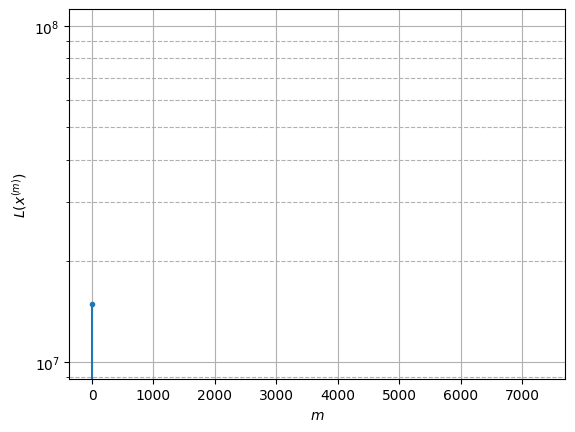

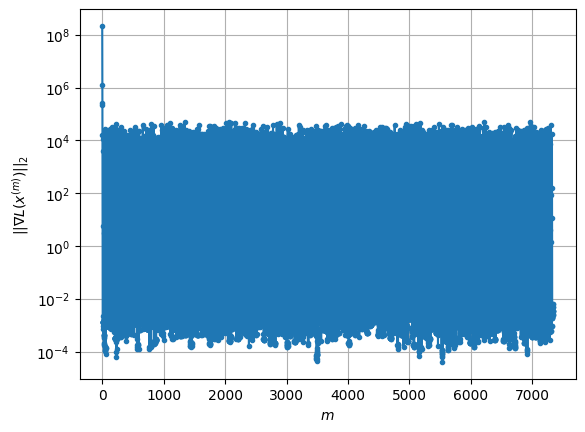

Windows:  98%|█████████▊| 367/376 [44:35<01:02,  6.91s/it]

Before applying the algorithm
Cost function: -3151350.564203144
Gradient norm: 36603.66937566435
Global relative error: 27.501714549595675
Position relative errors: 0.030867637953552032 m, 9.943573337763173 m, 21.62718145789166 m, 13.773754223746568 m

Iteration 1
Cost function: -3151353.6968220803 (-0.00%)
Gradient norm: 1124.9266978782566 (-96.93%)
Global relative error: 19.38010481856171 (-29.53%)
Position relative errors: 0.042654417925163696 m, 10.319890615768983 m, 15.499495982058551 m, 5.371283145447968 m

Iteration 2
Cost function: -3151353.7330007744 (-0.00%)
Gradient norm: 14.821295179329963 (-98.68%)
Global relative error: 17.45978769414277 (-9.91%)
Position relative errors: 0.04265442138935973 m, 9.768511410203422 m, 13.613313305175113 m, 4.908654282732253 m

Iteration 3
Cost function: -3151353.7330307076 (-0.00%)
Gradient norm: 0.04137919147762368 (-99.72%)
Global relative error: 17.324172589995566 (-0.78%)
Position relative errors: 0.042654422449376436 m, 9.76741962193362

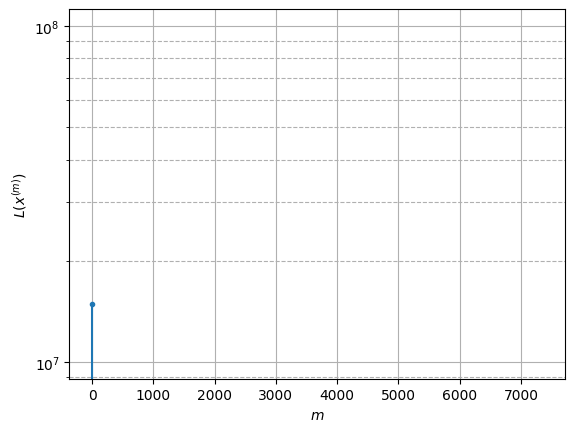

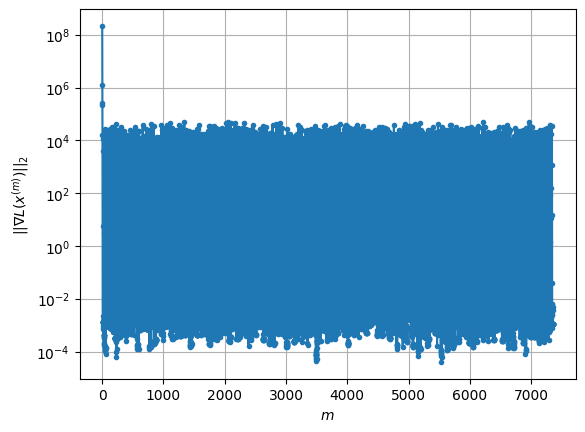

Windows:  98%|█████████▊| 368/376 [44:41<00:54,  6.86s/it]

Before applying the algorithm
Cost function: -3151353.1581148566
Gradient norm: 11469.691690549957
Global relative error: 17.95068029351725
Position relative errors: 0.04147938135700476 m, 8.902867343636995 m, 14.785107801368406 m, 4.93593445888667 m

Iteration 1
Cost function: -3151354.87348985 (-0.00%)
Gradient norm: 162.64941753499582 (-98.58%)
Global relative error: 22.84885291898766 (27.29%)
Position relative errors: 0.02096526836948939 m, 14.851833253855476 m, 14.805297598663463 m, 9.07151547744558 m

Iteration 2
Cost function: -3151354.8765227497 (-0.00%)
Gradient norm: 2.5035830024477717 (-98.46%)
Global relative error: 22.66893527663161 (-0.79%)
Position relative errors: 0.0209652706283092 m, 14.661633540333165 m, 14.65188215991469 m, 9.178012494805586 m

Iteration 3
Cost function: -3151354.8765228367 (-0.00%)
Gradient norm: 0.0016046893821082028 (-99.94%)
Global relative error: 22.665724417492097 (-0.01%)
Position relative errors: 0.02096527065407407 m, 14.661193753100441 m, 

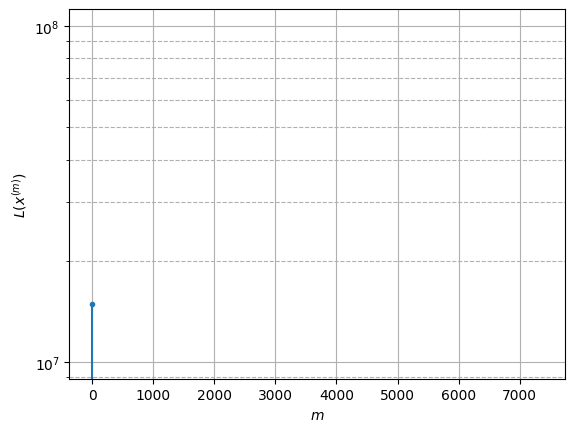

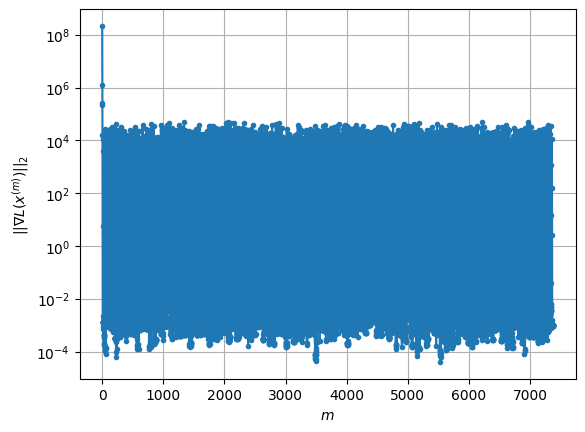

Windows:  98%|█████████▊| 369/376 [44:48<00:47,  6.79s/it]

Before applying the algorithm
Cost function: -3151356.207685969
Gradient norm: 13681.171509886382
Global relative error: 19.98854144336859
Position relative errors: 0.019132777808996058 m, 13.449306102963739 m, 12.076058505212064 m, 8.53365991578903 m

Iteration 1
Cost function: -3151361.9022930525 (-0.00%)
Gradient norm: 50.305682795017596 (-99.63%)
Global relative error: 51.413342535333825 (157.21%)
Position relative errors: 0.03225685591346331 m, 30.443028609433117 m, 26.50849643313753 m, 31.841006329307497 m

Iteration 2
Cost function: -3151361.9230659204 (-0.00%)
Gradient norm: 4.833748903927766 (-90.39%)
Global relative error: 62.511678994990966 (21.59%)
Position relative errors: 0.032256856729648856 m, 34.0252856443854 m, 36.30619658342376 m, 37.839740254786705 m

Iteration 3
Cost function: -3151361.923074436 (-0.00%)
Gradient norm: 0.0034077490103522146 (-99.93%)
Global relative error: 62.65737089975274 (0.23%)
Position relative errors: 0.03225685640317157 m, 34.07707234116333 

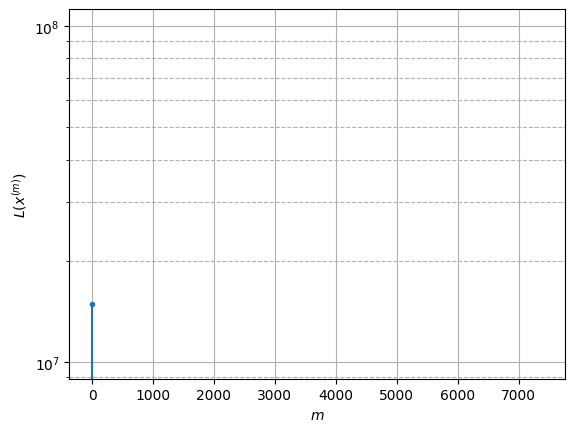

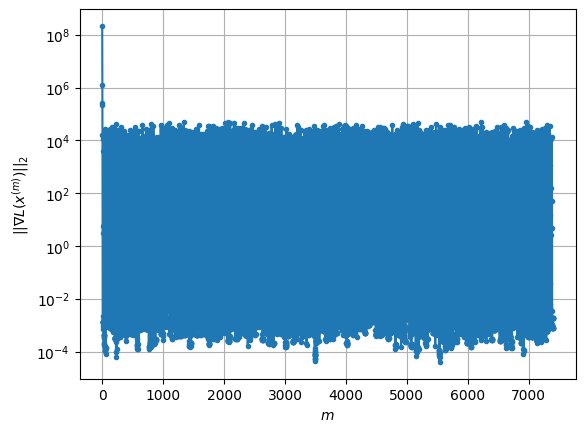

Windows:  98%|█████████▊| 370/376 [44:55<00:40,  6.73s/it]

Before applying the algorithm
Cost function: -3151360.525802535
Gradient norm: 11179.013758871268
Global relative error: 60.048930326659736
Position relative errors: 0.02663480232963412 m, 31.8260436969818 m, 36.64125643777554 m, 35.36087036604676 m

Iteration 1
Cost function: -3151364.552155163 (-0.00%)
Gradient norm: 532.6003637473814 (-95.24%)
Global relative error: 108.17499362370333 (80.14%)
Position relative errors: 0.041657232424016144 m, 43.636411933758836 m, 82.46109800468014 m, 54.75263952375847 m

Iteration 2
Cost function: -3151364.5762863457 (-0.00%)
Gradient norm: 21.9361810107106 (-95.88%)
Global relative error: 105.68451560892672 (-2.30%)
Position relative errors: 0.04165723113085688 m, 44.003017893563374 m, 78.91914317753319 m, 54.81525672066703 m

Iteration 3
Cost function: -3151364.576303385 (-0.00%)
Gradient norm: 0.014780860069796536 (-99.93%)
Global relative error: 105.57207601008109 (-0.11%)
Position relative errors: 0.041657230897471635 m, 44.00433342256678 m, 7

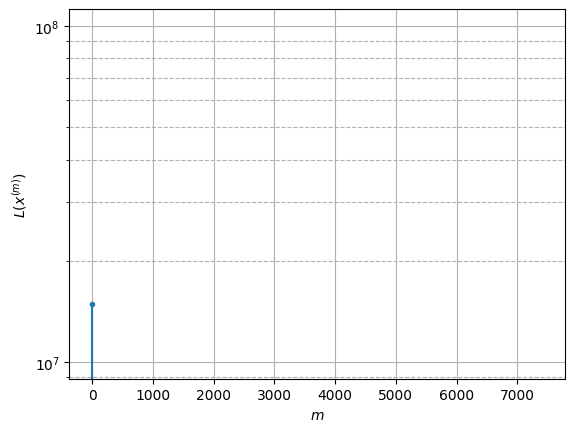

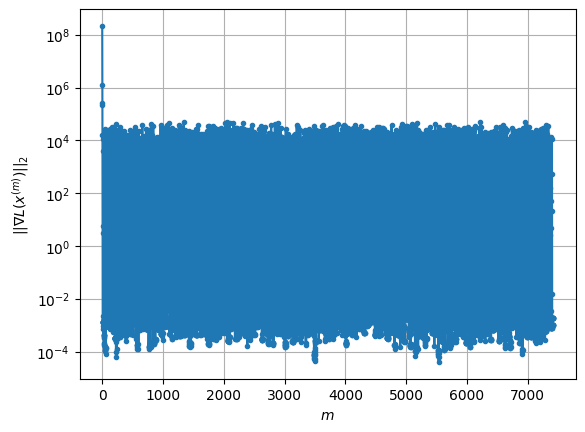

Windows:  99%|█████████▊| 371/376 [45:01<00:33,  6.74s/it]

Before applying the algorithm
Cost function: -3151367.935352949
Gradient norm: 35048.99935216934
Global relative error: 100.78933254720432
Position relative errors: 0.03514747160037151 m, 42.54145237879334 m, 75.14171285506698 m, 51.98489206212868 m

Iteration 1
Cost function: -3151372.2261989927 (-0.00%)
Gradient norm: 46.5680757761008 (-99.87%)
Global relative error: 107.75988101057224 (6.92%)
Position relative errors: 0.0422445559237256 m, 36.53196477094578 m, 88.55484238385532 m, 49.35213673499422 m

Iteration 2
Cost function: -3151372.230418718 (-0.00%)
Gradient norm: 5.822041195891161 (-87.50%)
Global relative error: 110.07792718597614 (2.15%)
Position relative errors: 0.04224455681921982 m, 36.372644212762864 m, 91.63476277246937 m, 48.96157392181868 m

Iteration 3
Cost function: -3151372.230419424 (-0.00%)
Gradient norm: 0.000754624534396696 (-99.99%)
Global relative error: 110.09176851656338 (0.01%)
Position relative errors: 0.04224455690453177 m, 36.37517544611364 m, 91.64917

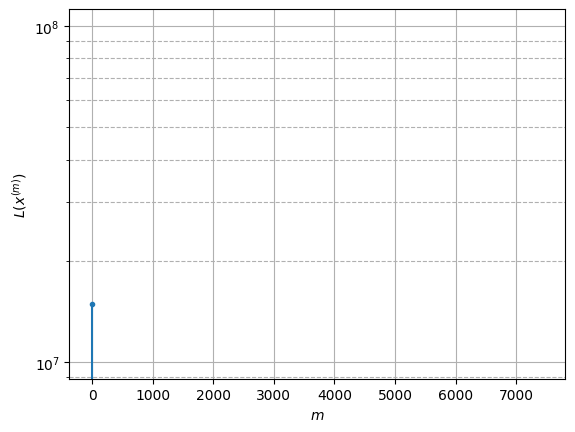

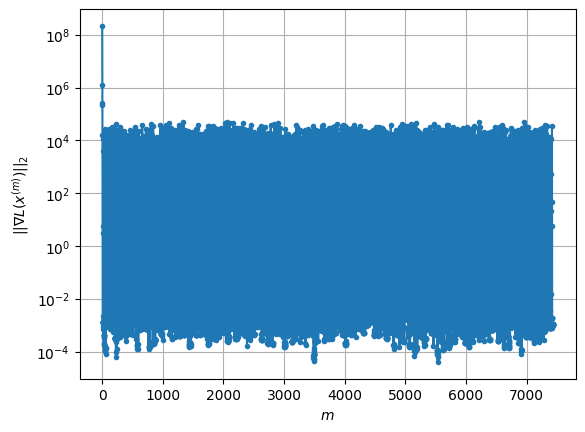

Windows:  99%|█████████▉| 372/376 [45:08<00:26,  6.74s/it]

Before applying the algorithm
Cost function: -3151361.1191691495
Gradient norm: 14729.934183004412
Global relative error: 102.91218287075706
Position relative errors: 0.040098925014619306 m, 34.500905026931356 m, 85.60326186215283 m, 45.5265801230069 m

Iteration 1
Cost function: -3151366.5677063153 (-0.00%)
Gradient norm: 232.64805167198764 (-98.42%)
Global relative error: 62.188480362133326 (-39.57%)
Position relative errors: 0.048930024509831575 m, 12.052432721702482 m, 55.39821475296515 m, 25.557378064566183 m

Iteration 2
Cost function: -3151366.6031181216 (-0.00%)
Gradient norm: 6.086436511235885 (-97.38%)
Global relative error: 68.52824307126536 (10.19%)
Position relative errors: 0.04893001634588663 m, 15.472131022622674 m, 58.998063497489525 m, 31.24030906066886 m

Iteration 3
Cost function: -3151366.6031271564 (-0.00%)
Gradient norm: 0.004321234909725644 (-99.93%)
Global relative error: 68.67032916309803 (0.21%)
Position relative errors: 0.048930016959207595 m, 15.504213075206

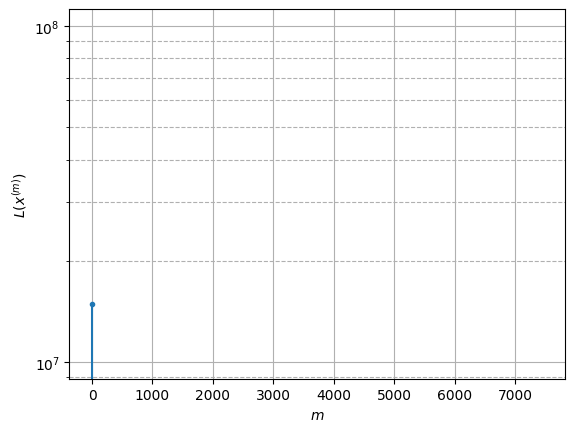

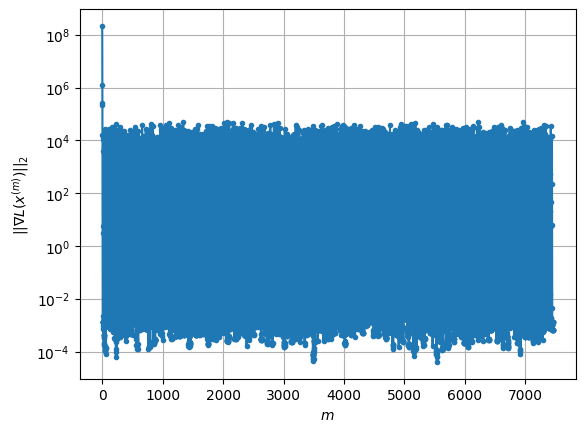

Windows:  99%|█████████▉| 373/376 [45:15<00:20,  6.79s/it]

Before applying the algorithm
Cost function: -3151367.996643535
Gradient norm: 14380.376590596827
Global relative error: 65.7844614592883
Position relative errors: 0.046253296304267534 m, 15.900746503079407 m, 56.27337987908009 m, 30.134088074915752 m

Iteration 1
Cost function: -3151371.297294256 (-0.00%)
Gradient norm: 143.52769966280349 (-99.00%)
Global relative error: 75.25928502464977 (14.40%)
Position relative errors: 0.09168184010152029 m, 14.812452699707622 m, 72.56749434462414 m, 13.360286793875627 m

Iteration 2
Cost function: -3151371.298958807 (-0.00%)
Gradient norm: 0.4502048272528019 (-99.69%)
Global relative error: 73.87850135962785 (-1.83%)
Position relative errors: 0.09168184532544756 m, 14.950812010843062 m, 70.97497569332506 m, 14.037326292063677 m

Iteration 3
Cost function: -3151371.298958818 (-0.00%)
Gradient norm: 0.002721582559592165 (-99.40%)
Global relative error: 73.86912538905783 (-0.01%)
Position relative errors: 0.09168184525142258 m, 14.952282966367699 m,

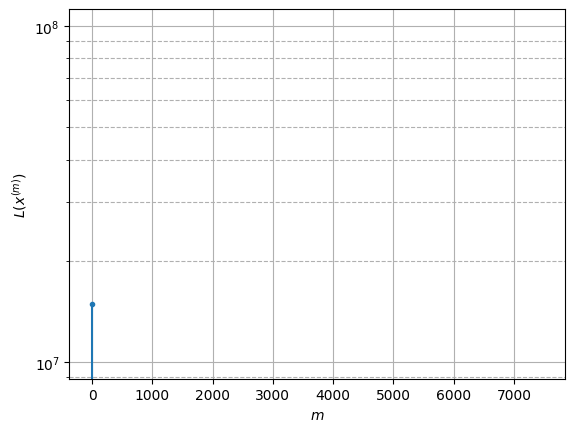

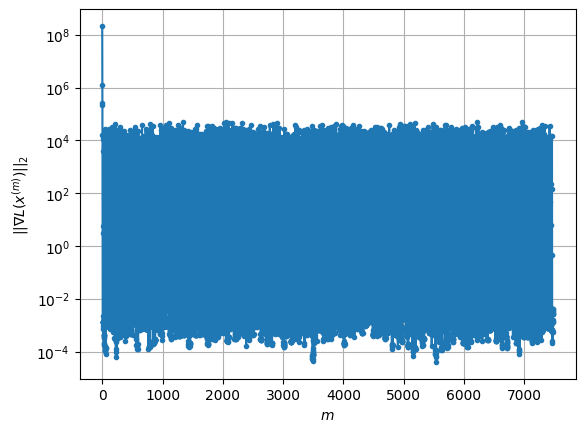

Windows:  99%|█████████▉| 374/376 [45:22<00:13,  6.83s/it]

Before applying the algorithm
Cost function: -3151364.5130528244
Gradient norm: 13528.10056541193
Global relative error: 71.02487467437871
Position relative errors: 0.08384818609628629 m, 15.204839965736983 m, 67.78627883695786 m, 14.776828854411715 m

Iteration 1
Cost function: -3151367.646625031 (-0.00%)
Gradient norm: 137.9213890841183 (-98.98%)
Global relative error: 35.071456128241344 (-50.62%)
Position relative errors: 0.09027983527405513 m, 13.433845384178944 m, 30.094158828518328 m, 11.994434360080646 m

Iteration 2
Cost function: -3151367.6818490378 (-0.00%)
Gradient norm: 43.188603589250654 (-68.69%)
Global relative error: 43.0216129048489 (22.67%)
Position relative errors: 0.09027983103100722 m, 13.369583257186308 m, 39.2105512371086 m, 11.603105811961552 m

Iteration 3
Cost function: -3151367.6818955094 (-0.00%)
Gradient norm: 0.006722147878760592 (-99.98%)
Global relative error: 43.149014682502326 (0.30%)
Position relative errors: 0.09027983100310355 m, 13.364450394042828 

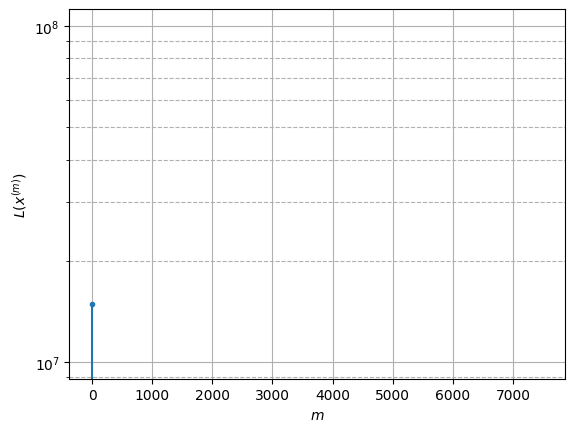

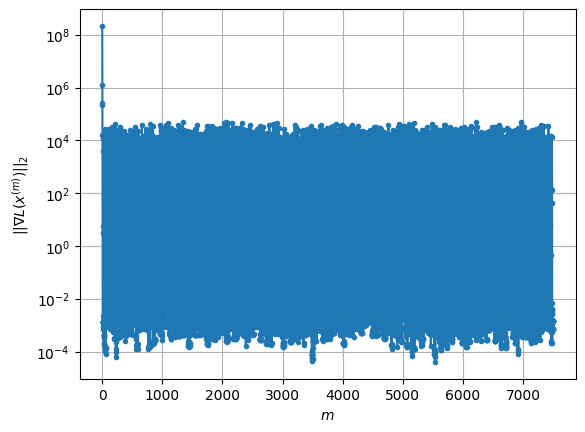

Windows: 100%|█████████▉| 375/376 [45:29<00:06,  6.81s/it]

Before applying the algorithm
Cost function: -3151372.64727085
Gradient norm: 24917.475658248066
Global relative error: 41.023907259684776
Position relative errors: 0.08184255841964323 m, 12.17370557894967 m, 38.1009878263218 m, 9.113942344323064 m

Iteration 1
Cost function: -3151375.0983071127 (-0.00%)
Gradient norm: 311.67560266958714 (-98.75%)
Global relative error: 109.39498288315234 (166.66%)
Position relative errors: 0.08555585963567335 m, 14.966122807886094 m, 107.19290257692552 m, 15.90404673607422 m

Iteration 2
Cost function: -3151375.142205055 (-0.00%)
Gradient norm: 11.665377601670036 (-96.26%)
Global relative error: 98.53522333865544 (-9.93%)
Position relative errors: 0.08555586195101308 m, 15.35135834257232 m, 95.83319269400319 m, 17.014897036898702 m

Iteration 3
Cost function: -3151375.142268923 (-0.00%)
Gradient norm: 0.020200827059608326 (-99.83%)
Global relative error: 97.95103134666488 (-0.59%)
Position relative errors: 0.08555586198021023 m, 15.332912384620062 m, 

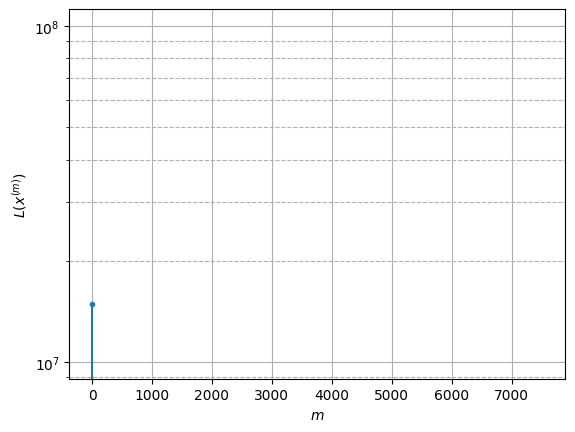

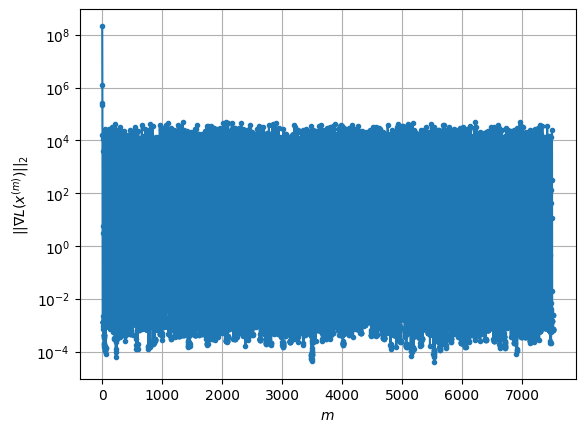

RMSE after convergence:
Chief: 0.08 m
Deputy 1: 18.26 m
Deputy 2: 32.59 m
Deputy 3: 41.50 m


In [21]:
# Main execution loop
def run_estimation():
    # Initialize storage for results
    X_est_mm = np.zeros_like(X_true)
    X_est_mm[:, :, 0] = X_est[:, :, 0]  # Use same initial conditions
    
    # Storage for errors
    errors_chief_mm = []
    errors_deputy1_mm = []
    errors_deputy2_mm = []
    errors_deputy3_mm = []
    
    # Initialize solver
    solver = approxH_Newton()
    
    # Sliding window estimation
    for t in tqdm(range(T - W + 1), desc="Windows", leave=False):
        # Get measurements for current window
        Y_window = Y[:, :, t:t + W]
        
        # Initial guess is the previous estimate propagated forward
        if t == 0:
            x_init = X_est[:, :, t]
        else:
            x_init = X_est_mm[:, :, t]
        
        # Solve the optimization problem
        x_sol = solver.solve(x_init, Y_window, X_true[:, :, t])
        
        # Store the solution
        X_est_mm[:, :, t] = x_sol
        
        # Plot the results
        give_me_the_plots(solver.cost_function_values, solver.grad_norm_values)
        
        # Propagate solution to next timestep if not at the end
        if t < T - W:
            X_est_mm[:, :, t + 1] = SatelliteDynamics().x_new(dt, x_sol)
        
        # Calculate and store errors
        error_chief = np.linalg.norm(X_est_mm[:3, :, t] - X_true[:3, :, t])
        error_deputy1 = np.linalg.norm(X_est_mm[6:9, :, t] - X_true[6:9, :, t])
        error_deputy2 = np.linalg.norm(X_est_mm[12:15, :, t] - X_true[12:15, :, t])
        error_deputy3 = np.linalg.norm(X_est_mm[18:21, :, t] - X_true[18:21, :, t])
        
        errors_chief_mm.append(error_chief)
        errors_deputy1_mm.append(error_deputy1)
        errors_deputy2_mm.append(error_deputy2)
        errors_deputy3_mm.append(error_deputy3)
    
    return X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm

# Run the estimation
X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm = run_estimation()

# Print RMSE for each satellite
print("RMSE after convergence:")
print(f"Chief: {np.sqrt(np.mean(np.array(errors_chief_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 1: {np.sqrt(np.mean(np.array(errors_deputy1_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 2: {np.sqrt(np.mean(np.array(errors_deputy2_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 3: {np.sqrt(np.mean(np.array(errors_deputy3_mm[T_RMSE:])**2)):.2f} m")

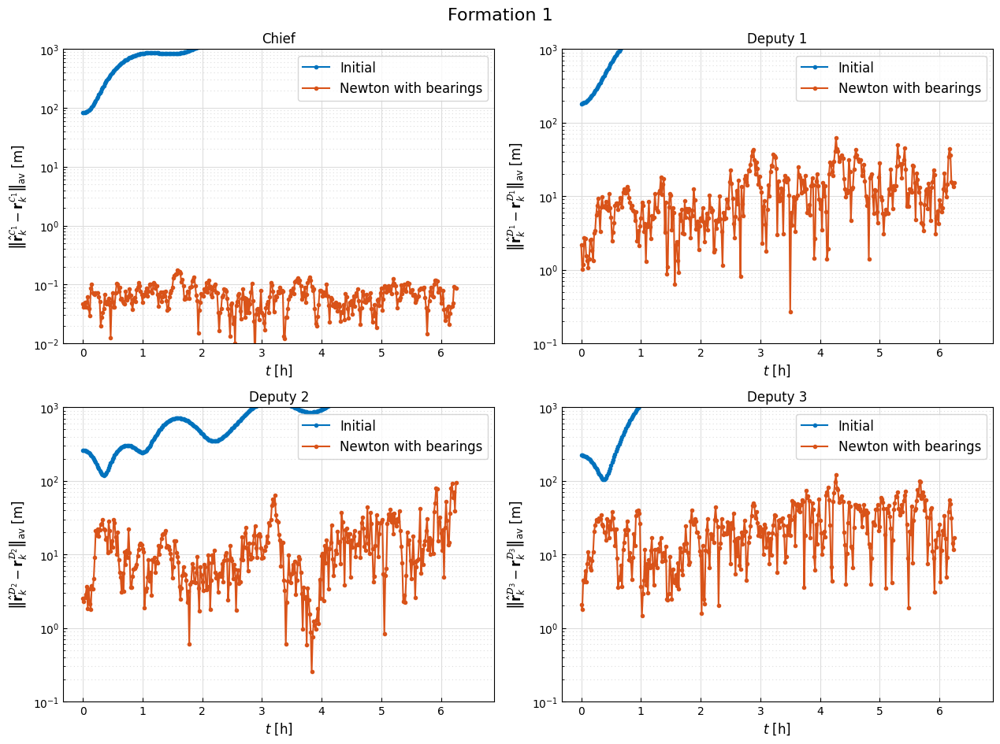

In [22]:
dev_chief = errors_chief_mm
dev_deputy1 = errors_deputy1_mm
dev_deputy2 = errors_deputy2_mm
dev_deputy3 = errors_deputy3_mm

# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, T) / dt
algorithm = "Newton with bearings"

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, dev_chief_initial, ".-", label="Initial")
axs[0, 0].plot(time[:K - W + 1], dev_chief, ".-", label=algorithm)
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{C}_1} - \\mathbf{r}_k^{\\mathcal{C}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)
axs[0, 0].set_title("Chief")

# Plot 2: Deputy 1
axs[0, 1].plot(time, dev_deputy1_initial, ".-", label="Initial")
axs[0, 1].plot(time[:K - W + 1], dev_deputy1, ".-", label=algorithm)
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_1} - \\mathbf{r}_k^{\\mathcal{D}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)
axs[0, 1].set_title("Deputy 1")

# Plot 3: Deputy 2
axs[1, 0].plot(time, dev_deputy2_initial, ".-", label="Initial")
axs[1, 0].plot(time[:K - W + 1], dev_deputy2, ".-", label=algorithm)
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_2} - \\mathbf{r}_k^{\\mathcal{D}_2}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)
axs[1, 0].set_title("Deputy 2")

# Plot 4: Deputy 3
axs[1, 1].plot(time, dev_deputy3_initial, ".-", label="Initial")
axs[1, 1].plot(time[:K - W + 1], dev_deputy3, ".-", label=algorithm)
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_3} - \\mathbf{r}_k^{\\mathcal{D}_3}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)
axs[1, 1].set_title("Deputy 3")

fig.suptitle(f"Formation {formation}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [23]:
import pickle
from datetime import datetime

# Fill the dictionary
data = {}
data["true"] = X_true
data[0] = X_est_mm

# Save to pickle file
with open(
    f'newton_bearings_new_network_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl',
    "wb",
) as file:
    pickle.dump(data, file)